In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'N1_3.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain,ytrain2]
x_val = xval
y_val = [yval,yval,yval2]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

#Output 3 = Slicer output layer

layer7 = Dense(1)(layer2)
layer8 = Lambda(lambda t: t[:,-1],name='out3')(layer7)


model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6,layer8])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 831)      2778864     input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 233)      193856      lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        468         dense[0][0]                      
_______________________________________________________________________________________

In [21]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Real Gas Turbine/LSTM-N1/model checkpoint/N1_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [22]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik,'out3':'mean_squared_error'},loss_weights=[0.5,0.5,0],optimizer= 'Adam')

In [23]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 8122339.70588, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1/model checkpoint\N1_3_ckpt

Epoch 00002: val_loss improved from 8122339.70588 to 7403875.14706, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1/model checkpoint\N1_3_ckpt

Epoch 00003: val_loss improved from 7403875.14706 to 7239686.58824, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1/model checkpoint\N1_3_ckpt

Epoch 00004: val_loss improved from 7239686.58824 to 6693069.20588, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1/model checkpoint\N1_3_ckpt

Epoch 00005: val_loss did not improve from 6693069.20588

Epoch 00006: val_loss did not improve from 6693069.20588

Epoch 00007: val_loss did not improve from 6693069.2


Epoch 00088: val_loss did not improve from 227667.36765

Epoch 00089: val_loss did not improve from 227667.36765

Epoch 00090: val_loss did not improve from 227667.36765

Epoch 00091: val_loss did not improve from 227667.36765

Epoch 00092: val_loss did not improve from 227667.36765

Epoch 00093: val_loss did not improve from 227667.36765

Epoch 00094: val_loss did not improve from 227667.36765

Epoch 00095: val_loss did not improve from 227667.36765

Epoch 00096: val_loss did not improve from 227667.36765

Epoch 00097: val_loss did not improve from 227667.36765

Epoch 00098: val_loss did not improve from 227667.36765

Epoch 00099: val_loss did not improve from 227667.36765

Epoch 00100: val_loss did not improve from 227667.36765

Epoch 00101: val_loss did not improve from 227667.36765

Epoch 00102: val_loss did not improve from 227667.36765

Epoch 00103: val_loss did not improve from 227667.36765

Epoch 00104: val_loss did not improve from 227667.36765

Epoch 00105: val_loss did not 


Epoch 00200: val_loss improved from 105134.98300 to 103751.00965, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1/model checkpoint\N1_3_ckpt

Epoch 00201: val_loss did not improve from 103751.00965

Epoch 00202: val_loss did not improve from 103751.00965

Epoch 00203: val_loss did not improve from 103751.00965

Epoch 00204: val_loss did not improve from 103751.00965

Epoch 00205: val_loss did not improve from 103751.00965

Epoch 00206: val_loss did not improve from 103751.00965

Epoch 00207: val_loss did not improve from 103751.00965

Epoch 00208: val_loss did not improve from 103751.00965

Epoch 00209: val_loss did not improve from 103751.00965

Epoch 00210: val_loss did not improve from 103751.00965

Epoch 00211: val_loss improved from 103751.00965 to 99491.67785, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1/model checkpoint\N1_3_ckpt

Epoch 00212: val_loss did not improve from 99491.67785

Epoch 00213: val


Epoch 00321: val_loss did not improve from 24481.79756

Epoch 00322: val_loss did not improve from 24481.79756

Epoch 00323: val_loss did not improve from 24481.79756

Epoch 00324: val_loss did not improve from 24481.79756

Epoch 00325: val_loss did not improve from 24481.79756

Epoch 00326: val_loss did not improve from 24481.79756

Epoch 00327: val_loss did not improve from 24481.79756

Epoch 00328: val_loss did not improve from 24481.79756

Epoch 00329: val_loss did not improve from 24481.79756

Epoch 00330: val_loss did not improve from 24481.79756

Epoch 00331: val_loss did not improve from 24481.79756

Epoch 00332: val_loss did not improve from 24481.79756

Epoch 00333: val_loss did not improve from 24481.79756

Epoch 00334: val_loss improved from 24481.79756 to 22431.21220, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/N1/model checkpoint\N1_3_ckpt

Epoch 00335: val_loss did not improve from 22431.21220

Epoch 00336: val_loss did not improve 


Epoch 00453: val_loss did not improve from 1369.41424

Epoch 00454: val_loss did not improve from 1369.41424

Epoch 00455: val_loss did not improve from 1369.41424

Epoch 00456: val_loss did not improve from 1369.41424

Epoch 00457: val_loss did not improve from 1369.41424

Epoch 00458: val_loss did not improve from 1369.41424

Epoch 00459: val_loss did not improve from 1369.41424

Epoch 00460: val_loss did not improve from 1369.41424

Epoch 00461: val_loss did not improve from 1369.41424

Epoch 00462: val_loss did not improve from 1369.41424

Epoch 00463: val_loss did not improve from 1369.41424

Epoch 00464: val_loss did not improve from 1369.41424

Epoch 00465: val_loss did not improve from 1369.41424

Epoch 00466: val_loss did not improve from 1369.41424

Epoch 00467: val_loss did not improve from 1369.41424

Epoch 00468: val_loss did not improve from 1369.41424

Epoch 00469: val_loss did not improve from 1369.41424

Epoch 00470: val_loss did not improve from 1369.41424

Epoch 004


Epoch 00600: val_loss did not improve from 1153.68331

Epoch 00601: val_loss did not improve from 1153.68331

Epoch 00602: val_loss did not improve from 1153.68331

Epoch 00603: val_loss did not improve from 1153.68331

Epoch 00604: val_loss did not improve from 1153.68331

Epoch 00605: val_loss did not improve from 1153.68331

Epoch 00606: val_loss did not improve from 1153.68331

Epoch 00607: val_loss did not improve from 1153.68331

Epoch 00608: val_loss did not improve from 1153.68331

Epoch 00609: val_loss did not improve from 1153.68331

Epoch 00610: val_loss did not improve from 1153.68331

Epoch 00611: val_loss did not improve from 1153.68331

Epoch 00612: val_loss did not improve from 1153.68331

Epoch 00613: val_loss did not improve from 1153.68331

Epoch 00614: val_loss did not improve from 1153.68331

Epoch 00615: val_loss did not improve from 1153.68331

Epoch 00616: val_loss did not improve from 1153.68331

Epoch 00617: val_loss did not improve from 1153.68331

Epoch 006


Epoch 00743: val_loss did not improve from 1030.61518

Epoch 00744: val_loss did not improve from 1030.61518

Epoch 00745: val_loss did not improve from 1030.61518

Epoch 00746: val_loss did not improve from 1030.61518

Epoch 00747: val_loss did not improve from 1030.61518

Epoch 00748: val_loss did not improve from 1030.61518

Epoch 00749: val_loss did not improve from 1030.61518

Epoch 00750: val_loss did not improve from 1030.61518

Epoch 00751: val_loss did not improve from 1030.61518

Epoch 00752: val_loss did not improve from 1030.61518

Epoch 00753: val_loss did not improve from 1030.61518

Epoch 00754: val_loss did not improve from 1030.61518

Epoch 00755: val_loss did not improve from 1030.61518

Epoch 00756: val_loss did not improve from 1030.61518

Epoch 00757: val_loss did not improve from 1030.61518

Epoch 00758: val_loss did not improve from 1030.61518

Epoch 00759: val_loss did not improve from 1030.61518

Epoch 00760: val_loss did not improve from 1030.61518

Epoch 007


Epoch 00892: val_loss did not improve from 1030.61518

Epoch 00893: val_loss did not improve from 1030.61518

Epoch 00894: val_loss did not improve from 1030.61518

Epoch 00895: val_loss did not improve from 1030.61518

Epoch 00896: val_loss did not improve from 1030.61518

Epoch 00897: val_loss did not improve from 1030.61518

Epoch 00898: val_loss did not improve from 1030.61518

Epoch 00899: val_loss did not improve from 1030.61518

Epoch 00900: val_loss did not improve from 1030.61518

Epoch 00901: val_loss did not improve from 1030.61518

Epoch 00902: val_loss did not improve from 1030.61518

Epoch 00903: val_loss did not improve from 1030.61518

Epoch 00904: val_loss did not improve from 1030.61518

Epoch 00905: val_loss did not improve from 1030.61518

Epoch 00906: val_loss did not improve from 1030.61518

Epoch 00907: val_loss did not improve from 1030.61518

Epoch 00908: val_loss did not improve from 1030.61518

Epoch 00909: val_loss did not improve from 1030.61518

Epoch 009


Epoch 01040: val_loss did not improve from 944.95837

Epoch 01041: val_loss did not improve from 944.95837

Epoch 01042: val_loss did not improve from 944.95837

Epoch 01043: val_loss did not improve from 944.95837

Epoch 01044: val_loss did not improve from 944.95837

Epoch 01045: val_loss did not improve from 944.95837

Epoch 01046: val_loss did not improve from 944.95837

Epoch 01047: val_loss did not improve from 944.95837

Epoch 01048: val_loss did not improve from 944.95837

Epoch 01049: val_loss did not improve from 944.95837

Epoch 01050: val_loss did not improve from 944.95837

Epoch 01051: val_loss did not improve from 944.95837

Epoch 01052: val_loss did not improve from 944.95837

Epoch 01053: val_loss did not improve from 944.95837

Epoch 01054: val_loss did not improve from 944.95837

Epoch 01055: val_loss did not improve from 944.95837

Epoch 01056: val_loss did not improve from 944.95837

Epoch 01057: val_loss did not improve from 944.95837

Epoch 01058: val_loss did n


Epoch 01192: val_loss did not improve from 944.95837

Epoch 01193: val_loss did not improve from 944.95837

Epoch 01194: val_loss did not improve from 944.95837

Epoch 01195: val_loss did not improve from 944.95837

Epoch 01196: val_loss did not improve from 944.95837

Epoch 01197: val_loss did not improve from 944.95837

Epoch 01198: val_loss did not improve from 944.95837

Epoch 01199: val_loss did not improve from 944.95837

Epoch 01200: val_loss did not improve from 944.95837

Epoch 01201: val_loss did not improve from 944.95837

Epoch 01202: val_loss did not improve from 944.95837

Epoch 01203: val_loss did not improve from 944.95837

Epoch 01204: val_loss did not improve from 944.95837

Epoch 01205: val_loss did not improve from 944.95837

Epoch 01206: val_loss did not improve from 944.95837

Epoch 01207: val_loss did not improve from 944.95837

Epoch 01208: val_loss did not improve from 944.95837

Epoch 01209: val_loss did not improve from 944.95837

Epoch 01210: val_loss did n


Epoch 01344: val_loss did not improve from 944.95837

Epoch 01345: val_loss did not improve from 944.95837

Epoch 01346: val_loss did not improve from 944.95837

Epoch 01347: val_loss did not improve from 944.95837

Epoch 01348: val_loss did not improve from 944.95837

Epoch 01349: val_loss did not improve from 944.95837

Epoch 01350: val_loss did not improve from 944.95837

Epoch 01351: val_loss did not improve from 944.95837

Epoch 01352: val_loss did not improve from 944.95837

Epoch 01353: val_loss did not improve from 944.95837

Epoch 01354: val_loss did not improve from 944.95837

Epoch 01355: val_loss did not improve from 944.95837

Epoch 01356: val_loss did not improve from 944.95837

Epoch 01357: val_loss did not improve from 944.95837

Epoch 01358: val_loss did not improve from 944.95837

Epoch 01359: val_loss did not improve from 944.95837

Epoch 01360: val_loss did not improve from 944.95837

Epoch 01361: val_loss did not improve from 944.95837

Epoch 01362: val_loss did n


Epoch 01496: val_loss did not improve from 944.95837

Epoch 01497: val_loss did not improve from 944.95837

Epoch 01498: val_loss did not improve from 944.95837

Epoch 01499: val_loss did not improve from 944.95837

Epoch 01500: val_loss did not improve from 944.95837

Epoch 01501: val_loss did not improve from 944.95837

Epoch 01502: val_loss did not improve from 944.95837

Epoch 01503: val_loss did not improve from 944.95837

Epoch 01504: val_loss did not improve from 944.95837

Epoch 01505: val_loss did not improve from 944.95837

Epoch 01506: val_loss did not improve from 944.95837

Epoch 01507: val_loss did not improve from 944.95837

Epoch 01508: val_loss did not improve from 944.95837

Epoch 01509: val_loss did not improve from 944.95837

Epoch 01510: val_loss did not improve from 944.95837

Epoch 01511: val_loss did not improve from 944.95837

Epoch 01512: val_loss did not improve from 944.95837

Epoch 01513: val_loss did not improve from 944.95837

Epoch 01514: val_loss did n


Epoch 01648: val_loss did not improve from 944.95837

Epoch 01649: val_loss did not improve from 944.95837

Epoch 01650: val_loss did not improve from 944.95837

Epoch 01651: val_loss did not improve from 944.95837

Epoch 01652: val_loss did not improve from 944.95837

Epoch 01653: val_loss did not improve from 944.95837

Epoch 01654: val_loss did not improve from 944.95837

Epoch 01655: val_loss did not improve from 944.95837

Epoch 01656: val_loss did not improve from 944.95837

Epoch 01657: val_loss did not improve from 944.95837

Epoch 01658: val_loss did not improve from 944.95837

Epoch 01659: val_loss did not improve from 944.95837

Epoch 01660: val_loss did not improve from 944.95837

Epoch 01661: val_loss did not improve from 944.95837

Epoch 01662: val_loss did not improve from 944.95837

Epoch 01663: val_loss did not improve from 944.95837

Epoch 01664: val_loss did not improve from 944.95837

Epoch 01665: val_loss did not improve from 944.95837

Epoch 01666: val_loss did n


Epoch 01800: val_loss did not improve from 944.95837

Epoch 01801: val_loss did not improve from 944.95837

Epoch 01802: val_loss did not improve from 944.95837

Epoch 01803: val_loss did not improve from 944.95837

Epoch 01804: val_loss did not improve from 944.95837

Epoch 01805: val_loss did not improve from 944.95837

Epoch 01806: val_loss did not improve from 944.95837

Epoch 01807: val_loss did not improve from 944.95837

Epoch 01808: val_loss did not improve from 944.95837

Epoch 01809: val_loss did not improve from 944.95837

Epoch 01810: val_loss did not improve from 944.95837

Epoch 01811: val_loss did not improve from 944.95837

Epoch 01812: val_loss did not improve from 944.95837

Epoch 01813: val_loss did not improve from 944.95837

Epoch 01814: val_loss did not improve from 944.95837

Epoch 01815: val_loss did not improve from 944.95837

Epoch 01816: val_loss did not improve from 944.95837

Epoch 01817: val_loss did not improve from 944.95837

Epoch 01818: val_loss did n


Epoch 01950: val_loss did not improve from 906.69862

Epoch 01951: val_loss did not improve from 906.69862

Epoch 01952: val_loss did not improve from 906.69862

Epoch 01953: val_loss did not improve from 906.69862

Epoch 01954: val_loss did not improve from 906.69862

Epoch 01955: val_loss did not improve from 906.69862

Epoch 01956: val_loss did not improve from 906.69862

Epoch 01957: val_loss did not improve from 906.69862

Epoch 01958: val_loss did not improve from 906.69862

Epoch 01959: val_loss did not improve from 906.69862

Epoch 01960: val_loss did not improve from 906.69862

Epoch 01961: val_loss did not improve from 906.69862

Epoch 01962: val_loss did not improve from 906.69862

Epoch 01963: val_loss did not improve from 906.69862

Epoch 01964: val_loss did not improve from 906.69862

Epoch 01965: val_loss did not improve from 906.69862

Epoch 01966: val_loss did not improve from 906.69862

Epoch 01967: val_loss did not improve from 906.69862

Epoch 01968: val_loss did n


Epoch 02102: val_loss did not improve from 906.69862

Epoch 02103: val_loss did not improve from 906.69862

Epoch 02104: val_loss did not improve from 906.69862

Epoch 02105: val_loss did not improve from 906.69862

Epoch 02106: val_loss did not improve from 906.69862

Epoch 02107: val_loss did not improve from 906.69862

Epoch 02108: val_loss did not improve from 906.69862

Epoch 02109: val_loss did not improve from 906.69862

Epoch 02110: val_loss did not improve from 906.69862

Epoch 02111: val_loss did not improve from 906.69862

Epoch 02112: val_loss did not improve from 906.69862

Epoch 02113: val_loss did not improve from 906.69862

Epoch 02114: val_loss did not improve from 906.69862

Epoch 02115: val_loss did not improve from 906.69862

Epoch 02116: val_loss did not improve from 906.69862

Epoch 02117: val_loss did not improve from 906.69862

Epoch 02118: val_loss did not improve from 906.69862

Epoch 02119: val_loss did not improve from 906.69862

Epoch 02120: val_loss did n


Epoch 02254: val_loss did not improve from 906.69862

Epoch 02255: val_loss did not improve from 906.69862

Epoch 02256: val_loss did not improve from 906.69862

Epoch 02257: val_loss did not improve from 906.69862

Epoch 02258: val_loss did not improve from 906.69862

Epoch 02259: val_loss did not improve from 906.69862

Epoch 02260: val_loss did not improve from 906.69862

Epoch 02261: val_loss did not improve from 906.69862

Epoch 02262: val_loss did not improve from 906.69862

Epoch 02263: val_loss did not improve from 906.69862

Epoch 02264: val_loss did not improve from 906.69862

Epoch 02265: val_loss did not improve from 906.69862

Epoch 02266: val_loss did not improve from 906.69862

Epoch 02267: val_loss did not improve from 906.69862

Epoch 02268: val_loss did not improve from 906.69862

Epoch 02269: val_loss did not improve from 906.69862

Epoch 02270: val_loss did not improve from 906.69862

Epoch 02271: val_loss did not improve from 906.69862

Epoch 02272: val_loss did n


Epoch 02406: val_loss did not improve from 906.69862

Epoch 02407: val_loss did not improve from 906.69862

Epoch 02408: val_loss did not improve from 906.69862

Epoch 02409: val_loss did not improve from 906.69862

Epoch 02410: val_loss did not improve from 906.69862

Epoch 02411: val_loss did not improve from 906.69862

Epoch 02412: val_loss did not improve from 906.69862

Epoch 02413: val_loss did not improve from 906.69862

Epoch 02414: val_loss did not improve from 906.69862

Epoch 02415: val_loss did not improve from 906.69862

Epoch 02416: val_loss did not improve from 906.69862

Epoch 02417: val_loss did not improve from 906.69862

Epoch 02418: val_loss did not improve from 906.69862

Epoch 02419: val_loss did not improve from 906.69862

Epoch 02420: val_loss did not improve from 906.69862

Epoch 02421: val_loss did not improve from 906.69862

Epoch 02422: val_loss did not improve from 906.69862

Epoch 02423: val_loss did not improve from 906.69862

Epoch 02424: val_loss did n


Epoch 02558: val_loss did not improve from 906.69862

Epoch 02559: val_loss did not improve from 906.69862

Epoch 02560: val_loss did not improve from 906.69862

Epoch 02561: val_loss did not improve from 906.69862

Epoch 02562: val_loss did not improve from 906.69862

Epoch 02563: val_loss did not improve from 906.69862

Epoch 02564: val_loss did not improve from 906.69862

Epoch 02565: val_loss did not improve from 906.69862

Epoch 02566: val_loss did not improve from 906.69862

Epoch 02567: val_loss did not improve from 906.69862

Epoch 02568: val_loss did not improve from 906.69862

Epoch 02569: val_loss did not improve from 906.69862

Epoch 02570: val_loss did not improve from 906.69862

Epoch 02571: val_loss did not improve from 906.69862

Epoch 02572: val_loss did not improve from 906.69862

Epoch 02573: val_loss did not improve from 906.69862

Epoch 02574: val_loss did not improve from 906.69862

Epoch 02575: val_loss did not improve from 906.69862

Epoch 02576: val_loss did n


Epoch 02710: val_loss did not improve from 906.69862

Epoch 02711: val_loss did not improve from 906.69862

Epoch 02712: val_loss did not improve from 906.69862

Epoch 02713: val_loss did not improve from 906.69862

Epoch 02714: val_loss did not improve from 906.69862

Epoch 02715: val_loss did not improve from 906.69862

Epoch 02716: val_loss did not improve from 906.69862

Epoch 02717: val_loss did not improve from 906.69862

Epoch 02718: val_loss did not improve from 906.69862

Epoch 02719: val_loss did not improve from 906.69862

Epoch 02720: val_loss did not improve from 906.69862

Epoch 02721: val_loss did not improve from 906.69862

Epoch 02722: val_loss did not improve from 906.69862

Epoch 02723: val_loss did not improve from 906.69862

Epoch 02724: val_loss did not improve from 906.69862

Epoch 02725: val_loss did not improve from 906.69862

Epoch 02726: val_loss did not improve from 906.69862

Epoch 02727: val_loss did not improve from 906.69862

Epoch 02728: val_loss did n


Epoch 02862: val_loss did not improve from 906.69862

Epoch 02863: val_loss did not improve from 906.69862

Epoch 02864: val_loss did not improve from 906.69862

Epoch 02865: val_loss did not improve from 906.69862

Epoch 02866: val_loss did not improve from 906.69862

Epoch 02867: val_loss did not improve from 906.69862

Epoch 02868: val_loss did not improve from 906.69862

Epoch 02869: val_loss did not improve from 906.69862

Epoch 02870: val_loss did not improve from 906.69862

Epoch 02871: val_loss did not improve from 906.69862

Epoch 02872: val_loss did not improve from 906.69862

Epoch 02873: val_loss did not improve from 906.69862

Epoch 02874: val_loss did not improve from 906.69862

Epoch 02875: val_loss did not improve from 906.69862

Epoch 02876: val_loss did not improve from 906.69862

Epoch 02877: val_loss did not improve from 906.69862

Epoch 02878: val_loss did not improve from 906.69862

Epoch 02879: val_loss did not improve from 906.69862

Epoch 02880: val_loss did n


Epoch 03014: val_loss did not improve from 906.69862

Epoch 03015: val_loss did not improve from 906.69862

Epoch 03016: val_loss did not improve from 906.69862

Epoch 03017: val_loss did not improve from 906.69862

Epoch 03018: val_loss did not improve from 906.69862

Epoch 03019: val_loss did not improve from 906.69862

Epoch 03020: val_loss did not improve from 906.69862

Epoch 03021: val_loss did not improve from 906.69862

Epoch 03022: val_loss did not improve from 906.69862

Epoch 03023: val_loss did not improve from 906.69862

Epoch 03024: val_loss did not improve from 906.69862

Epoch 03025: val_loss did not improve from 906.69862

Epoch 03026: val_loss did not improve from 906.69862

Epoch 03027: val_loss did not improve from 906.69862

Epoch 03028: val_loss did not improve from 906.69862

Epoch 03029: val_loss did not improve from 906.69862

Epoch 03030: val_loss did not improve from 906.69862

Epoch 03031: val_loss did not improve from 906.69862

Epoch 03032: val_loss did n


Epoch 03166: val_loss did not improve from 906.69862

Epoch 03167: val_loss did not improve from 906.69862

Epoch 03168: val_loss did not improve from 906.69862

Epoch 03169: val_loss did not improve from 906.69862

Epoch 03170: val_loss did not improve from 906.69862

Epoch 03171: val_loss did not improve from 906.69862

Epoch 03172: val_loss did not improve from 906.69862

Epoch 03173: val_loss did not improve from 906.69862

Epoch 03174: val_loss did not improve from 906.69862

Epoch 03175: val_loss did not improve from 906.69862

Epoch 03176: val_loss did not improve from 906.69862

Epoch 03177: val_loss did not improve from 906.69862

Epoch 03178: val_loss did not improve from 906.69862

Epoch 03179: val_loss did not improve from 906.69862

Epoch 03180: val_loss did not improve from 906.69862

Epoch 03181: val_loss did not improve from 906.69862

Epoch 03182: val_loss did not improve from 906.69862

Epoch 03183: val_loss did not improve from 906.69862

Epoch 03184: val_loss did n


Epoch 03318: val_loss did not improve from 906.69862

Epoch 03319: val_loss did not improve from 906.69862

Epoch 03320: val_loss did not improve from 906.69862

Epoch 03321: val_loss did not improve from 906.69862

Epoch 03322: val_loss did not improve from 906.69862

Epoch 03323: val_loss did not improve from 906.69862

Epoch 03324: val_loss did not improve from 906.69862

Epoch 03325: val_loss did not improve from 906.69862

Epoch 03326: val_loss did not improve from 906.69862

Epoch 03327: val_loss did not improve from 906.69862

Epoch 03328: val_loss did not improve from 906.69862

Epoch 03329: val_loss did not improve from 906.69862

Epoch 03330: val_loss did not improve from 906.69862

Epoch 03331: val_loss did not improve from 906.69862

Epoch 03332: val_loss did not improve from 906.69862

Epoch 03333: val_loss did not improve from 906.69862

Epoch 03334: val_loss did not improve from 906.69862

Epoch 03335: val_loss did not improve from 906.69862

Epoch 03336: val_loss did n


Epoch 03470: val_loss did not improve from 906.69862

Epoch 03471: val_loss did not improve from 906.69862

Epoch 03472: val_loss did not improve from 906.69862

Epoch 03473: val_loss did not improve from 906.69862

Epoch 03474: val_loss did not improve from 906.69862

Epoch 03475: val_loss did not improve from 906.69862

Epoch 03476: val_loss did not improve from 906.69862

Epoch 03477: val_loss did not improve from 906.69862

Epoch 03478: val_loss did not improve from 906.69862

Epoch 03479: val_loss did not improve from 906.69862

Epoch 03480: val_loss did not improve from 906.69862

Epoch 03481: val_loss did not improve from 906.69862

Epoch 03482: val_loss did not improve from 906.69862

Epoch 03483: val_loss did not improve from 906.69862

Epoch 03484: val_loss did not improve from 906.69862

Epoch 03485: val_loss did not improve from 906.69862

Epoch 03486: val_loss did not improve from 906.69862

Epoch 03487: val_loss did not improve from 906.69862

Epoch 03488: val_loss did n


Epoch 03622: val_loss did not improve from 906.69862

Epoch 03623: val_loss did not improve from 906.69862

Epoch 03624: val_loss did not improve from 906.69862

Epoch 03625: val_loss did not improve from 906.69862

Epoch 03626: val_loss did not improve from 906.69862

Epoch 03627: val_loss did not improve from 906.69862

Epoch 03628: val_loss did not improve from 906.69862

Epoch 03629: val_loss did not improve from 906.69862

Epoch 03630: val_loss did not improve from 906.69862

Epoch 03631: val_loss did not improve from 906.69862

Epoch 03632: val_loss did not improve from 906.69862

Epoch 03633: val_loss did not improve from 906.69862

Epoch 03634: val_loss did not improve from 906.69862

Epoch 03635: val_loss did not improve from 906.69862

Epoch 03636: val_loss did not improve from 906.69862

Epoch 03637: val_loss did not improve from 906.69862

Epoch 03638: val_loss did not improve from 906.69862

Epoch 03639: val_loss did not improve from 906.69862

Epoch 03640: val_loss did n


Epoch 03774: val_loss did not improve from 906.69862

Epoch 03775: val_loss did not improve from 906.69862

Epoch 03776: val_loss did not improve from 906.69862

Epoch 03777: val_loss did not improve from 906.69862

Epoch 03778: val_loss did not improve from 906.69862

Epoch 03779: val_loss did not improve from 906.69862

Epoch 03780: val_loss did not improve from 906.69862

Epoch 03781: val_loss did not improve from 906.69862

Epoch 03782: val_loss did not improve from 906.69862

Epoch 03783: val_loss did not improve from 906.69862

Epoch 03784: val_loss did not improve from 906.69862

Epoch 03785: val_loss did not improve from 906.69862

Epoch 03786: val_loss did not improve from 906.69862

Epoch 03787: val_loss did not improve from 906.69862

Epoch 03788: val_loss did not improve from 906.69862

Epoch 03789: val_loss did not improve from 906.69862

Epoch 03790: val_loss did not improve from 906.69862

Epoch 03791: val_loss did not improve from 906.69862

Epoch 03792: val_loss did n


Epoch 03926: val_loss did not improve from 906.69862

Epoch 03927: val_loss did not improve from 906.69862

Epoch 03928: val_loss did not improve from 906.69862

Epoch 03929: val_loss did not improve from 906.69862

Epoch 03930: val_loss did not improve from 906.69862

Epoch 03931: val_loss did not improve from 906.69862

Epoch 03932: val_loss did not improve from 906.69862

Epoch 03933: val_loss did not improve from 906.69862

Epoch 03934: val_loss did not improve from 906.69862

Epoch 03935: val_loss did not improve from 906.69862

Epoch 03936: val_loss did not improve from 906.69862

Epoch 03937: val_loss did not improve from 906.69862

Epoch 03938: val_loss did not improve from 906.69862

Epoch 03939: val_loss did not improve from 906.69862

Epoch 03940: val_loss did not improve from 906.69862

Epoch 03941: val_loss did not improve from 906.69862

Epoch 03942: val_loss did not improve from 906.69862

Epoch 03943: val_loss did not improve from 906.69862

Epoch 03944: val_loss did n


Epoch 04074: val_loss did not improve from 870.56211

Epoch 04075: val_loss did not improve from 870.56211

Epoch 04076: val_loss did not improve from 870.56211

Epoch 04077: val_loss did not improve from 870.56211

Epoch 04078: val_loss did not improve from 870.56211

Epoch 04079: val_loss did not improve from 870.56211

Epoch 04080: val_loss did not improve from 870.56211

Epoch 04081: val_loss did not improve from 870.56211

Epoch 04082: val_loss did not improve from 870.56211

Epoch 04083: val_loss did not improve from 870.56211

Epoch 04084: val_loss did not improve from 870.56211

Epoch 04085: val_loss did not improve from 870.56211

Epoch 04086: val_loss did not improve from 870.56211

Epoch 04087: val_loss did not improve from 870.56211

Epoch 04088: val_loss did not improve from 870.56211

Epoch 04089: val_loss did not improve from 870.56211

Epoch 04090: val_loss did not improve from 870.56211

Epoch 04091: val_loss did not improve from 870.56211

Epoch 04092: val_loss did n


Epoch 04226: val_loss did not improve from 870.56211

Epoch 04227: val_loss did not improve from 870.56211

Epoch 04228: val_loss did not improve from 870.56211

Epoch 04229: val_loss did not improve from 870.56211

Epoch 04230: val_loss did not improve from 870.56211

Epoch 04231: val_loss did not improve from 870.56211

Epoch 04232: val_loss did not improve from 870.56211

Epoch 04233: val_loss did not improve from 870.56211

Epoch 04234: val_loss did not improve from 870.56211

Epoch 04235: val_loss did not improve from 870.56211

Epoch 04236: val_loss did not improve from 870.56211

Epoch 04237: val_loss did not improve from 870.56211

Epoch 04238: val_loss did not improve from 870.56211

Epoch 04239: val_loss did not improve from 870.56211

Epoch 04240: val_loss did not improve from 870.56211

Epoch 04241: val_loss did not improve from 870.56211

Epoch 04242: val_loss did not improve from 870.56211

Epoch 04243: val_loss did not improve from 870.56211

Epoch 04244: val_loss did n


Epoch 04378: val_loss did not improve from 870.56211

Epoch 04379: val_loss did not improve from 870.56211

Epoch 04380: val_loss did not improve from 870.56211

Epoch 04381: val_loss did not improve from 870.56211

Epoch 04382: val_loss did not improve from 870.56211

Epoch 04383: val_loss did not improve from 870.56211

Epoch 04384: val_loss did not improve from 870.56211

Epoch 04385: val_loss did not improve from 870.56211

Epoch 04386: val_loss did not improve from 870.56211

Epoch 04387: val_loss did not improve from 870.56211

Epoch 04388: val_loss did not improve from 870.56211

Epoch 04389: val_loss did not improve from 870.56211

Epoch 04390: val_loss did not improve from 870.56211

Epoch 04391: val_loss did not improve from 870.56211

Epoch 04392: val_loss did not improve from 870.56211

Epoch 04393: val_loss did not improve from 870.56211

Epoch 04394: val_loss did not improve from 870.56211

Epoch 04395: val_loss did not improve from 870.56211

Epoch 04396: val_loss did n


Epoch 04530: val_loss did not improve from 870.56211

Epoch 04531: val_loss did not improve from 870.56211

Epoch 04532: val_loss did not improve from 870.56211

Epoch 04533: val_loss did not improve from 870.56211

Epoch 04534: val_loss did not improve from 870.56211

Epoch 04535: val_loss did not improve from 870.56211

Epoch 04536: val_loss did not improve from 870.56211

Epoch 04537: val_loss did not improve from 870.56211

Epoch 04538: val_loss did not improve from 870.56211

Epoch 04539: val_loss did not improve from 870.56211

Epoch 04540: val_loss did not improve from 870.56211

Epoch 04541: val_loss did not improve from 870.56211

Epoch 04542: val_loss did not improve from 870.56211

Epoch 04543: val_loss did not improve from 870.56211

Epoch 04544: val_loss did not improve from 870.56211

Epoch 04545: val_loss did not improve from 870.56211

Epoch 04546: val_loss did not improve from 870.56211

Epoch 04547: val_loss did not improve from 870.56211

Epoch 04548: val_loss did n


Epoch 04682: val_loss did not improve from 870.56211

Epoch 04683: val_loss did not improve from 870.56211

Epoch 04684: val_loss did not improve from 870.56211

Epoch 04685: val_loss did not improve from 870.56211

Epoch 04686: val_loss did not improve from 870.56211

Epoch 04687: val_loss did not improve from 870.56211

Epoch 04688: val_loss did not improve from 870.56211

Epoch 04689: val_loss did not improve from 870.56211

Epoch 04690: val_loss did not improve from 870.56211

Epoch 04691: val_loss did not improve from 870.56211

Epoch 04692: val_loss did not improve from 870.56211

Epoch 04693: val_loss did not improve from 870.56211

Epoch 04694: val_loss did not improve from 870.56211

Epoch 04695: val_loss did not improve from 870.56211

Epoch 04696: val_loss did not improve from 870.56211

Epoch 04697: val_loss did not improve from 870.56211

Epoch 04698: val_loss did not improve from 870.56211

Epoch 04699: val_loss did not improve from 870.56211

Epoch 04700: val_loss did n


Epoch 04834: val_loss did not improve from 870.56211

Epoch 04835: val_loss did not improve from 870.56211

Epoch 04836: val_loss did not improve from 870.56211

Epoch 04837: val_loss did not improve from 870.56211

Epoch 04838: val_loss did not improve from 870.56211

Epoch 04839: val_loss did not improve from 870.56211

Epoch 04840: val_loss did not improve from 870.56211

Epoch 04841: val_loss did not improve from 870.56211

Epoch 04842: val_loss did not improve from 870.56211

Epoch 04843: val_loss did not improve from 870.56211

Epoch 04844: val_loss did not improve from 870.56211

Epoch 04845: val_loss did not improve from 870.56211

Epoch 04846: val_loss did not improve from 870.56211

Epoch 04847: val_loss did not improve from 870.56211

Epoch 04848: val_loss did not improve from 870.56211

Epoch 04849: val_loss did not improve from 870.56211

Epoch 04850: val_loss did not improve from 870.56211

Epoch 04851: val_loss did not improve from 870.56211

Epoch 04852: val_loss did n


Epoch 04986: val_loss did not improve from 870.56211

Epoch 04987: val_loss did not improve from 870.56211

Epoch 04988: val_loss did not improve from 870.56211

Epoch 04989: val_loss did not improve from 870.56211

Epoch 04990: val_loss did not improve from 870.56211

Epoch 04991: val_loss did not improve from 870.56211

Epoch 04992: val_loss did not improve from 870.56211

Epoch 04993: val_loss did not improve from 870.56211

Epoch 04994: val_loss did not improve from 870.56211

Epoch 04995: val_loss did not improve from 870.56211

Epoch 04996: val_loss did not improve from 870.56211

Epoch 04997: val_loss did not improve from 870.56211

Epoch 04998: val_loss did not improve from 870.56211

Epoch 04999: val_loss did not improve from 870.56211

Epoch 05000: val_loss did not improve from 870.56211

Epoch 05001: val_loss did not improve from 870.56211

Epoch 05002: val_loss did not improve from 870.56211

Epoch 05003: val_loss did not improve from 870.56211

Epoch 05004: val_loss did n


Epoch 05138: val_loss did not improve from 870.56211

Epoch 05139: val_loss did not improve from 870.56211

Epoch 05140: val_loss did not improve from 870.56211

Epoch 05141: val_loss did not improve from 870.56211

Epoch 05142: val_loss did not improve from 870.56211

Epoch 05143: val_loss did not improve from 870.56211

Epoch 05144: val_loss did not improve from 870.56211

Epoch 05145: val_loss did not improve from 870.56211

Epoch 05146: val_loss did not improve from 870.56211

Epoch 05147: val_loss did not improve from 870.56211

Epoch 05148: val_loss did not improve from 870.56211

Epoch 05149: val_loss did not improve from 870.56211

Epoch 05150: val_loss did not improve from 870.56211

Epoch 05151: val_loss did not improve from 870.56211

Epoch 05152: val_loss did not improve from 870.56211

Epoch 05153: val_loss did not improve from 870.56211

Epoch 05154: val_loss did not improve from 870.56211

Epoch 05155: val_loss did not improve from 870.56211

Epoch 05156: val_loss did n


Epoch 05290: val_loss did not improve from 870.56211

Epoch 05291: val_loss did not improve from 870.56211

Epoch 05292: val_loss did not improve from 870.56211

Epoch 05293: val_loss did not improve from 870.56211

Epoch 05294: val_loss did not improve from 870.56211

Epoch 05295: val_loss did not improve from 870.56211

Epoch 05296: val_loss did not improve from 870.56211

Epoch 05297: val_loss did not improve from 870.56211

Epoch 05298: val_loss did not improve from 870.56211

Epoch 05299: val_loss did not improve from 870.56211

Epoch 05300: val_loss did not improve from 870.56211

Epoch 05301: val_loss did not improve from 870.56211

Epoch 05302: val_loss did not improve from 870.56211

Epoch 05303: val_loss did not improve from 870.56211

Epoch 05304: val_loss did not improve from 870.56211

Epoch 05305: val_loss did not improve from 870.56211

Epoch 05306: val_loss did not improve from 870.56211

Epoch 05307: val_loss did not improve from 870.56211

Epoch 05308: val_loss did n


Epoch 05442: val_loss did not improve from 870.56211

Epoch 05443: val_loss did not improve from 870.56211

Epoch 05444: val_loss did not improve from 870.56211

Epoch 05445: val_loss did not improve from 870.56211

Epoch 05446: val_loss did not improve from 870.56211

Epoch 05447: val_loss did not improve from 870.56211

Epoch 05448: val_loss did not improve from 870.56211

Epoch 05449: val_loss did not improve from 870.56211

Epoch 05450: val_loss did not improve from 870.56211

Epoch 05451: val_loss did not improve from 870.56211

Epoch 05452: val_loss did not improve from 870.56211

Epoch 05453: val_loss did not improve from 870.56211

Epoch 05454: val_loss did not improve from 870.56211

Epoch 05455: val_loss did not improve from 870.56211

Epoch 05456: val_loss did not improve from 870.56211

Epoch 05457: val_loss did not improve from 870.56211

Epoch 05458: val_loss did not improve from 870.56211

Epoch 05459: val_loss did not improve from 870.56211

Epoch 05460: val_loss did n


Epoch 05594: val_loss did not improve from 870.56211

Epoch 05595: val_loss did not improve from 870.56211

Epoch 05596: val_loss did not improve from 870.56211

Epoch 05597: val_loss did not improve from 870.56211

Epoch 05598: val_loss did not improve from 870.56211

Epoch 05599: val_loss did not improve from 870.56211

Epoch 05600: val_loss did not improve from 870.56211

Epoch 05601: val_loss did not improve from 870.56211

Epoch 05602: val_loss did not improve from 870.56211

Epoch 05603: val_loss did not improve from 870.56211

Epoch 05604: val_loss did not improve from 870.56211

Epoch 05605: val_loss did not improve from 870.56211

Epoch 05606: val_loss did not improve from 870.56211

Epoch 05607: val_loss did not improve from 870.56211

Epoch 05608: val_loss did not improve from 870.56211

Epoch 05609: val_loss did not improve from 870.56211

Epoch 05610: val_loss did not improve from 870.56211

Epoch 05611: val_loss did not improve from 870.56211

Epoch 05612: val_loss did n


Epoch 05746: val_loss did not improve from 870.56211

Epoch 05747: val_loss did not improve from 870.56211

Epoch 05748: val_loss did not improve from 870.56211

Epoch 05749: val_loss did not improve from 870.56211

Epoch 05750: val_loss did not improve from 870.56211

Epoch 05751: val_loss did not improve from 870.56211

Epoch 05752: val_loss did not improve from 870.56211

Epoch 05753: val_loss did not improve from 870.56211

Epoch 05754: val_loss did not improve from 870.56211

Epoch 05755: val_loss did not improve from 870.56211

Epoch 05756: val_loss did not improve from 870.56211

Epoch 05757: val_loss did not improve from 870.56211

Epoch 05758: val_loss did not improve from 870.56211

Epoch 05759: val_loss did not improve from 870.56211

Epoch 05760: val_loss did not improve from 870.56211

Epoch 05761: val_loss did not improve from 870.56211

Epoch 05762: val_loss did not improve from 870.56211

Epoch 05763: val_loss did not improve from 870.56211

Epoch 05764: val_loss did n


Epoch 05898: val_loss did not improve from 870.56211

Epoch 05899: val_loss did not improve from 870.56211

Epoch 05900: val_loss did not improve from 870.56211

Epoch 05901: val_loss did not improve from 870.56211

Epoch 05902: val_loss did not improve from 870.56211

Epoch 05903: val_loss did not improve from 870.56211

Epoch 05904: val_loss did not improve from 870.56211

Epoch 05905: val_loss did not improve from 870.56211

Epoch 05906: val_loss did not improve from 870.56211

Epoch 05907: val_loss did not improve from 870.56211

Epoch 05908: val_loss did not improve from 870.56211

Epoch 05909: val_loss did not improve from 870.56211

Epoch 05910: val_loss did not improve from 870.56211

Epoch 05911: val_loss did not improve from 870.56211

Epoch 05912: val_loss did not improve from 870.56211

Epoch 05913: val_loss did not improve from 870.56211

Epoch 05914: val_loss did not improve from 870.56211

Epoch 05915: val_loss did not improve from 870.56211

Epoch 05916: val_loss did n


Epoch 06050: val_loss did not improve from 870.56211

Epoch 06051: val_loss did not improve from 870.56211

Epoch 06052: val_loss did not improve from 870.56211

Epoch 06053: val_loss did not improve from 870.56211

Epoch 06054: val_loss did not improve from 870.56211

Epoch 06055: val_loss did not improve from 870.56211

Epoch 06056: val_loss did not improve from 870.56211

Epoch 06057: val_loss did not improve from 870.56211

Epoch 06058: val_loss did not improve from 870.56211

Epoch 06059: val_loss did not improve from 870.56211

Epoch 06060: val_loss did not improve from 870.56211

Epoch 06061: val_loss did not improve from 870.56211

Epoch 06062: val_loss did not improve from 870.56211

Epoch 06063: val_loss did not improve from 870.56211

Epoch 06064: val_loss did not improve from 870.56211

Epoch 06065: val_loss did not improve from 870.56211

Epoch 06066: val_loss did not improve from 870.56211

Epoch 06067: val_loss did not improve from 870.56211

Epoch 06068: val_loss did n


Epoch 06202: val_loss did not improve from 870.56211

Epoch 06203: val_loss did not improve from 870.56211

Epoch 06204: val_loss did not improve from 870.56211

Epoch 06205: val_loss did not improve from 870.56211

Epoch 06206: val_loss did not improve from 870.56211

Epoch 06207: val_loss did not improve from 870.56211

Epoch 06208: val_loss did not improve from 870.56211

Epoch 06209: val_loss did not improve from 870.56211

Epoch 06210: val_loss did not improve from 870.56211

Epoch 06211: val_loss did not improve from 870.56211

Epoch 06212: val_loss did not improve from 870.56211

Epoch 06213: val_loss did not improve from 870.56211

Epoch 06214: val_loss did not improve from 870.56211

Epoch 06215: val_loss did not improve from 870.56211

Epoch 06216: val_loss did not improve from 870.56211

Epoch 06217: val_loss did not improve from 870.56211

Epoch 06218: val_loss did not improve from 870.56211

Epoch 06219: val_loss did not improve from 870.56211

Epoch 06220: val_loss did n


Epoch 06354: val_loss did not improve from 870.56211

Epoch 06355: val_loss did not improve from 870.56211

Epoch 06356: val_loss did not improve from 870.56211

Epoch 06357: val_loss did not improve from 870.56211

Epoch 06358: val_loss did not improve from 870.56211

Epoch 06359: val_loss did not improve from 870.56211

Epoch 06360: val_loss did not improve from 870.56211

Epoch 06361: val_loss did not improve from 870.56211

Epoch 06362: val_loss did not improve from 870.56211

Epoch 06363: val_loss did not improve from 870.56211

Epoch 06364: val_loss did not improve from 870.56211

Epoch 06365: val_loss did not improve from 870.56211

Epoch 06366: val_loss did not improve from 870.56211

Epoch 06367: val_loss did not improve from 870.56211

Epoch 06368: val_loss did not improve from 870.56211

Epoch 06369: val_loss did not improve from 870.56211

Epoch 06370: val_loss did not improve from 870.56211

Epoch 06371: val_loss did not improve from 870.56211

Epoch 06372: val_loss did n


Epoch 06506: val_loss did not improve from 870.56211

Epoch 06507: val_loss did not improve from 870.56211

Epoch 06508: val_loss did not improve from 870.56211

Epoch 06509: val_loss did not improve from 870.56211

Epoch 06510: val_loss did not improve from 870.56211

Epoch 06511: val_loss did not improve from 870.56211

Epoch 06512: val_loss did not improve from 870.56211

Epoch 06513: val_loss did not improve from 870.56211

Epoch 06514: val_loss did not improve from 870.56211

Epoch 06515: val_loss did not improve from 870.56211

Epoch 06516: val_loss did not improve from 870.56211

Epoch 06517: val_loss did not improve from 870.56211

Epoch 06518: val_loss did not improve from 870.56211

Epoch 06519: val_loss did not improve from 870.56211

Epoch 06520: val_loss did not improve from 870.56211

Epoch 06521: val_loss did not improve from 870.56211

Epoch 06522: val_loss did not improve from 870.56211

Epoch 06523: val_loss did not improve from 870.56211

Epoch 06524: val_loss did n


Epoch 06658: val_loss did not improve from 870.56211

Epoch 06659: val_loss did not improve from 870.56211

Epoch 06660: val_loss did not improve from 870.56211

Epoch 06661: val_loss did not improve from 870.56211

Epoch 06662: val_loss did not improve from 870.56211

Epoch 06663: val_loss did not improve from 870.56211

Epoch 06664: val_loss did not improve from 870.56211

Epoch 06665: val_loss did not improve from 870.56211

Epoch 06666: val_loss did not improve from 870.56211

Epoch 06667: val_loss did not improve from 870.56211

Epoch 06668: val_loss did not improve from 870.56211

Epoch 06669: val_loss did not improve from 870.56211

Epoch 06670: val_loss did not improve from 870.56211

Epoch 06671: val_loss did not improve from 870.56211

Epoch 06672: val_loss did not improve from 870.56211

Epoch 06673: val_loss did not improve from 870.56211

Epoch 06674: val_loss did not improve from 870.56211

Epoch 06675: val_loss did not improve from 870.56211

Epoch 06676: val_loss did n


Epoch 06810: val_loss did not improve from 870.56211

Epoch 06811: val_loss did not improve from 870.56211

Epoch 06812: val_loss did not improve from 870.56211

Epoch 06813: val_loss did not improve from 870.56211

Epoch 06814: val_loss did not improve from 870.56211

Epoch 06815: val_loss did not improve from 870.56211

Epoch 06816: val_loss did not improve from 870.56211

Epoch 06817: val_loss did not improve from 870.56211

Epoch 06818: val_loss did not improve from 870.56211

Epoch 06819: val_loss did not improve from 870.56211

Epoch 06820: val_loss did not improve from 870.56211

Epoch 06821: val_loss did not improve from 870.56211

Epoch 06822: val_loss did not improve from 870.56211

Epoch 06823: val_loss did not improve from 870.56211

Epoch 06824: val_loss did not improve from 870.56211

Epoch 06825: val_loss did not improve from 870.56211

Epoch 06826: val_loss did not improve from 870.56211

Epoch 06827: val_loss did not improve from 870.56211

Epoch 06828: val_loss did n


Epoch 06962: val_loss did not improve from 870.56211

Epoch 06963: val_loss did not improve from 870.56211

Epoch 06964: val_loss did not improve from 870.56211

Epoch 06965: val_loss did not improve from 870.56211

Epoch 06966: val_loss did not improve from 870.56211

Epoch 06967: val_loss did not improve from 870.56211

Epoch 06968: val_loss did not improve from 870.56211

Epoch 06969: val_loss did not improve from 870.56211

Epoch 06970: val_loss did not improve from 870.56211

Epoch 06971: val_loss did not improve from 870.56211

Epoch 06972: val_loss did not improve from 870.56211

Epoch 06973: val_loss did not improve from 870.56211

Epoch 06974: val_loss did not improve from 870.56211

Epoch 06975: val_loss did not improve from 870.56211

Epoch 06976: val_loss did not improve from 870.56211

Epoch 06977: val_loss did not improve from 870.56211

Epoch 06978: val_loss did not improve from 870.56211

Epoch 06979: val_loss did not improve from 870.56211

Epoch 06980: val_loss did n


Epoch 07114: val_loss did not improve from 870.56211

Epoch 07115: val_loss did not improve from 870.56211

Epoch 07116: val_loss did not improve from 870.56211

Epoch 07117: val_loss did not improve from 870.56211

Epoch 07118: val_loss did not improve from 870.56211

Epoch 07119: val_loss did not improve from 870.56211

Epoch 07120: val_loss did not improve from 870.56211

Epoch 07121: val_loss did not improve from 870.56211

Epoch 07122: val_loss did not improve from 870.56211

Epoch 07123: val_loss did not improve from 870.56211

Epoch 07124: val_loss did not improve from 870.56211

Epoch 07125: val_loss did not improve from 870.56211

Epoch 07126: val_loss did not improve from 870.56211

Epoch 07127: val_loss did not improve from 870.56211

Epoch 07128: val_loss did not improve from 870.56211

Epoch 07129: val_loss did not improve from 870.56211

Epoch 07130: val_loss did not improve from 870.56211

Epoch 07131: val_loss did not improve from 870.56211

Epoch 07132: val_loss did n


Epoch 07266: val_loss did not improve from 870.56211

Epoch 07267: val_loss did not improve from 870.56211

Epoch 07268: val_loss did not improve from 870.56211

Epoch 07269: val_loss did not improve from 870.56211

Epoch 07270: val_loss did not improve from 870.56211

Epoch 07271: val_loss did not improve from 870.56211

Epoch 07272: val_loss did not improve from 870.56211

Epoch 07273: val_loss did not improve from 870.56211

Epoch 07274: val_loss did not improve from 870.56211

Epoch 07275: val_loss did not improve from 870.56211

Epoch 07276: val_loss did not improve from 870.56211

Epoch 07277: val_loss did not improve from 870.56211

Epoch 07278: val_loss did not improve from 870.56211

Epoch 07279: val_loss did not improve from 870.56211

Epoch 07280: val_loss did not improve from 870.56211

Epoch 07281: val_loss did not improve from 870.56211

Epoch 07282: val_loss did not improve from 870.56211

Epoch 07283: val_loss did not improve from 870.56211

Epoch 07284: val_loss did n


Epoch 07418: val_loss did not improve from 870.56211

Epoch 07419: val_loss did not improve from 870.56211

Epoch 07420: val_loss did not improve from 870.56211

Epoch 07421: val_loss did not improve from 870.56211

Epoch 07422: val_loss did not improve from 870.56211

Epoch 07423: val_loss did not improve from 870.56211

Epoch 07424: val_loss did not improve from 870.56211

Epoch 07425: val_loss did not improve from 870.56211

Epoch 07426: val_loss did not improve from 870.56211

Epoch 07427: val_loss did not improve from 870.56211

Epoch 07428: val_loss did not improve from 870.56211

Epoch 07429: val_loss did not improve from 870.56211

Epoch 07430: val_loss did not improve from 870.56211

Epoch 07431: val_loss did not improve from 870.56211

Epoch 07432: val_loss did not improve from 870.56211

Epoch 07433: val_loss did not improve from 870.56211

Epoch 07434: val_loss did not improve from 870.56211

Epoch 07435: val_loss did not improve from 870.56211

Epoch 07436: val_loss did n


Epoch 07570: val_loss did not improve from 870.56211

Epoch 07571: val_loss did not improve from 870.56211

Epoch 07572: val_loss did not improve from 870.56211

Epoch 07573: val_loss did not improve from 870.56211

Epoch 07574: val_loss did not improve from 870.56211

Epoch 07575: val_loss did not improve from 870.56211

Epoch 07576: val_loss did not improve from 870.56211

Epoch 07577: val_loss did not improve from 870.56211

Epoch 07578: val_loss did not improve from 870.56211

Epoch 07579: val_loss did not improve from 870.56211

Epoch 07580: val_loss did not improve from 870.56211

Epoch 07581: val_loss did not improve from 870.56211

Epoch 07582: val_loss did not improve from 870.56211

Epoch 07583: val_loss did not improve from 870.56211

Epoch 07584: val_loss did not improve from 870.56211

Epoch 07585: val_loss did not improve from 870.56211

Epoch 07586: val_loss did not improve from 870.56211

Epoch 07587: val_loss did not improve from 870.56211

Epoch 07588: val_loss did n


Epoch 07722: val_loss did not improve from 870.56211

Epoch 07723: val_loss did not improve from 870.56211

Epoch 07724: val_loss did not improve from 870.56211

Epoch 07725: val_loss did not improve from 870.56211

Epoch 07726: val_loss did not improve from 870.56211

Epoch 07727: val_loss did not improve from 870.56211

Epoch 07728: val_loss did not improve from 870.56211

Epoch 07729: val_loss did not improve from 870.56211

Epoch 07730: val_loss did not improve from 870.56211

Epoch 07731: val_loss did not improve from 870.56211

Epoch 07732: val_loss did not improve from 870.56211

Epoch 07733: val_loss did not improve from 870.56211

Epoch 07734: val_loss did not improve from 870.56211

Epoch 07735: val_loss did not improve from 870.56211

Epoch 07736: val_loss did not improve from 870.56211

Epoch 07737: val_loss did not improve from 870.56211

Epoch 07738: val_loss did not improve from 870.56211

Epoch 07739: val_loss did not improve from 870.56211

Epoch 07740: val_loss did n


Epoch 07874: val_loss did not improve from 870.56211

Epoch 07875: val_loss did not improve from 870.56211

Epoch 07876: val_loss did not improve from 870.56211

Epoch 07877: val_loss did not improve from 870.56211

Epoch 07878: val_loss did not improve from 870.56211

Epoch 07879: val_loss did not improve from 870.56211

Epoch 07880: val_loss did not improve from 870.56211

Epoch 07881: val_loss did not improve from 870.56211

Epoch 07882: val_loss did not improve from 870.56211

Epoch 07883: val_loss did not improve from 870.56211

Epoch 07884: val_loss did not improve from 870.56211

Epoch 07885: val_loss did not improve from 870.56211

Epoch 07886: val_loss did not improve from 870.56211

Epoch 07887: val_loss did not improve from 870.56211

Epoch 07888: val_loss did not improve from 870.56211

Epoch 07889: val_loss did not improve from 870.56211

Epoch 07890: val_loss did not improve from 870.56211

Epoch 07891: val_loss did not improve from 870.56211

Epoch 07892: val_loss did n


Epoch 08026: val_loss did not improve from 870.56211

Epoch 08027: val_loss did not improve from 870.56211

Epoch 08028: val_loss did not improve from 870.56211

Epoch 08029: val_loss did not improve from 870.56211

Epoch 08030: val_loss did not improve from 870.56211

Epoch 08031: val_loss did not improve from 870.56211

Epoch 08032: val_loss did not improve from 870.56211

Epoch 08033: val_loss did not improve from 870.56211

Epoch 08034: val_loss did not improve from 870.56211

Epoch 08035: val_loss did not improve from 870.56211

Epoch 08036: val_loss did not improve from 870.56211

Epoch 08037: val_loss did not improve from 870.56211

Epoch 08038: val_loss did not improve from 870.56211

Epoch 08039: val_loss did not improve from 870.56211

Epoch 08040: val_loss did not improve from 870.56211

Epoch 08041: val_loss did not improve from 870.56211

Epoch 08042: val_loss did not improve from 870.56211

Epoch 08043: val_loss did not improve from 870.56211

Epoch 08044: val_loss did n


Epoch 08178: val_loss did not improve from 870.56211

Epoch 08179: val_loss did not improve from 870.56211

Epoch 08180: val_loss did not improve from 870.56211

Epoch 08181: val_loss did not improve from 870.56211

Epoch 08182: val_loss did not improve from 870.56211

Epoch 08183: val_loss did not improve from 870.56211

Epoch 08184: val_loss did not improve from 870.56211

Epoch 08185: val_loss did not improve from 870.56211

Epoch 08186: val_loss did not improve from 870.56211

Epoch 08187: val_loss did not improve from 870.56211

Epoch 08188: val_loss did not improve from 870.56211

Epoch 08189: val_loss did not improve from 870.56211

Epoch 08190: val_loss did not improve from 870.56211

Epoch 08191: val_loss did not improve from 870.56211

Epoch 08192: val_loss did not improve from 870.56211

Epoch 08193: val_loss did not improve from 870.56211

Epoch 08194: val_loss did not improve from 870.56211

Epoch 08195: val_loss did not improve from 870.56211

Epoch 08196: val_loss did n


Epoch 08330: val_loss did not improve from 870.56211

Epoch 08331: val_loss did not improve from 870.56211

Epoch 08332: val_loss did not improve from 870.56211

Epoch 08333: val_loss did not improve from 870.56211

Epoch 08334: val_loss did not improve from 870.56211

Epoch 08335: val_loss did not improve from 870.56211

Epoch 08336: val_loss did not improve from 870.56211

Epoch 08337: val_loss did not improve from 870.56211

Epoch 08338: val_loss did not improve from 870.56211

Epoch 08339: val_loss did not improve from 870.56211

Epoch 08340: val_loss did not improve from 870.56211

Epoch 08341: val_loss did not improve from 870.56211

Epoch 08342: val_loss did not improve from 870.56211

Epoch 08343: val_loss did not improve from 870.56211

Epoch 08344: val_loss did not improve from 870.56211

Epoch 08345: val_loss did not improve from 870.56211

Epoch 08346: val_loss did not improve from 870.56211

Epoch 08347: val_loss did not improve from 870.56211

Epoch 08348: val_loss did n


Epoch 08482: val_loss did not improve from 870.56211

Epoch 08483: val_loss did not improve from 870.56211

Epoch 08484: val_loss did not improve from 870.56211

Epoch 08485: val_loss did not improve from 870.56211

Epoch 08486: val_loss did not improve from 870.56211

Epoch 08487: val_loss did not improve from 870.56211

Epoch 08488: val_loss did not improve from 870.56211

Epoch 08489: val_loss did not improve from 870.56211

Epoch 08490: val_loss did not improve from 870.56211

Epoch 08491: val_loss did not improve from 870.56211

Epoch 08492: val_loss did not improve from 870.56211

Epoch 08493: val_loss did not improve from 870.56211

Epoch 08494: val_loss did not improve from 870.56211

Epoch 08495: val_loss did not improve from 870.56211

Epoch 08496: val_loss did not improve from 870.56211

Epoch 08497: val_loss did not improve from 870.56211

Epoch 08498: val_loss did not improve from 870.56211

Epoch 08499: val_loss did not improve from 870.56211

Epoch 08500: val_loss did n


Epoch 08634: val_loss did not improve from 870.56211

Epoch 08635: val_loss did not improve from 870.56211

Epoch 08636: val_loss did not improve from 870.56211

Epoch 08637: val_loss did not improve from 870.56211

Epoch 08638: val_loss did not improve from 870.56211

Epoch 08639: val_loss did not improve from 870.56211

Epoch 08640: val_loss did not improve from 870.56211

Epoch 08641: val_loss did not improve from 870.56211

Epoch 08642: val_loss did not improve from 870.56211

Epoch 08643: val_loss did not improve from 870.56211

Epoch 08644: val_loss did not improve from 870.56211

Epoch 08645: val_loss did not improve from 870.56211

Epoch 08646: val_loss did not improve from 870.56211

Epoch 08647: val_loss did not improve from 870.56211

Epoch 08648: val_loss did not improve from 870.56211

Epoch 08649: val_loss did not improve from 870.56211

Epoch 08650: val_loss did not improve from 870.56211

Epoch 08651: val_loss did not improve from 870.56211

Epoch 08652: val_loss did n


Epoch 08786: val_loss did not improve from 870.56211

Epoch 08787: val_loss did not improve from 870.56211

Epoch 08788: val_loss did not improve from 870.56211

Epoch 08789: val_loss did not improve from 870.56211

Epoch 08790: val_loss did not improve from 870.56211

Epoch 08791: val_loss did not improve from 870.56211

Epoch 08792: val_loss did not improve from 870.56211

Epoch 08793: val_loss did not improve from 870.56211

Epoch 08794: val_loss did not improve from 870.56211

Epoch 08795: val_loss did not improve from 870.56211

Epoch 08796: val_loss did not improve from 870.56211

Epoch 08797: val_loss did not improve from 870.56211

Epoch 08798: val_loss did not improve from 870.56211

Epoch 08799: val_loss did not improve from 870.56211

Epoch 08800: val_loss did not improve from 870.56211

Epoch 08801: val_loss did not improve from 870.56211

Epoch 08802: val_loss did not improve from 870.56211

Epoch 08803: val_loss did not improve from 870.56211

Epoch 08804: val_loss did n


Epoch 08938: val_loss did not improve from 870.56211

Epoch 08939: val_loss did not improve from 870.56211

Epoch 08940: val_loss did not improve from 870.56211

Epoch 08941: val_loss did not improve from 870.56211

Epoch 08942: val_loss did not improve from 870.56211

Epoch 08943: val_loss did not improve from 870.56211

Epoch 08944: val_loss did not improve from 870.56211

Epoch 08945: val_loss did not improve from 870.56211

Epoch 08946: val_loss did not improve from 870.56211

Epoch 08947: val_loss did not improve from 870.56211

Epoch 08948: val_loss did not improve from 870.56211

Epoch 08949: val_loss did not improve from 870.56211

Epoch 08950: val_loss did not improve from 870.56211

Epoch 08951: val_loss did not improve from 870.56211

Epoch 08952: val_loss did not improve from 870.56211

Epoch 08953: val_loss did not improve from 870.56211

Epoch 08954: val_loss did not improve from 870.56211

Epoch 08955: val_loss did not improve from 870.56211

Epoch 08956: val_loss did n


Epoch 09090: val_loss did not improve from 870.56211

Epoch 09091: val_loss did not improve from 870.56211

Epoch 09092: val_loss did not improve from 870.56211

Epoch 09093: val_loss did not improve from 870.56211

Epoch 09094: val_loss did not improve from 870.56211

Epoch 09095: val_loss did not improve from 870.56211

Epoch 09096: val_loss did not improve from 870.56211

Epoch 09097: val_loss did not improve from 870.56211

Epoch 09098: val_loss did not improve from 870.56211

Epoch 09099: val_loss did not improve from 870.56211

Epoch 09100: val_loss did not improve from 870.56211

Epoch 09101: val_loss did not improve from 870.56211

Epoch 09102: val_loss did not improve from 870.56211

Epoch 09103: val_loss did not improve from 870.56211

Epoch 09104: val_loss did not improve from 870.56211

Epoch 09105: val_loss did not improve from 870.56211

Epoch 09106: val_loss did not improve from 870.56211

Epoch 09107: val_loss did not improve from 870.56211

Epoch 09108: val_loss did n


Epoch 09242: val_loss did not improve from 870.56211

Epoch 09243: val_loss did not improve from 870.56211

Epoch 09244: val_loss did not improve from 870.56211

Epoch 09245: val_loss did not improve from 870.56211

Epoch 09246: val_loss did not improve from 870.56211

Epoch 09247: val_loss did not improve from 870.56211

Epoch 09248: val_loss did not improve from 870.56211

Epoch 09249: val_loss did not improve from 870.56211

Epoch 09250: val_loss did not improve from 870.56211

Epoch 09251: val_loss did not improve from 870.56211

Epoch 09252: val_loss did not improve from 870.56211

Epoch 09253: val_loss did not improve from 870.56211

Epoch 09254: val_loss did not improve from 870.56211

Epoch 09255: val_loss did not improve from 870.56211

Epoch 09256: val_loss did not improve from 870.56211

Epoch 09257: val_loss did not improve from 870.56211

Epoch 09258: val_loss did not improve from 870.56211

Epoch 09259: val_loss did not improve from 870.56211

Epoch 09260: val_loss did n


Epoch 09394: val_loss did not improve from 870.56211

Epoch 09395: val_loss did not improve from 870.56211

Epoch 09396: val_loss did not improve from 870.56211

Epoch 09397: val_loss did not improve from 870.56211

Epoch 09398: val_loss did not improve from 870.56211

Epoch 09399: val_loss did not improve from 870.56211

Epoch 09400: val_loss did not improve from 870.56211

Epoch 09401: val_loss did not improve from 870.56211

Epoch 09402: val_loss did not improve from 870.56211

Epoch 09403: val_loss did not improve from 870.56211

Epoch 09404: val_loss did not improve from 870.56211

Epoch 09405: val_loss did not improve from 870.56211

Epoch 09406: val_loss did not improve from 870.56211

Epoch 09407: val_loss did not improve from 870.56211

Epoch 09408: val_loss did not improve from 870.56211

Epoch 09409: val_loss did not improve from 870.56211

Epoch 09410: val_loss did not improve from 870.56211

Epoch 09411: val_loss did not improve from 870.56211

Epoch 09412: val_loss did n


Epoch 09546: val_loss did not improve from 870.56211

Epoch 09547: val_loss did not improve from 870.56211

Epoch 09548: val_loss did not improve from 870.56211

Epoch 09549: val_loss did not improve from 870.56211

Epoch 09550: val_loss did not improve from 870.56211

Epoch 09551: val_loss did not improve from 870.56211

Epoch 09552: val_loss did not improve from 870.56211

Epoch 09553: val_loss did not improve from 870.56211

Epoch 09554: val_loss did not improve from 870.56211

Epoch 09555: val_loss did not improve from 870.56211

Epoch 09556: val_loss did not improve from 870.56211

Epoch 09557: val_loss did not improve from 870.56211

Epoch 09558: val_loss did not improve from 870.56211

Epoch 09559: val_loss did not improve from 870.56211

Epoch 09560: val_loss did not improve from 870.56211

Epoch 09561: val_loss did not improve from 870.56211

Epoch 09562: val_loss did not improve from 870.56211

Epoch 09563: val_loss did not improve from 870.56211

Epoch 09564: val_loss did n


Epoch 09698: val_loss did not improve from 870.56211

Epoch 09699: val_loss did not improve from 870.56211

Epoch 09700: val_loss did not improve from 870.56211

Epoch 09701: val_loss did not improve from 870.56211

Epoch 09702: val_loss did not improve from 870.56211

Epoch 09703: val_loss did not improve from 870.56211

Epoch 09704: val_loss did not improve from 870.56211

Epoch 09705: val_loss did not improve from 870.56211

Epoch 09706: val_loss did not improve from 870.56211

Epoch 09707: val_loss did not improve from 870.56211

Epoch 09708: val_loss did not improve from 870.56211

Epoch 09709: val_loss did not improve from 870.56211

Epoch 09710: val_loss did not improve from 870.56211

Epoch 09711: val_loss did not improve from 870.56211

Epoch 09712: val_loss did not improve from 870.56211

Epoch 09713: val_loss did not improve from 870.56211

Epoch 09714: val_loss did not improve from 870.56211

Epoch 09715: val_loss did not improve from 870.56211

Epoch 09716: val_loss did n


Epoch 09850: val_loss did not improve from 870.56211

Epoch 09851: val_loss did not improve from 870.56211

Epoch 09852: val_loss did not improve from 870.56211

Epoch 09853: val_loss did not improve from 870.56211

Epoch 09854: val_loss did not improve from 870.56211

Epoch 09855: val_loss did not improve from 870.56211

Epoch 09856: val_loss did not improve from 870.56211

Epoch 09857: val_loss did not improve from 870.56211

Epoch 09858: val_loss did not improve from 870.56211

Epoch 09859: val_loss did not improve from 870.56211

Epoch 09860: val_loss did not improve from 870.56211

Epoch 09861: val_loss did not improve from 870.56211

Epoch 09862: val_loss did not improve from 870.56211

Epoch 09863: val_loss did not improve from 870.56211

Epoch 09864: val_loss did not improve from 870.56211

Epoch 09865: val_loss did not improve from 870.56211

Epoch 09866: val_loss did not improve from 870.56211

Epoch 09867: val_loss did not improve from 870.56211

Epoch 09868: val_loss did n

In [24]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [26]:
#moving average smoothing function for loss visualization

def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

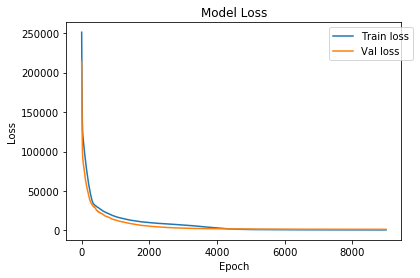

In [27]:
#Plot Model Loss

w = 1000
h1 = np.array(history.history['loss'])
h4 = np.array(history.history['val_loss'])
h1 = moving_average(h1,w)
h4 = moving_average(h4,w)
plt.plot(h1,label='Train loss')
plt.plot(h4,label='Val loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

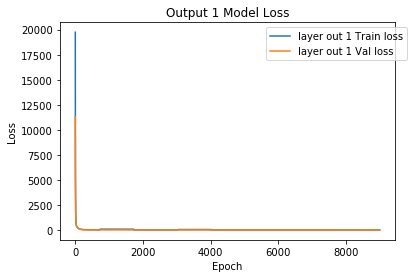

In [28]:
#Plot output 1 loss

h2 = np.array(history.history['out1_loss'])
h5 = np.array(history.history['val_out1_loss'])
h2 = moving_average(h2,w)
h5 = moving_average(h5,w)
plt.plot(h2,label='layer out 1 Train loss')
plt.plot(h5,label='layer out 1 Val loss')
plt.title('Output 1 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

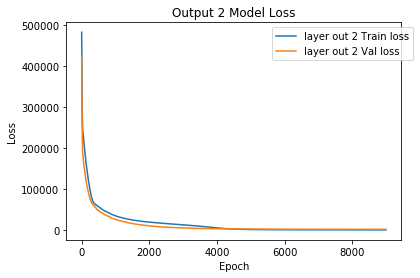

In [29]:
#Plot output 2 loss

h3 = np.array(history.history['out2_loss'])
h6 = np.array(history.history['val_out2_loss'])
h3 = moving_average(h3,w)
h6 = moving_average(h6,w)
plt.plot(h3,label='layer out 2 Train loss')
plt.plot(h6,label='layer out 2 Val loss')
plt.title('Output 2 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

In [30]:
#visualize graph

%tensorboard --logdir logs
#if issue delete log in C:\Users\Asus\AppData\Local\Temp\.tensor_board

In [25]:
#load ground truth

ytest2 = np.zeros((34,1))
for i in range(34):
    ytest2[i] =  ytest[i][0]
    
ytest2 =ytest2.reshape(34,)
ytest2

array([5200.06240689, 5199.53996377, 5199.38385495, 5199.90259139,
       5199.07392439, 5200.06254665, 5201.71337556, 5199.46692995,
       5191.19252021, 5201.00839006, 5199.94913699, 5200.59647541,
       5199.83317387, 5201.12597105, 5200.70659963, 5199.62302112,
       5200.05003236, 5199.46864121, 5200.16739969, 5200.3910136 ,
       5199.50715525, 5197.58624754, 5198.22466621, 5197.58387877,
       5199.3298615 , 5198.30979299, 5197.82064328, 5196.60569833,
       5196.94526825, 5196.76573765, 5196.30629597, 5200.03630537,
       5196.84198044, 5198.70295026])

In [26]:
#Load ground truth sequence

fleet_Rul_File = "ytestT.csv"
fleet_RUL = pd.read_csv(fleet_Rul_File, skiprows = 0,header = None)
#fleet_RUL = fleet_RUL*(thrmax-thrmin) + thrmin
fleet_RUL_np = np.zeros((34,24))
for i in range(34):
    for j in range(24):
        fleet_RUL_np[i][j] = fleet_RUL[i][j]

fleet_RUL_np.shape

(34, 24)

In [27]:
#Prediction

#Make 100 predictions and calculate average RMSE

import sklearn
import math
from sklearn import metrics

rmse = np.zeros(100)
rmse1 = np.zeros(100)

for i in range(100):
    
    preds = model(x_test)
    tens_draw = preds[0].sample(1000)
    tens_draw1 = preds[1].sample(1000)
    tens_draw2 = preds[2]
    tens_draw = tf.keras.backend.get_value(tens_draw)
    tens_draw1 = tf.keras.backend.get_value(tens_draw1)
    tens_draw2 = tf.keras.backend.get_value(tens_draw2)

    #RMSE with AU

    #Predicted RUL for each Fleet
    mean_Fleet_All = np.zeros((tens_draw.shape[1],tens_draw.shape[2]))
    mean_Fleet = np.zeros(tens_draw.shape[0])
    for s in range(tens_draw.shape[2]):
        for y in range(tens_draw.shape[1]):
            for x in range(tens_draw.shape[0]):
                mean_Fleet[x] = tens_draw[x,y,s]
            mean_Fleet_All[y][s] = mean_Fleet.mean()

    RUL_mse = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All)
    RUL_rmse = math.sqrt(RUL_mse)
    rmse[i] = RUL_rmse

    mean_Fleet_All1 = np.zeros((tens_draw1.shape[1],tens_draw1.shape[2]))
    mean_Fleet1 = np.zeros(tens_draw1.shape[0])
    for s in range(tens_draw1.shape[2]):
        for y in range(tens_draw1.shape[1]):
            for x in range(tens_draw1.shape[0]):
                mean_Fleet1[x] = tens_draw1[x,y,s]
            mean_Fleet_All1[y] = mean_Fleet1.mean()

    RUL_mse1 = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All1)
    RUL_rmse1 = math.sqrt(RUL_mse1)
    rmse1[i] = RUL_rmse1

#Average RMSE with AU & EU

np.mean(rmse),np.mean(rmse1)

(128.14124877215596, 34.73500766555886)

In [34]:
#Calculate Mean & Std of prediction with AU

pad = 24
fleet_NUM = np.arange(0,pad,1)

Fleet = pd.DataFrame(np.zeros((pad,tens_draw.shape[0])))
mean = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
std = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
for z in range(tens_draw.shape[1]):
    for y in range(tens_draw.shape[0]):
        for x in range(pad):
            Fleet[y][x] = tens_draw[y,z,x]
    row_Mean = Fleet.mean(axis=1)
    row_Std = Fleet.std(axis=1)
    for j in range(pad):
        mean[z][j] = row_Mean[j]
    for k in range(pad):
        std[z][k] = row_Std[k]

In [35]:
#Calculate Mean & Std of prediction with EU

Fleet1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[0])))
mean1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
std1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
for z in range(tens_draw1.shape[1]):
    for y in range(tens_draw1.shape[0]):
        for x in range(pad):
            Fleet1[y][x] = tens_draw1[y,z,x]
    row_Mean = Fleet1.mean(axis=1)
    row_Std = Fleet1.std(axis=1)
    for j in range(pad):
        mean1[z][j] = row_Mean[j]
    for k in range(pad):
        std1[z][k] = row_Std[k]

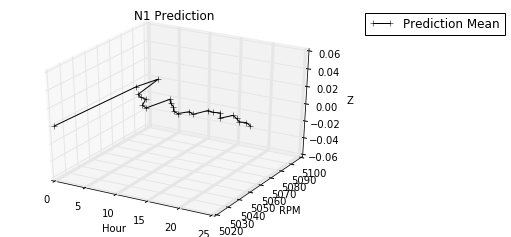

In [36]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("N1 Prediction")
ax.set_xlabel('Hour')
ax.set_ylabel('RPM')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
#ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
#ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_1.tiff',bbox_inches='tight')
plt.show()

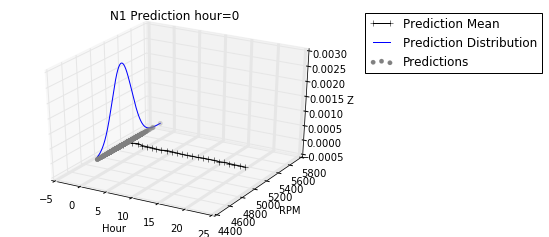

In [37]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 0

ax.set_title("N1 Prediction hour=%i" % i)
ax.set_xlabel('Hour')
ax.set_ylabel('RPM')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_2.tiff',bbox_inches='tight')
plt.show()

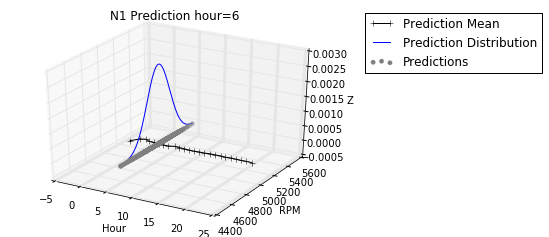

In [38]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 5

ax.set_title("N1 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('RPM')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_3.tiff',bbox_inches='tight')
plt.show()

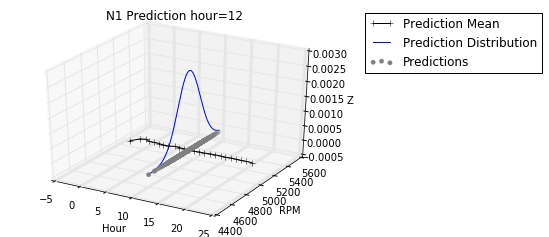

In [39]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 11

ax.set_title("N1 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('RPM')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_4.tiff',bbox_inches='tight')
plt.show()

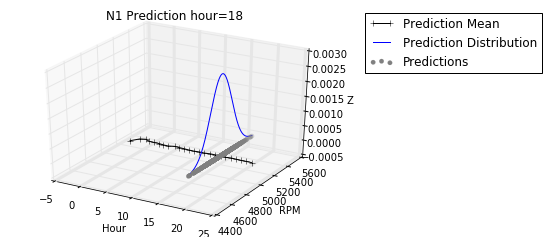

In [40]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("N1 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('RPM')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_5.tiff',bbox_inches='tight')
plt.show()

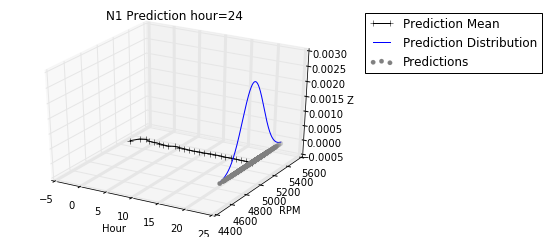

In [41]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 23

ax.set_title("N1 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('RPM')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_6.tiff',bbox_inches='tight')
plt.show()

In [42]:
#Load date of prediction

date = "date.csv"
date = pd.read_csv(date, skiprows = 0,header = None)
date = date.to_numpy()

In [43]:
#Load hour of prediction

hour_NUM = ['5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am','12pm','1pm','2pm','3pm','4pm']

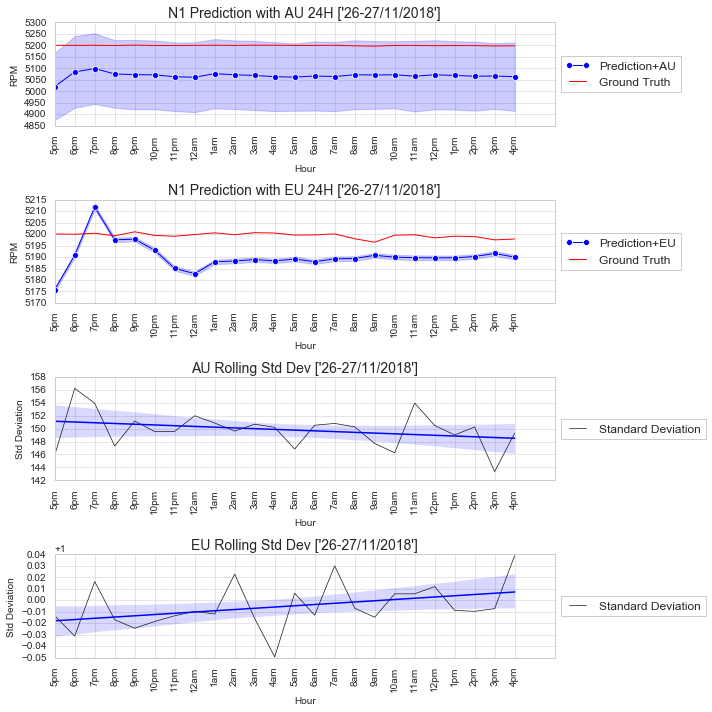

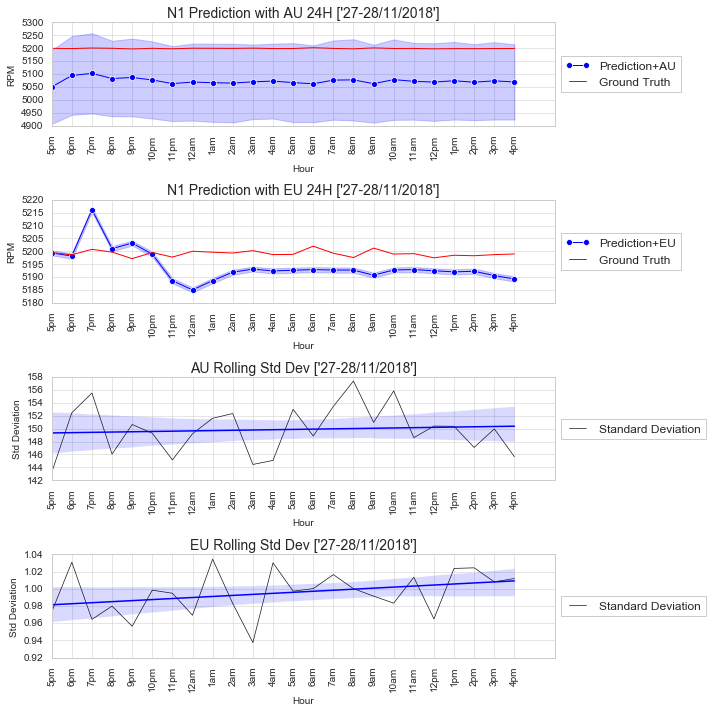

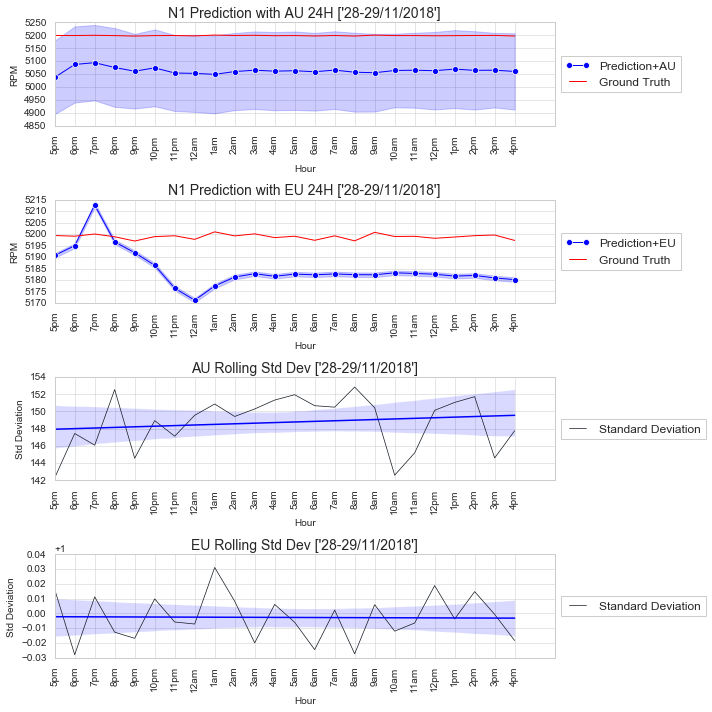

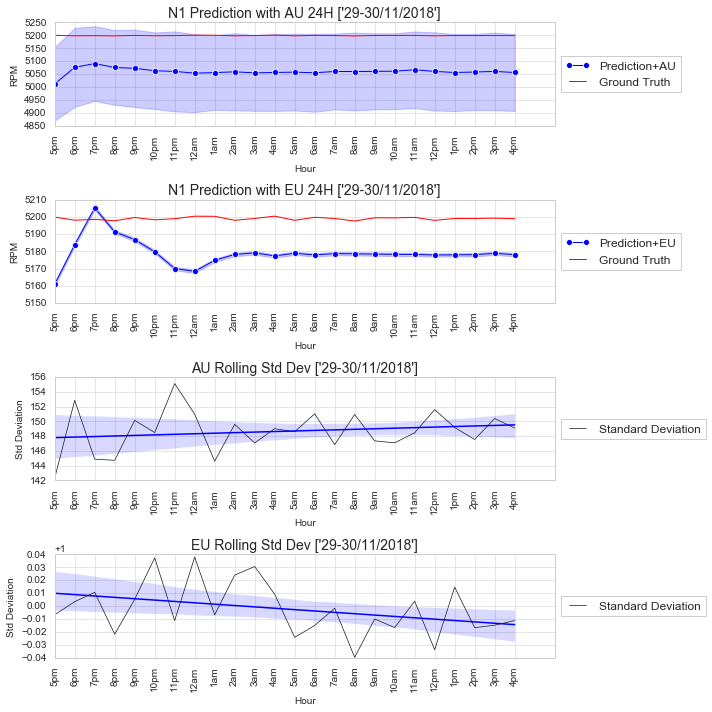

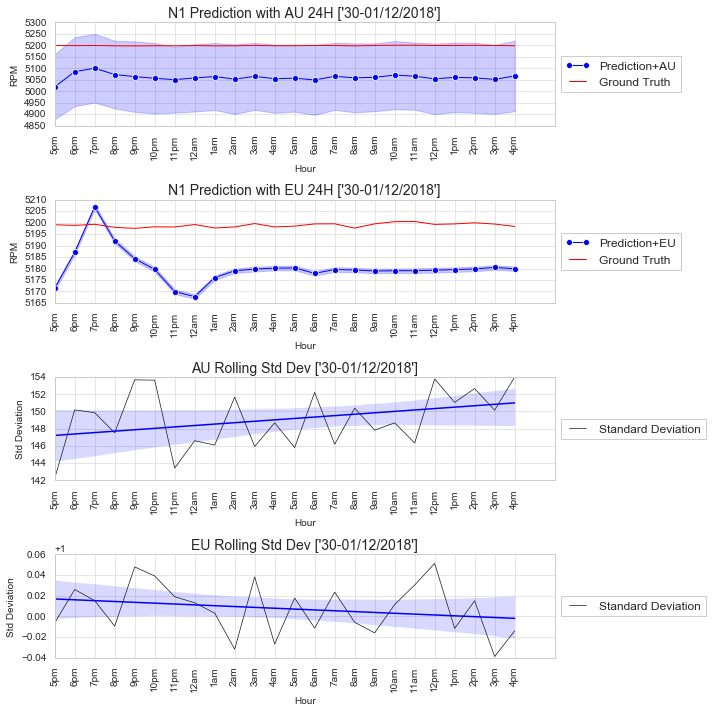

...

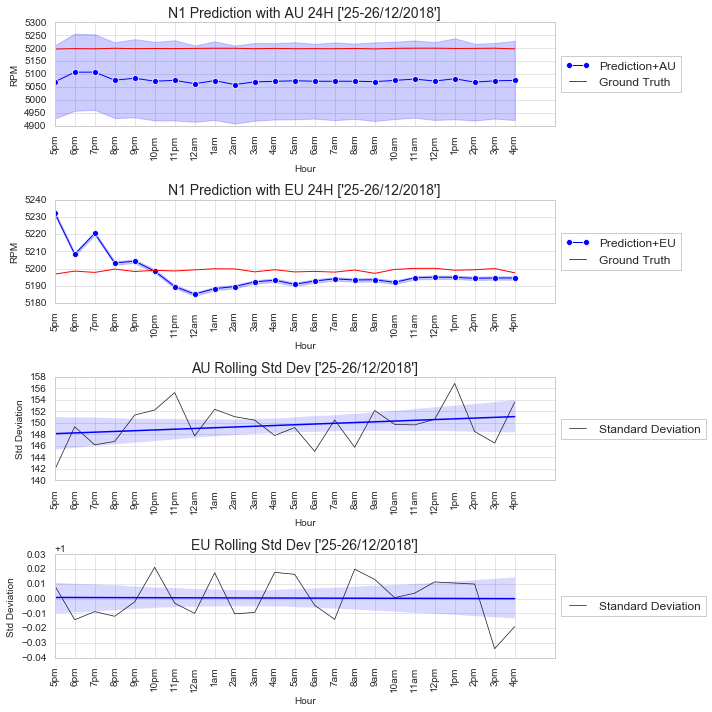

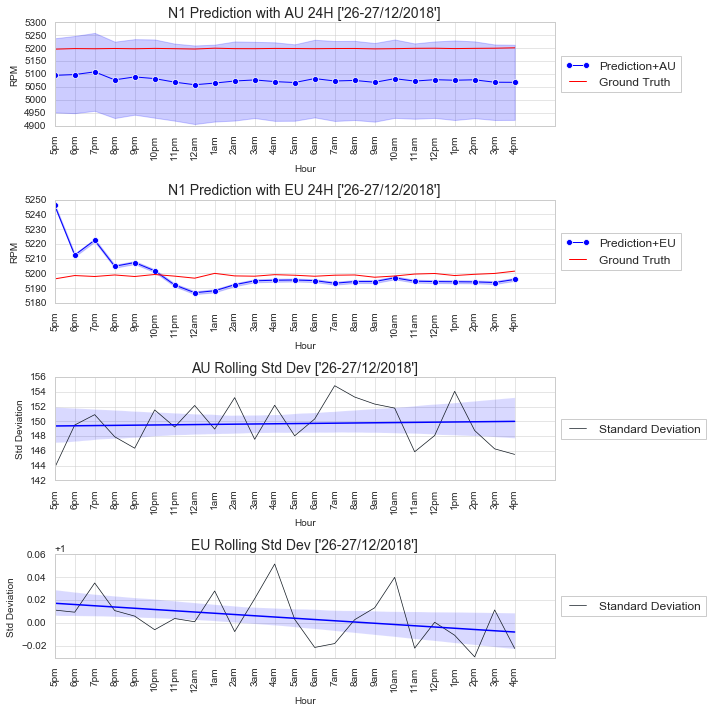

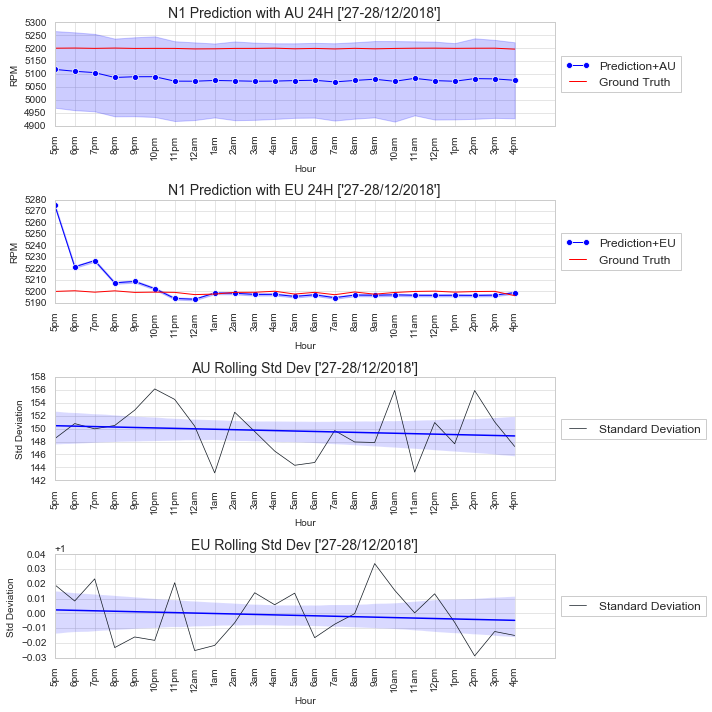

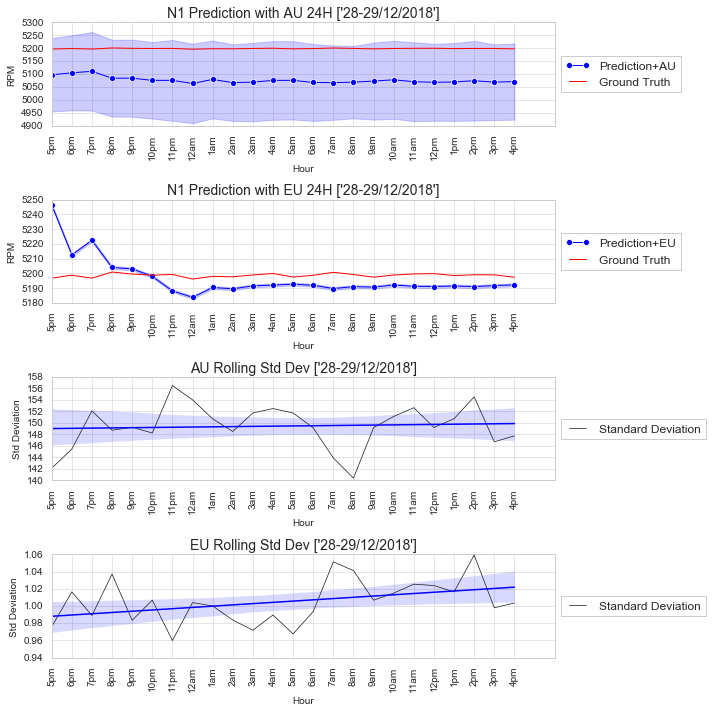

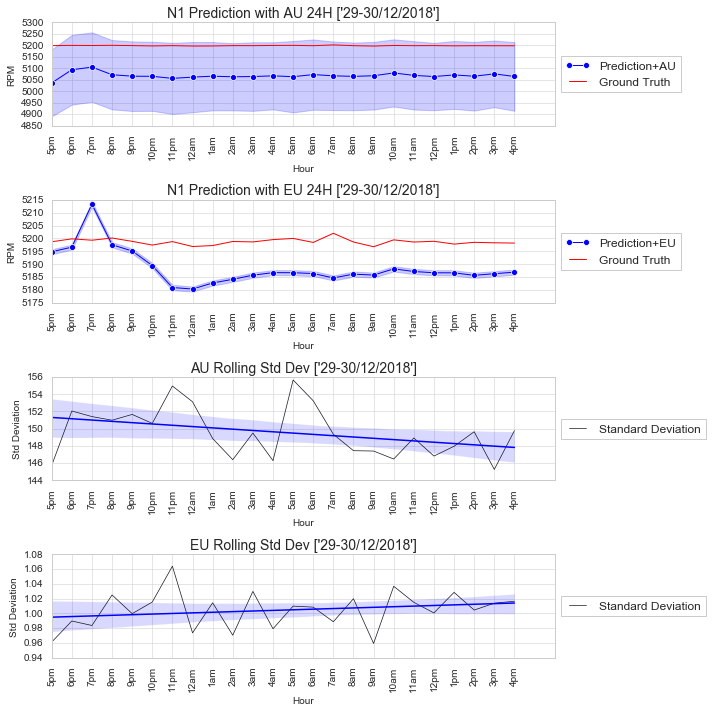

In [44]:
#Prediction Visualization

import seaborn as sns
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes 
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from scipy import stats
sns.set_style("whitegrid")
for B in range(34):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw.shape[0])))
    for y in range(tens_draw.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw.shape[0]:
        if(m < (tens_draw.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue
    
    max_Seq1 = pd.DataFrame(np.zeros((lim,tens_draw1.shape[0])))
    for y in range(tens_draw1.shape[0]):
        for x in range(lim):
            max_Seq1[y][x] = tens_draw1[y,B,x]

    max_Seq_Arrange1 = pd.DataFrame(np.zeros((lim*tens_draw1.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw1.shape[0]:
        if(m < (tens_draw1.shape[0])):
            max_Seq_Arrange1[0][s] = fleet_NUM[z]
            max_Seq_Arrange1[1][s] = max_Seq1[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','RPM']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = fleet_RUL[B][x]
    max_RUL_Arrange.columns = ['Hour','RPM']
    
    max_Seq_Arrange1.columns = ['Hour','RPM']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std[B][x]
    min_Std_Arrange.columns = ['Hour','RPM']
    
    med_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        med_Std_Arrange[0][x] = fleet_NUM[x]
        med_Std_Arrange[1][x] = std1[B][x]
    med_Std_Arrange.columns = ['Hour','RPM']
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['RPM'])
    gs = gridspec.GridSpec(4,1)
    fig = plt.figure(figsize=(10,10))
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="RPM",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="Prediction+AU")
    sns.lineplot(x="Hour", y="RPM", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('N1 Prediction with AU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[1])
    sns.lineplot(x="Hour", y="RPM",ci = "sd", marker='o', data=max_Seq_Arrange1, ax=ax, label="Prediction+EU")
    sns.lineplot(x="Hour", y="RPM", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('N1 Prediction with EU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    

    ax = fig.add_subplot(gs[2])
    ax.plot('Hour', 'RPM', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['RPM'],scatter = False)
    plt.title('AU Rolling Std Dev ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[3])
    ax.plot('Hour', 'RPM', data=med_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(med_Std_Arrange['Hour'],med_Std_Arrange['RPM'],scatter = False)
    plt.title('EU Rolling Std Dev ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.savefig("N1_Pred %i" %B+'.tiff')
    plt.show()

In [25]:
#SHAP cannot be used with model with probabilistic layers. So, transfer learned weights of probabilistic LSTM to a new LSTM without probabilistic layers
#Define New LSTM without probabilistic layers for explanation

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 24, 831)           2778864   
_________________________________________________________________
dense_3 (Dense)              (None, 24, 233)           193856    
_________________________________________________________________
dense_4 (Dense)              (None, 24, 1)             234       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 2,972,954
Trainable params: 2,972,954
Non-trainable params: 0
_________________________________________________________________


In [26]:
#Transfer weights from old LSTM to new LSTM

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(model.layers[5].get_weights())
model2.layers[4].set_weights(model.layers[8].get_weights())

In [27]:
#Prediction with new LSTM

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [28]:
#Import SHAP & initialized JS

import shap
shap.initjs()

In [29]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [30]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)

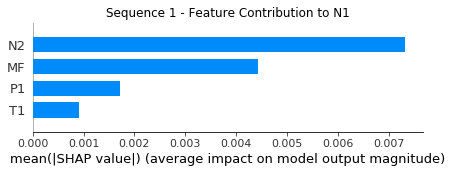

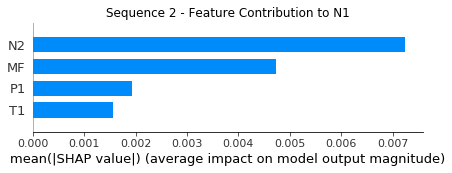

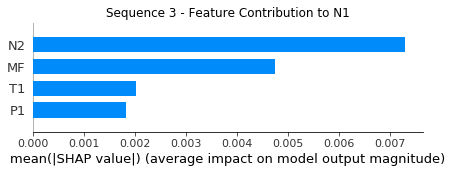

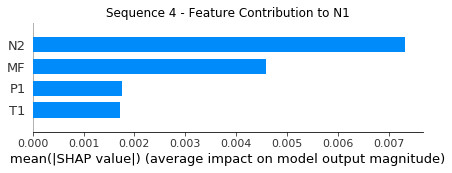

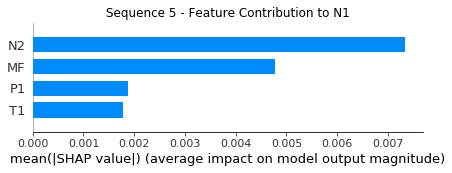

...

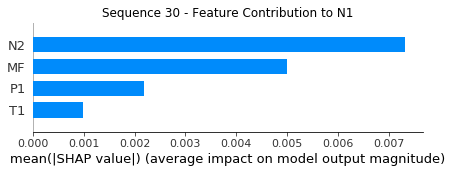

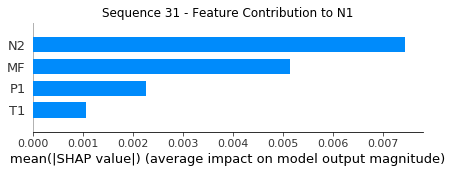

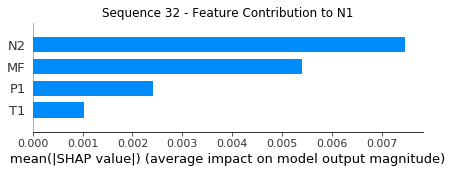

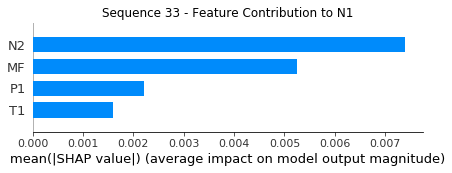

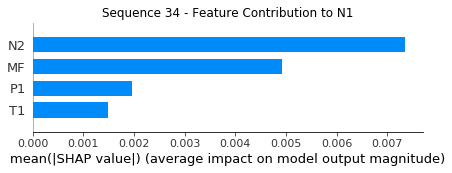

In [31]:
#SHAP Summmary Plot

instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(34):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(7, 2),plot_type="bar")
    plt.title("Sequence %i - Feature Contribution to N1" %(i+1),fontsize=12)
    #plt.savefig("Sum_Plot %i" %i+'.tiff')
    plt.figure
    plt.show()

In [52]:
#SHAP Force Plot - Matplotlib
import seaborn as sns
sns.set_style("ticks")
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    # Per individual array 
    for j in range(24):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,4),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

1 1


1 2


1 3


1 4


1 5


1 6


1 7


1 8


1 9


1 10


1 11


1 12


1 13


1 14


1 15


1 16


1 17


1 18


1 19


1 20


1 21


1 22


1 23


1 24


2 1


2 2


2 3


2 4


2 5


2 6


2 7


2 8


2 9


2 10


2 11


2 12


2 13


2 14


2 15


2 16


2 17


2 18


2 19


2 20


2 21


2 22


2 23


2 24


3 1


3 2


3 3


3 4


3 5


3 6


3 7


3 8


3 9


3 10


3 11


3 12


3 13


3 14


3 15


3 16


3 17


3 18


3 19


3 20


3 21


3 22


3 23


3 24


4 1


4 2


4 3


4 4


4 5


4 6


4 7


4 8


4 9


4 10


4 11


4 12


4 13


4 14


4 15


4 16


4 17


4 18


4 19


4 20


4 21


4 22


4 23


4 24


5 1


5 2


5 3


5 4


5 5


5 6


5 7


5 8


5 9


5 10


5 11


5 12


5 13


5 14


5 15


5 16


5 17


5 18


5 19


5 20


5 21


5 22


5 23


5 24


6 1


6 2


6 3


6 4


6 5


6 6


6 7


6 8


6 9


6 10


6 11


6 12


6 13


6 14


6 15


6 16


6 17


6 18


6 19


6 20


6 21


6 22


6 23


6 24


7 1


7 2


7 3


7 4


7 5


7 6


7 7


7 8


7 9


7 10


7 11


7 12


7 13


7 14


7 15


7 16


7 17


7 18


7 19


7 20


7 21


7 22


7 23


7 24


8 1


8 2


8 3


8 4


8 5


8 6


8 7


8 8


8 9


8 10


8 11


8 12


8 13


8 14


8 15


8 16


8 17


8 18


8 19


8 20


8 21


8 22


8 23


8 24


9 1


9 2


9 3


9 4


9 5


9 6


9 7


9 8


9 9


9 10


9 11


9 12


9 13


9 14


9 15


9 16


9 17


9 18


9 19


9 20


9 21


9 22


9 23


9 24


10 1


10 2


10 3


10 4


10 5


10 6


10 7


10 8


10 9


10 10


10 11


10 12


10 13


10 14


10 15


10 16


10 17


10 18


10 19


10 20


10 21


10 22


10 23


10 24


11 1


11 2


11 3


11 4


11 5


11 6


11 7


11 8


11 9


11 10


11 11


11 12


11 13


11 14


11 15


11 16


11 17


11 18


11 19


11 20


11 21


11 22


11 23


11 24


12 1


12 2


12 3


12 4


12 5


12 6


12 7


12 8


12 9


12 10


12 11


12 12


12 13


12 14


12 15


12 16


12 17


12 18


12 19


12 20


12 21


12 22


12 23


12 24


13 1


13 2


13 3


13 4


13 5


13 6


13 7


13 8


13 9


13 10


13 11


13 12


13 13


13 14


13 15


13 16


13 17


13 18


13 19


13 20


13 21


13 22


13 23


13 24


14 1


14 2


14 3


14 4


14 5


14 6


14 7


14 8


14 9


14 10


14 11


14 12


14 13


14 14


14 15


14 16


14 17


14 18


14 19


14 20


14 21


14 22


14 23


14 24


15 1


15 2


15 3


15 4


15 5


15 6


15 7


15 8


15 9


15 10


15 11


15 12


15 13


15 14


15 15


15 16


15 17


15 18


15 19


15 20


15 21


15 22


15 23


15 24


16 1


16 2


16 3


16 4


16 5


16 6


16 7


16 8


16 9


16 10


16 11


16 12


16 13


16 14


16 15


16 16


16 17


16 18


16 19


16 20


16 21


16 22


16 23


16 24


17 1


17 2


17 3


17 4


17 5


17 6


17 7


17 8


17 9


17 10


17 11


17 12


17 13


17 14


17 15


17 16


17 17


17 18


17 19


17 20


17 21


17 22


17 23


17 24


18 1


18 2


18 3


18 4


18 5


18 6


18 7


18 8


18 9


18 10


18 11


18 12


18 13


18 14


18 15


18 16


18 17


18 18


18 19


18 20


18 21


18 22


18 23


18 24


19 1


19 2


19 3


19 4


19 5


19 6


19 7


19 8


19 9


19 10


19 11


19 12


19 13


19 14


19 15


19 16


19 17


19 18


19 19


19 20


19 21


19 22


19 23


19 24


20 1


20 2


20 3


20 4


20 5


20 6


20 7


20 8


20 9


20 10


20 11


20 12


20 13


20 14


20 15


20 16


20 17


20 18


20 19


20 20


20 21


20 22


20 23


20 24


21 1


21 2


21 3


21 4


21 5


21 6


21 7


21 8


21 9


21 10


21 11


21 12


21 13


21 14


21 15


21 16


21 17


21 18


21 19


21 20


21 21


21 22


21 23


21 24


22 1


22 2


22 3


22 4


22 5


22 6


22 7


22 8


22 9


22 10


22 11


22 12


22 13


22 14


22 15


22 16


22 17


22 18


22 19


22 20


22 21


22 22


22 23


22 24


23 1


23 2


23 3


23 4


23 5


23 6


23 7


23 8


23 9


23 10


23 11


23 12


23 13


23 14


23 15


23 16


23 17


23 18


23 19


23 20


23 21


23 22


23 23


23 24


24 1


24 2


24 3


24 4


24 5


24 6


24 7


24 8


24 9


24 10


24 11


24 12


24 13


24 14


24 15


24 16


24 17


24 18


24 19


24 20


24 21


24 22


24 23


24 24


25 1


25 2


25 3


25 4


25 5


25 6


25 7


25 8


25 9


25 10


25 11


25 12


25 13


25 14


25 15


25 16


25 17


25 18


25 19


25 20


25 21


25 22


25 23


25 24


26 1


26 2


26 3


26 4


26 5


26 6


26 7


26 8


26 9


26 10


26 11


26 12


26 13


26 14


26 15


26 16


26 17


26 18


26 19


26 20


26 21


26 22


26 23


26 24


27 1


27 2


27 3


27 4


27 5


27 6


27 7


27 8


27 9


27 10


27 11


27 12


27 13


27 14


27 15


27 16


27 17


27 18


27 19


27 20


27 21


27 22


27 23


27 24


28 1


28 2


28 3


28 4


28 5


28 6


28 7


28 8


28 9


28 10


28 11


28 12


28 13


28 14


28 15


28 16


28 17


28 18


28 19


28 20


28 21


28 22


28 23


28 24


29 1


29 2


29 3


29 4


29 5


29 6


29 7


29 8


29 9


29 10


29 11


29 12


29 13


29 14


29 15


29 16


29 17


29 18


29 19


29 20


29 21


29 22


29 23


29 24


30 1


30 2


30 3


30 4


30 5


30 6


30 7


30 8


30 9


30 10


30 11


30 12


30 13


30 14


30 15


30 16


30 17


30 18


30 19


30 20


30 21


30 22


30 23


30 24


31 1


31 2


31 3


31 4


31 5


31 6


31 7


31 8


31 9


31 10


31 11


31 12


31 13


31 14


31 15


31 16


31 17


31 18


31 19


31 20


31 21


31 22


31 23


31 24


32 1


32 2


32 3


32 4


32 5


32 6


32 7


32 8


32 9


32 10


32 11


32 12


32 13


32 14


32 15


32 16


32 17


32 18


32 19


32 20


32 21


32 22


32 23


32 24


33 1


33 2


33 3


33 4


33 5


33 6


33 7


33 8


33 9


33 10


33 11


33 12


33 13


33 14


33 15


33 16


33 17


33 18


33 19


33 20


33 21


33 22


33 23


33 24


34 1


34 2


34 3


34 4


34 5


34 6


34 7


34 8


34 9


34 10


34 11


34 12


34 13


34 14


34 15


34 16


34 17


34 18


34 19


34 20


34 21


34 22


34 23


34 24


Contribution: [-0.03676754 -0.01440894 -0.14733169 -0.07584286]


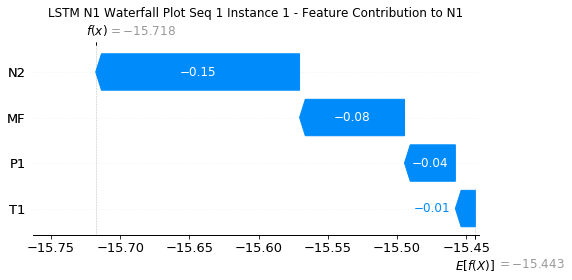

None

Contribution: [0.00063793 0.00029853 0.00192546 0.00180042]


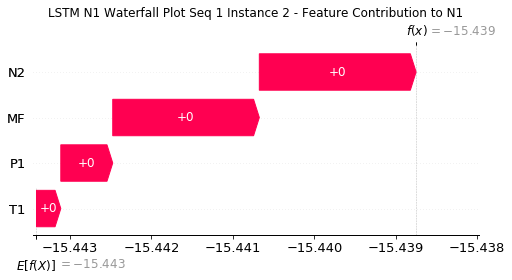

None

Contribution: [-7.37561552e-05 -7.93597749e-05 -3.13081094e-04 -2.63801782e-04]


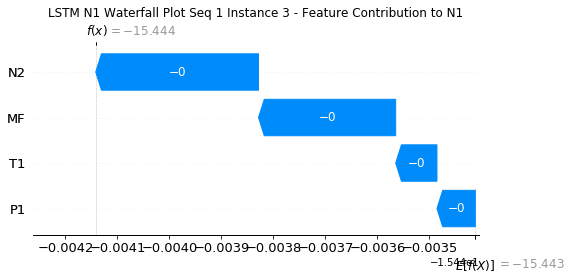

None

Contribution: [-0.00013453 -0.00010087 -0.00058655 -0.00047909]


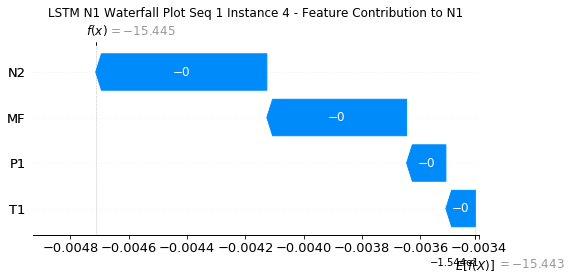

None

Contribution: [-0.00013975 -0.00011011 -0.00050154 -0.00041168]


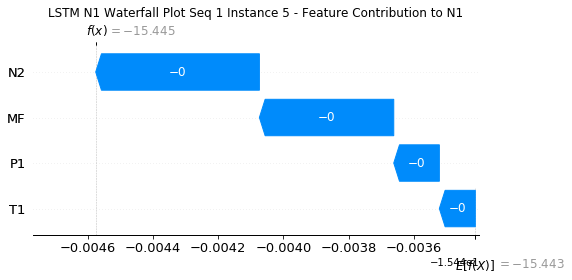

None

Contribution: [-1.34105076e-04 -9.88550991e-05 -4.56221208e-04 -3.69314066e-04]


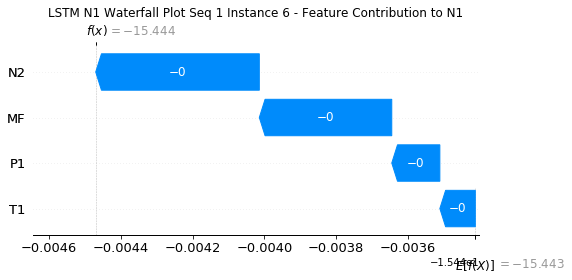

None

Contribution: [-0.00014105 -0.000105   -0.00049144 -0.0003923 ]


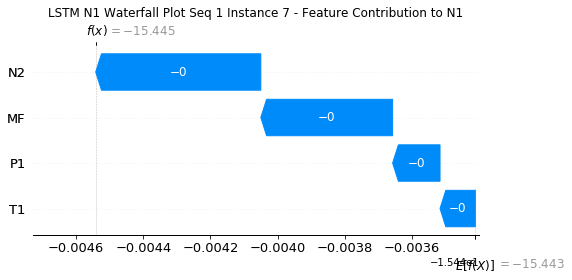

None

Contribution: [-0.00014243 -0.00011119 -0.0005134  -0.00040043]


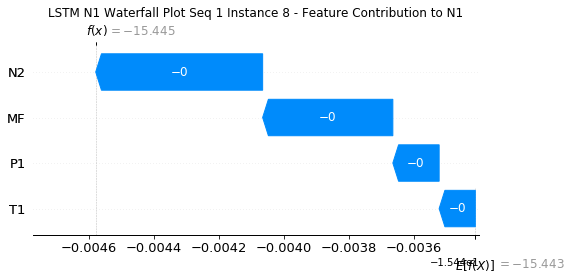

None

Contribution: [-0.00014182 -0.00010883 -0.00050625 -0.00040476]


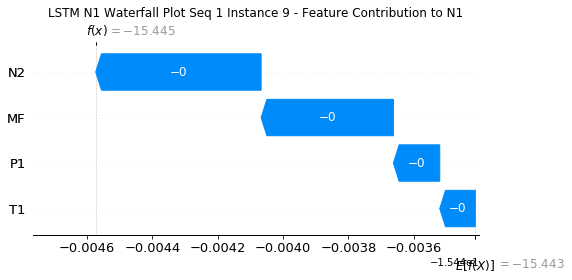

None

Contribution: [-0.00014111 -0.0001037  -0.00048964 -0.00040278]


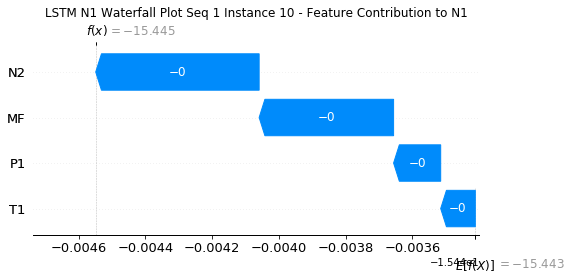

None

Contribution: [-0.00013638 -0.00010023 -0.00047217 -0.0003856 ]


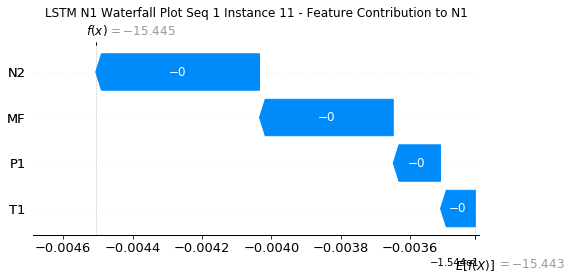

None

Contribution: [-1.33444662e-04 -9.55928767e-05 -4.56342715e-04 -3.70783553e-04]


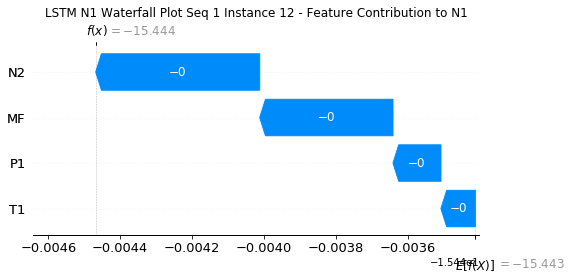

None

Contribution: [-1.27727528e-04 -9.31693321e-05 -4.41993855e-04 -3.58390909e-04]


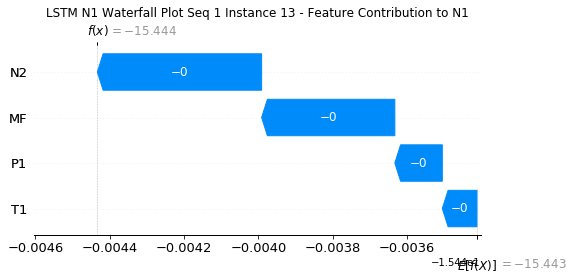

None

Contribution: [-1.21753202e-04 -8.95341182e-05 -4.27167222e-04 -3.43492389e-04]


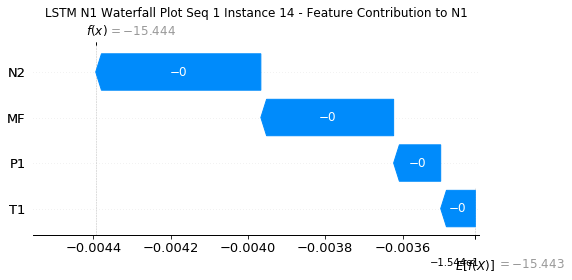

None

Contribution: [-1.20380978e-04 -8.72402687e-05 -4.16169066e-04 -3.35213881e-04]


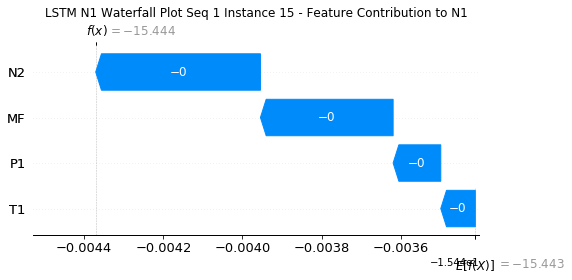

None

Contribution: [-1.17254111e-04 -8.48544739e-05 -4.05492671e-04 -3.25406531e-04]


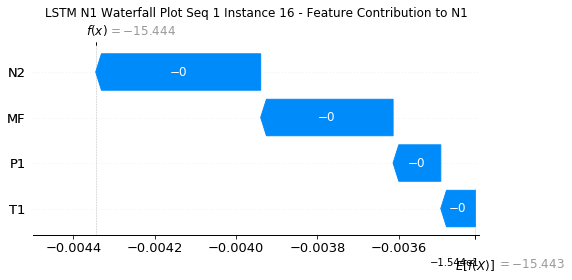

None

Contribution: [-1.14324887e-04 -8.37582745e-05 -3.98293054e-04 -3.19814793e-04]


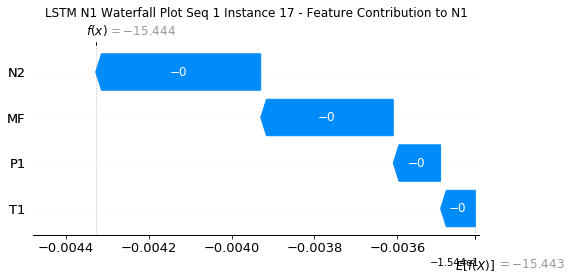

None

Contribution: [-1.14254662e-04 -8.07448712e-05 -3.91052066e-04 -3.10828471e-04]


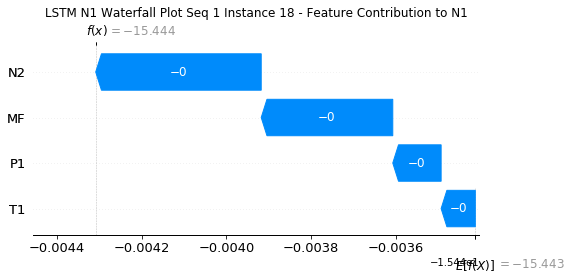

None

Contribution: [-1.14241634e-04 -7.65287285e-05 -3.84060423e-04 -3.01794511e-04]


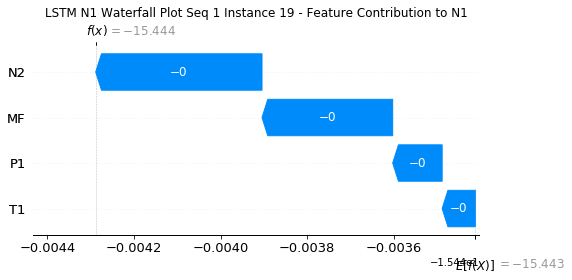

None

Contribution: [-1.15469197e-04 -6.86683801e-05 -3.71555293e-04 -2.82740738e-04]


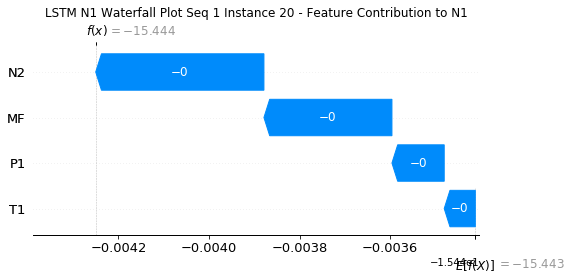

None

Contribution: [-1.05036747e-04 -6.30766666e-05 -3.39963018e-04 -2.16087927e-04]


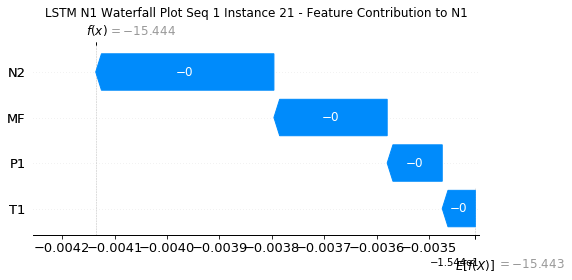

None

Contribution: [-0.00010375 -0.00012514 -0.00036389 -0.00029866]


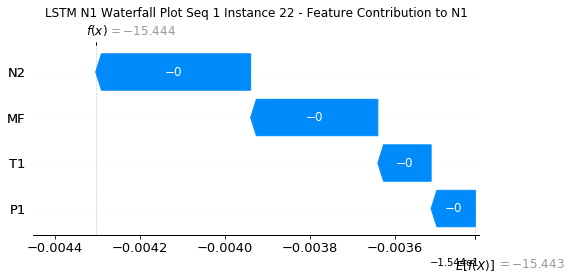

None

Contribution: [ 0.00019791 -0.00014284 -0.00253298 -0.00377031]


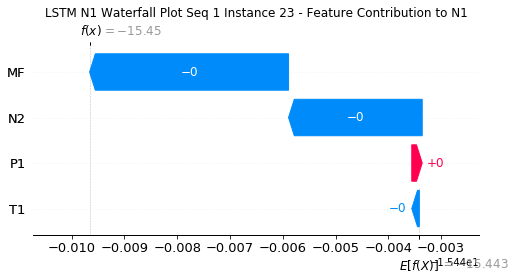

None

Contribution: [-0.00108748  0.00500576 -0.01512476 -0.01784792]


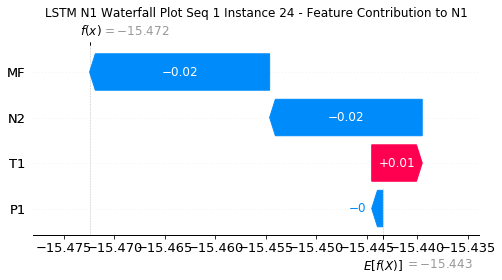

None

Contribution: [-0.04153835 -0.01691883 -0.14578199 -0.07892459]


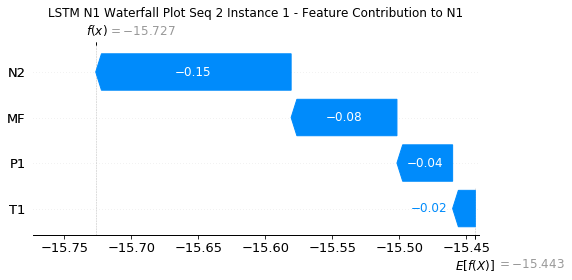

None

Contribution: [0.00064297 0.00030792 0.001899   0.00180101]


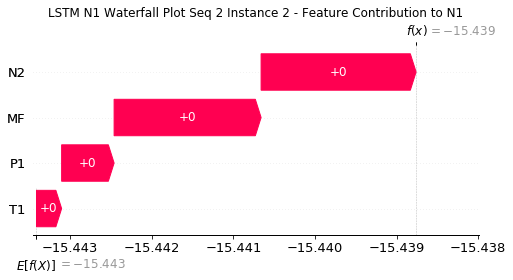

None

Contribution: [-7.40379547e-05 -8.06945323e-05 -3.10512963e-04 -2.62759628e-04]


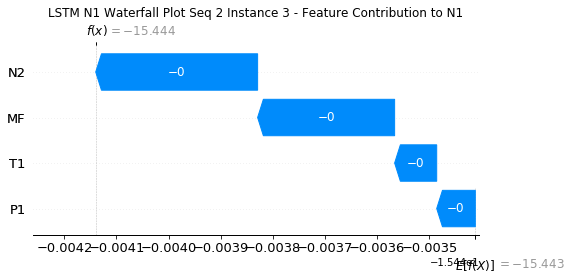

None

Contribution: [-0.00014151 -0.0001191  -0.00058011 -0.00048421]


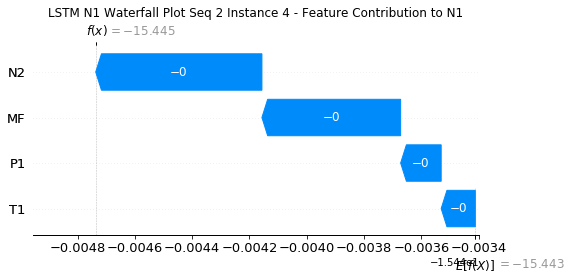

None

Contribution: [-0.00014097 -0.00011675 -0.00049647 -0.00041273]


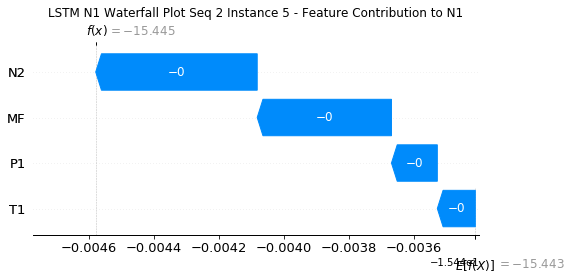

None

Contribution: [-0.0001356  -0.00010449 -0.00045363 -0.00037084]


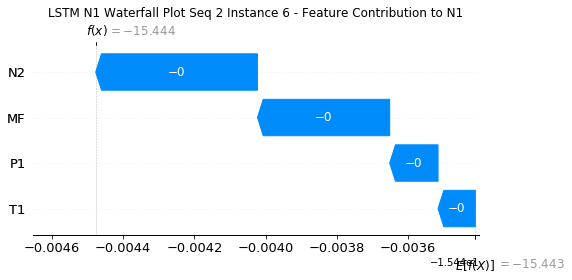

None

Contribution: [-0.00014113 -0.00010777 -0.00048729 -0.00039205]


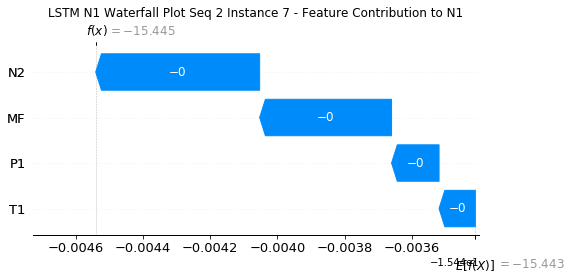

None

Contribution: [-0.00014385 -0.00011155 -0.00050895 -0.00040031]


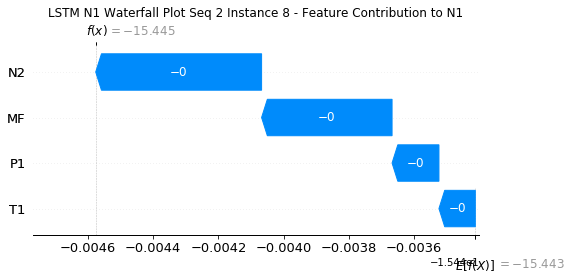

None

Contribution: [-0.0001437  -0.00010878 -0.00050066 -0.00040094]


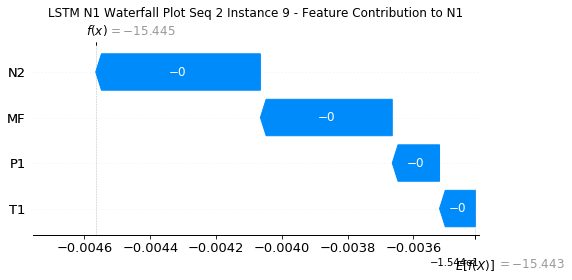

None

Contribution: [-0.00014222 -0.00010999 -0.00048656 -0.00040314]


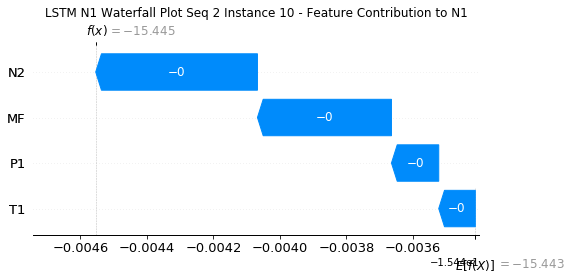

None

Contribution: [-0.00013698 -0.00010646 -0.00046922 -0.0003862 ]


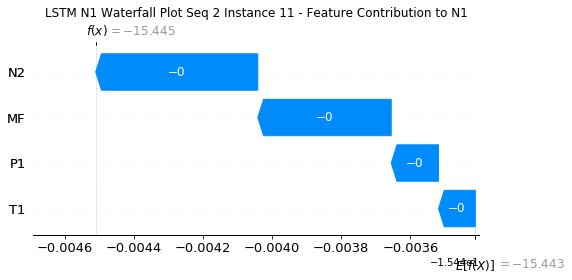

None

Contribution: [-1.33050351e-04 -9.93641907e-05 -4.53025570e-04 -3.71929267e-04]


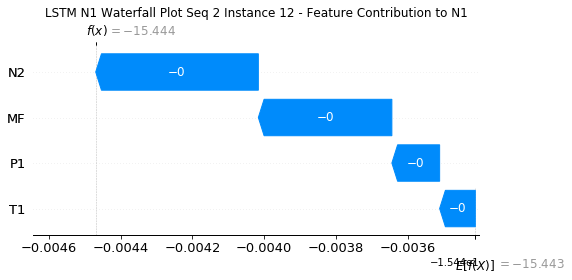

None

Contribution: [-1.28101462e-04 -9.76247242e-05 -4.38742307e-04 -3.58217872e-04]


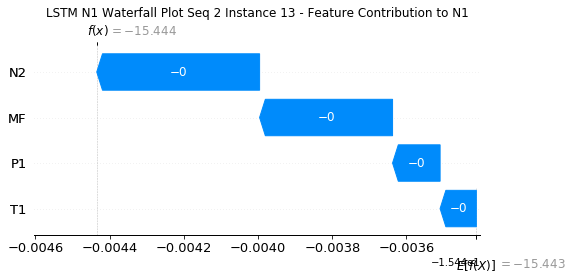

None

Contribution: [-1.22369303e-04 -9.44163442e-05 -4.24963845e-04 -3.46616373e-04]


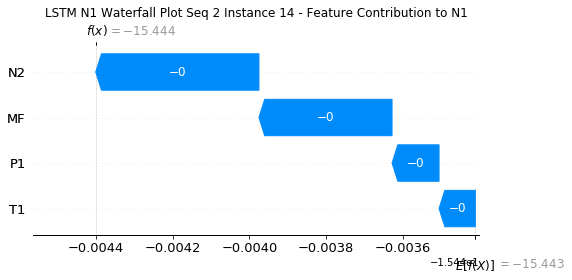

None

Contribution: [-1.20155696e-04 -9.16827454e-05 -4.12944355e-04 -3.34448264e-04]


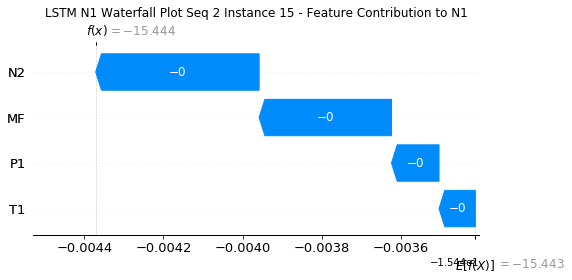

None

Contribution: [-1.17177690e-04 -8.96441316e-05 -4.02538264e-04 -3.24435132e-04]


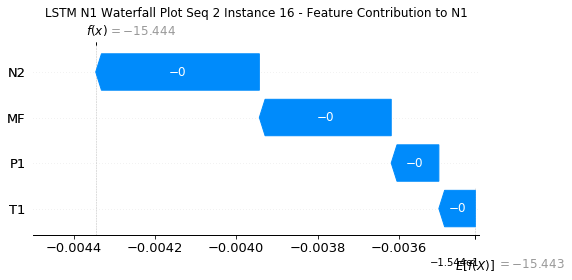

None

Contribution: [-1.13354568e-04 -8.54287104e-05 -3.93770231e-04 -3.12440570e-04]


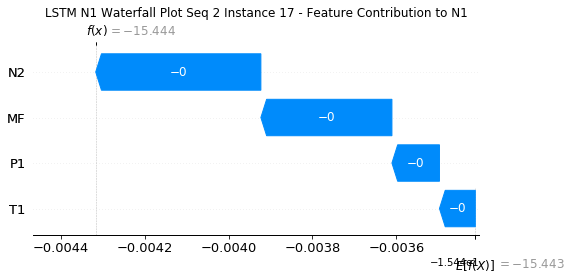

None

Contribution: [-1.13894011e-04 -8.37979799e-05 -3.88491193e-04 -3.10474046e-04]


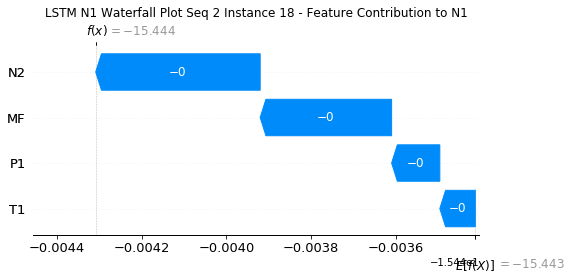

None

Contribution: [-1.13963754e-04 -7.93258936e-05 -3.81587096e-04 -3.01453033e-04]


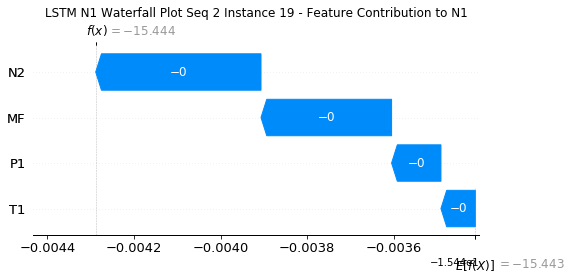

None

Contribution: [-1.15327784e-04 -6.93950223e-05 -3.69519908e-04 -2.82208516e-04]


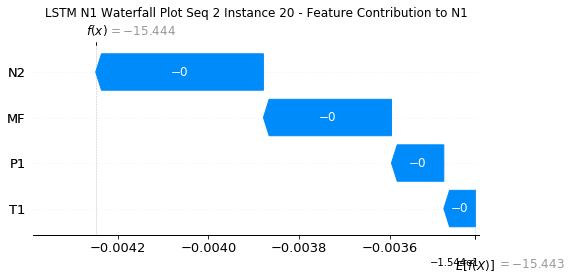

None

Contribution: [-1.04919288e-04 -5.92178921e-05 -3.39535004e-04 -2.14847012e-04]


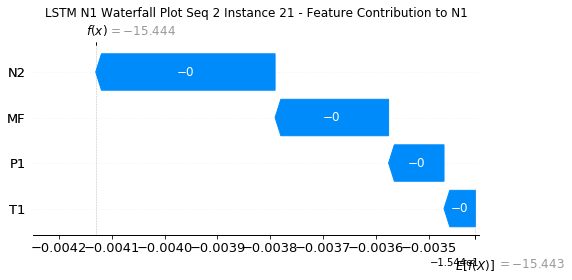

None

Contribution: [-0.0001029  -0.0001287  -0.0003605  -0.00029306]


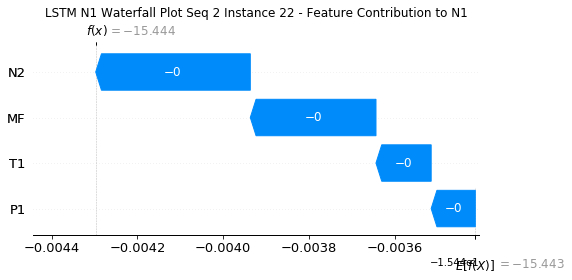

None

Contribution: [ 1.03641365e-04  1.61164126e-05 -2.32144432e-03 -3.12041619e-03]


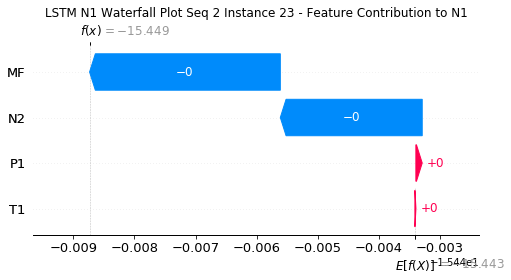

None

Contribution: [-0.00170973  0.01812189 -0.01495366 -0.02286459]


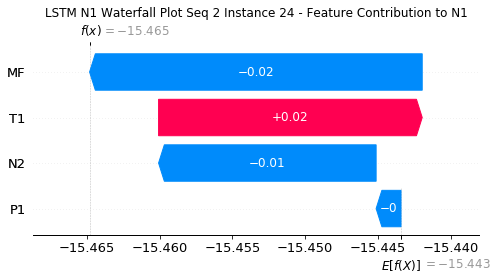

None

Contribution: [-0.0385394  -0.00690785 -0.14786167 -0.08500815]


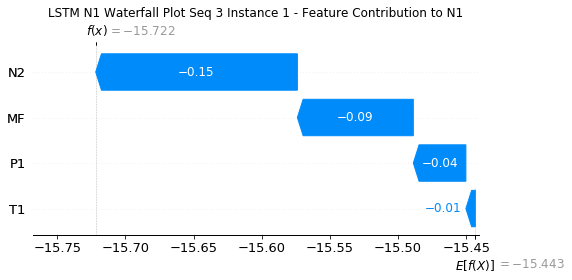

None

Contribution: [0.00064483 0.0002859  0.00193019 0.0018343 ]


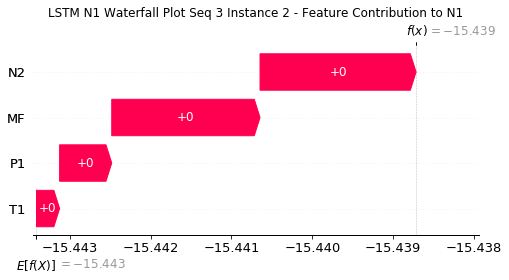

None

Contribution: [-7.38614232e-05 -7.37040554e-05 -3.12867622e-04 -2.65026017e-04]


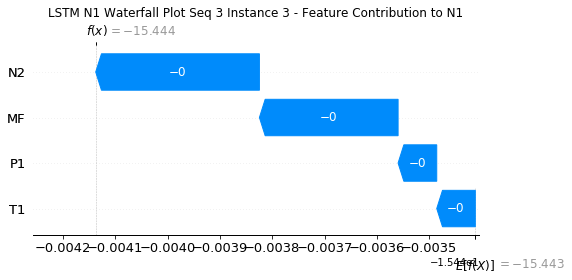

None

Contribution: [-1.37637203e-04 -4.37577507e-05 -5.86560510e-04 -4.88334923e-04]


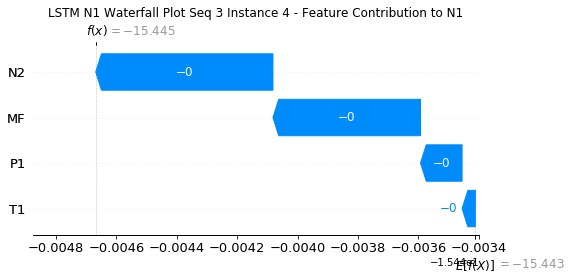

None

Contribution: [-1.39942163e-04 -8.81295635e-05 -5.01870289e-04 -4.15678981e-04]


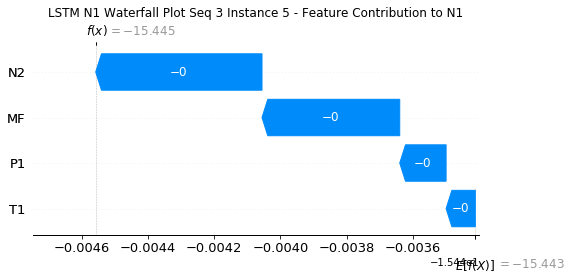

None

Contribution: [-1.34690335e-04 -7.87966646e-05 -4.55871630e-04 -3.71703581e-04]


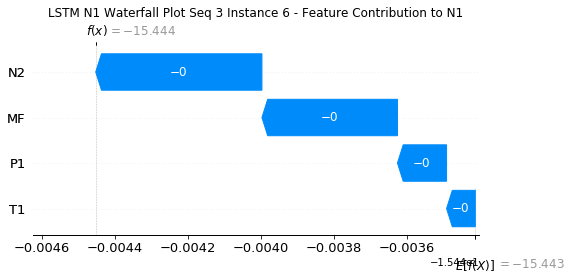

None

Contribution: [-1.36829731e-04 -8.20454377e-05 -4.85817651e-04 -3.87368053e-04]


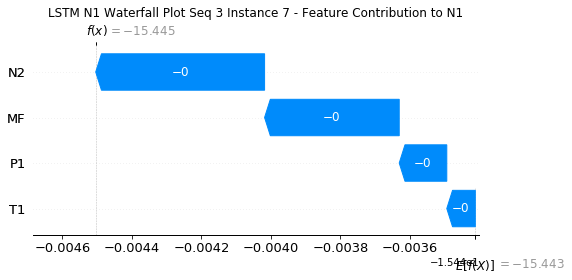

None

Contribution: [-1.43410279e-04 -8.03739363e-05 -5.08313216e-04 -3.96295542e-04]


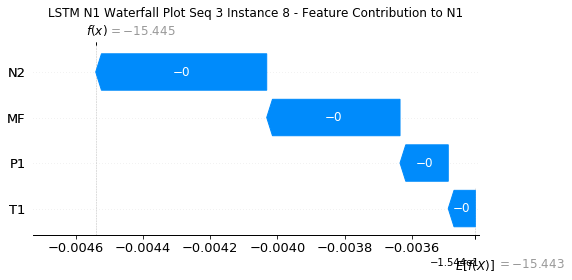

None

Contribution: [-1.39887892e-04 -8.27522126e-05 -5.02504902e-04 -4.00038463e-04]


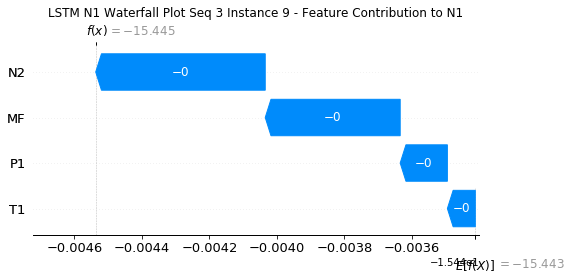

None

Contribution: [-1.41164233e-04 -8.22544422e-05 -4.90006166e-04 -4.05023521e-04]


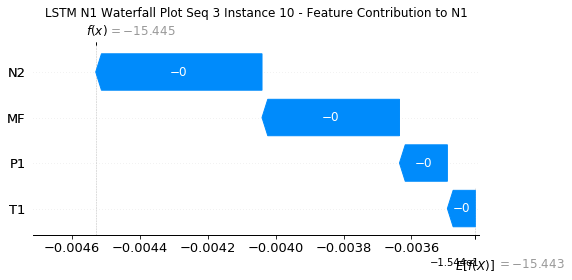

None

Contribution: [-1.36074250e-04 -8.06529856e-05 -4.72666401e-04 -3.88310913e-04]


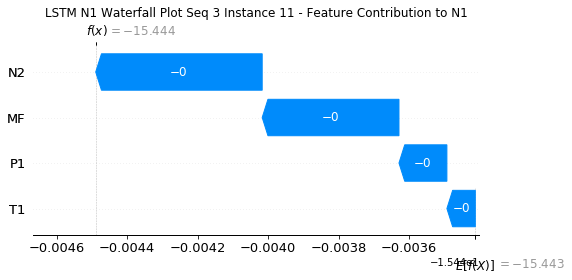

None

Contribution: [-1.31889352e-04 -7.63398362e-05 -4.55579827e-04 -3.71417645e-04]


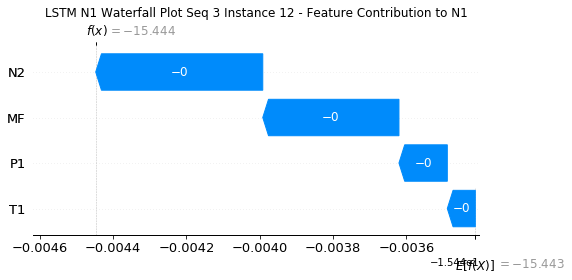

None

Contribution: [-1.27002740e-04 -7.46228117e-05 -4.42032405e-04 -3.59878335e-04]


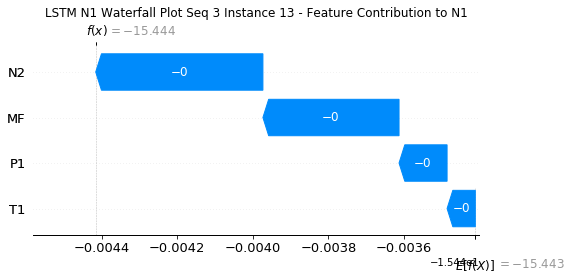

None

Contribution: [-1.23587915e-04 -7.27733237e-05 -4.27701794e-04 -3.46764251e-04]


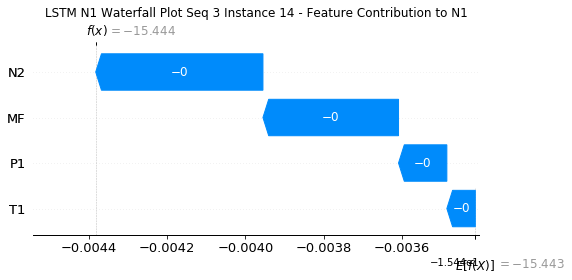

None

Contribution: [-1.19061673e-04 -6.95362817e-05 -4.16145698e-04 -3.36314535e-04]


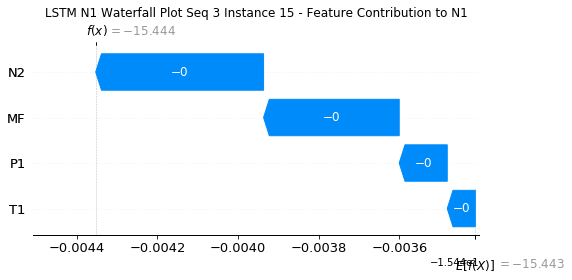

None

Contribution: [-1.16107152e-04 -6.69092360e-05 -4.05465018e-04 -3.26300184e-04]


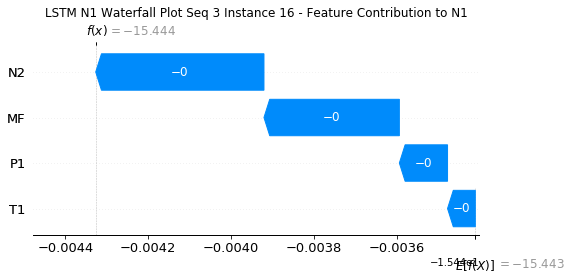

None

Contribution: [-1.14733733e-04 -6.60560067e-05 -3.97126540e-04 -3.17920919e-04]


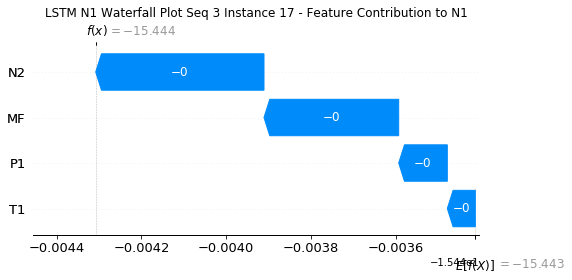

None

Contribution: [-1.12427513e-04 -6.45121204e-05 -3.90996364e-04 -3.11669546e-04]


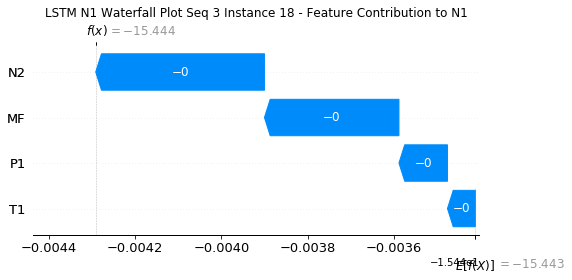

None

Contribution: [-1.12351320e-04 -6.14719472e-05 -3.83726990e-04 -3.02170525e-04]


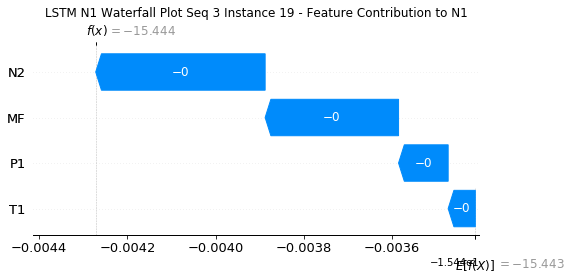

None

Contribution: [-1.12831663e-04 -6.25337796e-05 -3.70820576e-04 -2.81906723e-04]


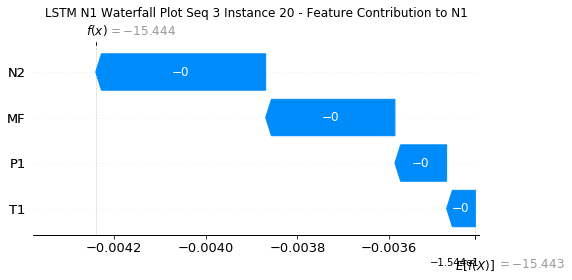

None

Contribution: [-9.94814764e-05 -9.58195966e-05 -3.38664216e-04 -2.10564177e-04]


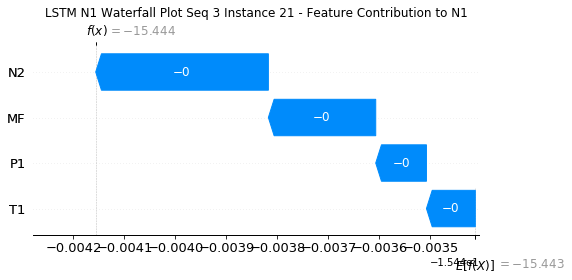

None

Contribution: [-0.00010819 -0.00010475 -0.00036227 -0.00029592]


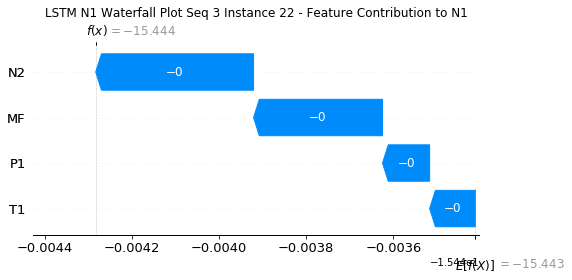

None

Contribution: [ 0.00012757  0.00332063 -0.00241457 -0.00343373]


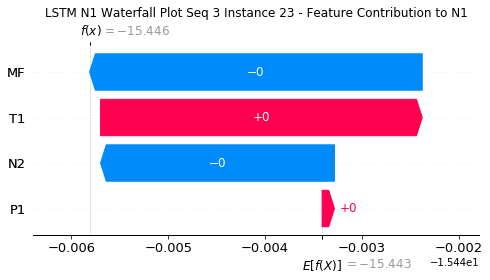

None

Contribution: [-0.00190261  0.03638821 -0.01399591 -0.01654615]


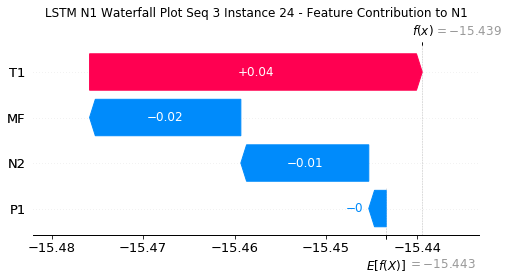

None

Contribution: [-3.72472968e-02  1.28351034e-04 -1.47831633e-01 -7.85233092e-02]


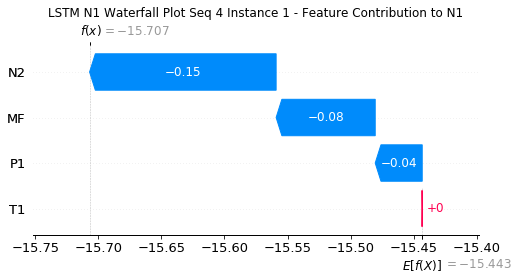

None

Contribution: [0.00065213 0.00029179 0.00196073 0.0018494 ]


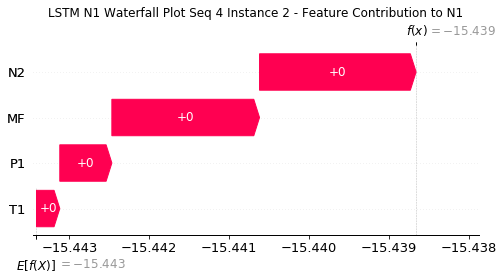

None

Contribution: [-7.48519547e-05 -7.39852614e-05 -3.17441102e-04 -2.68542578e-04]


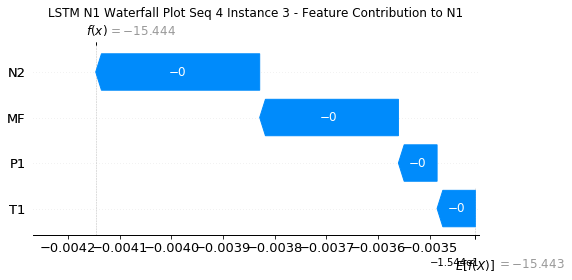

None

Contribution: [-1.38017626e-04 -4.35059903e-05 -5.87658831e-04 -4.83947687e-04]


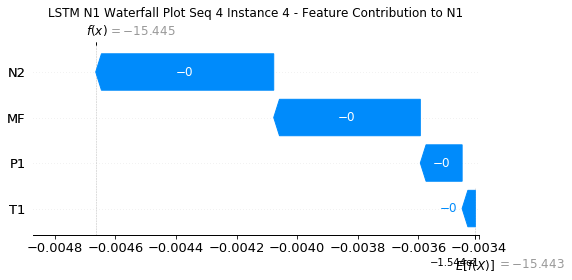

None

Contribution: [-1.41219083e-04 -9.40926271e-05 -5.02078391e-04 -4.14217103e-04]


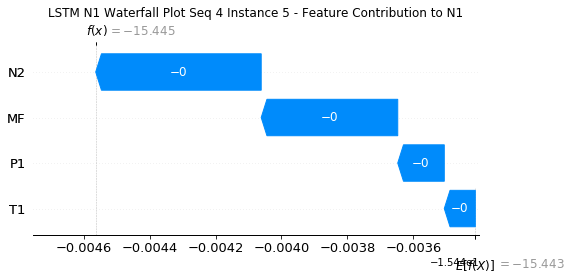

None

Contribution: [-1.35718329e-04 -7.91997014e-05 -4.57268807e-04 -3.70852030e-04]


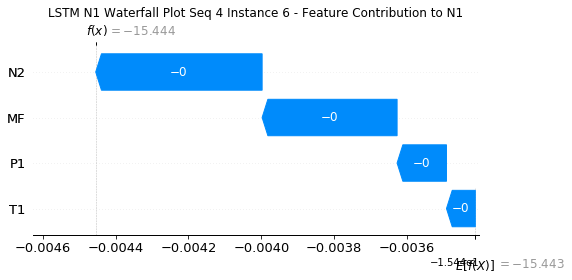

None

Contribution: [-1.40455768e-04 -8.15760111e-05 -4.87720973e-04 -3.85605840e-04]


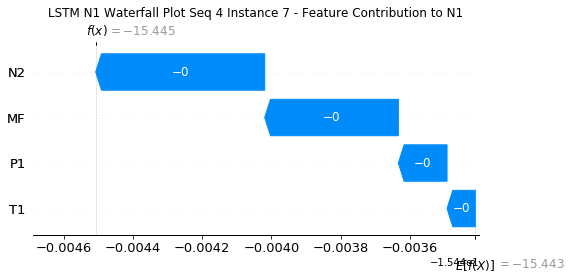

None

Contribution: [-1.43226167e-04 -8.39564671e-05 -5.11484082e-04 -3.97489570e-04]


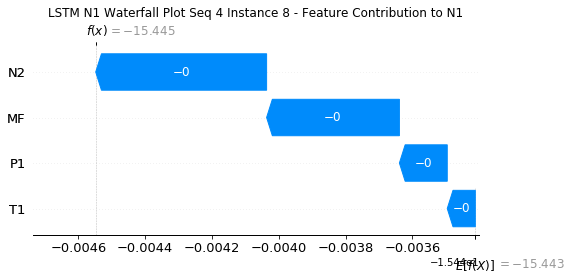

None

Contribution: [-1.40536756e-04 -8.56687291e-05 -5.05573159e-04 -4.01590017e-04]


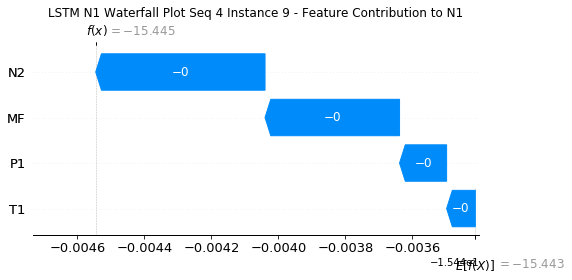

None

Contribution: [-1.42227039e-04 -8.27329099e-05 -4.92288018e-04 -4.07175778e-04]


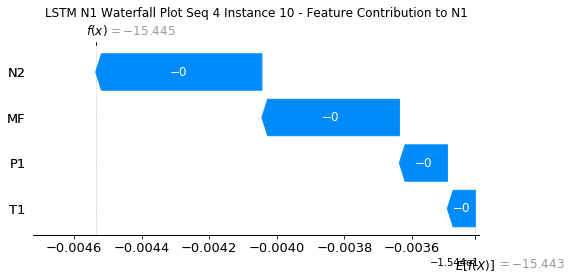

None

Contribution: [-1.37660657e-04 -8.02554035e-05 -4.74991659e-04 -3.90065651e-04]


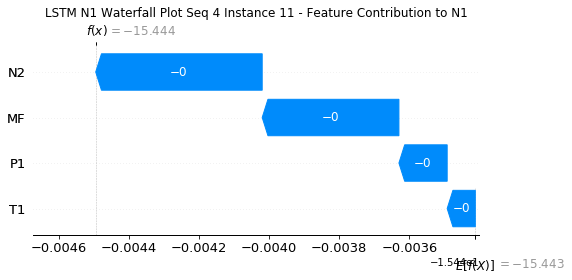

None

Contribution: [-1.29059727e-04 -7.38571112e-05 -4.57284977e-04 -3.71967642e-04]


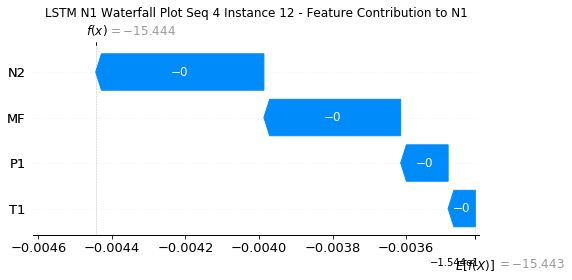

None

Contribution: [-1.28325801e-04 -7.37953212e-05 -4.44368144e-04 -3.61976830e-04]


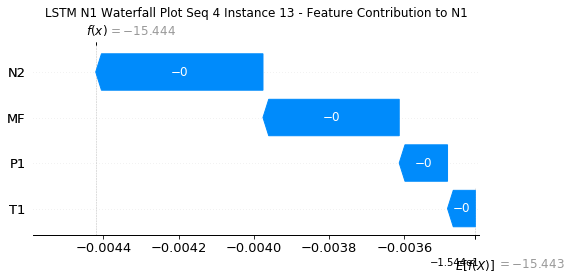

None

Contribution: [-1.25312857e-04 -6.93996413e-05 -4.30472784e-04 -3.48918004e-04]


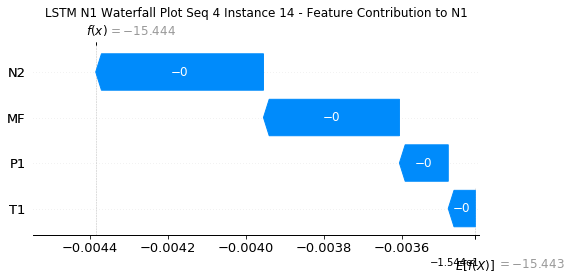

None

Contribution: [-1.20776393e-04 -6.80546071e-05 -4.18438279e-04 -3.38297167e-04]


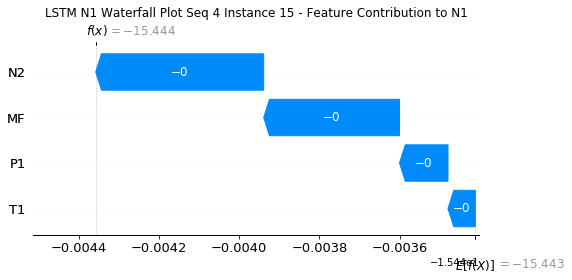

None

Contribution: [-1.17404852e-04 -6.58114302e-05 -4.07747115e-04 -3.28122138e-04]


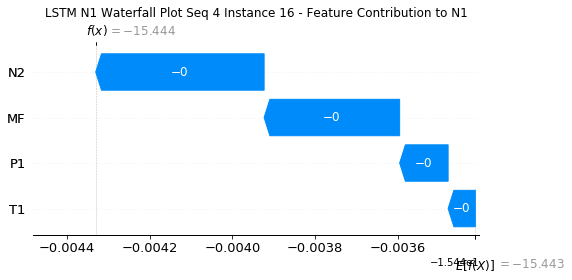

None

Contribution: [-1.16814902e-04 -6.46881674e-05 -3.99698312e-04 -3.19788142e-04]


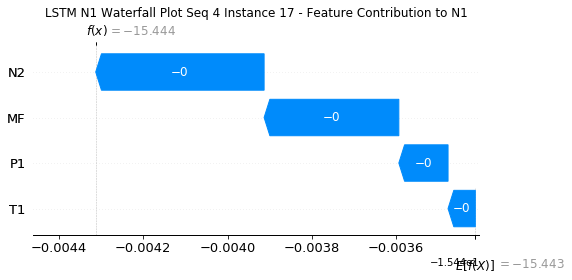

None

Contribution: [-1.14103327e-04 -6.21045169e-05 -3.92727691e-04 -3.12134967e-04]


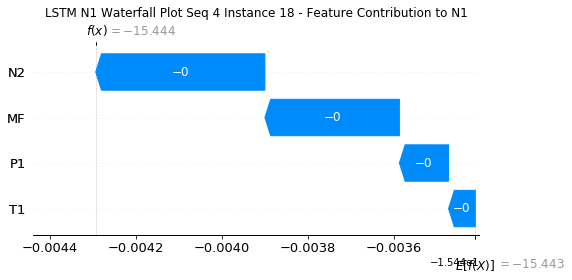

None

Contribution: [-1.13735470e-04 -5.97908235e-05 -3.85449346e-04 -3.02774789e-04]


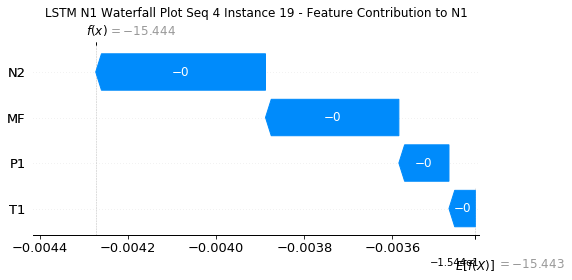

None

Contribution: [-1.13989200e-04 -6.25158608e-05 -3.72190286e-04 -2.82529072e-04]


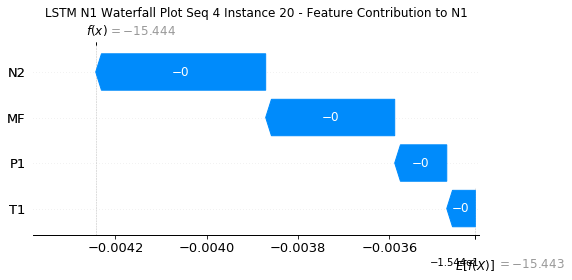

None

Contribution: [-0.00010011 -0.00010045 -0.00033947 -0.00021057]


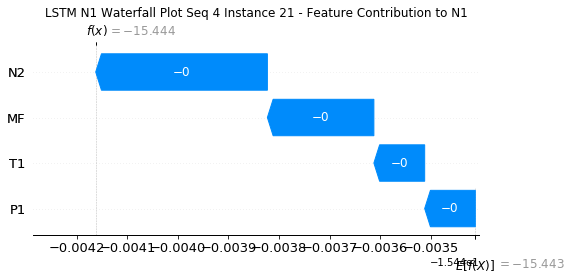

None

Contribution: [-1.09848466e-04 -9.35584197e-05 -3.64229908e-04 -2.97615839e-04]


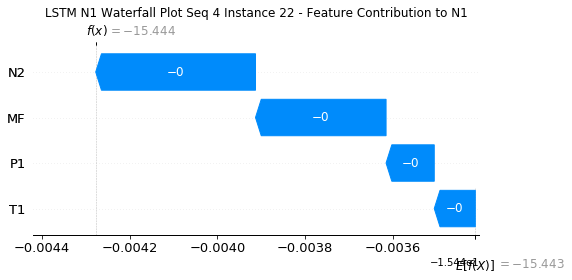

None

Contribution: [ 0.00015901  0.00301813 -0.00242038 -0.00350317]


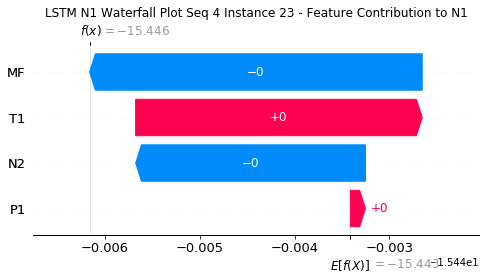

None

Contribution: [-0.00158007  0.03619136 -0.01467622 -0.01918814]


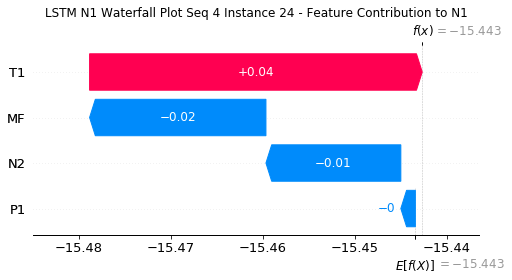

None

Contribution: [-0.03945     0.00199741 -0.14823675 -0.08104109]


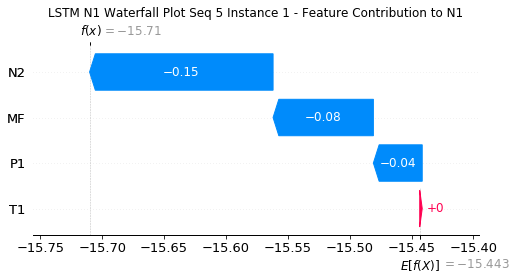

None

Contribution: [0.00065589 0.00028324 0.00195262 0.00184909]


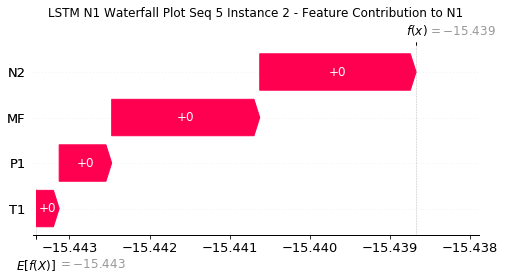

None

Contribution: [-7.46617716e-05 -7.13279198e-05 -3.16972482e-04 -2.69280101e-04]


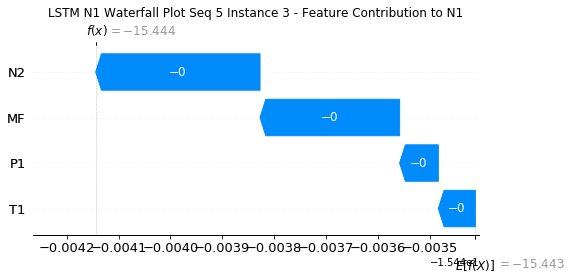

None

Contribution: [-1.38436000e-04 -2.35818822e-05 -5.89407437e-04 -4.94607492e-04]


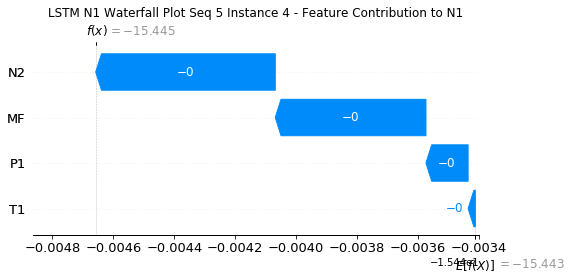

None

Contribution: [-1.42150262e-04 -7.97530141e-05 -5.02461505e-04 -4.18206687e-04]


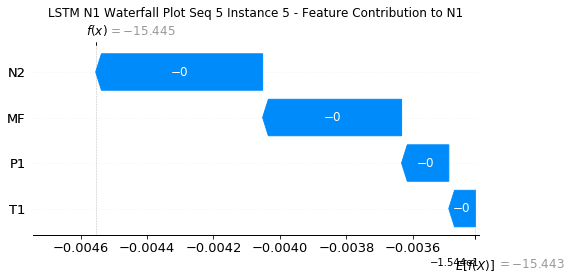

None

Contribution: [-1.35779497e-04 -7.27506105e-05 -4.58023899e-04 -3.74455294e-04]


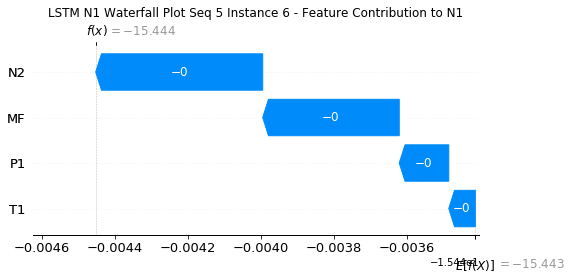

None

Contribution: [-1.39672553e-04 -7.60460871e-05 -4.88078439e-04 -3.87388720e-04]


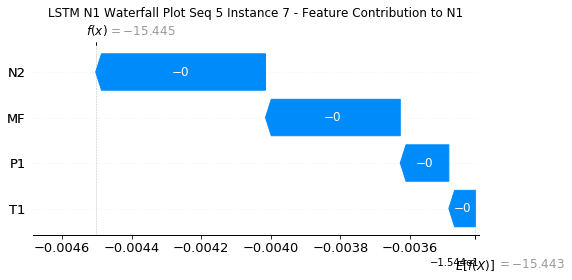

None

Contribution: [-1.40639245e-04 -7.94517056e-05 -5.10249081e-04 -3.96463119e-04]


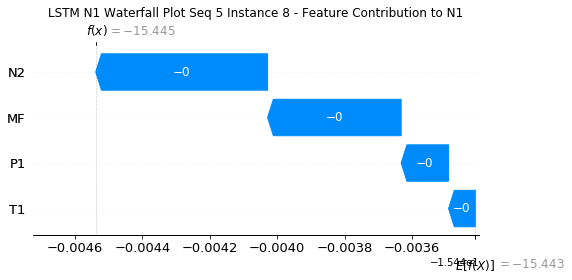

None

Contribution: [-1.41555186e-04 -8.19383011e-05 -5.06550734e-04 -4.06366427e-04]


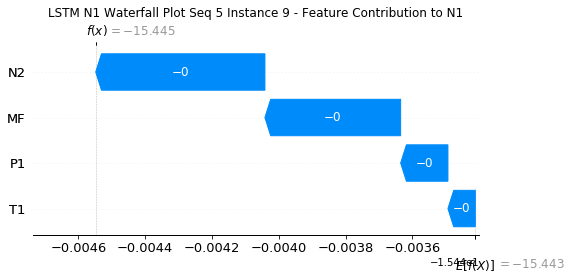

None

Contribution: [-1.43006655e-04 -7.90148862e-05 -4.92718768e-04 -4.10049112e-04]


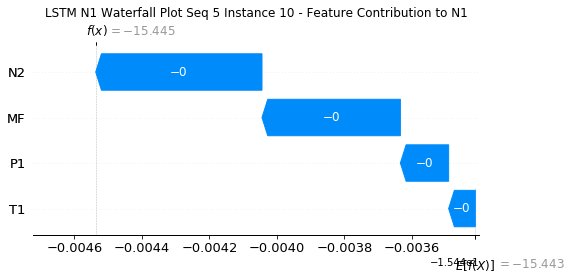

None

Contribution: [-1.37919706e-04 -7.65877607e-05 -4.75086323e-04 -3.92029453e-04]


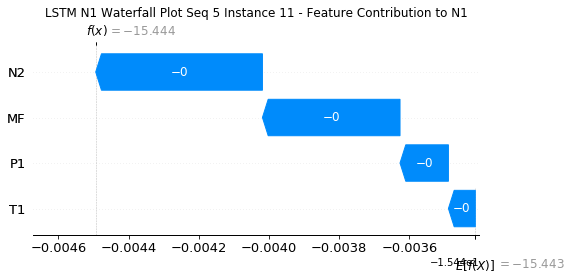

None

Contribution: [-1.31168136e-04 -7.49674663e-05 -4.58817841e-04 -3.76480369e-04]


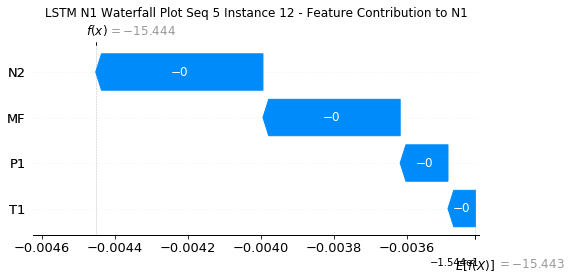

None

Contribution: [-1.28877419e-04 -7.15601896e-05 -4.44756204e-04 -3.64349634e-04]


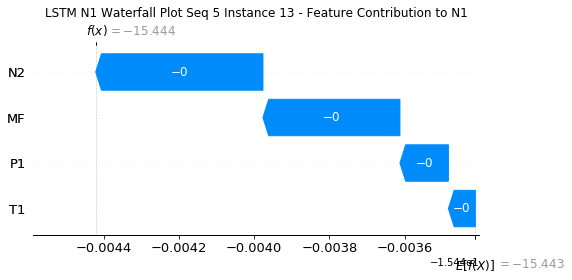

None

Contribution: [-1.25657998e-04 -6.92821105e-05 -4.29680843e-04 -3.46817149e-04]


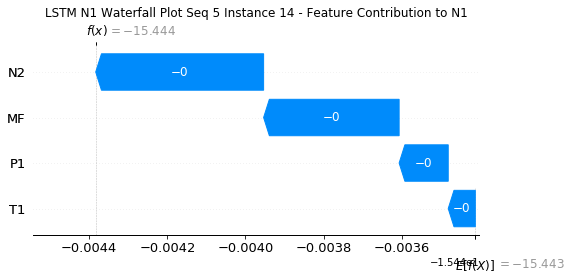

None

Contribution: [-1.21136923e-04 -6.61369742e-05 -4.18724455e-04 -3.40009678e-04]


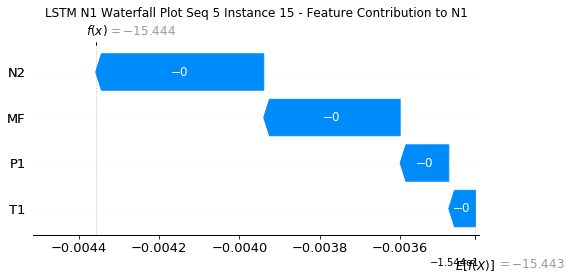

None

Contribution: [-1.17510599e-04 -6.36830259e-05 -4.07927182e-04 -3.29674955e-04]


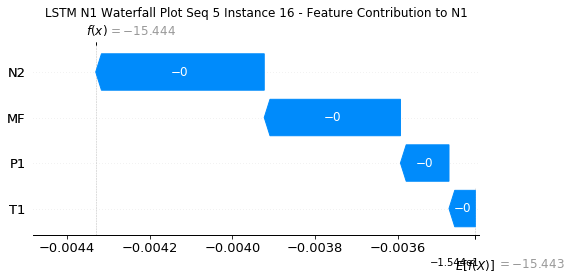

None

Contribution: [-1.14106626e-04 -6.12204300e-05 -3.99081489e-04 -3.21049997e-04]


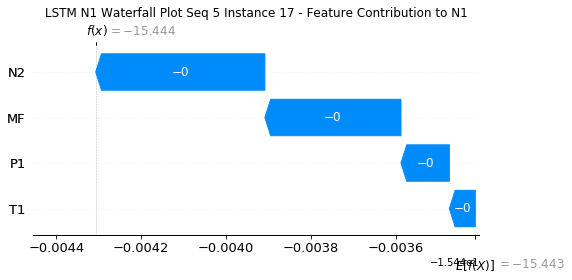

None

Contribution: [-1.13383316e-04 -5.98179154e-05 -3.92824567e-04 -3.13525911e-04]


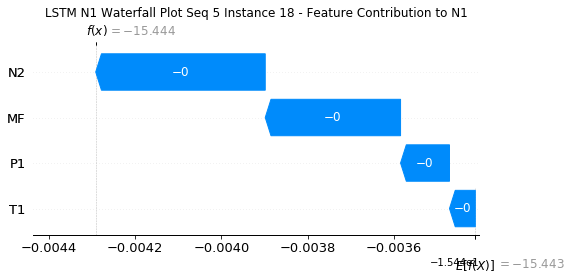

None

Contribution: [-1.12996296e-04 -5.78287965e-05 -3.85515057e-04 -3.04017982e-04]


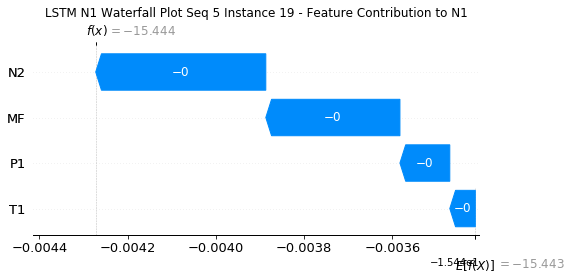

None

Contribution: [-1.13218581e-04 -6.16645015e-05 -3.72482118e-04 -2.83402613e-04]


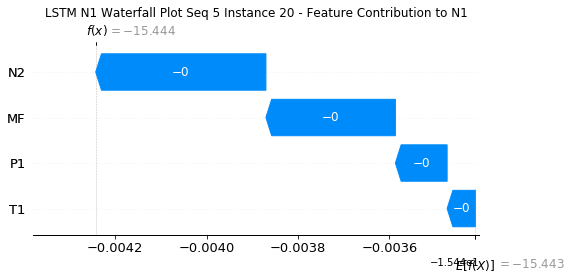

None

Contribution: [-0.00010012 -0.00010028 -0.00034001 -0.0002089 ]


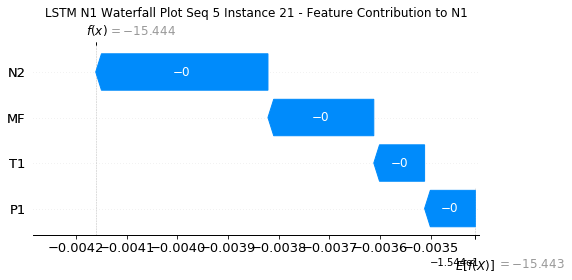

None

Contribution: [-1.10165933e-04 -9.41081830e-05 -3.64501891e-04 -3.02806014e-04]


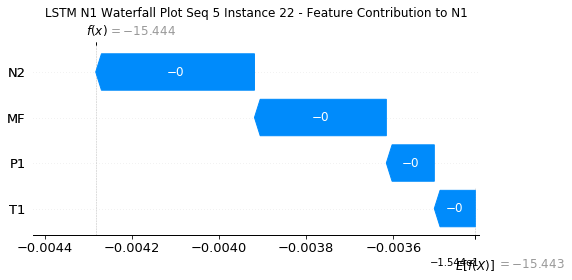

None

Contribution: [ 3.63778160e-05  2.92684917e-03 -2.38986016e-03 -3.60799247e-03]


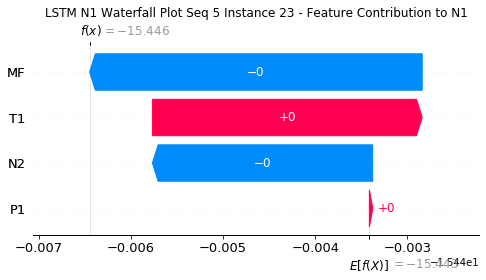

None

Contribution: [-0.00226574  0.03611855 -0.01455884 -0.02088694]


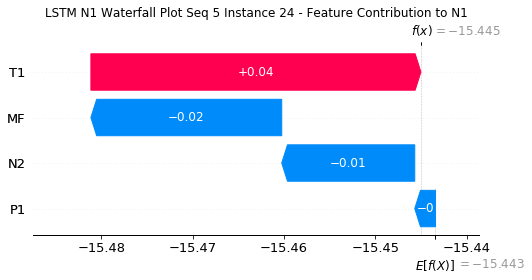

None

Contribution: [-3.71594055e-02  4.91815014e-05 -1.48175756e-01 -8.43823963e-02]


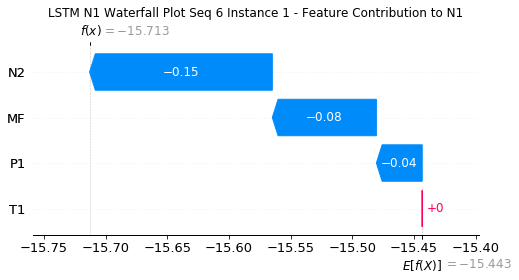

None

Contribution: [0.00065289 0.00028095 0.00194844 0.00186609]


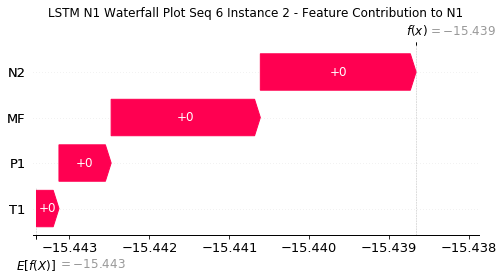

None

Contribution: [-7.42219766e-05 -7.29192638e-05 -3.15519836e-04 -2.67556277e-04]


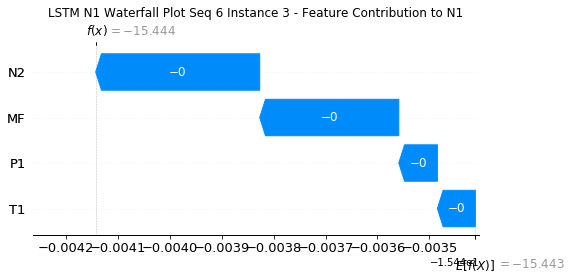

None

Contribution: [-1.36564963e-04 -3.67185295e-05 -5.85818401e-04 -4.89587449e-04]


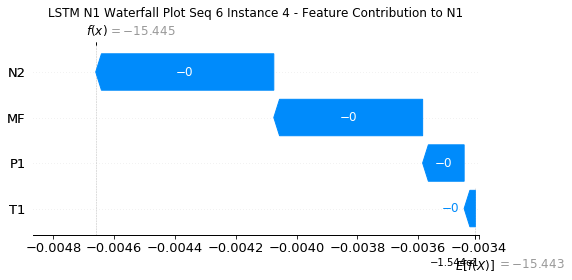

None

Contribution: [-1.37734179e-04 -8.61684976e-05 -5.00907612e-04 -4.14766166e-04]


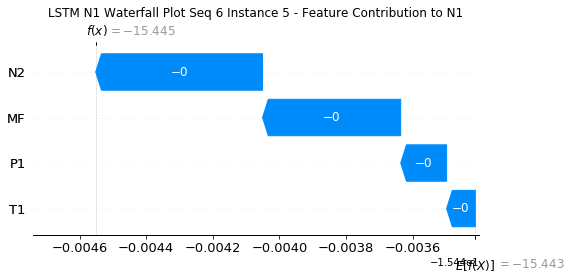

None

Contribution: [-1.35152499e-04 -7.72964189e-05 -4.56929988e-04 -3.72896808e-04]


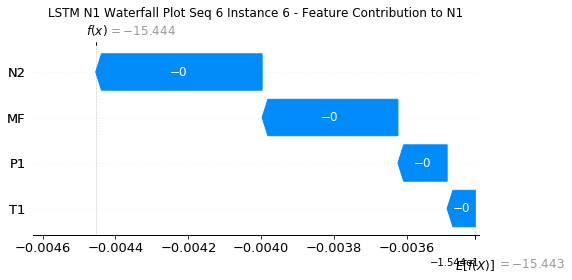

None

Contribution: [-1.37904722e-04 -8.00240736e-05 -4.86236766e-04 -3.84592482e-04]


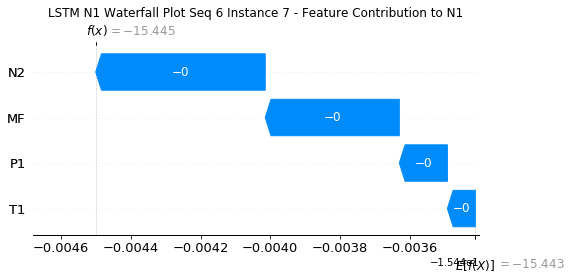

None

Contribution: [-1.39802946e-04 -8.58708079e-05 -5.11917506e-04 -4.02346549e-04]


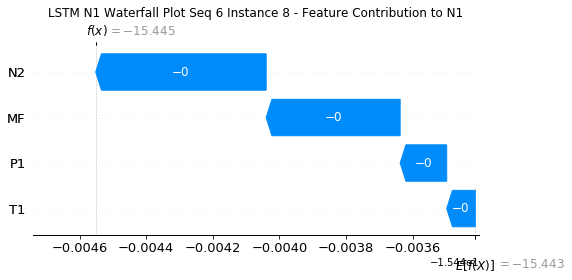

None

Contribution: [-1.41036430e-04 -8.41713825e-05 -5.05427767e-04 -4.03662885e-04]


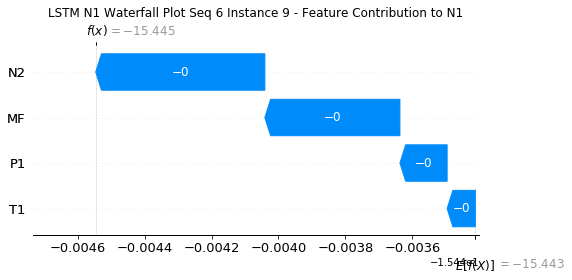

None

Contribution: [-1.41901856e-04 -8.19213204e-05 -4.91817713e-04 -4.09845469e-04]


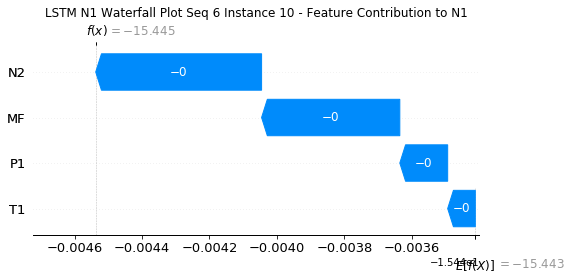

None

Contribution: [-1.36879519e-04 -7.98340345e-05 -4.74007136e-04 -3.91625593e-04]


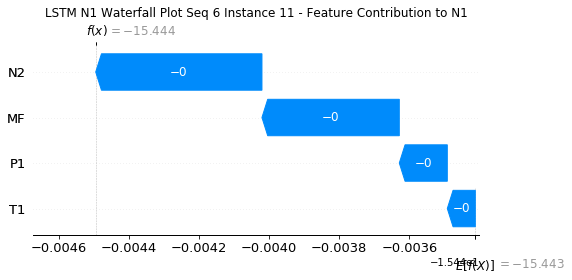

None

Contribution: [-1.34465084e-04 -7.74327007e-05 -4.58134470e-04 -3.77864067e-04]


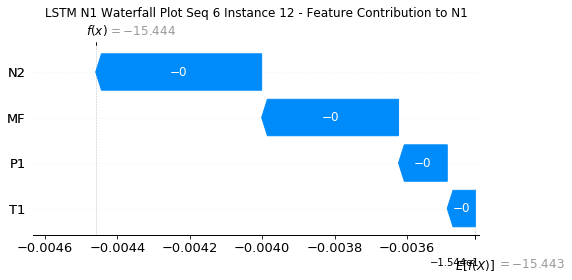

None

Contribution: [-1.28062209e-04 -7.43182575e-05 -4.43915864e-04 -3.63884298e-04]


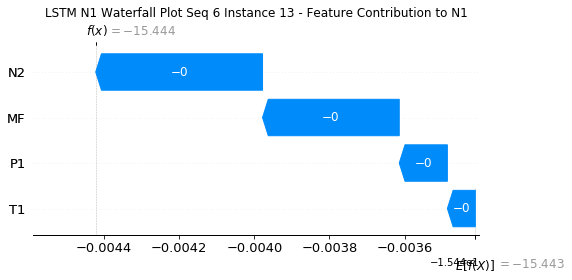

None

Contribution: [-1.24593314e-04 -7.03221766e-05 -4.28029704e-04 -3.48404094e-04]


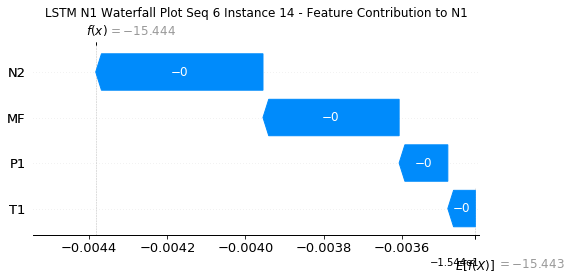

None

Contribution: [-1.20507038e-04 -6.89911472e-05 -4.17855327e-04 -3.39221813e-04]


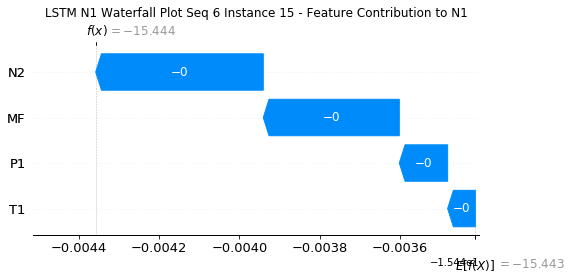

None

Contribution: [-1.17815208e-04 -6.70286463e-05 -4.07338843e-04 -3.29243499e-04]


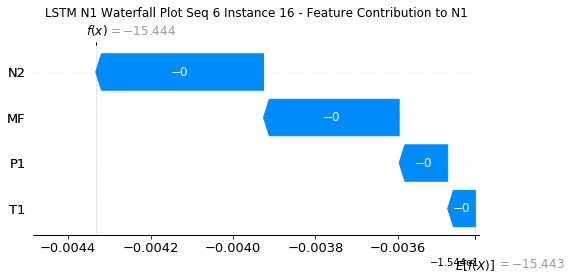

None

Contribution: [-1.14650073e-04 -6.66532960e-05 -3.98914249e-04 -3.20175565e-04]


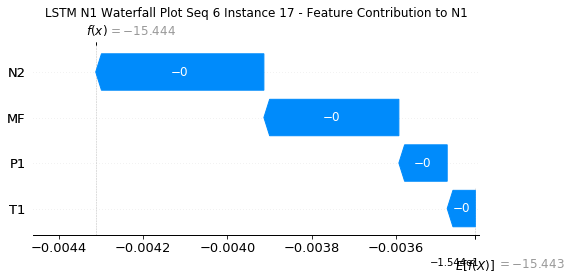

None

Contribution: [-1.13974442e-04 -6.43224840e-05 -3.92159472e-04 -3.12318443e-04]


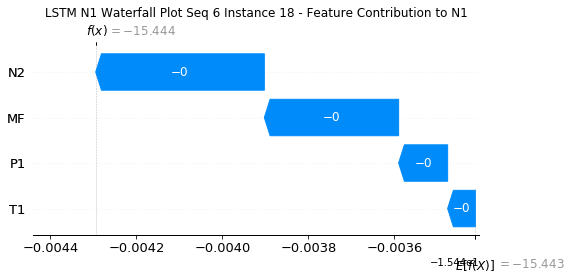

None

Contribution: [-1.14164825e-04 -6.19324596e-05 -3.85172327e-04 -3.03400772e-04]


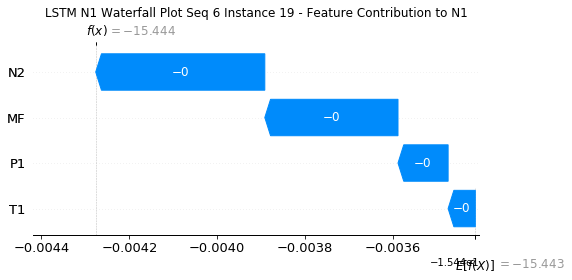

None

Contribution: [-1.14774406e-04 -6.28655482e-05 -3.72398264e-04 -2.83364640e-04]


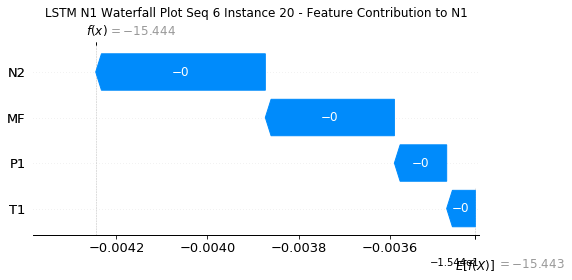

None

Contribution: [-1.03284540e-04 -9.11930535e-05 -3.39829220e-04 -2.09714313e-04]


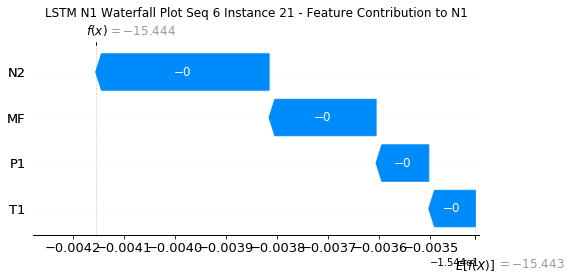

None

Contribution: [-0.00010676 -0.00010248 -0.00036484 -0.00030096]


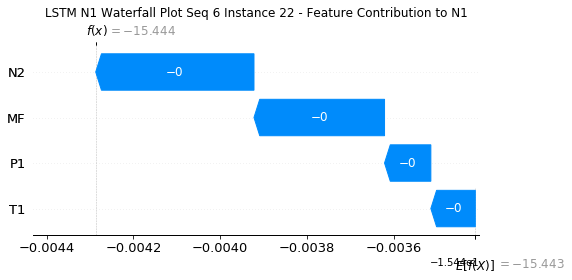

None

Contribution: [ 0.00010367  0.00245876 -0.0024523  -0.00324903]


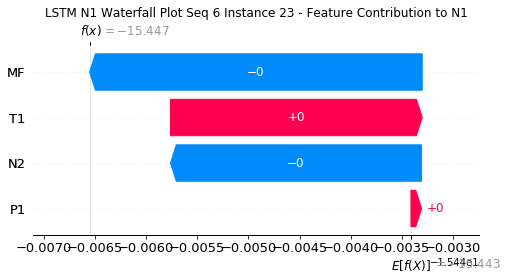

None

Contribution: [-0.00141845  0.03008198 -0.01520077 -0.01989187]


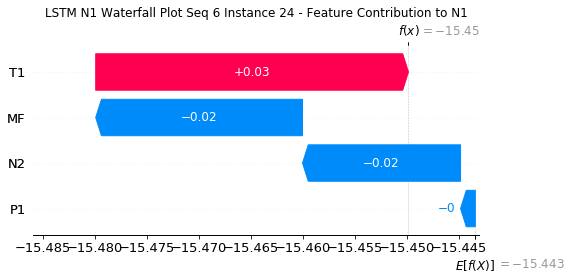

None

Contribution: [-0.03812364 -0.00273071 -0.14877581 -0.08101514]


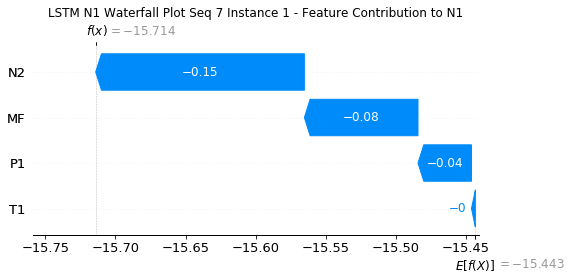

None

Contribution: [0.00065    0.00028411 0.00194536 0.00182832]


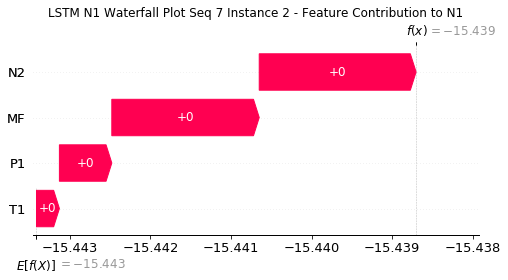

None

Contribution: [-7.43066738e-05 -7.21660137e-05 -3.15165300e-04 -2.66736922e-04]


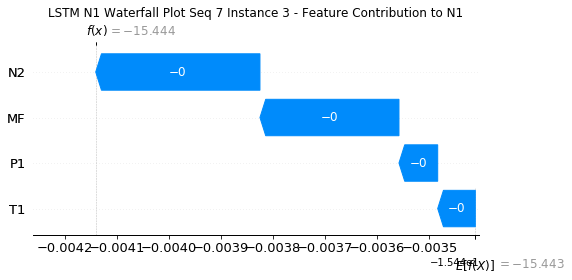

None

Contribution: [-1.38883686e-04 -2.81914548e-05 -5.88102314e-04 -4.85417510e-04]


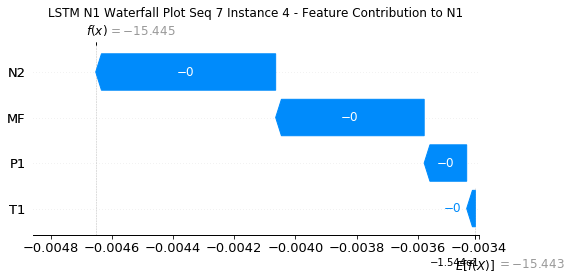

None

Contribution: [-1.39483764e-04 -8.44637029e-05 -5.01744417e-04 -4.16247404e-04]


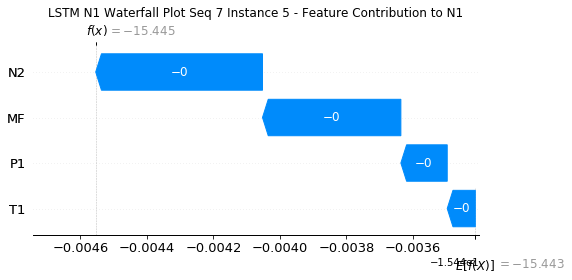

None

Contribution: [-1.35532907e-04 -7.33879686e-05 -4.56839945e-04 -3.70897904e-04]


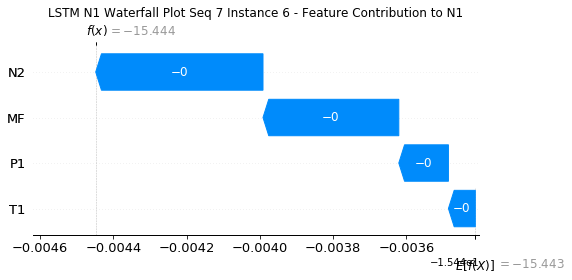

None

Contribution: [-1.37638733e-04 -7.29562980e-05 -4.83500464e-04 -3.82889808e-04]


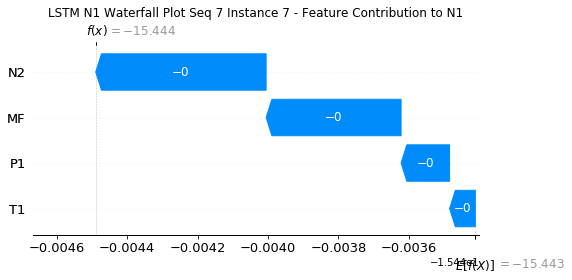

None

Contribution: [-1.43208606e-04 -8.22613250e-05 -5.09733487e-04 -3.97510582e-04]


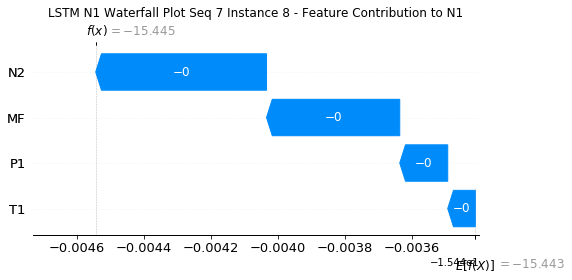

None

Contribution: [-1.40696408e-04 -8.07526239e-05 -5.03265231e-04 -4.00788631e-04]


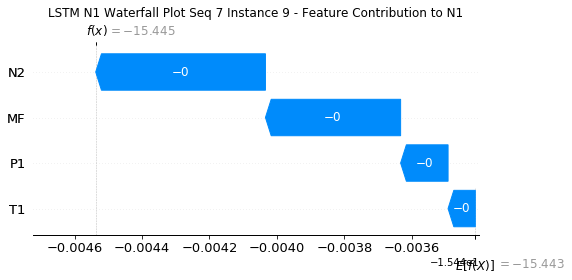

None

Contribution: [-1.42312540e-04 -7.52622505e-05 -4.91958693e-04 -4.06418099e-04]


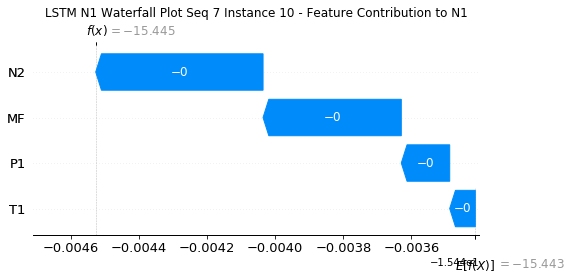

None

Contribution: [-1.37272342e-04 -7.25384078e-05 -4.74527747e-04 -3.89113221e-04]


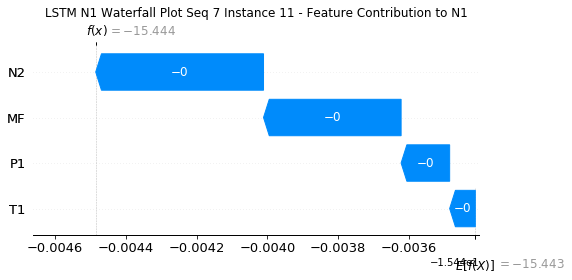

None

Contribution: [-1.33201539e-04 -6.56429639e-05 -4.57934558e-04 -3.72370346e-04]


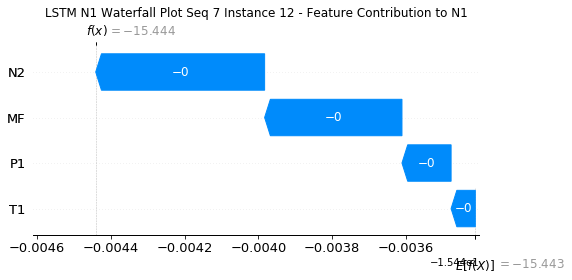

None

Contribution: [-1.28042522e-04 -6.67283667e-05 -4.44094961e-04 -3.61297582e-04]


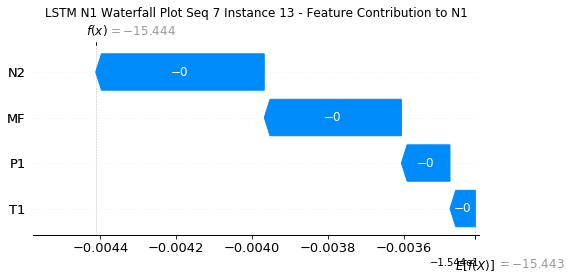

None

Contribution: [-1.24621907e-04 -6.19776018e-05 -4.30455543e-04 -3.47893530e-04]


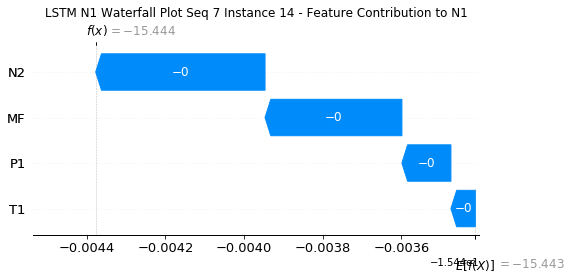

None

Contribution: [-1.19980207e-04 -6.06796419e-05 -4.18183645e-04 -3.37303887e-04]


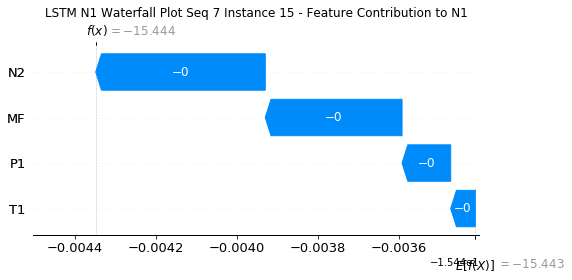

None

Contribution: [-1.16955110e-04 -5.86215616e-05 -4.07842303e-04 -3.27156680e-04]


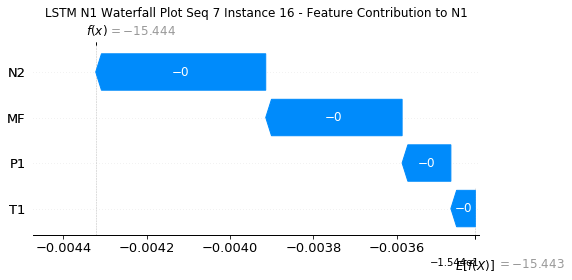

None

Contribution: [-1.15288648e-04 -5.63532610e-05 -3.98689870e-04 -3.16394051e-04]


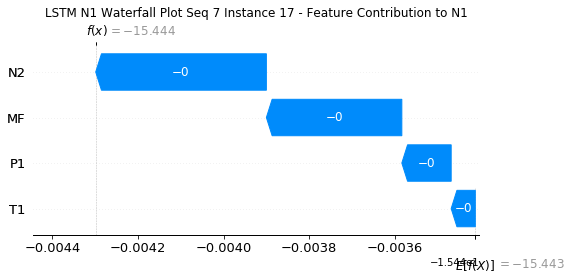

None

Contribution: [-1.12754487e-04 -5.51613253e-05 -3.92740383e-04 -3.11505585e-04]


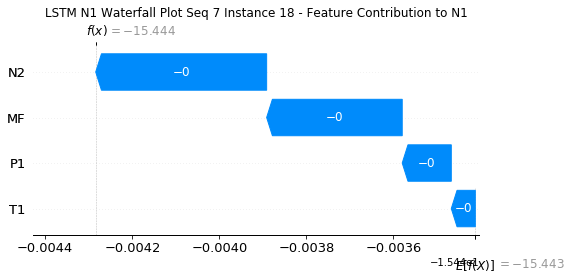

None

Contribution: [-1.12656646e-04 -5.37070030e-05 -3.85512788e-04 -3.02213148e-04]


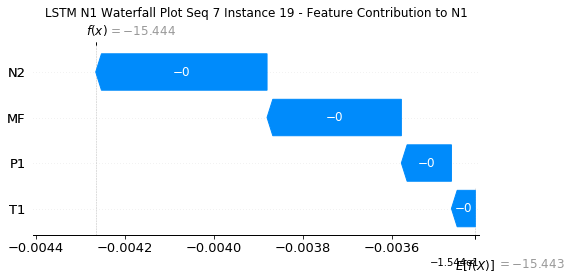

None

Contribution: [-1.12765239e-04 -6.09151641e-05 -3.71986963e-04 -2.82078553e-04]


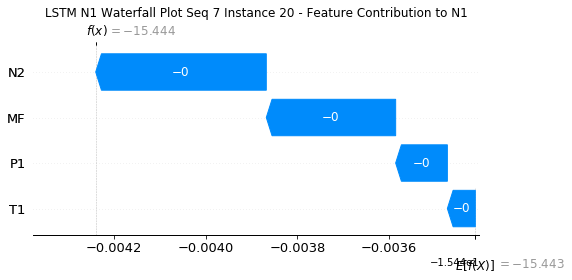

None

Contribution: [-9.88499506e-05 -1.15327032e-04 -3.38333713e-04 -2.09672864e-04]


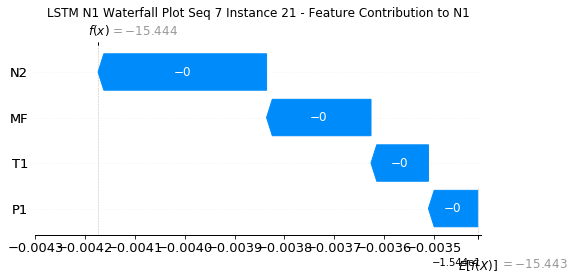

None

Contribution: [-1.10853443e-04 -8.66515138e-05 -3.64381363e-04 -2.96400774e-04]


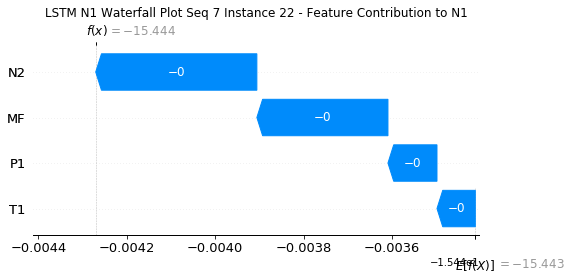

None

Contribution: [ 0.0001032   0.00411901 -0.00243366 -0.00370984]


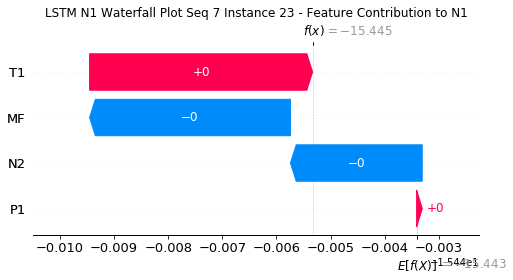

None

Contribution: [-0.00180183  0.04607264 -0.01527123 -0.02163387]


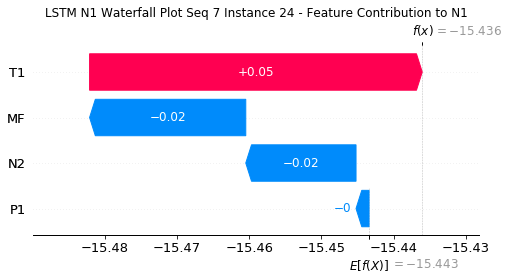

None

Contribution: [-0.03663385  0.00691975 -0.14916462 -0.08479077]


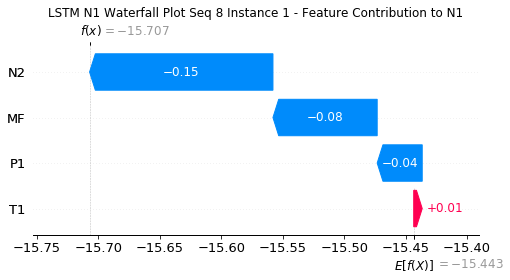

None

Contribution: [0.00064995 0.00030039 0.00196828 0.0018729 ]


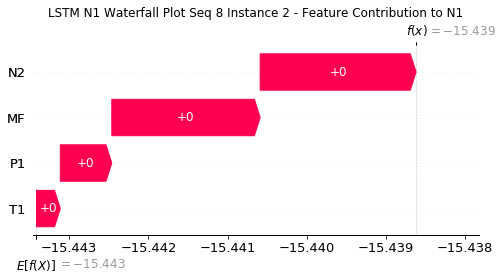

None

Contribution: [-7.50170617e-05 -6.85744347e-05 -3.17724304e-04 -2.69708240e-04]


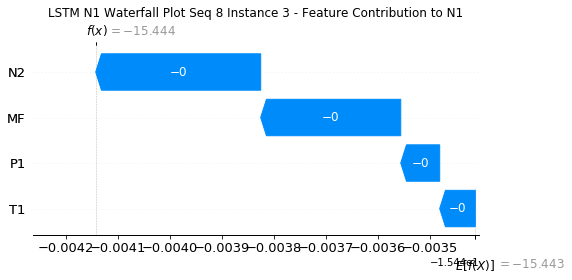

None

Contribution: [-1.36323606e-04  4.67360153e-06 -5.86052804e-04 -4.85013856e-04]


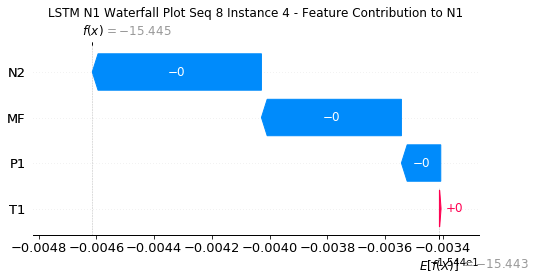

None

Contribution: [-1.40950837e-04 -7.78830135e-05 -5.01954317e-04 -4.17147808e-04]


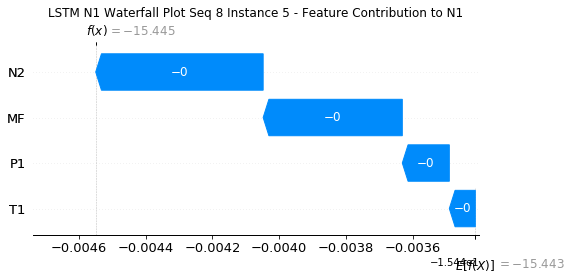

None

Contribution: [-1.34668313e-04 -6.48428535e-05 -4.56107655e-04 -3.69730146e-04]


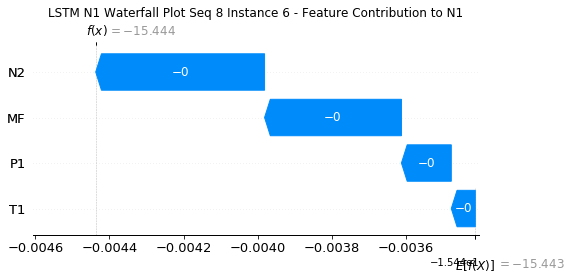

None

Contribution: [-1.37512055e-04 -7.23644891e-05 -4.86762421e-04 -3.86305658e-04]


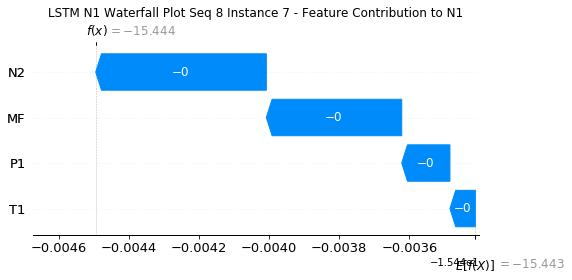

None

Contribution: [-1.39972631e-04 -7.26769334e-05 -5.10024531e-04 -3.97910710e-04]


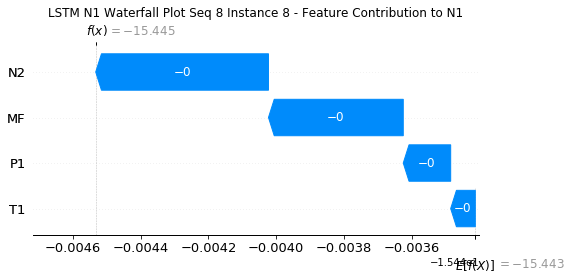

None

Contribution: [-1.38434057e-04 -7.73971448e-05 -5.05510256e-04 -4.02395531e-04]


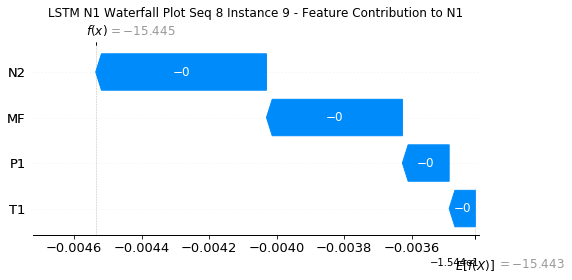

None

Contribution: [-1.41607862e-04 -7.09413219e-05 -4.92159881e-04 -4.07176389e-04]


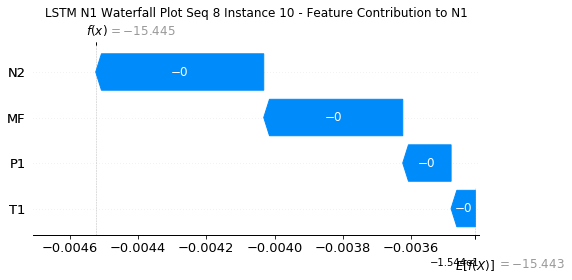

None

Contribution: [-1.36857055e-04 -6.90955636e-05 -4.74911612e-04 -3.90197749e-04]


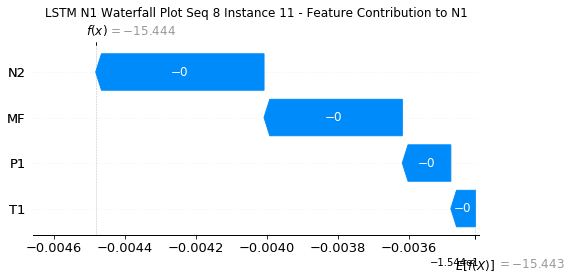

None

Contribution: [-1.30707222e-04 -6.57563075e-05 -4.58321290e-04 -3.72653826e-04]


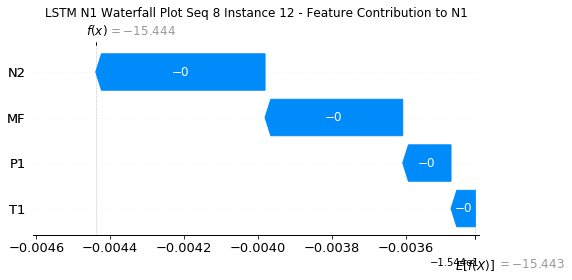

None

Contribution: [-1.28936698e-04 -6.53751775e-05 -4.45728366e-04 -3.64586855e-04]


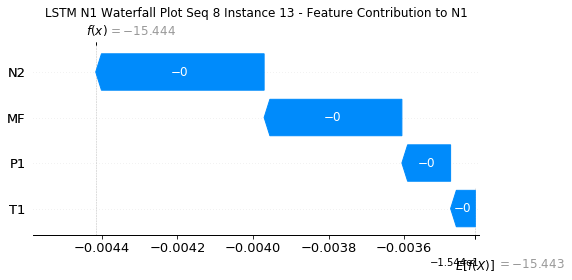

None

Contribution: [-1.25438740e-04 -6.03890603e-05 -4.31496690e-04 -3.49917673e-04]


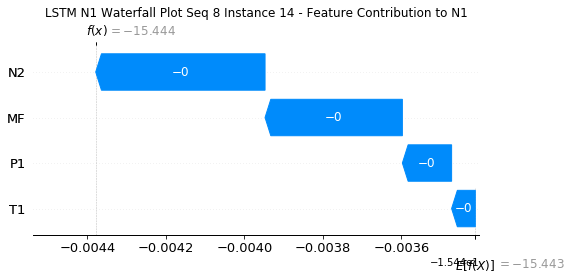

None

Contribution: [-1.19825600e-04 -6.00109509e-05 -4.19491460e-04 -3.39262110e-04]


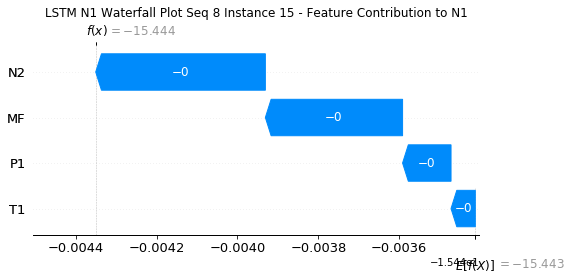

None

Contribution: [-1.14569381e-04 -5.70044312e-05 -4.07411796e-04 -3.25309792e-04]


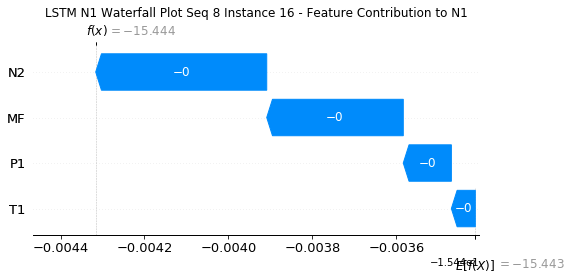

None

Contribution: [-1.12943727e-04 -5.70149300e-05 -4.00102383e-04 -3.19958869e-04]


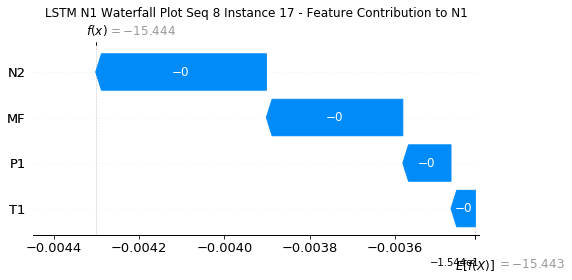

None

Contribution: [-1.12604398e-04 -5.48804401e-05 -3.93303202e-04 -3.11780585e-04]


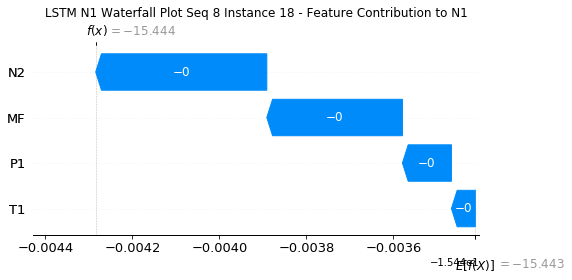

None

Contribution: [-1.11621257e-04 -5.35368694e-05 -3.85245863e-04 -3.00790917e-04]


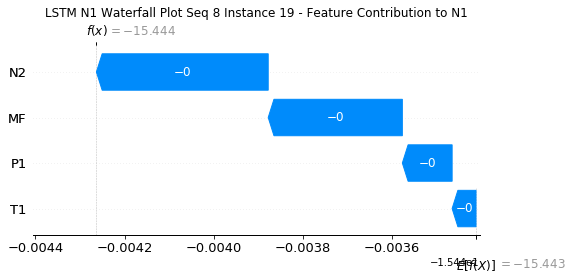

None

Contribution: [-1.14138317e-04 -6.21759027e-05 -3.72580612e-04 -2.82354999e-04]


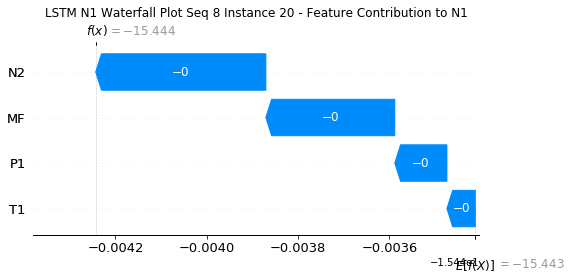

None

Contribution: [-9.60068909e-05 -1.18143312e-04 -3.36578954e-04 -2.07587631e-04]


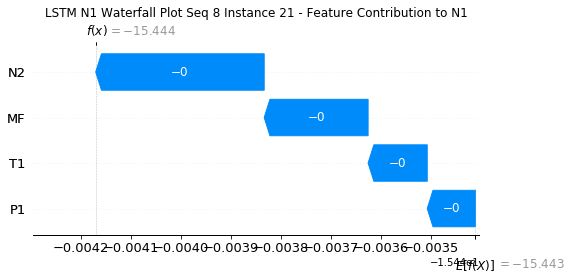

None

Contribution: [-1.08878325e-04 -9.46030345e-05 -3.63865035e-04 -3.05561113e-04]


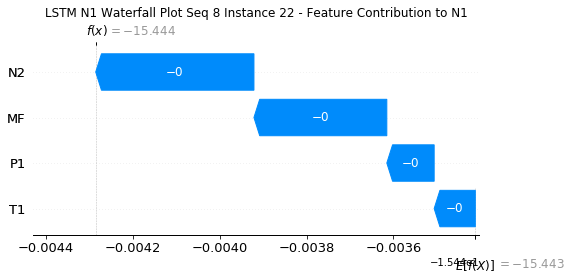

None

Contribution: [-4.61825298e-05  4.61368049e-03 -2.47564153e-03 -3.77714091e-03]


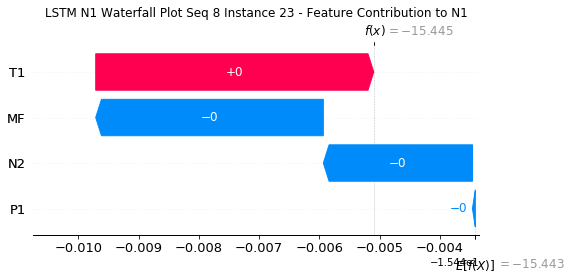

None

Contribution: [-0.00447357  0.0497427  -0.0117184   0.00760568]


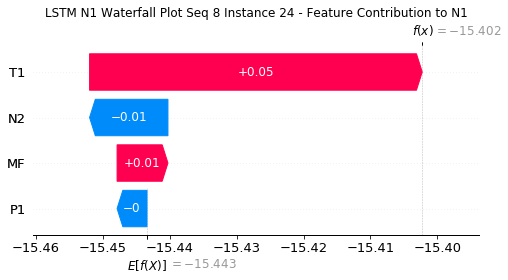

None

Contribution: [-0.04046207  0.00549695 -0.14890493 -0.07503442]


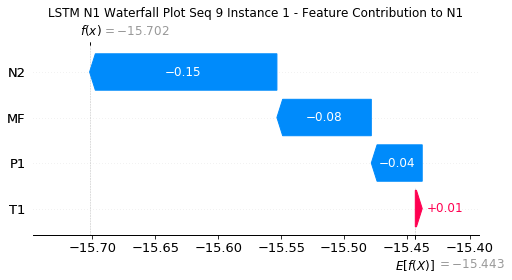

None

Contribution: [0.00065143 0.00028267 0.00196539 0.00184479]


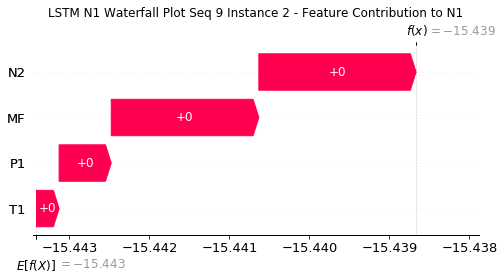

None

Contribution: [-7.37999159e-05 -7.02443549e-05 -3.19497181e-04 -2.71301981e-04]


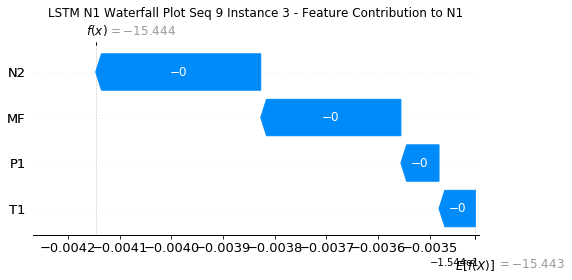

None

Contribution: [-1.28088480e-04 -1.95349967e-05 -5.93952559e-04 -4.97160118e-04]


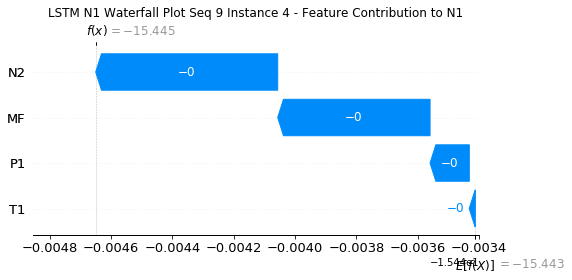

None

Contribution: [-1.31065409e-04 -7.35177582e-05 -5.03976359e-04 -4.09948972e-04]


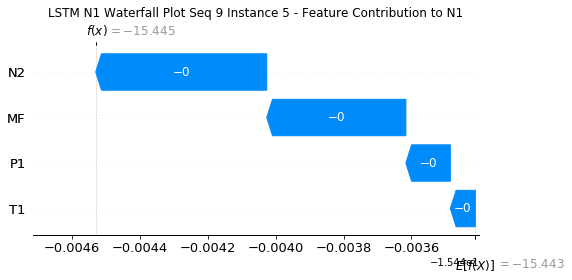

None

Contribution: [-1.33879754e-04 -7.36474289e-05 -4.60091510e-04 -3.75858802e-04]


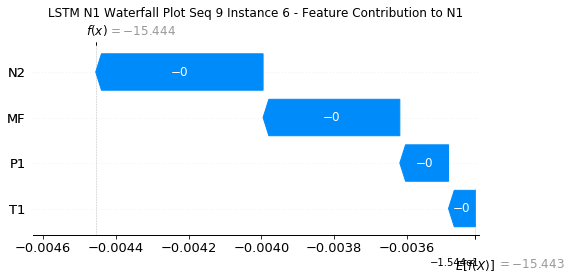

None

Contribution: [-1.39496826e-04 -8.78738220e-05 -4.90875975e-04 -3.91257572e-04]


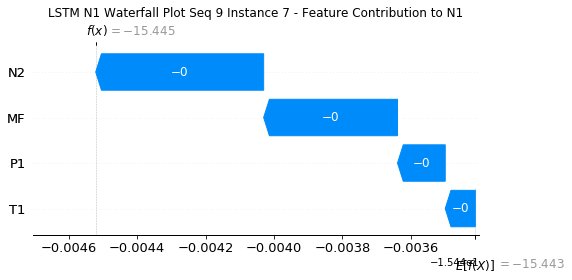

None

Contribution: [-1.44485486e-04 -9.64953729e-05 -5.16743848e-04 -4.07881095e-04]


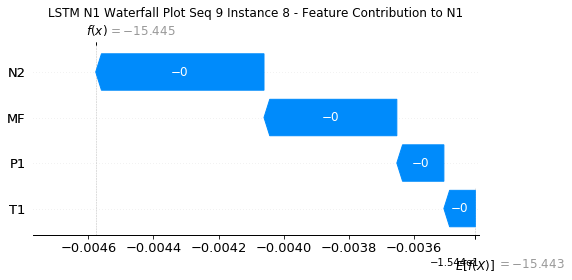

None

Contribution: [-1.43495746e-04 -8.88432587e-05 -5.08334824e-04 -4.09100817e-04]


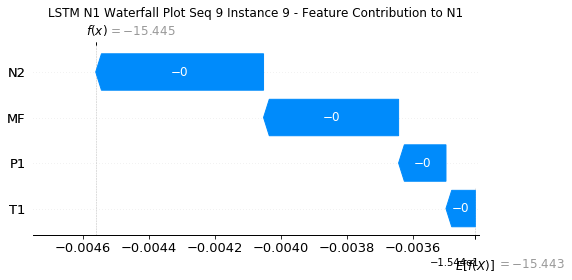

None

Contribution: [-1.43829106e-04 -8.27232856e-05 -4.93627904e-04 -4.11193856e-04]


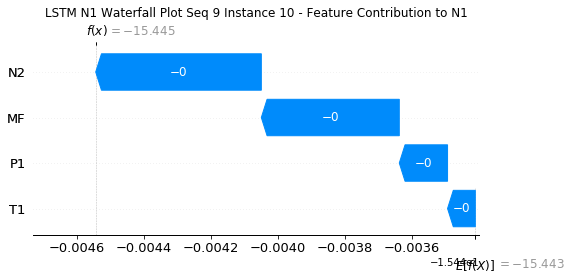

None

Contribution: [-1.38695973e-04 -8.16548491e-05 -4.76270726e-04 -3.93296437e-04]


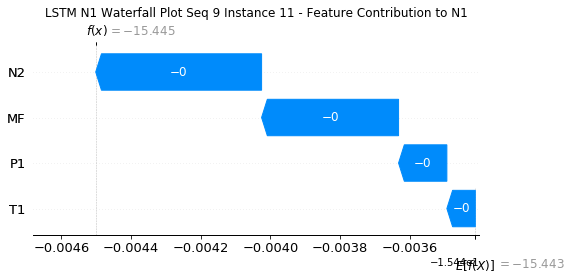

None

Contribution: [-1.32824515e-04 -7.96313825e-05 -4.58924740e-04 -3.74587154e-04]


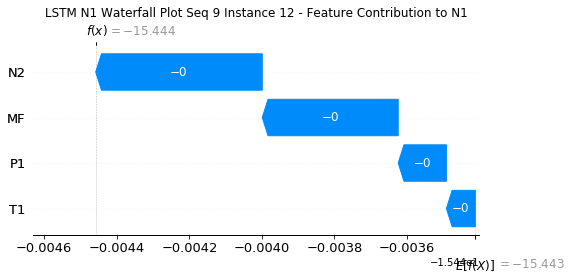

None

Contribution: [-1.30043349e-04 -7.62612190e-05 -4.45609561e-04 -3.64193532e-04]


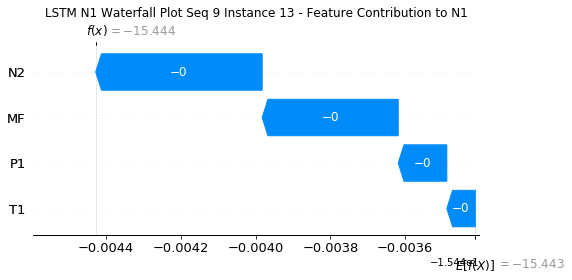

None

Contribution: [-1.26760482e-04 -7.21189729e-05 -4.31431108e-04 -3.50088126e-04]


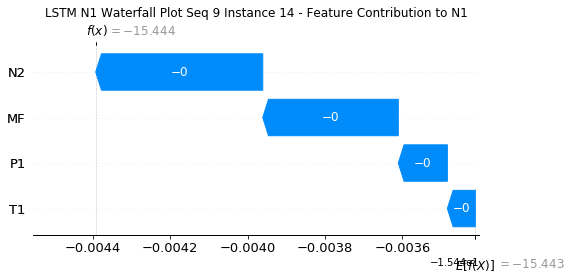

None

Contribution: [-1.23029802e-04 -7.35034460e-05 -4.19893488e-04 -3.40174566e-04]


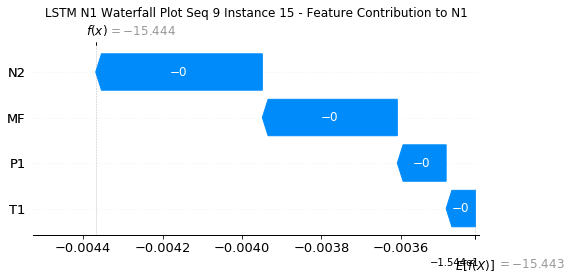

None

Contribution: [-1.20464540e-04 -7.20822127e-05 -4.09639408e-04 -3.31007250e-04]


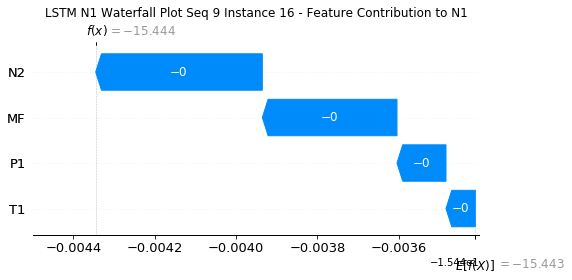

None

Contribution: [-1.15043314e-04 -7.22932437e-05 -4.00734218e-04 -3.20035471e-04]


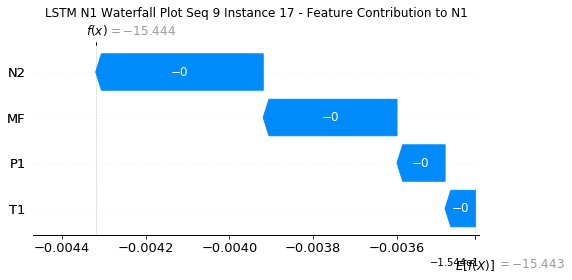

None

Contribution: [-1.14899612e-04 -6.80771333e-05 -3.93802077e-04 -3.12482181e-04]


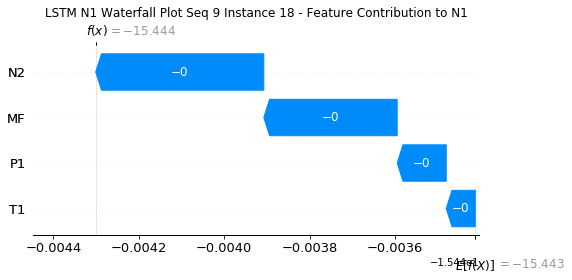

None

Contribution: [-1.15406790e-04 -6.53034405e-05 -3.86747056e-04 -3.03690632e-04]


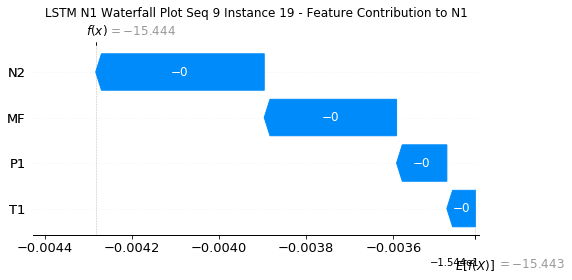

None

Contribution: [-1.15876791e-04 -6.39373767e-05 -3.73169939e-04 -2.83212874e-04]


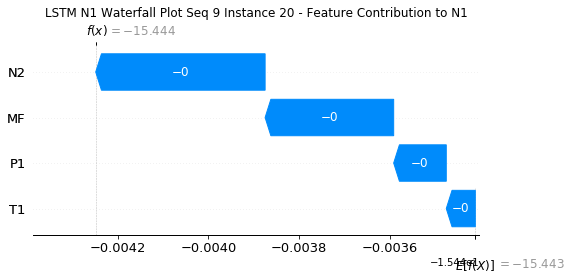

None

Contribution: [-1.07339685e-04 -8.48134738e-05 -3.41020459e-04 -2.13998959e-04]


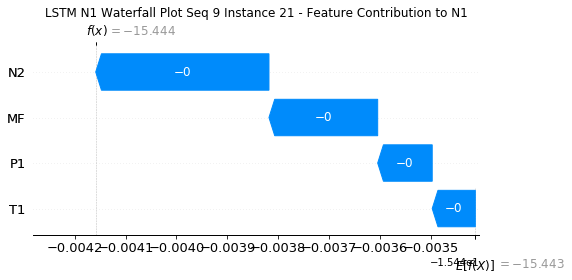

None

Contribution: [-0.00010576 -0.00010054 -0.00036675 -0.00029619]


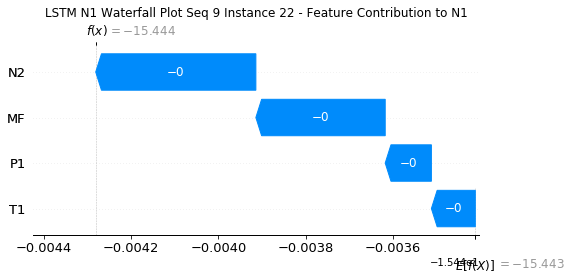

None

Contribution: [ 6.46200778e-05  1.50681447e-03 -2.35386923e-03 -3.08845435e-03]


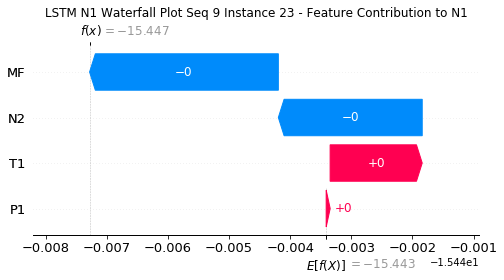

None

Contribution: [-0.00126999  0.02145508 -0.01492605 -0.02319462]


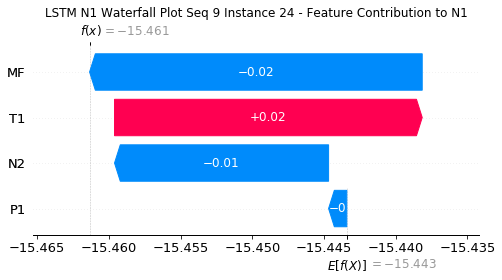

None

Contribution: [-0.03666401 -0.00580976 -0.14707459 -0.07957411]


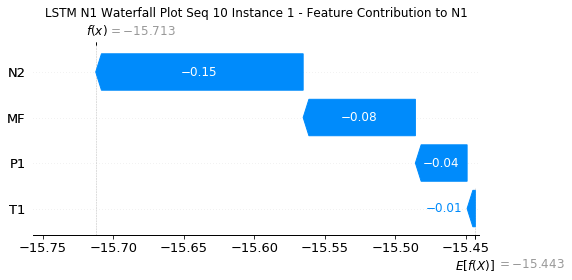

None

Contribution: [0.00064065 0.00028738 0.00194264 0.00183576]


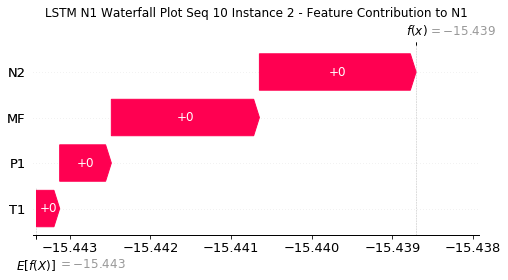

None

Contribution: [-7.47784440e-05 -7.44846184e-05 -3.14961189e-04 -2.66770565e-04]


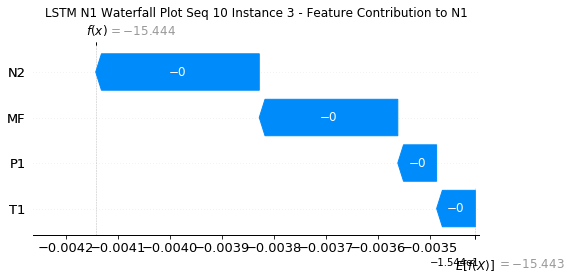

None

Contribution: [-1.44515996e-04 -5.18434706e-05 -5.85652522e-04 -4.87604000e-04]


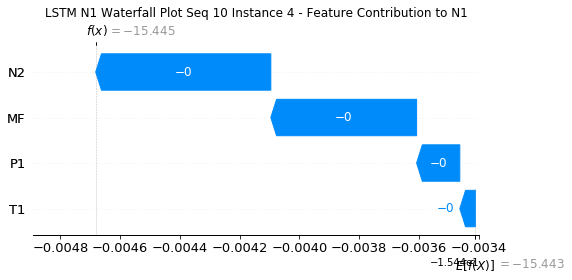

None

Contribution: [-1.41467821e-04 -9.49113912e-05 -5.01219572e-04 -4.20722277e-04]


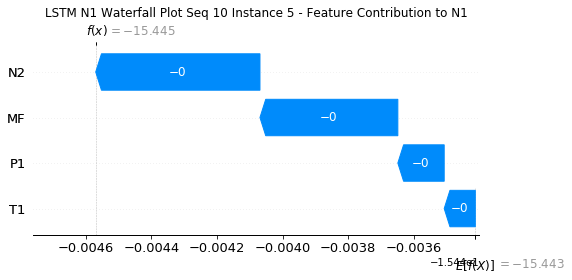

None

Contribution: [-1.37170321e-04 -8.16505586e-05 -4.56510109e-04 -3.72261728e-04]


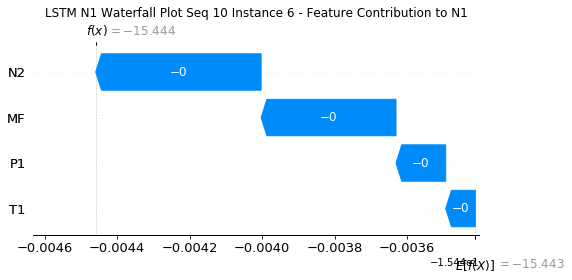

None

Contribution: [-1.37611562e-04 -8.36992118e-05 -4.84939652e-04 -3.81336955e-04]


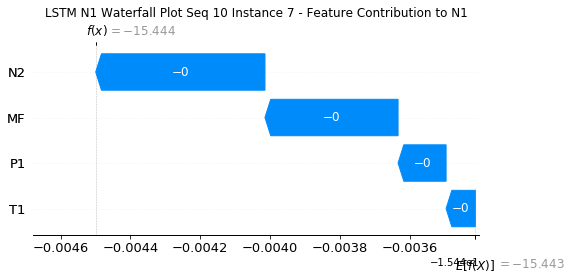

None

Contribution: [-1.48862339e-04 -9.03367546e-05 -5.14648678e-04 -4.08907382e-04]


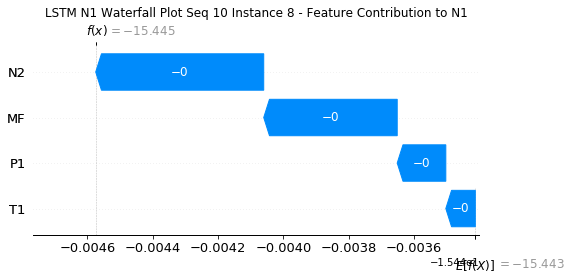

None

Contribution: [-1.42588358e-04 -8.83071334e-05 -5.05261641e-04 -4.05027057e-04]


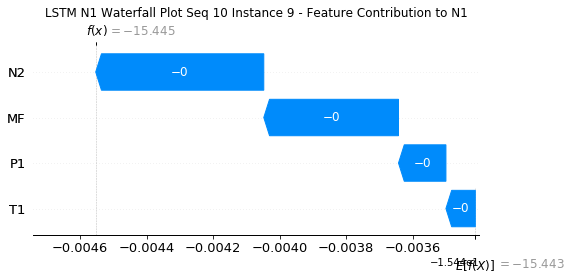

None

Contribution: [-1.45081406e-04 -8.52050178e-05 -4.91906946e-04 -4.10053792e-04]


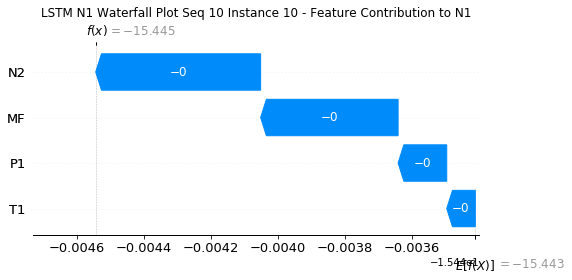

None

Contribution: [-1.39619445e-04 -8.25708201e-05 -4.74021189e-04 -3.91006860e-04]


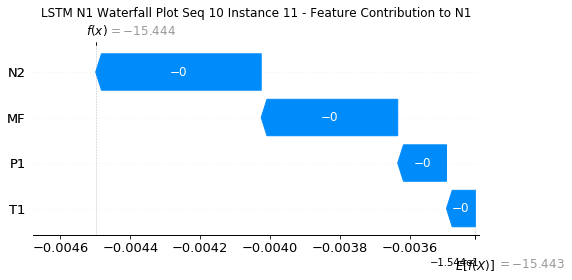

None

Contribution: [-1.33942798e-04 -7.59128553e-05 -4.56321433e-04 -3.72249279e-04]


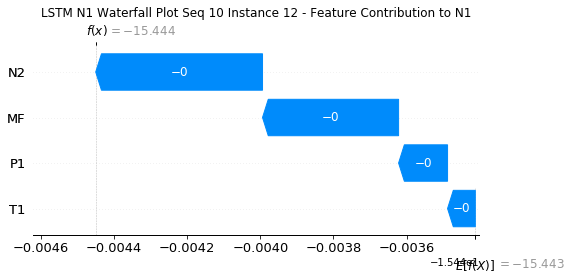

None

Contribution: [-1.30945838e-04 -7.61922013e-05 -4.43974877e-04 -3.64292474e-04]


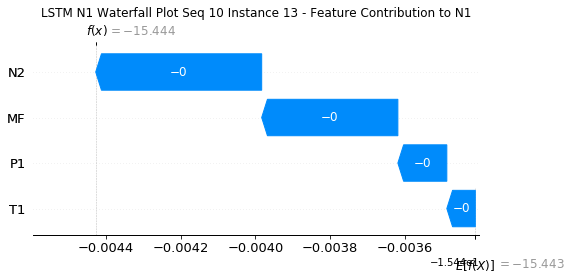

None

Contribution: [-1.26335220e-04 -7.57046602e-05 -4.30604397e-04 -3.53197800e-04]


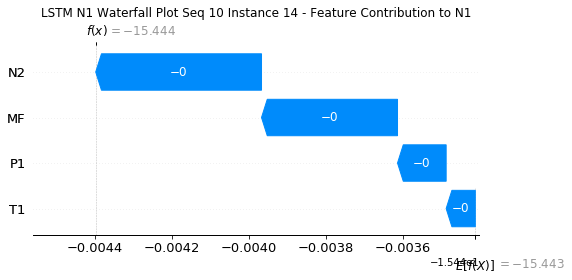

None

Contribution: [-1.23004843e-04 -7.10373202e-05 -4.17996247e-04 -3.39753434e-04]


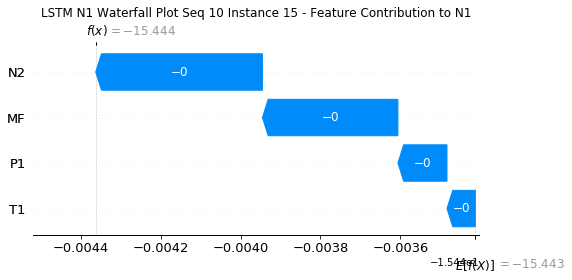

None

Contribution: [-1.19986231e-04 -6.87203282e-05 -4.07511515e-04 -3.29656509e-04]


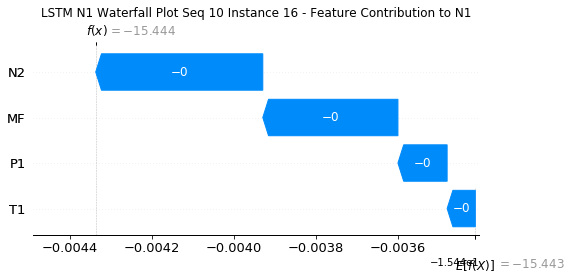

None

Contribution: [-1.17140306e-04 -6.65050698e-05 -3.98848807e-04 -3.19994968e-04]


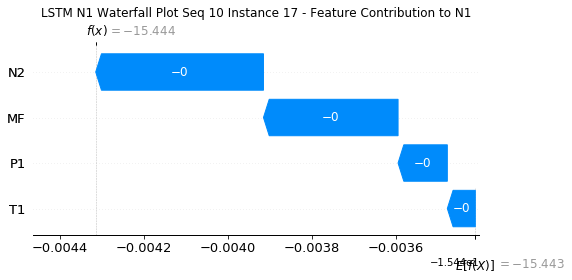

None

Contribution: [-1.16063942e-04 -6.47221000e-05 -3.92249621e-04 -3.12916444e-04]


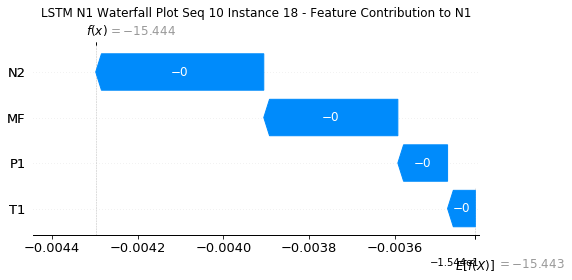

None

Contribution: [-1.16226068e-04 -6.18475512e-05 -3.85190093e-04 -3.03896062e-04]


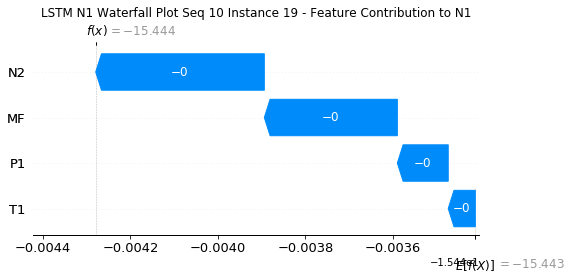

None

Contribution: [-1.17695382e-04 -6.22765164e-05 -3.72103446e-04 -2.83258822e-04]


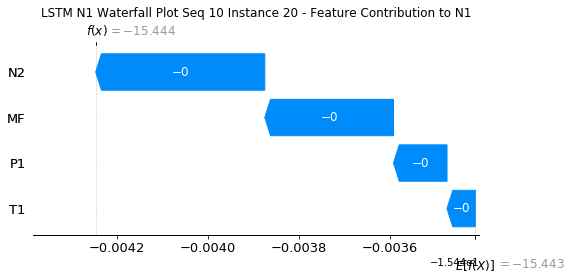

None

Contribution: [-1.07390013e-04 -9.24812383e-05 -3.38827168e-04 -2.05654852e-04]


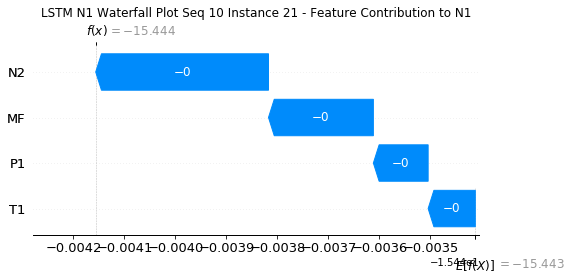

None

Contribution: [-1.01732947e-04 -9.83709604e-05 -3.65749629e-04 -3.07244021e-04]


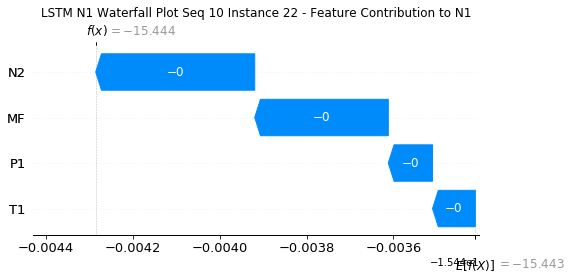

None

Contribution: [ 0.00026702  0.00233501 -0.00248191 -0.00327343]


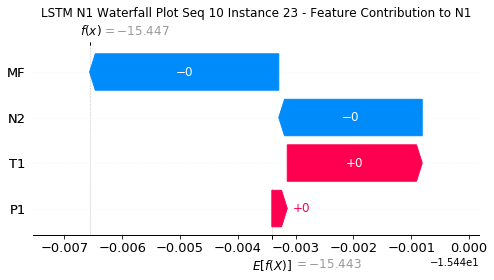

None

Contribution: [-0.00026023  0.02729716 -0.01562147 -0.02330267]


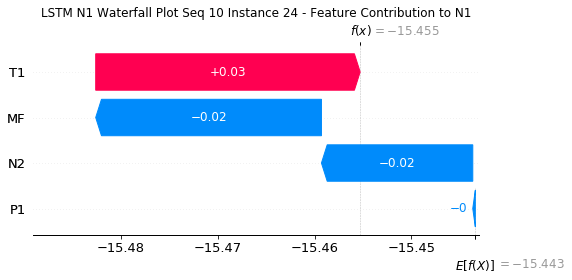

None

Contribution: [-0.0462097  -0.00397754 -0.14718657 -0.08516064]


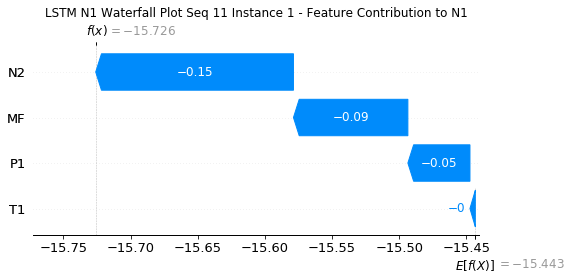

None

Contribution: [0.00067059 0.00028006 0.00191611 0.00183788]


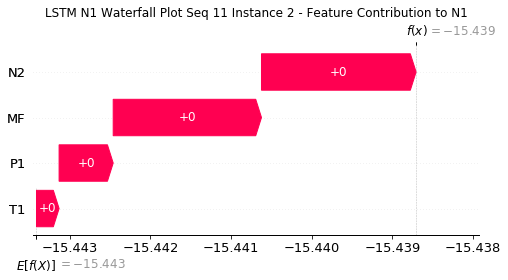

None

Contribution: [-7.60136750e-05 -7.30613690e-05 -3.12270269e-04 -2.66772959e-04]


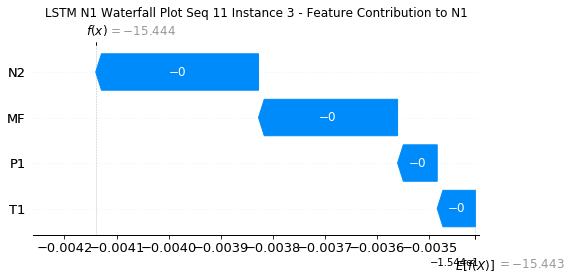

None

Contribution: [-1.64531220e-04 -2.92833506e-05 -5.85850038e-04 -5.07819319e-04]


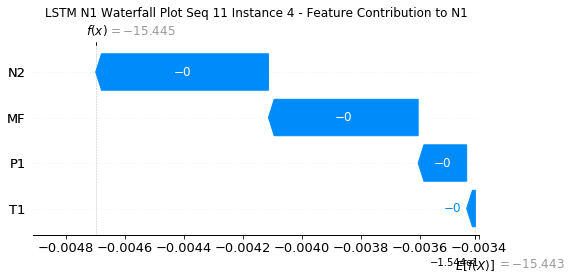

None

Contribution: [-1.50569653e-04 -9.64909223e-05 -5.00881913e-04 -4.23040813e-04]


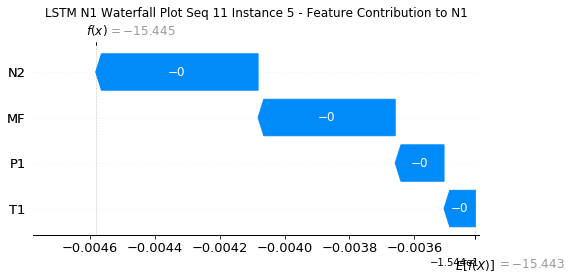

None

Contribution: [-1.43131565e-04 -7.61348138e-05 -4.55951393e-04 -3.78725329e-04]


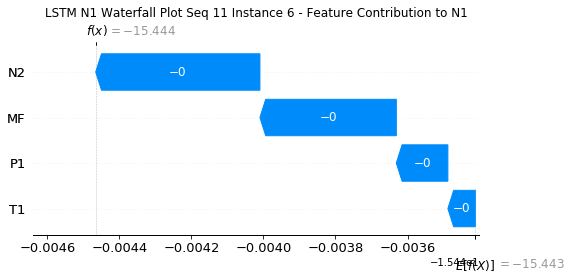

None

Contribution: [-1.49225514e-04 -9.00904410e-05 -4.92250491e-04 -3.99346392e-04]


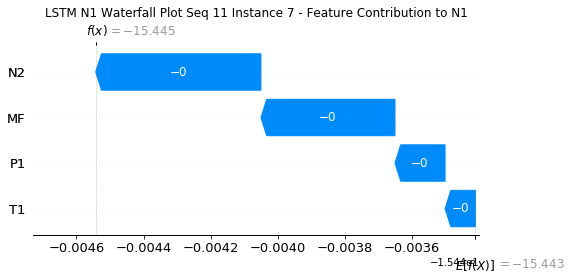

None

Contribution: [-1.53505974e-04 -9.27290322e-05 -5.16598228e-04 -4.13937868e-04]


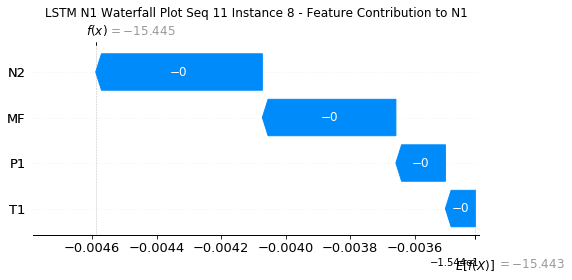

None

Contribution: [-1.50921025e-04 -9.44175085e-05 -5.08913300e-04 -4.13819259e-04]


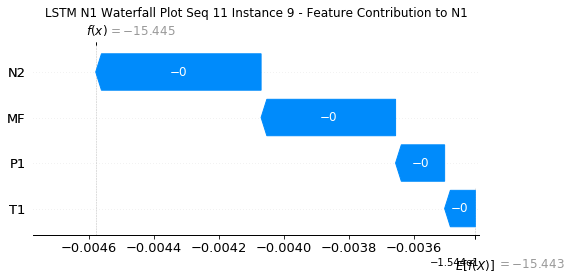

None

Contribution: [-1.48607738e-04 -6.38163794e-05 -4.89699191e-04 -4.11533456e-04]


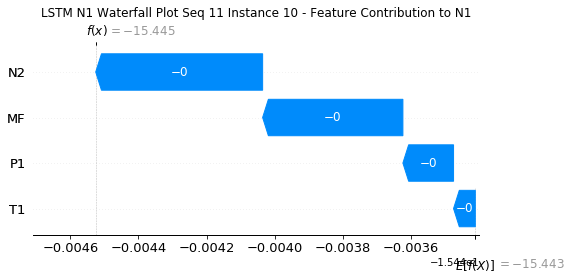

None

Contribution: [-1.43573128e-04 -6.31686894e-05 -4.72959258e-04 -3.93857391e-04]


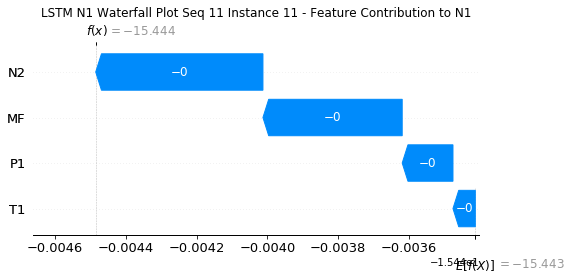

None

Contribution: [-1.35881257e-04 -4.71583755e-05 -4.55030955e-04 -3.77279261e-04]


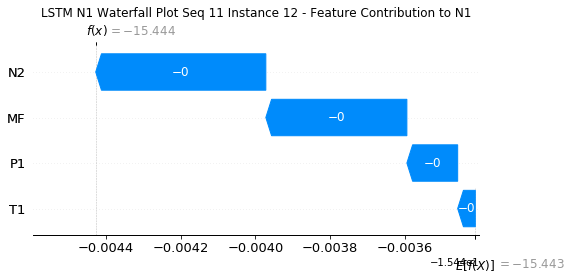

None

Contribution: [-1.33876431e-04 -5.80308849e-05 -4.42879806e-04 -3.64927258e-04]


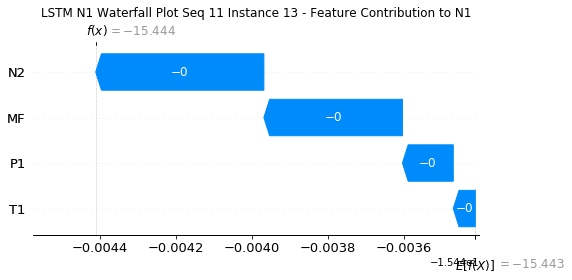

None

Contribution: [-1.28813268e-04 -4.49951882e-05 -4.29349005e-04 -3.53952803e-04]


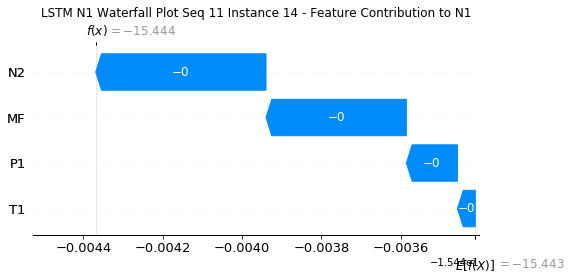

None

Contribution: [-1.25426085e-04 -5.42969548e-05 -4.16779758e-04 -3.39365227e-04]


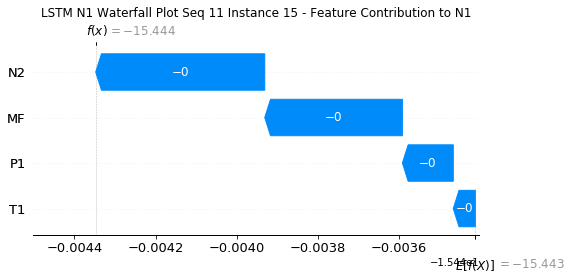

None

Contribution: [-1.22404680e-04 -5.53085339e-05 -4.06184048e-04 -3.29184140e-04]


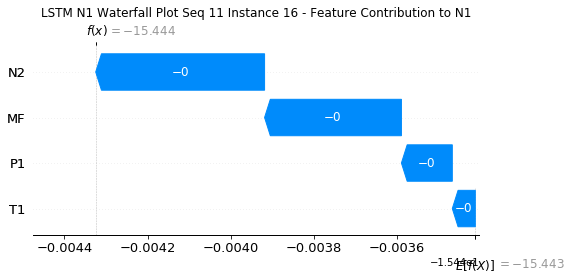

None

Contribution: [-1.21823270e-04 -6.08213263e-05 -4.00094568e-04 -3.27275971e-04]


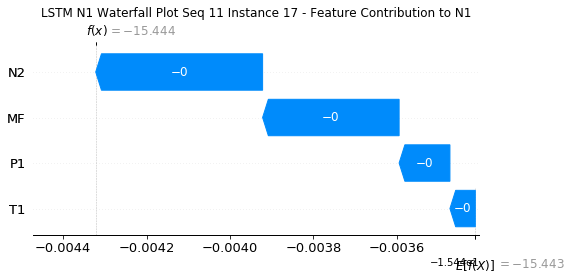

None

Contribution: [-1.19265710e-04 -6.09317210e-05 -3.91848547e-04 -3.13236684e-04]


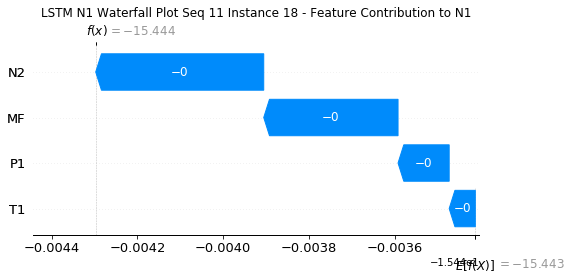

None

Contribution: [-1.19505704e-04 -5.92936662e-05 -3.84838862e-04 -3.03954950e-04]


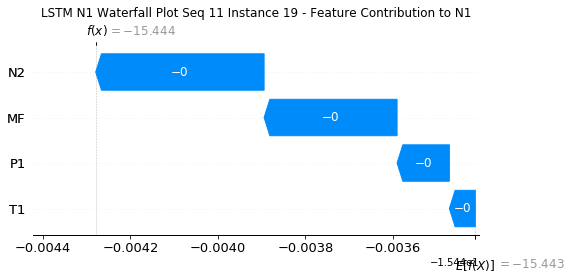

None

Contribution: [-1.21220837e-04 -6.09572533e-05 -3.72214689e-04 -2.83783584e-04]


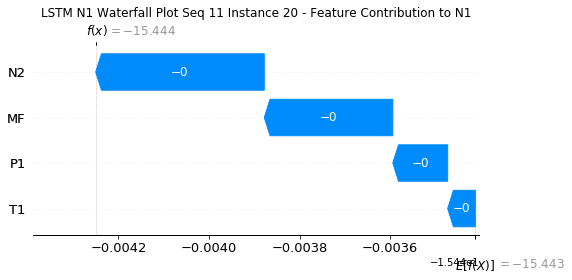

None

Contribution: [-1.11627861e-04 -9.52362459e-05 -3.40375338e-04 -2.13255625e-04]


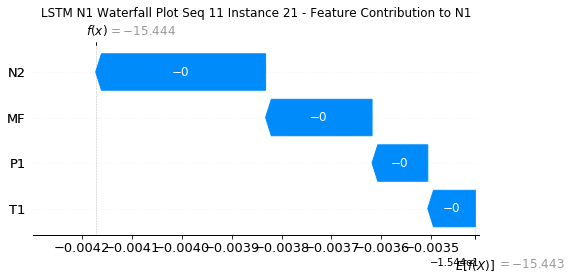

None

Contribution: [-9.77688983e-05 -1.06588417e-04 -3.65470051e-04 -3.00406915e-04]


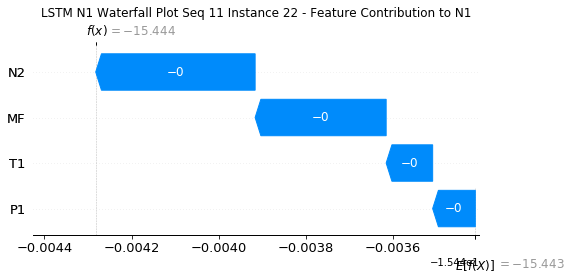

None

Contribution: [ 0.00056843  0.0009683  -0.00250939 -0.00427105]


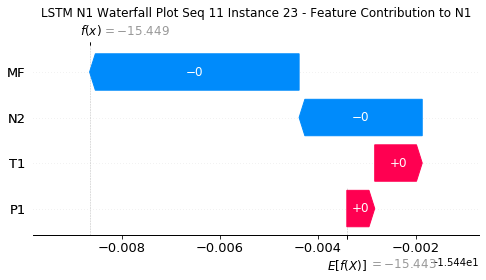

None

Contribution: [ 0.00149692  0.01610305 -0.01616653 -0.02823137]


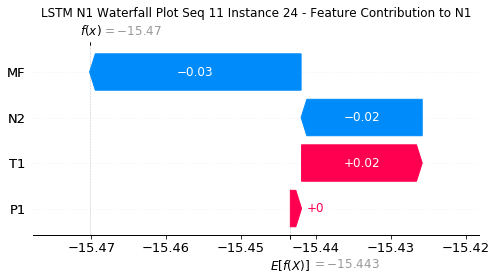

None

Contribution: [-0.0508973  -0.00797865 -0.14612049 -0.08592804]


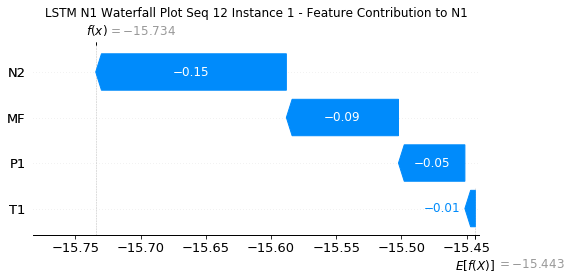

None

Contribution: [0.00066077 0.00028325 0.00187937 0.00178803]


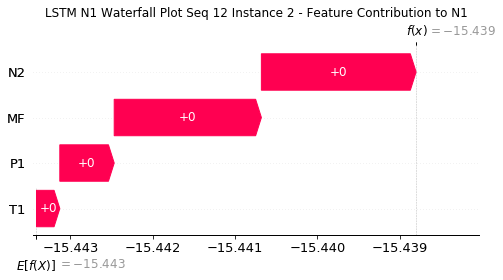

None

Contribution: [-7.56170095e-05 -7.64387117e-05 -3.09115026e-04 -2.61753556e-04]


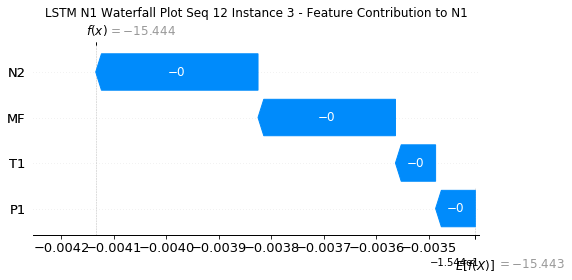

None

Contribution: [-1.67969809e-04 -7.81496246e-05 -5.81154395e-04 -4.90468021e-04]


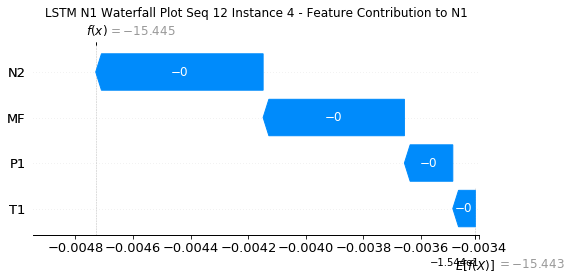

None

Contribution: [-0.00014554 -0.00010237 -0.00049832 -0.0004146 ]


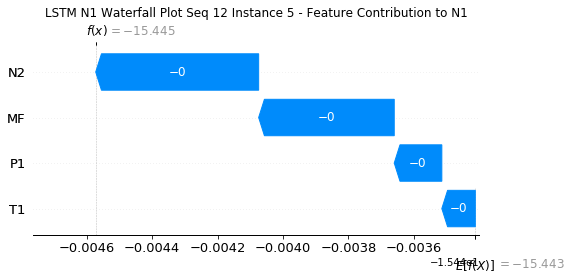

None

Contribution: [-1.43863387e-04 -9.13814001e-05 -4.54115727e-04 -3.73930323e-04]


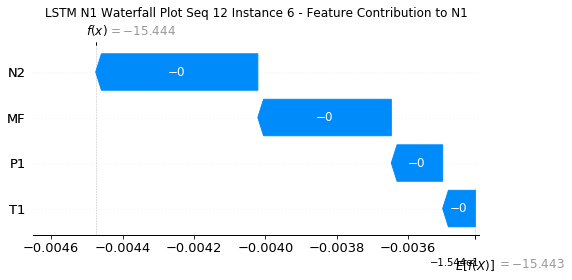

None

Contribution: [-1.53615286e-04 -9.86355186e-05 -4.92377933e-04 -4.04314731e-04]


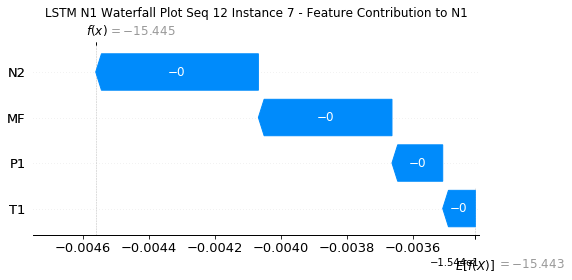

None

Contribution: [-1.54787103e-04 -9.87675339e-05 -5.11100315e-04 -4.06358384e-04]


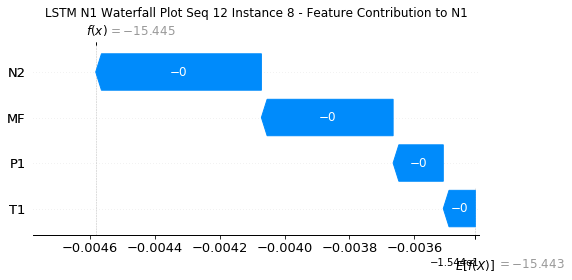

None

Contribution: [-1.52012318e-04 -9.91322606e-05 -5.03137171e-04 -4.09005913e-04]


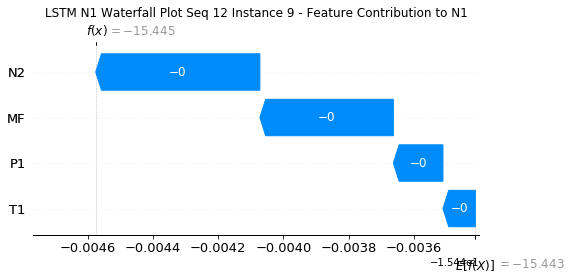

None

Contribution: [-1.51618715e-04 -9.83249388e-05 -4.87328884e-04 -4.09471074e-04]


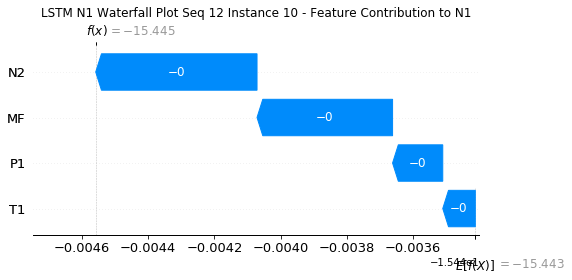

None

Contribution: [-1.46614852e-04 -9.56487640e-05 -4.70182641e-04 -3.92537346e-04]


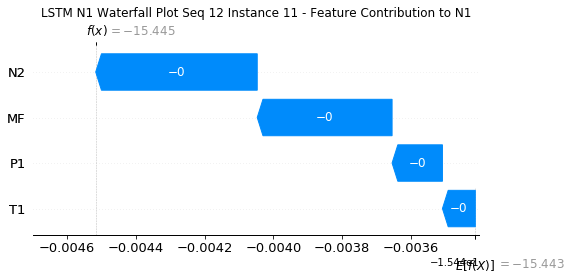

None

Contribution: [-1.37307862e-04 -9.09738102e-05 -4.50545127e-04 -3.70016656e-04]


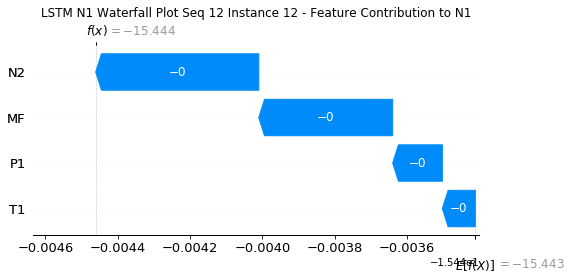

None

Contribution: [-1.36590249e-04 -8.90151595e-05 -4.39377537e-04 -3.64371696e-04]


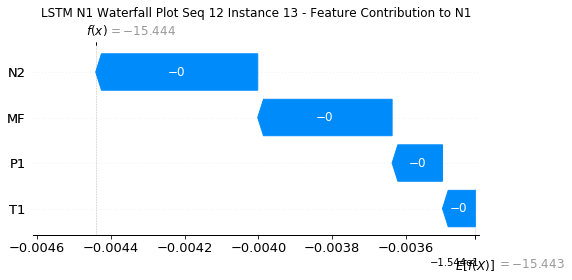

None

Contribution: [-1.34867374e-04 -8.81401074e-05 -4.27539325e-04 -3.60551496e-04]


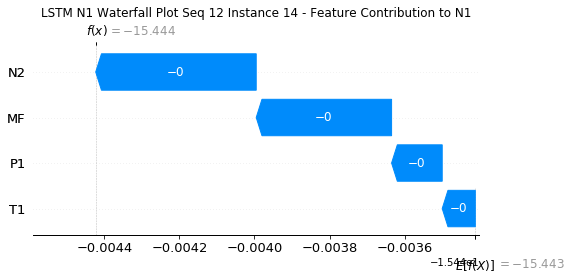

None

Contribution: [-1.28602224e-04 -8.39201832e-05 -4.13889694e-04 -3.41368475e-04]


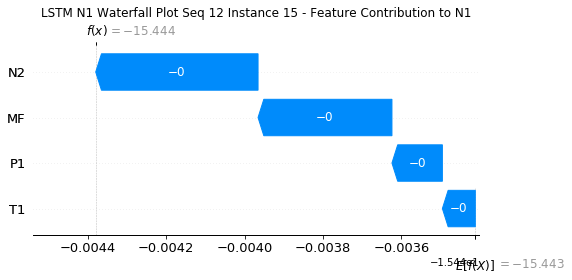

None

Contribution: [-1.25158218e-04 -8.14864914e-05 -4.03354832e-04 -3.30520341e-04]


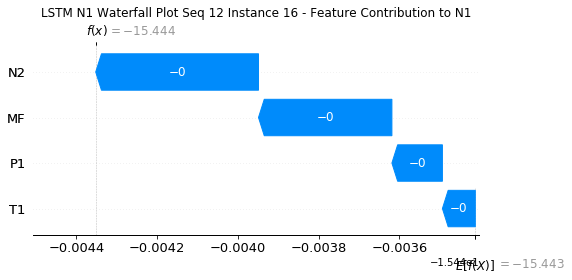

None

Contribution: [-1.21166918e-04 -7.76093588e-05 -3.93859239e-04 -3.18018309e-04]


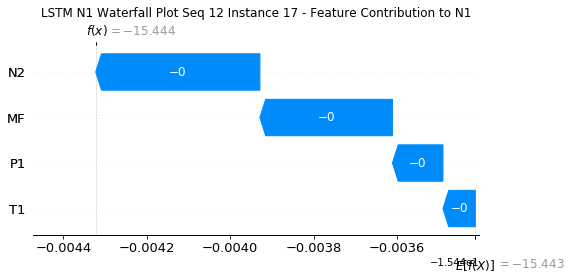

None

Contribution: [-1.21604050e-04 -7.77031527e-05 -3.89116171e-04 -3.15921175e-04]


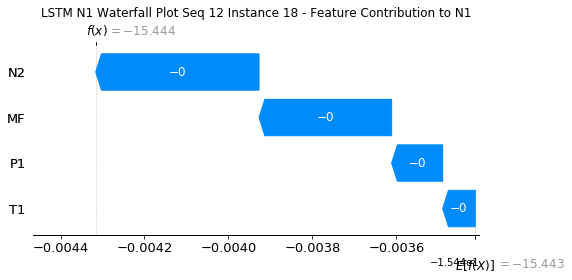

None

Contribution: [-1.21540128e-04 -7.39295203e-05 -3.82183706e-04 -3.06108515e-04]


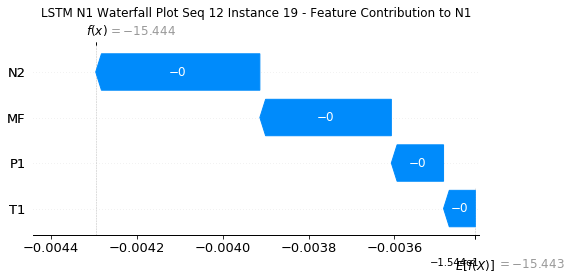

None

Contribution: [-1.23402809e-04 -6.72082665e-05 -3.70035721e-04 -2.84983890e-04]


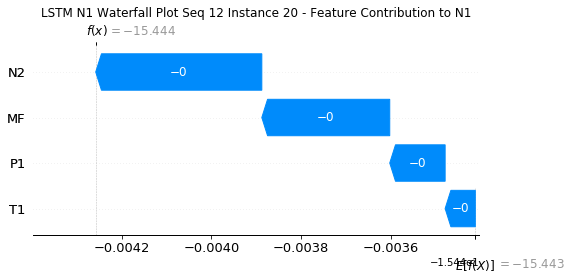

None

Contribution: [-1.15806791e-04 -6.54259712e-05 -3.40156103e-04 -2.11075381e-04]


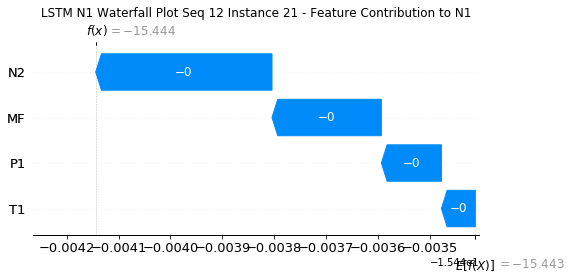

None

Contribution: [-9.53338839e-05 -1.21313589e-04 -3.61511511e-04 -3.02784829e-04]


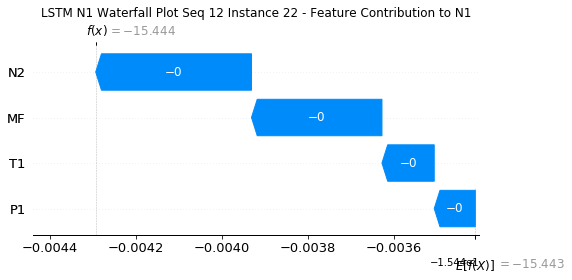

None

Contribution: [ 0.000523    0.00028786 -0.00236653 -0.00396141]


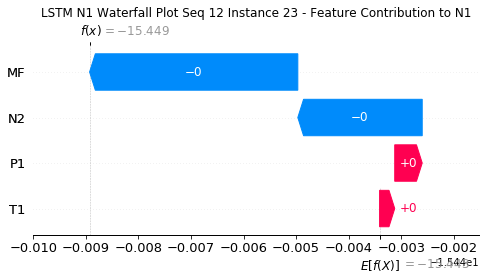

None

Contribution: [ 0.0012719   0.00853553 -0.01550286 -0.02488186]


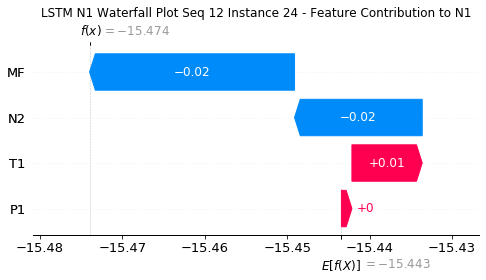

None

Contribution: [-0.05125231 -0.01422902 -0.14395416 -0.08628108]


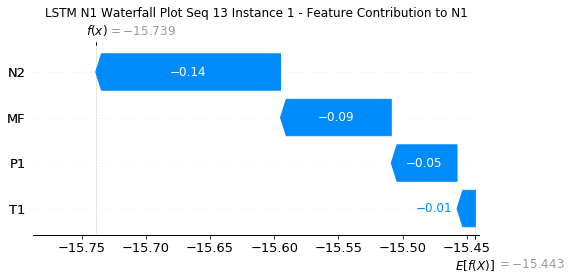

None

Contribution: [0.0006648  0.0002901  0.00186816 0.00179941]


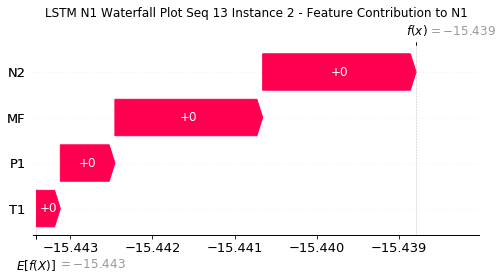

None

Contribution: [-7.50526362e-05 -7.66100173e-05 -3.07678503e-04 -2.61499510e-04]


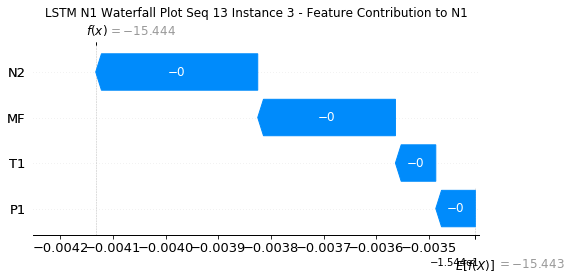

None

Contribution: [-1.65572590e-04 -7.64484181e-05 -5.79833442e-04 -5.01842038e-04]


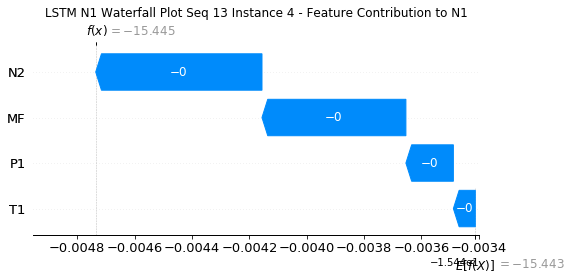

None

Contribution: [-0.00015122 -0.00010222 -0.00049783 -0.0004223 ]


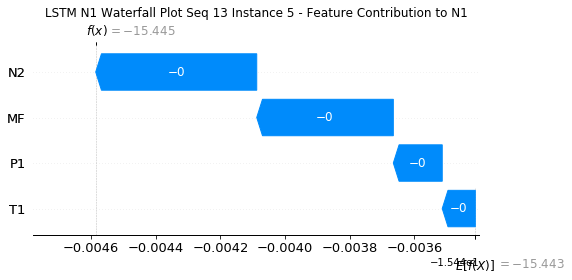

None

Contribution: [-1.42490367e-04 -8.97792457e-05 -4.53797697e-04 -3.76772280e-04]


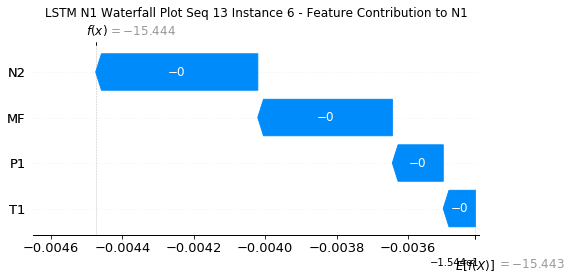

None

Contribution: [-1.44133349e-04 -9.12717334e-05 -4.84582296e-04 -3.87885132e-04]


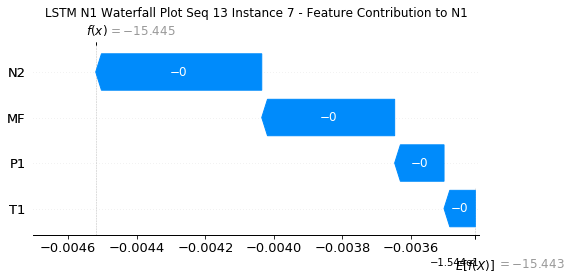

None

Contribution: [-1.49934544e-04 -9.20836952e-05 -5.08317090e-04 -4.04706865e-04]


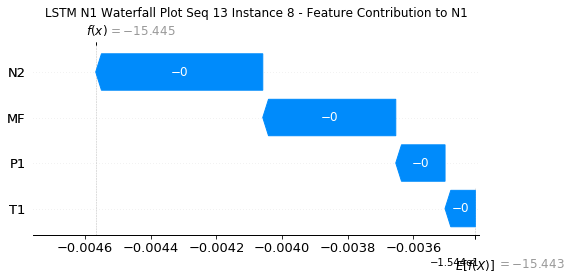

None

Contribution: [-1.48684616e-04 -9.37522779e-05 -5.00195247e-04 -4.04926741e-04]


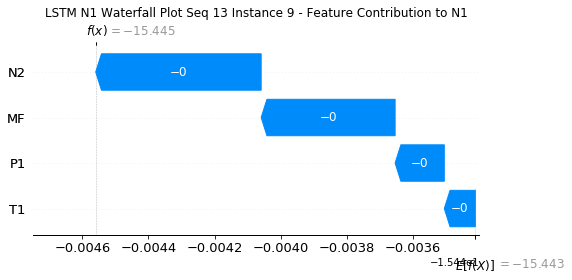

None

Contribution: [-1.52013703e-04 -9.24236272e-05 -4.88306601e-04 -4.14191752e-04]


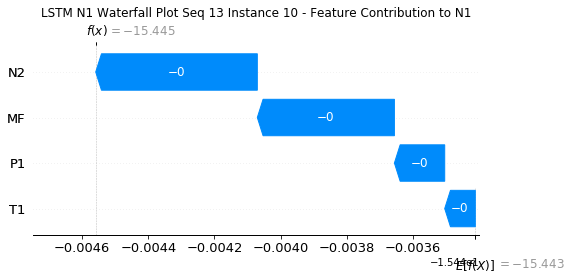

None

Contribution: [-1.45629630e-04 -8.97650841e-05 -4.70166707e-04 -3.94386946e-04]


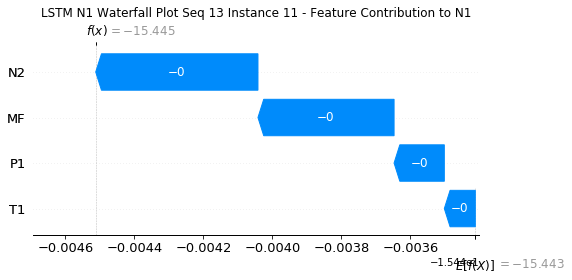

None

Contribution: [-1.41075353e-04 -8.67151334e-05 -4.54251143e-04 -3.81186427e-04]


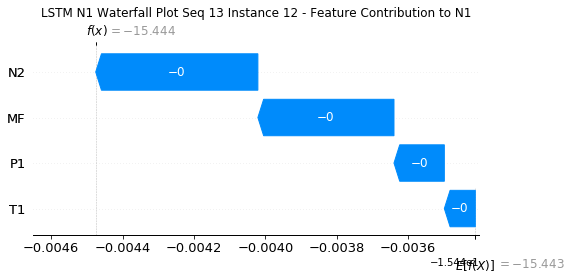

None

Contribution: [-1.36202938e-04 -8.34254629e-05 -4.40016485e-04 -3.66003173e-04]


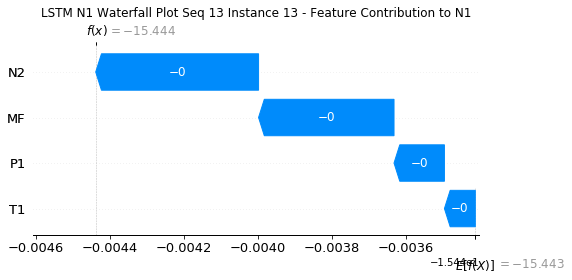

None

Contribution: [-1.29883512e-04 -7.89581503e-05 -4.25039737e-04 -3.48655591e-04]


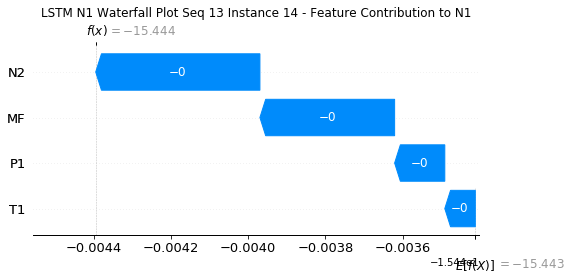

None

Contribution: [-1.27408676e-04 -7.75574445e-05 -4.14173712e-04 -3.40532814e-04]


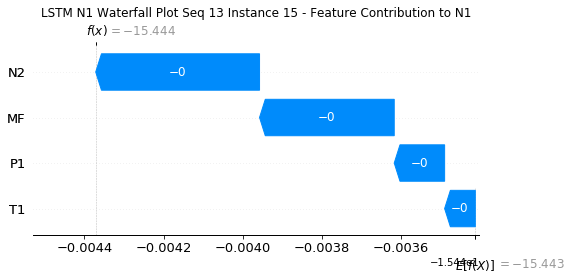

None

Contribution: [-1.23898954e-04 -7.55011546e-05 -4.03693408e-04 -3.30309274e-04]


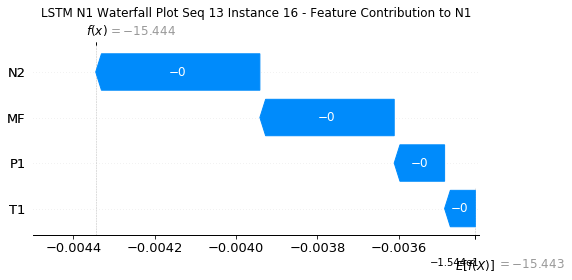

None

Contribution: [-1.21413424e-04 -7.83069942e-05 -3.96289600e-04 -3.22184647e-04]


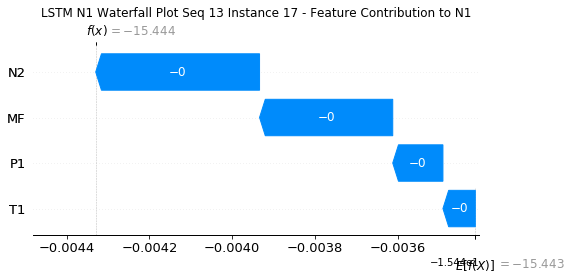

None

Contribution: [-1.18738328e-04 -7.35200493e-05 -3.88916931e-04 -3.12217258e-04]


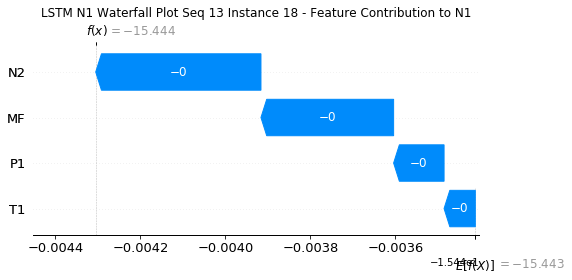

None

Contribution: [-1.19035256e-04 -7.00775439e-05 -3.82297845e-04 -3.03530261e-04]


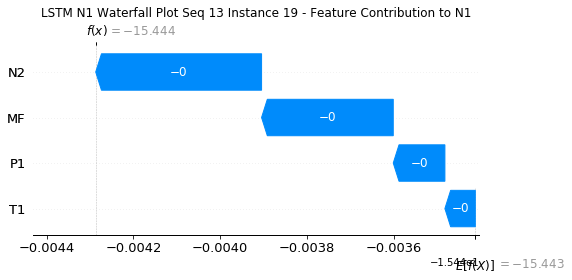

None

Contribution: [-1.21065984e-04 -6.53707114e-05 -3.70110836e-04 -2.83420704e-04]


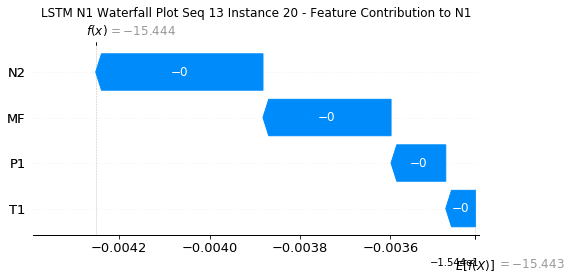

None

Contribution: [-1.14222575e-04 -7.08887115e-05 -3.39034164e-04 -2.09914192e-04]


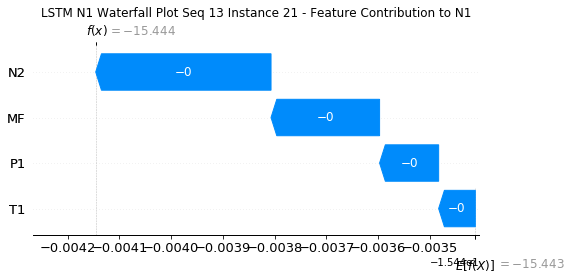

None

Contribution: [-9.63486908e-05 -1.20084260e-04 -3.62218809e-04 -3.00431719e-04]


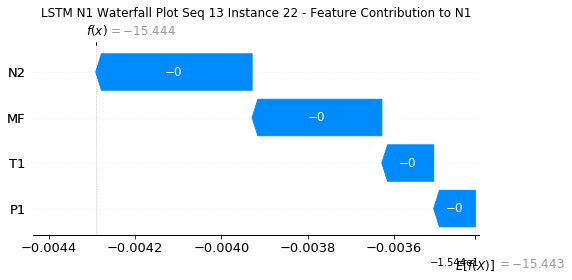

None

Contribution: [ 0.00035531  0.00024035 -0.00240856 -0.00382606]


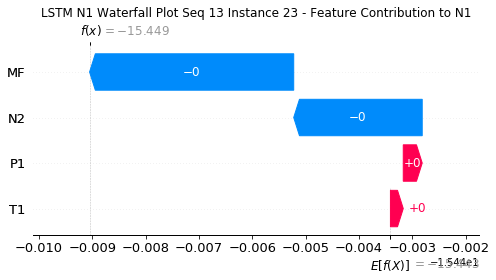

None

Contribution: [ 0.00030771  0.01346363 -0.0156192  -0.02517469]


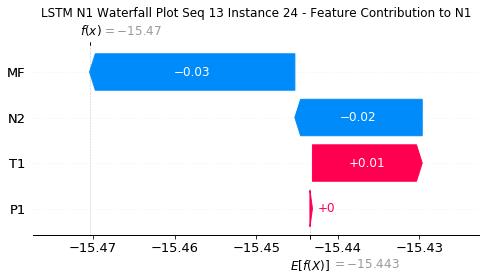

None

Contribution: [-0.04712509 -0.01228294 -0.14529159 -0.08332717]


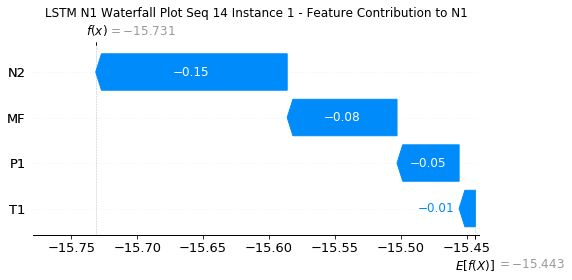

None

Contribution: [0.00065138 0.00028761 0.00188288 0.00178224]


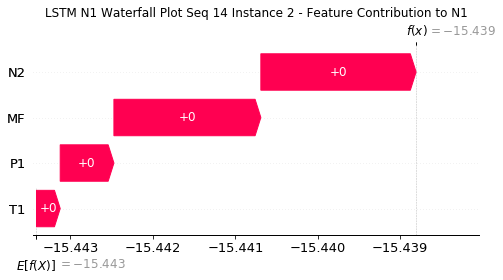

None

Contribution: [-7.52552043e-05 -7.63134769e-05 -3.09762831e-04 -2.62923884e-04]


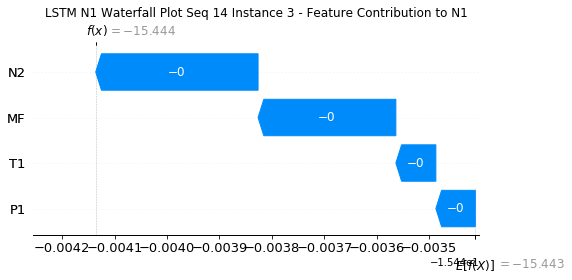

None

Contribution: [-1.60717228e-04 -7.84390595e-05 -5.83010609e-04 -4.97489246e-04]


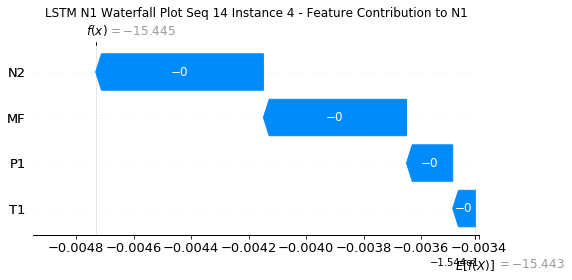

None

Contribution: [-1.45835371e-04 -9.31243561e-05 -4.98532665e-04 -4.16599124e-04]


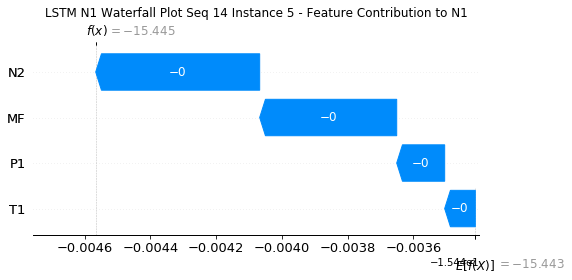

None

Contribution: [-1.41360089e-04 -9.18782592e-05 -4.55287317e-04 -3.75954575e-04]


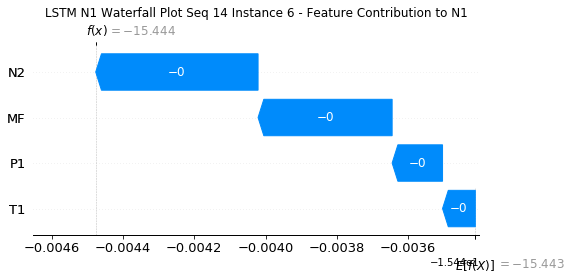

None

Contribution: [-1.45737232e-04 -9.76716686e-05 -4.88553427e-04 -3.93757960e-04]


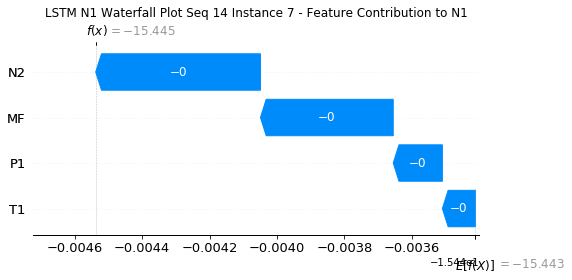

None

Contribution: [-0.00014969 -0.00010547 -0.00051227 -0.00040797]


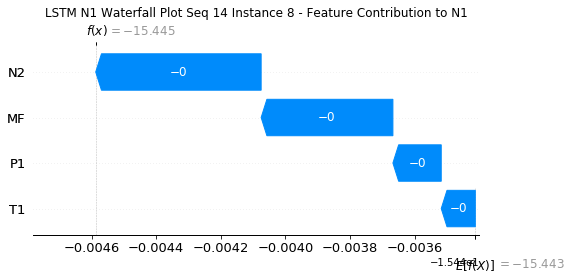

None

Contribution: [-0.00014824 -0.00010454 -0.00050359 -0.00040826]


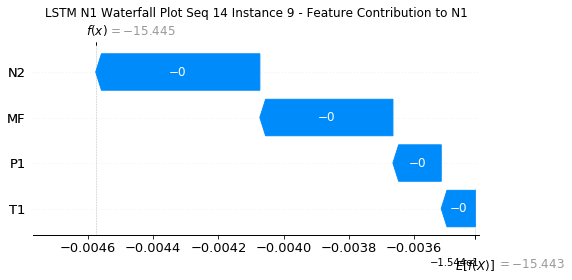

None

Contribution: [-1.47737960e-04 -9.90982869e-05 -4.87794658e-04 -4.08200614e-04]


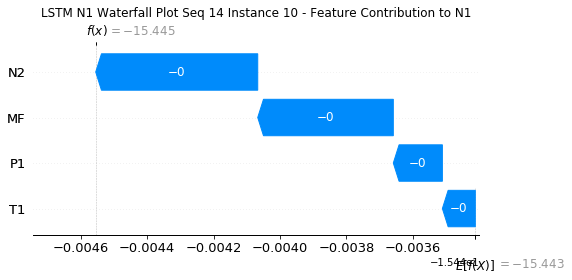

None

Contribution: [-1.42146538e-04 -9.56867280e-05 -4.70107486e-04 -3.89934502e-04]


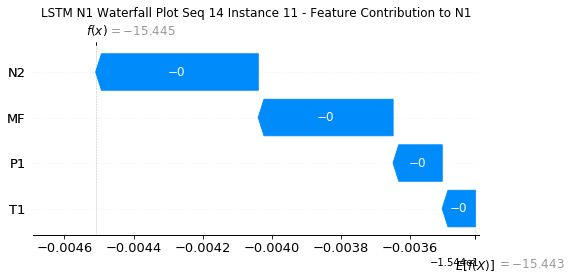

None

Contribution: [-1.36259822e-04 -9.35186460e-05 -4.55212519e-04 -3.78320724e-04]


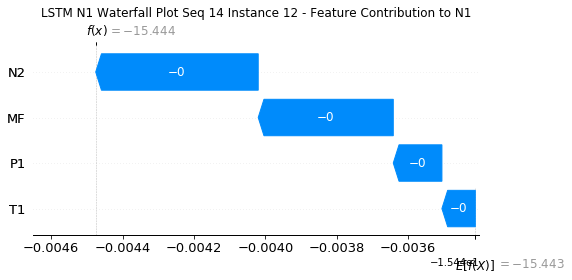

None

Contribution: [-1.32617788e-04 -9.01003821e-05 -4.40069168e-04 -3.62171053e-04]


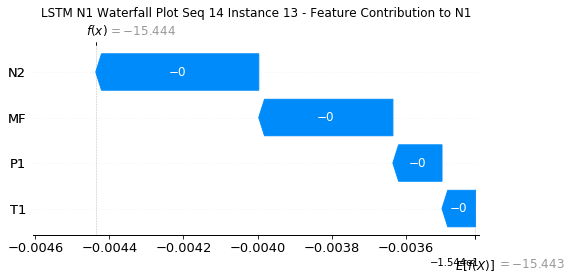

None

Contribution: [-1.26853903e-04 -8.50346596e-05 -4.26342469e-04 -3.50582917e-04]


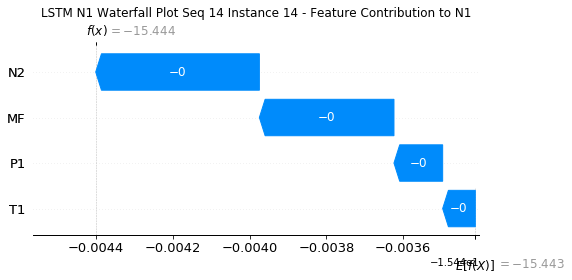

None

Contribution: [-1.24192084e-04 -8.45896737e-05 -4.14381422e-04 -3.38337838e-04]


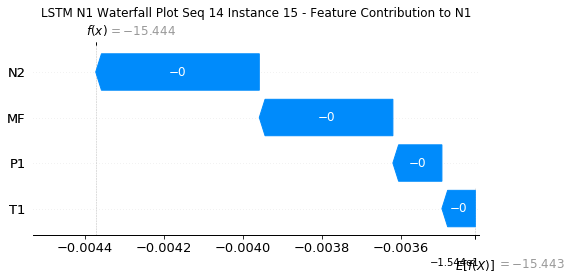

None

Contribution: [-1.21106144e-04 -8.30656354e-05 -4.04256511e-04 -3.29433548e-04]


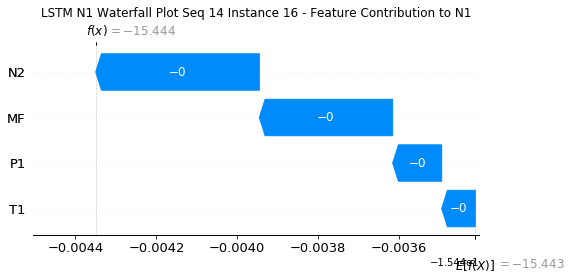

None

Contribution: [-1.18642029e-04 -7.68427390e-05 -3.95981288e-04 -3.21862348e-04]


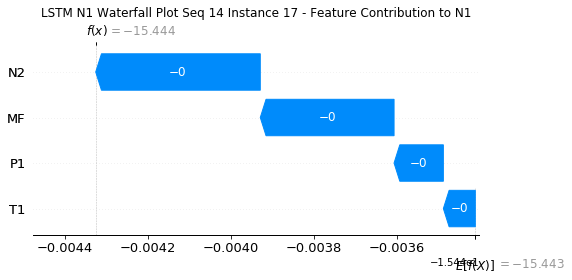

None

Contribution: [-1.17481686e-04 -7.96050930e-05 -3.90010201e-04 -3.14114417e-04]


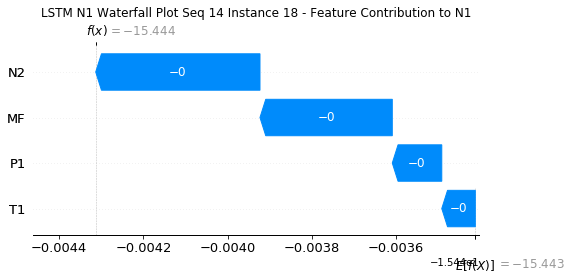

None

Contribution: [-1.17621795e-04 -7.64913852e-05 -3.83387727e-04 -3.05399747e-04]


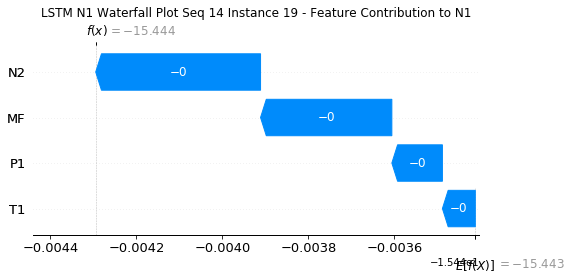

None

Contribution: [-1.19481507e-04 -6.93508182e-05 -3.71398295e-04 -2.85230951e-04]


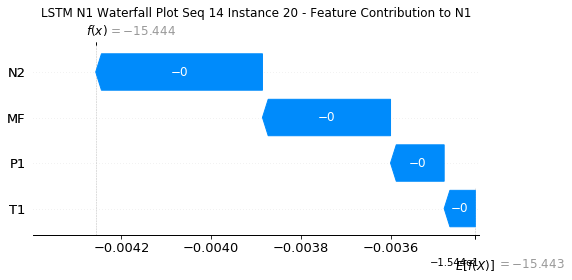

None

Contribution: [-1.11541270e-04 -6.03749201e-05 -3.40956435e-04 -2.14690814e-04]


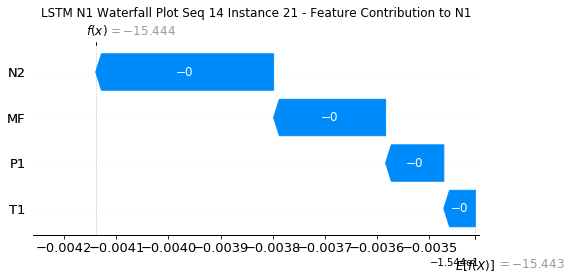

None

Contribution: [-9.86245631e-05 -1.24763407e-04 -3.63278870e-04 -3.03708963e-04]


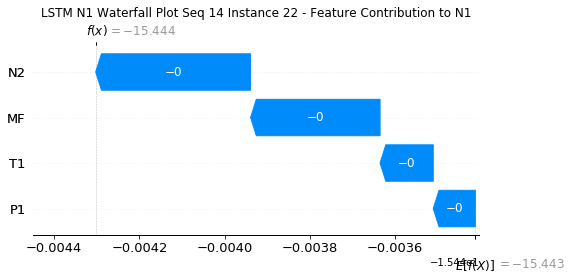

None

Contribution: [ 0.00045704 -0.00066146 -0.00246055 -0.00441967]


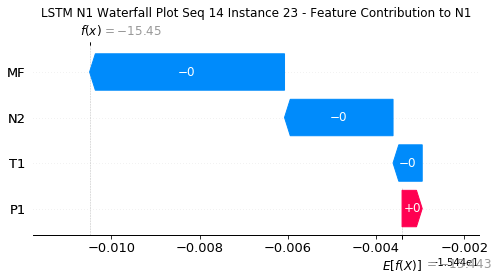

None

Contribution: [ 0.00059027  0.00137881 -0.0154665  -0.02554151]


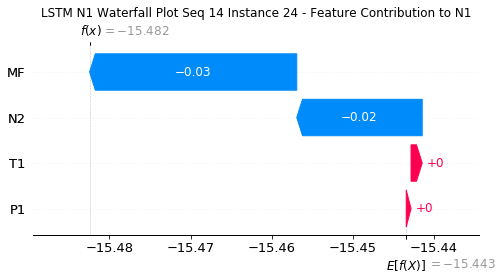

None

Contribution: [-0.04812146 -0.01864688 -0.1440856  -0.08283002]


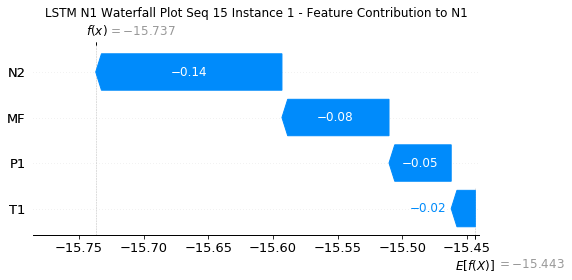

None

Contribution: [0.0006549  0.00030404 0.00186902 0.00178877]


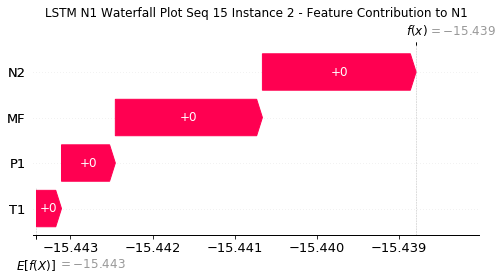

None

Contribution: [-7.44951970e-05 -7.94349116e-05 -3.07637647e-04 -2.60222885e-04]


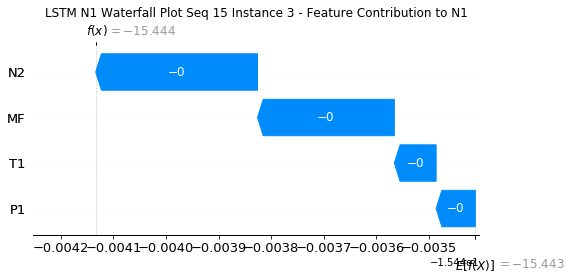

None

Contribution: [-0.00015587 -0.00010738 -0.00057822 -0.00048763]


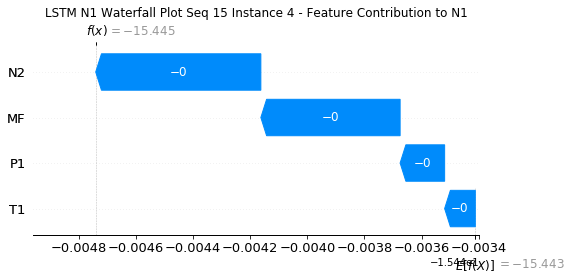

None

Contribution: [-0.0001464  -0.00011533 -0.00049697 -0.00041668]


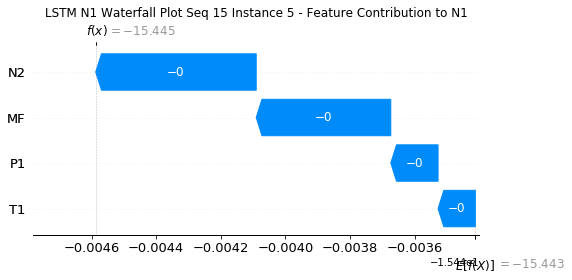

None

Contribution: [-0.00013953 -0.00010019 -0.00045305 -0.00037216]


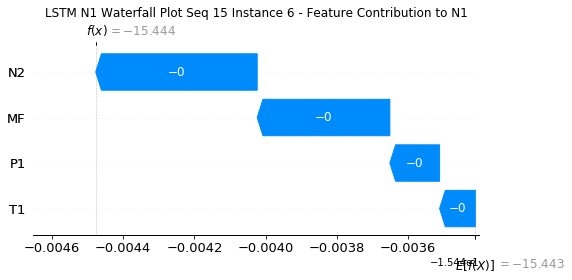

None

Contribution: [-0.00014282 -0.00010187 -0.00048596 -0.00038999]


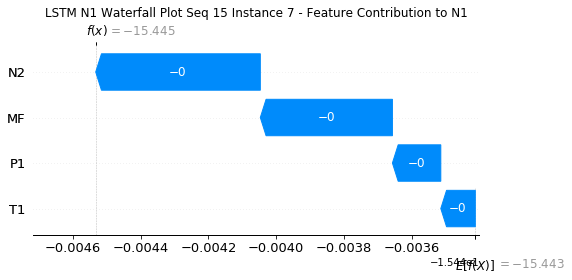

None

Contribution: [-0.00015124 -0.00010656 -0.00051133 -0.0004088 ]


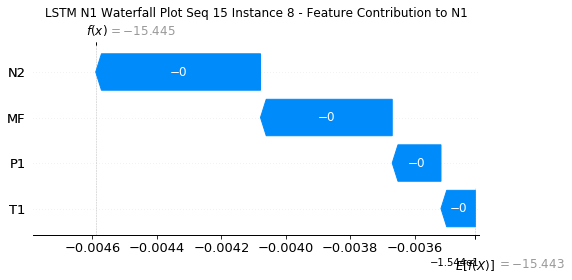

None

Contribution: [-0.00014671 -0.00010608 -0.00050069 -0.00040253]


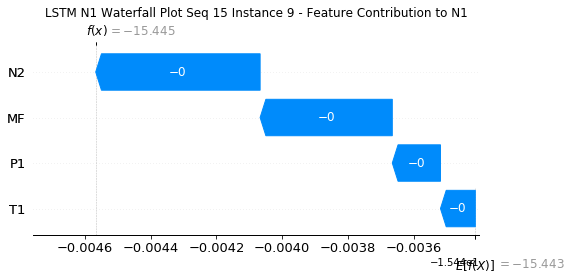

None

Contribution: [-0.0001476  -0.00010173 -0.00048701 -0.00040765]


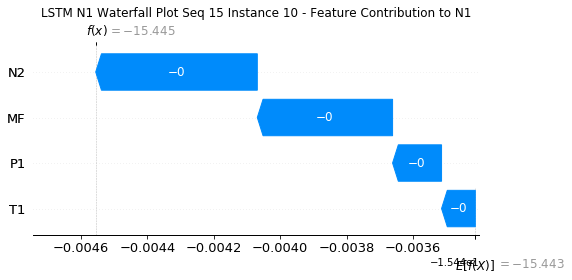

None

Contribution: [-1.41760250e-04 -9.79996628e-05 -4.69223051e-04 -3.89377687e-04]


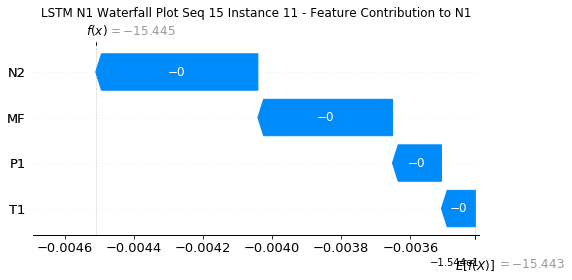

None

Contribution: [-1.36931439e-04 -9.51666074e-05 -4.54053042e-04 -3.76498850e-04]


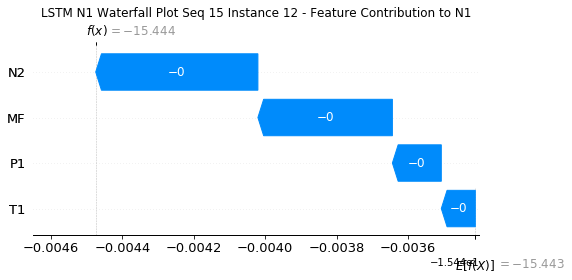

None

Contribution: [-1.32635225e-04 -9.02701034e-05 -4.39066760e-04 -3.61602304e-04]


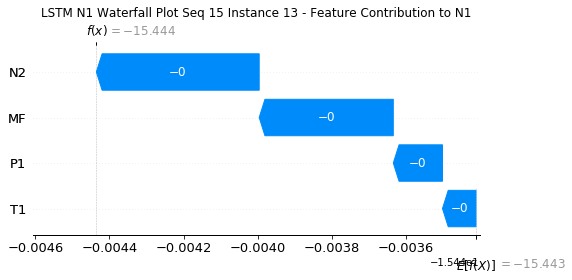

None

Contribution: [-1.29135635e-04 -8.44616257e-05 -4.26268972e-04 -3.51201615e-04]


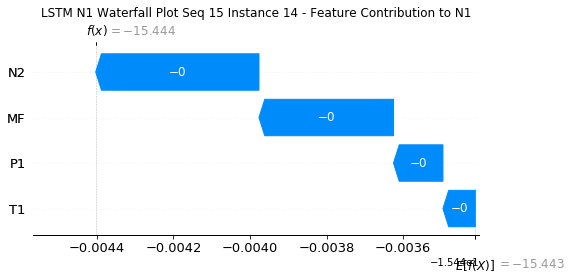

None

Contribution: [-1.24462209e-04 -8.35406348e-05 -4.13575638e-04 -3.37738396e-04]


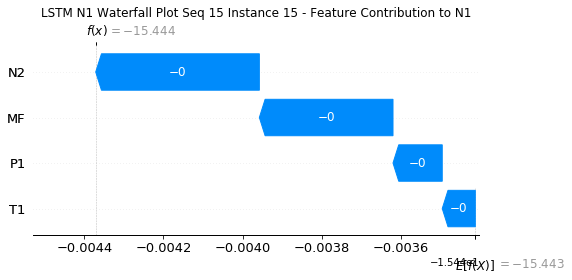

None

Contribution: [-1.21330949e-04 -8.15810859e-05 -4.03248686e-04 -3.27725325e-04]


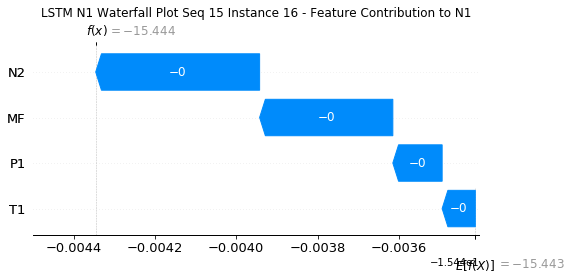

None

Contribution: [-1.19256532e-04 -7.88444186e-05 -3.95107408e-04 -3.18966960e-04]


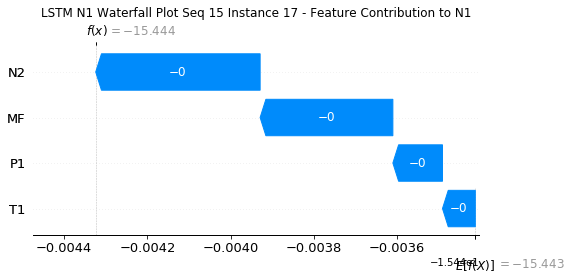

None

Contribution: [-1.17207200e-04 -7.77934458e-05 -3.88713484e-04 -3.11764355e-04]


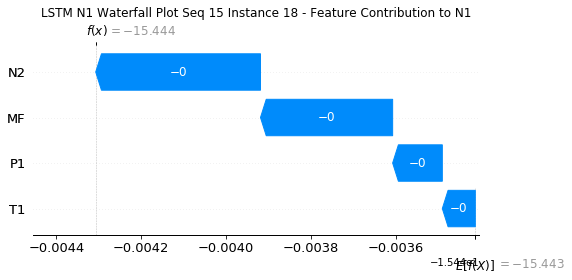

None

Contribution: [-1.17394090e-04 -7.41170207e-05 -3.82040900e-04 -3.02871988e-04]


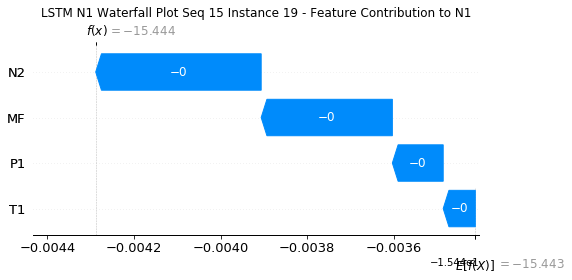

None

Contribution: [-1.19169370e-04 -6.71915583e-05 -3.69833082e-04 -2.82970691e-04]


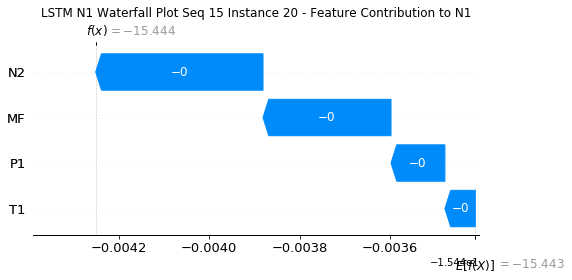

None

Contribution: [-1.11425039e-04 -6.57400293e-05 -3.39133927e-04 -2.12329152e-04]


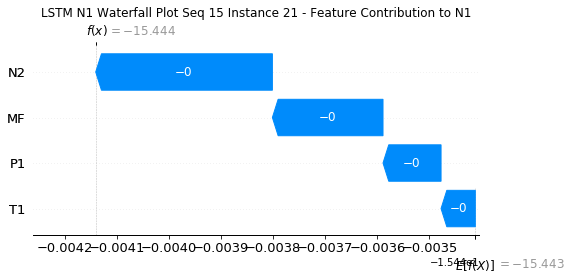

None

Contribution: [-9.81940890e-05 -1.20572611e-04 -3.62363305e-04 -2.99436082e-04]


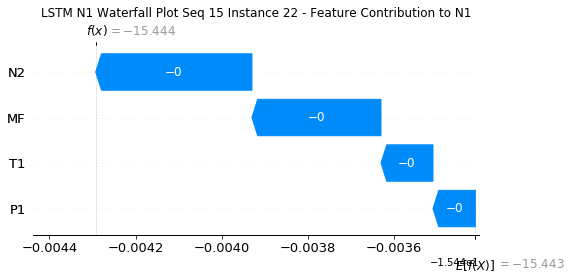

None

Contribution: [ 0.00034094  0.00035837 -0.00244125 -0.00378097]


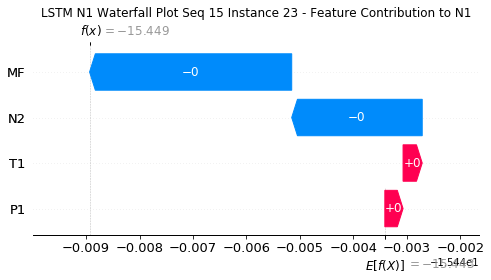

None

Contribution: [ 0.0005286   0.00771481 -0.01599857 -0.02716078]


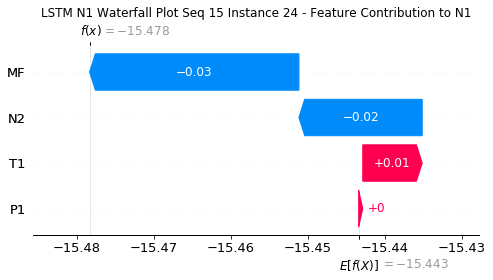

None

Contribution: [-0.04819746 -0.01372429 -0.14529509 -0.08610377]


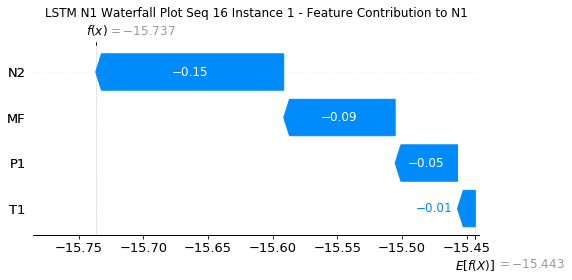

None

Contribution: [0.00066254 0.00029277 0.00187594 0.00179564]


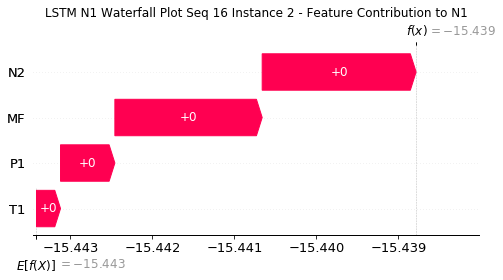

None

Contribution: [-7.42614679e-05 -7.75058459e-05 -3.07930696e-04 -2.60568587e-04]


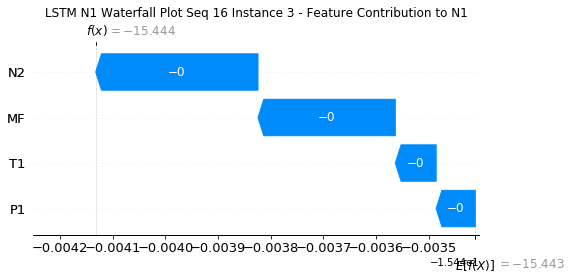

None

Contribution: [-1.53422016e-04 -9.03213848e-05 -5.80274946e-04 -4.89942202e-04]


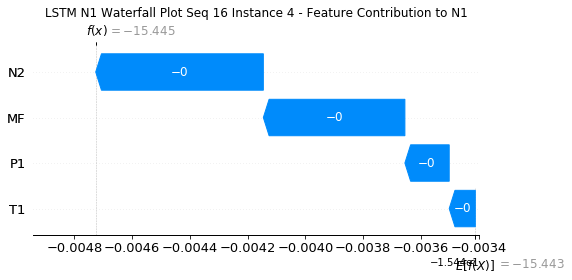

None

Contribution: [-0.00014644 -0.00010778 -0.00049797 -0.00041856]


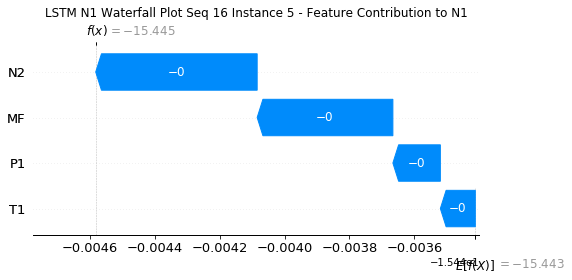

None

Contribution: [-1.39093114e-04 -9.51377391e-05 -4.53708776e-04 -3.73160629e-04]


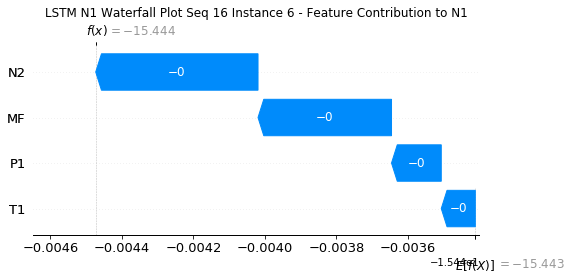

None

Contribution: [-1.44705114e-04 -9.93866839e-05 -4.88299665e-04 -3.95170338e-04]


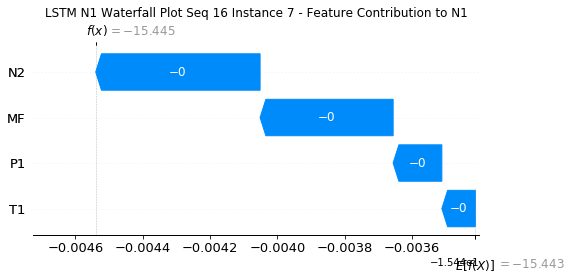

None

Contribution: [-0.00014845 -0.0001062  -0.00051057 -0.00040541]


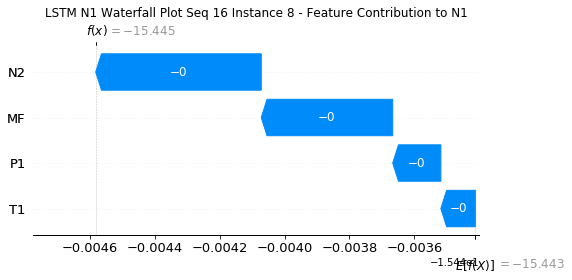

None

Contribution: [-0.0001481  -0.00010252 -0.0005025  -0.00040747]


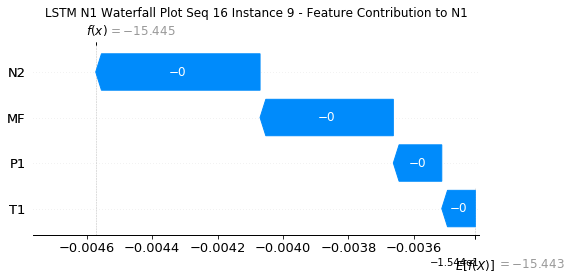

None

Contribution: [-0.00014783 -0.00010124 -0.00048763 -0.00040864]


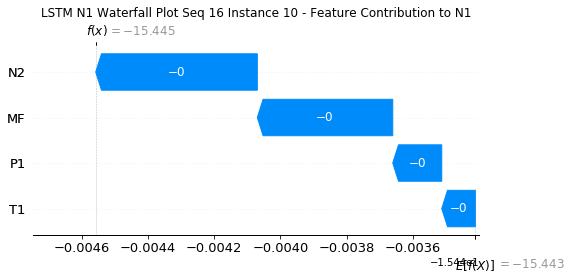

None

Contribution: [-1.41937123e-04 -9.78698079e-05 -4.69811956e-04 -3.90260298e-04]


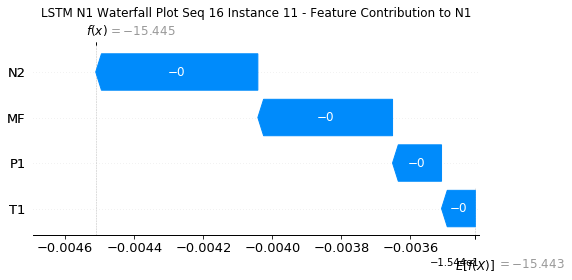

None

Contribution: [-1.36847807e-04 -9.74665355e-05 -4.53607192e-04 -3.73801822e-04]


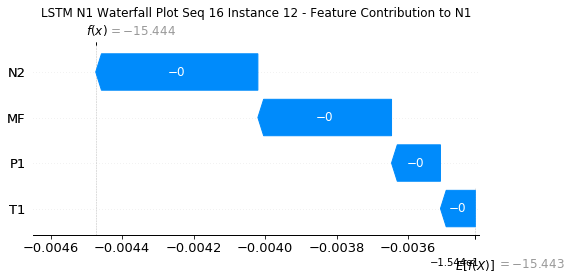

None

Contribution: [-1.32884137e-04 -9.11554506e-05 -4.39737470e-04 -3.62805931e-04]


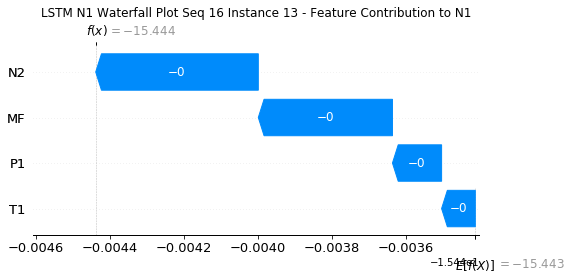

None

Contribution: [-1.29332136e-04 -8.85612503e-05 -4.26010197e-04 -3.49715766e-04]


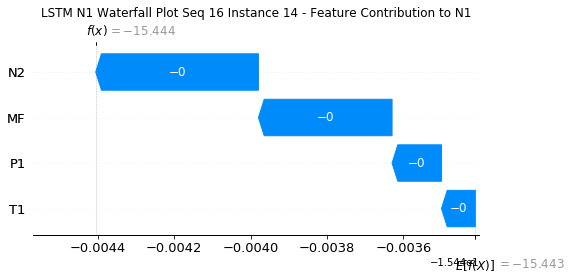

None

Contribution: [-1.24671478e-04 -8.52067516e-05 -4.14274823e-04 -3.39269308e-04]


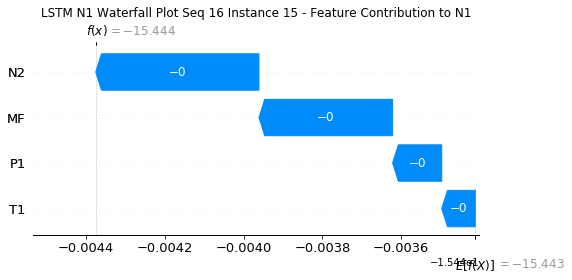

None

Contribution: [-1.21253855e-04 -8.28473776e-05 -4.03755356e-04 -3.28839285e-04]


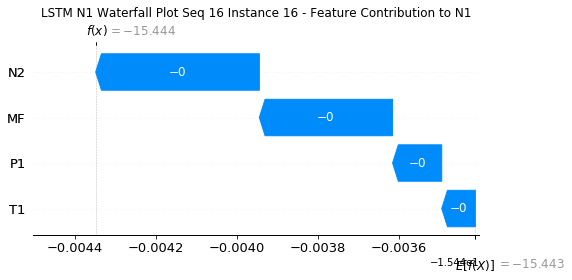

None

Contribution: [-1.19387685e-04 -7.88039453e-05 -3.95324137e-04 -3.19000145e-04]


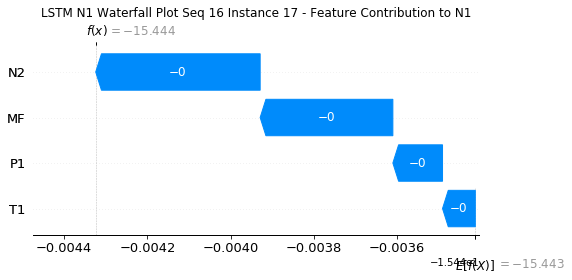

None

Contribution: [-1.16724837e-04 -7.86447279e-05 -3.89167352e-04 -3.12998236e-04]


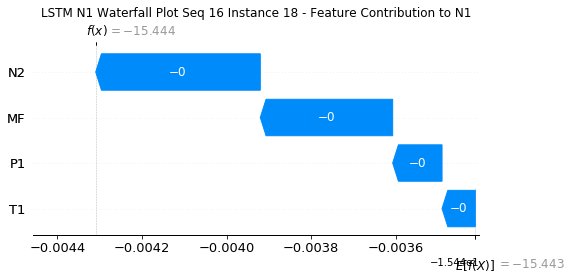

None

Contribution: [-1.16800241e-04 -7.49614534e-05 -3.82382260e-04 -3.03775689e-04]


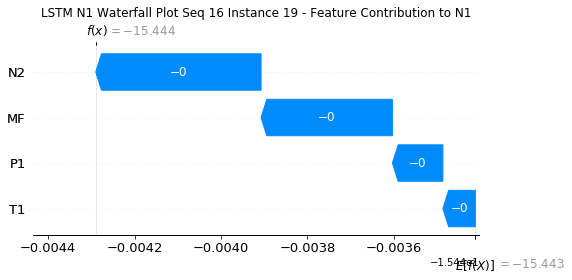

None

Contribution: [-1.18483801e-04 -6.78895408e-05 -3.70188542e-04 -2.83696406e-04]


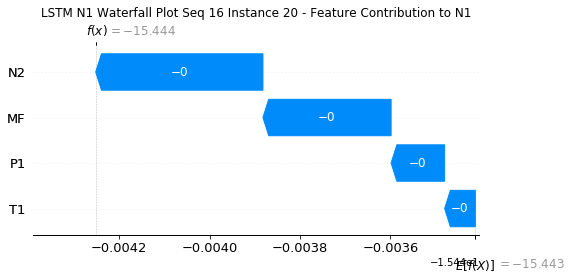

None

Contribution: [-1.10894701e-04 -6.31615795e-05 -3.39425988e-04 -2.12505461e-04]


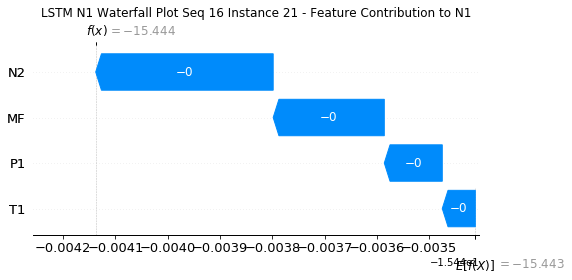

None

Contribution: [-9.89479057e-05 -1.23614979e-04 -3.61862690e-04 -2.98766696e-04]


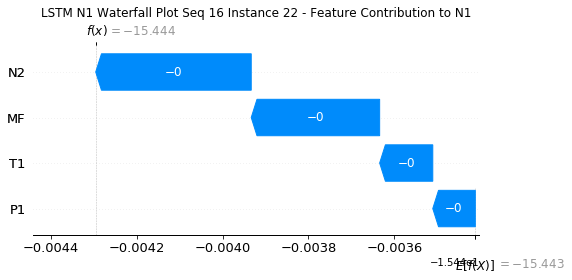

None

Contribution: [ 0.00041396 -0.0002698  -0.00243173 -0.00364318]


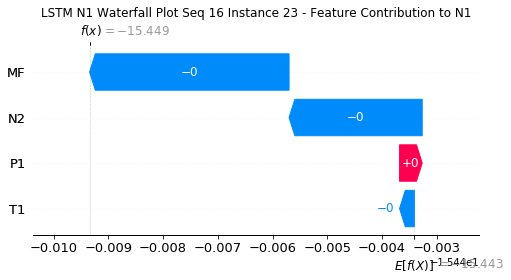

None

Contribution: [ 0.00060037  0.0097938  -0.015602   -0.02531981]


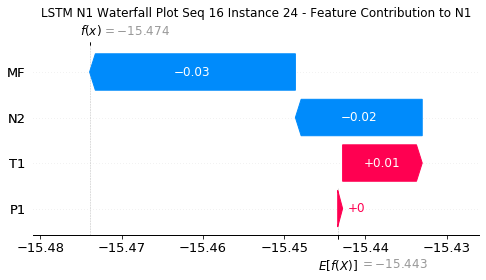

None

Contribution: [-0.04901474 -0.013807   -0.14502911 -0.08607973]


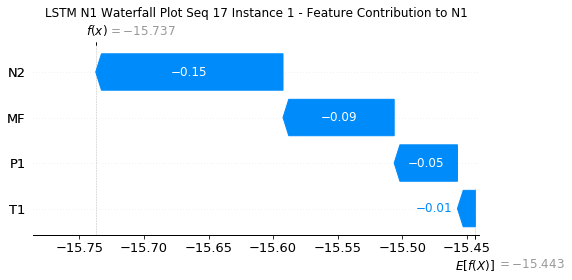

None

Contribution: [0.00066194 0.00028788 0.00187877 0.00181371]


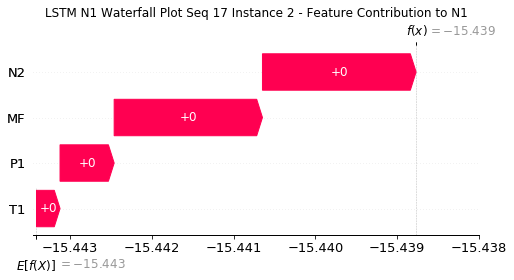

None

Contribution: [-7.45265566e-05 -7.63745861e-05 -3.07986684e-04 -2.61170575e-04]


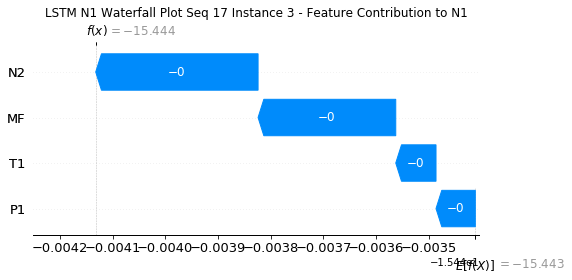

None

Contribution: [-1.55765214e-04 -7.65846927e-05 -5.80764726e-04 -4.93388822e-04]


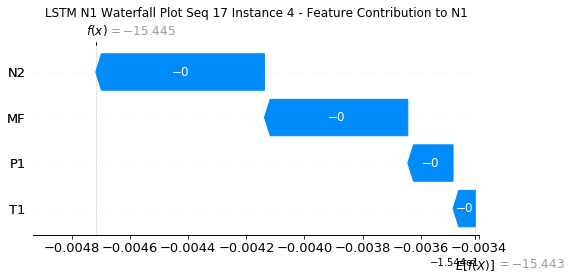

None

Contribution: [-0.00014582 -0.00010558 -0.00049796 -0.00041803]


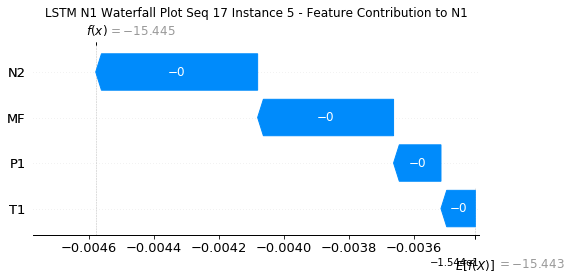

None

Contribution: [-1.39620892e-04 -9.08693657e-05 -4.53596588e-04 -3.73912961e-04]


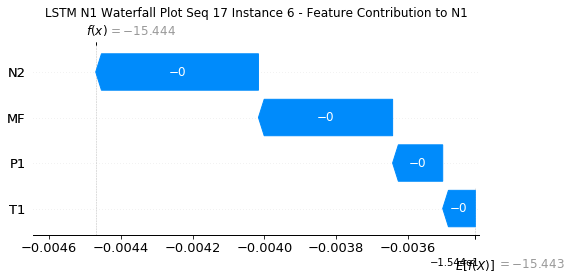

None

Contribution: [-1.45029710e-04 -9.87801176e-05 -4.88300177e-04 -3.95614186e-04]


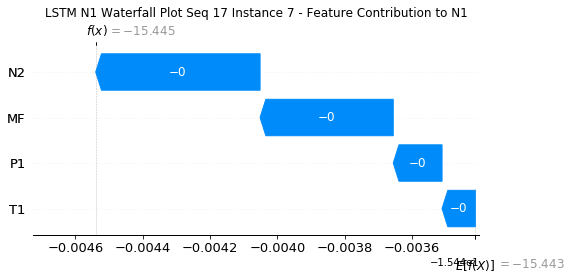

None

Contribution: [-0.00014948 -0.00010161 -0.00051275 -0.00041177]


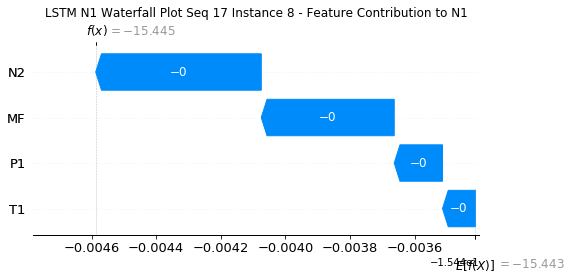

None

Contribution: [-0.00014642 -0.00010006 -0.00050206 -0.00040569]


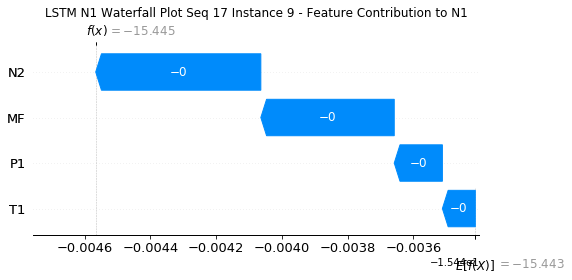

None

Contribution: [-1.46516117e-04 -9.52173398e-05 -4.86736280e-04 -4.05867987e-04]


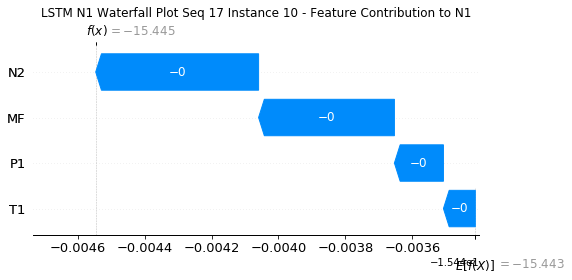

None

Contribution: [-1.41246621e-04 -9.26159142e-05 -4.69304712e-04 -3.88359286e-04]


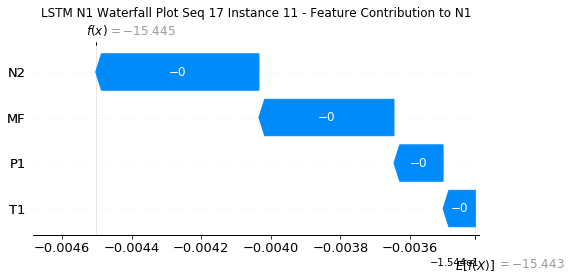

None

Contribution: [-1.36283976e-04 -9.22413131e-05 -4.53973959e-04 -3.74069856e-04]


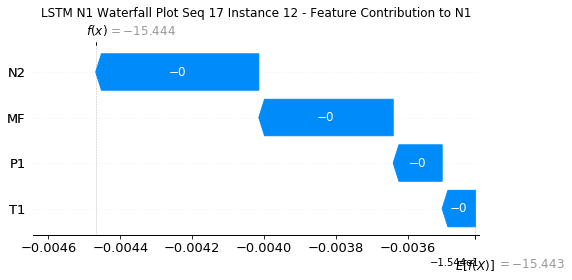

None

Contribution: [-1.31953931e-04 -8.62767260e-05 -4.38940266e-04 -3.59962300e-04]


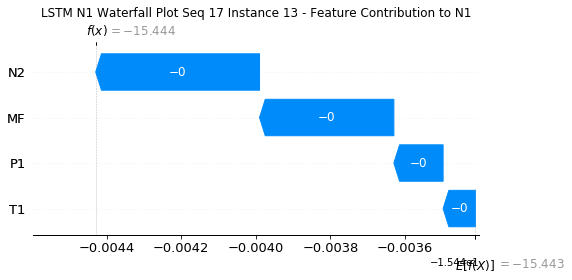

None

Contribution: [-1.29337863e-04 -8.33365723e-05 -4.26315620e-04 -3.53637969e-04]


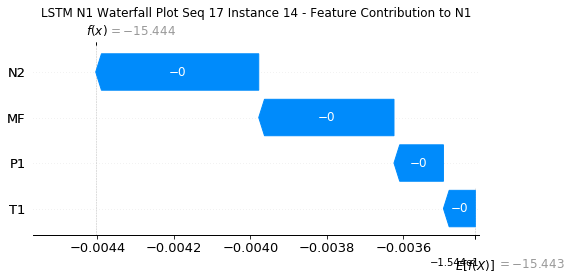

None

Contribution: [-1.23940222e-04 -8.09902955e-05 -4.13572816e-04 -3.36287623e-04]


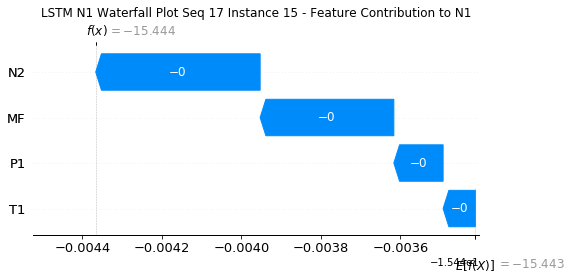

None

Contribution: [-1.20790747e-04 -7.86593732e-05 -4.03324710e-04 -3.26683126e-04]


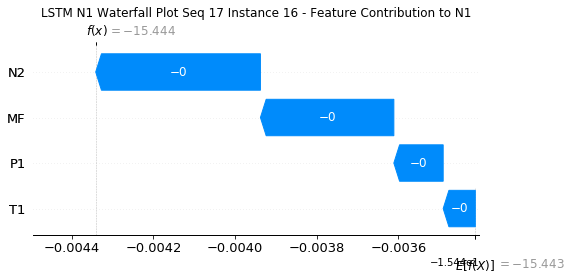

None

Contribution: [-1.19202345e-04 -7.68022787e-05 -3.95009393e-04 -3.21703478e-04]


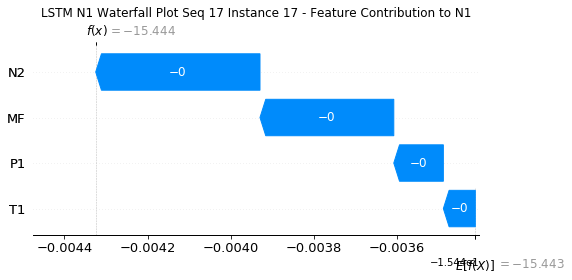

None

Contribution: [-1.17562200e-04 -7.57688473e-05 -3.89062275e-04 -3.11860124e-04]


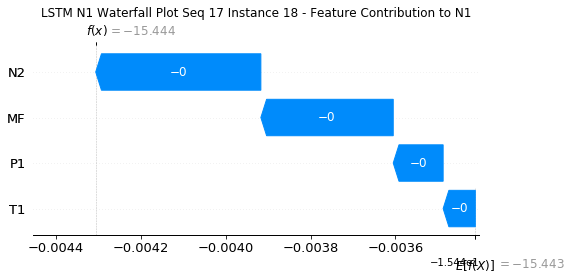

None

Contribution: [-1.17642962e-04 -7.21046185e-05 -3.82349318e-04 -3.02813028e-04]


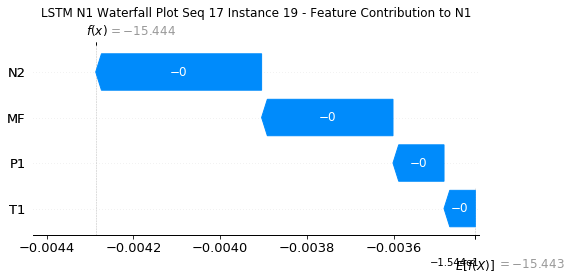

None

Contribution: [-1.19468789e-04 -6.62875664e-05 -3.70000546e-04 -2.82787656e-04]


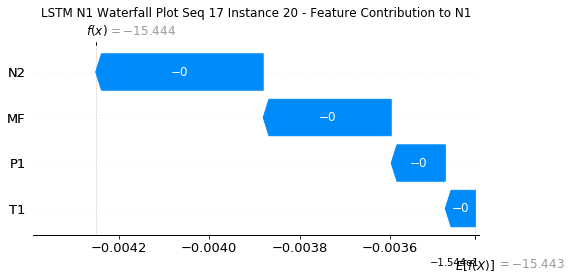

None

Contribution: [-1.10598810e-04 -6.79592726e-05 -3.38858506e-04 -2.12891746e-04]


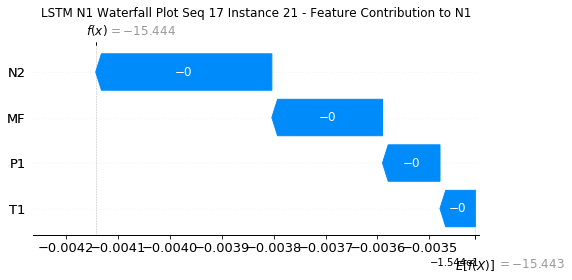

None

Contribution: [-9.75478385e-05 -1.21812375e-04 -3.61869186e-04 -2.98419304e-04]


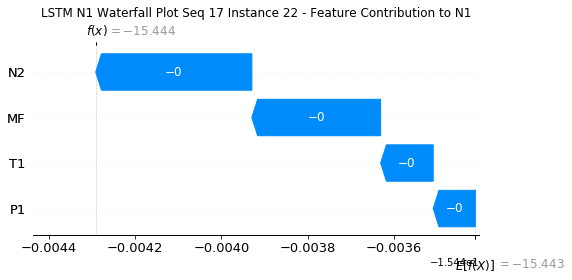

None

Contribution: [ 0.00051967  0.00048535 -0.00252041 -0.00442979]


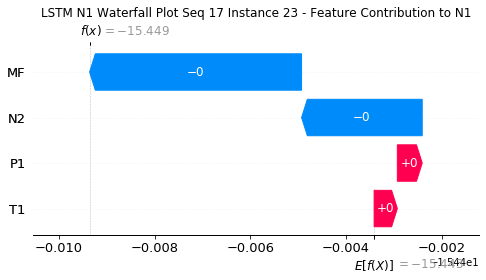

None

Contribution: [ 0.0004129   0.01474561 -0.01540494 -0.0244734 ]


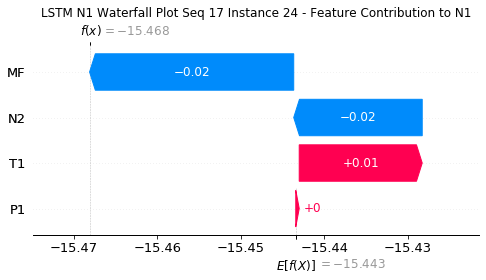

None

Contribution: [-0.04852952 -0.01134498 -0.1450337  -0.08284655]


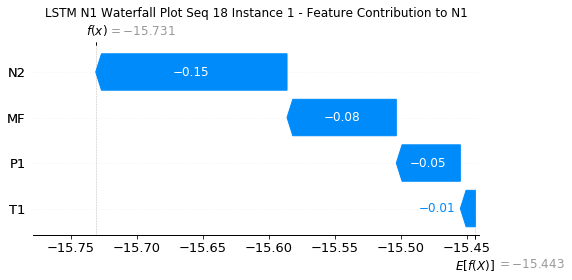

None

Contribution: [0.00066381 0.000285   0.0018899  0.00179881]


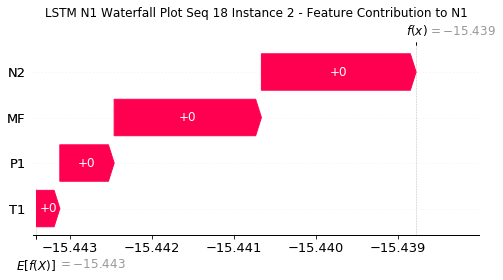

None

Contribution: [-7.48176414e-05 -7.53815226e-05 -3.09632207e-04 -2.62412831e-04]


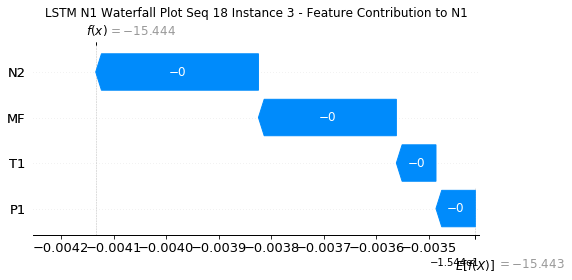

None

Contribution: [-1.56547734e-04 -6.69832354e-05 -5.82246510e-04 -4.89792737e-04]


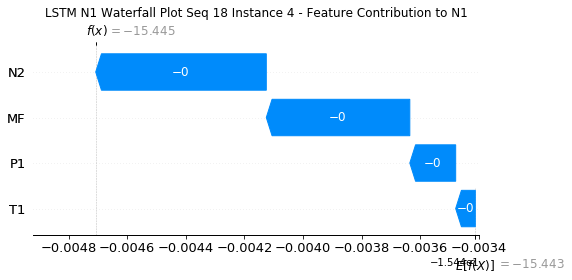

None

Contribution: [-0.00014539 -0.00010127 -0.00049976 -0.00041641]


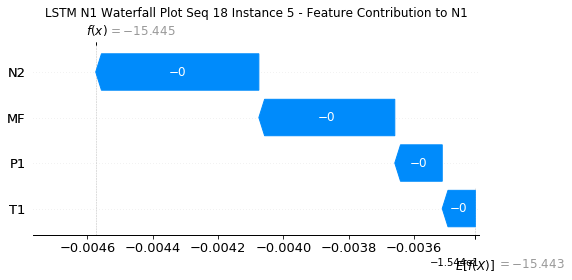

None

Contribution: [-1.40128719e-04 -8.73533890e-05 -4.54682498e-04 -3.72464820e-04]


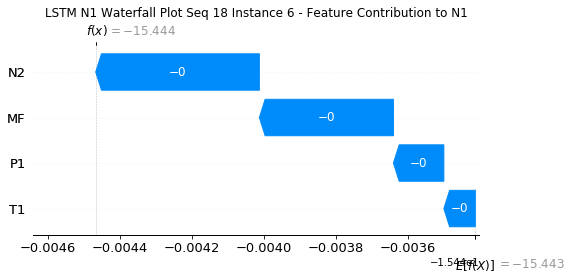

None

Contribution: [-1.43159187e-04 -9.03536930e-05 -4.86474216e-04 -3.88371307e-04]


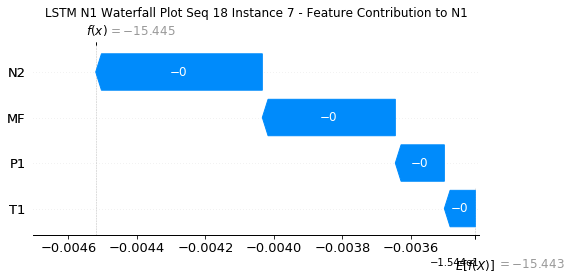

None

Contribution: [-1.49862052e-04 -9.48749510e-05 -5.12102458e-04 -4.06507402e-04]


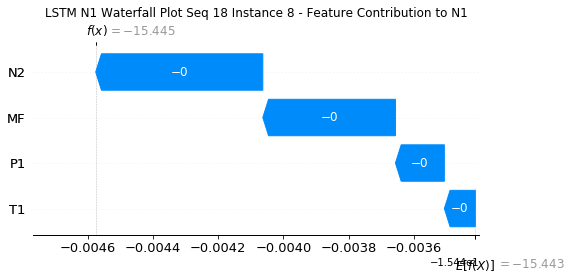

None

Contribution: [-1.45718287e-04 -9.44171889e-05 -5.02045461e-04 -4.01958230e-04]


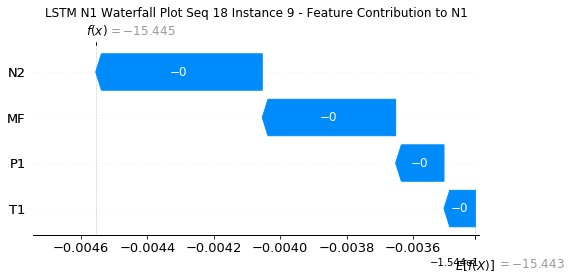

None

Contribution: [-1.47675205e-04 -9.37974678e-05 -4.89068231e-04 -4.06806787e-04]


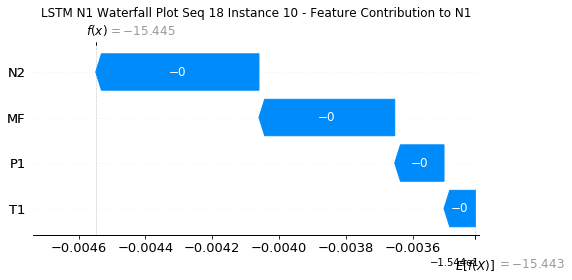

None

Contribution: [-1.42259126e-04 -9.08308985e-05 -4.71379720e-04 -3.88893318e-04]


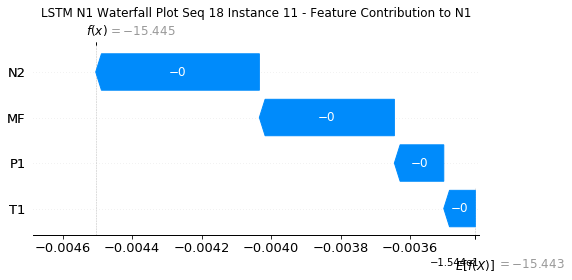

None

Contribution: [-1.36838145e-04 -8.83400670e-05 -4.53928878e-04 -3.71565420e-04]


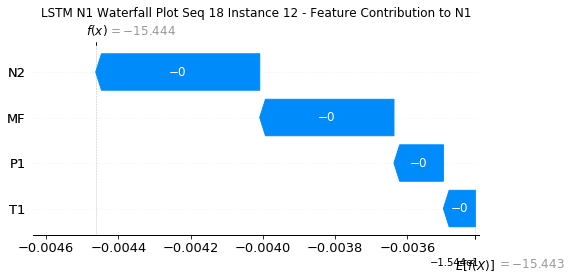

None

Contribution: [-1.33178000e-04 -8.49938305e-05 -4.41303185e-04 -3.61474642e-04]


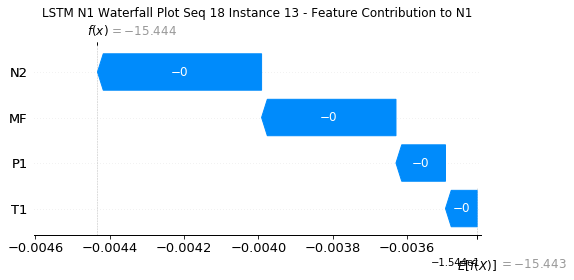

None

Contribution: [-1.29615529e-04 -8.44529155e-05 -4.27875625e-04 -3.48587186e-04]


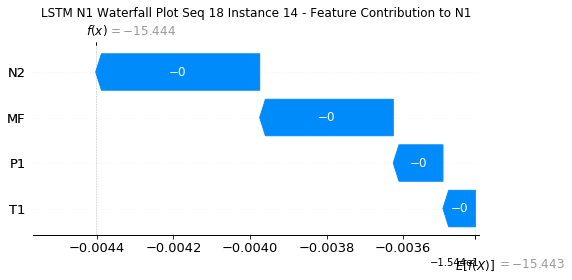

None

Contribution: [-1.25192766e-04 -7.97961096e-05 -4.15670642e-04 -3.37308746e-04]


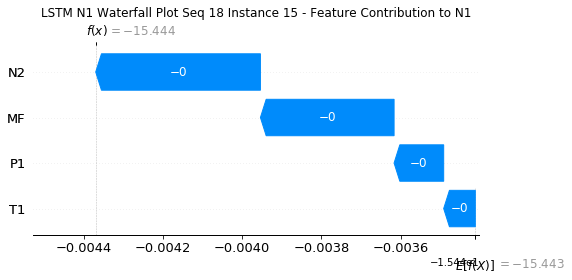

None

Contribution: [-1.22029657e-04 -7.74959744e-05 -4.05068990e-04 -3.26842355e-04]


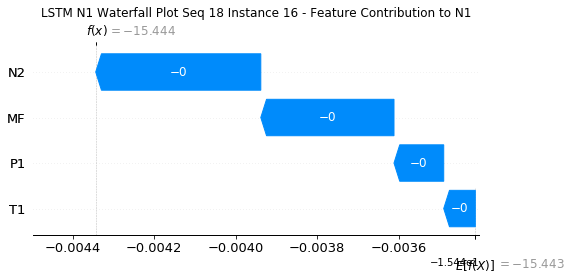

None

Contribution: [-1.19095191e-04 -7.32807532e-05 -3.96340203e-04 -3.17591963e-04]


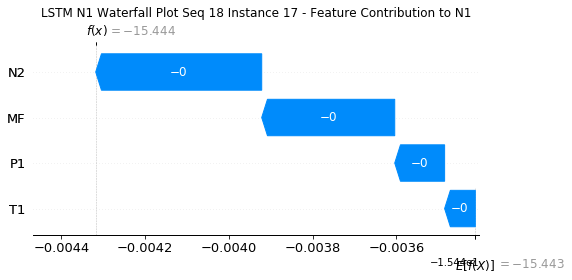

None

Contribution: [-1.18679101e-04 -7.37701993e-05 -3.90779788e-04 -3.12449447e-04]


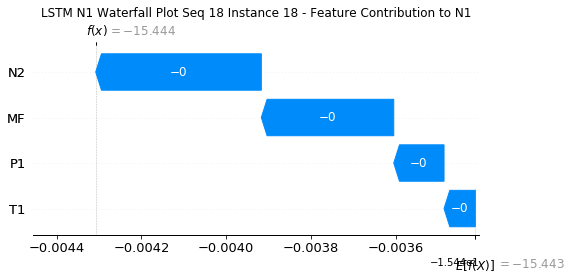

None

Contribution: [-1.18784189e-04 -7.04408626e-05 -3.83797751e-04 -3.03180862e-04]


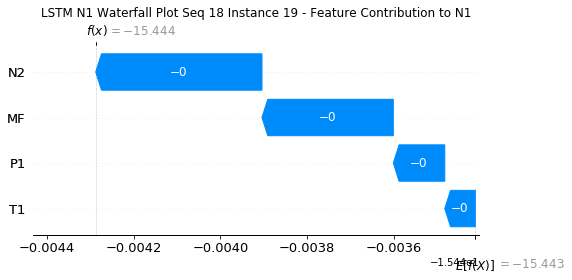

None

Contribution: [-1.20787333e-04 -6.55831424e-05 -3.71420703e-04 -2.83693195e-04]


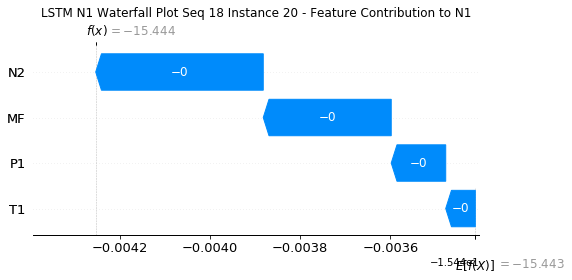

None

Contribution: [-1.12319558e-04 -7.07166978e-05 -3.39326028e-04 -2.12939365e-04]


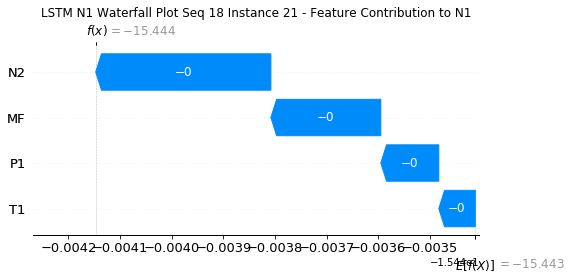

None

Contribution: [-9.70620733e-05 -1.18815847e-04 -3.63880627e-04 -3.00982624e-04]


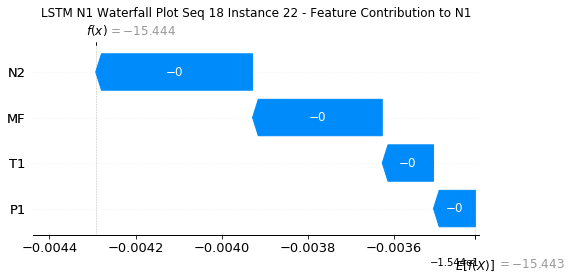

None

Contribution: [ 0.00040198  0.00089233 -0.00249348 -0.00391274]


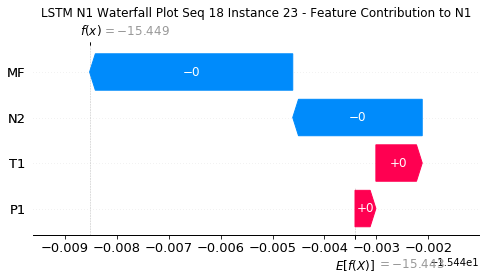

None

Contribution: [ 0.00052139  0.0145923  -0.01607644 -0.02557233]


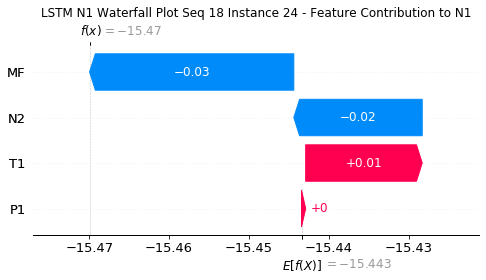

None

Contribution: [-0.04910464 -0.01122685 -0.14613608 -0.08790163]


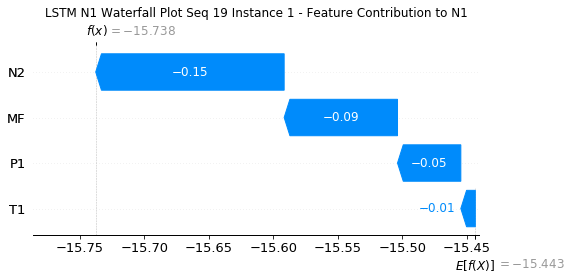

None

Contribution: [0.00066532 0.00028348 0.00187746 0.00180962]


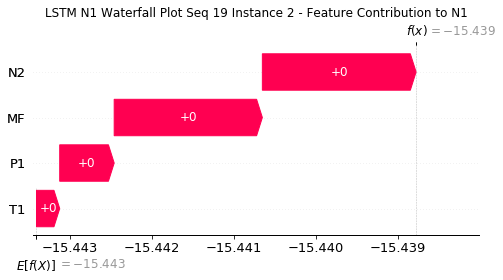

None

Contribution: [-7.49688797e-05 -7.70190050e-05 -3.08267484e-04 -2.61688152e-04]


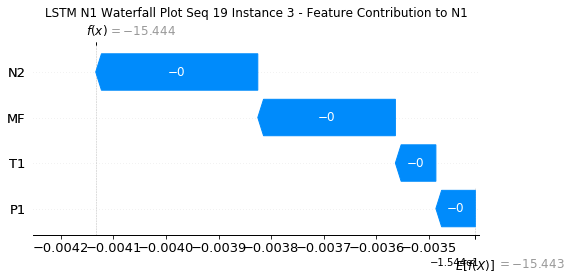

None

Contribution: [-1.60677601e-04 -8.40778603e-05 -5.81393574e-04 -4.96262429e-04]


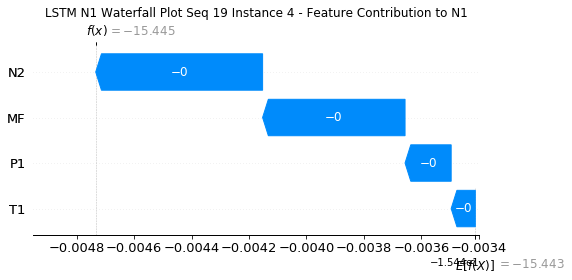

None

Contribution: [-0.00014876 -0.00010292 -0.00049805 -0.00041752]


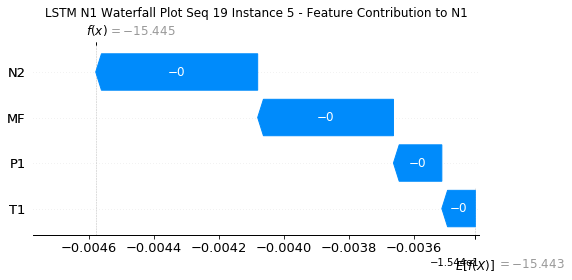

None

Contribution: [-1.41491527e-04 -9.29138981e-05 -4.54194157e-04 -3.75316803e-04]


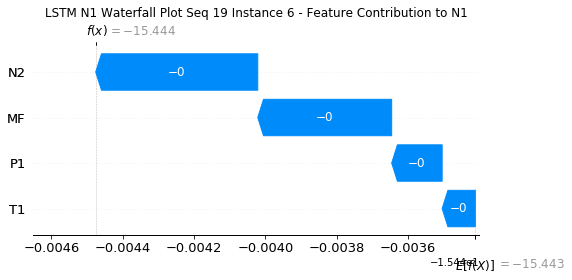

None

Contribution: [-1.48683409e-04 -9.84565484e-05 -4.90161632e-04 -3.99051336e-04]


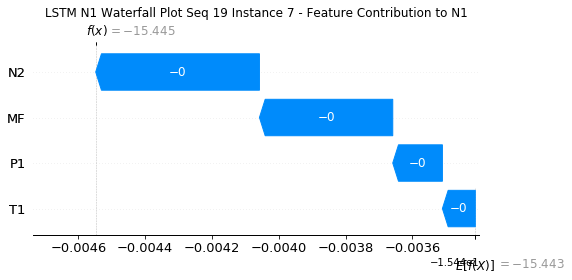

None

Contribution: [-0.00015427 -0.00010149 -0.00051455 -0.00041687]


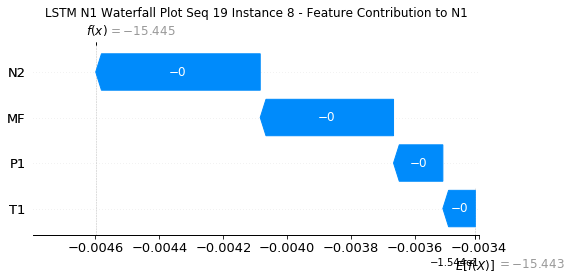

None

Contribution: [-0.00014936 -0.00010351 -0.00050306 -0.00040809]


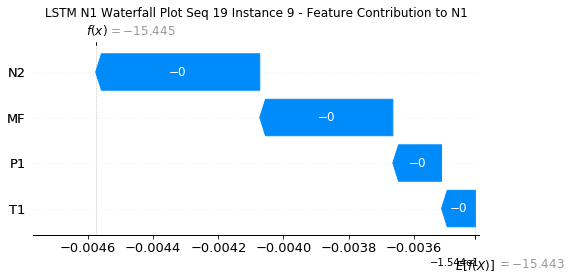

None

Contribution: [-1.49051949e-04 -9.89265864e-05 -4.87481486e-04 -4.07861652e-04]


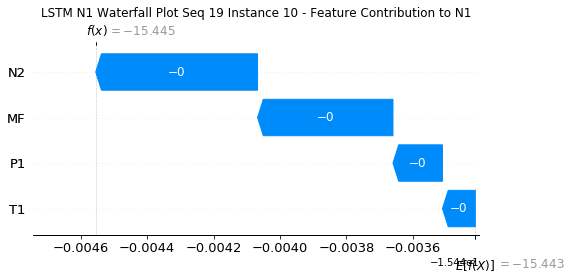

None

Contribution: [-1.43617480e-04 -9.51499496e-05 -4.69915039e-04 -3.89991781e-04]


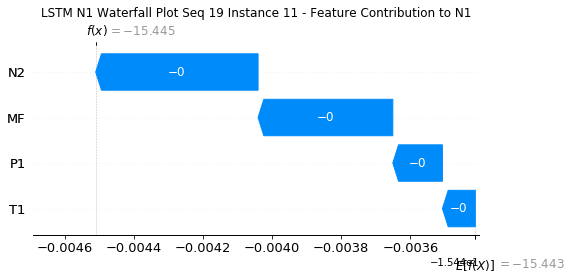

None

Contribution: [-1.40155941e-04 -9.24431280e-05 -4.55271772e-04 -3.78487220e-04]


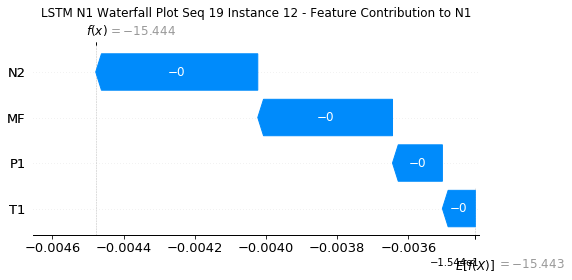

None

Contribution: [-1.34114401e-04 -8.85299006e-05 -4.39540190e-04 -3.61099645e-04]


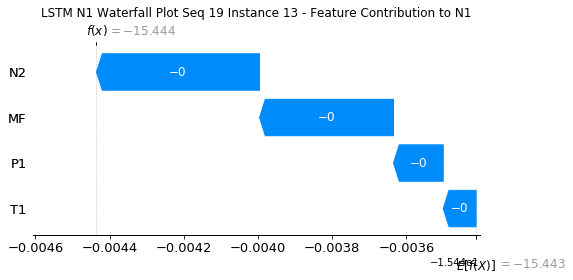

None

Contribution: [-1.30795196e-04 -8.45066862e-05 -4.26909961e-04 -3.51937697e-04]


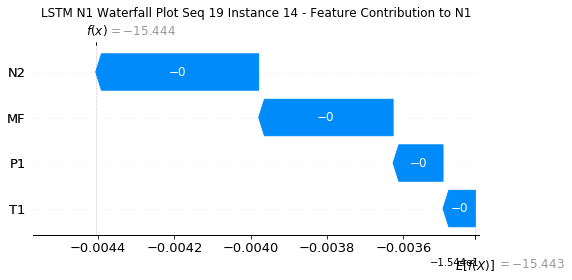

None

Contribution: [-1.25720013e-04 -8.18820066e-05 -4.13925701e-04 -3.36481544e-04]


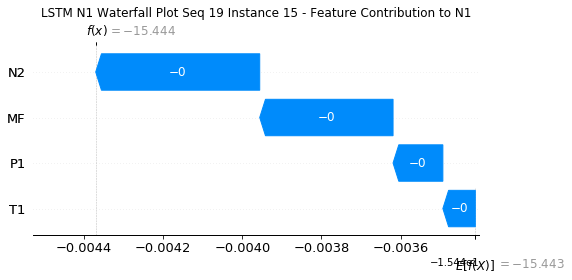

None

Contribution: [-1.22201203e-04 -7.92620368e-05 -4.03443883e-04 -3.26387541e-04]


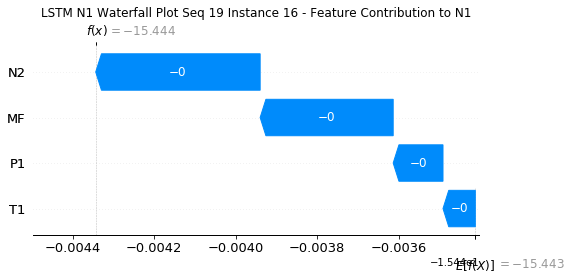

None

Contribution: [-1.20625723e-04 -7.72429925e-05 -3.96948230e-04 -3.22119534e-04]


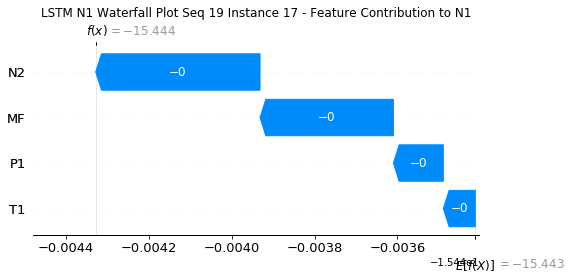

None

Contribution: [-1.18439115e-04 -7.45532370e-05 -3.88986495e-04 -3.10617280e-04]


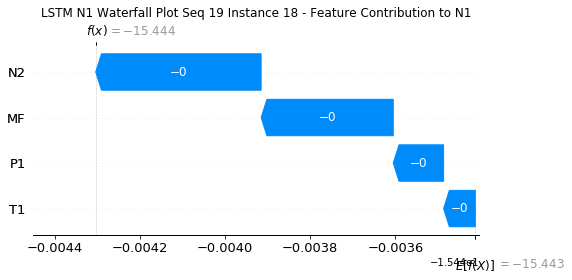

None

Contribution: [-1.18536628e-04 -7.12082202e-05 -3.82268813e-04 -3.01699987e-04]


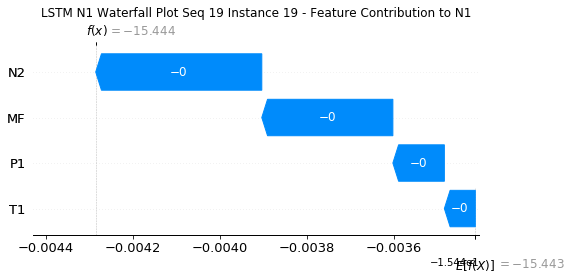

None

Contribution: [-1.20552267e-04 -6.59911579e-05 -3.70031542e-04 -2.82289116e-04]


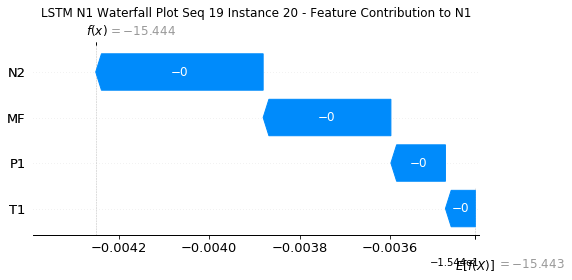

None

Contribution: [-1.12224785e-04 -6.80562579e-05 -3.39098756e-04 -2.14840657e-04]


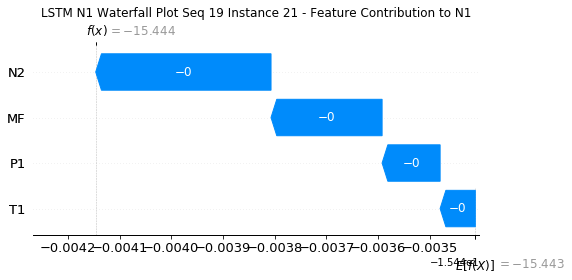

None

Contribution: [-9.75362616e-05 -1.20384450e-04 -3.62300308e-04 -2.95432988e-04]


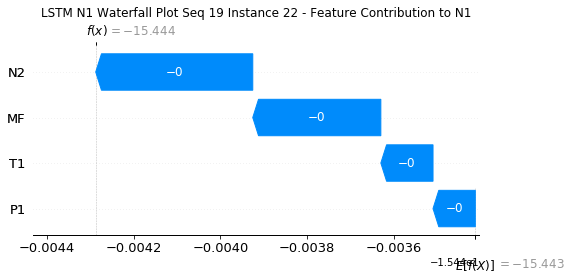

None

Contribution: [ 0.0004544   0.0005445  -0.00250519 -0.00400171]


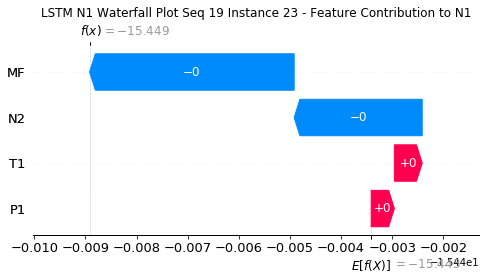

None

Contribution: [ 0.00093875  0.01298106 -0.01620453 -0.02799438]


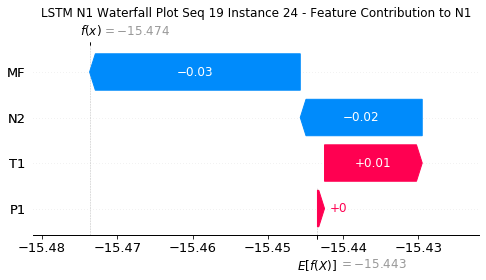

None

Contribution: [-0.05043538 -0.01213061 -0.1454971  -0.08515932]


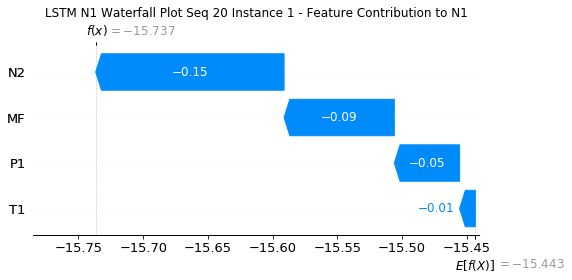

None

Contribution: [0.00065356 0.00028127 0.00187212 0.00177509]


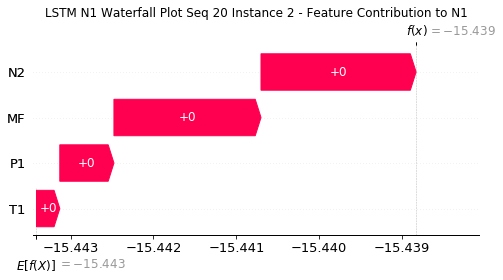

None

Contribution: [-7.47622675e-05 -7.61784409e-05 -3.08229917e-04 -2.61012643e-04]


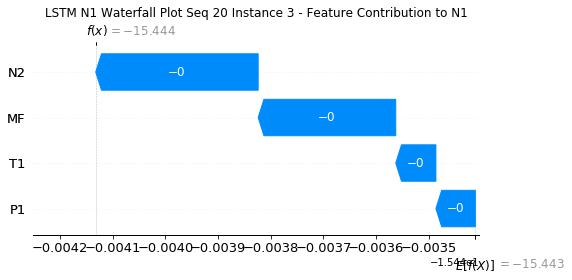

None

Contribution: [-1.60269397e-04 -7.60976446e-05 -5.81475311e-04 -4.92236250e-04]


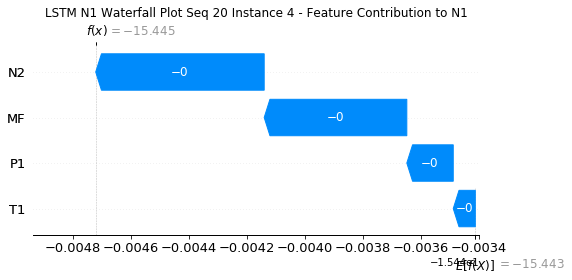

None

Contribution: [-0.00014779 -0.00010246 -0.00049836 -0.00041587]


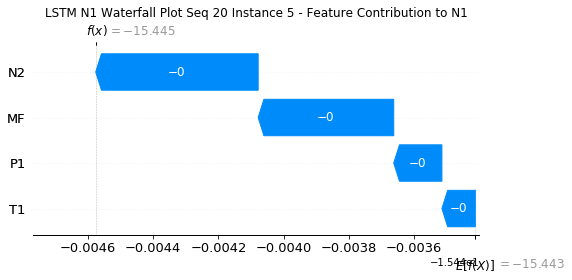

None

Contribution: [-1.41306683e-04 -9.01477653e-05 -4.54132038e-04 -3.73901383e-04]


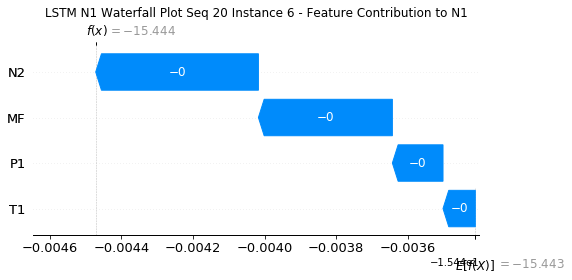

None

Contribution: [-1.47167112e-04 -9.39276368e-05 -4.89065222e-04 -3.96663853e-04]


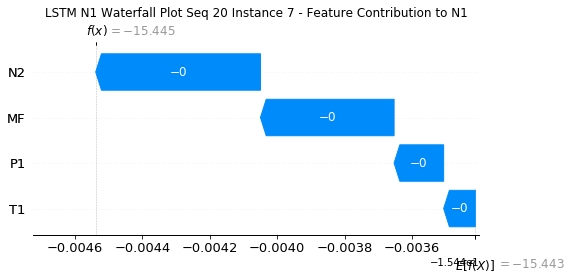

None

Contribution: [-1.51776821e-04 -9.91227199e-05 -5.11958368e-04 -4.06958937e-04]


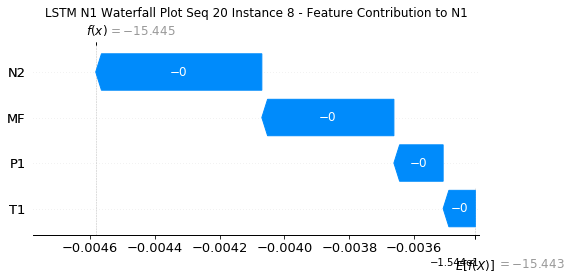

None

Contribution: [-1.49645010e-04 -9.87521913e-05 -5.03930574e-04 -4.08673633e-04]


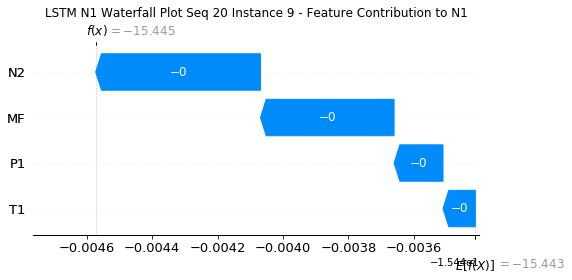

None

Contribution: [-1.48758094e-04 -9.60389907e-05 -4.87311685e-04 -4.06068739e-04]


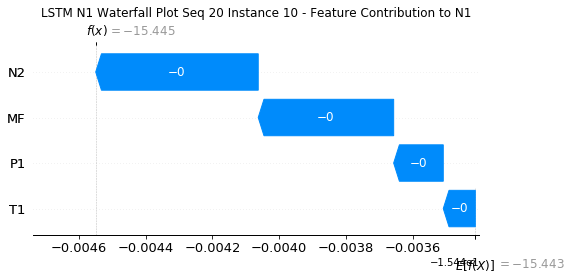

None

Contribution: [-1.43222287e-04 -9.26479494e-05 -4.69618588e-04 -3.88334341e-04]


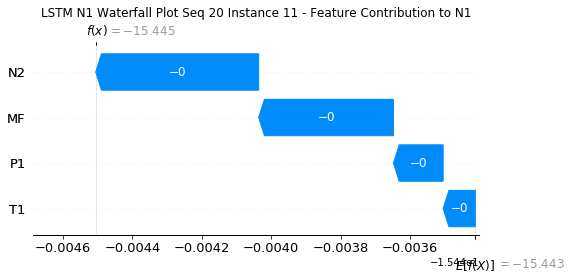

None

Contribution: [-1.39383571e-04 -9.35082899e-05 -4.53080727e-04 -3.73108196e-04]


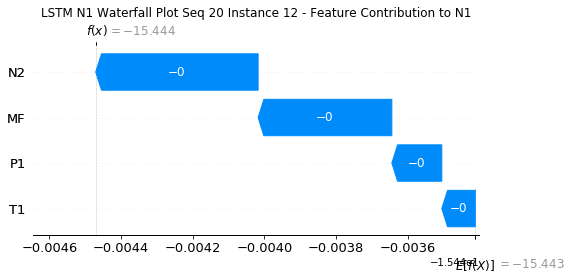

None

Contribution: [-1.33878966e-04 -8.63378282e-05 -4.39283488e-04 -3.59904647e-04]


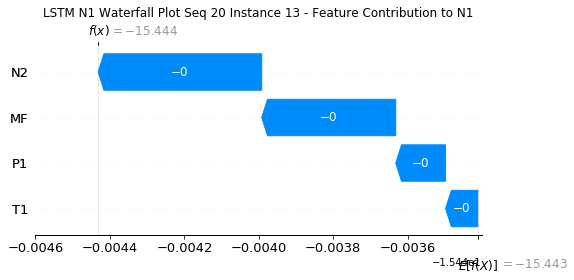

None

Contribution: [-1.29135929e-04 -8.34670016e-05 -4.25352142e-04 -3.46683579e-04]


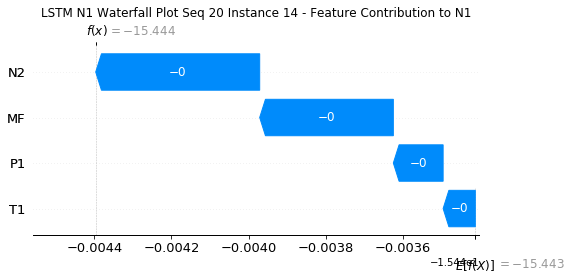

None

Contribution: [-1.26077101e-04 -8.04907649e-05 -4.13915107e-04 -3.37072896e-04]


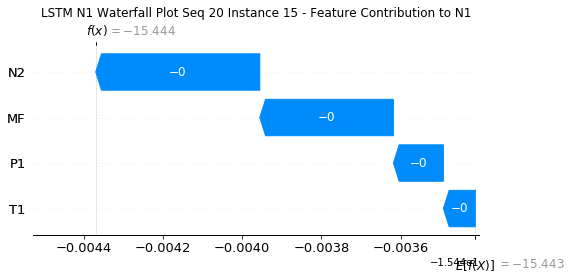

None

Contribution: [-1.23038251e-04 -7.82621363e-05 -4.03689272e-04 -3.27989504e-04]


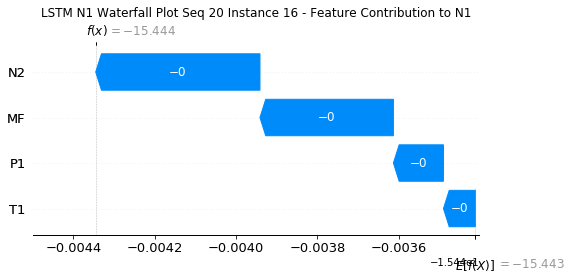

None

Contribution: [-1.21635044e-04 -7.52435407e-05 -3.95118615e-04 -3.19946287e-04]


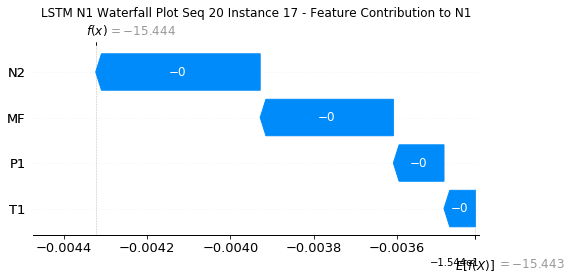

None

Contribution: [-1.18995515e-04 -7.38144791e-05 -3.88882050e-04 -3.12068420e-04]


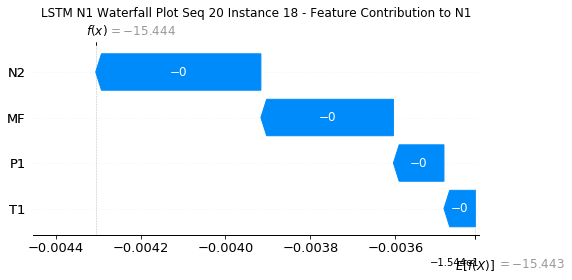

None

Contribution: [-1.19119467e-04 -7.05464570e-05 -3.82166947e-04 -3.03052740e-04]


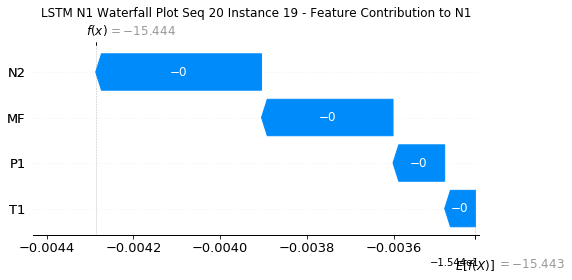

None

Contribution: [-1.20590151e-04 -6.55439802e-05 -3.69627404e-04 -2.82315311e-04]


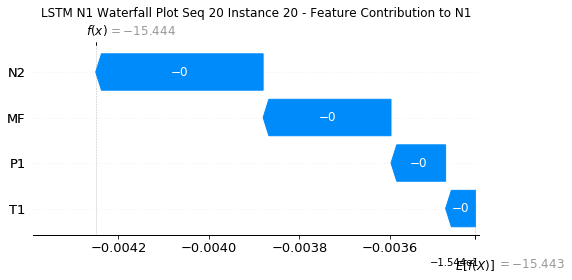

None

Contribution: [-1.12984604e-04 -6.98273239e-05 -3.39542203e-04 -2.13374215e-04]


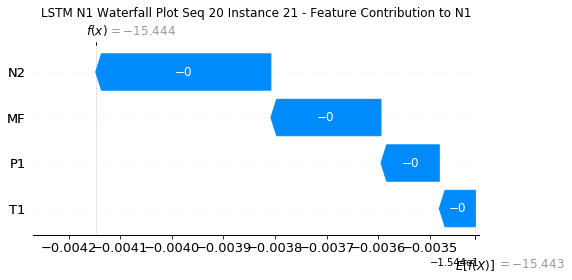

None

Contribution: [-9.69206599e-05 -1.19447386e-04 -3.62160504e-04 -2.96563257e-04]


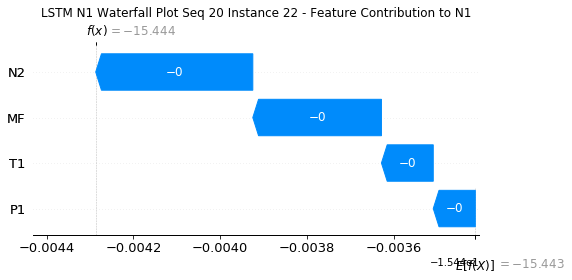

None

Contribution: [ 0.00042379  0.00037213 -0.00241825 -0.00338862]


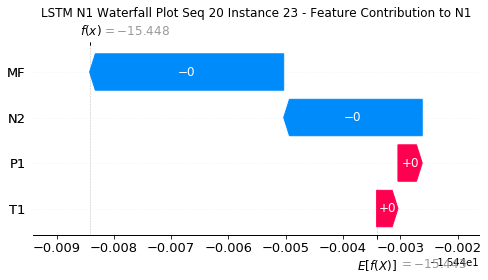

None

Contribution: [ 0.00088429  0.01102569 -0.01575119 -0.02544249]


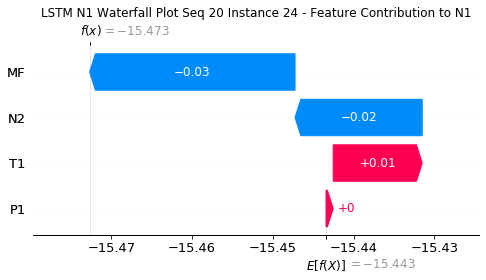

None

Contribution: [-0.04933643 -0.01307201 -0.14493237 -0.08127432]


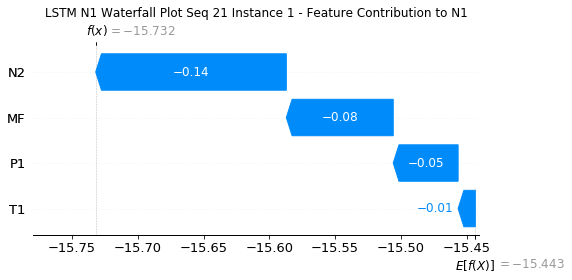

None

Contribution: [0.0006749  0.00028972 0.00189112 0.00181492]


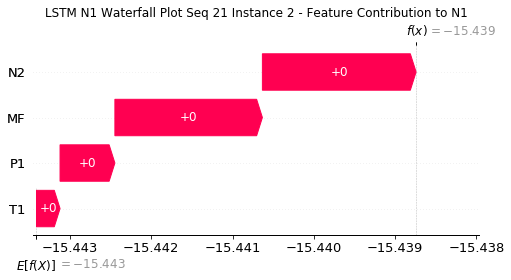

None

Contribution: [-7.48483890e-05 -7.64131986e-05 -3.09124645e-04 -2.61670667e-04]


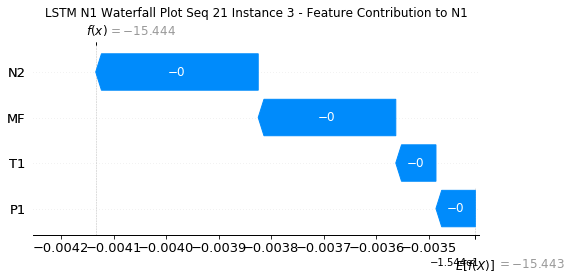

None

Contribution: [-1.58064206e-04 -7.83355645e-05 -5.81694021e-04 -4.89522499e-04]


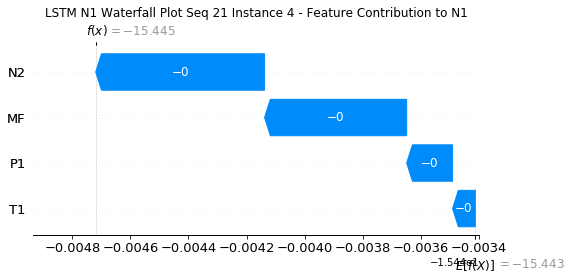

None

Contribution: [-1.49020791e-04 -9.69448412e-05 -4.97687153e-04 -4.17599091e-04]


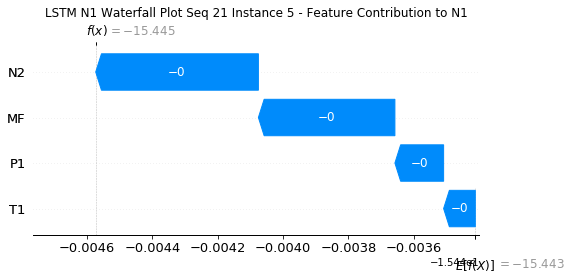

None

Contribution: [-1.41075777e-04 -9.13550874e-05 -4.53972760e-04 -3.73032515e-04]


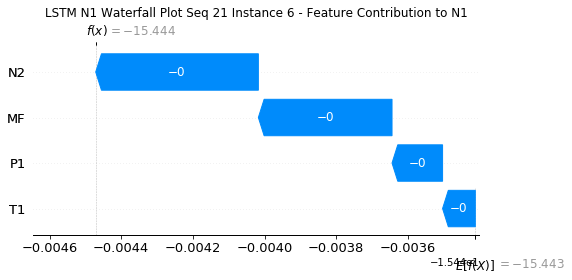

None

Contribution: [-1.48567980e-04 -9.82612900e-05 -4.88236366e-04 -3.95371783e-04]


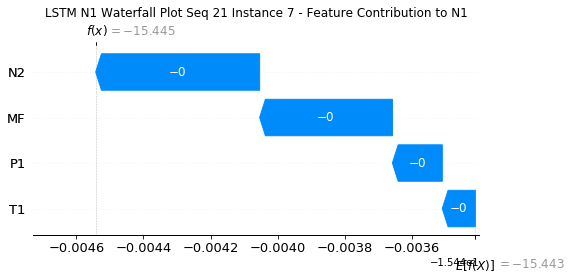

None

Contribution: [-0.00015247 -0.00010547 -0.00051228 -0.00040938]


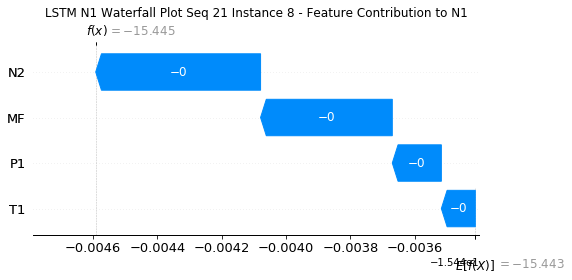

None

Contribution: [-0.00014941 -0.00010354 -0.00050314 -0.00040804]


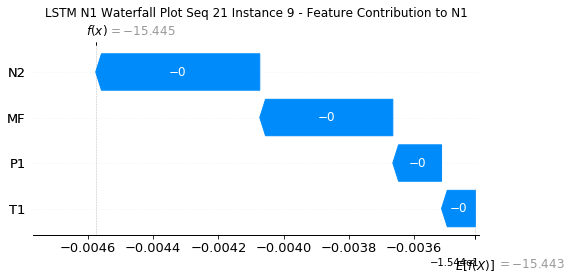

None

Contribution: [-1.47194539e-04 -9.65280111e-05 -4.87224167e-04 -4.05399856e-04]


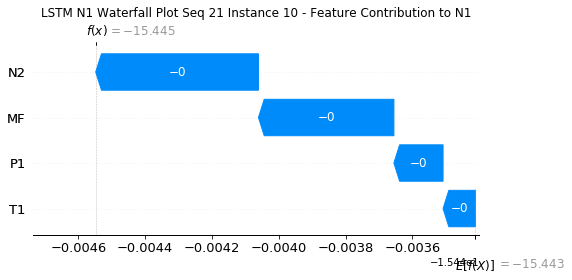

None

Contribution: [-1.42176386e-04 -9.33240406e-05 -4.69639722e-04 -3.87932654e-04]


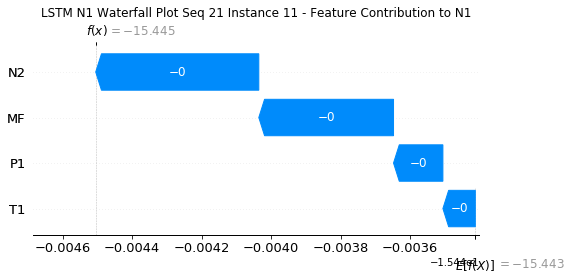

None

Contribution: [-1.40480534e-04 -9.13800690e-05 -4.56001845e-04 -3.79722086e-04]


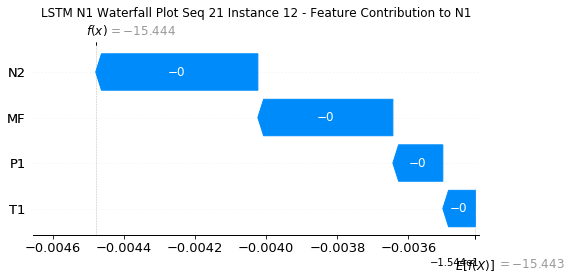

None

Contribution: [-1.33173494e-04 -8.71471505e-05 -4.39584329e-04 -3.60864742e-04]


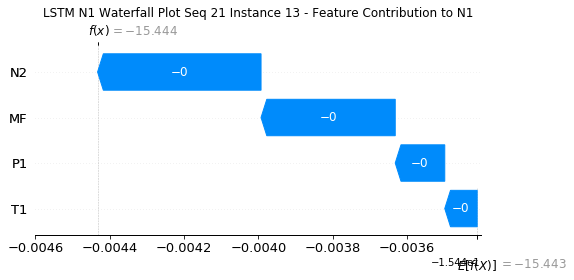

None

Contribution: [-1.31074844e-04 -8.49479143e-05 -4.26882915e-04 -3.50227108e-04]


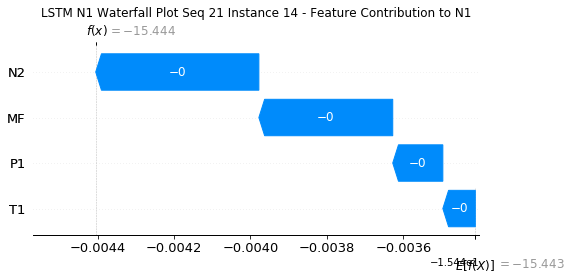

None

Contribution: [-1.27383858e-04 -7.90092358e-05 -4.15375469e-04 -3.41209888e-04]


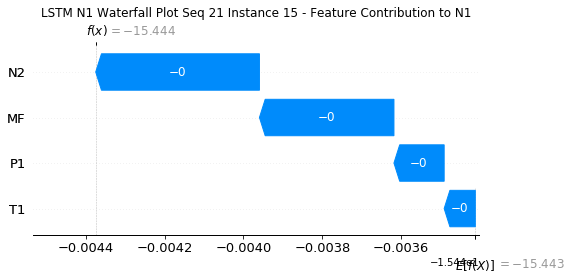

None

Contribution: [-1.23474184e-04 -7.68280629e-05 -4.04732900e-04 -3.29270145e-04]


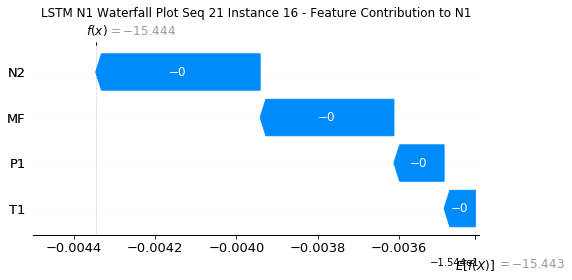

None

Contribution: [-1.21139117e-04 -7.40551919e-05 -3.96500540e-04 -3.20723569e-04]


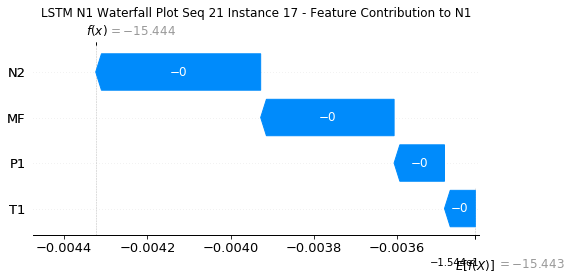

None

Contribution: [-1.20241641e-04 -7.31603058e-05 -3.90492633e-04 -3.14391539e-04]


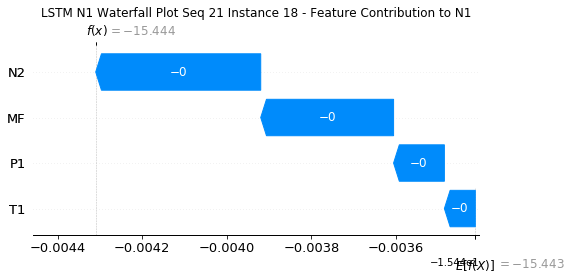

None

Contribution: [-1.19075887e-04 -6.83136641e-05 -3.82733480e-04 -3.03090024e-04]


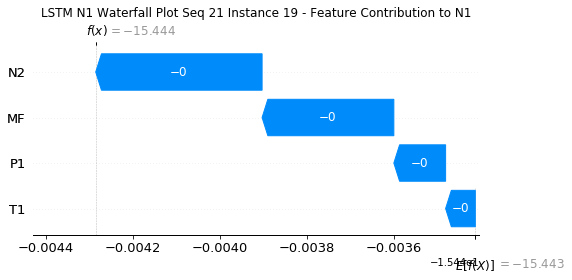

None

Contribution: [-1.20696385e-04 -6.43192347e-05 -3.70318060e-04 -2.82554537e-04]


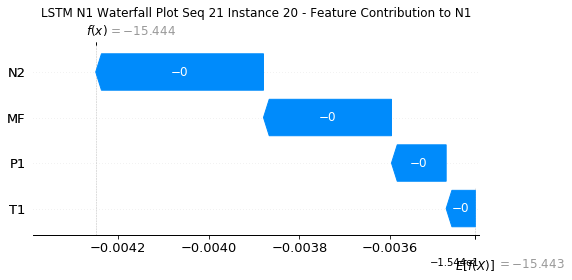

None

Contribution: [-1.11534335e-04 -7.49031268e-05 -3.38319551e-04 -2.10335700e-04]


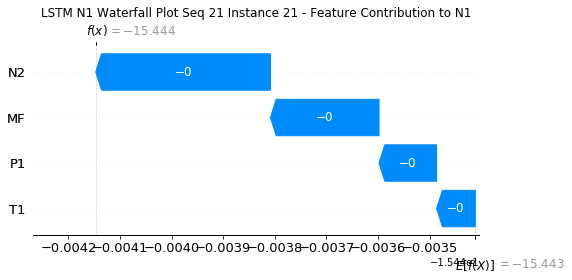

None

Contribution: [-9.71378214e-05 -1.14764739e-04 -3.63087791e-04 -3.00633833e-04]


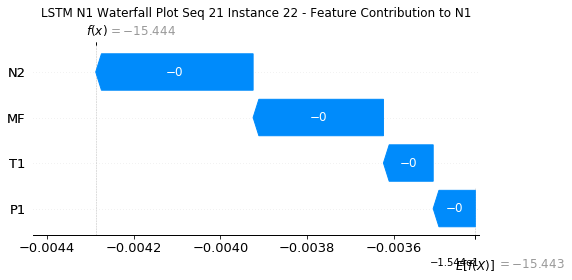

None

Contribution: [ 0.00046793  0.00147511 -0.00251588 -0.00390984]


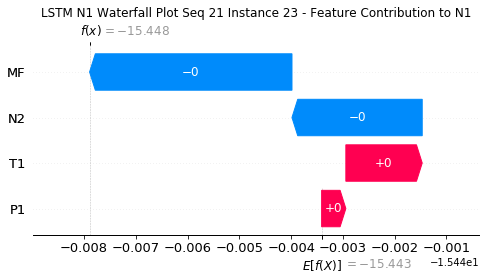

None

Contribution: [ 0.00142063  0.01854456 -0.01648686 -0.02907393]


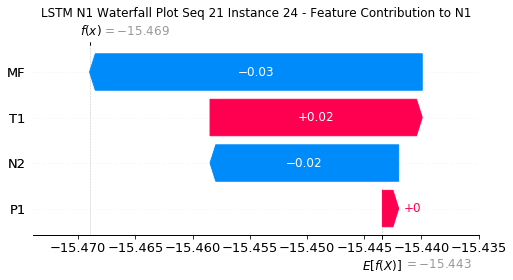

None

Contribution: [-0.04971788 -0.00819023 -0.14548012 -0.08727193]


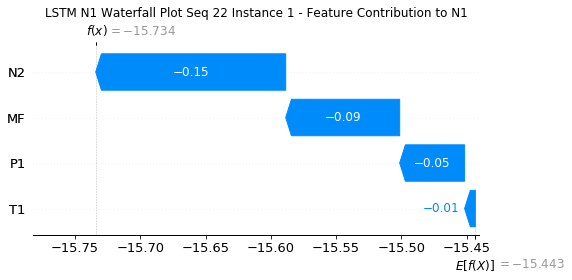

None

Contribution: [0.00066685 0.00027254 0.00187942 0.00181499]


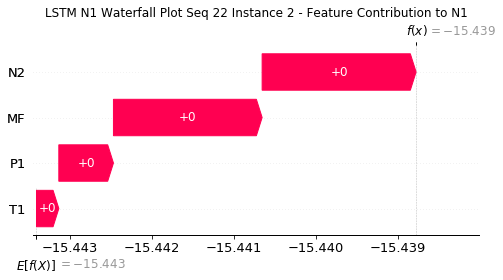

None

Contribution: [-7.51042951e-05 -7.37083636e-05 -3.08399806e-04 -2.62465485e-04]


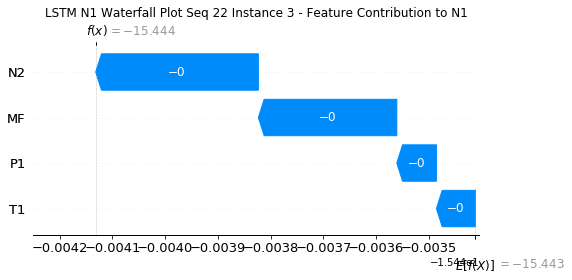

None

Contribution: [-1.59453869e-04 -6.76175780e-05 -5.75809714e-04 -4.94597929e-04]


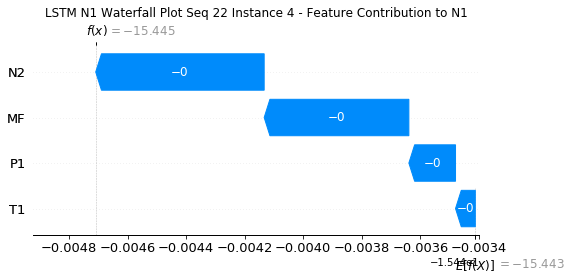

None

Contribution: [-1.46796186e-04 -9.83714240e-05 -4.96625148e-04 -4.18093366e-04]


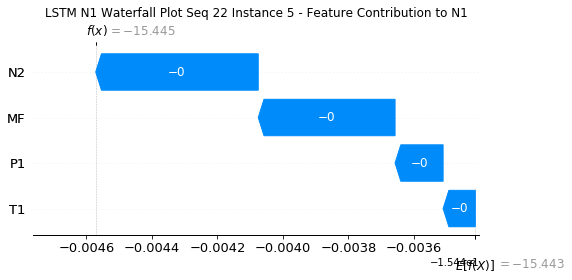

None

Contribution: [-1.42339393e-04 -9.00231727e-05 -4.52948048e-04 -3.72672187e-04]


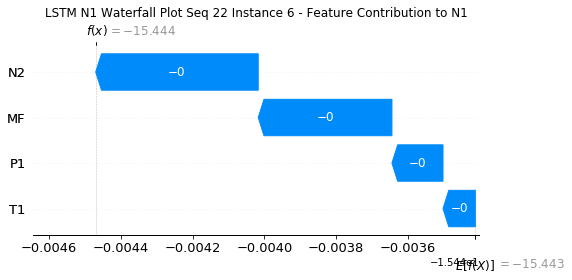

None

Contribution: [-1.47098407e-04 -9.45147311e-05 -4.87024077e-04 -3.96602476e-04]


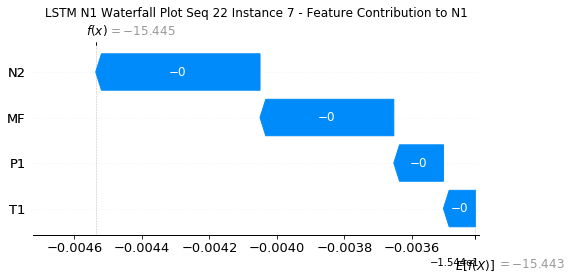

None

Contribution: [-0.00015274 -0.0001042  -0.00051266 -0.00041478]


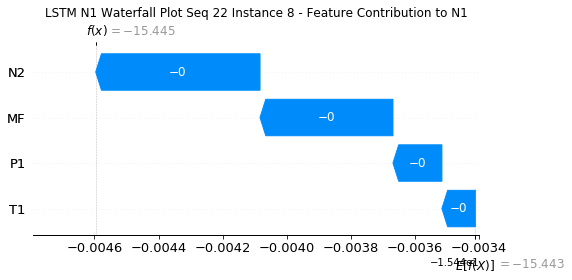

None

Contribution: [-0.00015068 -0.0001005  -0.00050251 -0.00041161]


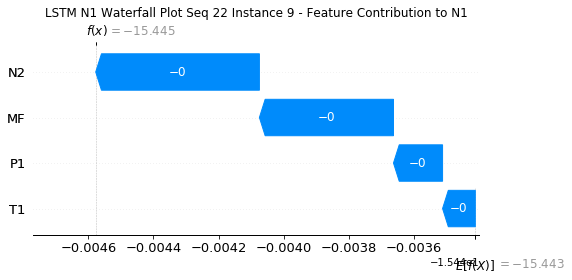

None

Contribution: [-1.48196727e-04 -9.80156116e-05 -4.87524329e-04 -4.12324359e-04]


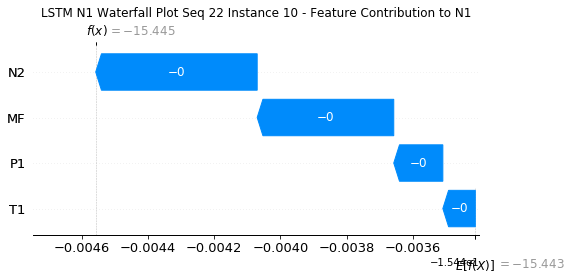

None

Contribution: [-1.42380070e-04 -9.28025694e-05 -4.68843830e-04 -3.91013913e-04]


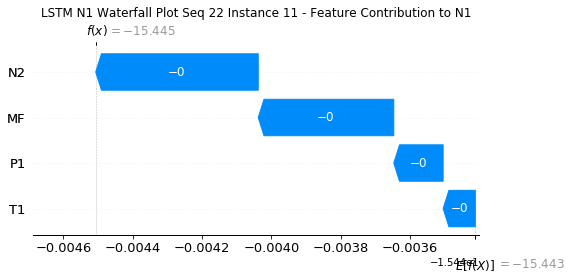

None

Contribution: [-1.38045519e-04 -9.03868437e-05 -4.53454493e-04 -3.76898844e-04]


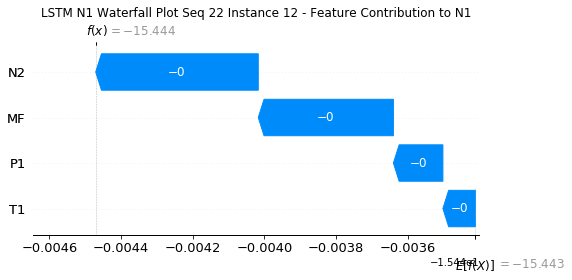

None

Contribution: [-1.35994081e-04 -8.73112804e-05 -4.41780865e-04 -3.72267236e-04]


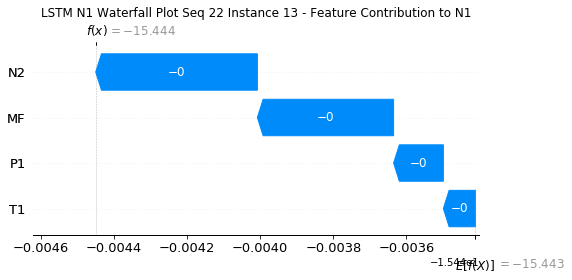

None

Contribution: [-1.29619086e-04 -8.43623559e-05 -4.26083714e-04 -3.51925863e-04]


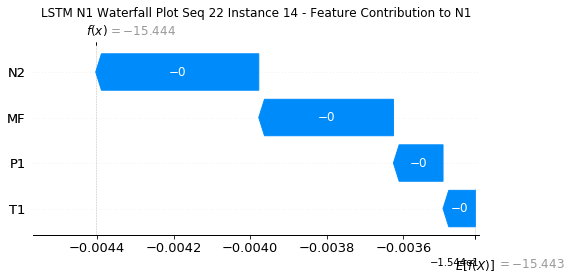

None

Contribution: [-1.25112088e-04 -8.14841323e-05 -4.13655062e-04 -3.37577918e-04]


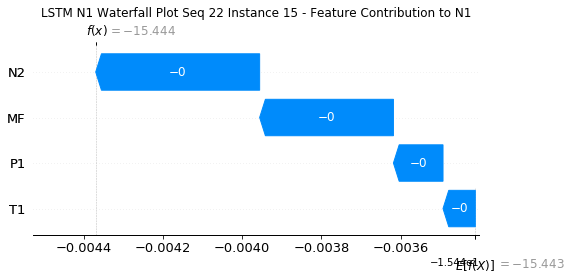

None

Contribution: [-1.22947386e-04 -8.01838269e-05 -4.04344675e-04 -3.30529398e-04]


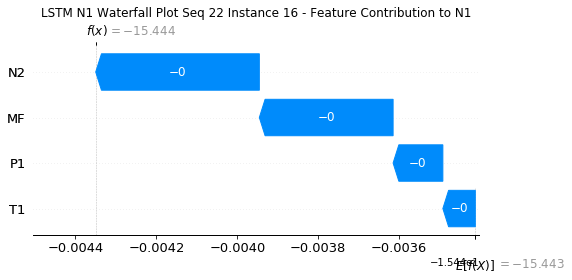

None

Contribution: [-1.20896884e-04 -7.77943412e-05 -3.96178438e-04 -3.22980957e-04]


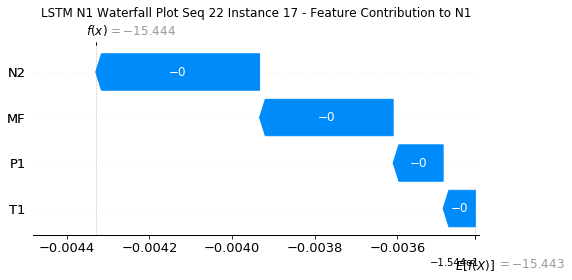

None

Contribution: [-1.21199296e-04 -7.62573197e-05 -3.89599401e-04 -3.14789686e-04]


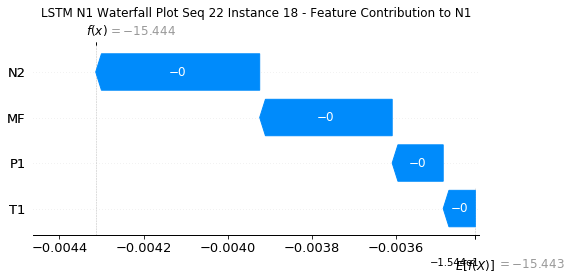

None

Contribution: [-1.19676200e-04 -7.23833406e-05 -3.82926075e-04 -3.05392033e-04]


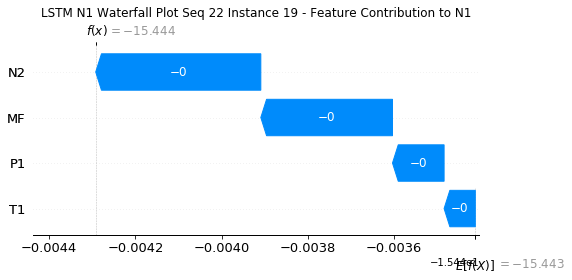

None

Contribution: [-1.21385708e-04 -6.63934256e-05 -3.70708835e-04 -2.84470449e-04]


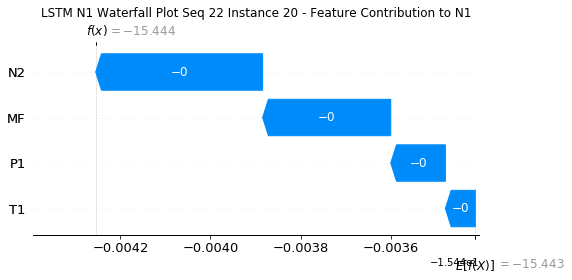

None

Contribution: [-1.12507857e-04 -6.77955409e-05 -3.38893564e-04 -2.09981982e-04]


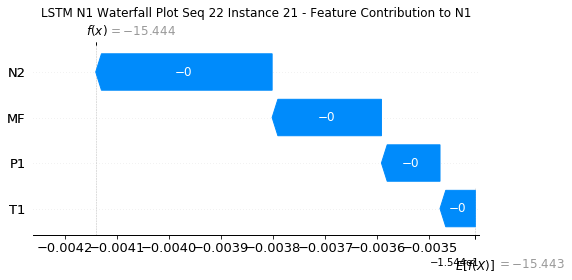

None

Contribution: [-9.70744181e-05 -1.20854375e-04 -3.62111718e-04 -3.02034327e-04]


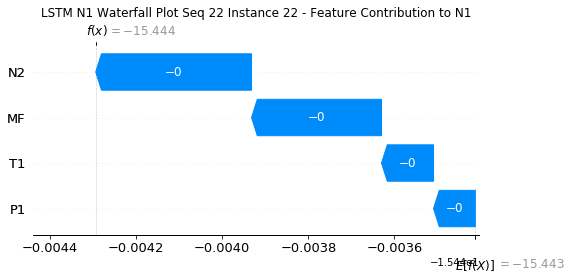

None

Contribution: [ 0.00041757  0.00085894 -0.00247579 -0.00405205]


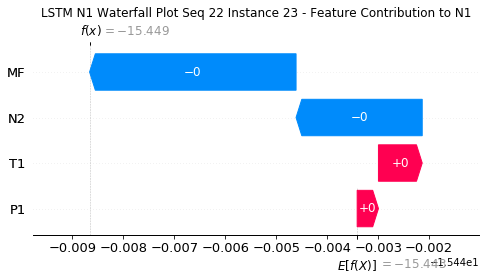

None

Contribution: [-0.00030199  0.01816257 -0.0154364  -0.02400463]


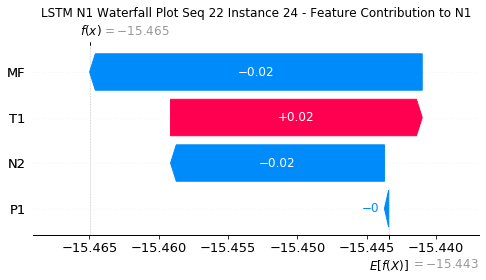

None

Contribution: [-0.05046225 -0.01105614 -0.14536795 -0.08833431]


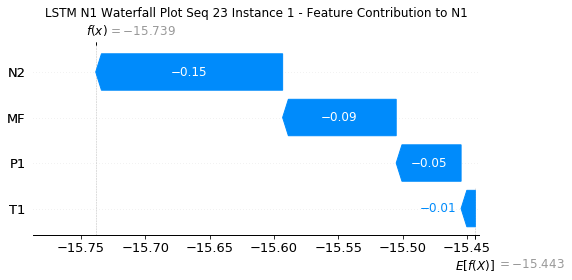

None

Contribution: [0.00066365 0.00027897 0.00187208 0.00179854]


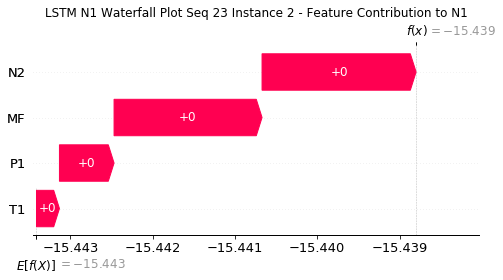

None

Contribution: [-7.51491751e-05 -7.58347758e-05 -3.07959510e-04 -2.61260873e-04]


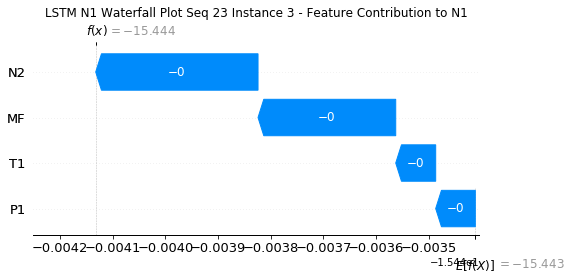

None

Contribution: [-1.61246453e-04 -7.62161080e-05 -5.81520948e-04 -4.89811839e-04]


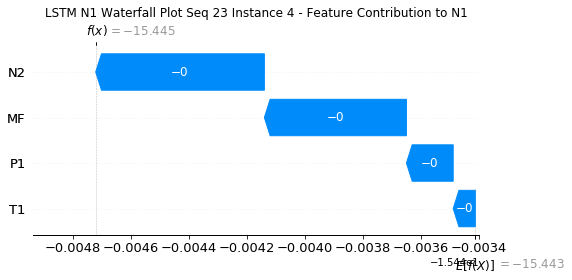

None

Contribution: [-0.00014716 -0.00010131 -0.00049802 -0.00041575]


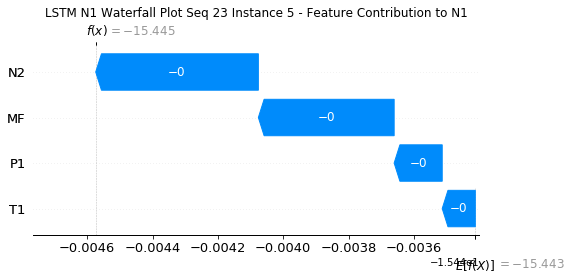

None

Contribution: [-1.43685620e-04 -9.11758209e-05 -4.54553534e-04 -3.75004005e-04]


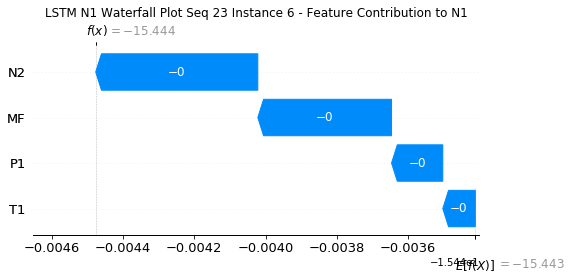

None

Contribution: [-1.47845427e-04 -9.64704868e-05 -4.88941109e-04 -3.95325978e-04]


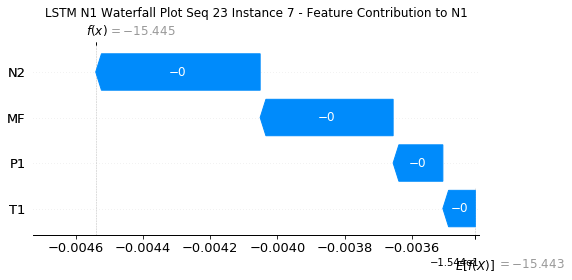

None

Contribution: [-0.00015374 -0.00010009 -0.00051265 -0.00041069]


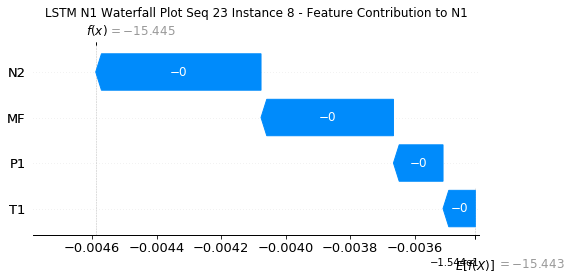

None

Contribution: [-0.00015035 -0.00010176 -0.00050261 -0.00040482]


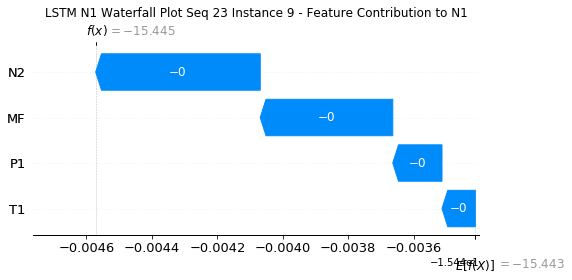

None

Contribution: [-1.49898099e-04 -9.79703456e-05 -4.88960054e-04 -4.11605647e-04]


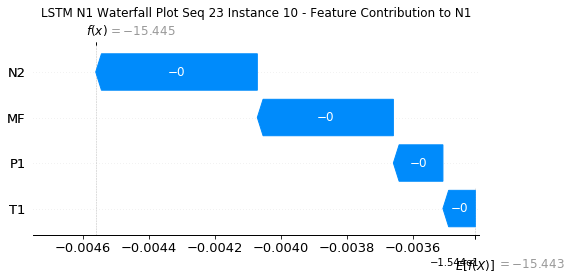

None

Contribution: [-1.43481834e-04 -9.42978483e-05 -4.70059680e-04 -3.89777527e-04]


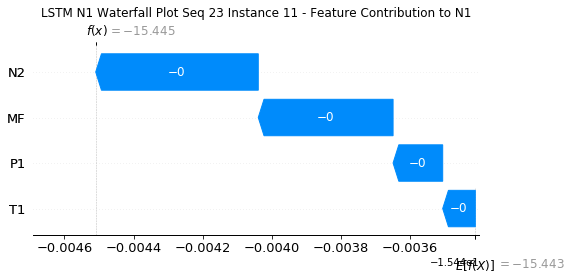

None

Contribution: [-1.38877868e-04 -9.10007886e-05 -4.54353270e-04 -3.74806087e-04]


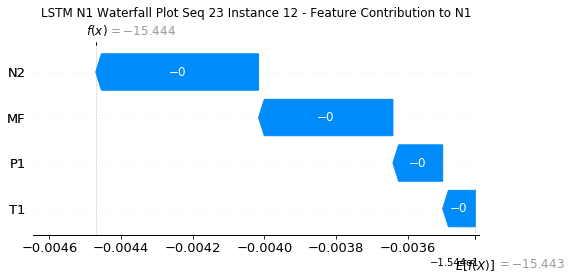

None

Contribution: [-1.35058644e-04 -8.79377207e-05 -4.39948367e-04 -3.61668695e-04]


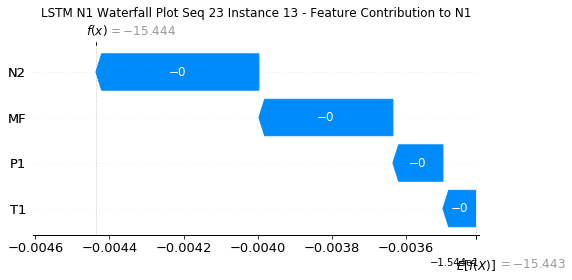

None

Contribution: [-1.30643863e-04 -8.48749309e-05 -4.26821405e-04 -3.50137284e-04]


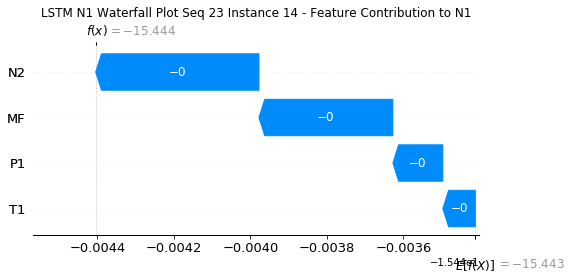

None

Contribution: [-1.26378579e-04 -8.05067700e-05 -4.12902014e-04 -3.32670080e-04]


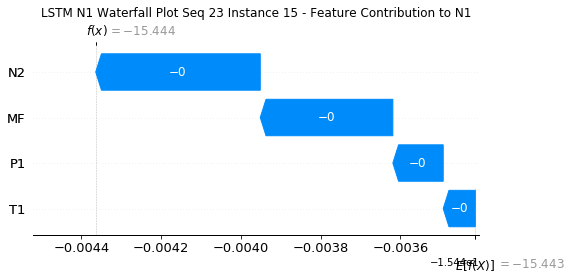

None

Contribution: [-1.23446511e-04 -7.94546733e-05 -4.04422740e-04 -3.27863999e-04]


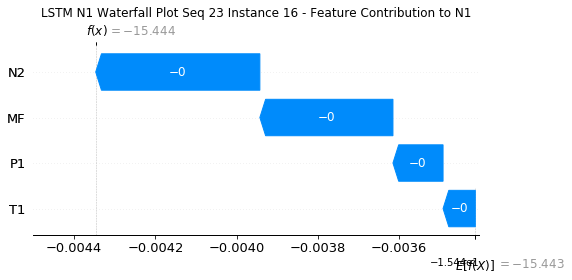

None

Contribution: [-1.21200724e-04 -7.71931757e-05 -3.96193407e-04 -3.20044605e-04]


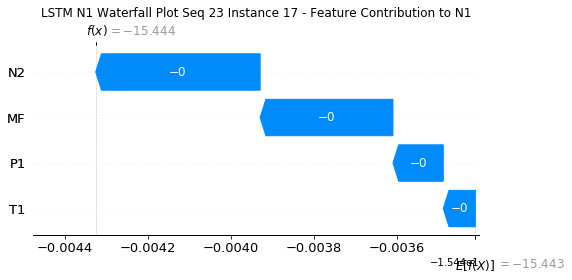

None

Contribution: [-1.18926346e-04 -7.43144763e-05 -3.88840176e-04 -3.09872667e-04]


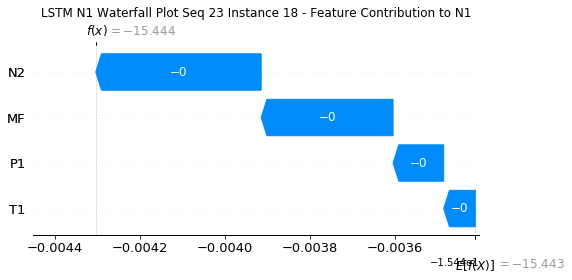

None

Contribution: [-1.19994481e-04 -7.10813535e-05 -3.82676015e-04 -3.02323564e-04]


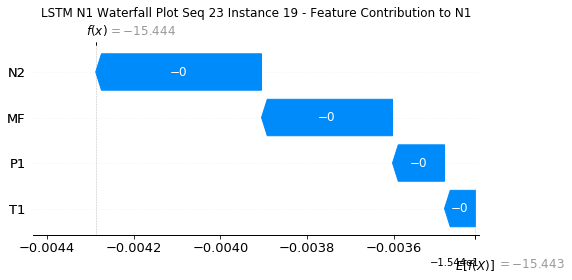

None

Contribution: [-1.21974585e-04 -6.58323545e-05 -3.70430826e-04 -2.82771860e-04]


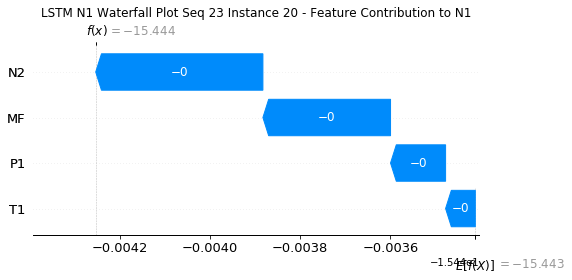

None

Contribution: [-1.14127747e-04 -6.85424977e-05 -3.38691580e-04 -2.13396280e-04]


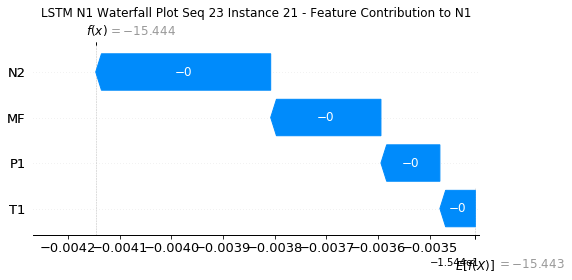

None

Contribution: [-9.56772439e-05 -1.20591838e-04 -3.62507126e-04 -2.98482468e-04]


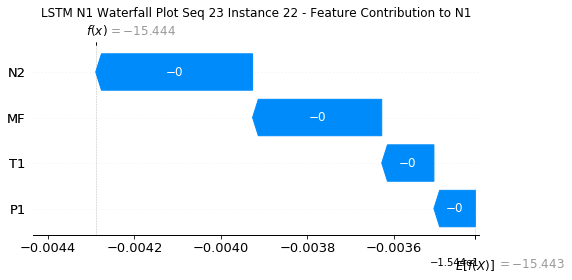

None

Contribution: [ 0.00054264  0.00075128 -0.00251299 -0.00392259]


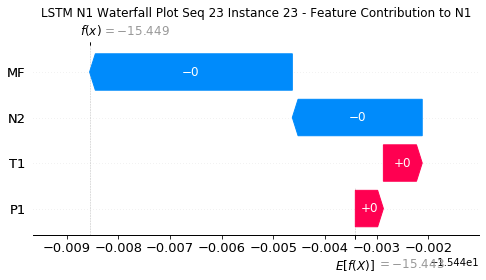

None

Contribution: [ 0.00171773  0.01549935 -0.01633754 -0.02788167]


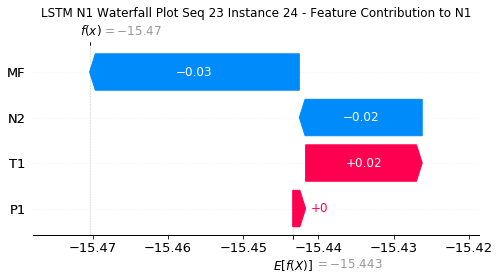

None

Contribution: [-0.05156534 -0.01054628 -0.14565929 -0.08413053]


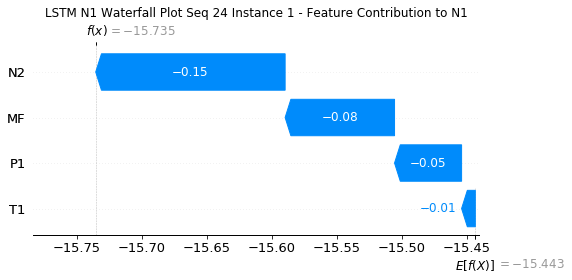

None

Contribution: [0.00067313 0.000279   0.00187915 0.00179194]


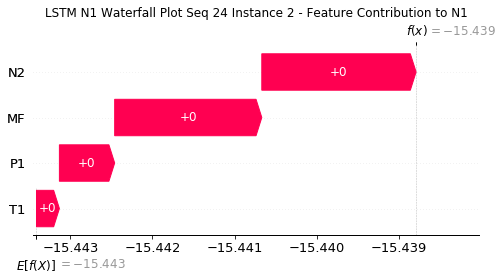

None

Contribution: [-7.49909091e-05 -7.53267025e-05 -3.08398111e-04 -2.60902198e-04]


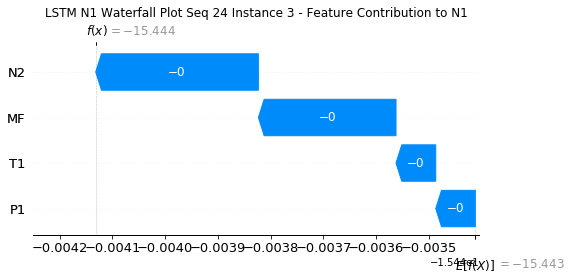

None

Contribution: [-1.62867595e-04 -6.56275293e-05 -5.83146937e-04 -4.92140790e-04]


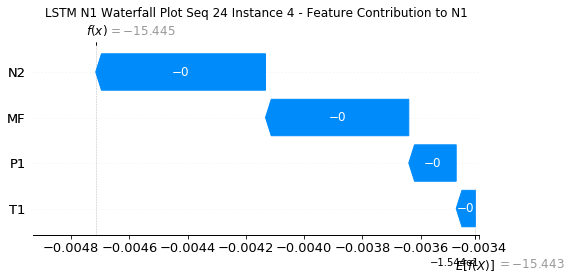

None

Contribution: [-1.47684951e-04 -9.81474917e-05 -4.98610656e-04 -4.16178980e-04]


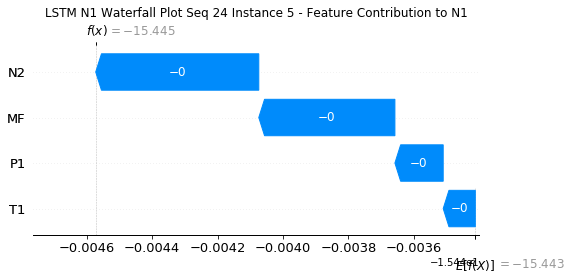

None

Contribution: [-1.42886774e-04 -8.73562861e-05 -4.54711030e-04 -3.76153597e-04]


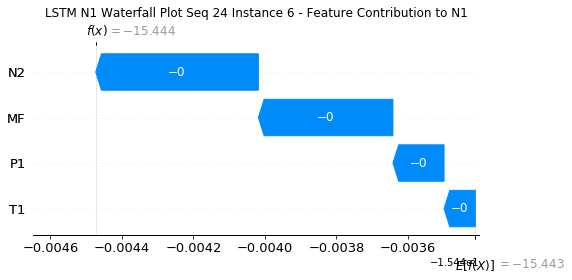

None

Contribution: [-1.47926808e-04 -9.38899610e-05 -4.88778133e-04 -3.94613624e-04]


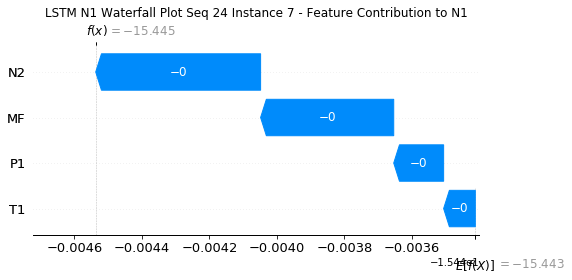

None

Contribution: [-1.52585352e-04 -9.61100895e-05 -5.12042935e-04 -4.08852309e-04]


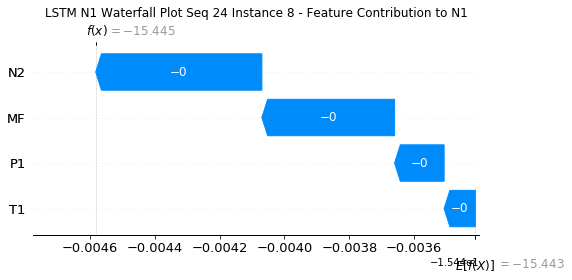

None

Contribution: [-1.49167852e-04 -9.60477046e-05 -5.02300889e-04 -4.05670422e-04]


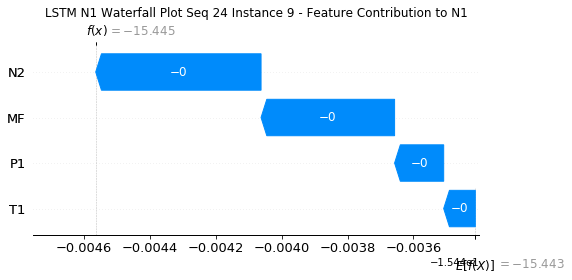

None

Contribution: [-1.49808269e-04 -9.34713789e-05 -4.87676714e-04 -4.06641132e-04]


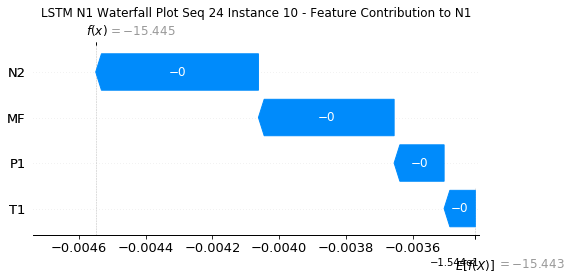

None

Contribution: [-1.44198587e-04 -9.40941159e-05 -4.70581364e-04 -3.90507150e-04]


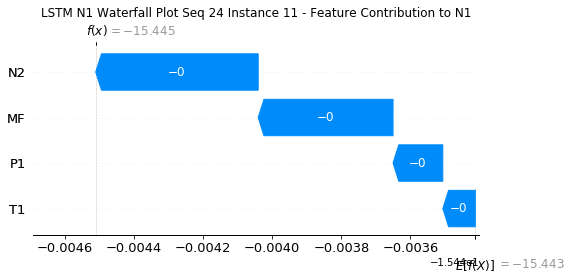

None

Contribution: [-1.39408691e-04 -9.13129084e-05 -4.54904659e-04 -3.76181969e-04]


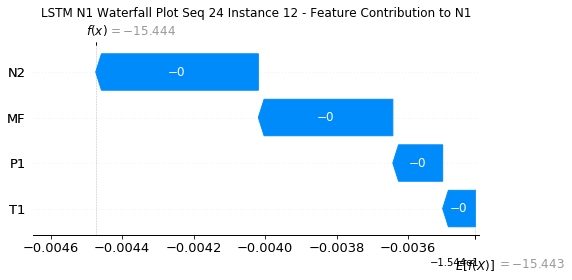

None

Contribution: [-1.34850909e-04 -8.93766464e-05 -4.40081748e-04 -3.62891497e-04]


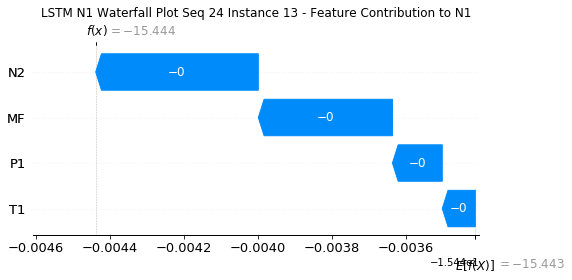

None

Contribution: [-1.31437364e-04 -8.60181717e-05 -4.27304517e-04 -3.51867753e-04]


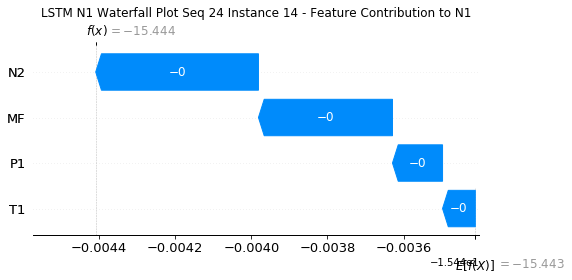

None

Contribution: [-1.26575175e-04 -8.43061322e-05 -4.15861700e-04 -3.38998077e-04]


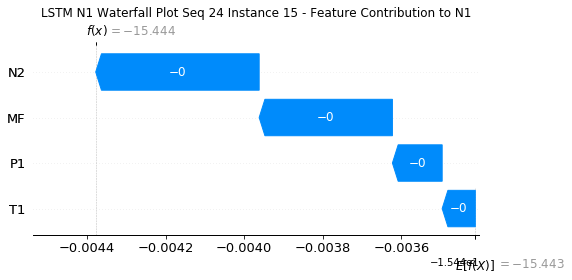

None

Contribution: [-1.24000420e-04 -8.18050822e-05 -4.04916061e-04 -3.30018302e-04]


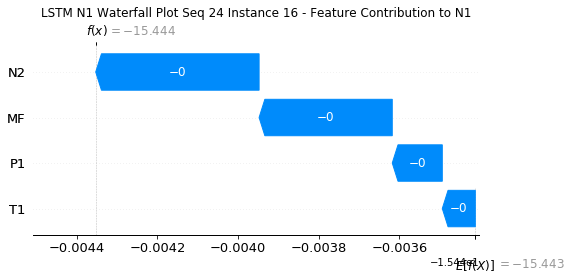

None

Contribution: [-1.21446880e-04 -7.98800584e-05 -3.96253214e-04 -3.21181904e-04]


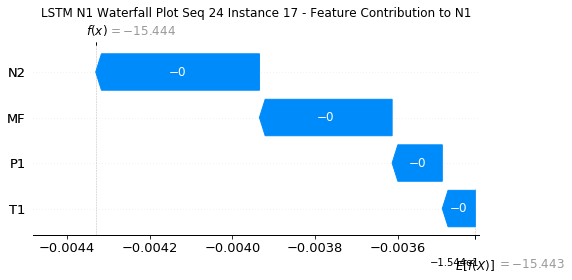

None

Contribution: [-1.20565884e-04 -7.95167943e-05 -3.89537440e-04 -3.14222006e-04]


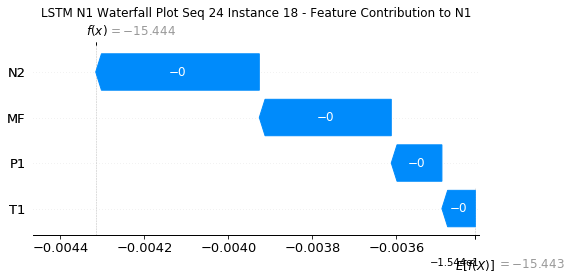

None

Contribution: [-1.20447727e-04 -7.42890135e-05 -3.83075544e-04 -3.04737047e-04]


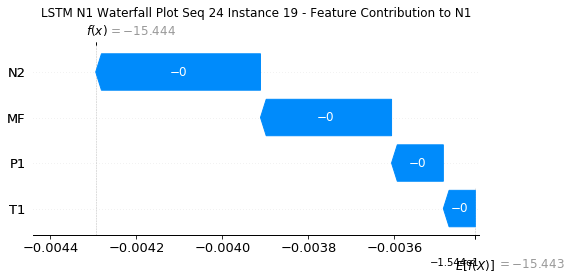

None

Contribution: [-1.22299165e-04 -6.76256511e-05 -3.70661151e-04 -2.83926848e-04]


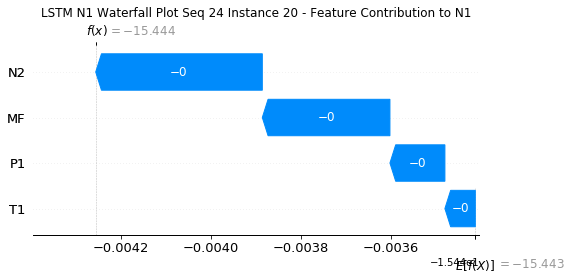

None

Contribution: [-1.15330127e-04 -6.37833346e-05 -3.39154921e-04 -2.11704254e-04]


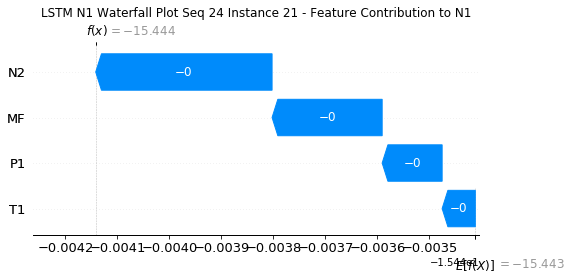

None

Contribution: [-9.53132654e-05 -1.23652763e-04 -3.61909847e-04 -2.99174679e-04]


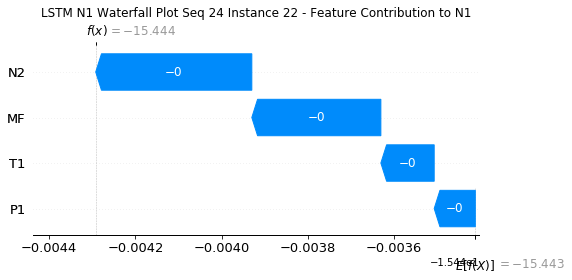

None

Contribution: [ 0.00057033  0.00028879 -0.00250355 -0.00422288]


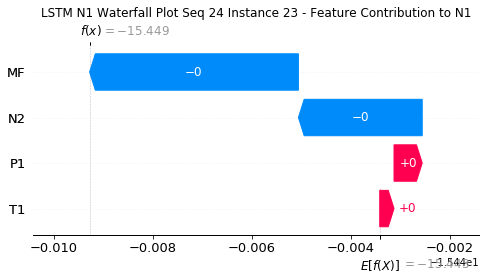

None

Contribution: [ 0.00030495  0.01443011 -0.01565446 -0.0233413 ]


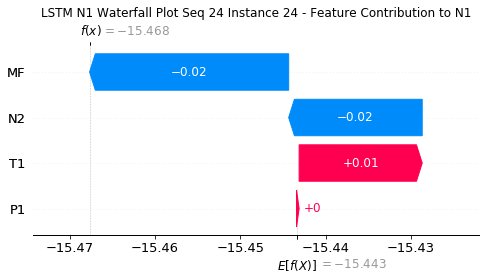

None

Contribution: [-0.04656466 -0.01314299 -0.14510394 -0.07752791]


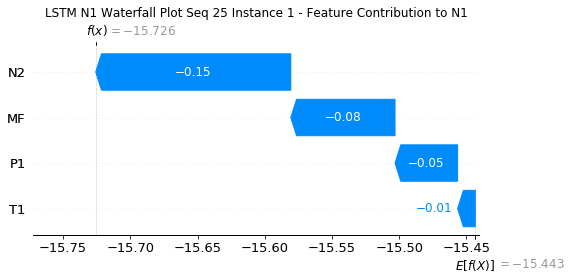

None

Contribution: [0.00067357 0.00029165 0.00190297 0.00180667]


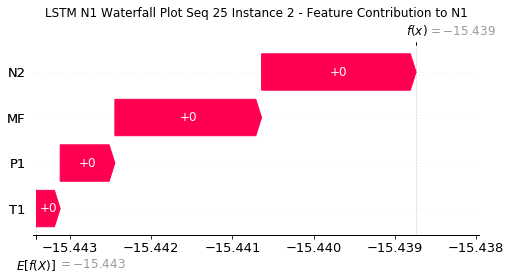

None

Contribution: [-7.54240910e-05 -7.70941945e-05 -3.10909227e-04 -2.63343577e-04]


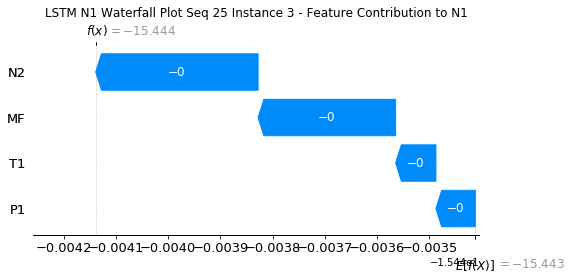

None

Contribution: [-1.64373775e-04 -8.11609123e-05 -5.85607921e-04 -5.00112915e-04]


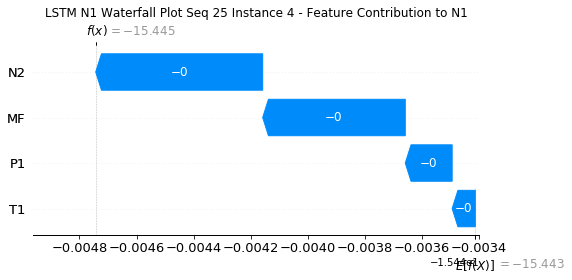

None

Contribution: [-0.00014822 -0.00010335 -0.00049989 -0.00041904]


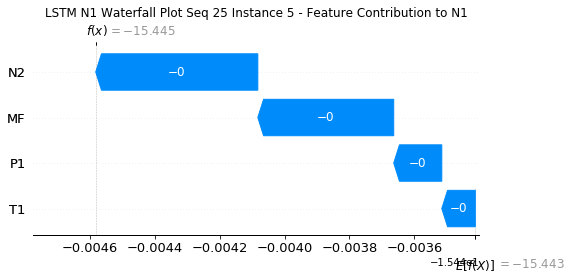

None

Contribution: [-1.38672606e-04 -8.95867123e-05 -4.54008424e-04 -3.68665818e-04]


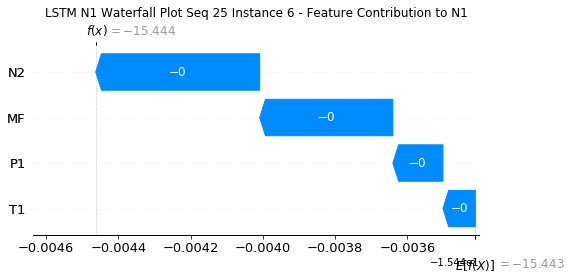

None

Contribution: [-1.48430061e-04 -9.84810905e-05 -4.90381920e-04 -3.97159409e-04]


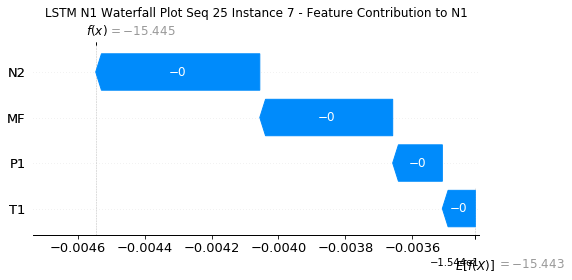

None

Contribution: [-0.00015199 -0.00010178 -0.00051288 -0.00040828]


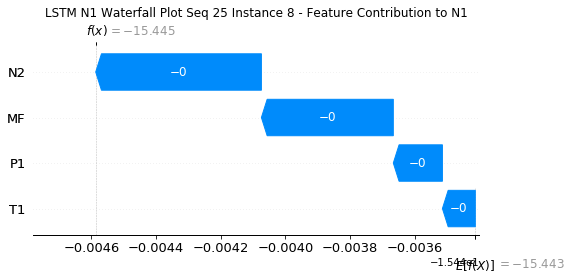

None

Contribution: [-0.00014938 -0.00010126 -0.00050368 -0.00040725]


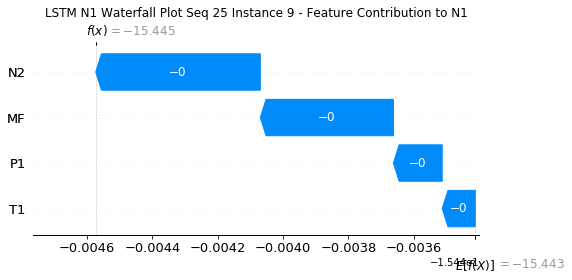

None

Contribution: [-1.50245680e-04 -9.90459696e-05 -4.89009085e-04 -4.07410655e-04]


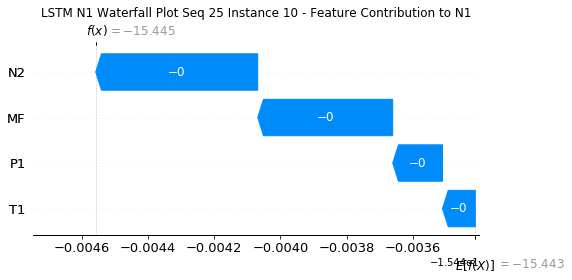

None

Contribution: [-1.42844158e-04 -9.53874970e-05 -4.70621738e-04 -3.89039301e-04]


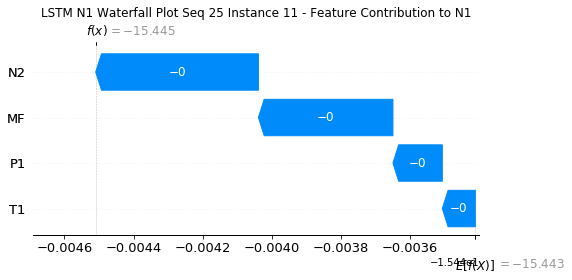

None

Contribution: [-1.38161523e-04 -9.27677431e-05 -4.55280398e-04 -3.75210669e-04]


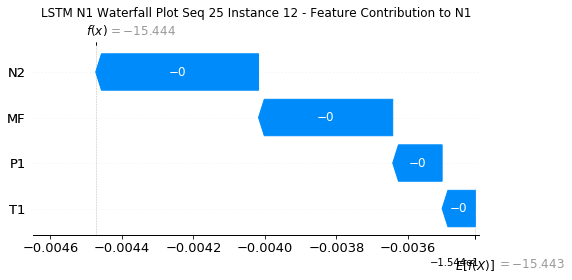

None

Contribution: [-1.32057912e-04 -8.87615323e-05 -4.40054646e-04 -3.59611984e-04]


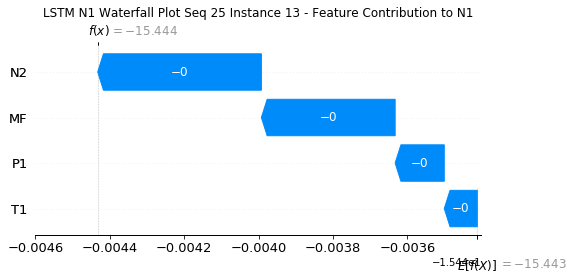

None

Contribution: [-1.29886433e-04 -8.70766877e-05 -4.27393493e-04 -3.50223017e-04]


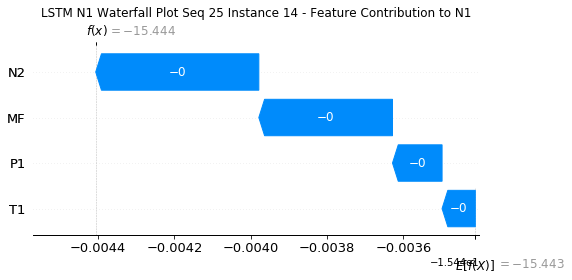

None

Contribution: [-1.27941528e-04 -8.49563398e-05 -4.16176018e-04 -3.40507272e-04]


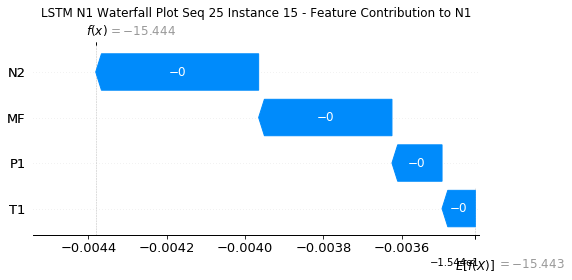

None

Contribution: [-1.22304033e-04 -8.24883380e-05 -4.04904582e-04 -3.28024897e-04]


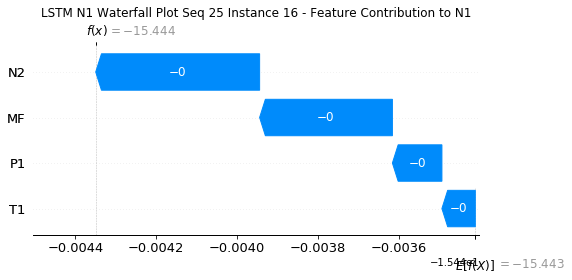

None

Contribution: [-1.20591396e-04 -8.09250440e-05 -3.96794048e-04 -3.20813615e-04]


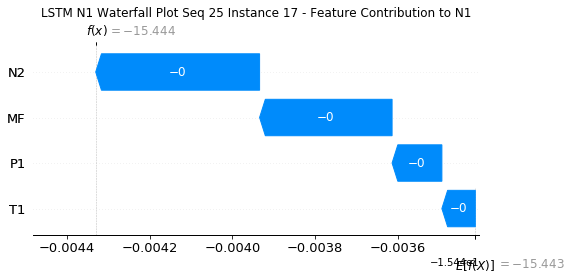

None

Contribution: [-1.20769976e-04 -8.16001577e-05 -3.91479130e-04 -3.16978484e-04]


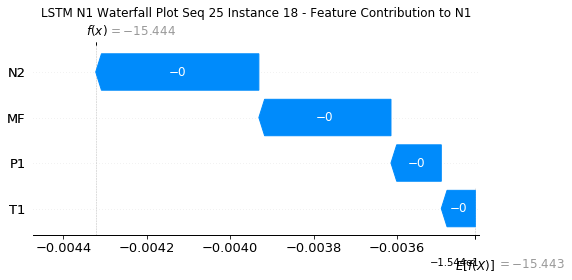

None

Contribution: [-1.19838794e-04 -7.62970275e-05 -3.84065251e-04 -3.05677755e-04]


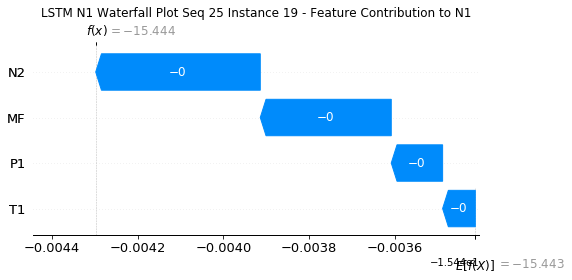

None

Contribution: [-1.22000725e-04 -6.88263038e-05 -3.71760708e-04 -2.85098673e-04]


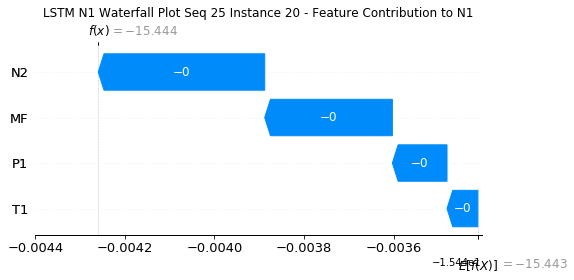

None

Contribution: [-1.14872086e-04 -6.16500090e-05 -3.40154460e-04 -2.12210961e-04]


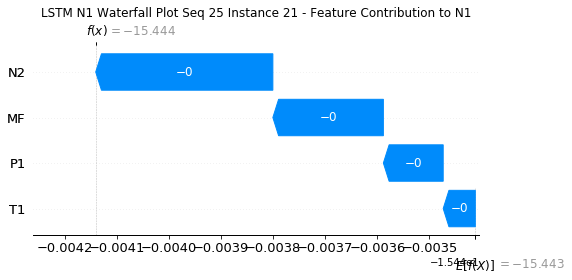

None

Contribution: [-9.60517999e-05 -1.24260245e-04 -3.63862143e-04 -3.03695693e-04]


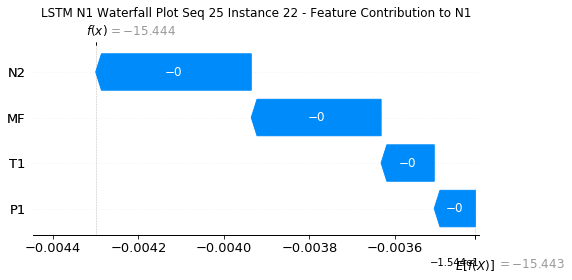

None

Contribution: [ 5.37259086e-04 -6.33492903e-05 -2.53542218e-03 -4.26822324e-03]


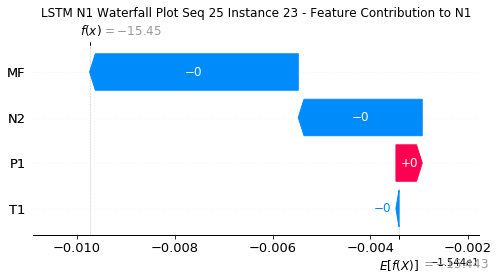

None

Contribution: [ 0.00108297  0.00737046 -0.01646442 -0.02732367]


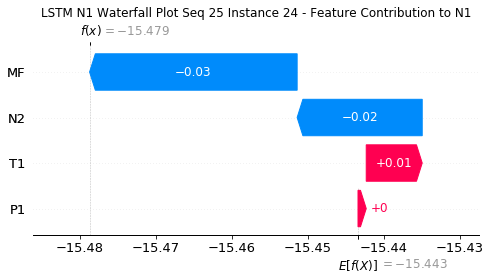

None

Contribution: [-0.05103448 -0.01520871 -0.14476907 -0.08527948]


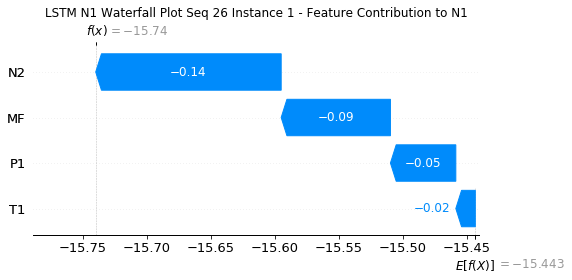

None

Contribution: [0.0006654  0.00029368 0.00186676 0.00179012]


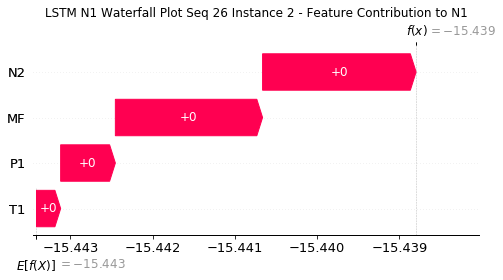

None

Contribution: [-7.49354786e-05 -7.80501731e-05 -3.07568210e-04 -2.60527850e-04]


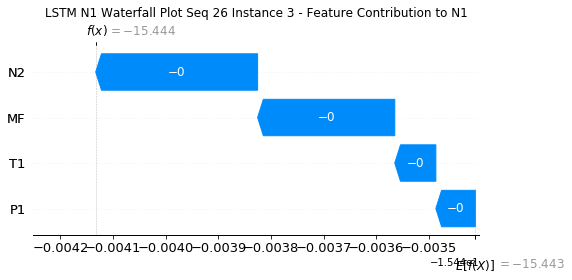

None

Contribution: [-1.54912972e-04 -8.90623052e-05 -5.80379140e-04 -4.84966837e-04]


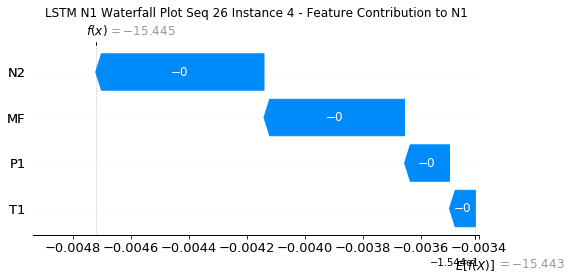

None

Contribution: [-0.00014542 -0.00010604 -0.00049748 -0.0004138 ]


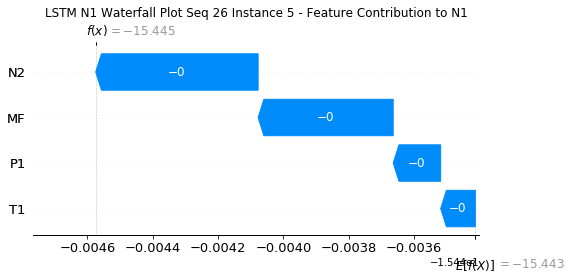

None

Contribution: [-1.41134499e-04 -9.52380119e-05 -4.54133116e-04 -3.74769347e-04]


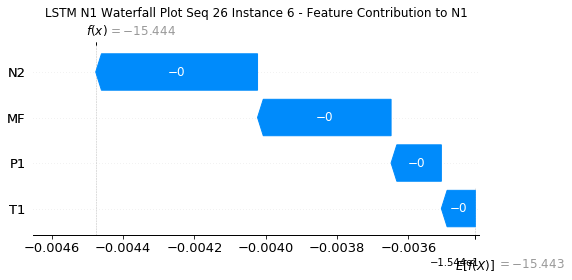

None

Contribution: [-0.00014646 -0.00010049 -0.00048845 -0.00039437]


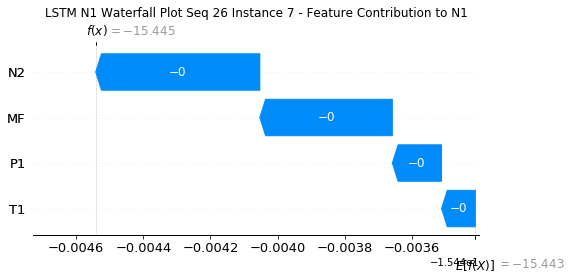

None

Contribution: [-0.00015204 -0.00010357 -0.00051199 -0.00040991]


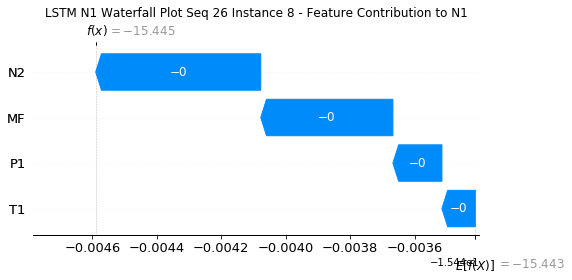

None

Contribution: [-0.00015306 -0.00010268 -0.00050421 -0.00041357]


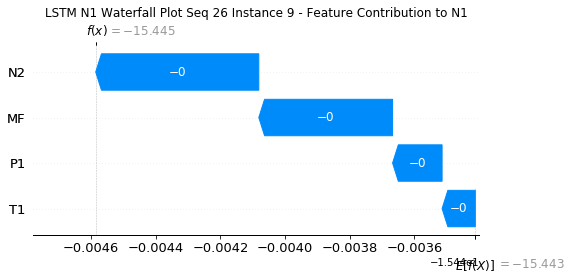

None

Contribution: [-0.00015037 -0.00010078 -0.00048788 -0.00041002]


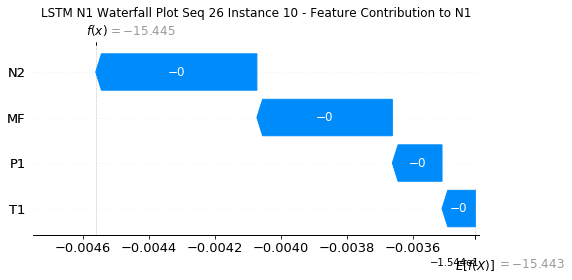

None

Contribution: [-1.42227348e-04 -9.68516388e-05 -4.68858416e-04 -3.88918797e-04]


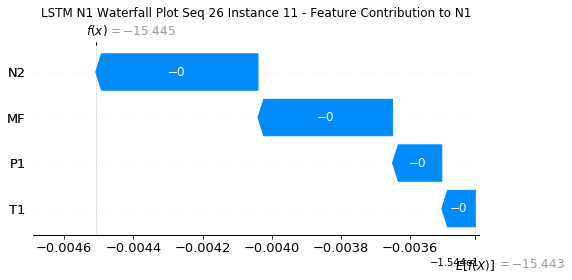

None

Contribution: [-1.37361347e-04 -9.37194309e-05 -4.53186565e-04 -3.74240959e-04]


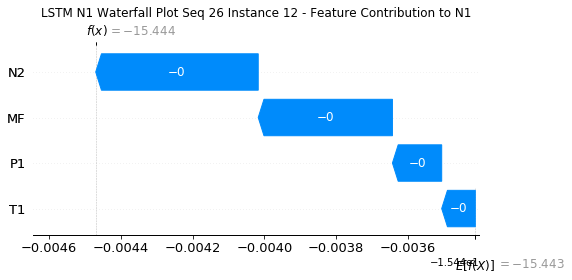

None

Contribution: [-1.34871486e-04 -9.32722309e-05 -4.40095748e-04 -3.64594187e-04]


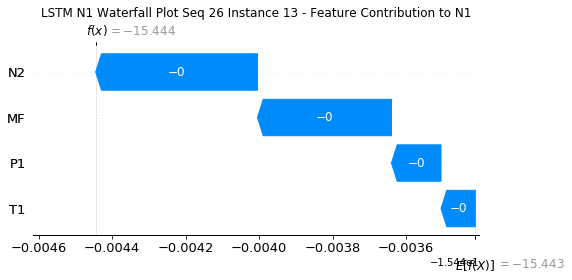

None

Contribution: [-1.29617009e-04 -8.78248284e-05 -4.25873045e-04 -3.50992178e-04]


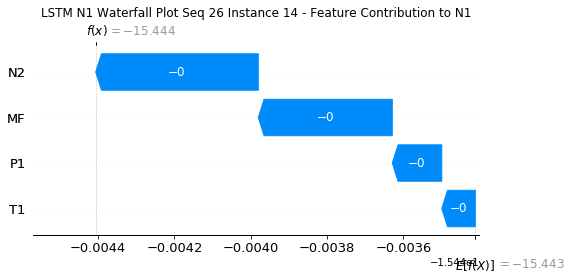

None

Contribution: [-1.26067268e-04 -8.59821470e-05 -4.13662477e-04 -3.38513792e-04]


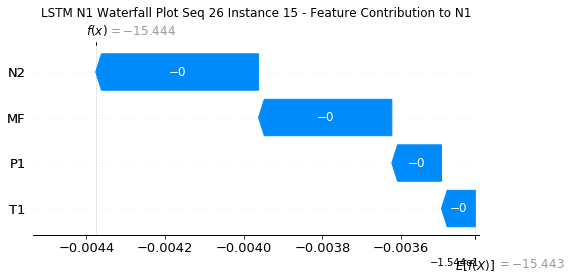

None

Contribution: [-1.22536982e-04 -8.26410326e-05 -4.03698469e-04 -3.29311593e-04]


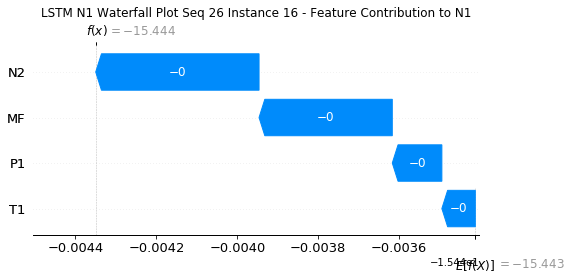

None

Contribution: [-1.20627168e-04 -8.02012718e-05 -3.95379764e-04 -3.21170929e-04]


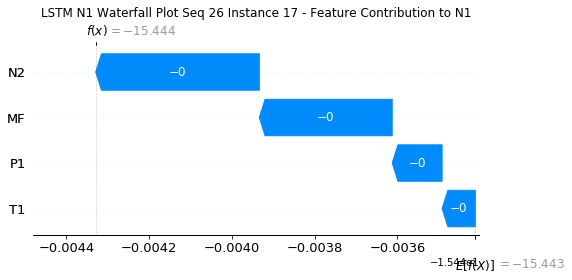

None

Contribution: [-1.19132236e-04 -7.87987754e-05 -3.88506954e-04 -3.11579603e-04]


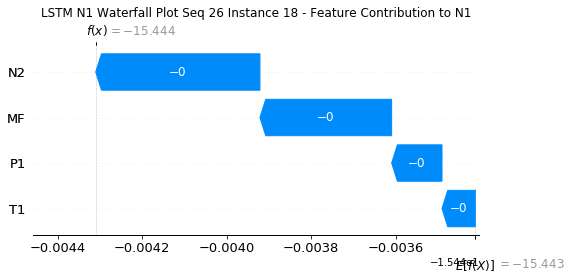

None

Contribution: [-1.19252479e-04 -7.45850208e-05 -3.82341688e-04 -3.04761261e-04]


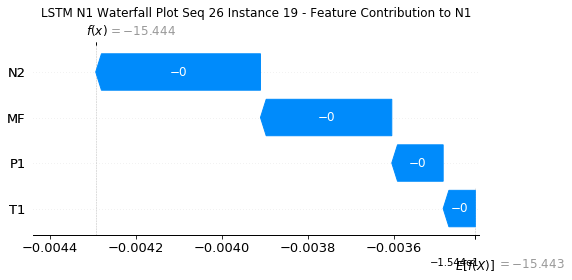

None

Contribution: [-1.21340963e-04 -6.75538699e-05 -3.70230493e-04 -2.84334950e-04]


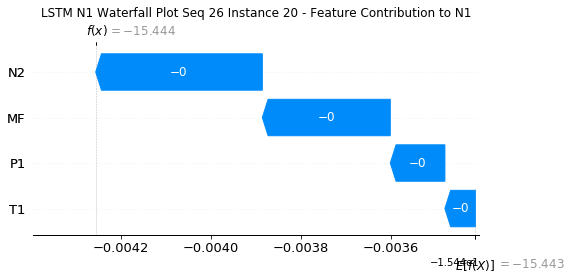

None

Contribution: [-1.14167513e-04 -6.35101894e-05 -3.39515475e-04 -2.12051207e-04]


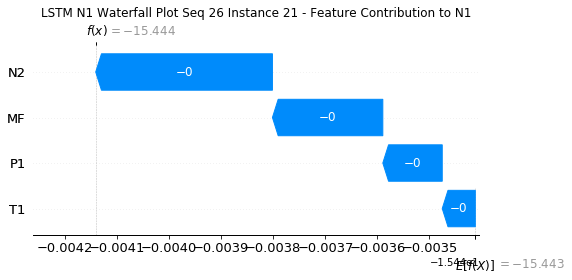

None

Contribution: [-9.56896624e-05 -1.21608407e-04 -3.62152566e-04 -3.02156597e-04]


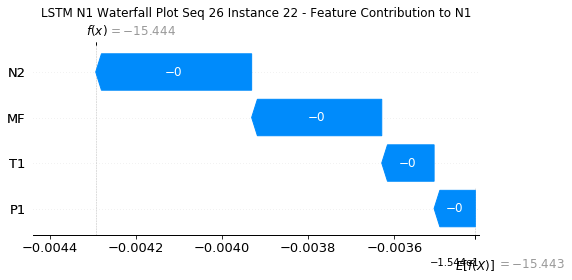

None

Contribution: [ 0.00056437  0.0001255  -0.00250125 -0.00458089]


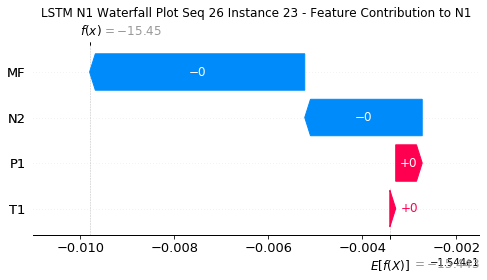

None

Contribution: [ 0.00111031  0.00941302 -0.01630053 -0.03012557]


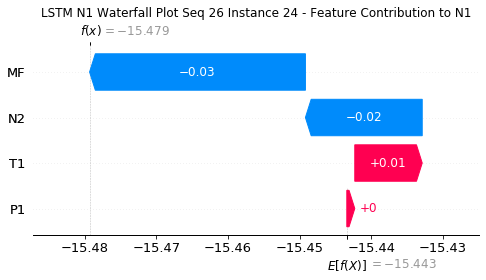

None

Contribution: [-0.04793975 -0.01156948 -0.14531937 -0.08144024]


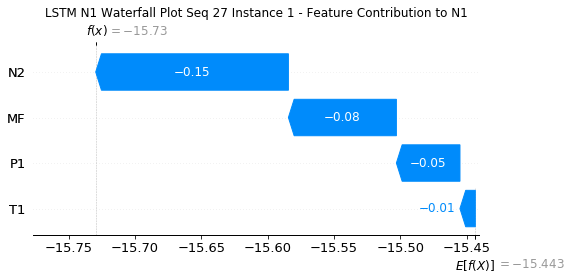

None

Contribution: [0.00066684 0.000289   0.00189539 0.00181516]


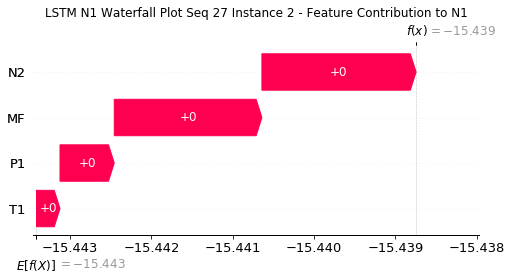

None

Contribution: [-7.52805234e-05 -7.77564620e-05 -3.10402634e-04 -2.63714165e-04]


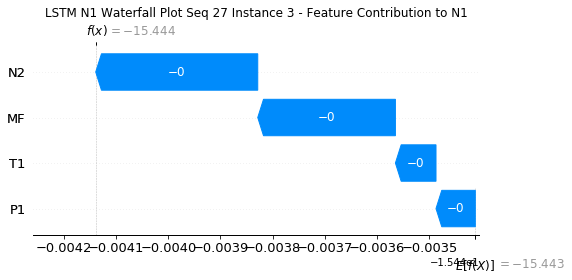

None

Contribution: [-1.61304400e-04 -8.52504521e-05 -5.83002621e-04 -4.91273443e-04]


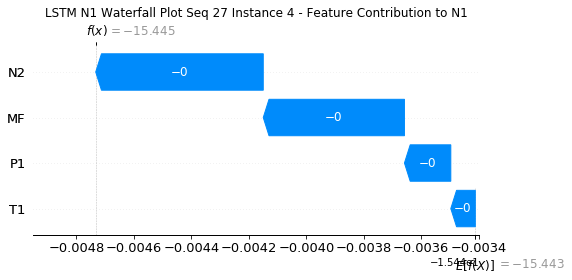

None

Contribution: [-0.00014735 -0.00010513 -0.00049885 -0.00041632]


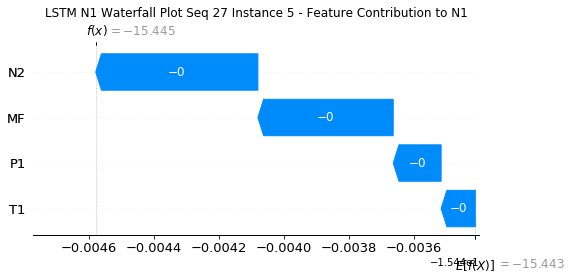

None

Contribution: [-1.41110584e-04 -9.30178258e-05 -4.54649166e-04 -3.72623683e-04]


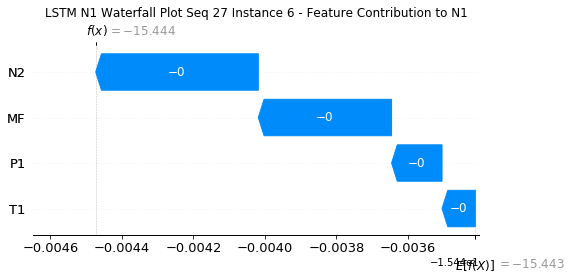

None

Contribution: [-1.47316256e-04 -9.95108296e-05 -4.89507241e-04 -3.95063413e-04]


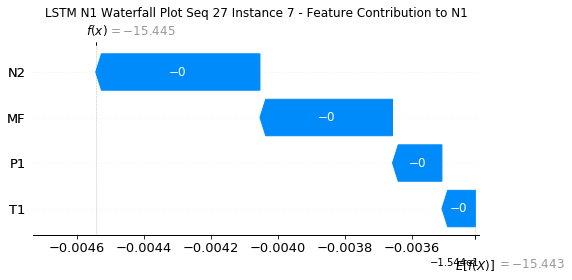

None

Contribution: [-0.00015083 -0.00010154 -0.00051224 -0.00040784]


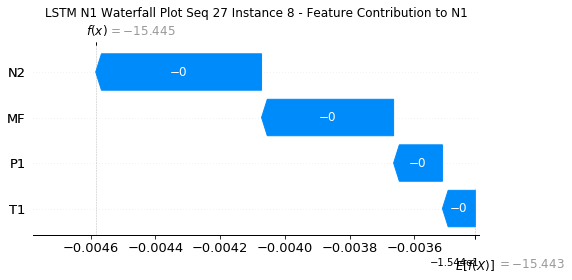

None

Contribution: [-1.46095881e-04 -9.36766293e-05 -5.00347730e-04 -4.00863908e-04]


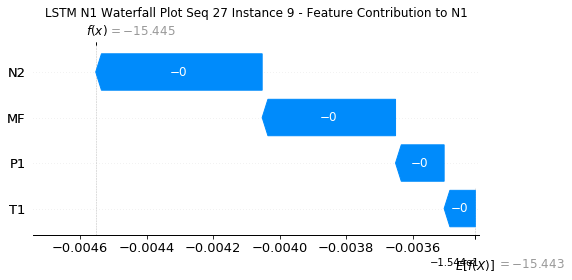

None

Contribution: [-1.47063153e-04 -9.83992459e-05 -4.87829440e-04 -4.05776306e-04]


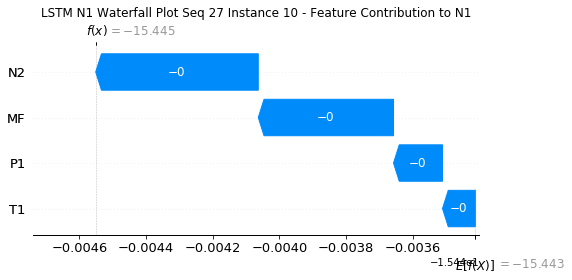

None

Contribution: [-1.43637303e-04 -9.79697001e-05 -4.71090056e-04 -3.90750880e-04]


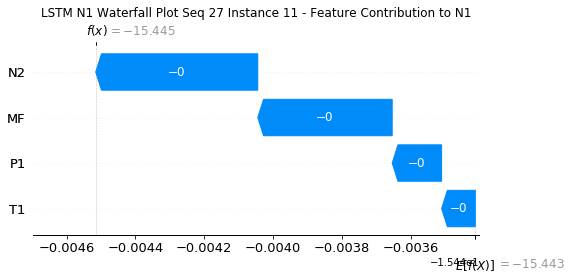

None

Contribution: [-1.38909522e-04 -9.48957397e-05 -4.55378532e-04 -3.76338678e-04]


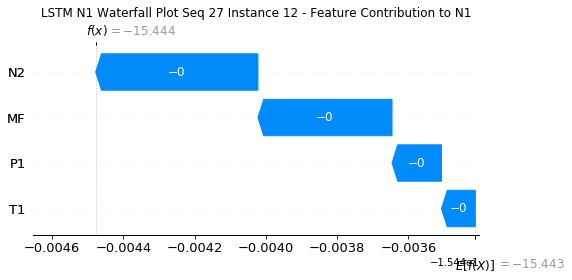

None

Contribution: [-1.33157369e-04 -9.19200700e-05 -4.39574457e-04 -3.59078427e-04]


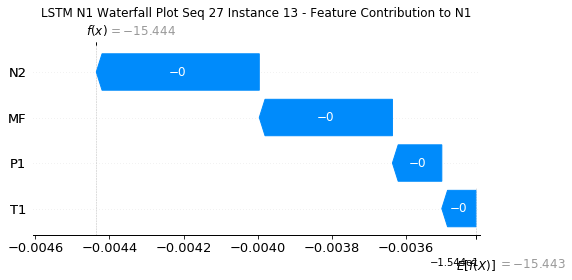

None

Contribution: [-1.30119138e-04 -8.89714312e-05 -4.27366445e-04 -3.50935462e-04]


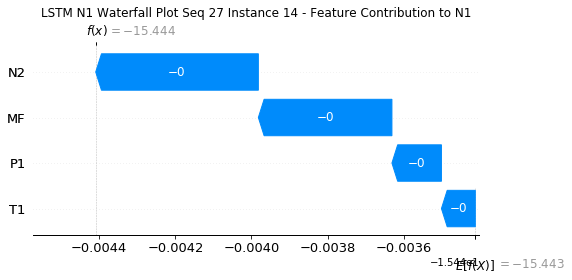

None

Contribution: [-1.26117174e-04 -8.58525592e-05 -4.14365206e-04 -3.36638509e-04]


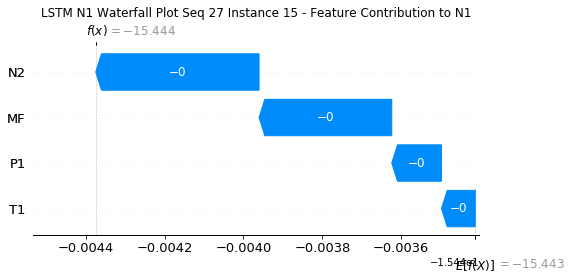

None

Contribution: [-1.22622997e-04 -8.39301747e-05 -4.04852380e-04 -3.29086299e-04]


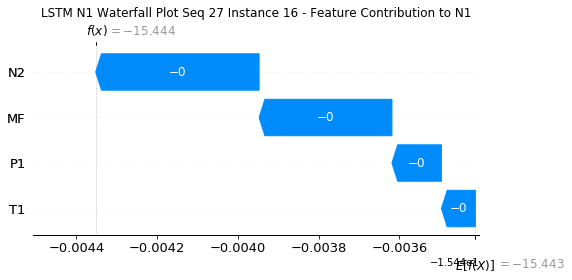

None

Contribution: [-1.20187868e-04 -8.15063056e-05 -3.96267036e-04 -3.20849245e-04]


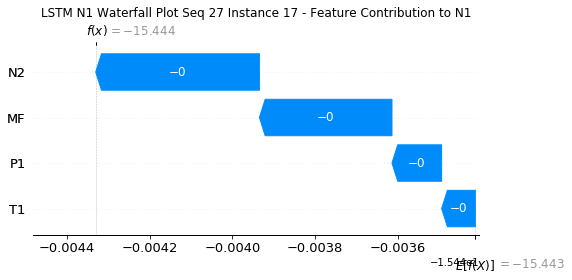

None

Contribution: [-1.20325299e-04 -8.18976588e-05 -3.91547774e-04 -3.18724077e-04]


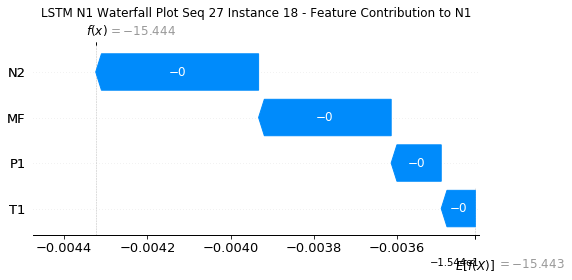

None

Contribution: [-1.17999256e-04 -7.55470611e-05 -3.82792382e-04 -3.03407141e-04]


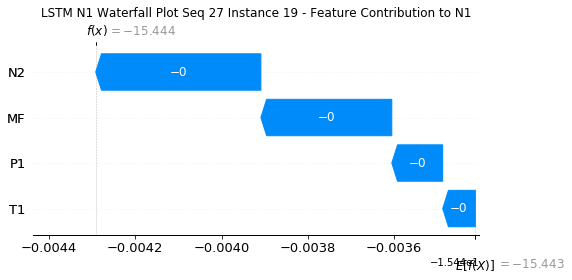

None

Contribution: [-1.19538996e-04 -6.81997096e-05 -3.70638360e-04 -2.83440457e-04]


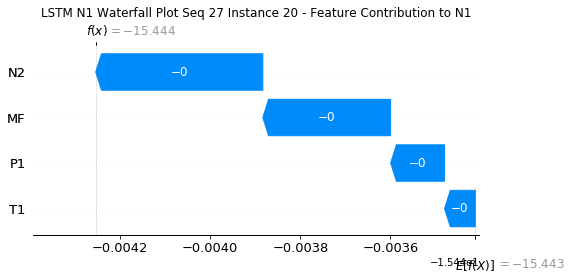

None

Contribution: [-1.10575604e-04 -6.32910158e-05 -3.40005297e-04 -2.15347719e-04]


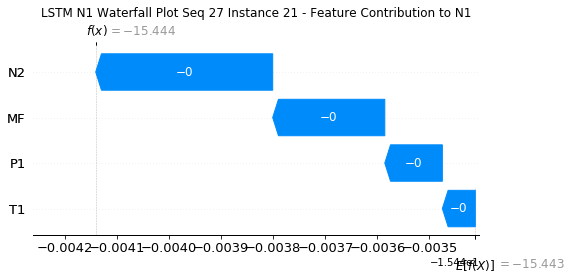

None

Contribution: [-9.89230861e-05 -1.23645043e-04 -3.62804384e-04 -2.99024863e-04]


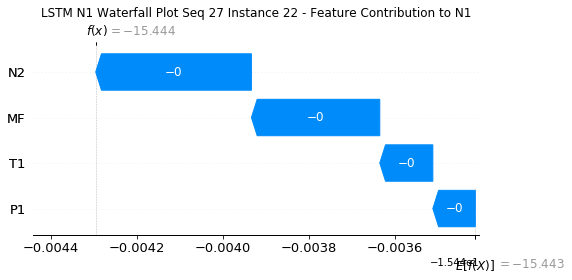

None

Contribution: [ 0.00034257  0.00015157 -0.00241373 -0.00361708]


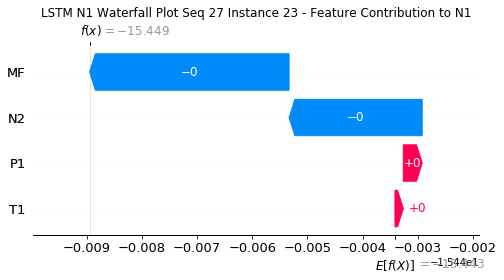

None

Contribution: [ 0.00115271  0.00915234 -0.01573321 -0.02794141]


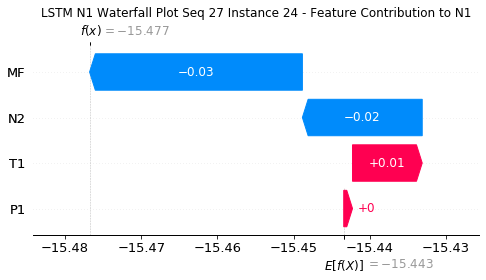

None

Contribution: [-0.05421087 -0.01411258 -0.14376403 -0.0895116 ]


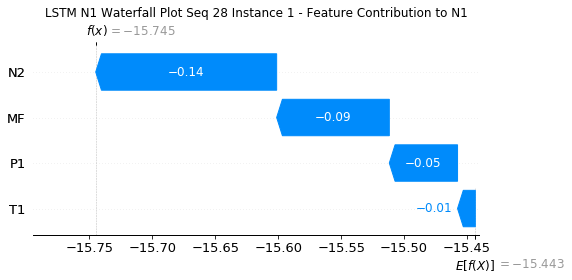

None

Contribution: [0.00067061 0.00028969 0.00185452 0.00179537]


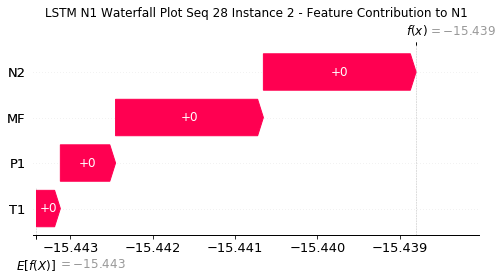

None

Contribution: [-7.49872307e-05 -7.79346726e-05 -3.06435714e-04 -2.60910016e-04]


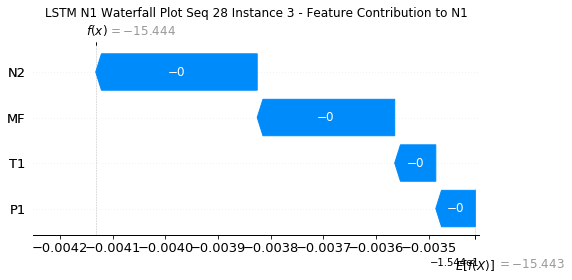

None

Contribution: [-0.00016403 -0.00010758 -0.00058033 -0.00049298]


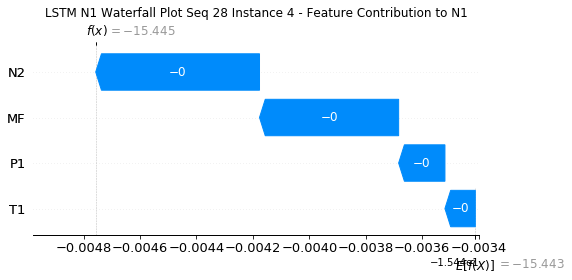

None

Contribution: [-0.00014687 -0.00011111 -0.00049603 -0.00041413]


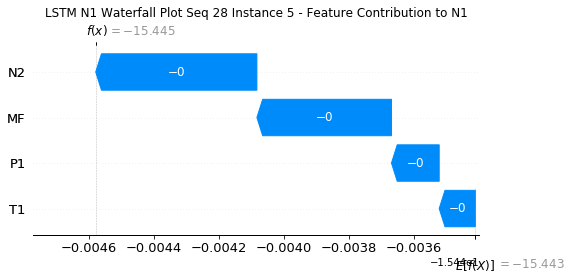

None

Contribution: [-0.00014423 -0.00010205 -0.00045409 -0.00037888]


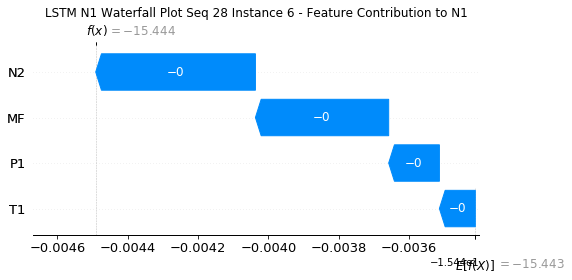

None

Contribution: [-0.00014828 -0.00010196 -0.00048845 -0.00039526]


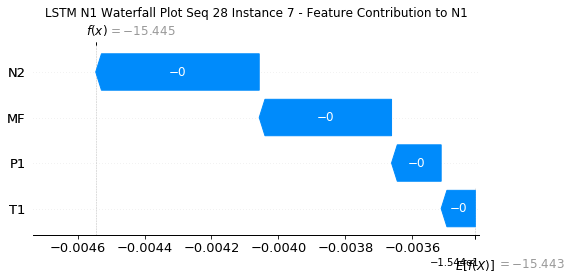

None

Contribution: [-0.0001529  -0.00010261 -0.00051041 -0.0004083 ]


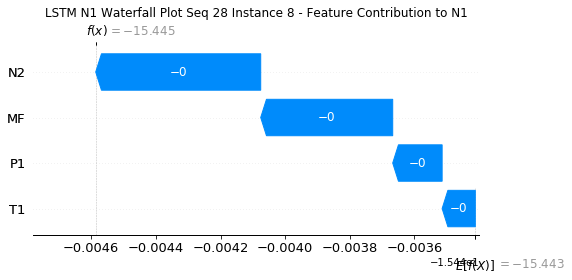

None

Contribution: [-0.00015002 -0.00010064 -0.00050165 -0.0004096 ]


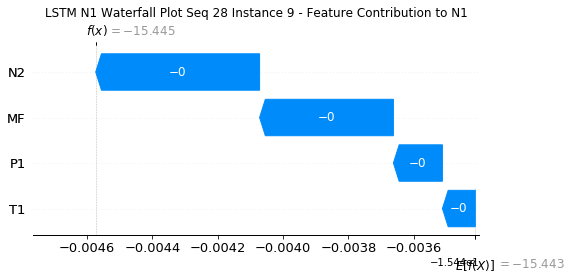

None

Contribution: [-1.47853603e-04 -9.66674494e-05 -4.85038944e-04 -4.03322656e-04]


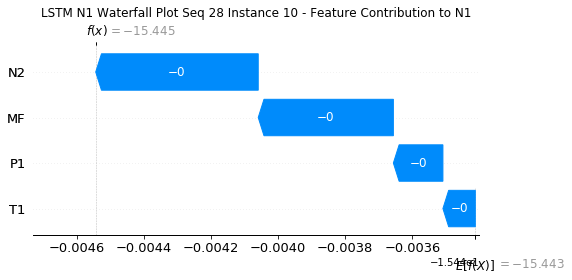

None

Contribution: [-1.44700278e-04 -9.76380669e-05 -4.69183496e-04 -3.90163929e-04]


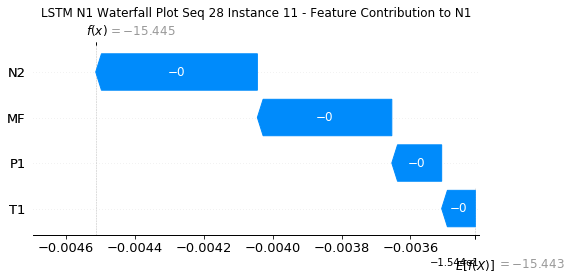

None

Contribution: [-1.40814116e-04 -9.29355129e-05 -4.53737470e-04 -3.76502117e-04]


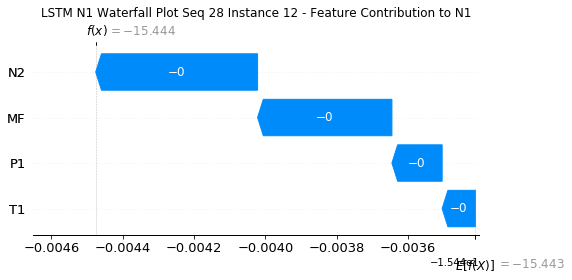

None

Contribution: [-1.30949392e-04 -8.90623471e-05 -4.37080368e-04 -3.58130474e-04]


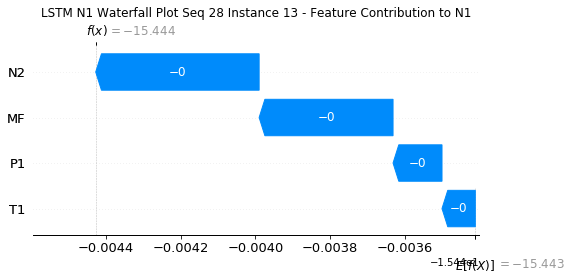

None

Contribution: [-1.34164398e-04 -8.26015138e-05 -4.26373606e-04 -3.53243092e-04]


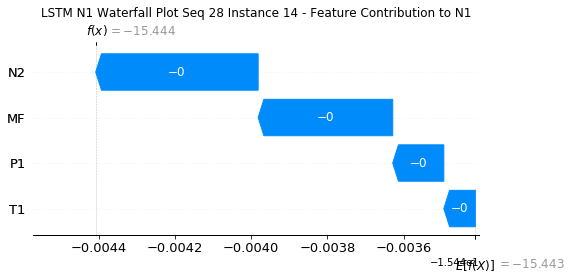

None

Contribution: [-1.25690580e-04 -7.69015423e-05 -4.12360145e-04 -3.37204448e-04]


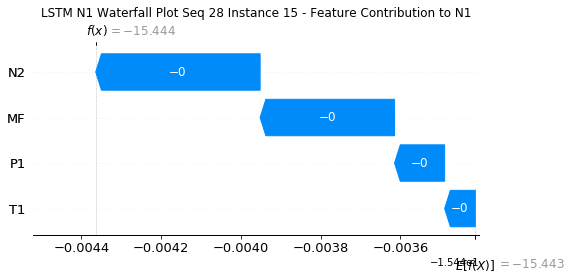

None

Contribution: [-1.28033391e-04 -7.30638241e-05 -4.03853975e-04 -3.31514387e-04]


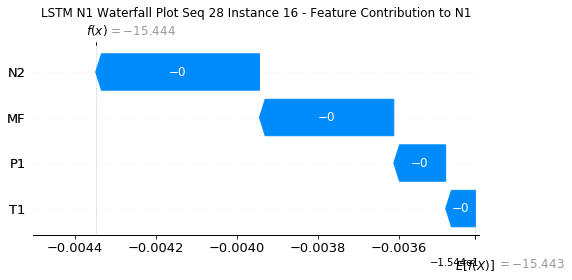

None

Contribution: [-1.25665044e-04 -6.72271376e-05 -3.95033910e-04 -3.21813914e-04]


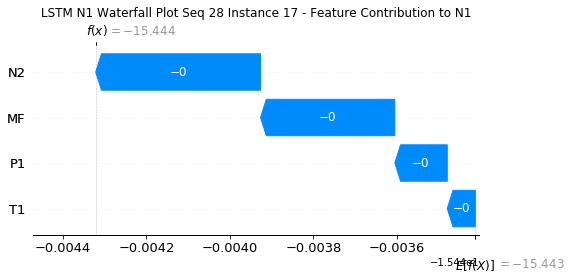

None

Contribution: [-1.15516155e-04 -7.32563567e-05 -3.85973189e-04 -3.02901731e-04]


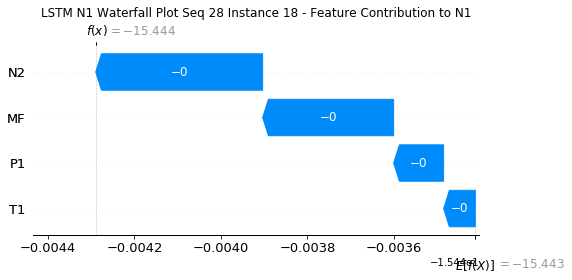

None

Contribution: [-1.29439222e-04 -5.61457061e-05 -3.82395651e-04 -3.07952662e-04]


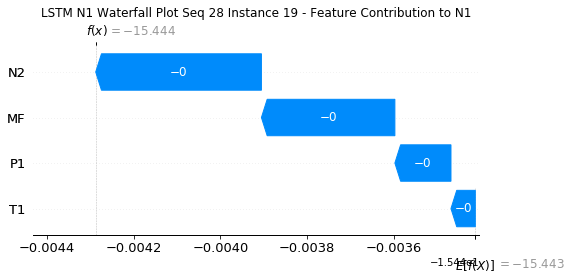

None

Contribution: [-1.33284530e-04 -5.78141446e-05 -3.68984575e-04 -2.82868136e-04]


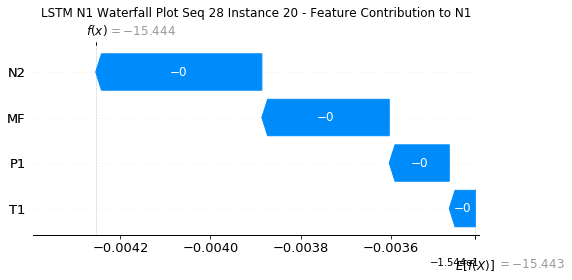

None

Contribution: [-0.00013162 -0.00010181 -0.00033387 -0.00018861]


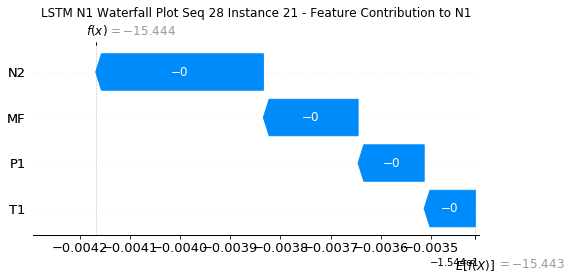

None

Contribution: [-7.94876636e-05 -1.05432426e-04 -3.61681408e-04 -3.10271931e-04]


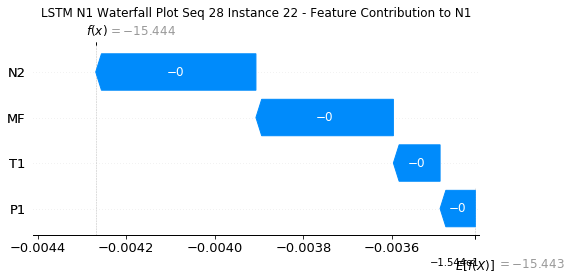

None

Contribution: [ 0.0012892   0.00416475 -0.00274836 -0.00580141]


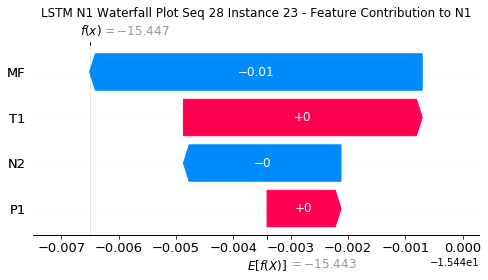

None

Contribution: [ 0.00613578  0.04677671 -0.01857906 -0.04076135]


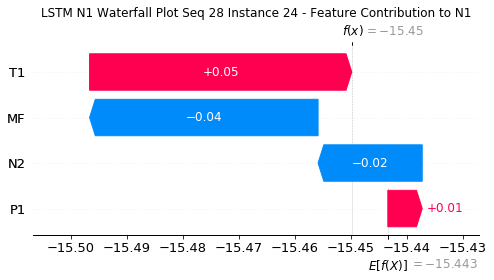

None

Contribution: [-0.06853062  0.0088931  -0.14773965 -0.08727631]


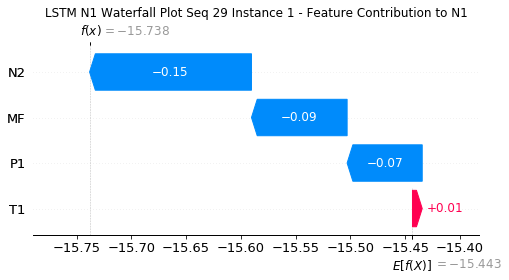

None

Contribution: [0.0007573  0.0002289  0.00189446 0.00185516]


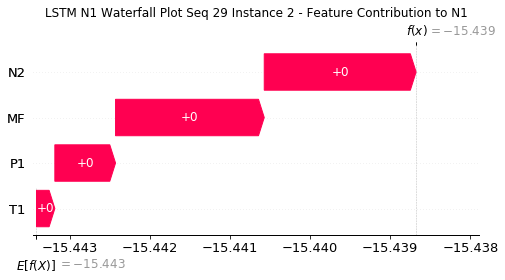

None

Contribution: [-7.89604580e-05 -6.75089879e-05 -3.10966847e-04 -2.66053981e-04]


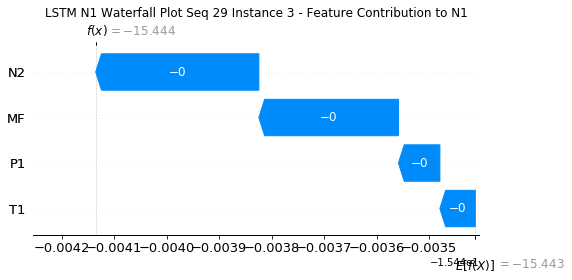

None

Contribution: [-2.14208609e-04  3.90526690e-05 -5.93115121e-04 -5.20352627e-04]


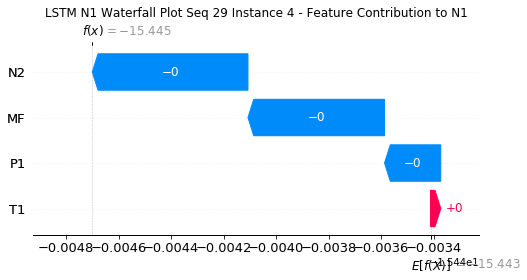

None

Contribution: [-1.64925719e-04 -6.02411090e-05 -5.02921633e-04 -4.28389713e-04]


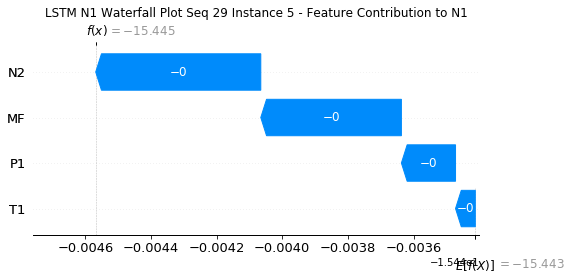

None

Contribution: [-1.48159993e-04 -5.44880779e-05 -4.55464187e-04 -3.72272495e-04]


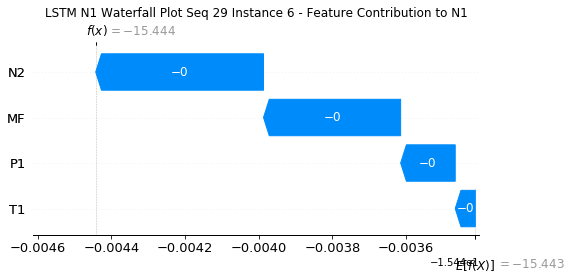

None

Contribution: [-1.63085460e-04 -6.21376622e-05 -4.91668656e-04 -4.02774296e-04]


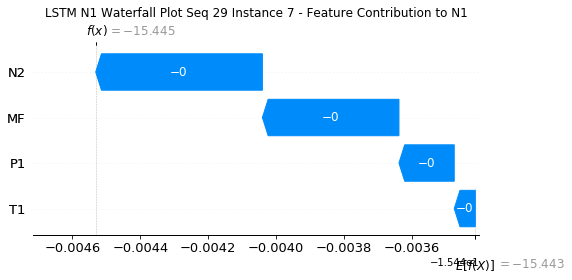

None

Contribution: [-1.67205536e-04 -6.26204987e-05 -5.13501187e-04 -4.14353056e-04]


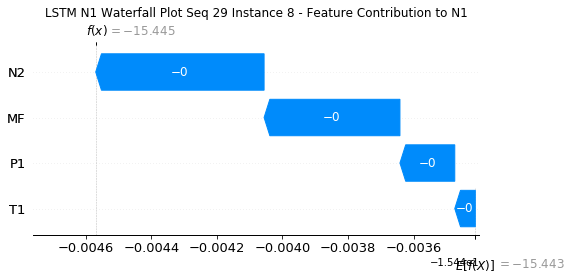

None

Contribution: [-1.71417394e-04 -6.56886951e-05 -5.09472861e-04 -4.27989125e-04]


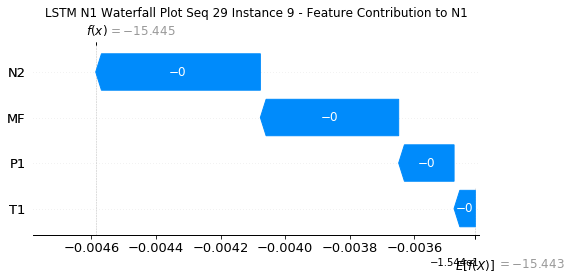

None

Contribution: [-1.70163131e-04 -6.27865968e-05 -4.93218071e-04 -4.23957786e-04]


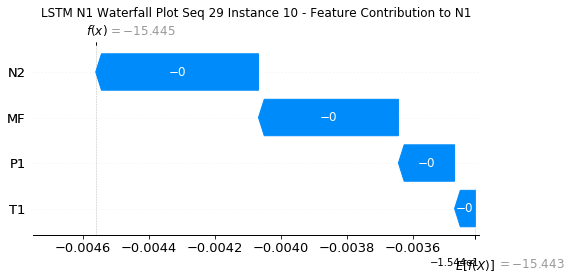

None

Contribution: [-1.58482407e-04 -6.46890427e-05 -4.73840711e-04 -4.00915034e-04]


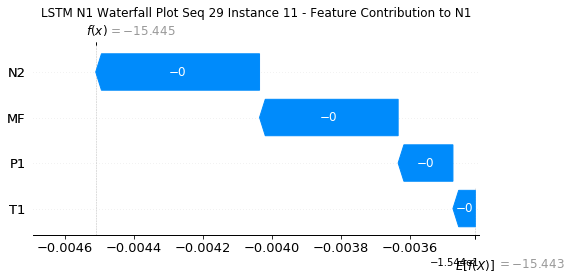

None

Contribution: [-1.51519674e-04 -6.42069315e-05 -4.57808020e-04 -3.84355429e-04]


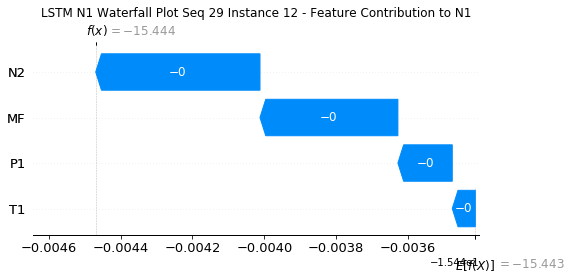

None

Contribution: [-1.49216719e-04 -5.86185952e-05 -4.44309655e-04 -3.74155278e-04]


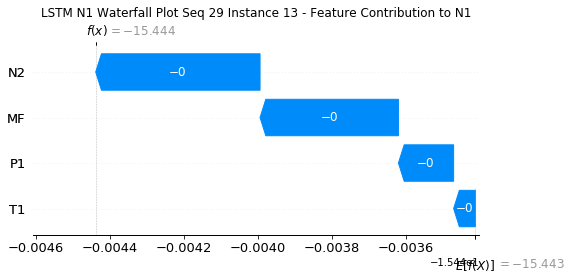

None

Contribution: [-1.41274986e-04 -6.37298693e-05 -4.30239146e-04 -3.59182220e-04]


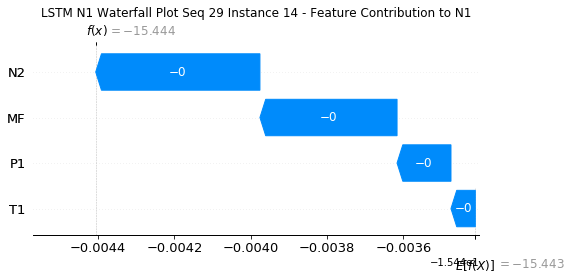

None

Contribution: [-1.30404844e-04 -7.34745699e-05 -4.16054076e-04 -3.39571183e-04]


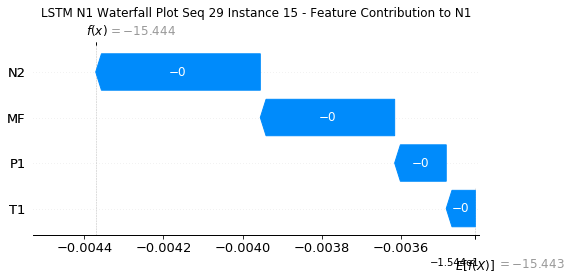

None

Contribution: [-1.30120050e-04 -6.53903301e-05 -4.07080011e-04 -3.33733995e-04]


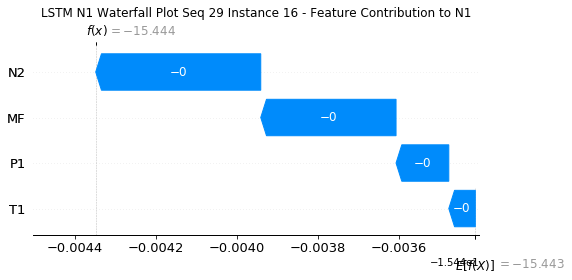

None

Contribution: [-1.26133679e-04 -6.72804917e-05 -3.98784933e-04 -3.24514011e-04]


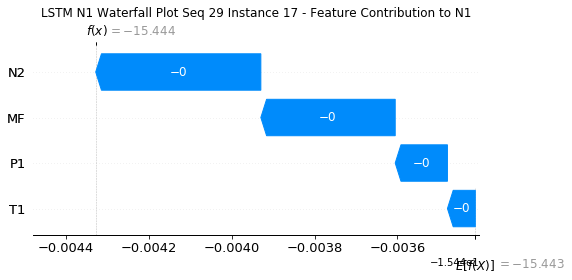

None

Contribution: [-1.15028919e-04 -7.28911776e-05 -3.89615844e-04 -3.08044246e-04]


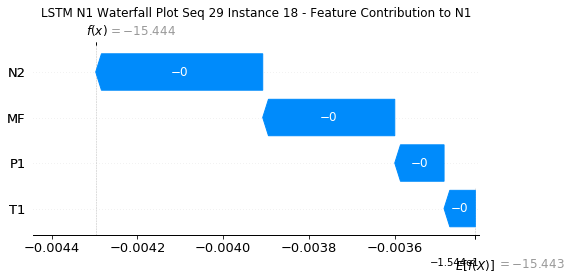

None

Contribution: [-1.19361106e-04 -6.79746329e-05 -3.84564717e-04 -3.04107341e-04]


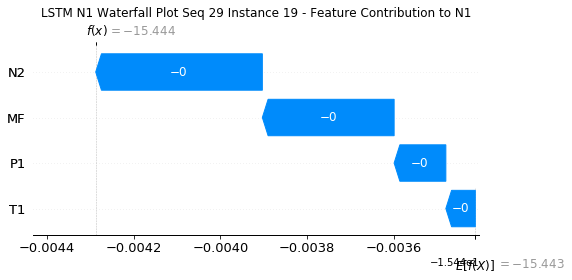

None

Contribution: [-1.20760554e-04 -6.49192826e-05 -3.72157008e-04 -2.84429849e-04]


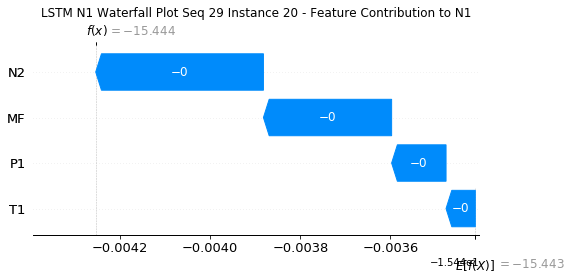

None

Contribution: [-1.12555135e-04 -7.09599781e-05 -3.40042065e-04 -2.13278211e-04]


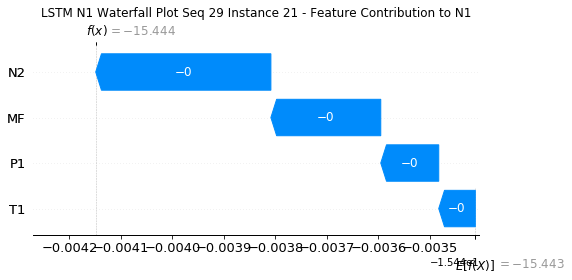

None

Contribution: [-9.70876319e-05 -1.22717293e-04 -3.62720949e-04 -2.98826628e-04]


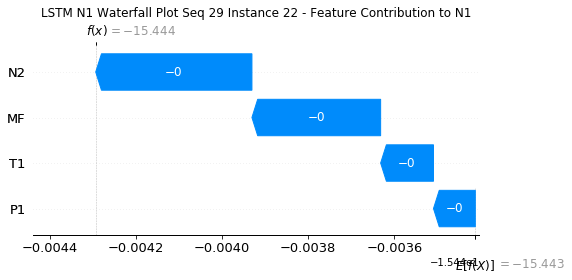

None

Contribution: [ 0.00035673  0.00087357 -0.00249329 -0.00379573]


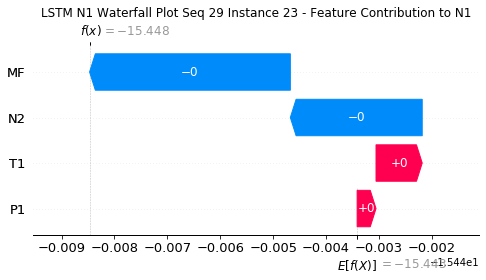

None

Contribution: [-0.00136353  0.02447858 -0.01546374 -0.01813954]


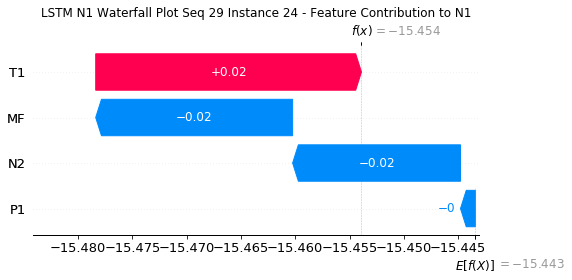

None

Contribution: [-0.04852907 -0.01264021 -0.14585709 -0.08458897]


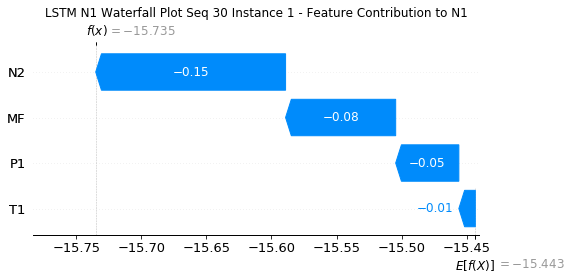

None

Contribution: [0.00067263 0.00028146 0.00188619 0.00181758]


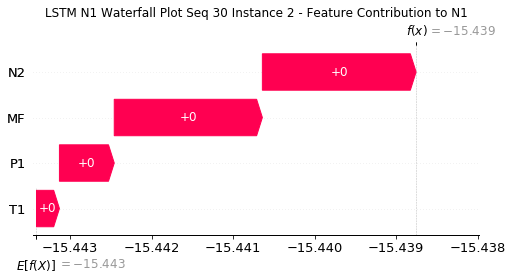

None

Contribution: [-7.55180225e-05 -7.83858728e-05 -3.09335907e-04 -2.62096450e-04]


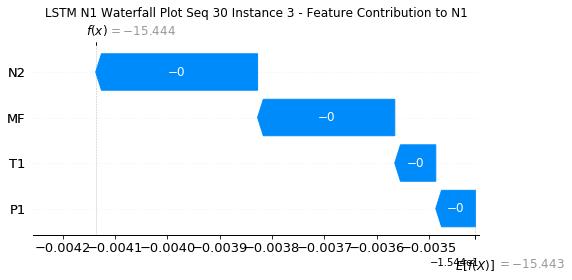

None

Contribution: [-1.57923403e-04 -9.55392615e-05 -5.82819084e-04 -4.88277559e-04]


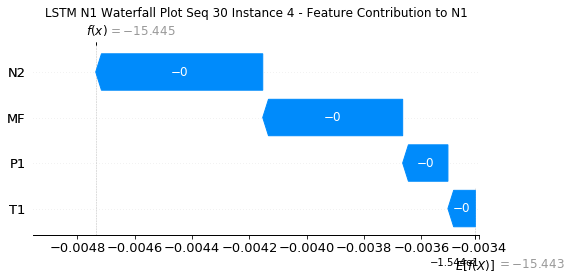

None

Contribution: [-0.00014604 -0.00010733 -0.00049836 -0.00041431]


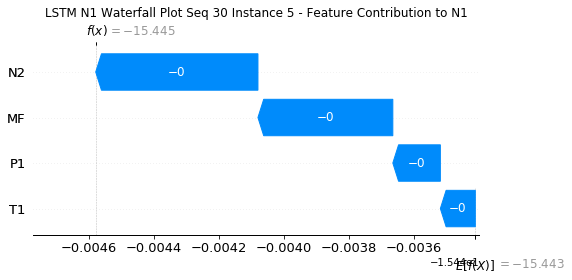

None

Contribution: [-1.42009275e-04 -9.30152912e-05 -4.54630842e-04 -3.71694515e-04]


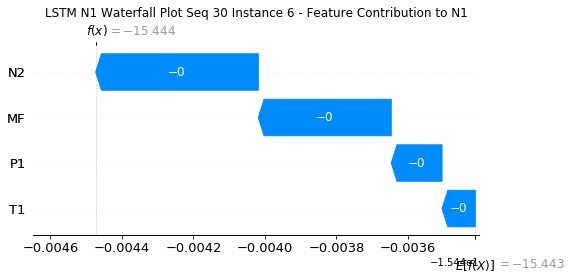

None

Contribution: [-0.00014678 -0.00010099 -0.0004898  -0.00039417]


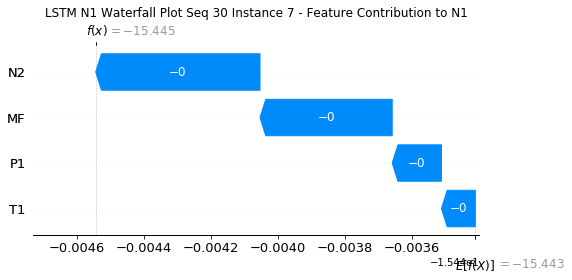

None

Contribution: [-0.00015045 -0.00010023 -0.0005114  -0.00040354]


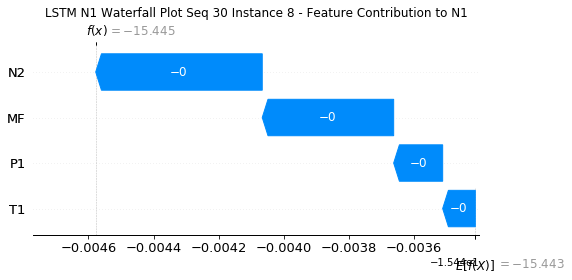

None

Contribution: [-1.46808569e-04 -9.69658905e-05 -5.02179067e-04 -4.02358712e-04]


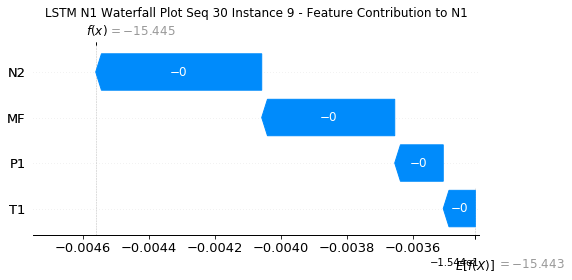

None

Contribution: [-1.47660004e-04 -9.51209372e-05 -4.87052531e-04 -4.00820305e-04]


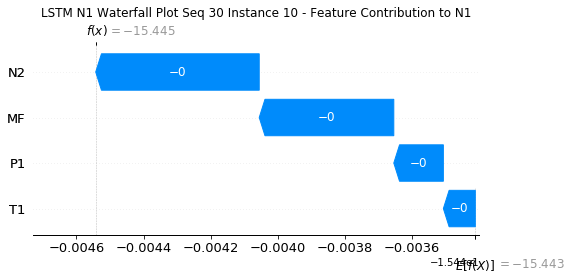

None

Contribution: [-1.42082175e-04 -9.45957350e-05 -4.70295949e-04 -3.87974429e-04]


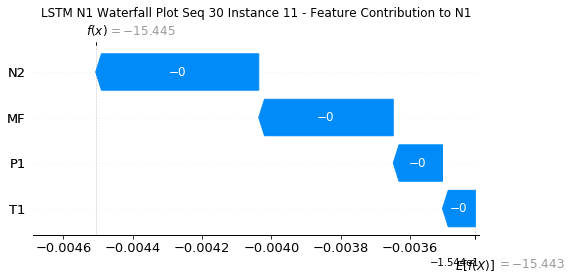

None

Contribution: [-1.37440335e-04 -9.22169692e-05 -4.54904387e-04 -3.74148078e-04]


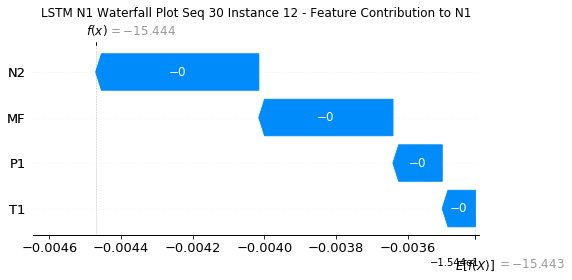

None

Contribution: [-1.32061288e-04 -8.66285933e-05 -4.38709504e-04 -3.55421741e-04]


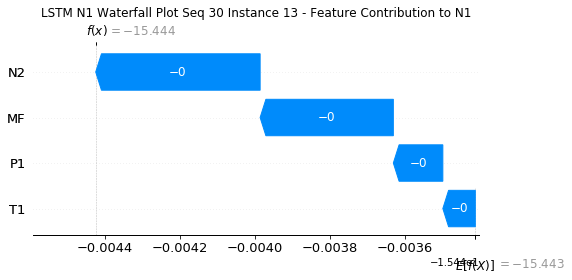

None

Contribution: [-1.29054217e-04 -8.56481851e-05 -4.26887052e-04 -3.48687787e-04]


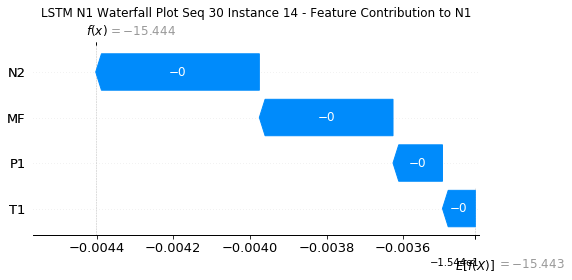

None

Contribution: [-1.26181193e-04 -8.54449373e-05 -4.15043681e-04 -3.37488737e-04]


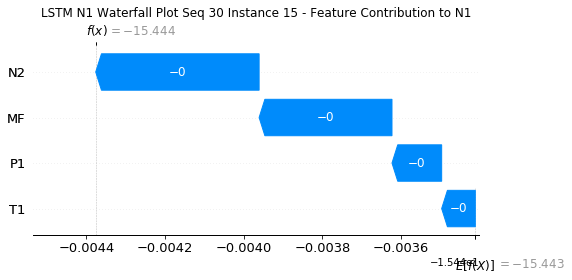

None

Contribution: [-1.21720052e-04 -8.07336320e-05 -4.04395587e-04 -3.26960118e-04]


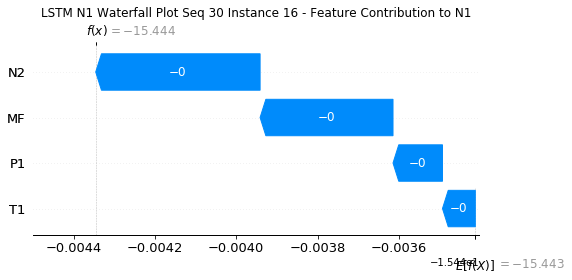

None

Contribution: [-1.20009210e-04 -7.90329125e-05 -3.96455909e-04 -3.19875787e-04]


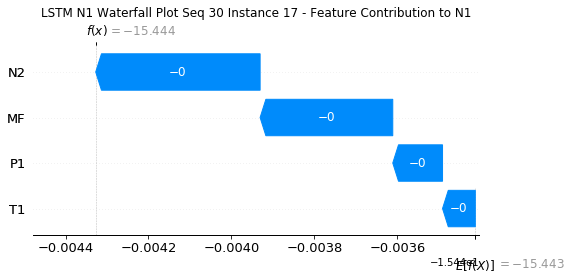

None

Contribution: [-1.18975601e-04 -7.59339248e-05 -3.89037833e-04 -3.09312680e-04]


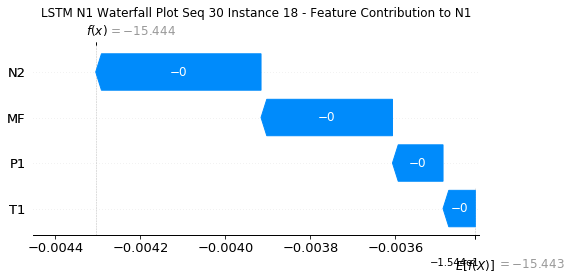

None

Contribution: [-1.18871200e-04 -7.51788285e-05 -3.83767987e-04 -3.03889808e-04]


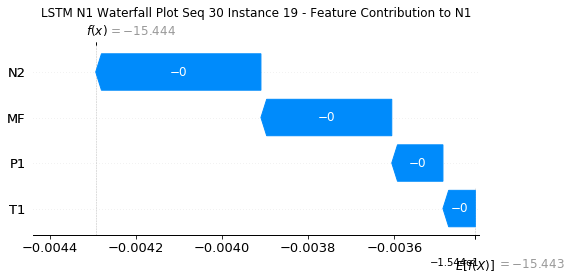

None

Contribution: [-1.20915641e-04 -6.80599107e-05 -3.71506512e-04 -2.84166270e-04]


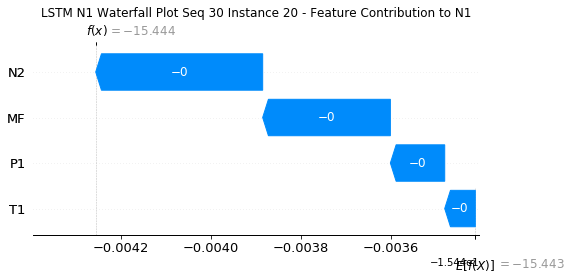

None

Contribution: [-1.12770624e-04 -6.36601407e-05 -3.39493044e-04 -2.13916369e-04]


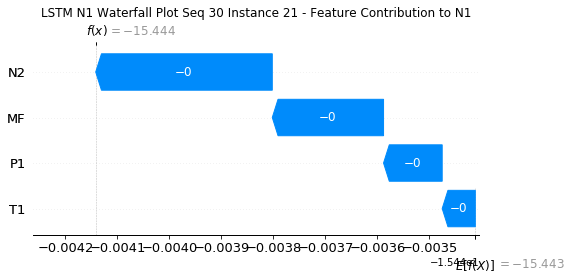

None

Contribution: [-9.70056419e-05 -1.22041596e-04 -3.63224446e-04 -2.99355332e-04]


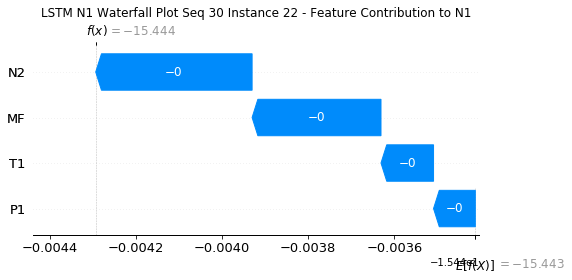

None

Contribution: [ 0.00043792  0.00018089 -0.00251694 -0.00379251]


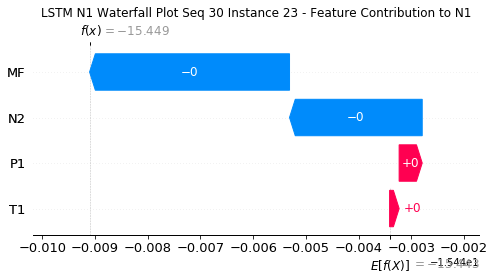

None

Contribution: [ 5.81292499e-05  8.84229988e-03 -1.64522065e-02 -2.26078392e-02]


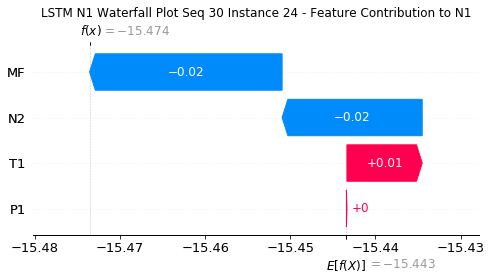

None

Contribution: [-0.05001489 -0.01264872 -0.14698077 -0.08570982]


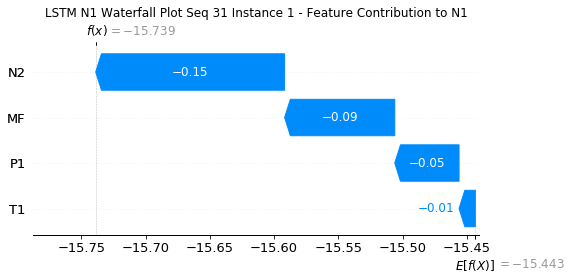

None

Contribution: [0.00065607 0.00028495 0.00187405 0.00177965]


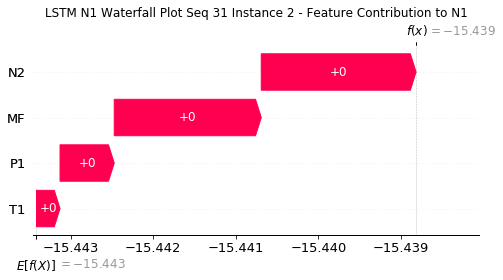

None

Contribution: [-7.40135198e-05 -7.72910382e-05 -3.07340832e-04 -2.58776800e-04]


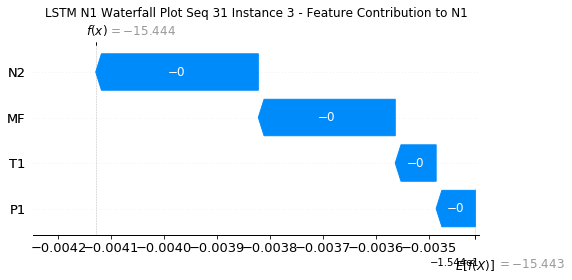

None

Contribution: [-1.64692871e-04 -9.17650435e-05 -5.86980690e-04 -4.97194038e-04]


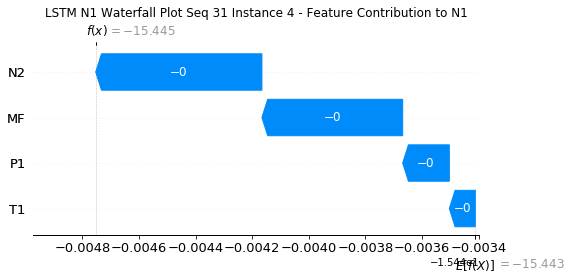

None

Contribution: [-0.00014803 -0.00010669 -0.00049941 -0.00041756]


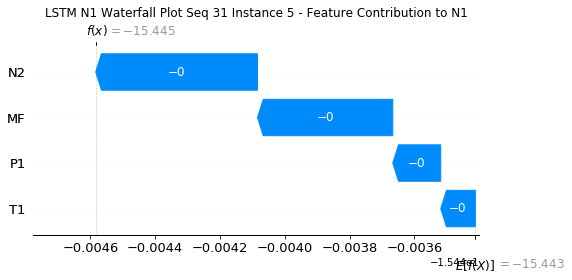

None

Contribution: [-1.42219287e-04 -9.57046993e-05 -4.54635002e-04 -3.73007320e-04]


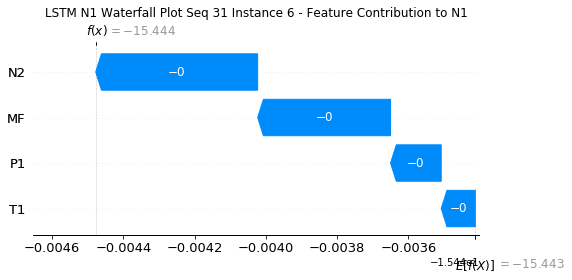

None

Contribution: [-0.00014824 -0.00010095 -0.00049138 -0.00039748]


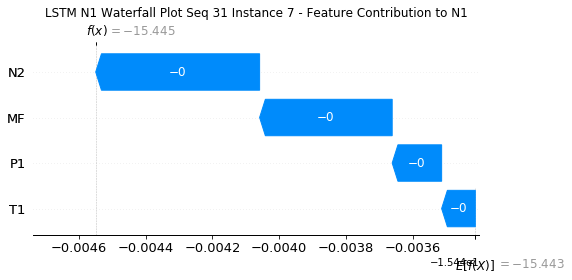

None

Contribution: [-0.00014954 -0.00010008 -0.00051105 -0.00040423]


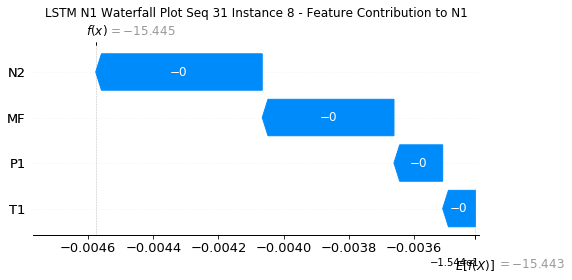

None

Contribution: [-1.45125725e-04 -9.86904064e-05 -4.99829932e-04 -3.95380412e-04]


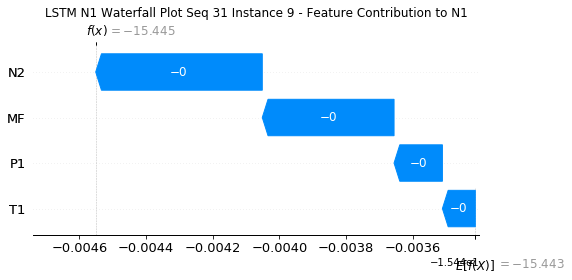

None

Contribution: [-1.46775843e-04 -9.58602418e-05 -4.87426061e-04 -4.05097105e-04]


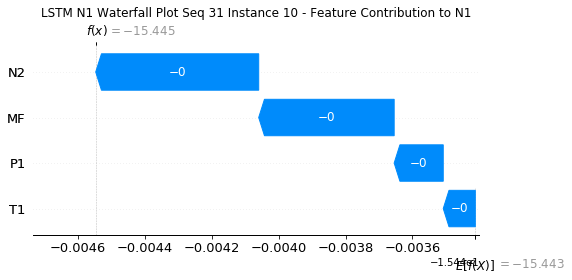

None

Contribution: [-1.43936191e-04 -9.70204107e-05 -4.71167895e-04 -3.89927113e-04]


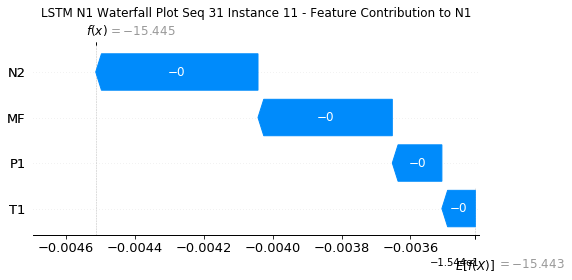

None

Contribution: [-1.39009709e-04 -9.39272635e-05 -4.55187286e-04 -3.74916501e-04]


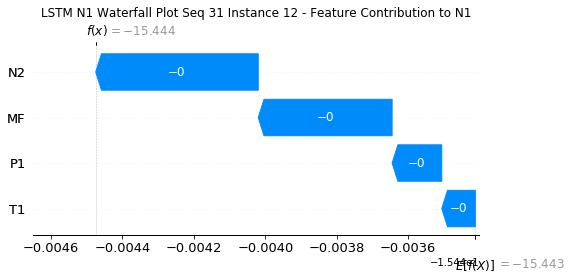

None

Contribution: [-1.34290927e-04 -8.94244349e-05 -4.40617070e-04 -3.63002649e-04]


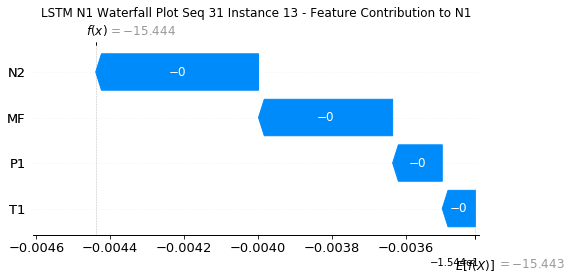

None

Contribution: [-1.30453084e-04 -8.67536307e-05 -4.27335026e-04 -3.50189659e-04]


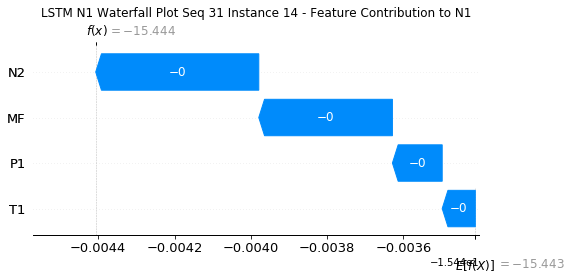

None

Contribution: [-1.24577906e-04 -8.34454932e-05 -4.14420331e-04 -3.32559808e-04]


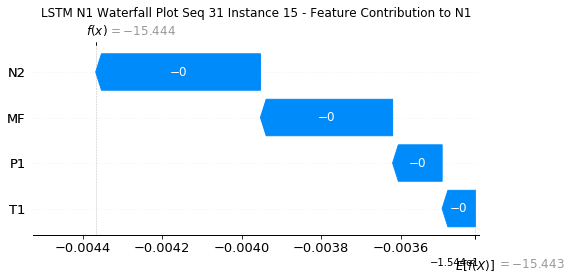

None

Contribution: [-1.22682794e-04 -8.10914348e-05 -4.04333100e-04 -3.26987092e-04]


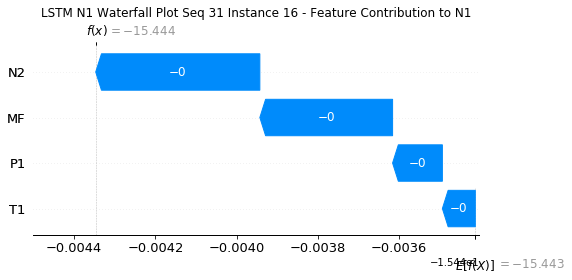

None

Contribution: [-1.20254438e-04 -7.90436899e-05 -3.95770633e-04 -3.18934454e-04]


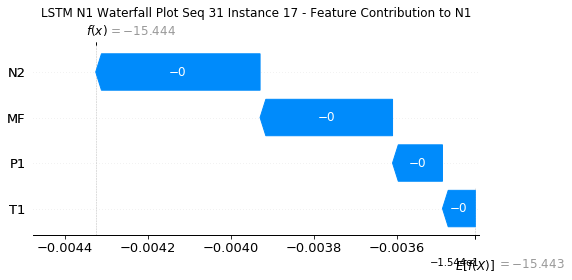

None

Contribution: [-1.20968009e-04 -7.96785833e-05 -3.90962331e-04 -3.16116855e-04]


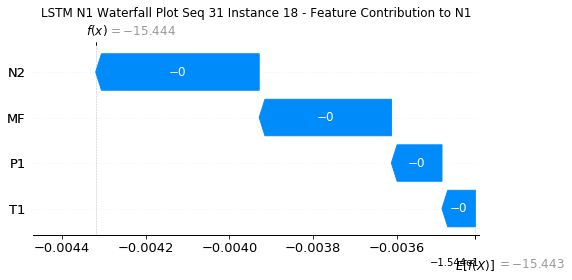

None

Contribution: [-1.18424652e-04 -7.28812879e-05 -3.82607798e-04 -3.02415052e-04]


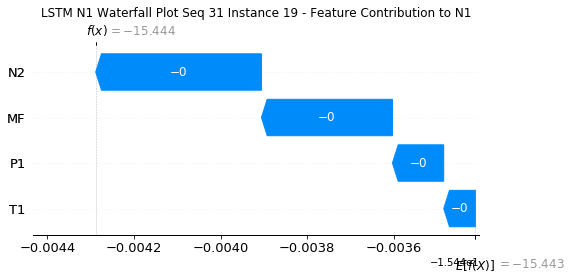

None

Contribution: [-1.20119714e-04 -6.67351321e-05 -3.70432651e-04 -2.82919540e-04]


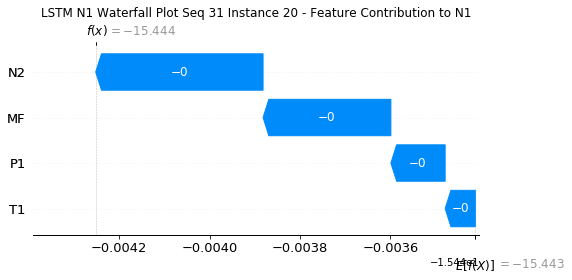

None

Contribution: [-1.12022149e-04 -6.67691411e-05 -3.39075757e-04 -2.13672794e-04]


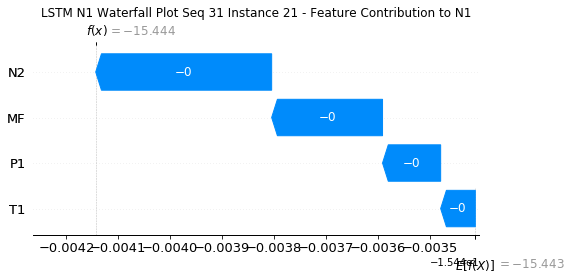

None

Contribution: [-9.75241026e-05 -1.20482705e-04 -3.62733238e-04 -2.98856427e-04]


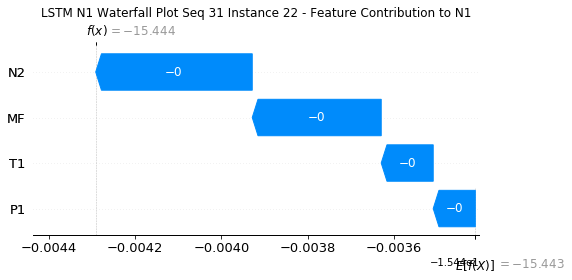

None

Contribution: [ 0.00040184  0.00060184 -0.00249296 -0.00369655]


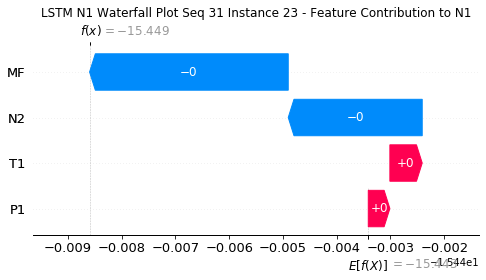

None

Contribution: [ 0.00085834  0.01013641 -0.01826848 -0.02491551]


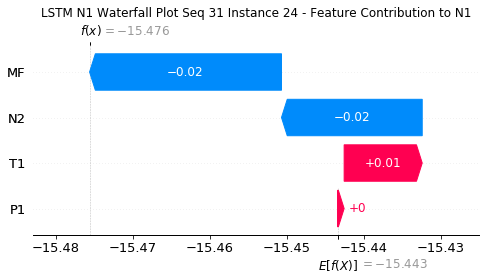

None

Contribution: [-0.05319754 -0.01288639 -0.1476543  -0.09025282]


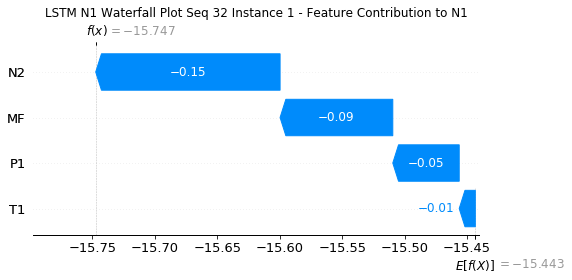

None

Contribution: [0.00066987 0.00027805 0.00186331 0.00180167]


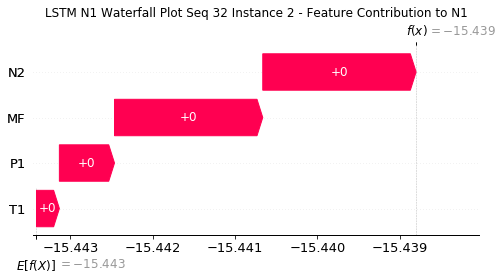

None

Contribution: [-7.49981404e-05 -7.57512240e-05 -3.07192562e-04 -2.60652346e-04]


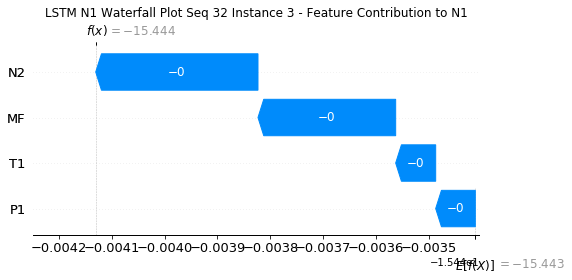

None

Contribution: [-1.57883340e-04 -8.30999940e-05 -5.85614829e-04 -4.88026918e-04]


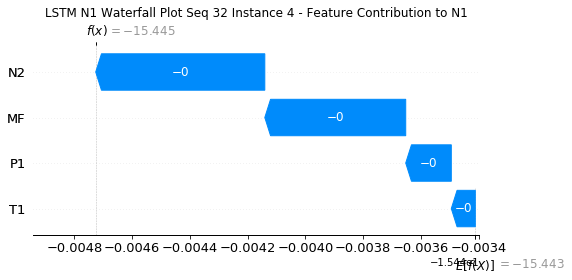

None

Contribution: [-0.00014581 -0.00010369 -0.00049919 -0.00041407]


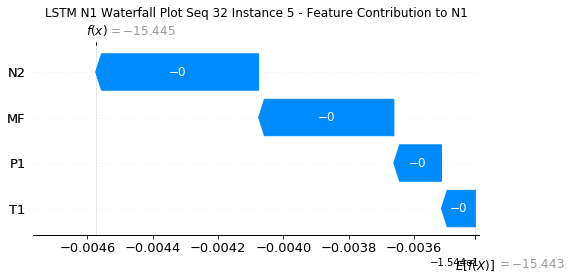

None

Contribution: [-1.36918929e-04 -9.31006398e-05 -4.51826404e-04 -3.67300306e-04]


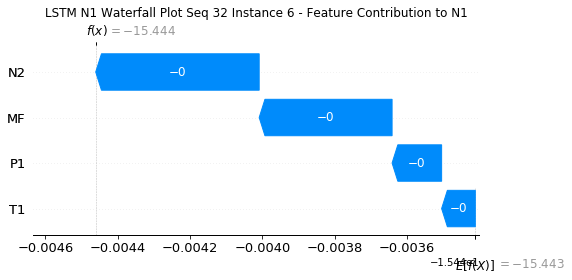

None

Contribution: [-1.46620181e-04 -9.85708916e-05 -4.90568319e-04 -3.95251590e-04]


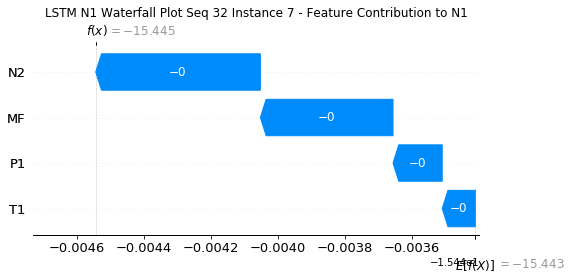

None

Contribution: [-0.00015216 -0.00010312 -0.00051499 -0.00041382]


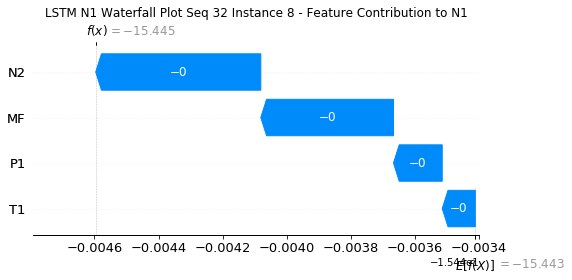

None

Contribution: [-0.00015069 -0.00010403 -0.00050629 -0.00041663]


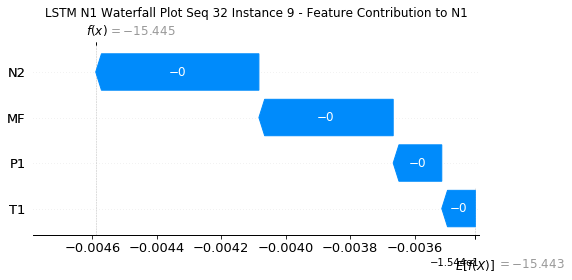

None

Contribution: [-0.0001481  -0.00010085 -0.00048973 -0.00040916]


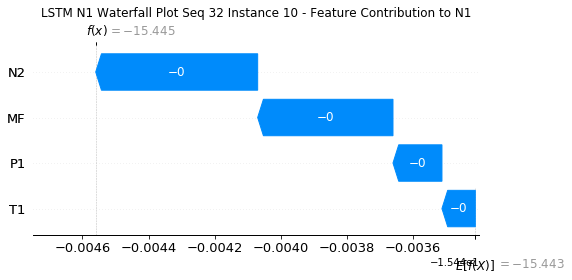

None

Contribution: [-1.42067991e-04 -9.46122333e-05 -4.70490144e-04 -3.88459426e-04]


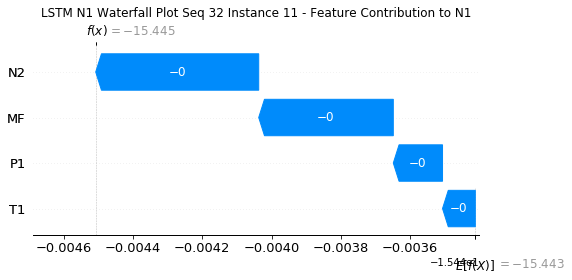

None

Contribution: [-1.37619071e-04 -9.12118968e-05 -4.55208956e-04 -3.74581890e-04]


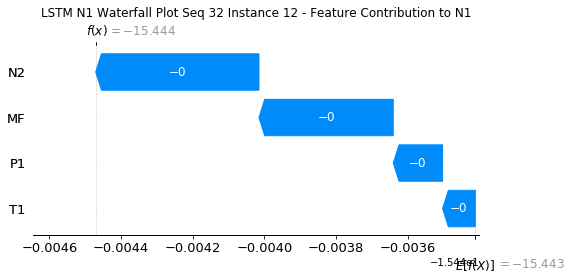

None

Contribution: [-1.31552770e-04 -8.62388397e-05 -4.39328819e-04 -3.56664017e-04]


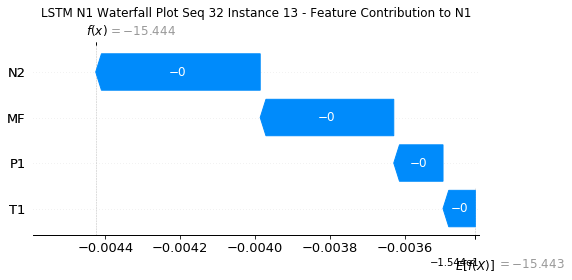

None

Contribution: [-1.29331372e-04 -8.45467114e-05 -4.27781315e-04 -3.50186149e-04]


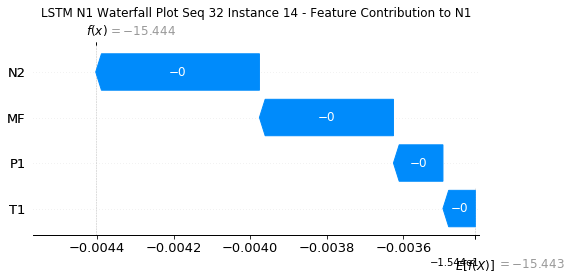

None

Contribution: [-1.20787319e-04 -7.66565568e-05 -4.12324358e-04 -3.33240287e-04]


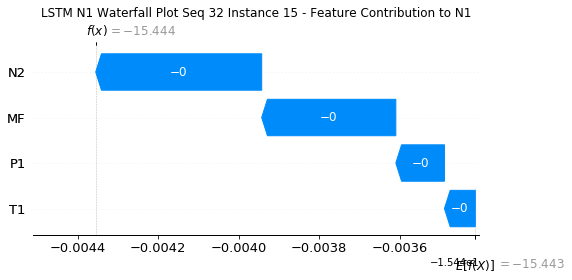

None

Contribution: [-1.21917277e-04 -7.88278698e-05 -4.05102888e-04 -3.27696711e-04]


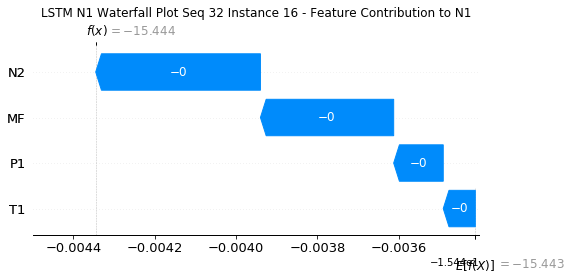

None

Contribution: [-1.19675444e-04 -7.65536513e-05 -3.96727469e-04 -3.19218569e-04]


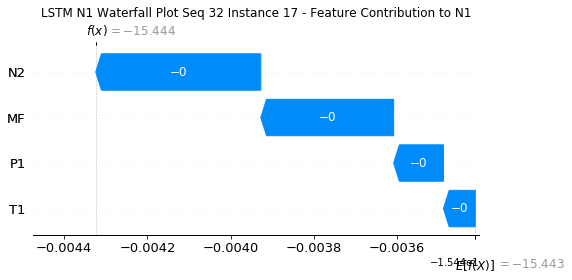

None

Contribution: [-1.18221205e-04 -7.34596407e-05 -3.90989142e-04 -3.12975059e-04]


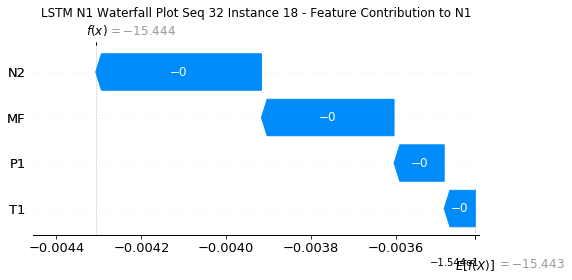

None

Contribution: [-1.18404046e-04 -7.03307975e-05 -3.83827537e-04 -3.03132439e-04]


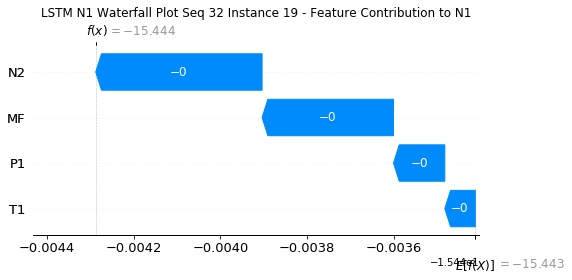

None

Contribution: [-1.20194565e-04 -6.52440573e-05 -3.71314172e-04 -2.83218813e-04]


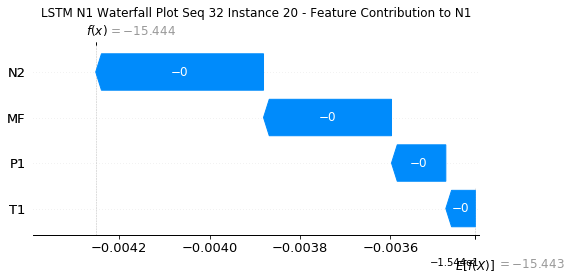

None

Contribution: [-1.12768446e-04 -6.88417288e-05 -3.38314049e-04 -2.13482454e-04]


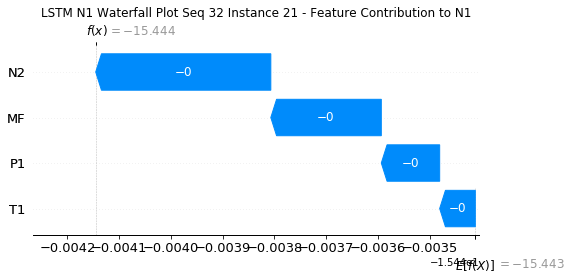

None

Contribution: [-9.70888027e-05 -1.18698392e-04 -3.63491407e-04 -2.98560247e-04]


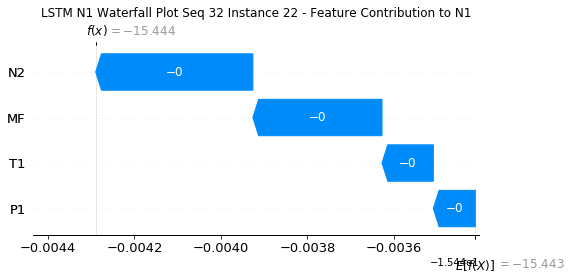

None

Contribution: [ 0.00045731  0.00075662 -0.0026714  -0.00396783]


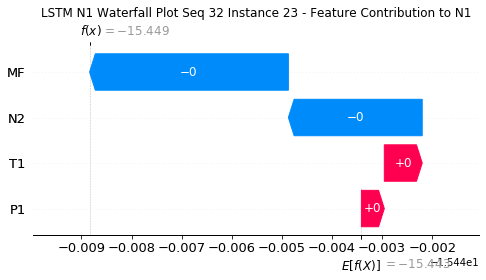

None

Contribution: [ 0.0008183   0.00894871 -0.01812978 -0.02661533]


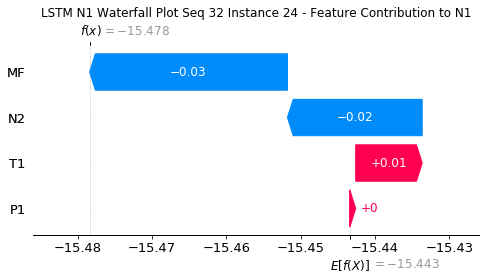

None

Contribution: [-0.04934144 -0.0119689  -0.14849712 -0.0857571 ]


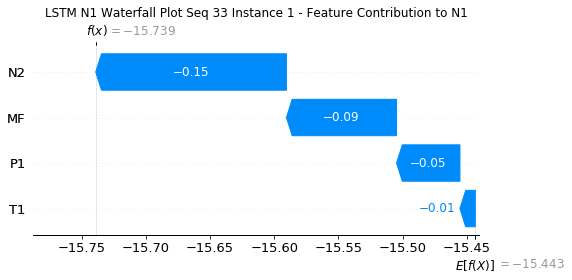

None

Contribution: [0.00066615 0.00028188 0.00188907 0.00181025]


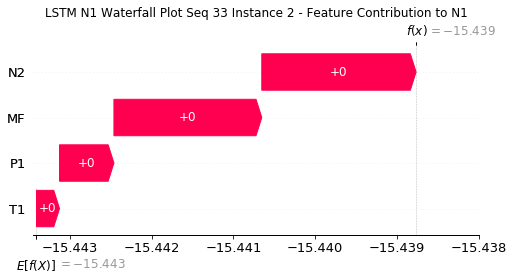

None

Contribution: [-7.47944786e-05 -7.62874555e-05 -3.09090435e-04 -2.61462845e-04]


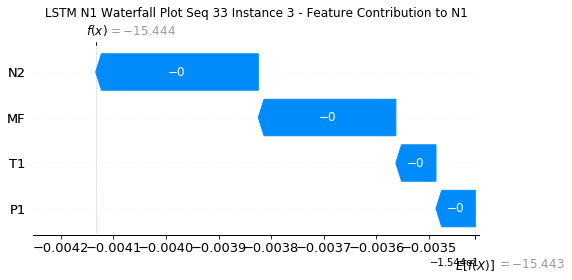

None

Contribution: [-1.50143751e-04 -7.02914795e-05 -5.87719460e-04 -4.90408055e-04]


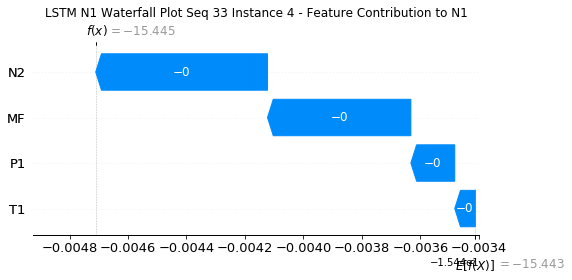

None

Contribution: [-1.43284778e-04 -9.81538313e-05 -4.99771539e-04 -4.14622630e-04]


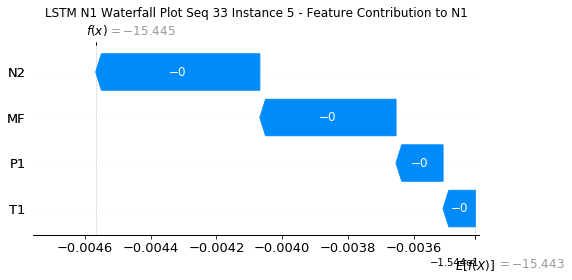

None

Contribution: [-1.38034168e-04 -9.05685784e-05 -4.53839111e-04 -3.69237493e-04]


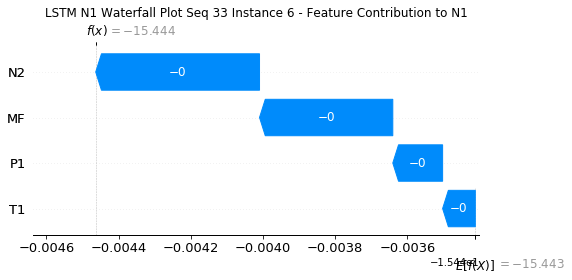

None

Contribution: [-1.43657589e-04 -9.26008976e-05 -4.89352567e-04 -3.92495340e-04]


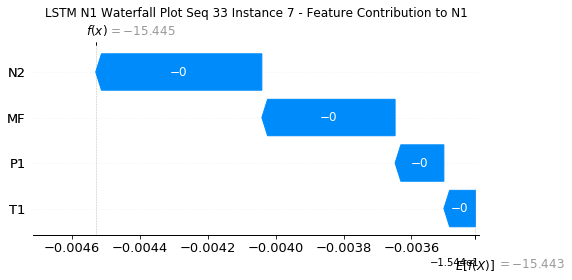

None

Contribution: [-1.50471908e-04 -9.28197196e-05 -5.11430465e-04 -4.03483155e-04]


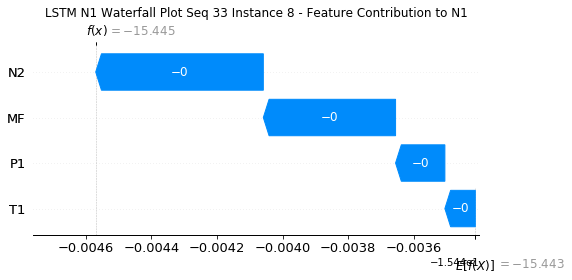

None

Contribution: [-1.48578222e-04 -9.78465605e-05 -5.04001088e-04 -4.08317791e-04]


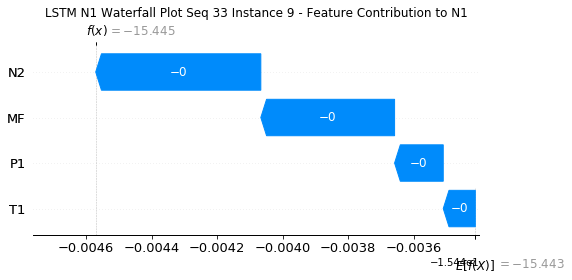

None

Contribution: [-1.47217615e-04 -8.86294809e-05 -4.87746284e-04 -4.03713536e-04]


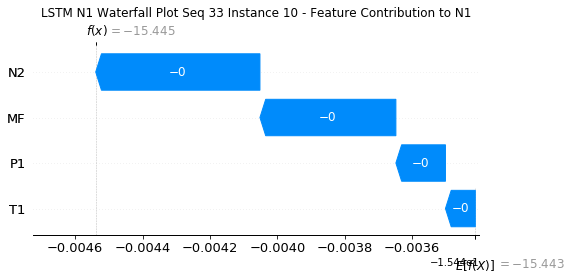

None

Contribution: [-1.40381829e-04 -8.89810724e-05 -4.70577222e-04 -3.88189949e-04]


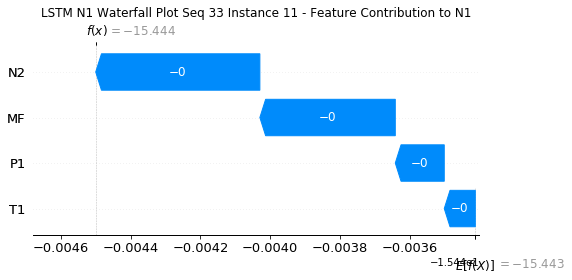

None

Contribution: [-1.35787956e-04 -8.61938574e-05 -4.54954174e-04 -3.73806171e-04]


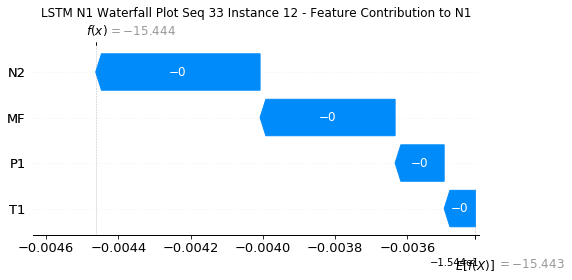

None

Contribution: [-1.34042180e-04 -8.33530236e-05 -4.40880762e-04 -3.63073689e-04]


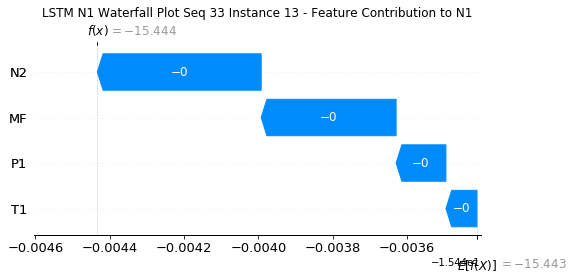

None

Contribution: [-1.27963247e-04 -7.95339722e-05 -4.27136252e-04 -3.49537294e-04]


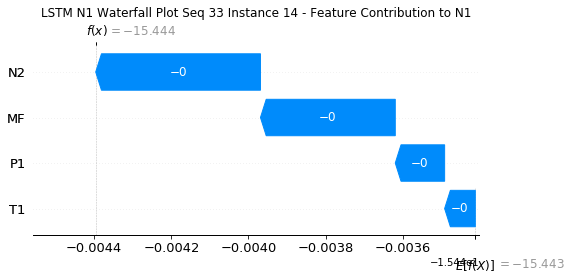

None

Contribution: [-1.22185984e-04 -7.60185609e-05 -4.13019499e-04 -3.32047889e-04]


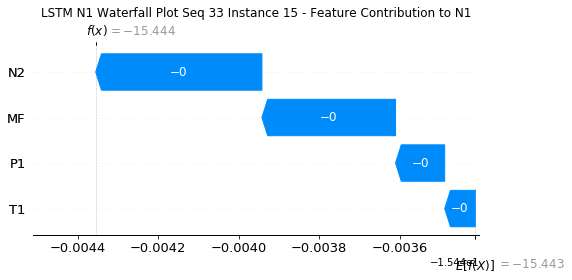

None

Contribution: [-1.20391834e-04 -7.42147326e-05 -4.04154723e-04 -3.26342366e-04]


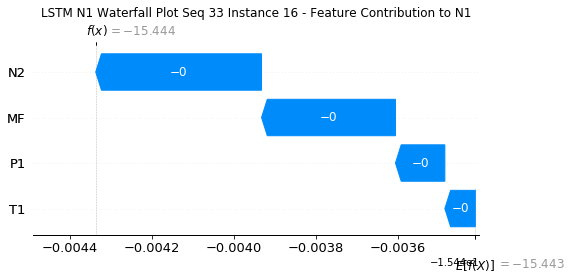

None

Contribution: [-1.17584761e-04 -7.19244474e-05 -3.95524752e-04 -3.17783932e-04]


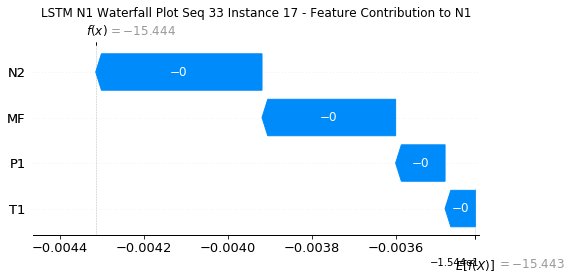

None

Contribution: [-1.19198494e-04 -6.94760734e-05 -3.90518694e-04 -3.14835484e-04]


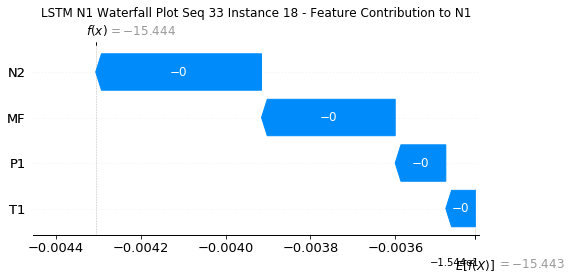

None

Contribution: [-1.16481363e-04 -6.66091068e-05 -3.82677306e-04 -3.02355961e-04]


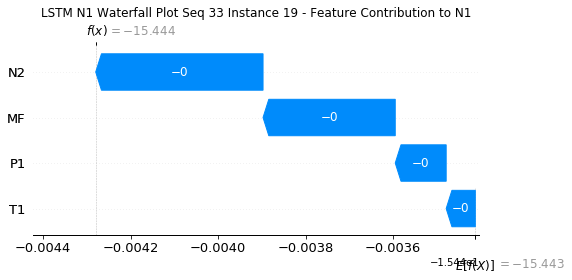

None

Contribution: [-1.17626457e-04 -6.35028206e-05 -3.70225332e-04 -2.82442318e-04]


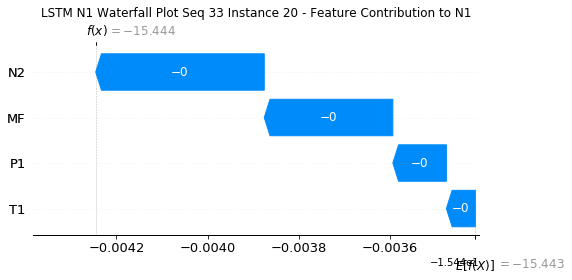

None

Contribution: [-1.08970423e-04 -7.71262713e-05 -3.38578084e-04 -2.10041280e-04]


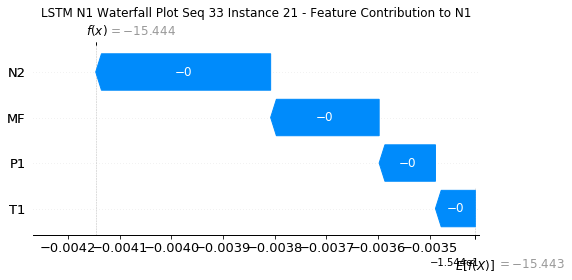

None

Contribution: [-9.98490592e-05 -1.15701298e-04 -3.62191712e-04 -2.99047731e-04]


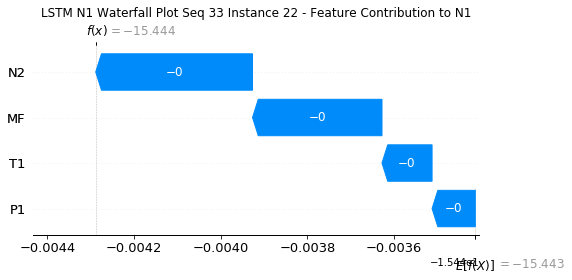

None

Contribution: [ 0.00036743  0.00166317 -0.00248417 -0.0041792 ]


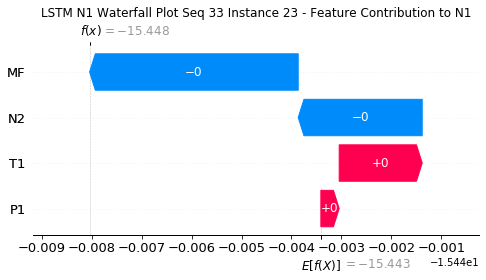

None

Contribution: [-0.0001958   0.02249703 -0.01573728 -0.02712896]


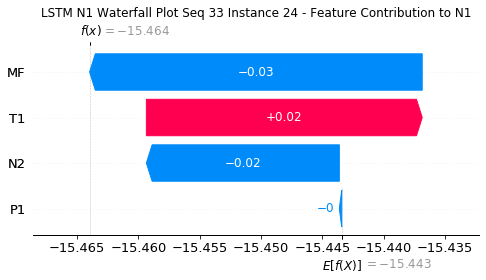

None

Contribution: [-0.04335321 -0.00713663 -0.14693606 -0.08067483]


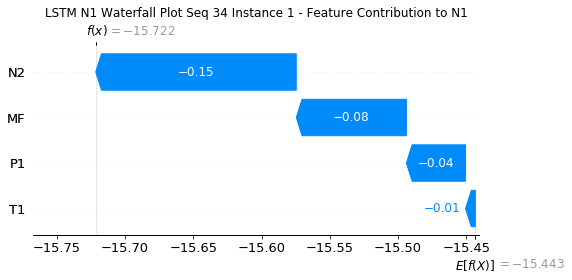

None

Contribution: [0.0006728  0.00027948 0.00192455 0.00183642]


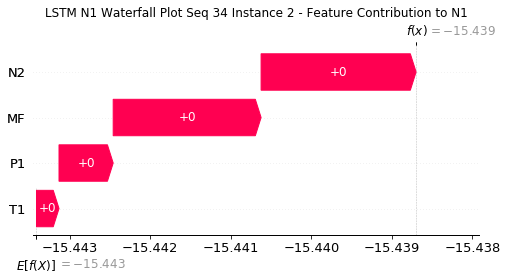

None

Contribution: [-7.47089686e-05 -7.38806924e-05 -3.12078021e-04 -2.63377412e-04]


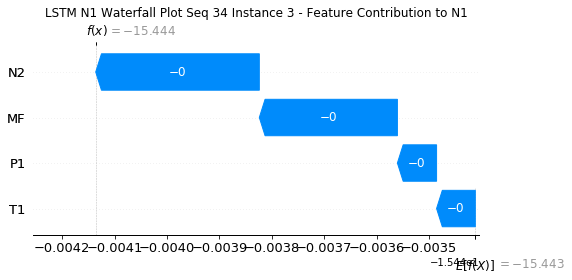

None

Contribution: [-1.48624376e-04 -5.54503045e-05 -5.89922394e-04 -5.00265736e-04]


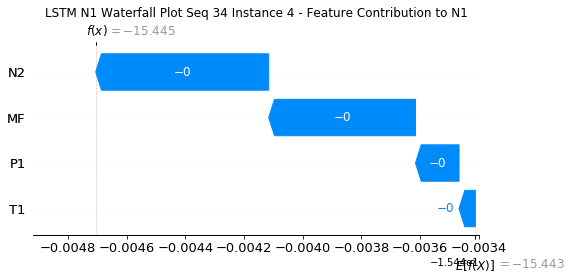

None

Contribution: [-1.42963726e-04 -9.28946143e-05 -5.01698215e-04 -4.18342841e-04]


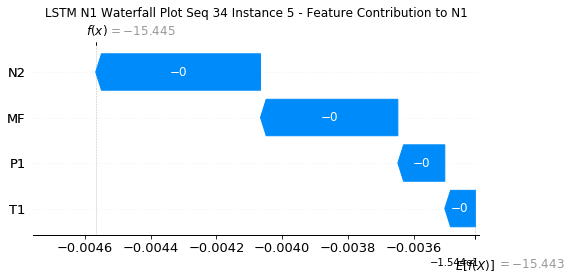

None

Contribution: [-1.34742879e-04 -8.12833678e-05 -4.56613641e-04 -3.73490632e-04]


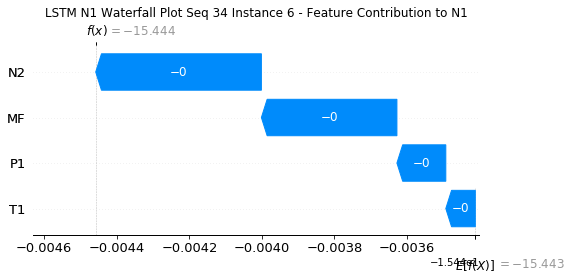

None

Contribution: [-1.41785002e-04 -8.79421677e-05 -4.90035189e-04 -3.93493239e-04]


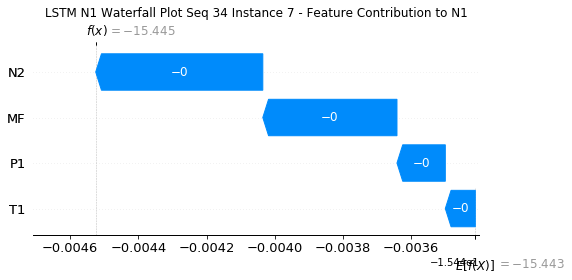

None

Contribution: [-1.43687996e-04 -9.22484160e-05 -5.14754150e-04 -4.08640186e-04]


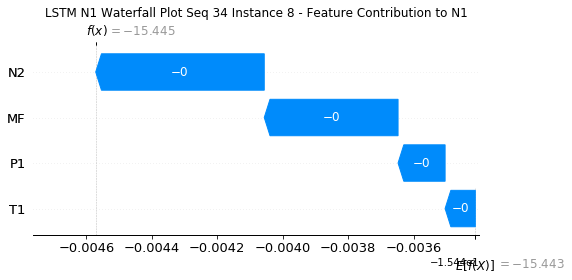

None

Contribution: [-1.36885413e-04 -8.97035903e-05 -5.04081581e-04 -4.01812431e-04]


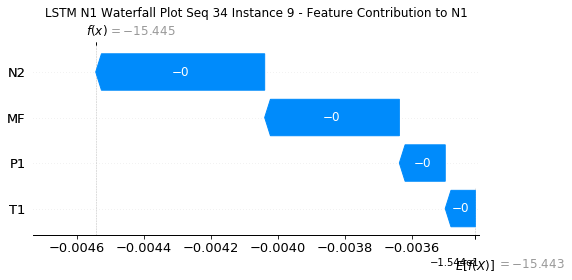

None

Contribution: [-1.39155578e-04 -8.76484983e-05 -4.89990983e-04 -4.02485827e-04]


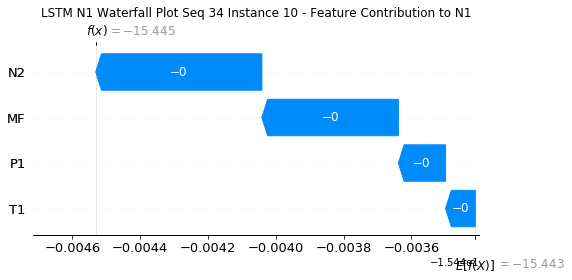

None

Contribution: [-1.38766635e-04 -8.53436363e-05 -4.73307736e-04 -3.89112460e-04]


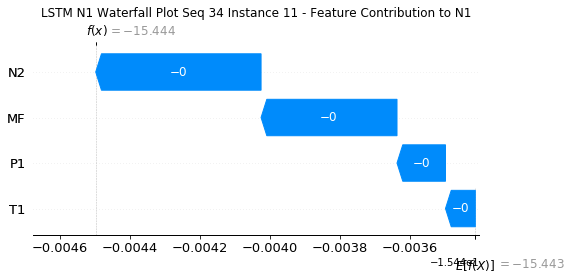

None

Contribution: [-1.34770254e-04 -8.30081995e-05 -4.58020133e-04 -3.76184484e-04]


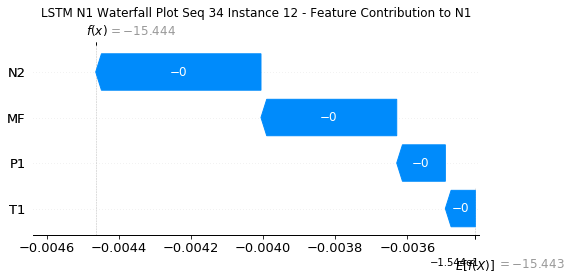

None

Contribution: [-1.28974560e-04 -8.18260680e-05 -4.43111274e-04 -3.60344081e-04]


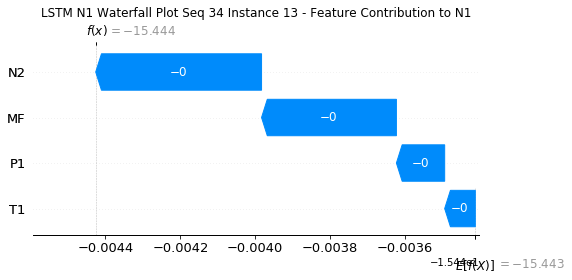

None

Contribution: [-1.26467065e-04 -7.71149595e-05 -4.29793071e-04 -3.50263301e-04]


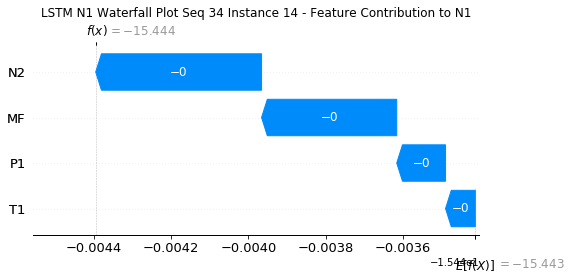

None

Contribution: [-1.19974189e-04 -7.26880005e-05 -4.15984999e-04 -3.34474078e-04]


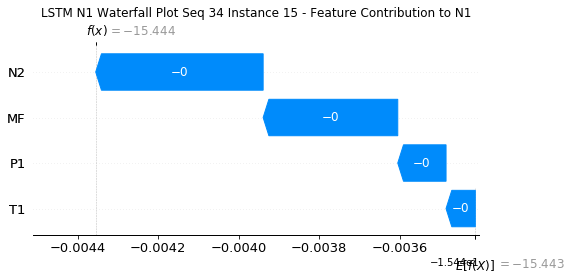

None

Contribution: [-1.19487924e-04 -7.21089005e-05 -4.07057841e-04 -3.28341664e-04]


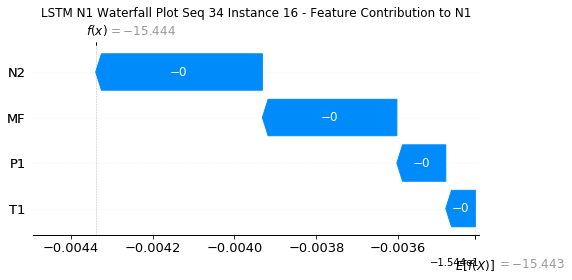

None

Contribution: [-1.17088280e-04 -6.98192209e-05 -3.98237561e-04 -3.19575711e-04]


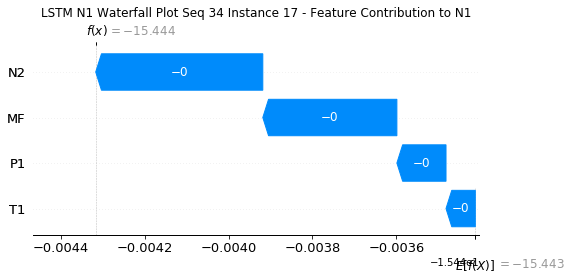

None

Contribution: [-1.17169417e-04 -7.04148450e-05 -3.92829097e-04 -3.16090186e-04]


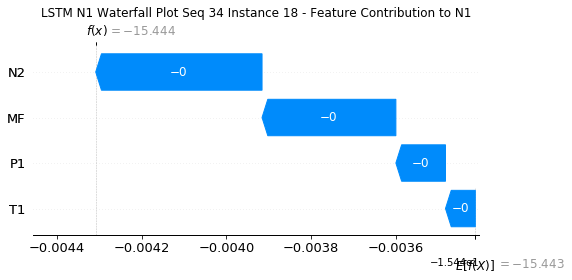

None

Contribution: [-1.16709037e-04 -6.56853506e-05 -3.85040709e-04 -3.04918610e-04]


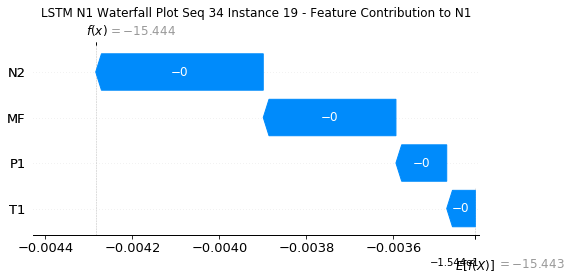

None

Contribution: [-1.17764167e-04 -6.36041023e-05 -3.71999020e-04 -2.83558875e-04]


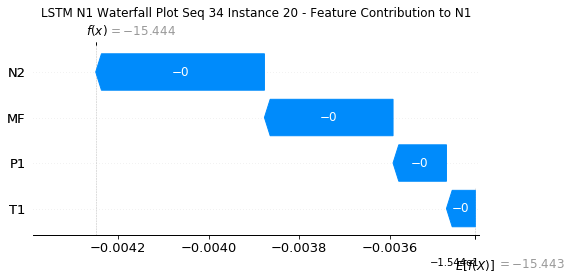

None

Contribution: [-1.07777658e-04 -8.08367204e-05 -3.39221971e-04 -2.10079188e-04]


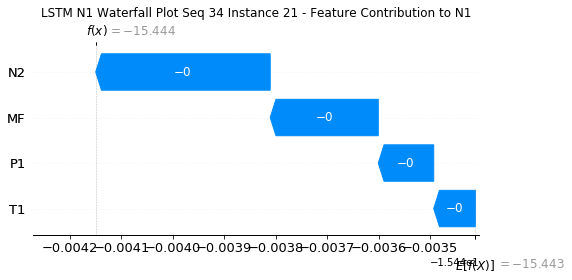

None

Contribution: [-0.00010243 -0.00011066 -0.00036424 -0.00029891]


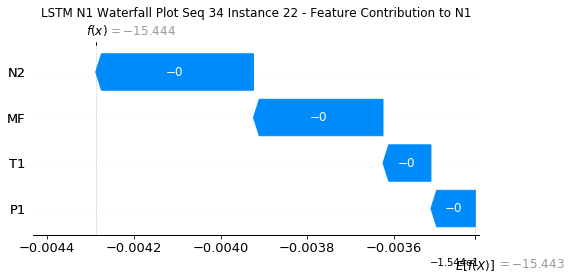

None

Contribution: [ 0.00030661  0.00189913 -0.00251694 -0.00385729]


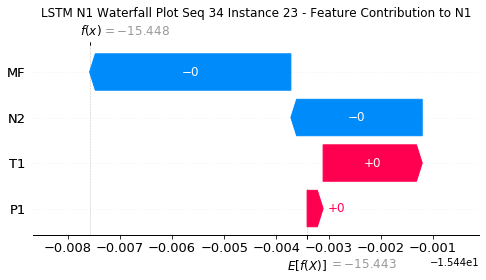

None

Contribution: [-0.0003263   0.02494743 -0.01610243 -0.02485941]


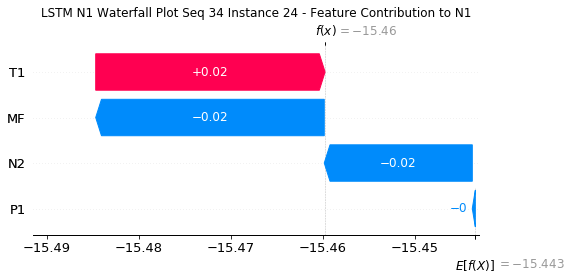

None

In [32]:
#Waterfall Plot for Local Accuracy & Consistency metrics - Full features

for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM N1 Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to N1" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [53]:
# calculate variables for control limit c

std.stack().max(),std.stack().mean(),std.stack().std()

(158.70549597192888, 149.51984909412255, 3.5593427418465975)

In [54]:
#calculate control limit

c = (std.stack().max() - std.stack().mean())/std.stack().std()
c

2.5807143464472304

In [61]:
#Load NaN anomaly testing data

xtest_AD_file = "xNan.csv"
xtest_AD = pd.read_csv(xtest_AD_file, index_col=False)
xtest_AD = xtest_AD.to_numpy()
xtest_AD = xtest_AD.reshape(1,24,4)

In [62]:
#Load NaN anomaly ground truth

ytest_AD_file = "yNan.csv"
ytest_AD = pd.read_csv(ytest_AD_file, index_col=False)

In [63]:
#Prediction

preds_AD = model(xtest_AD)
y_AD = preds_AD[0].sample(1000)
y1_AD = preds_AD[2]
y_AD = tf.keras.backend.get_value(y_AD)
y1_AD = tf.keras.backend.get_value(y1_AD)
tens_draw_AD = y_AD
tens_draw1_AD = y1_AD

#Predicted RUL for each Fleet
mean_Fleet_All_AD = np.zeros(tens_draw_AD.shape[1])
mean_Fleet_AD = np.zeros(tens_draw_AD.shape[0])
for y in range(tens_draw_AD.shape[1]):
    for x in range(tens_draw_AD.shape[0]):
        mean_Fleet_AD[x] = tens_draw_AD[x,y,0]
    mean_Fleet_All_AD[y] = mean_Fleet_AD.mean()
      
mean_Fleet_All_AD, tens_draw1_AD

(array([5070.9583252]), array([[nan]], dtype=float32))

In [64]:
#Calculate Mean and Std for predictions with AU

Fleet_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[0])))
mean_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
std_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
for z in range(tens_draw_AD.shape[1]):
    for y in range(tens_draw_AD.shape[0]):
        for x in range(pad):
            Fleet_AD[y][x] = tens_draw_AD[y,z,x]
    row_Mean_AD = Fleet_AD.mean(axis=1)
    row_Std_AD = Fleet_AD.std(axis=1)
    for j in range(pad):
        mean_AD[z][j] = row_Mean_AD[j]
    for k in range(pad):
        std_AD[z][k] = row_Std_AD[k]

In [65]:
hour_NUM2 = ['3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am','12pm','1pm','2pm']

invalid value encountered in greater
invalid value encountered in less
invalid value encountered in less_equal


0


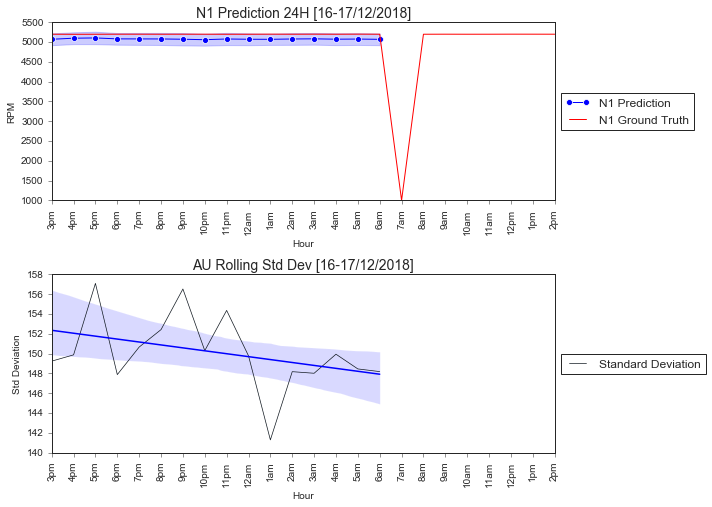

In [66]:
#Visualize prediction

for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD.shape[0])))
    for y in range(tens_draw_AD.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD.shape[0]:
        if(m < (tens_draw_AD.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','RPM']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD['N1'][x]
    max_RUL_Arrange.columns = ['Hour','RPM']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD[B][x]
    min_Std_Arrange.columns = ['Hour','RPM']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['RPM'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="RPM",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="N1 Prediction")
    sns.lineplot(x="Hour", y="RPM", data = max_RUL_Arrange, color='red', ax=ax,label="N1 Ground Truth")
    plt.title('N1 Prediction 24H [16-17/12/2018]',fontsize=14)
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.set_xlabel('Hour')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'RPM', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['RPM'],scatter = False)
    plt.title('AU Rolling Std Dev [16-17/12/2018]',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

In [67]:
#Load Null anomaly testing data

xtest_AD_ALL_file = "xNull.csv"
xtest_AD_ALL = pd.read_csv(xtest_AD_ALL_file, index_col=False)
xtest_AD_ALL = xtest_AD_ALL.to_numpy()
xtest_AD_ALL = xtest_AD_ALL.reshape(1,24,4)

In [68]:
#Load Null anomaly ground truth

ytest_AD_ALL_file = "yNull.csv"
ytest_AD_ALL = pd.read_csv(ytest_AD_ALL_file, index_col=False)

In [69]:
#Prediction

preds_AD_ALL = model(xtest_AD_ALL)
y_AD_ALL = preds_AD_ALL[0].sample(1000)
y1_AD_ALL = preds_AD_ALL[2]
y_AD_ALL = tf.keras.backend.get_value(y_AD_ALL)
y1_AD_ALL = tf.keras.backend.get_value(y1_AD_ALL)
tens_draw_AD_ALL = y_AD_ALL
tens_draw1_AD_ALL = y1_AD_ALL

#Predicted RUL for each Fleet
mean_Fleet_All_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[1])
mean_Fleet_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[0])
for y in range(tens_draw_AD_ALL.shape[1]):
    for x in range(tens_draw_AD_ALL.shape[0]):
        mean_Fleet_AD_ALL[x] = tens_draw_AD_ALL[x,y,0]
    mean_Fleet_All_AD_ALL[y] = mean_Fleet_AD_ALL.mean()
      
mean_Fleet_All_AD_ALL, tens_draw1_AD_ALL

(array([5035.71235449]), array([[-15.862595]], dtype=float32))

In [70]:
#Calculate Mean and Std for predictions with AU

Fleet_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[0])))
mean_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
std_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
for z in range(tens_draw_AD_ALL.shape[1]):
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(pad):
            Fleet_AD_ALL[y][x] = tens_draw_AD_ALL[y,z,x]
    row_Mean_AD_ALL = Fleet_AD_ALL.mean(axis=1)
    row_Std_AD_ALL = Fleet_AD_ALL.std(axis=1)
    for j in range(pad):
        mean_AD_ALL[z][j] = row_Mean_AD_ALL[j]
    for k in range(pad):
        std_AD_ALL[z][k] = row_Std_AD_ALL[k]

In [71]:
hour_NUM3 = ['6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am','12pm','1pm','2pm','3pm','4pm','5pm',]

0


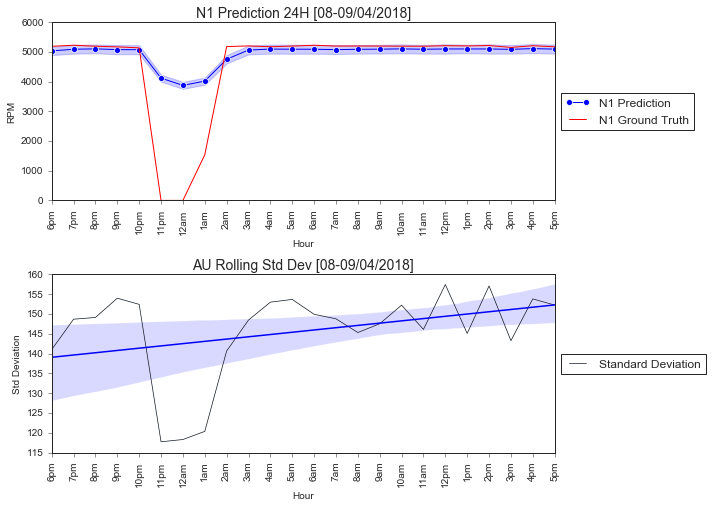

In [72]:
#Visualize anomaly prediction

for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD_ALL.shape[0])))
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD_ALL[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD_ALL.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD_ALL.shape[0]:
        if(m < (tens_draw_AD_ALL.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','RPM']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD_ALL['N1'][x]
    max_RUL_Arrange.columns = ['Hour','RPM']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD_ALL[B][x]
    min_Std_Arrange.columns = ['Hour','RPM']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['RPM'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="RPM",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="N1 Prediction")
    sns.lineplot(x="Hour", y="RPM", data = max_RUL_Arrange, color='red', ax=ax,label="N1 Ground Truth")
    plt.title('N1 Prediction 24H [08-09/04/2018]',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'RPM', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['RPM'],scatter = False)
    plt.title('AU Rolling Std Dev [08-09/04/2018]',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

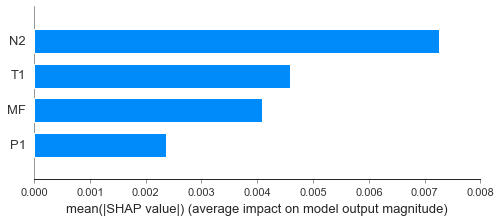

In [73]:
#Summary Plot for anomaly

instance = xtest_AD_ALL
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
shap_values = explainer.shap_values(instance)
shap.summary_plot(shap_values[0][0],feature_names=xtrain.columns,plot_type="bar")

In [74]:
#SHAP Force Plot for anomaly

sns.set_style("ticks")
e = explainer.expected_value
for j in range(24):
    print(j+1)
    xtest_df = pd.DataFrame(data = xtest_AD_ALL[0][j].reshape(1,4),columns=features).round(3)
    disp = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(15, 2),text_rotation=15)
    display(disp)

1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


In [75]:
# Export data for anomaly detection with MATLAB cusum

min_Std_Arrange.to_csv(r'C:\Users\Asus\OneDrive - Universiti Teknologi PETRONAS\New folder\N1_3\AD.csv', index = False)

In [33]:
#Define New LSTM without probabilistic layers for Consistency metric

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 24, 831)           2775540   
_________________________________________________________________
dense_5 (Dense)              (None, 24, 233)           193856    
_________________________________________________________________
dense_6 (Dense)              (None, 24, 1)             234       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 2,969,630
Trainable params: 2,969,630
Non-trainable params: 0
_________________________________________________________________


In [34]:
#Extract only weights for 3 variables excluding MF

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [35]:
#Transfer weights from previous LSTM to new LSTM

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [36]:
#Load xtest and delete MF

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete MF

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [37]:
#Prediction with features excluding MF 

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

Contribution: [-0.10862323  0.00905689 -0.18327498]


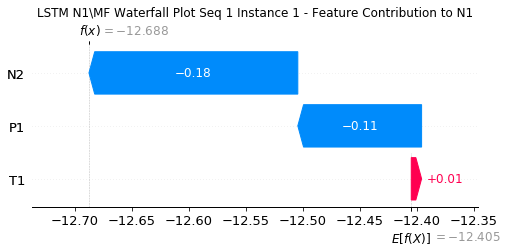

None

Contribution: [0.00200844 0.00135017 0.00565334]


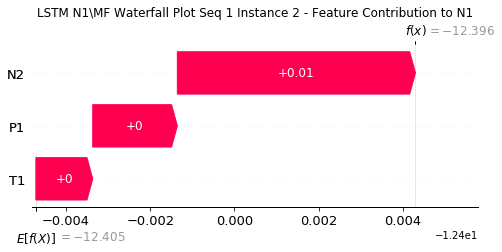

None

Contribution: [-2.30126755e-04  2.39604439e-04 -5.45902912e-05]


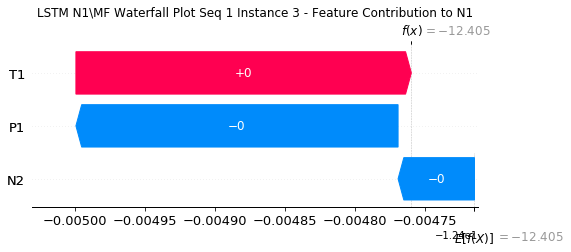

None

Contribution: [-2.40149011e-04 -4.39196219e-04 -9.29271871e-05]


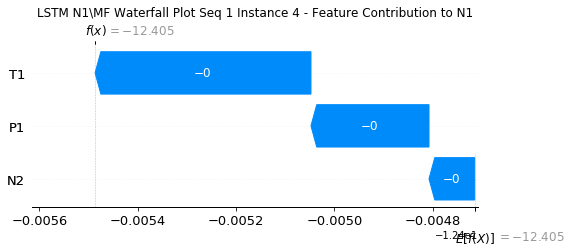

None

Contribution: [-0.00047688 -0.00105798 -0.00015558]


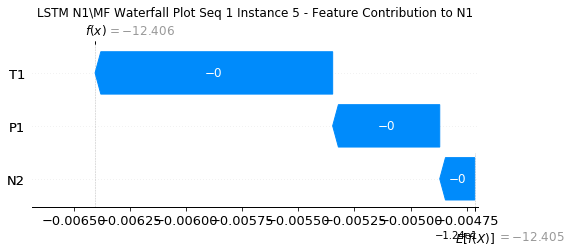

None

Contribution: [-0.00047243 -0.00065552 -0.0003926 ]


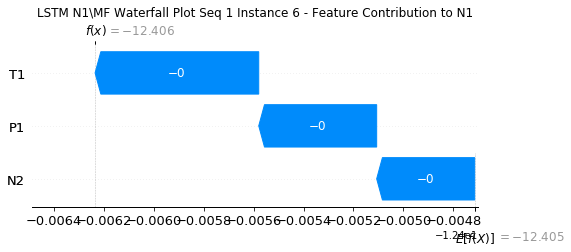

None

Contribution: [-2.54640809e-04  4.49865988e-05 -6.27869354e-04]


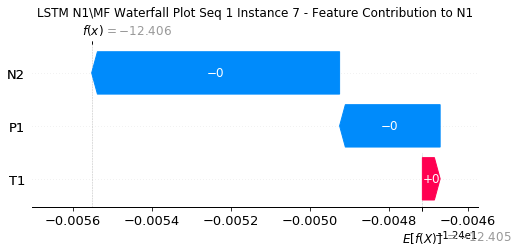

None

Contribution: [-9.87671253e-05  2.53268775e-04 -8.54255665e-04]


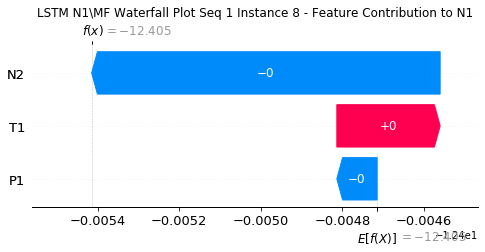

None

Contribution: [-1.81454350e-04  2.25151852e-05 -1.00559091e-03]


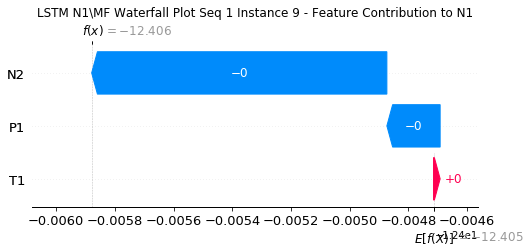

None

Contribution: [-2.18616765e-04  5.77460340e-05 -1.01865647e-03]


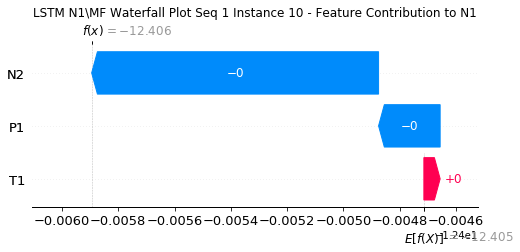

None

Contribution: [-2.46954139e-04  5.66286297e-05 -1.04679487e-03]


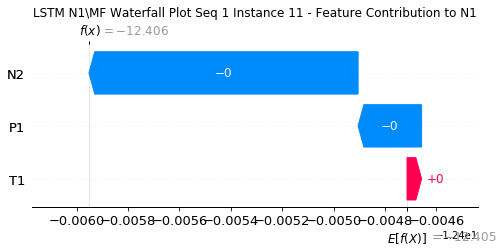

None

Contribution: [-2.65316994e-04  8.70102021e-05 -1.06138962e-03]


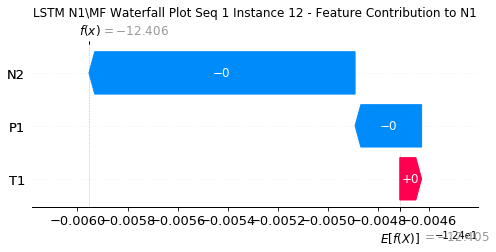

None

Contribution: [-2.50681772e-04  8.93266111e-05 -1.06325460e-03]


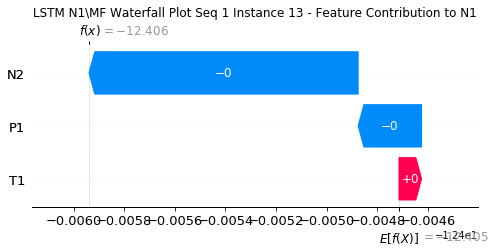

None

Contribution: [-0.00021843  0.00014348 -0.00099906]


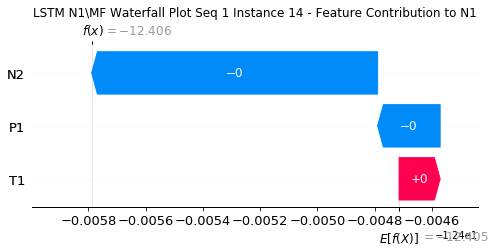

None

Contribution: [-0.00022064  0.0001711  -0.00094525]


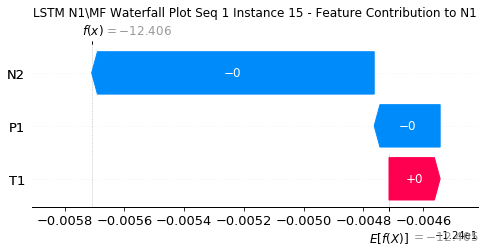

None

Contribution: [-0.00020531  0.00018609 -0.00088134]


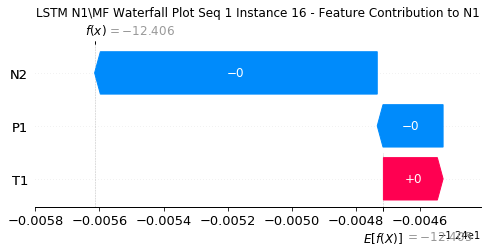

None

Contribution: [-0.00019051  0.00018435 -0.0008375 ]


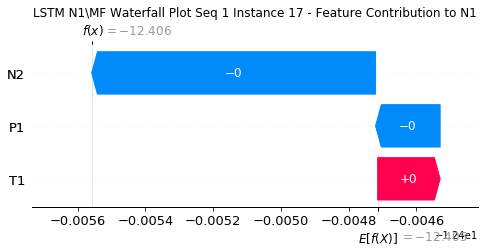

None

Contribution: [-0.00018951  0.00020206 -0.00079883]


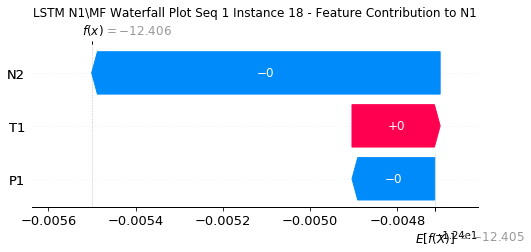

None

Contribution: [-0.00018332  0.00020759 -0.00077286]


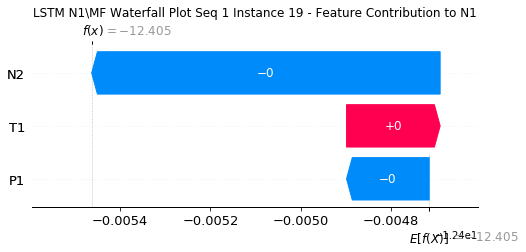

None

Contribution: [-0.00017515  0.00020995 -0.00075987]


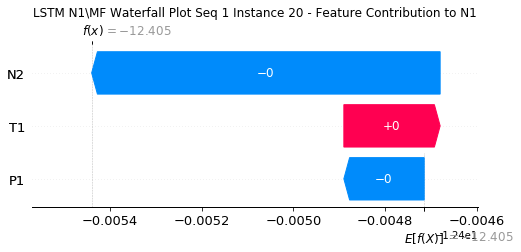

None

Contribution: [-0.00016025  0.0002146  -0.00076395]


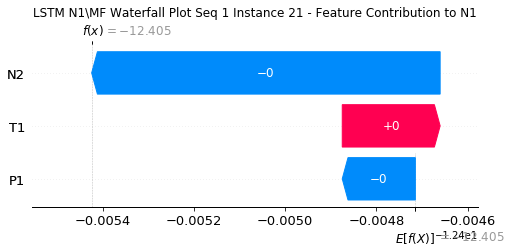

None

Contribution: [-0.00019098  0.00024262 -0.0007844 ]


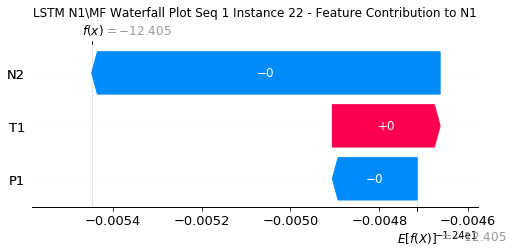

None

Contribution: [-0.00022707  0.00052792 -0.00094826]


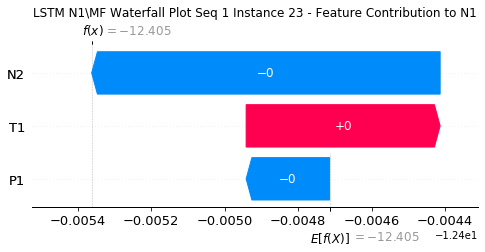

None

Contribution: [-0.00118865  0.00463275 -0.00718441]


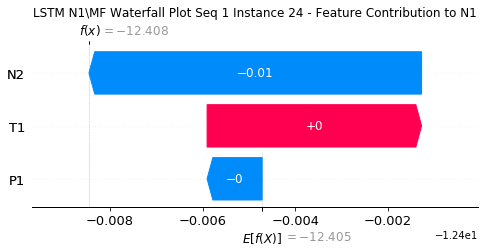

None

Contribution: [-0.06548052  0.08494179 -0.17770272]


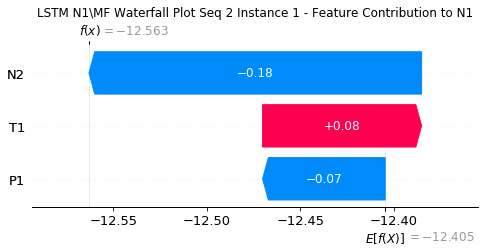

None

Contribution: [0.00180936 0.00230518 0.00548799]


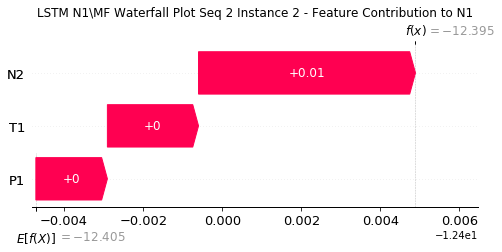

None

Contribution: [-1.03464451e-04  7.06068286e-04 -9.31902425e-05]


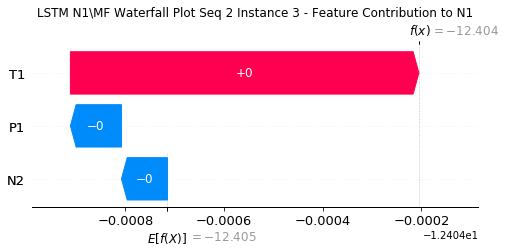

None

Contribution: [-9.88623095e-05  3.05260216e-04 -1.45412271e-04]


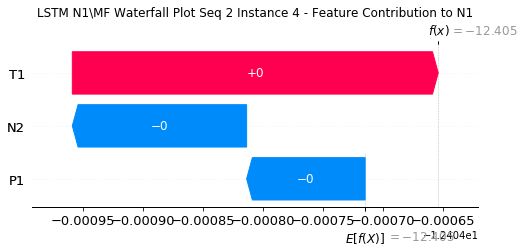

None

Contribution: [-0.0002498   0.00038302 -0.00036555]


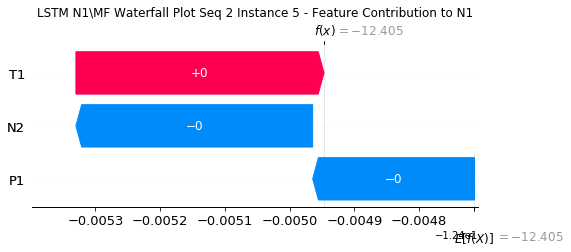

None

Contribution: [-0.00026345  0.00054857 -0.00049553]


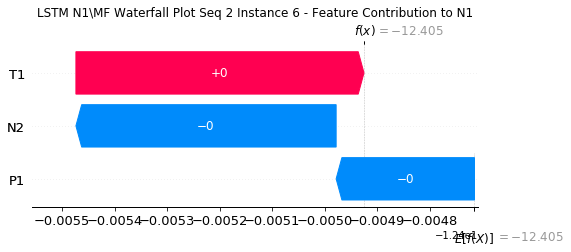

None

Contribution: [-0.00021327  0.00043401 -0.00065518]


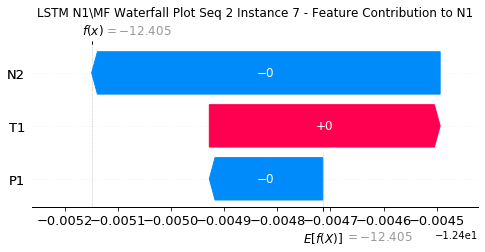

None

Contribution: [-0.00018813  0.00011794 -0.00077469]


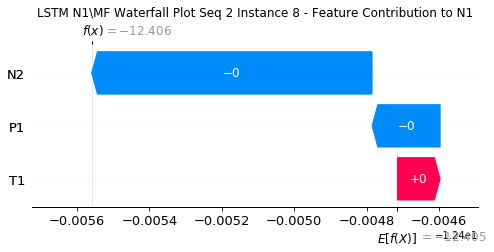

None

Contribution: [-2.09496000e-04  2.27840836e-05 -8.70963222e-04]


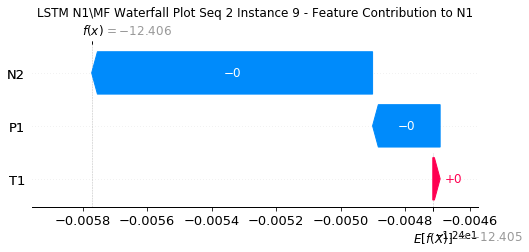

None

Contribution: [-2.26225126e-04  2.52852120e-05 -9.57480065e-04]


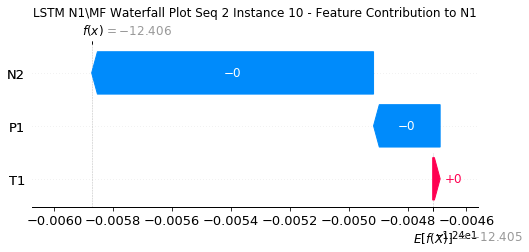

None

Contribution: [-2.40535034e-04  3.19980984e-05 -9.63659456e-04]


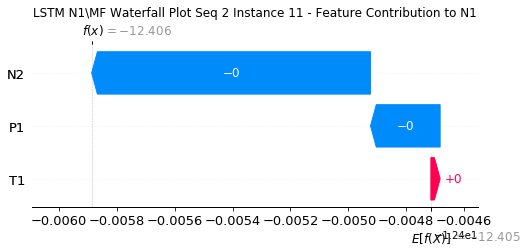

None

Contribution: [-2.47883892e-04  7.75817220e-05 -9.64438075e-04]


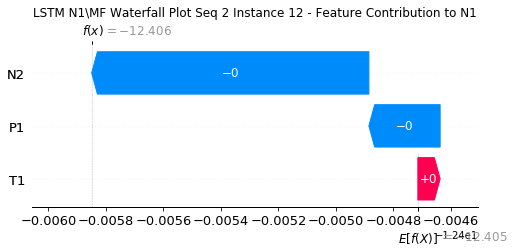

None

Contribution: [-2.49046777e-04  5.04015747e-05 -9.85057862e-04]


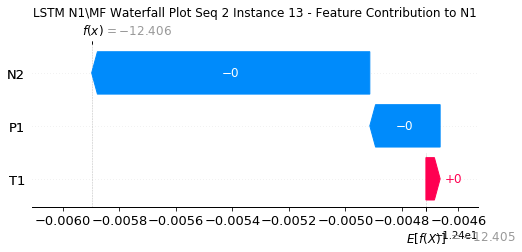

None

Contribution: [-2.30011014e-04  7.92964859e-05 -9.74371178e-04]


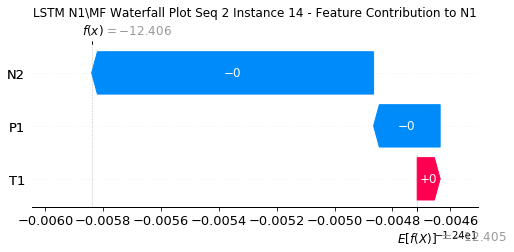

None

Contribution: [-0.00022774  0.00010808 -0.00094094]


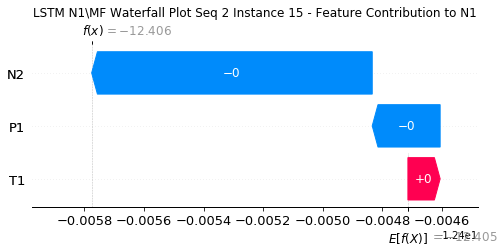

None

Contribution: [-0.0002134   0.0001231  -0.00088352]


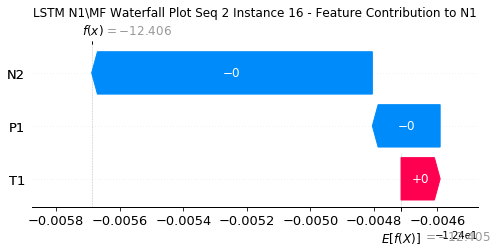

None

Contribution: [-0.00018806  0.00015688 -0.00082875]


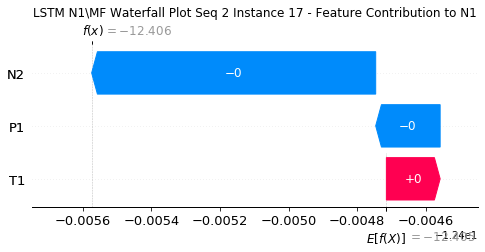

None

Contribution: [-0.00019201  0.00016512 -0.00079934]


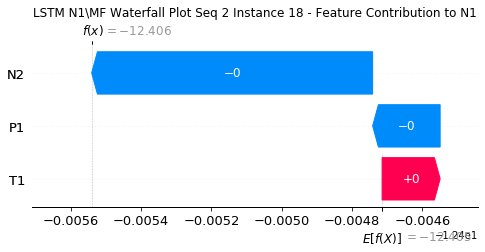

None

Contribution: [-0.00018609  0.00017231 -0.00077098]


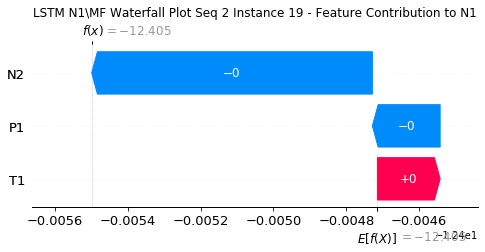

None

Contribution: [-0.00017835  0.00018804 -0.00075633]


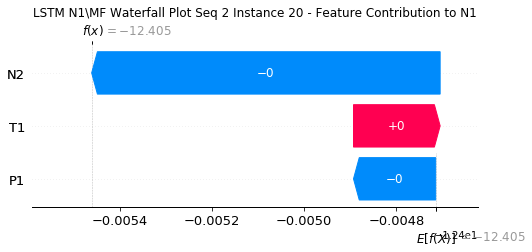

None

Contribution: [-0.00016387  0.00018725 -0.00075584]


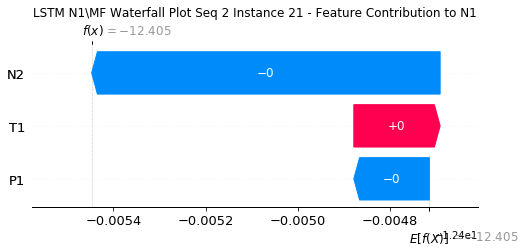

None

Contribution: [-0.00019645  0.00020278 -0.00077153]


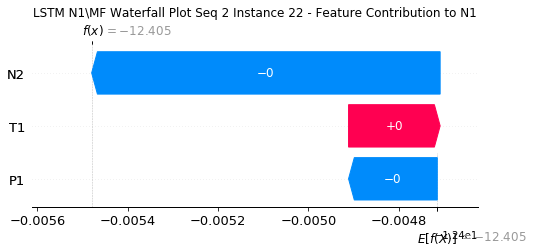

None

Contribution: [-0.00024101  0.00056957 -0.0008957 ]


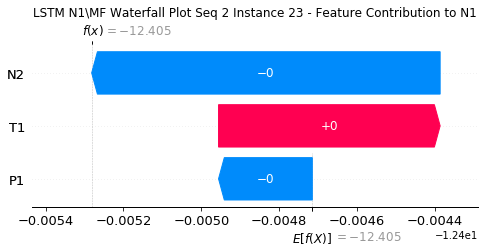

None

Contribution: [-0.00116928  0.01090251 -0.00713827]


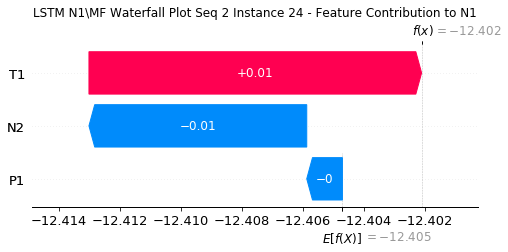

None

Contribution: [-0.11968498 -0.15831578 -0.19467308]


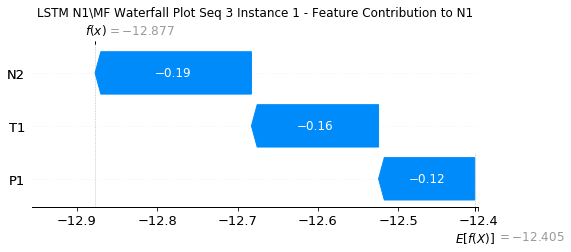

None

Contribution: [ 2.05874107e-03 -1.96211736e-05  5.88102369e-03]


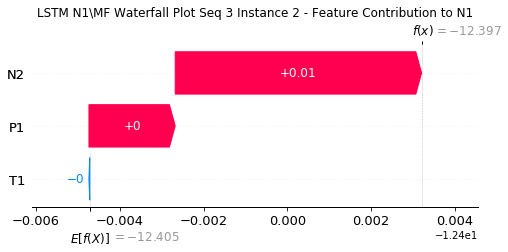

None

Contribution: [-0.00026255 -0.00159459 -0.00011527]


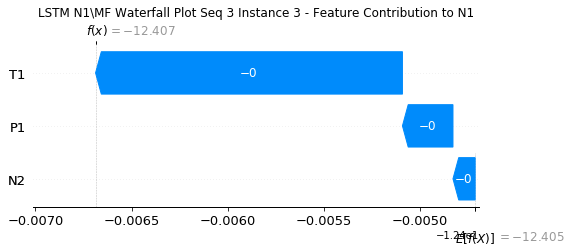

None

Contribution: [-0.00026646 -0.00211626 -0.00010724]


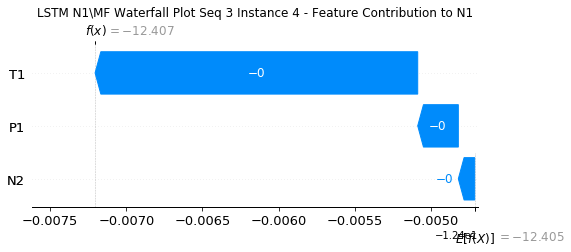

None

Contribution: [-0.00055735 -0.00422595 -0.000153  ]


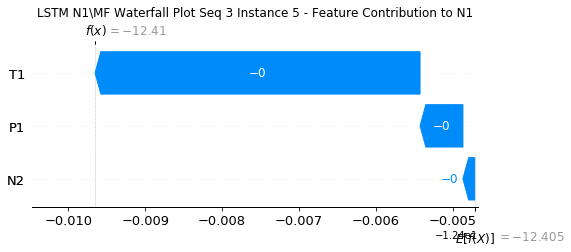

None

Contribution: [-0.00051136 -0.0035362  -0.00039002]


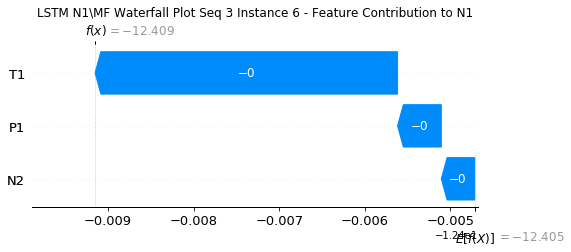

None

Contribution: [-0.00034678 -0.00145558 -0.00058807]


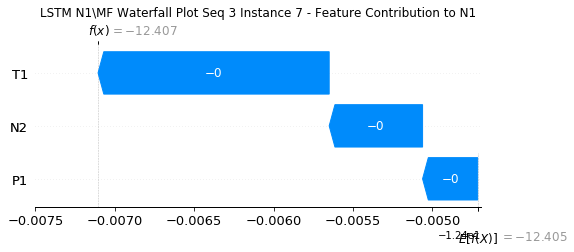

None

Contribution: [-9.60459017e-05  4.82086126e-04 -7.05589223e-04]


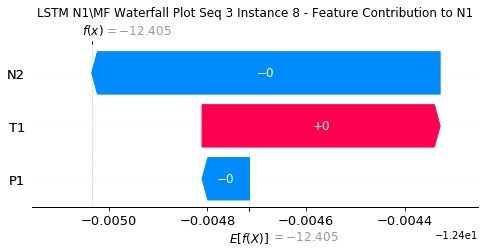

None

Contribution: [ 1.81045896e-05  1.18884561e-03 -8.81938907e-04]


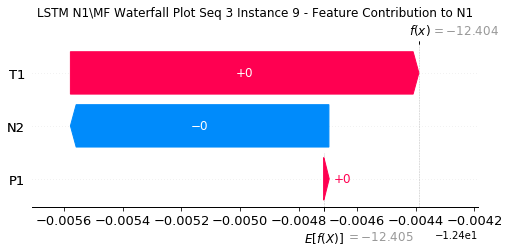

None

Contribution: [-0.00016996  0.00045128 -0.00094812]


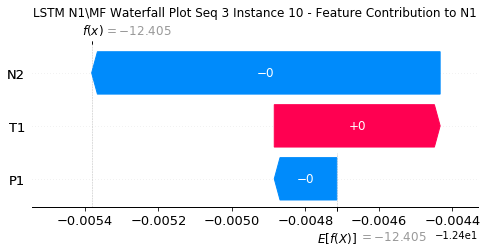

None

Contribution: [-0.00022495  0.00031411 -0.00099882]


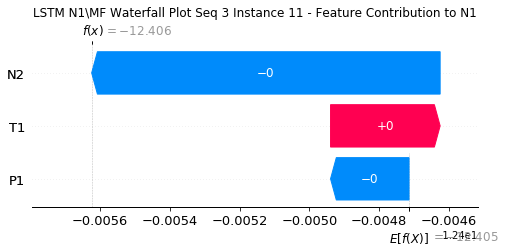

None

Contribution: [-0.0002339   0.00032755 -0.00100185]


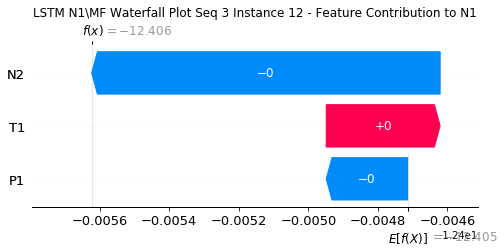

None

Contribution: [-0.00023036  0.00034149 -0.00102041]


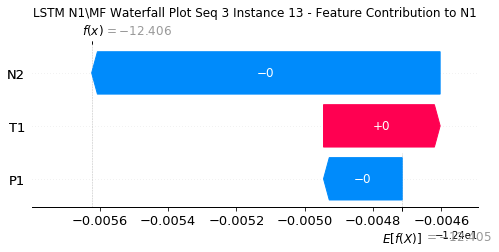

None

Contribution: [-0.00023216  0.00039638 -0.00098696]


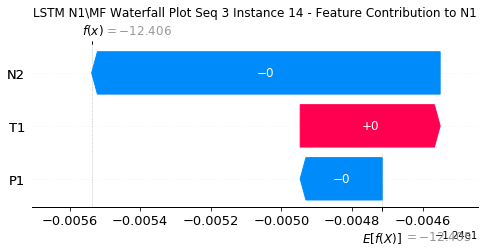

None

Contribution: [-0.00019777  0.00042642 -0.00092163]


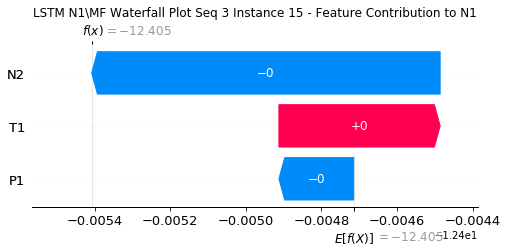

None

Contribution: [-0.00018439  0.00041728 -0.00084353]


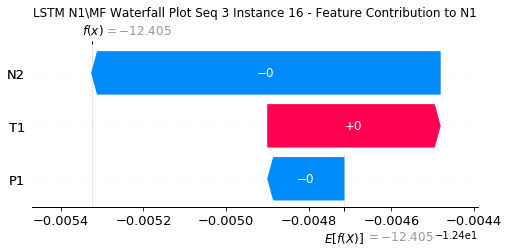

None

Contribution: [-0.00018698  0.00039027 -0.00078698]


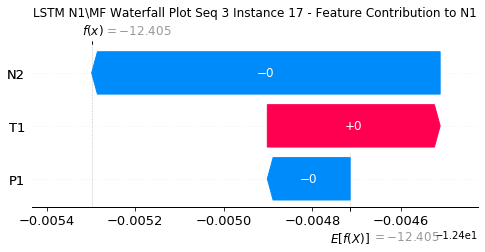

None

Contribution: [-0.00016382  0.00038049 -0.00075552]


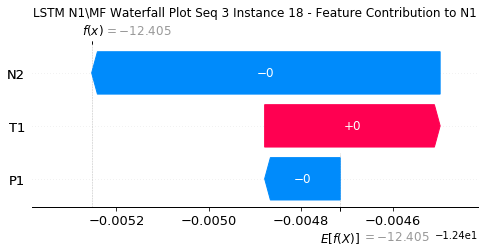

None

Contribution: [-0.00015874  0.00037827 -0.00072809]


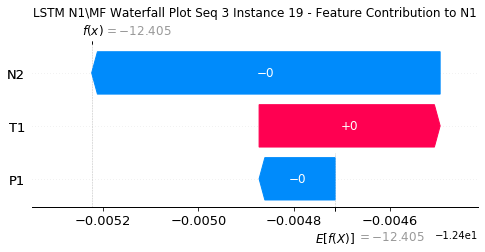

None

Contribution: [-0.00014961  0.00037379 -0.00071274]


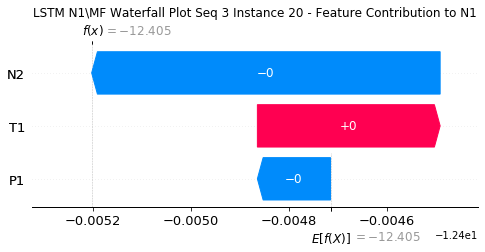

None

Contribution: [-0.00013703  0.00038796 -0.00071392]


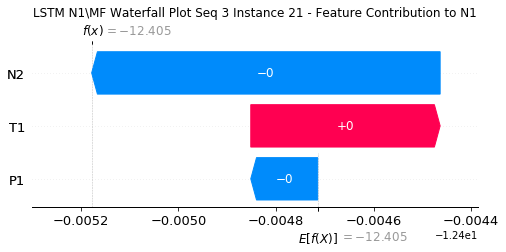

None

Contribution: [-0.00017225  0.00043797 -0.00072988]


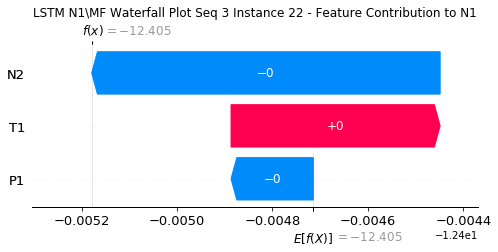

None

Contribution: [-0.00022627  0.00129845 -0.00086817]


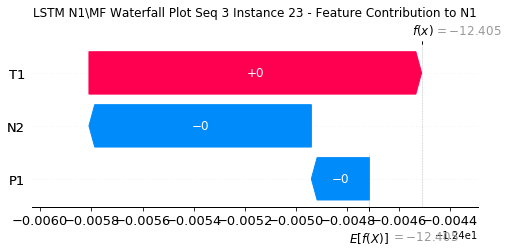

None

Contribution: [-0.00121248  0.01930402 -0.00661785]


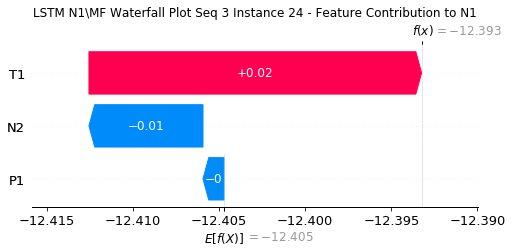

None

Contribution: [-0.11216597 -0.23601353 -0.21826375]


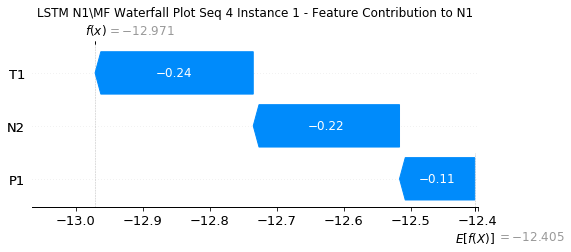

None

Contribution: [ 0.00202988 -0.00035459  0.00618098]


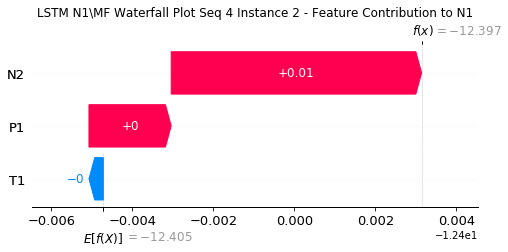

None

Contribution: [-0.00021834 -0.00175046 -0.00014607]


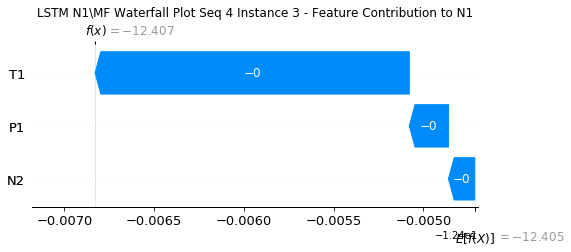

None

Contribution: [-1.48755488e-04 -1.41149559e-03 -6.53602198e-05]


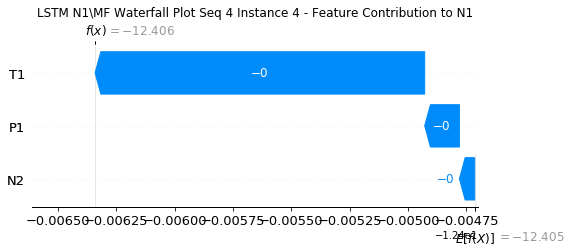

None

Contribution: [-0.00032459 -0.00251209 -0.00019735]


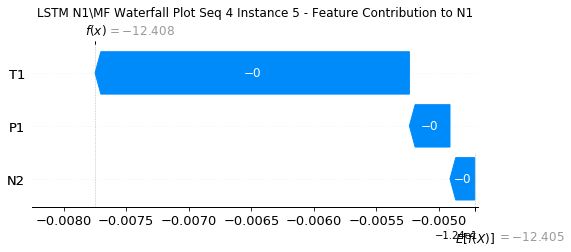

None

Contribution: [-0.00033312 -0.00251728 -0.00029014]


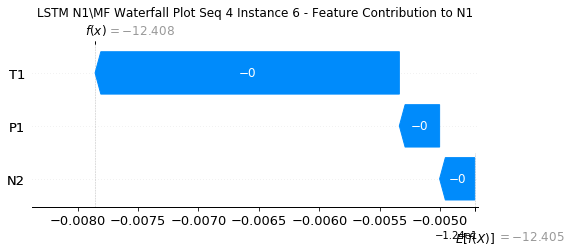

None

Contribution: [-0.00024495 -0.00157093 -0.00043392]


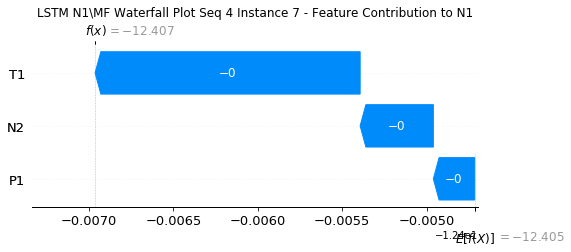

None

Contribution: [-0.00021743 -0.00082945 -0.00059898]


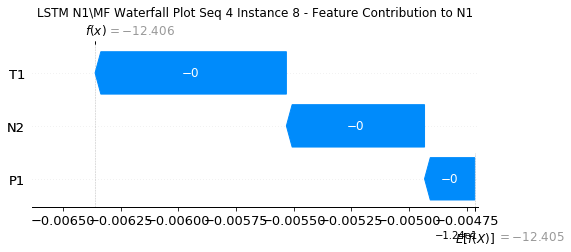

None

Contribution: [-0.0002096  -0.00054368 -0.00075189]


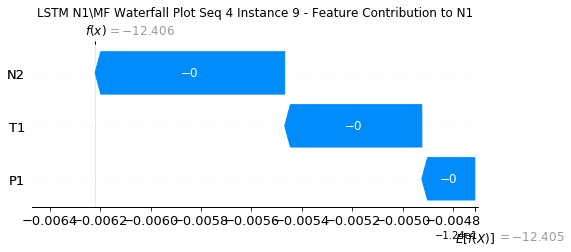

None

Contribution: [-0.00019497 -0.00018875 -0.00083853]


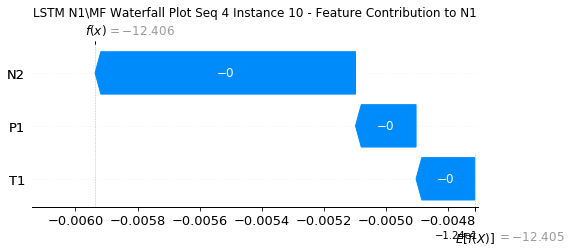

None

Contribution: [-0.00019072  0.0003146  -0.00097366]


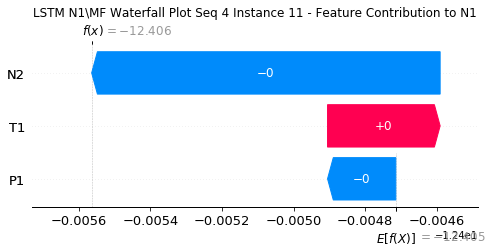

None

Contribution: [-0.00019054  0.00019701 -0.00103134]


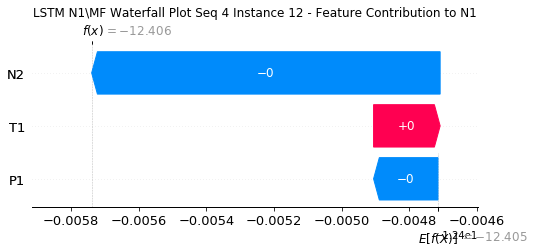

None

Contribution: [-2.40979736e-04  1.03860784e-05 -9.73432519e-04]


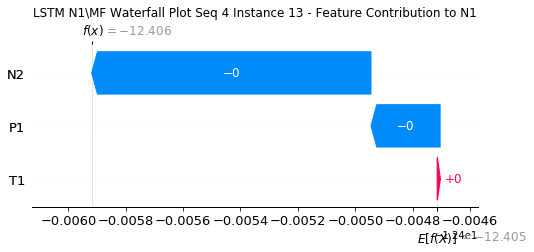

None

Contribution: [-2.56902066e-04  1.43893139e-06 -9.87861082e-04]


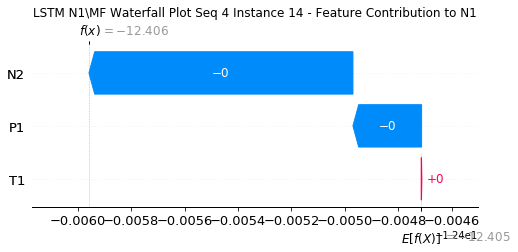

None

Contribution: [-2.49559893e-04 -2.17209760e-05 -9.89730878e-04]


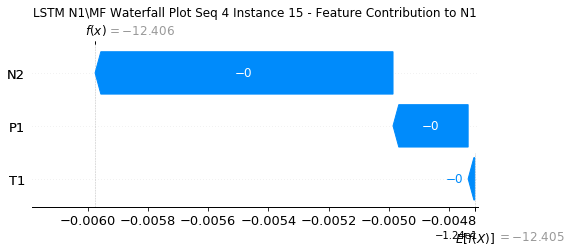

None

Contribution: [-2.47937425e-04 -4.05639577e-05 -9.92938243e-04]


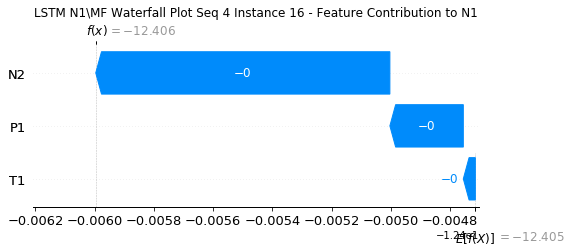

None

Contribution: [-2.58107443e-04 -6.62462471e-05 -9.45975138e-04]


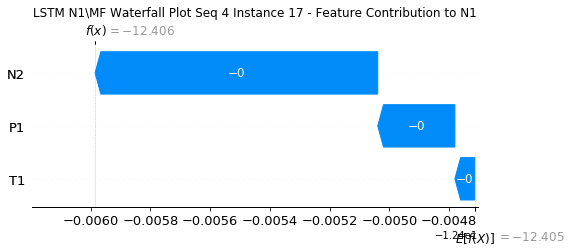

None

Contribution: [-2.22434186e-04 -7.87825184e-05 -8.82326093e-04]


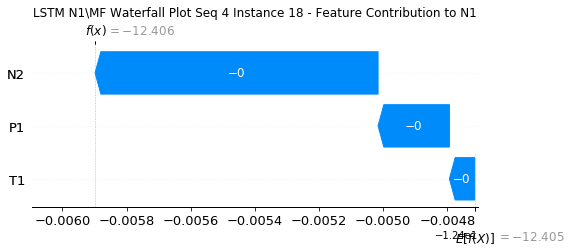

None

Contribution: [-2.07341484e-04 -8.30014202e-05 -8.28149822e-04]


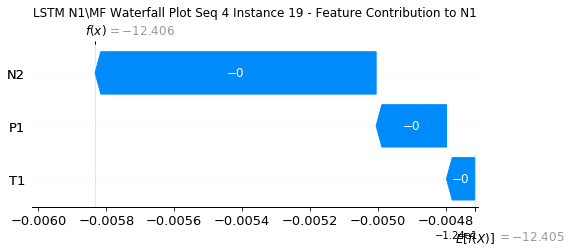

None

Contribution: [-1.93154584e-04 -8.40637220e-05 -7.82485241e-04]


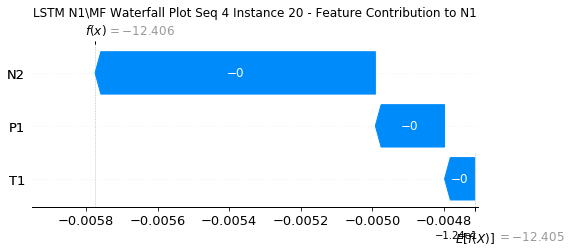

None

Contribution: [-1.81701789e-04 -7.46092700e-05 -7.63001569e-04]


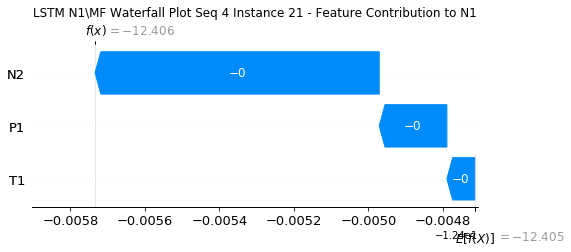

None

Contribution: [-2.04400042e-04 -4.45562426e-05 -7.68300493e-04]


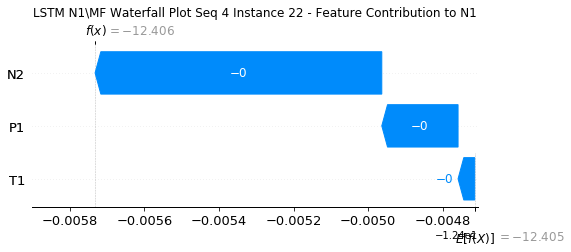

None

Contribution: [-0.00025074  0.00050848 -0.00086213]


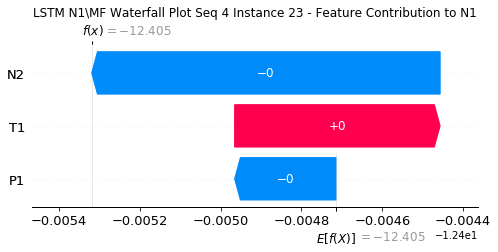

None

Contribution: [-0.00117479  0.01759104 -0.00688818]


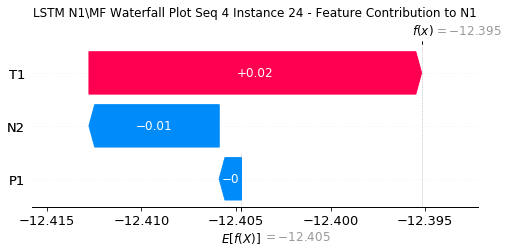

None

Contribution: [-0.10253563 -0.24720802 -0.21461336]


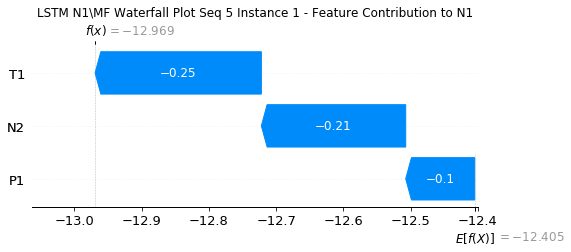

None

Contribution: [ 0.00199237 -0.000679    0.00616864]


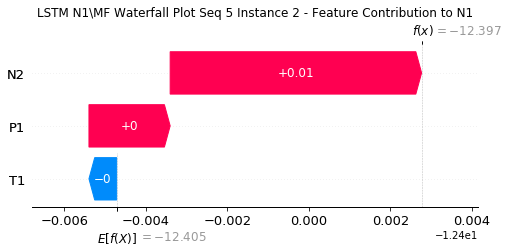

None

Contribution: [-0.0002241  -0.00216062 -0.00011875]


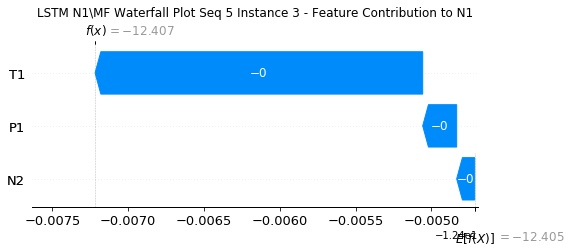

None

Contribution: [-1.44895404e-04 -1.61786195e-03 -5.11101569e-05]


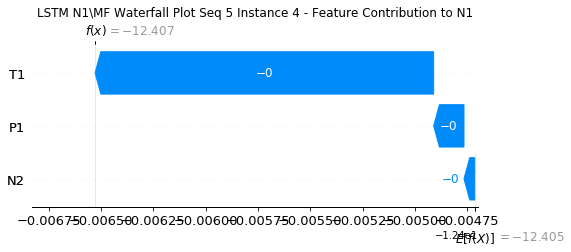

None

Contribution: [-0.00027706 -0.00331535 -0.0001846 ]


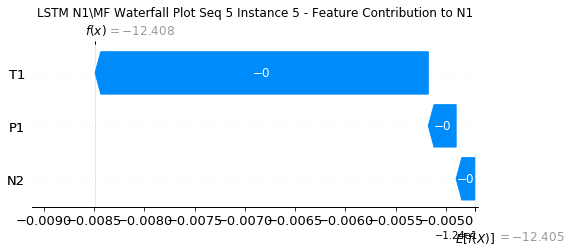

None

Contribution: [-0.00033444 -0.0028874  -0.00026658]


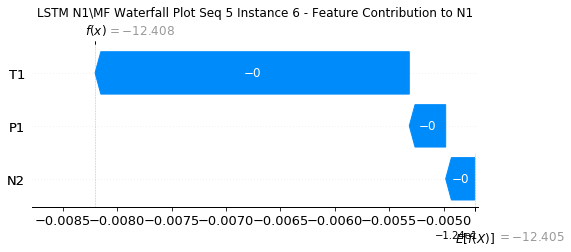

None

Contribution: [-0.00026526 -0.00175841 -0.0004217 ]


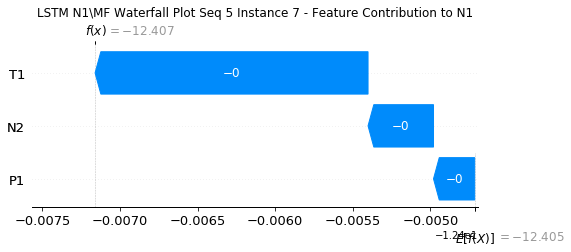

None

Contribution: [-0.00023221 -0.00088617 -0.00059831]


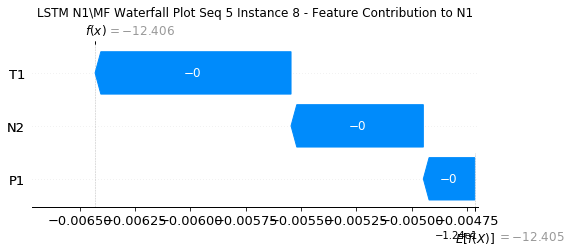

None

Contribution: [-0.00021173 -0.00055919 -0.00075055]


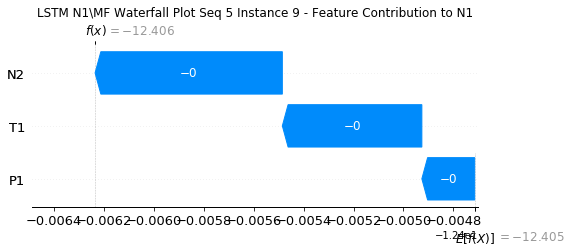

None

Contribution: [-0.0002024  -0.00017841 -0.00084016]


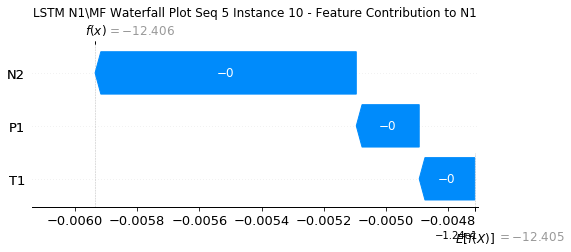

None

Contribution: [-0.00019473  0.00037149 -0.00097351]


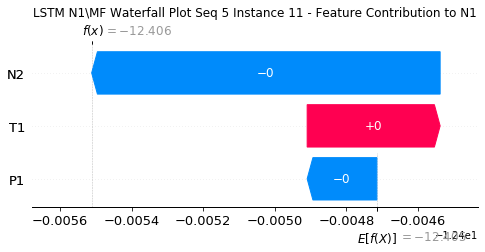

None

Contribution: [-0.00021311  0.00019811 -0.00104696]


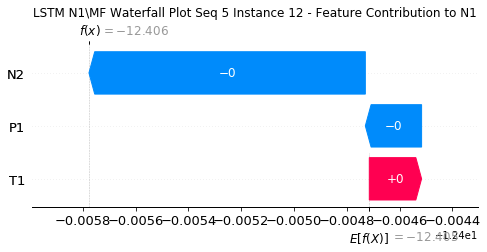

None

Contribution: [-2.44881529e-04  3.38492230e-05 -9.72969179e-04]


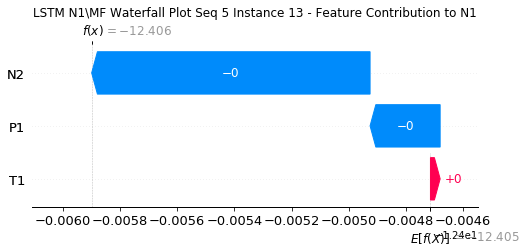

None

Contribution: [-2.59827934e-04  3.20494290e-06 -9.83472177e-04]


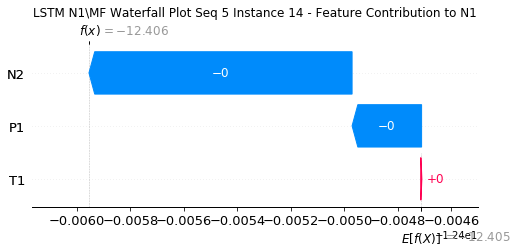

None

Contribution: [-2.51790973e-04 -4.66218465e-06 -9.89499960e-04]


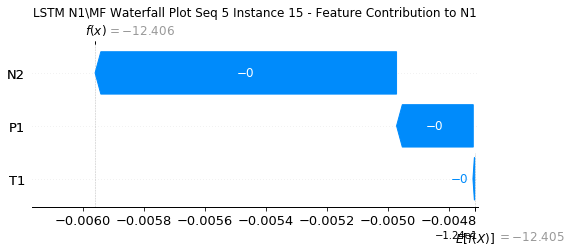

None

Contribution: [-2.48216067e-04 -2.39875439e-05 -9.92960536e-04]


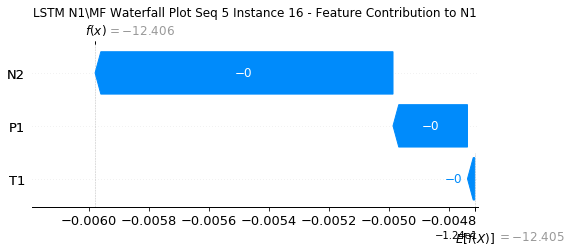

None

Contribution: [-2.37528795e-04 -4.83203182e-05 -9.41255486e-04]


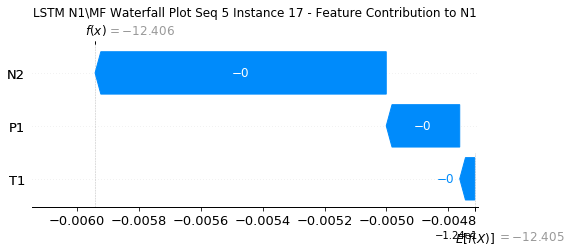

None

Contribution: [-2.17799918e-04 -6.95770646e-05 -8.84260807e-04]


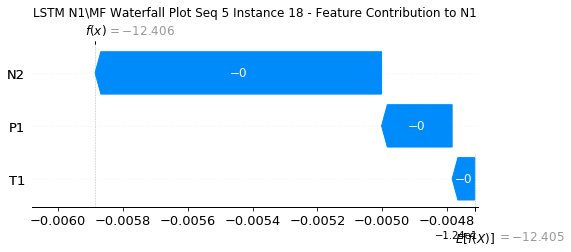

None

Contribution: [-2.03136625e-04 -7.71023367e-05 -8.29433653e-04]


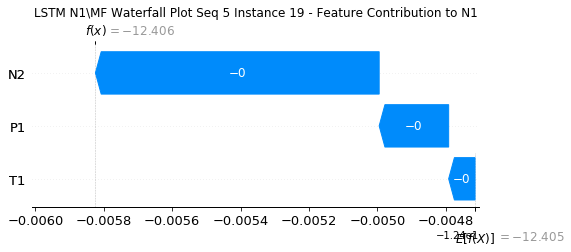

None

Contribution: [-1.89526811e-04 -8.16258376e-05 -7.84582756e-04]


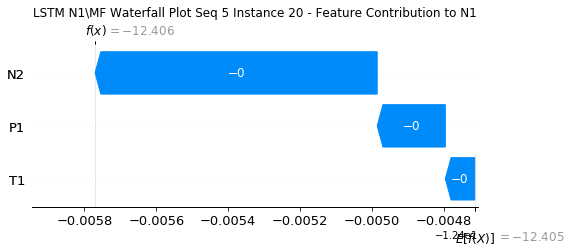

None

Contribution: [-1.80265550e-04 -7.41672316e-05 -7.64409584e-04]


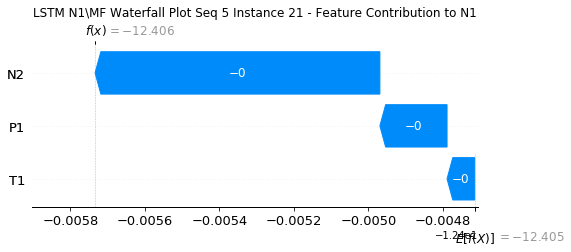

None

Contribution: [-2.02936163e-04 -4.58637045e-05 -7.69564839e-04]


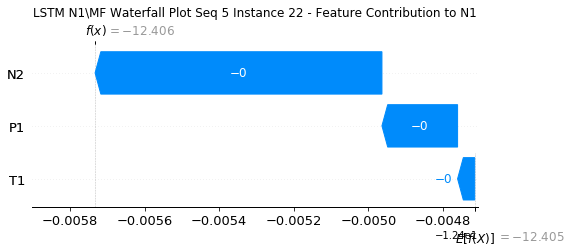

None

Contribution: [-0.00028514  0.00049938 -0.00085809]


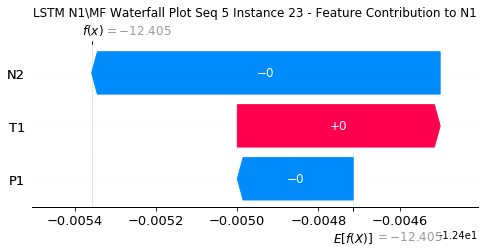

None

Contribution: [-0.00114124  0.01771596 -0.00682919]


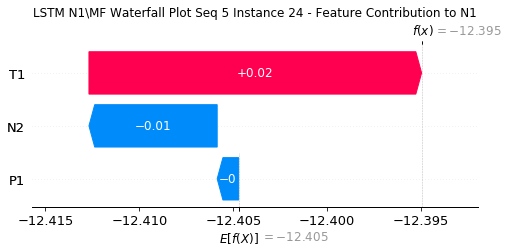

None

Contribution: [-0.1142535  -0.23723669 -0.21246601]


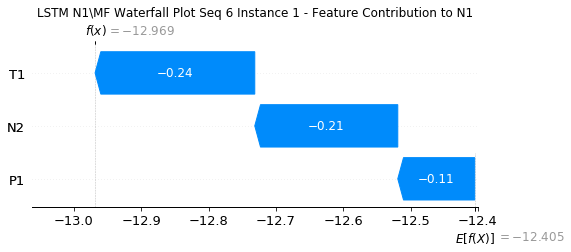

None

Contribution: [ 0.00200805 -0.00053843  0.0061596 ]


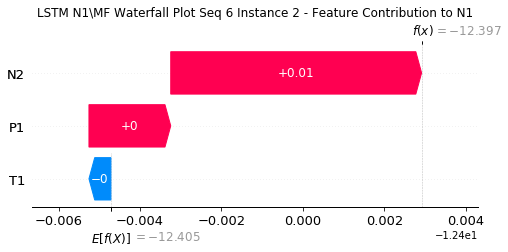

None

Contribution: [-0.00025541 -0.0018765  -0.00015908]


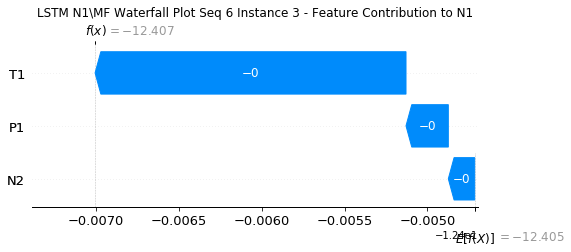

None

Contribution: [-1.62474805e-04 -1.51612769e-03 -7.28996303e-05]


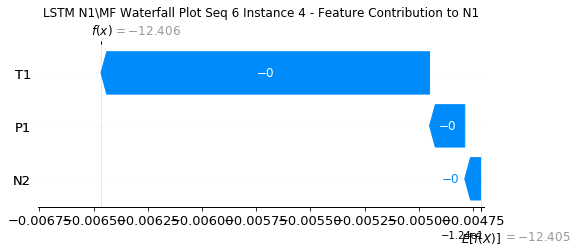

None

Contribution: [-0.00050703 -0.00301785 -0.00024056]


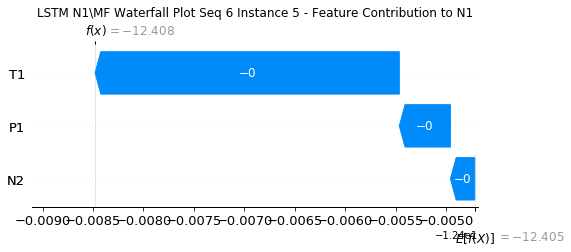

None

Contribution: [-0.00036165 -0.0026692  -0.00030086]


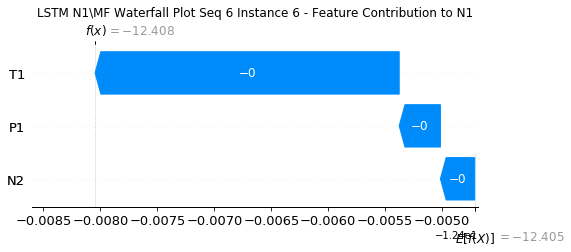

None

Contribution: [-0.00030409 -0.00162119 -0.00044911]


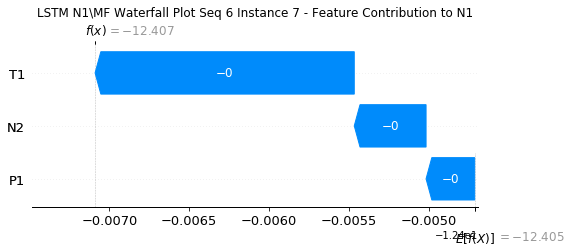

None

Contribution: [-0.00023415 -0.00077907 -0.00060238]


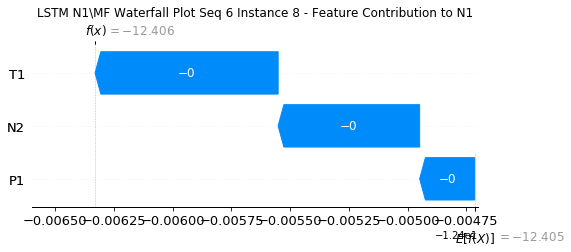

None

Contribution: [-0.00020518 -0.00049197 -0.00076258]


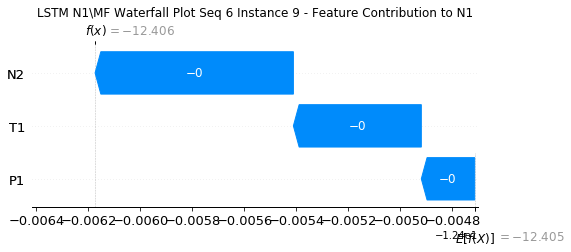

None

Contribution: [-1.85024350e-04 -9.90251926e-05 -8.46957173e-04]


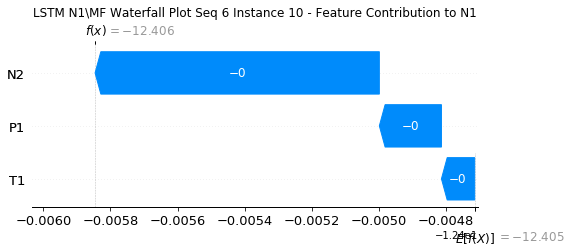

None

Contribution: [-0.00018721  0.00032995 -0.00098578]


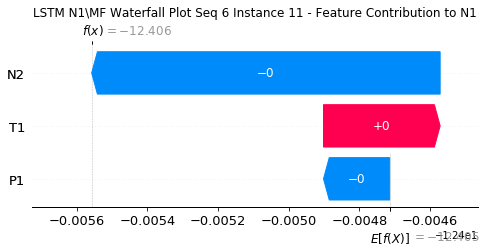

None

Contribution: [-0.00025739  0.00010418 -0.00101673]


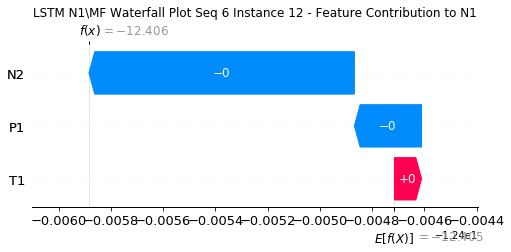

None

Contribution: [-2.46285996e-04 -4.52542525e-06 -9.87415361e-04]


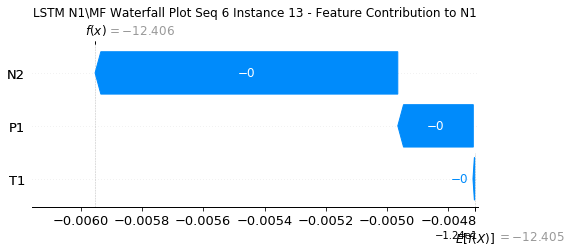

None

Contribution: [-2.56907016e-04 -1.50722277e-05 -9.76700850e-04]


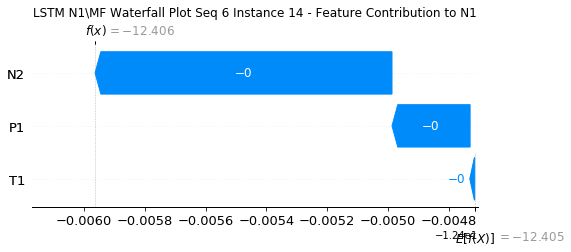

None

Contribution: [-2.53533567e-04 -4.17498400e-05 -1.00019747e-03]


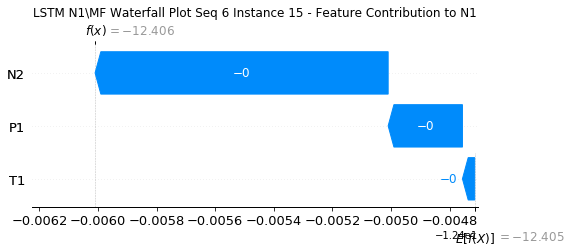

None

Contribution: [-2.54875627e-04 -5.94100796e-05 -9.94989341e-04]


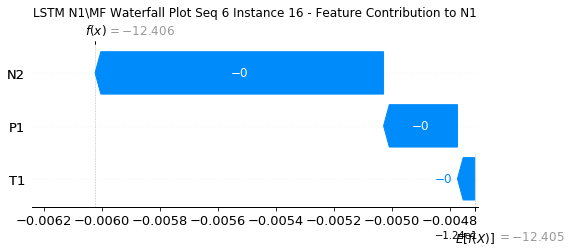

None

Contribution: [-2.45612870e-04 -8.11958341e-05 -9.33473890e-04]


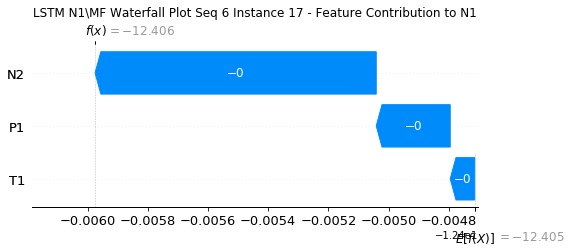

None

Contribution: [-2.22113480e-04 -8.61889077e-05 -8.72695614e-04]


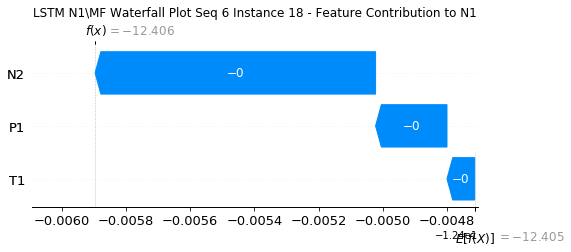

None

Contribution: [-2.10065352e-04 -8.92342701e-05 -8.19169005e-04]


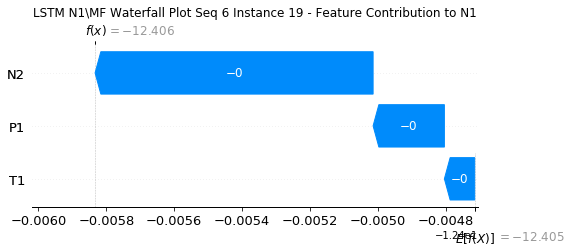

None

Contribution: [-1.96492733e-04 -8.73187082e-05 -7.76449238e-04]


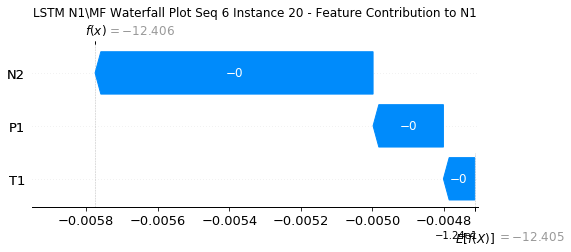

None

Contribution: [-1.88351759e-04 -7.15458610e-05 -7.61302487e-04]


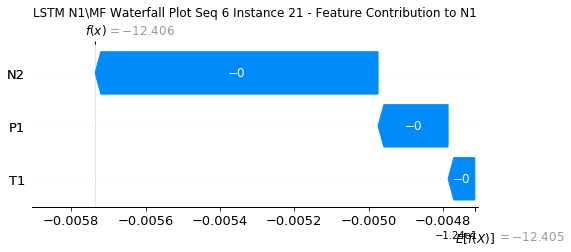

None

Contribution: [-2.07535593e-04 -3.55325928e-05 -7.68212915e-04]


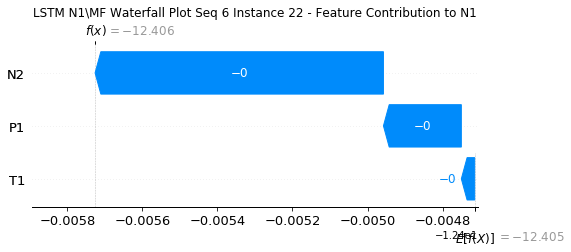

None

Contribution: [-0.00026688  0.00049545 -0.0008665 ]


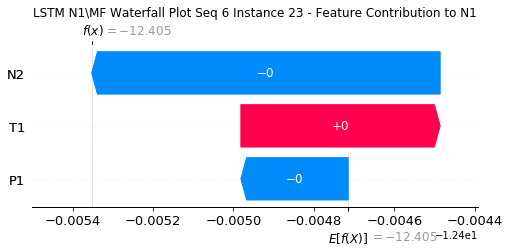

None

Contribution: [-0.00118182  0.0152472  -0.00718338]


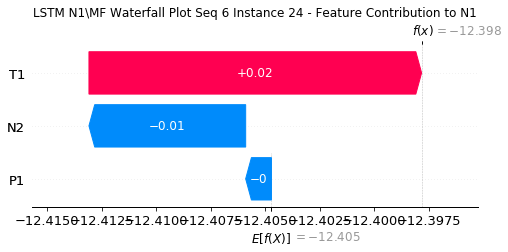

None

Contribution: [-0.11839978 -0.22199632 -0.20468701]


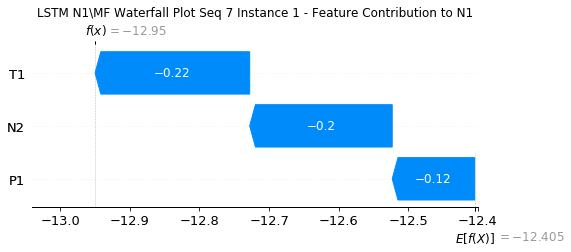

None

Contribution: [ 0.00206645 -0.00061951  0.00606331]


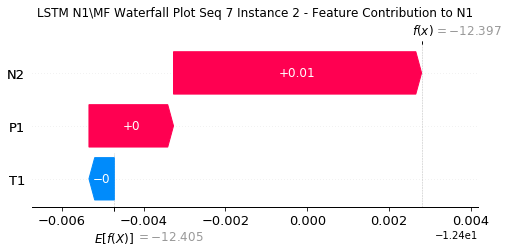

None

Contribution: [-0.00023942 -0.00201828 -0.00014978]


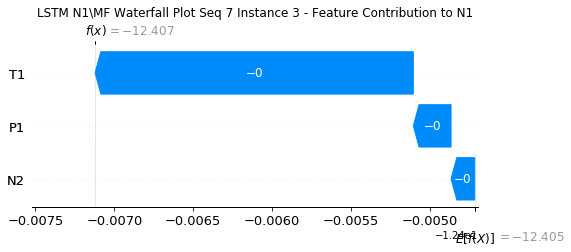

None

Contribution: [-1.96695902e-04 -1.99839915e-03 -9.29130752e-05]


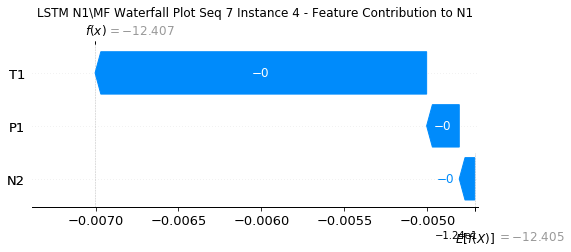

None

Contribution: [-0.00050918 -0.00382699 -0.00024012]


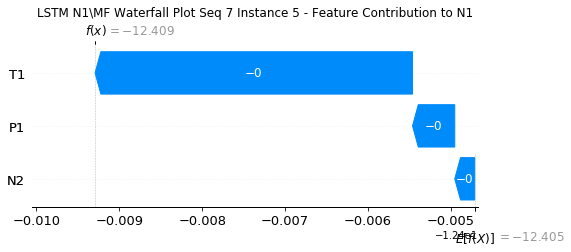

None

Contribution: [-0.00040823 -0.00347617 -0.00034589]


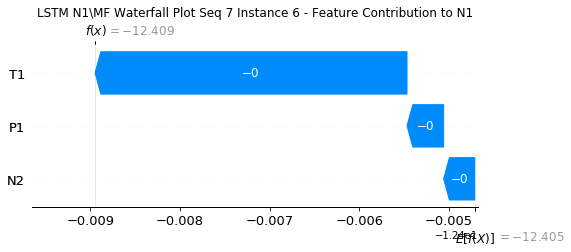

None

Contribution: [-0.00031765 -0.00195545 -0.00054007]


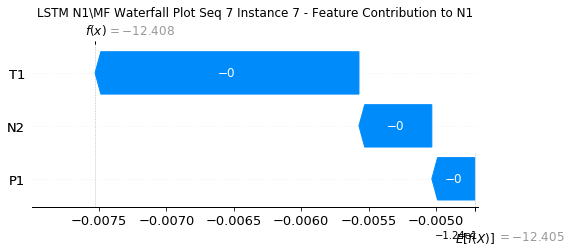

None

Contribution: [-0.00017487 -0.0004327  -0.00065277]


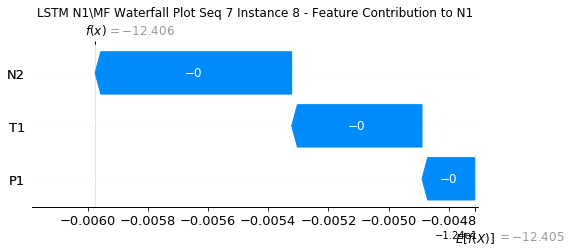

None

Contribution: [-0.00012176  0.00019878 -0.00080254]


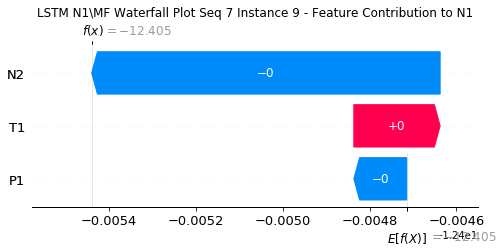

None

Contribution: [-0.00013524  0.00067967 -0.00091472]


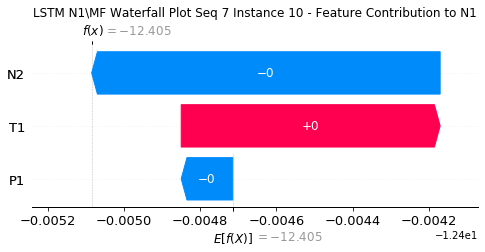

None

Contribution: [-0.00023104  0.00022187 -0.00095839]


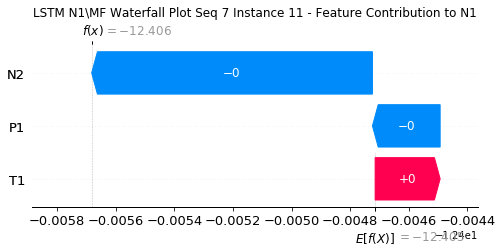

None

Contribution: [-0.00025878  0.00015744 -0.00100019]


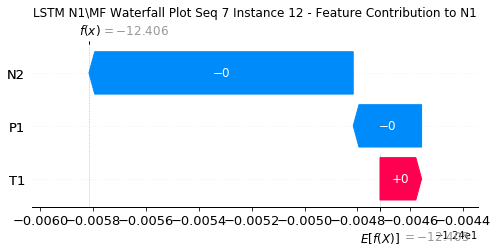

None

Contribution: [-2.59540786e-04  9.23890496e-05 -1.01371443e-03]


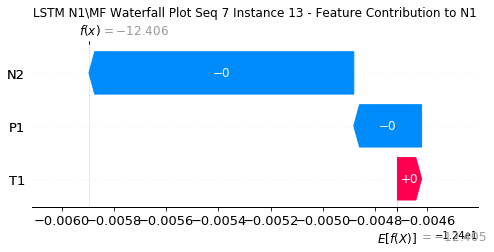

None

Contribution: [-0.00027734  0.00011647 -0.00101891]


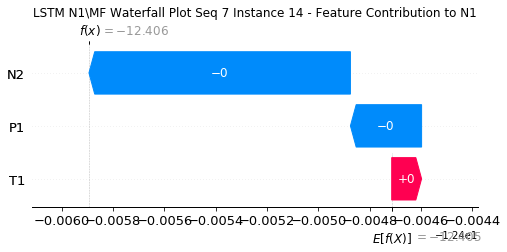

None

Contribution: [-0.00025037  0.00010634 -0.00099648]


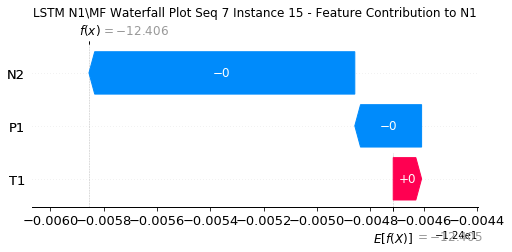

None

Contribution: [-2.34037668e-04  9.28264536e-05 -9.29575042e-04]


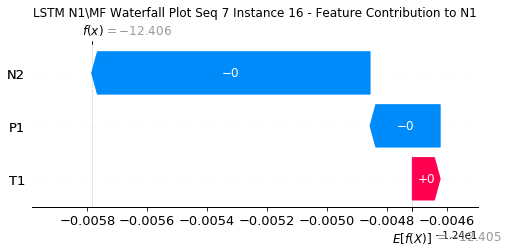

None

Contribution: [-2.39817055e-04  5.71200760e-05 -8.46646390e-04]


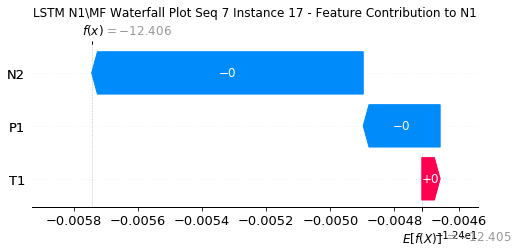

None

Contribution: [-2.02556110e-04  3.22757610e-05 -7.93436392e-04]


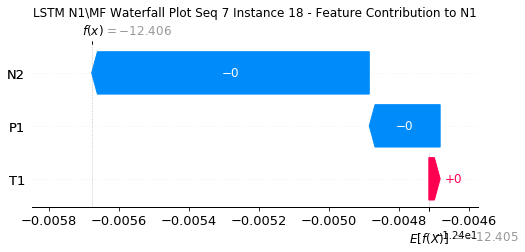

None

Contribution: [-1.93487453e-04  2.47106387e-05 -7.55031282e-04]


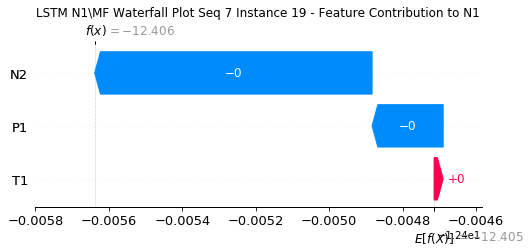

None

Contribution: [-1.82001856e-04  3.94400683e-05 -7.31695913e-04]


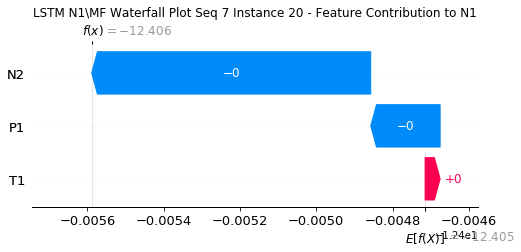

None

Contribution: [-1.72250219e-04  6.52850716e-05 -7.28468555e-04]


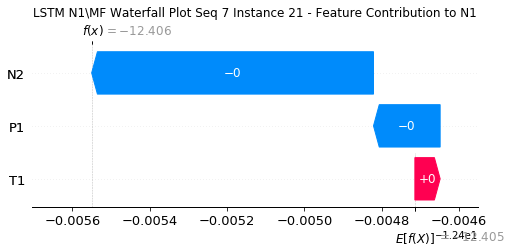

None

Contribution: [-0.00019699  0.00012524 -0.00073898]


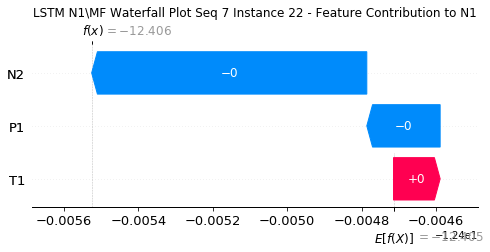

None

Contribution: [-0.00025433  0.00097772 -0.00085555]


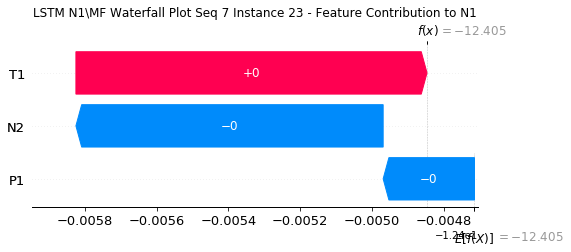

None

Contribution: [-0.00121459  0.02291465 -0.00730865]


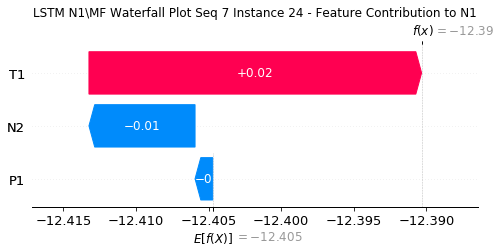

None

Contribution: [-0.07582171 -0.20256756 -0.2144901 ]


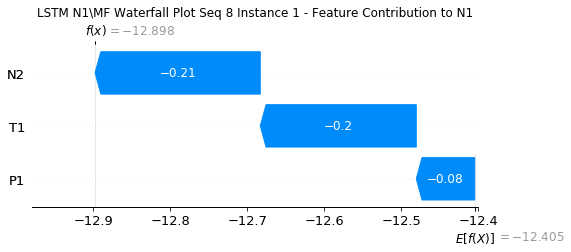

None

Contribution: [ 0.00171886 -0.00021916  0.00618499]


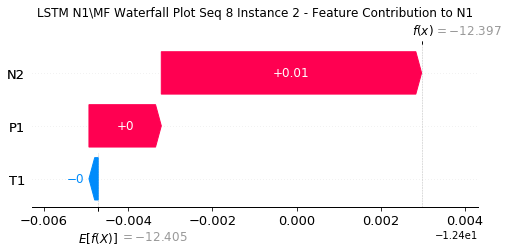

None

Contribution: [-0.00014846 -0.00243947 -0.00016714]


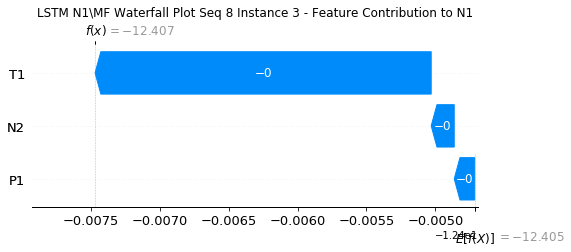

None

Contribution: [-6.34515536e-05 -1.12485552e-03 -1.77808855e-05]


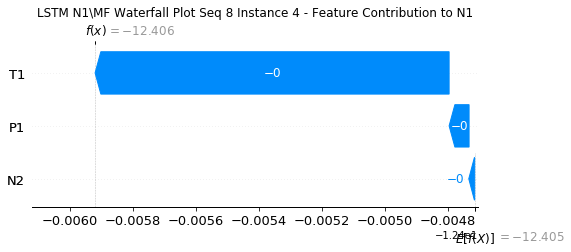

None

Contribution: [-0.00020458 -0.00219984 -0.00016804]


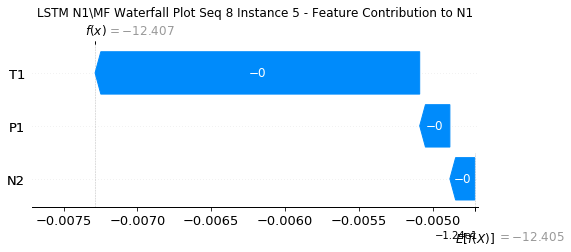

None

Contribution: [-0.00022994 -0.0022218  -0.00025968]


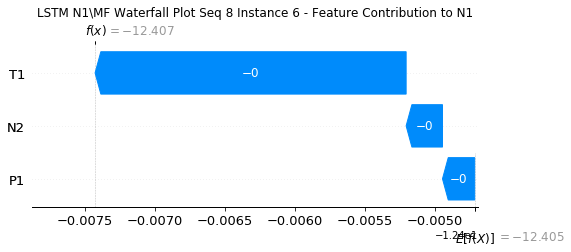

None

Contribution: [-0.000218   -0.00143934 -0.00041001]


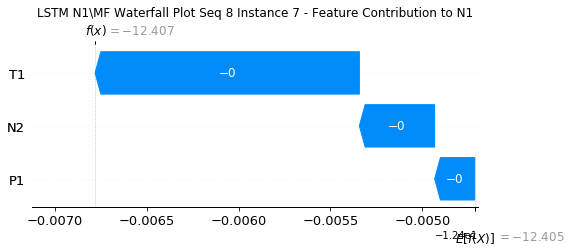

None

Contribution: [-0.0001968  -0.00096277 -0.00052942]


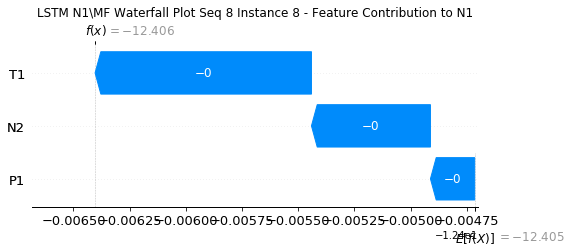

None

Contribution: [-0.00019289 -0.00078122 -0.00061846]


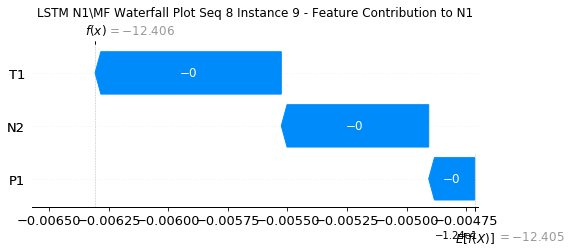

None

Contribution: [-0.00020726 -0.0006679  -0.00072195]


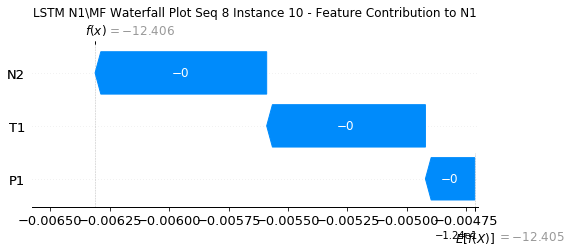

None

Contribution: [-0.00020317 -0.00054041 -0.00083829]


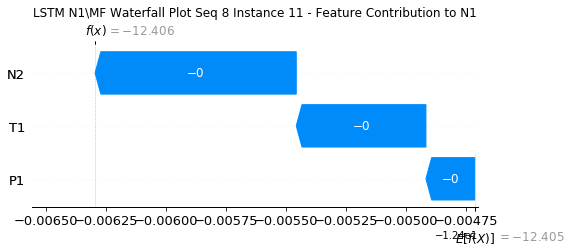

None

Contribution: [-0.00017686 -0.00023772 -0.00092769]


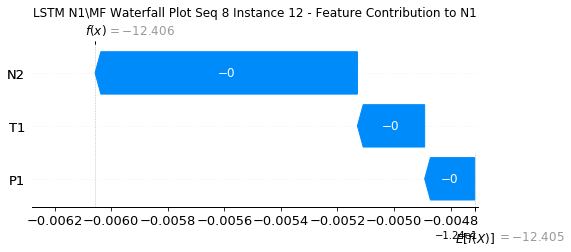

None

Contribution: [-0.00019404  0.00022633 -0.00103085]


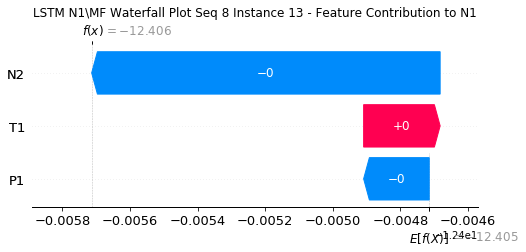

None

Contribution: [-0.00017232  0.00091837 -0.00115891]


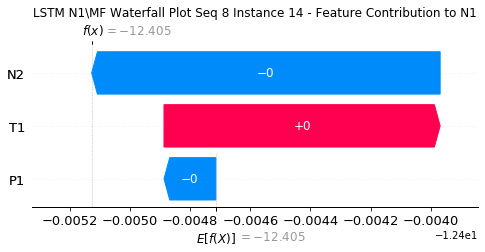

None

Contribution: [-0.00017502  0.00069201 -0.0010936 ]


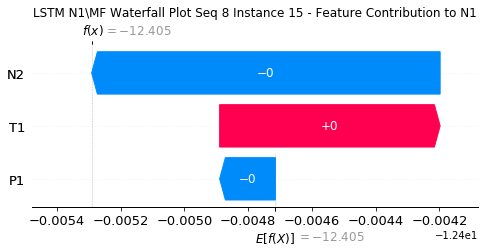

None

Contribution: [-0.000144    0.00035837 -0.00088822]


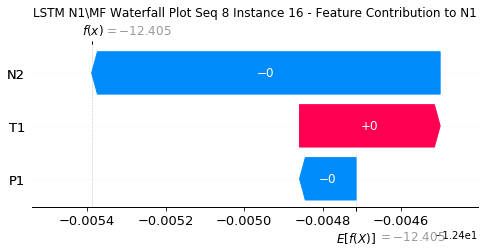

None

Contribution: [-0.0001455   0.00027342 -0.00088074]


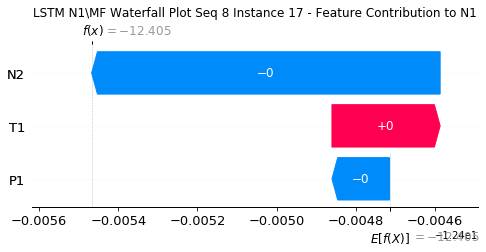

None

Contribution: [-0.00016854  0.00026183 -0.00086959]


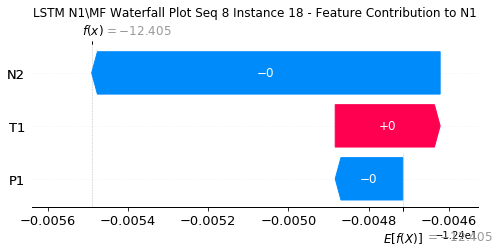

None

Contribution: [-0.00015598  0.00027359 -0.00087066]


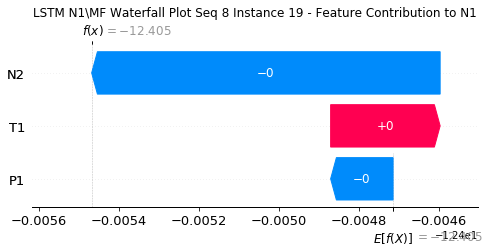

None

Contribution: [-0.00017518  0.00026104 -0.00087398]


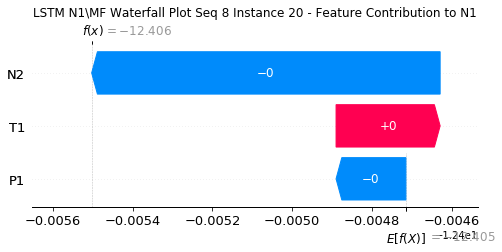

None

Contribution: [-0.00013505  0.00024892 -0.00085206]


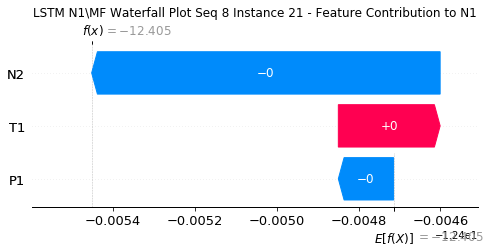

None

Contribution: [-0.00019451  0.00014256 -0.0008609 ]


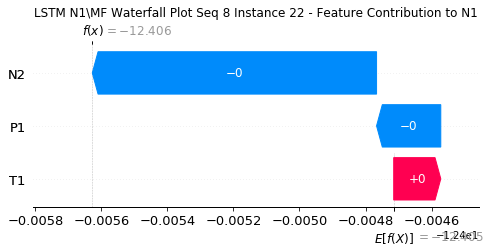

None

Contribution: [-0.00028878  0.00024028 -0.00089981]


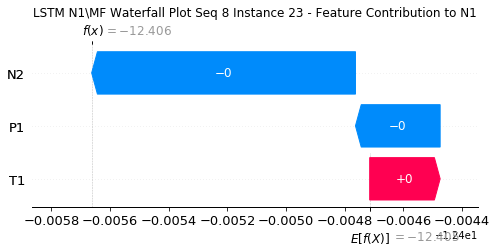

None

Contribution: [-0.00066565  0.02123404 -0.00524038]


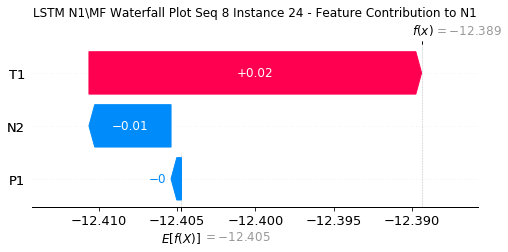

None

Contribution: [-0.09480265 -0.25198263 -0.21618404]


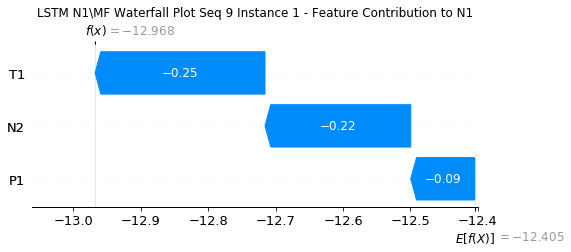

None

Contribution: [ 0.00200282 -0.00091957  0.00618846]


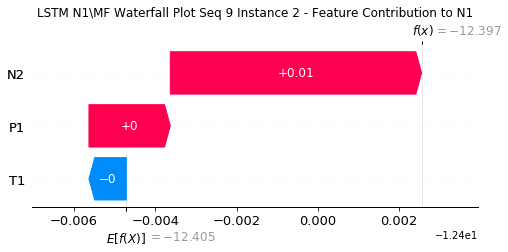

None

Contribution: [-3.84083816e-04 -2.33834733e-03 -7.26148322e-05]


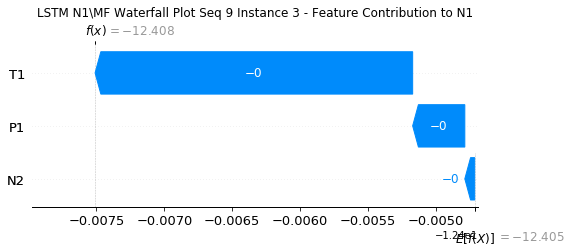

None

Contribution: [-1.82758564e-04 -1.46070194e-03 -9.43500523e-06]


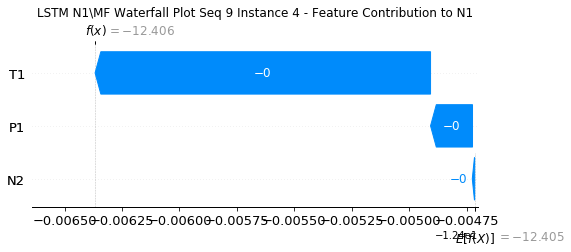

None

Contribution: [-0.00076508 -0.00324996 -0.00014037]


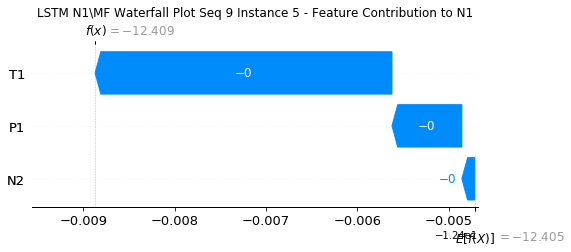

None

Contribution: [-0.00040278 -0.00255685 -0.00019301]


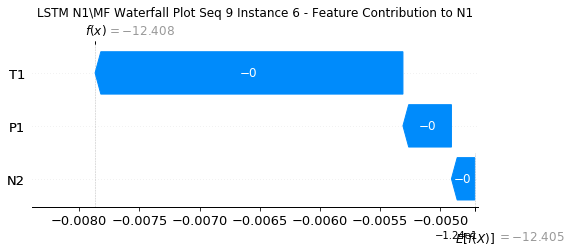

None

Contribution: [-0.00027731 -0.00132863 -0.00039079]


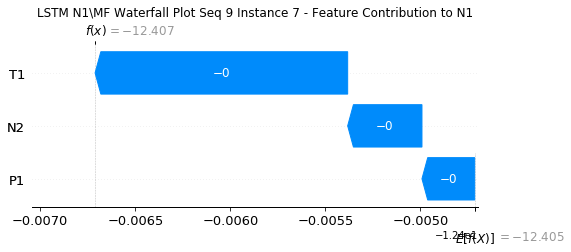

None

Contribution: [-0.00022581 -0.00077608 -0.00056553]


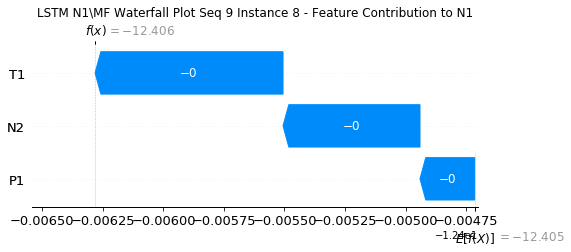

None

Contribution: [-0.00022257 -0.00070977 -0.00069253]


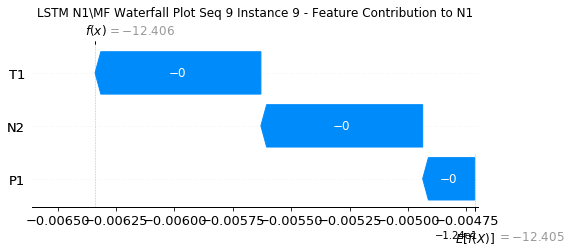

None

Contribution: [-0.00023403 -0.00053297 -0.00080938]


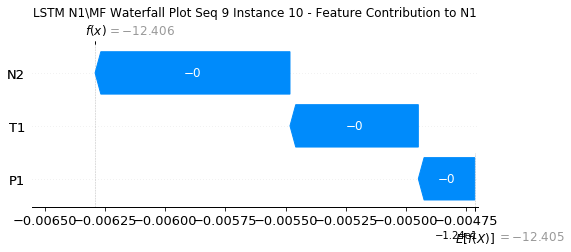

None

Contribution: [-0.00022381 -0.00018053 -0.00094369]


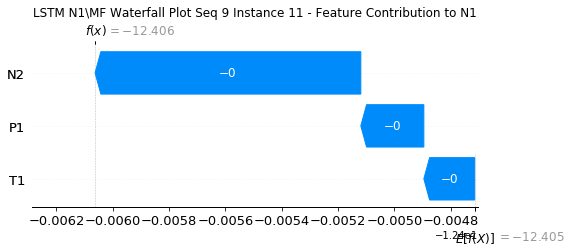

None

Contribution: [-0.00019798  0.00030742 -0.00108237]


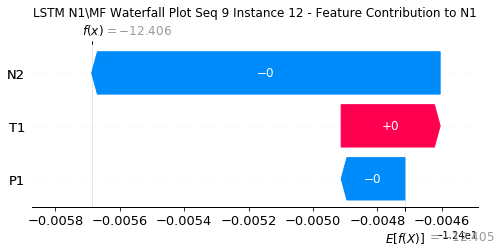

None

Contribution: [-0.0002571   0.00012157 -0.0010784 ]


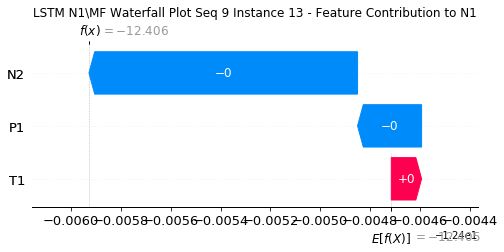

None

Contribution: [-2.50251813e-04  1.05968183e-05 -9.70254213e-04]


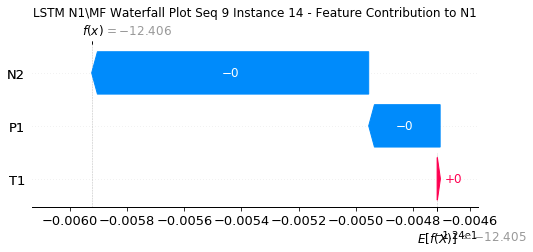

None

Contribution: [-2.59417592e-04 -4.56688078e-05 -9.81298387e-04]


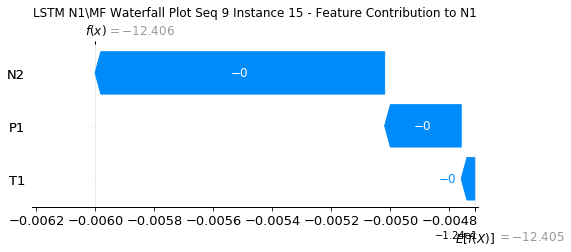

None

Contribution: [-2.61357020e-04 -4.87045186e-05 -9.73367328e-04]


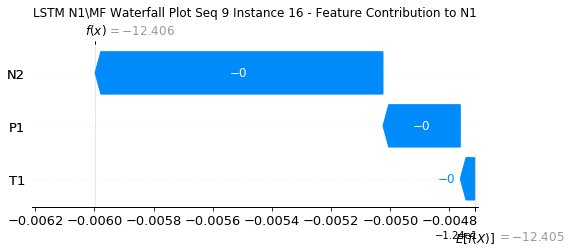

None

Contribution: [-2.25469863e-04 -5.73448065e-05 -9.65169488e-04]


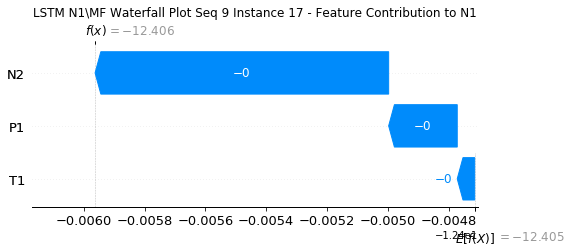

None

Contribution: [-2.29050446e-04 -6.70279641e-05 -9.27838285e-04]


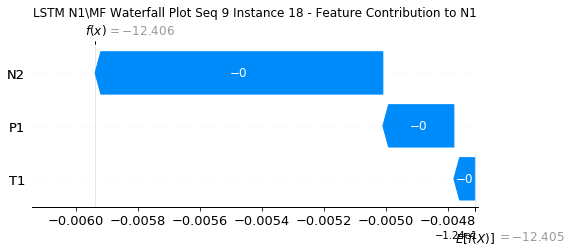

None

Contribution: [-2.20048564e-04 -8.76374579e-05 -8.74132777e-04]


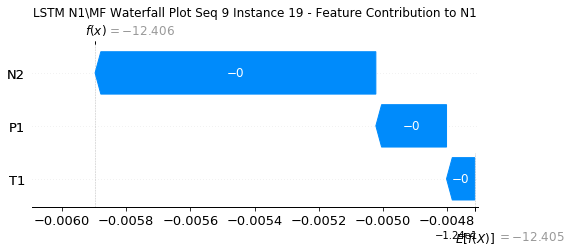

None

Contribution: [-2.02163295e-04 -7.86947856e-05 -8.26503985e-04]


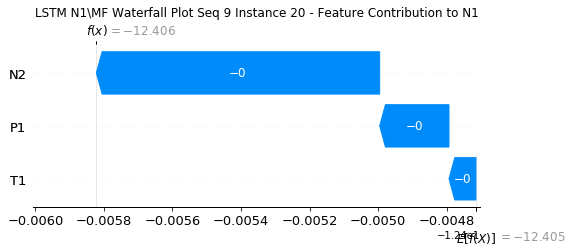

None

Contribution: [-2.01432275e-04 -6.79012046e-05 -8.07255198e-04]


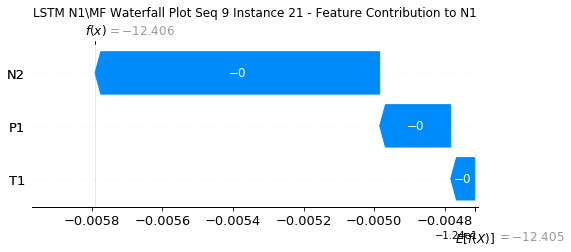

None

Contribution: [-2.10337678e-04 -6.03583200e-05 -7.94648866e-04]


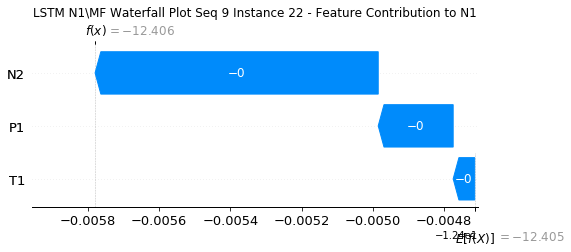

None

Contribution: [-0.00027948  0.00028976 -0.00085613]


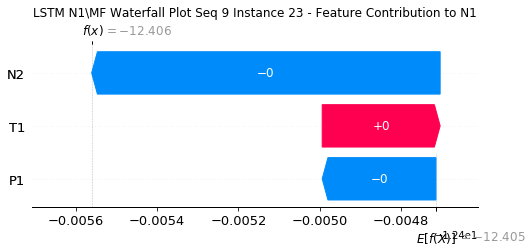

None

Contribution: [-0.00115648  0.01117751 -0.00698773]


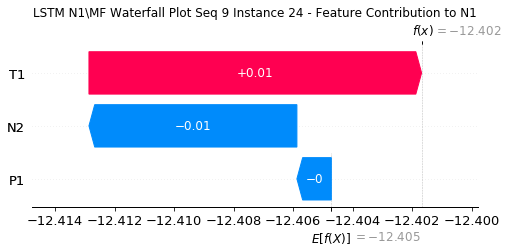

None

Contribution: [-0.12911267 -0.18729634 -0.2129155 ]


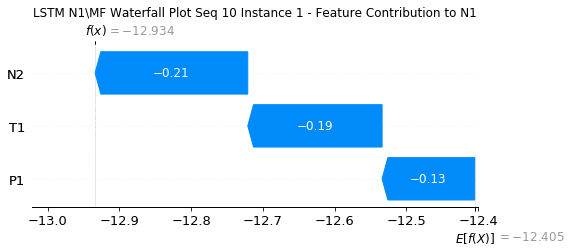

None

Contribution: [ 0.00214271 -0.00019231  0.00602681]


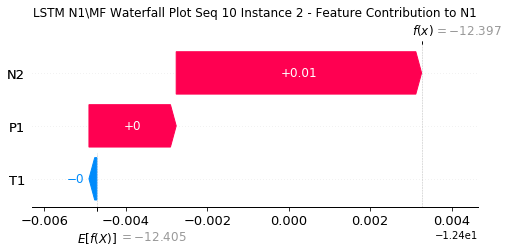

None

Contribution: [-0.00017839 -0.00159591 -0.00015335]


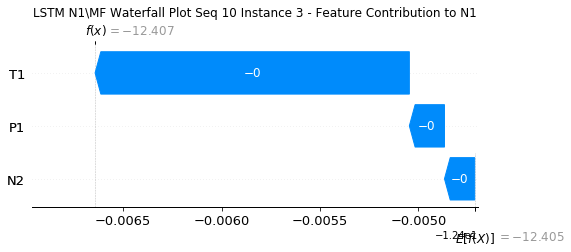

None

Contribution: [-1.50558523e-04 -1.80243962e-03 -9.76356390e-05]


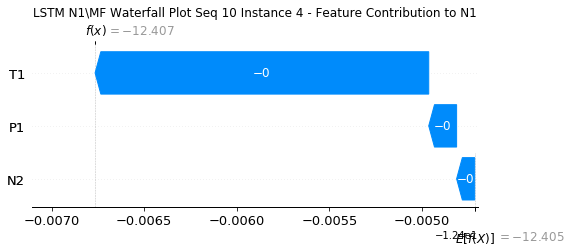

None

Contribution: [-0.00039    -0.00329808 -0.00021432]


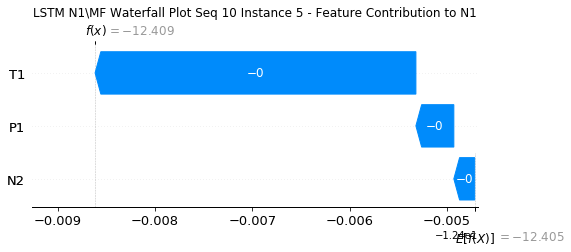

None

Contribution: [-0.0003136  -0.00305991 -0.00033468]


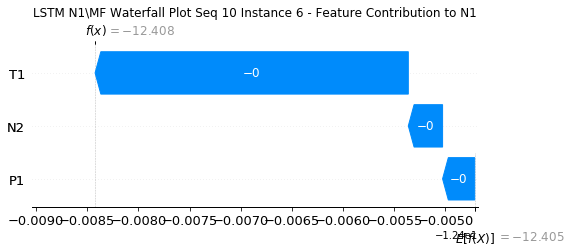

None

Contribution: [-0.0003212  -0.00153276 -0.00050576]


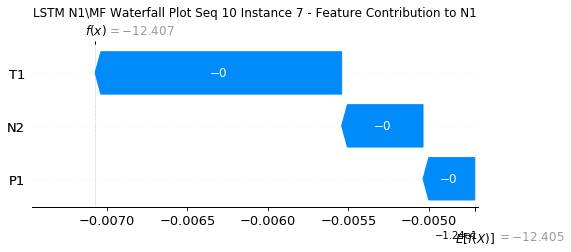

None

Contribution: [-0.00017996 -0.00016422 -0.00067976]


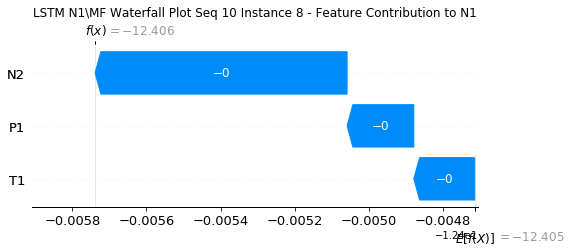

None

Contribution: [-0.00010506  0.00049848 -0.00086201]


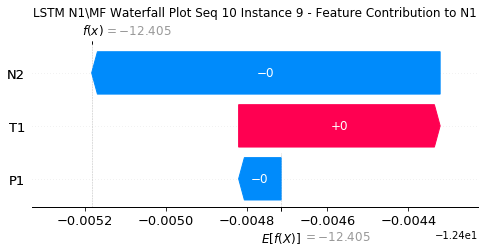

None

Contribution: [-0.00019914  0.00054685 -0.00095643]


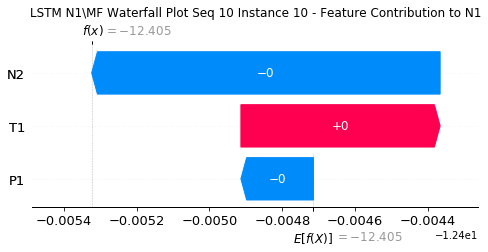

None

Contribution: [-0.00025322  0.00018592 -0.00095778]


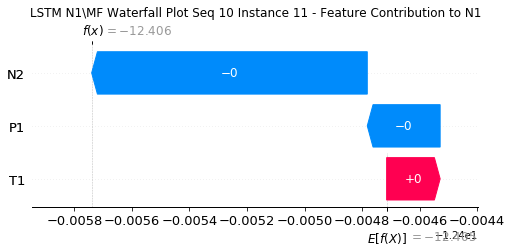

None

Contribution: [-0.00026433  0.00018906 -0.00101182]


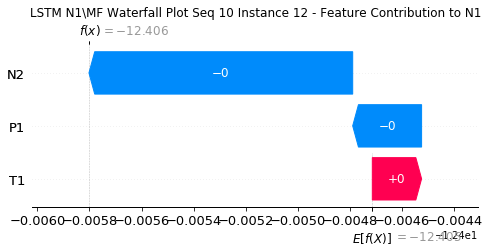

None

Contribution: [-0.00027921  0.00015311 -0.00102713]


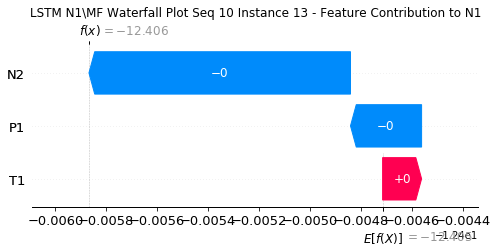

None

Contribution: [-0.00028307  0.00017254 -0.0010275 ]


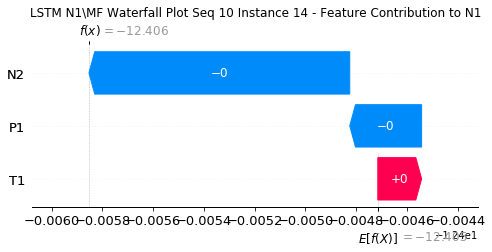

None

Contribution: [-0.00026235  0.00021459 -0.00098398]


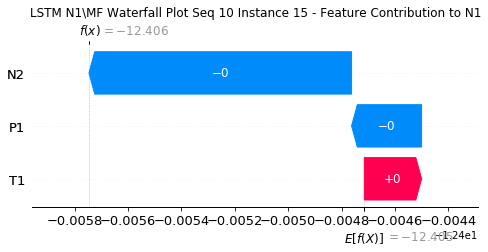

None

Contribution: [-0.00024193  0.00021607 -0.00090561]


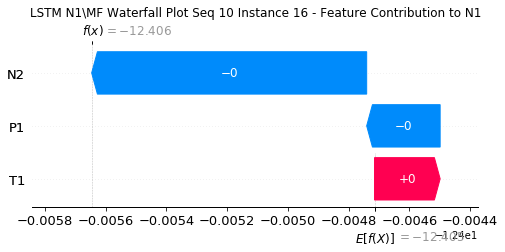

None

Contribution: [-0.0002332   0.00019614 -0.00082416]


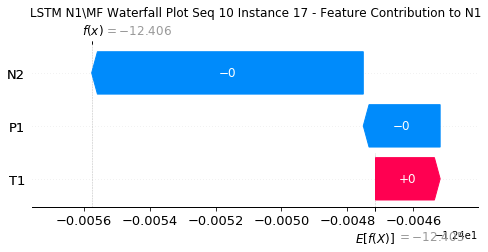

None

Contribution: [-0.00020706  0.00019156 -0.000778  ]


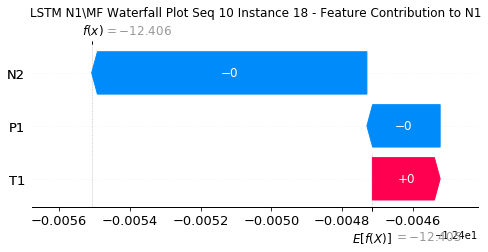

None

Contribution: [-0.00019881  0.00019093 -0.00074536]


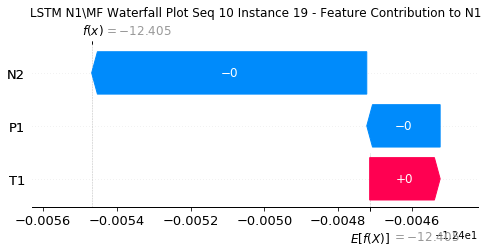

None

Contribution: [-0.00018981  0.00019899 -0.00072607]


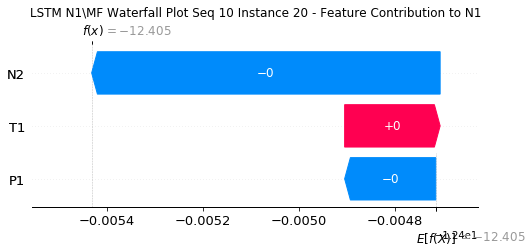

None

Contribution: [-0.00018037  0.00021288 -0.00072774]


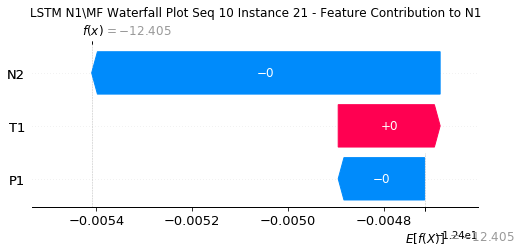

None

Contribution: [-0.0002026   0.00026207 -0.00073896]


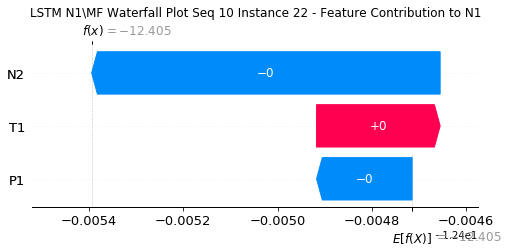

None

Contribution: [-0.00020922  0.00091332 -0.00087134]


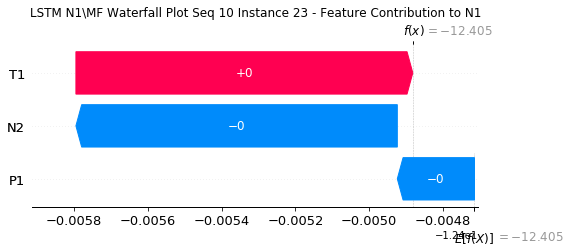

None

Contribution: [-0.00122021  0.01506601 -0.00754201]


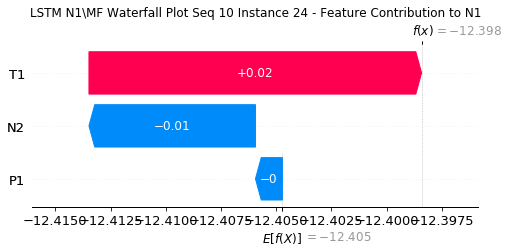

None

Contribution: [-0.06699553 -0.13907358 -0.18767964]


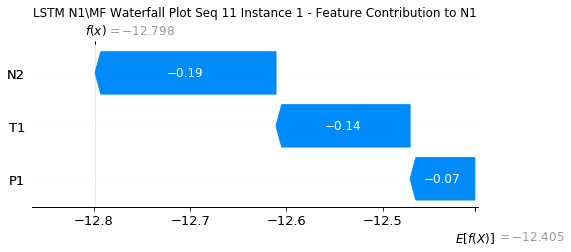

None

Contribution: [0.00174143 0.00027313 0.00576462]


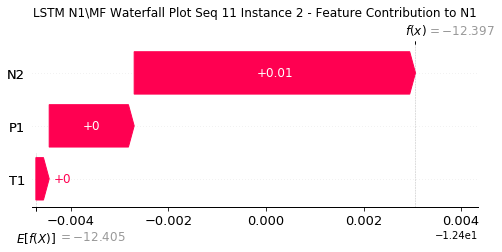

None

Contribution: [ 0.00010297 -0.00131624 -0.00010726]


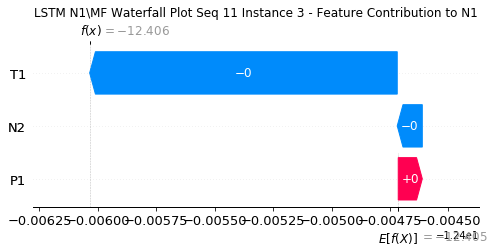

None

Contribution: [ 7.52818572e-05 -2.13555391e-03 -1.03628303e-04]


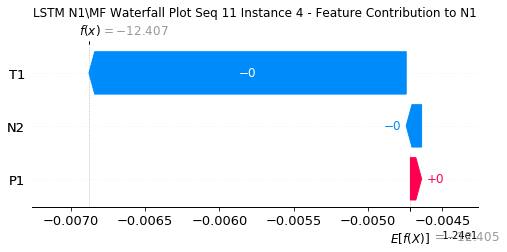

None

Contribution: [ 0.00033524 -0.00303168 -0.00020481]


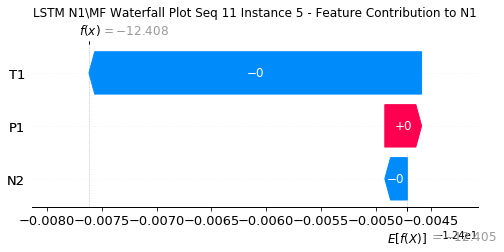

None

Contribution: [ 9.74085023e-05 -3.38454134e-03 -3.80406054e-04]


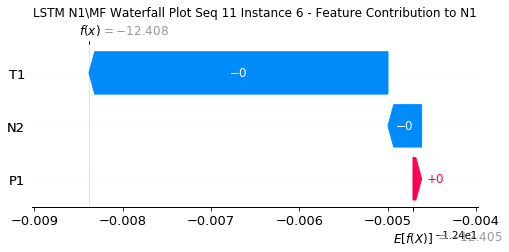

None

Contribution: [-0.00014547 -0.00081777 -0.00058264]


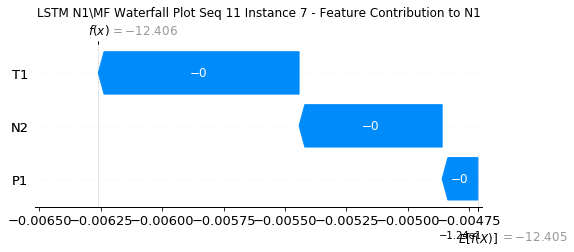

None

Contribution: [-0.00028127  0.00064127 -0.00082895]


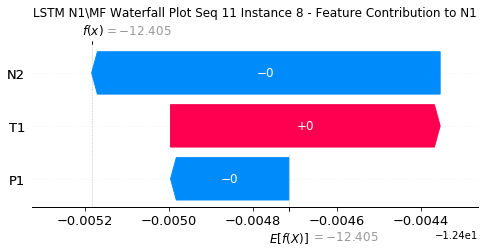

None

Contribution: [-0.00030909  0.00055023 -0.00102627]


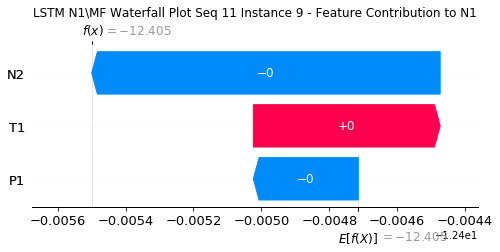

None

Contribution: [-0.00029398  0.00053402 -0.00098196]


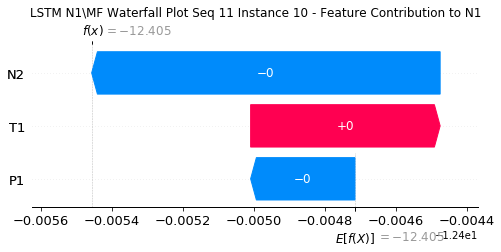

None

Contribution: [-0.0003193   0.00045859 -0.00103764]


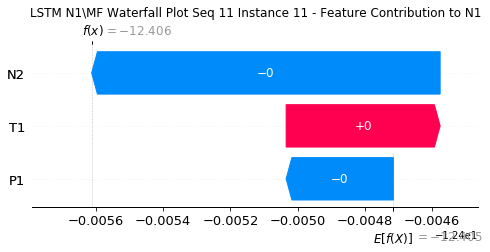

None

Contribution: [-0.0002847   0.00060259 -0.00102492]


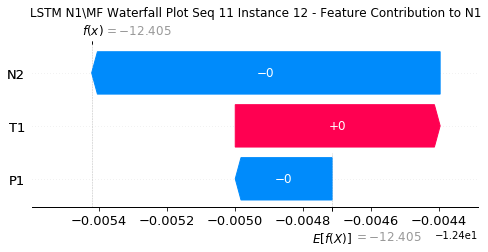

None

Contribution: [-0.00031575  0.00050858 -0.00105662]


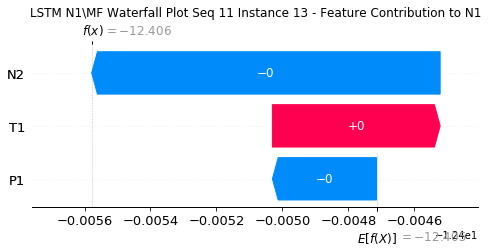

None

Contribution: [-0.0002981   0.00067692 -0.00101621]


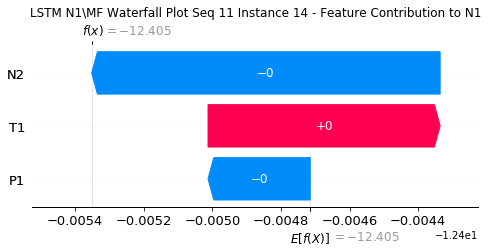

None

Contribution: [-0.00027431  0.0005306  -0.00093841]


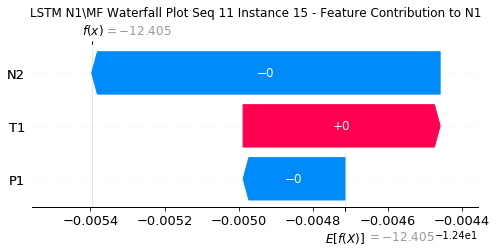

None

Contribution: [-0.00025607  0.00047168 -0.00086918]


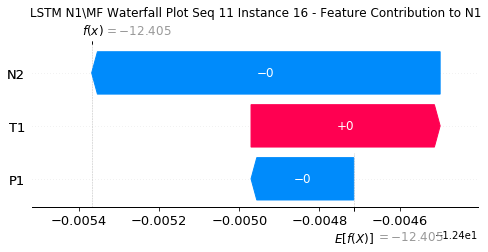

None

Contribution: [-0.00026218  0.00038745 -0.00082756]


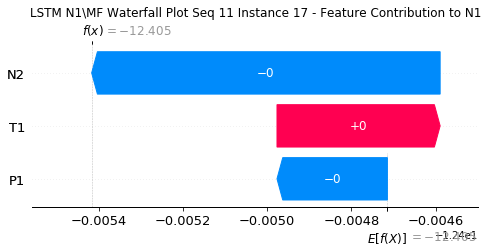

None

Contribution: [-0.00023286  0.00036172 -0.00078459]


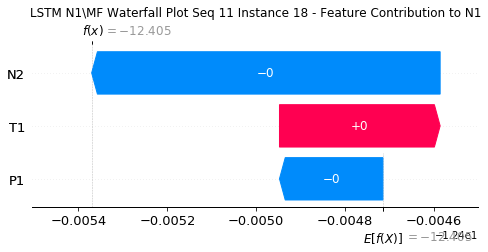

None

Contribution: [-0.00022553  0.00035009 -0.00075813]


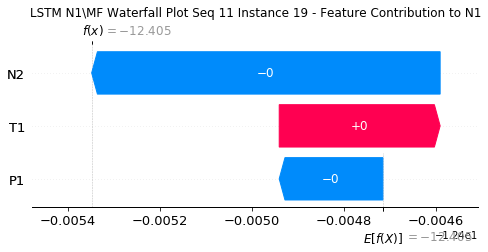

None

Contribution: [-0.00021539  0.00034249 -0.00074374]


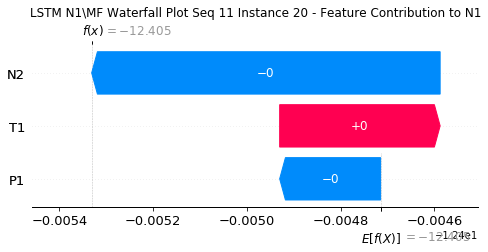

None

Contribution: [-0.00019853  0.00037094 -0.00074618]


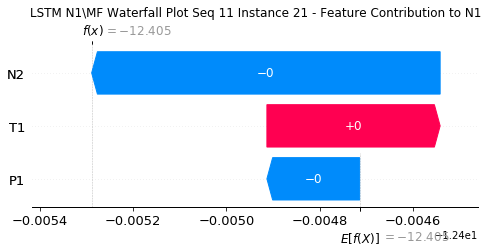

None

Contribution: [-0.00022198  0.00038395 -0.00076047]


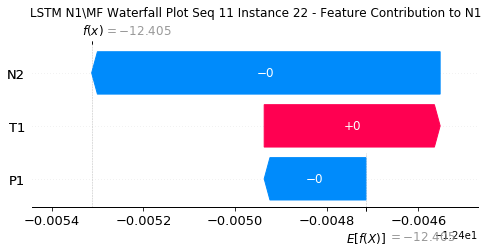

None

Contribution: [-0.00016326  0.00076201 -0.00093214]


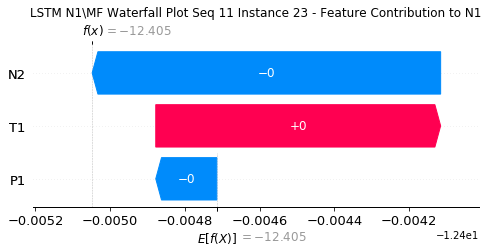

None

Contribution: [-0.00127213  0.01010174 -0.00785431]


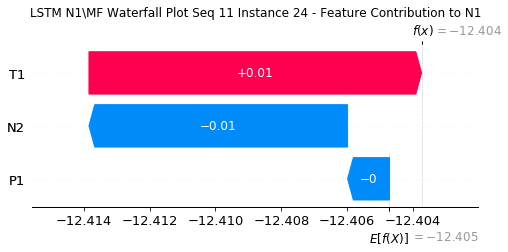

None

Contribution: [-0.04801134  0.04940772 -0.17438859]


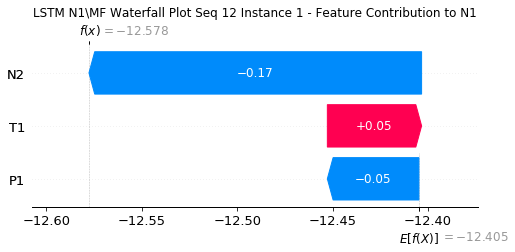

None

Contribution: [0.00170673 0.00188282 0.00547581]


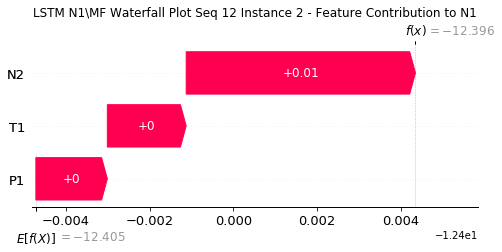

None

Contribution: [ 5.26283133e-05  2.76605790e-04 -7.78193946e-05]


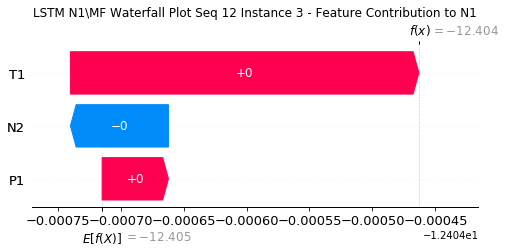

None

Contribution: [ 2.38448073e-05 -8.43863661e-05 -1.24591880e-04]


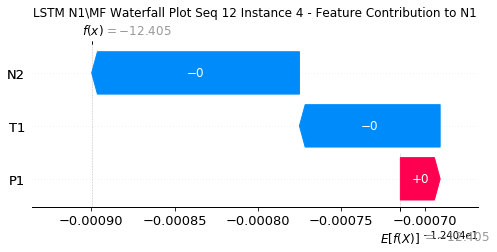

None

Contribution: [-7.33107482e-05 -4.07090980e-04 -2.65296135e-04]


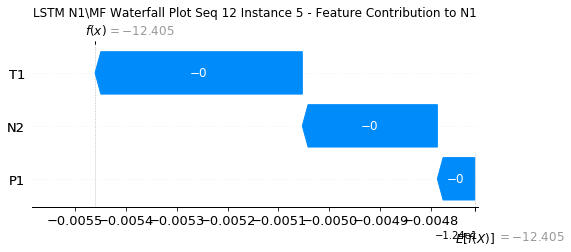

None

Contribution: [-1.47654286e-05 -9.14596841e-05 -4.50126019e-04]


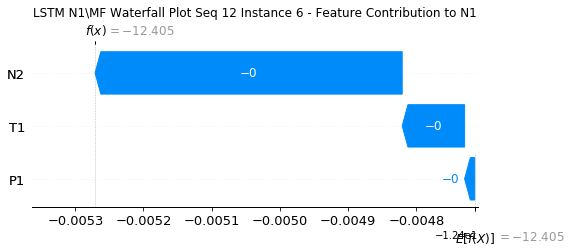

None

Contribution: [-0.00019765  0.00033348 -0.00064566]


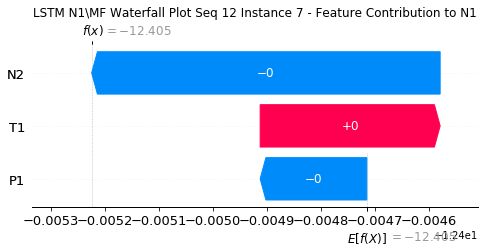

None

Contribution: [-0.00029225  0.00022605 -0.00080997]


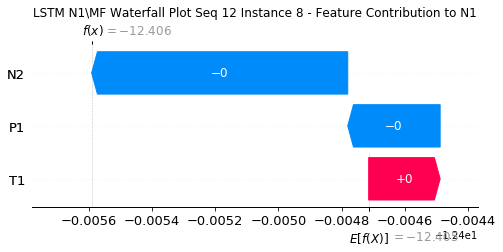

None

Contribution: [-2.96804446e-04  8.76172405e-05 -9.18108425e-04]


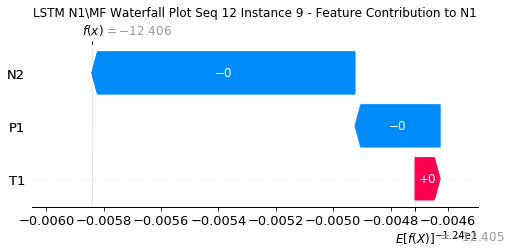

None

Contribution: [-0.00033623  0.0001059  -0.00099155]


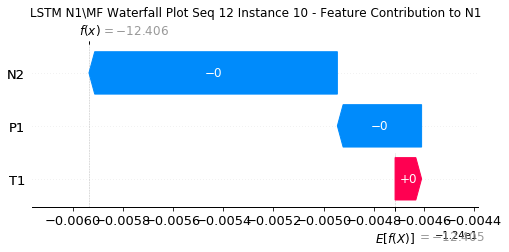

None

Contribution: [-3.45367778e-04  9.41635787e-05 -1.00273089e-03]


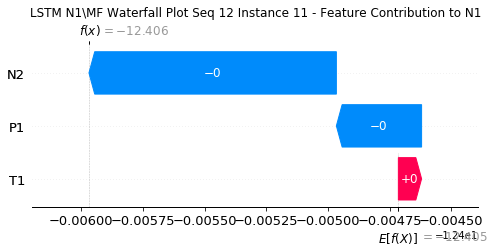

None

Contribution: [-0.00029912  0.00010602 -0.00097498]


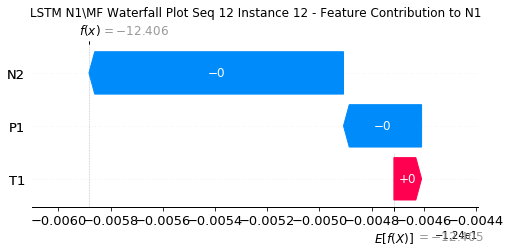

None

Contribution: [-3.40266058e-04  9.43433131e-05 -1.01241742e-03]


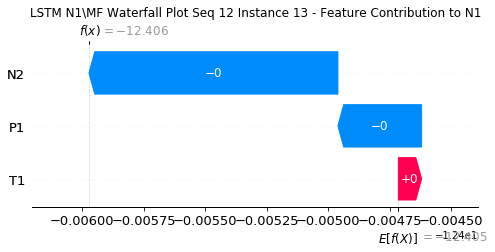

None

Contribution: [-0.00036817  0.00010744 -0.00100431]


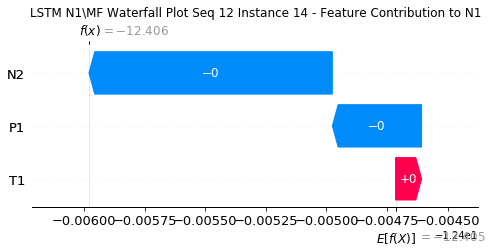

None

Contribution: [-0.0003214   0.00014518 -0.00095744]


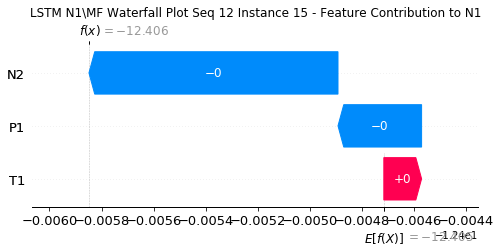

None

Contribution: [-0.00029775  0.00016197 -0.00089717]


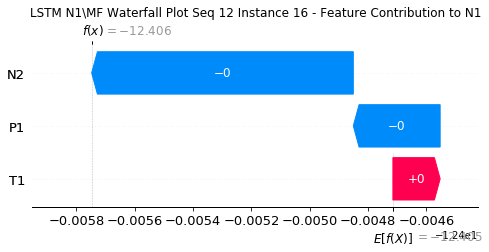

None

Contribution: [-0.00027267  0.00018183 -0.00083323]


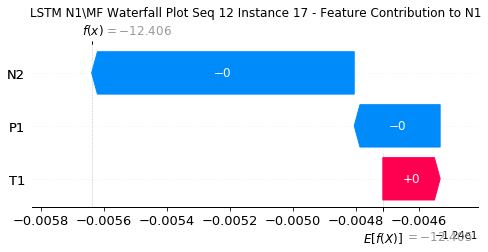

None

Contribution: [-0.00026489  0.00017702 -0.00080891]


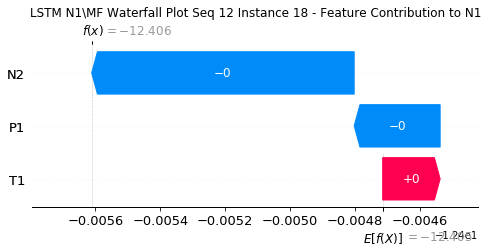

None

Contribution: [-0.00025351  0.00018178 -0.00077982]


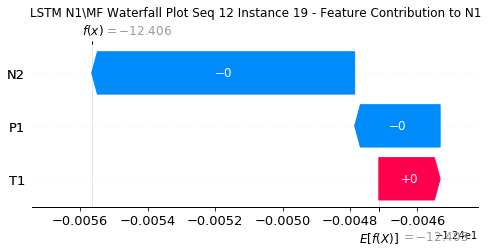

None

Contribution: [-0.00024108  0.00018678 -0.00076306]


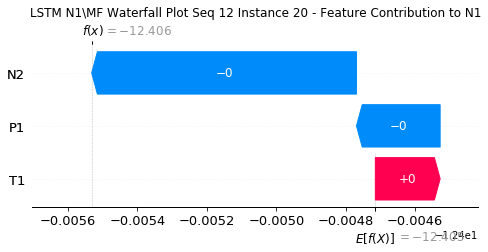

None

Contribution: [-0.00022497  0.00019486 -0.0007643 ]


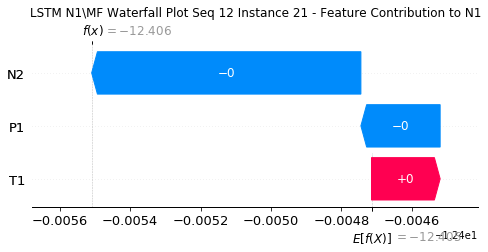

None

Contribution: [-0.00024165  0.0002301  -0.00077645]


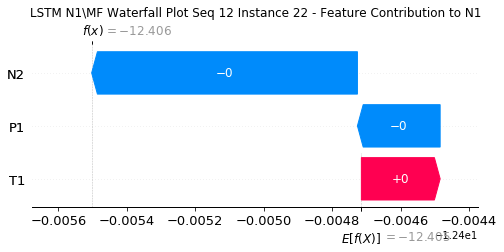

None

Contribution: [-0.00017877  0.00058614 -0.00091092]


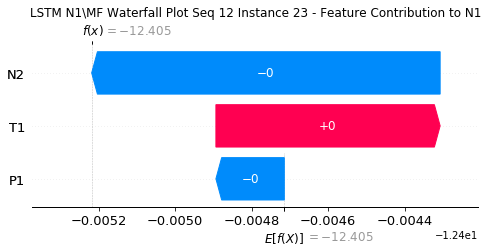

None

Contribution: [-0.00130646  0.00641636 -0.00744954]


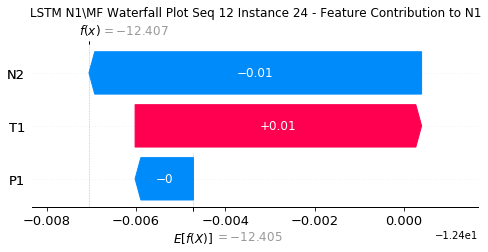

None

Contribution: [-0.05653835  0.0946854  -0.17577801]


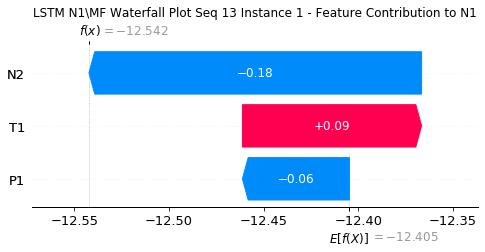

None

Contribution: [0.00168348 0.00255961 0.00536792]


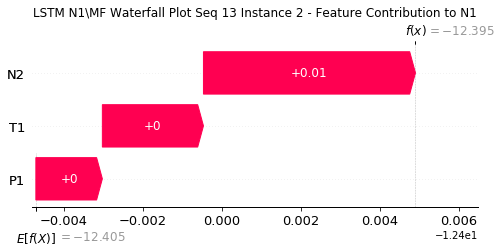

None

Contribution: [-4.78833991e-07  4.05402291e-04 -1.06068689e-04]


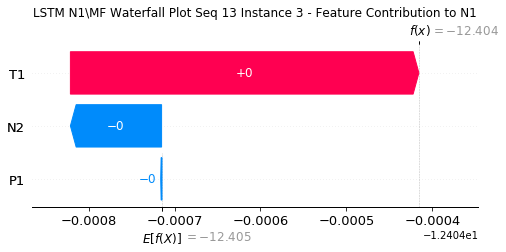

None

Contribution: [-2.97058308e-05  2.00940176e-04 -1.52018944e-04]


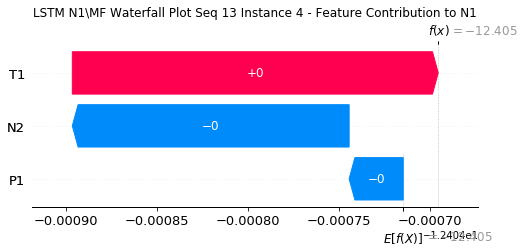

None

Contribution: [ 3.92581700e-05  8.89507841e-05 -3.02464447e-04]


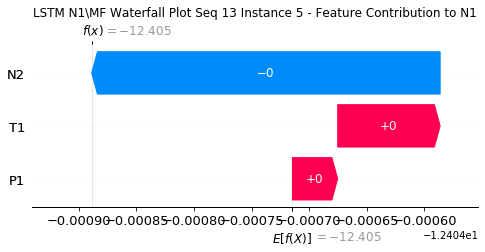

None

Contribution: [-0.00012014  0.00025562 -0.00048067]


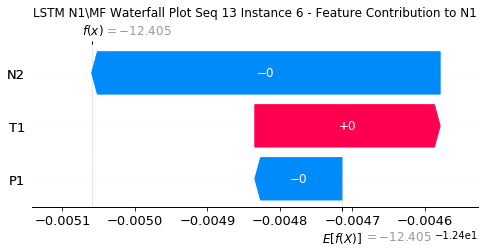

None

Contribution: [-0.00020745  0.00032826 -0.00063668]


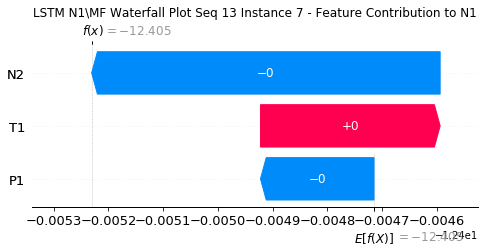

None

Contribution: [-0.00023058  0.00021825 -0.00073834]


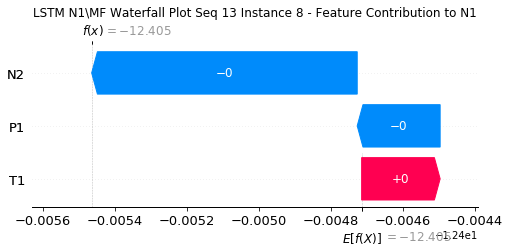

None

Contribution: [-0.00024284  0.00021962 -0.00081662]


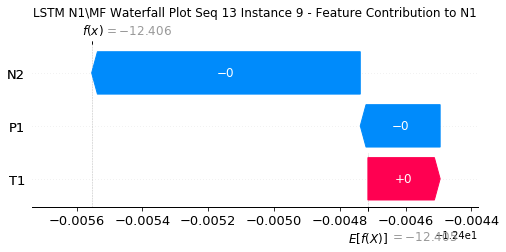

None

Contribution: [-0.00032484  0.00030273 -0.00091811]


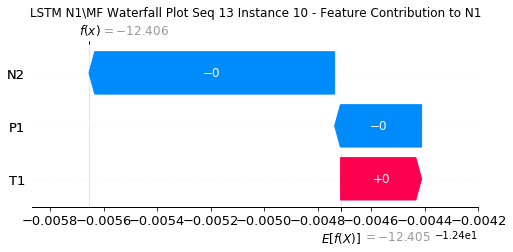

None

Contribution: [-0.00033253  0.00030122 -0.00094436]


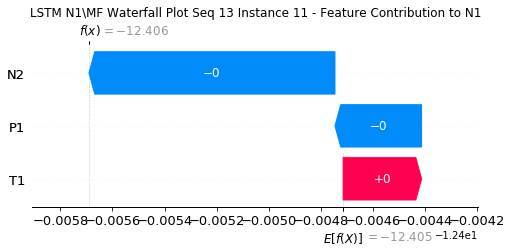

None

Contribution: [-0.00032973  0.00030231 -0.00094474]


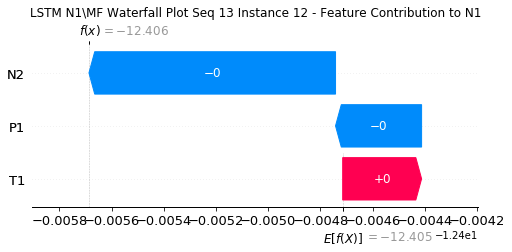

None

Contribution: [-0.00033725  0.00029956 -0.00097193]


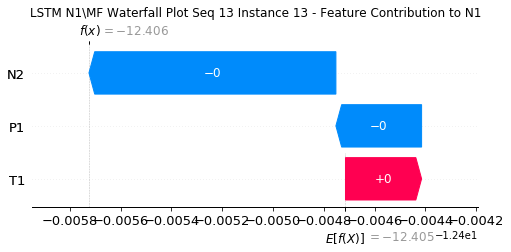

None

Contribution: [-0.00031483  0.00035974 -0.00097344]


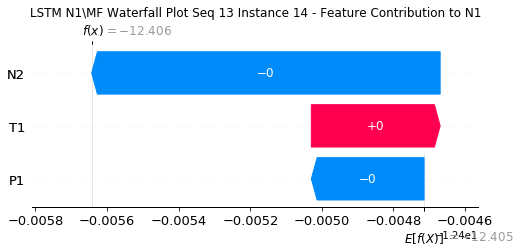

None

Contribution: [-0.00032259  0.00037824 -0.00096236]


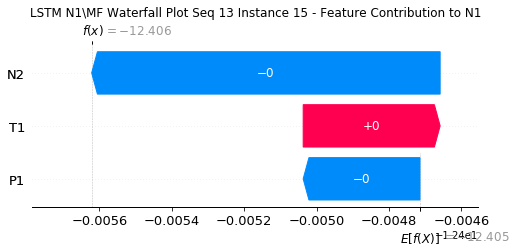

None

Contribution: [-0.00030172  0.00038245 -0.00090958]


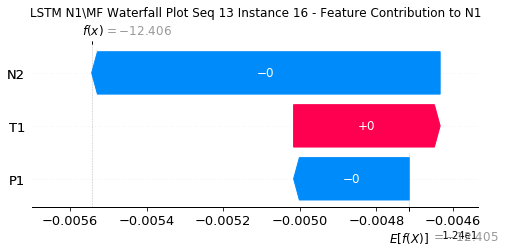

None

Contribution: [-0.00027896  0.00031681 -0.00086402]


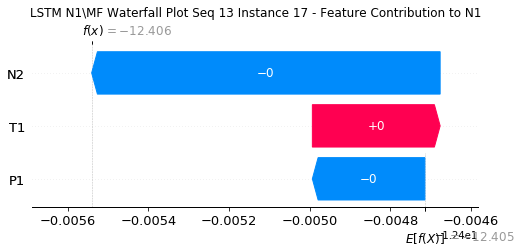

None

Contribution: [-0.00025055  0.00035327 -0.00081717]


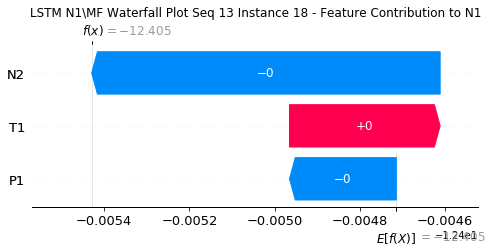

None

Contribution: [-0.00024318  0.00035224 -0.00079001]


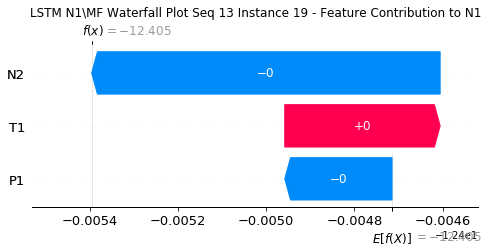

None

Contribution: [-0.00023331  0.00034107 -0.00077515]


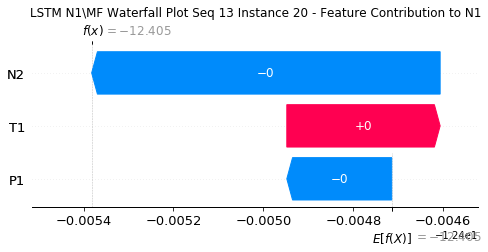

None

Contribution: [-0.00022487  0.00035676 -0.00078104]


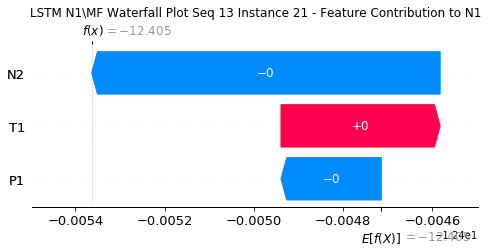

None

Contribution: [-0.00024313  0.0003725  -0.00079469]


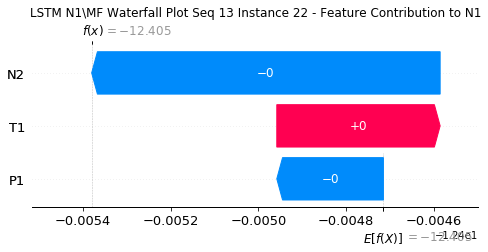

None

Contribution: [-0.00020796  0.00069841 -0.00094504]


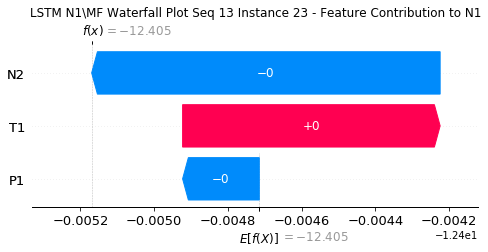

None

Contribution: [-0.00124972  0.00910528 -0.00761154]


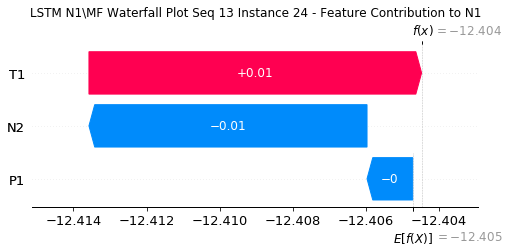

None

Contribution: [-0.0567735  0.0720645 -0.1769044]


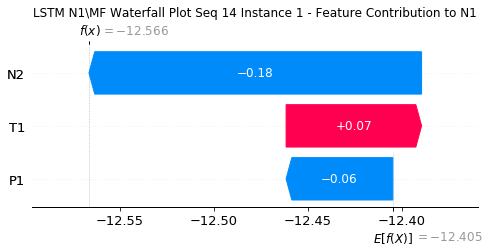

None

Contribution: [0.00175731 0.00205208 0.00547188]


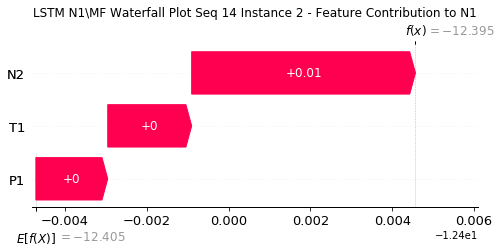

None

Contribution: [ 7.72291119e-06  2.94849850e-04 -7.47241256e-05]


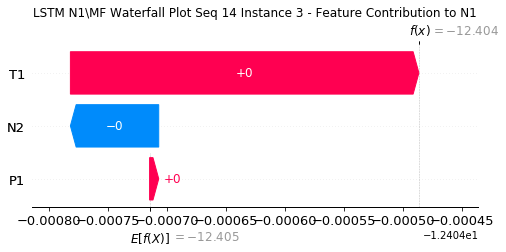

None

Contribution: [-1.78607679e-05 -1.83538576e-05 -1.24731844e-04]


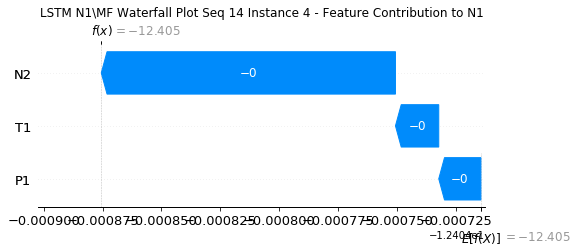

None

Contribution: [-7.28260433e-05 -7.13802209e-04 -2.89072392e-04]


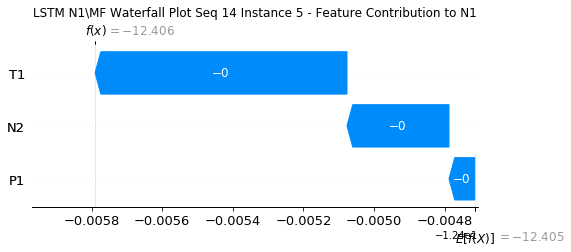

None

Contribution: [-1.12307575e-04  2.24539620e-05 -4.49950892e-04]


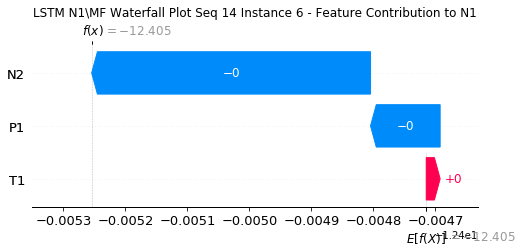

None

Contribution: [-0.00021244  0.00035568 -0.00065032]


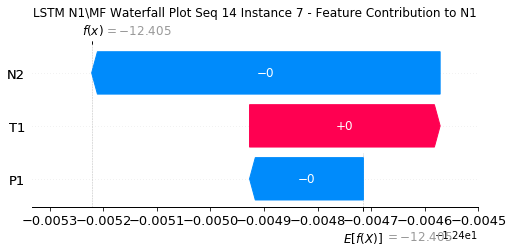

None

Contribution: [-0.0002376   0.00017444 -0.00080104]


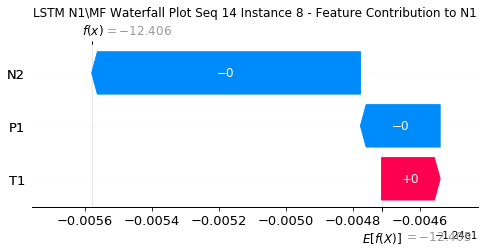

None

Contribution: [-2.54408899e-04  5.95922186e-05 -9.03658950e-04]


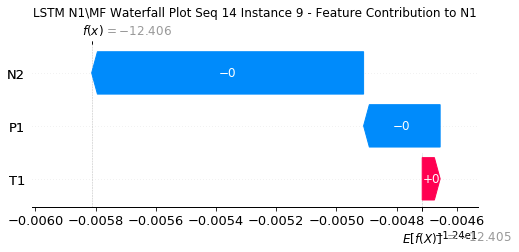

None

Contribution: [-0.00029233  0.00013407 -0.00098414]


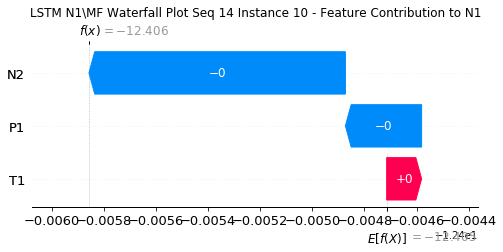

None

Contribution: [-0.00029913  0.00013241 -0.00098735]


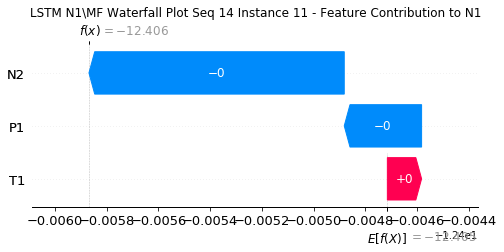

None

Contribution: [-0.00028298  0.00012505 -0.00099229]


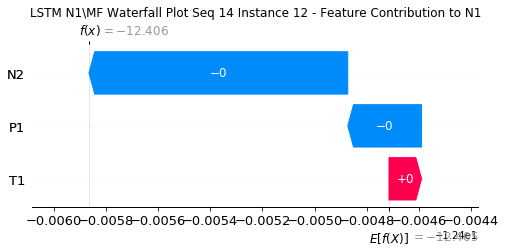

None

Contribution: [-0.00030002  0.00012101 -0.00100786]


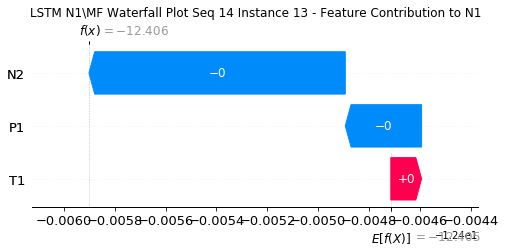

None

Contribution: [-0.00028306  0.00017807 -0.00099574]


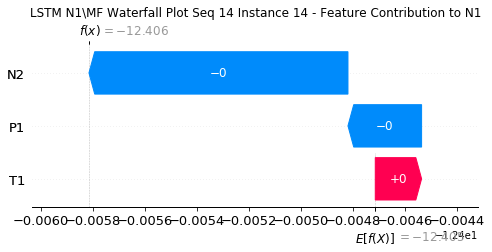

None

Contribution: [-0.00027587  0.00017933 -0.00096208]


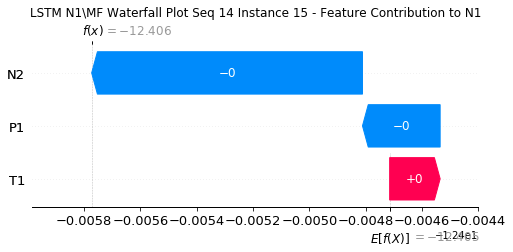

None

Contribution: [-0.00025845  0.00018593 -0.00090601]


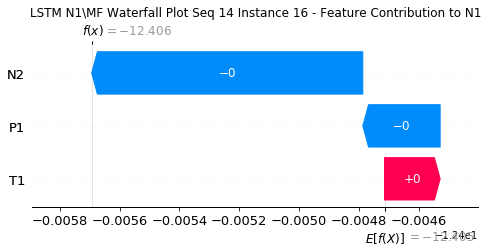

None

Contribution: [-0.00024561  0.00023478 -0.00084974]


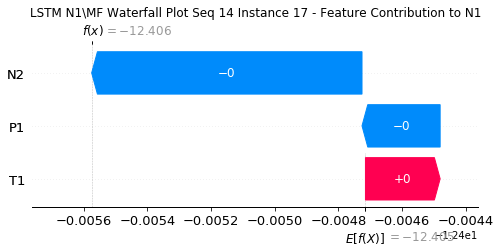

None

Contribution: [-0.00022955  0.00019615 -0.00081849]


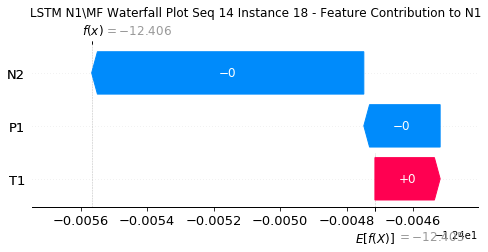

None

Contribution: [-0.00022173  0.00019312 -0.00079081]


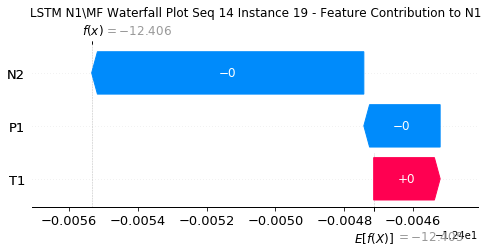

None

Contribution: [-0.00021296  0.00018597 -0.00077697]


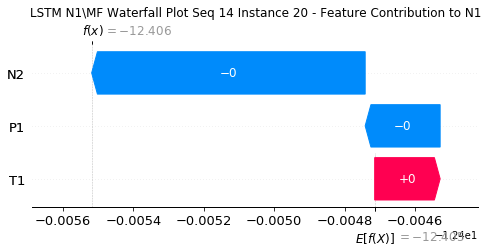

None

Contribution: [-0.00019744  0.00018671 -0.00078027]


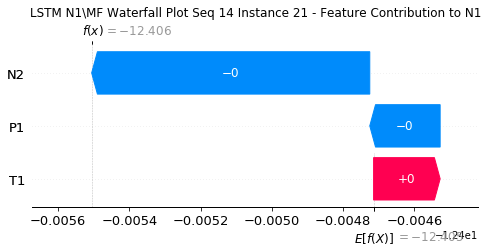

None

Contribution: [-0.00022472  0.00020893 -0.00079993]


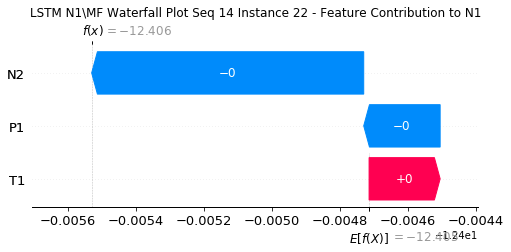

None

Contribution: [-0.00019289  0.00041519 -0.00095634]


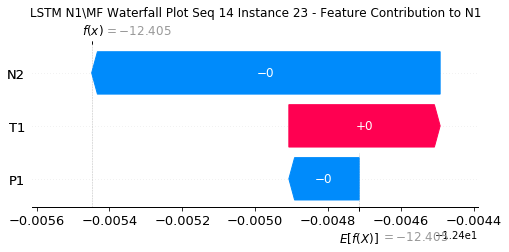

None

Contribution: [-0.00127081  0.00304462 -0.00745598]


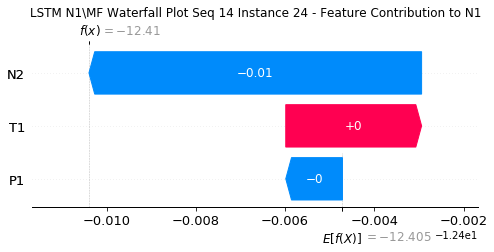

None

Contribution: [-0.05717008  0.09414195 -0.17577905]


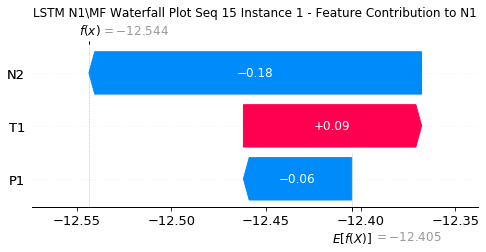

None

Contribution: [0.00170172 0.00279642 0.00533005]


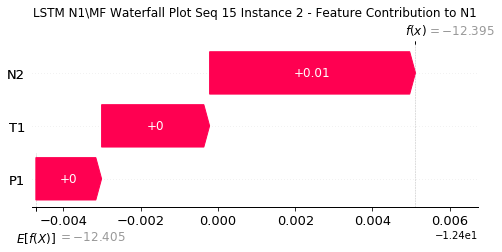

None

Contribution: [-3.40991901e-05  5.74615701e-04 -1.14976145e-04]


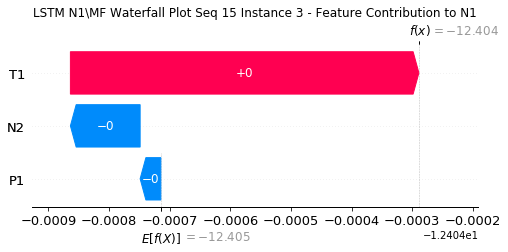

None

Contribution: [-5.35971378e-05  3.60319421e-04 -1.62947055e-04]


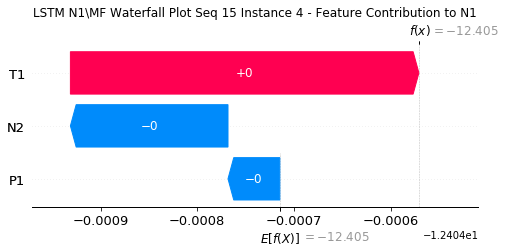

None

Contribution: [-8.65537141e-05  5.05279040e-04 -3.28570672e-04]


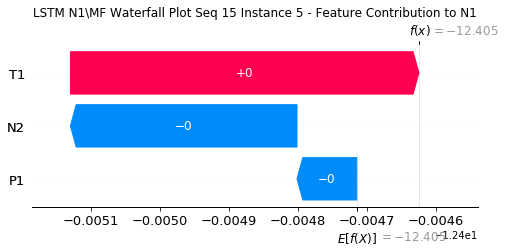

None

Contribution: [-0.00016722  0.00051489 -0.00048812]


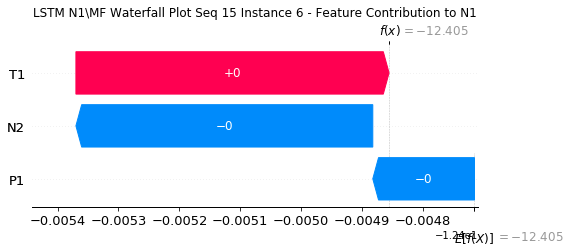

None

Contribution: [-0.00019997  0.00032643 -0.00062965]


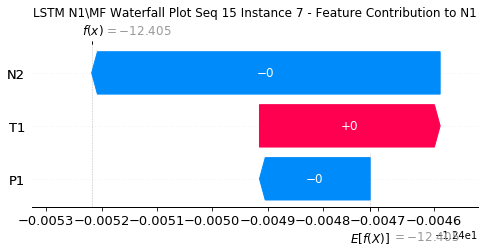

None

Contribution: [-0.00023076  0.00011633 -0.00072511]


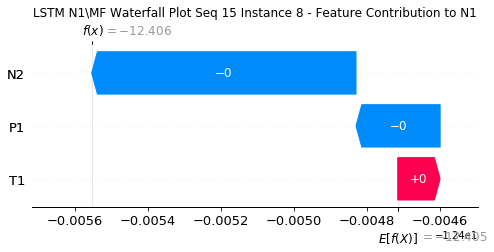

None

Contribution: [-0.00021373  0.00011554 -0.00079834]


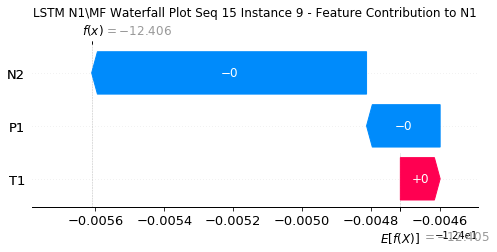

None

Contribution: [-0.00026961  0.00022774 -0.00090557]


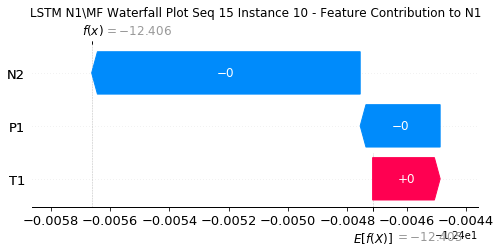

None

Contribution: [-0.00028501  0.00024542 -0.00093295]


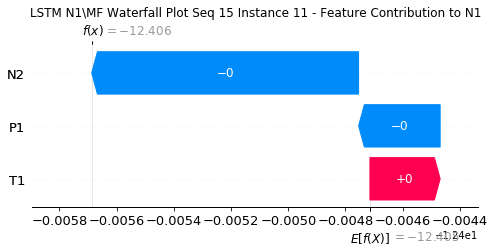

None

Contribution: [-0.00027861  0.00025006 -0.00094084]


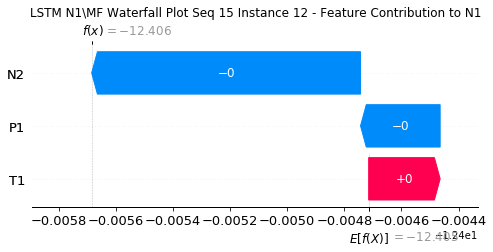

None

Contribution: [-0.00029341  0.00026692 -0.00096084]


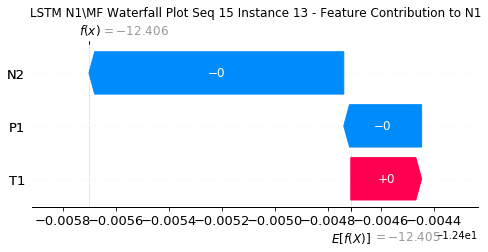

None

Contribution: [-0.00029743  0.00035805 -0.00098159]


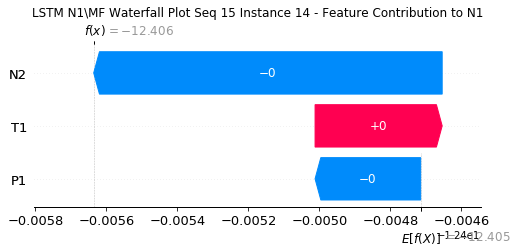

None

Contribution: [-0.00028003  0.00035894 -0.00094882]


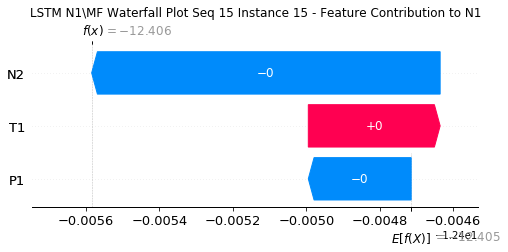

None

Contribution: [-0.00026492  0.00035696 -0.00089648]


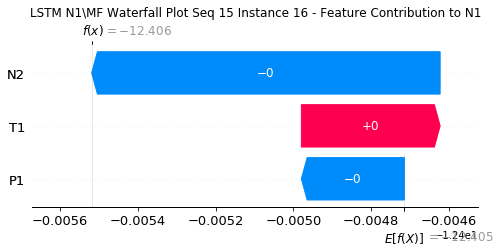

None

Contribution: [-0.00024244  0.00037421 -0.00084741]


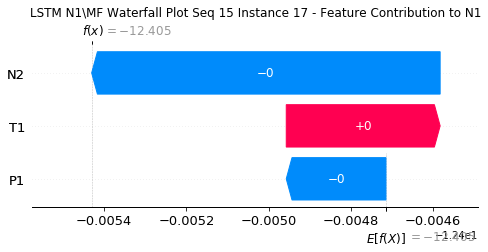

None

Contribution: [-0.00022887  0.00035291 -0.00080869]


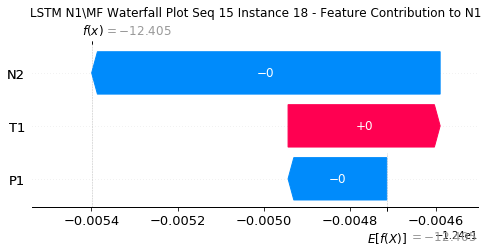

None

Contribution: [-0.00022244  0.00035097 -0.0007829 ]


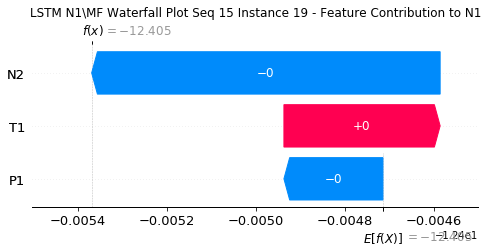

None

Contribution: [-0.00021238  0.00035125 -0.00076889]


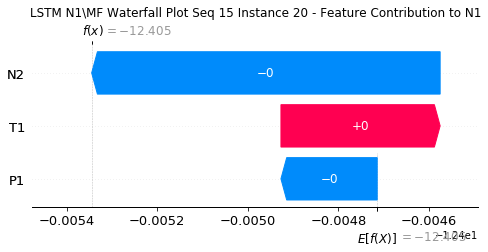

None

Contribution: [-0.0001991   0.00036479 -0.00077729]


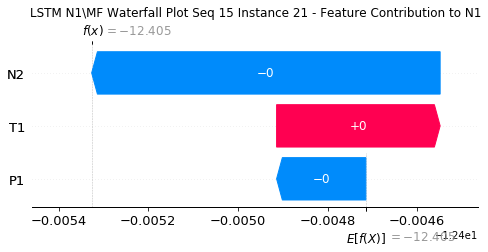

None

Contribution: [-0.00022424  0.00040721 -0.00078909]


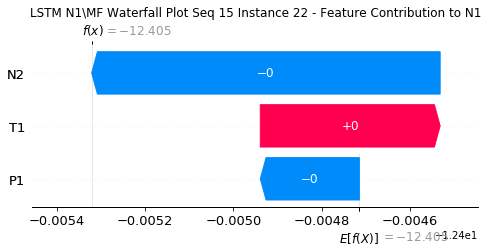

None

Contribution: [-0.00020483  0.00080542 -0.00096263]


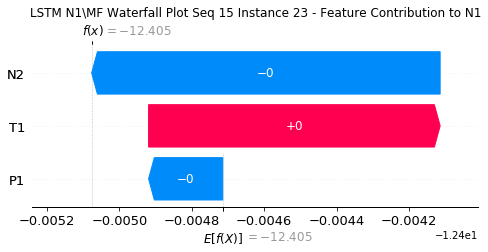

None

Contribution: [-0.00125083  0.00645616 -0.00791141]


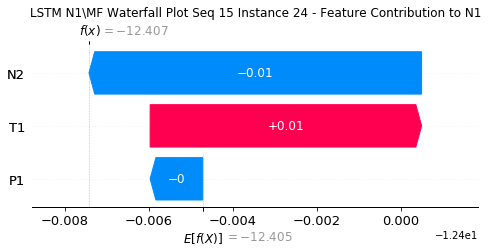

None

Contribution: [-0.05588317  0.09012857 -0.17553419]


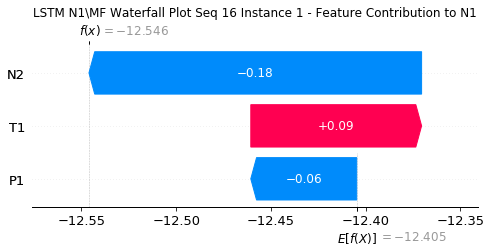

None

Contribution: [0.00169649 0.00241352 0.00540628]


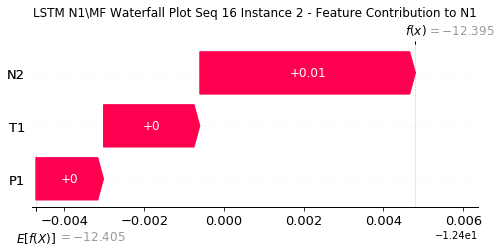

None

Contribution: [-4.45895061e-05  4.69272515e-04 -9.72439399e-05]


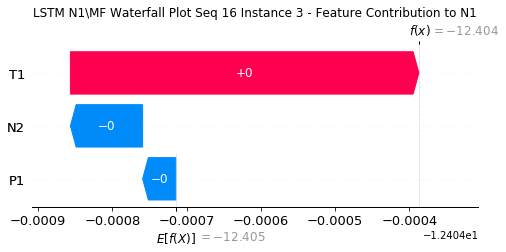

None

Contribution: [-5.21551772e-05  2.12123302e-04 -1.43535230e-04]


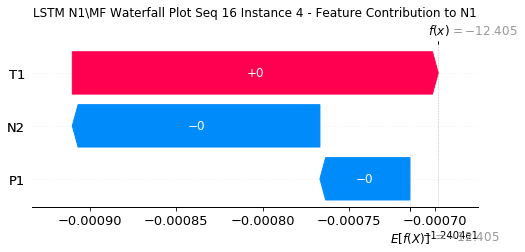

None

Contribution: [-6.54170722e-05  1.79092285e-04 -2.91051979e-04]


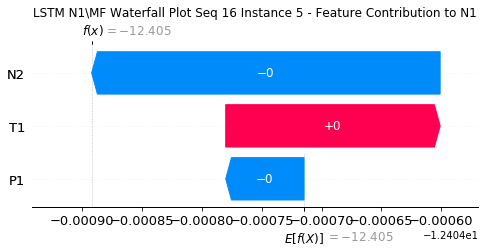

None

Contribution: [-0.00016863  0.00033587 -0.00047132]


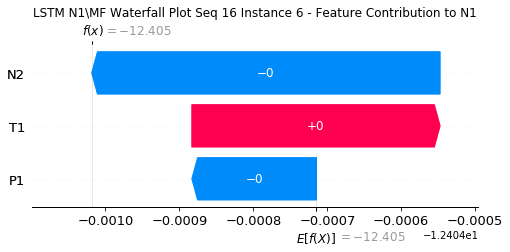

None

Contribution: [-0.00020933  0.00036938 -0.00064167]


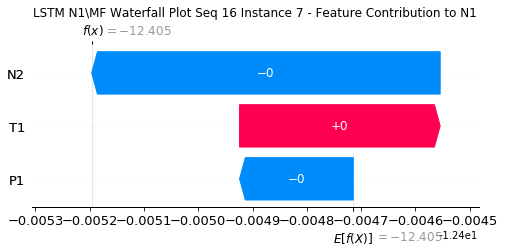

None

Contribution: [-0.00022169  0.00013513 -0.00076437]


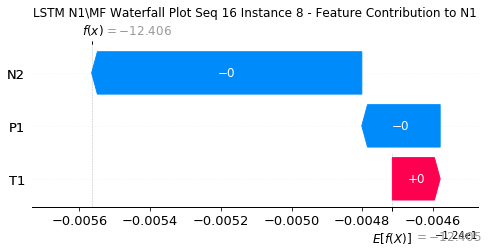

None

Contribution: [-0.00024334  0.00011067 -0.00086075]


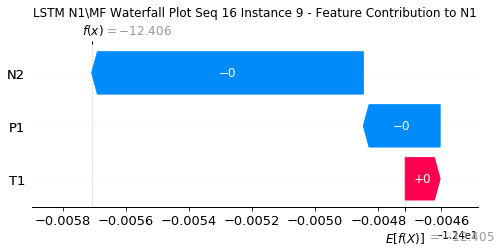

None

Contribution: [-0.00028045  0.00016135 -0.00093819]


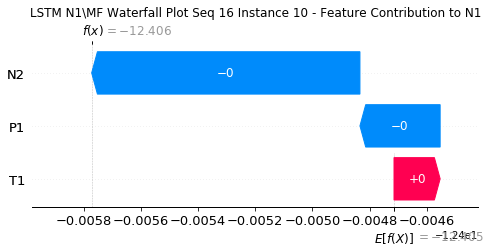

None

Contribution: [-0.0002901   0.00016576 -0.00095601]


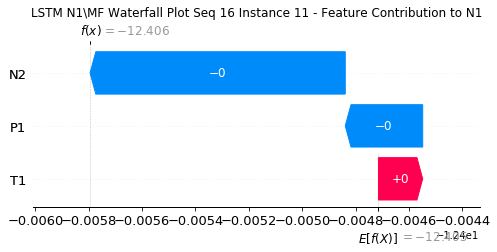

None

Contribution: [-0.00028404  0.00013418 -0.00095863]


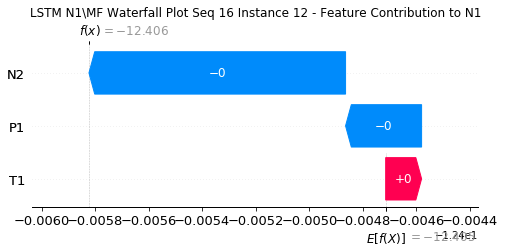

None

Contribution: [-0.00029919  0.00016189 -0.00098586]


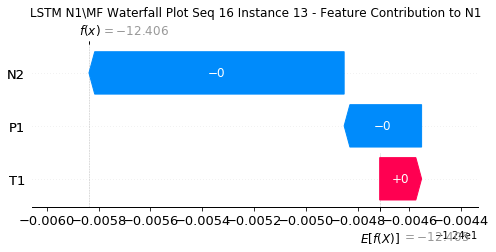

None

Contribution: [-0.00031028  0.00018846 -0.00099172]


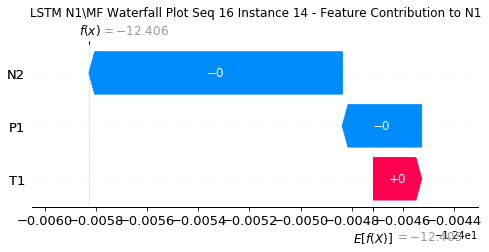

None

Contribution: [-0.00028507  0.000227   -0.00096908]


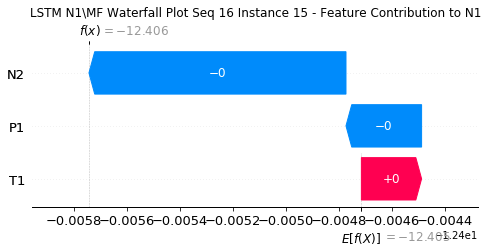

None

Contribution: [-0.00026496  0.00024038 -0.00091328]


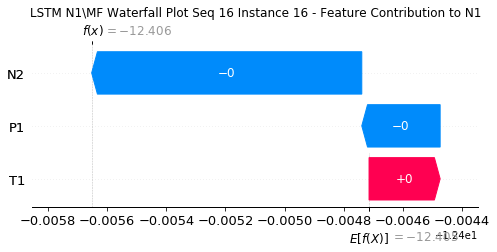

None

Contribution: [-0.00025469  0.00027183 -0.00085779]


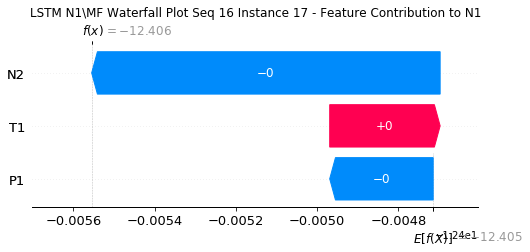

None

Contribution: [-0.00022473  0.00025385 -0.00082044]


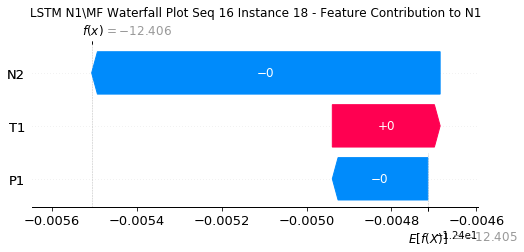

None

Contribution: [-0.00021671  0.00025407 -0.00079142]


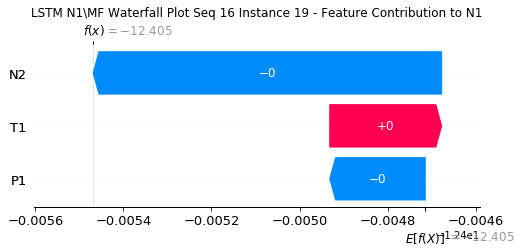

None

Contribution: [-0.00020686  0.00025059 -0.00077549]


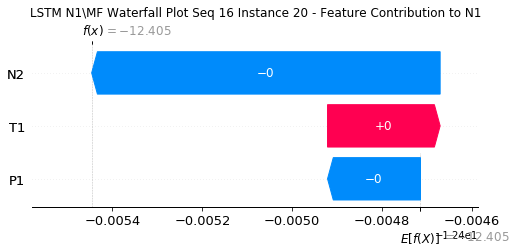

None

Contribution: [-0.00019735  0.000253   -0.00078101]


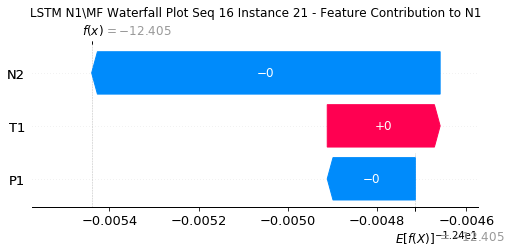

None

Contribution: [-0.00022008  0.00027063 -0.000796  ]


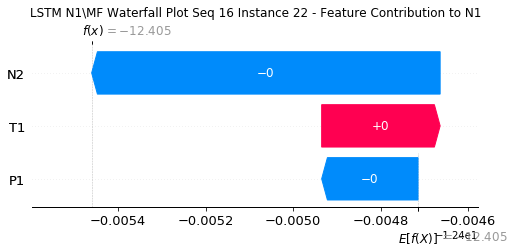

None

Contribution: [-0.00020192  0.00053739 -0.00094988]


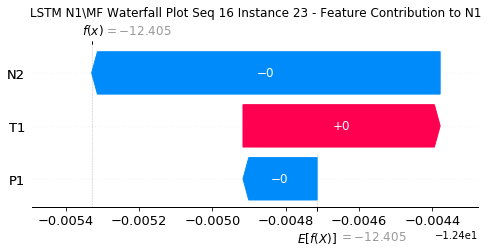

None

Contribution: [-0.00126478  0.00722524 -0.00757231]


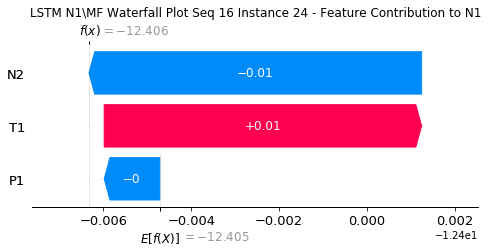

None

Contribution: [-0.05557922  0.08985314 -0.17573511]


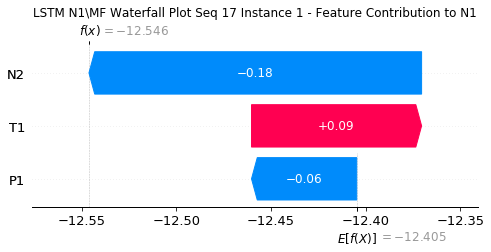

None

Contribution: [0.00169729 0.00239415 0.00539924]


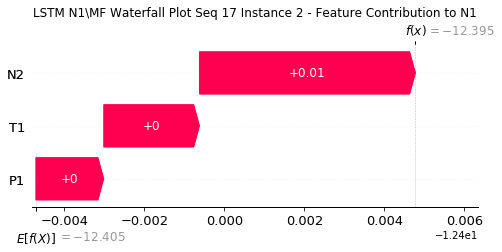

None

Contribution: [-2.75913922e-05  3.76759261e-04 -9.83401351e-05]


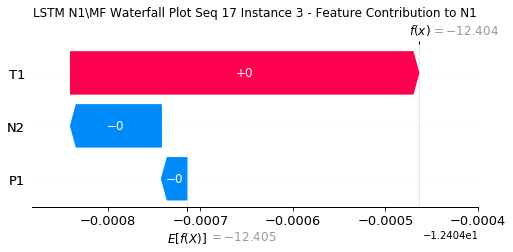

None

Contribution: [-4.69932007e-05  1.51800517e-04 -1.45361553e-04]


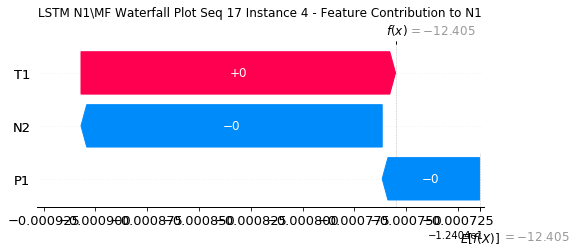

None

Contribution: [-8.58561809e-05  1.17015685e-04 -2.99046801e-04]


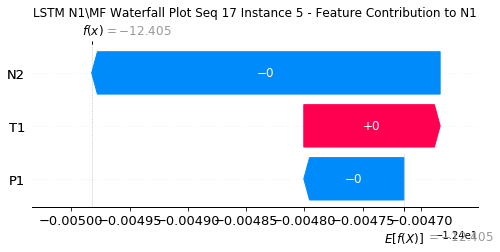

None

Contribution: [-0.00015973  0.00022768 -0.00047302]


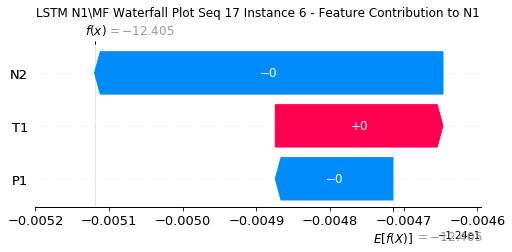

None

Contribution: [-0.00020955  0.00036234 -0.00064157]


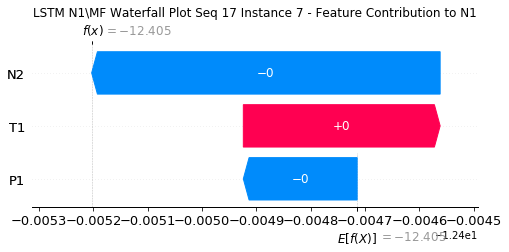

None

Contribution: [-0.00022789  0.00016481 -0.00076898]


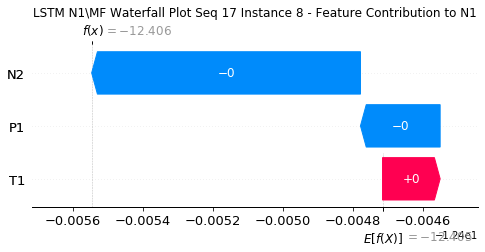

None

Contribution: [-0.00022556  0.00013512 -0.00085141]


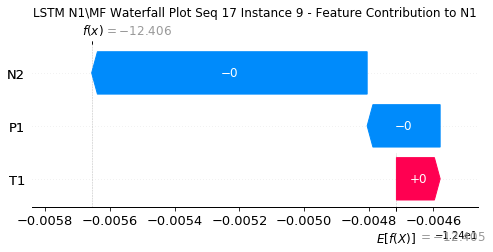

None

Contribution: [-0.00026357  0.00023114 -0.0009249 ]


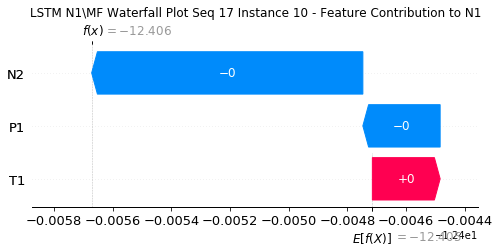

None

Contribution: [-0.00028064  0.00022693 -0.00094666]


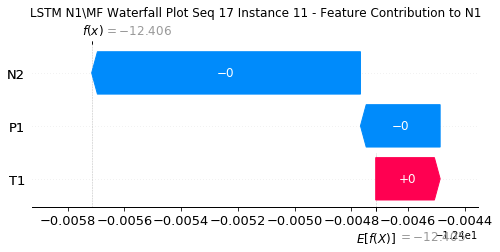

None

Contribution: [-0.00027545  0.00019594 -0.00095478]


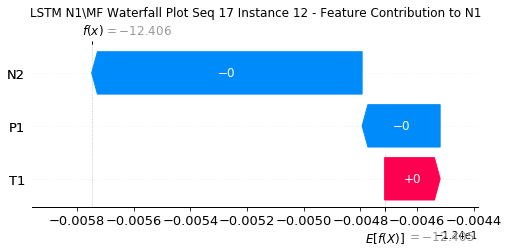

None

Contribution: [-0.00028723  0.00021963 -0.00097355]


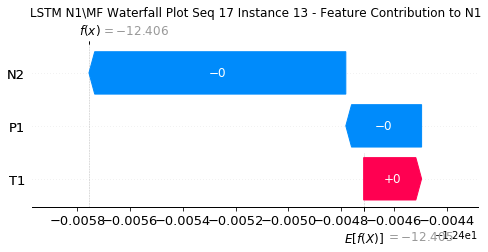

None

Contribution: [-0.00030789  0.00025781 -0.0009837 ]


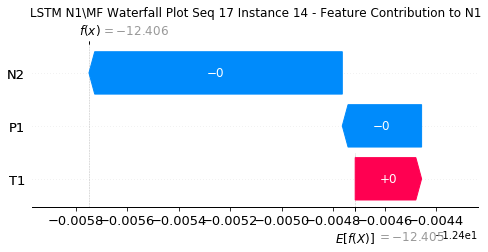

None

Contribution: [-0.00027595  0.00028106 -0.00096116]


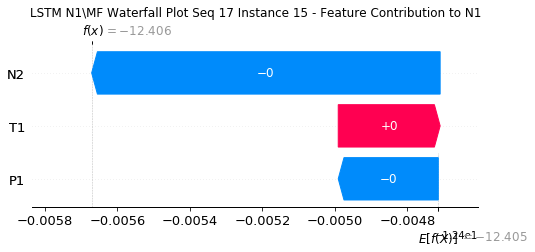

None

Contribution: [-0.00025951  0.00029278 -0.00090935]


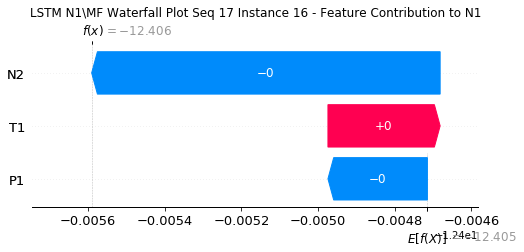

None

Contribution: [-0.00025193  0.00029567 -0.0008483 ]


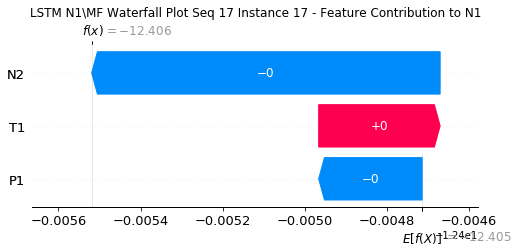

None

Contribution: [-0.00023483  0.00028656 -0.00081906]


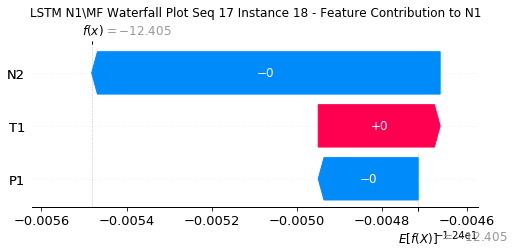

None

Contribution: [-0.00022594  0.00028771 -0.00079066]


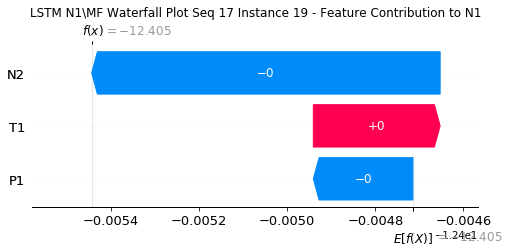

None

Contribution: [-0.00021645  0.00028438 -0.00077372]


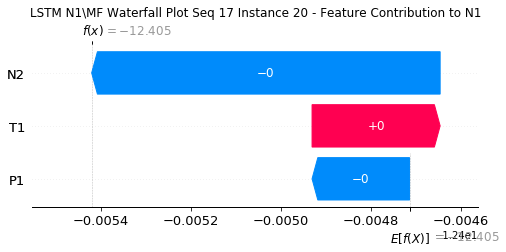

None

Contribution: [-0.0001986   0.00029273 -0.00077776]


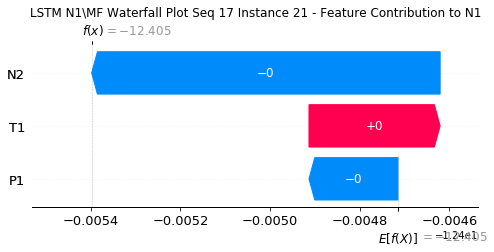

None

Contribution: [-0.00023218  0.00031895 -0.00079776]


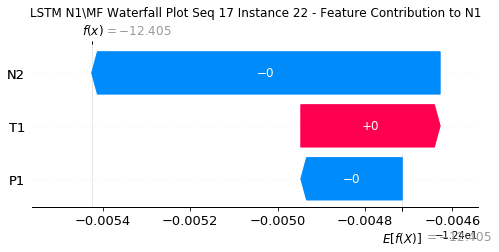

None

Contribution: [-0.00018987  0.00073041 -0.00098422]


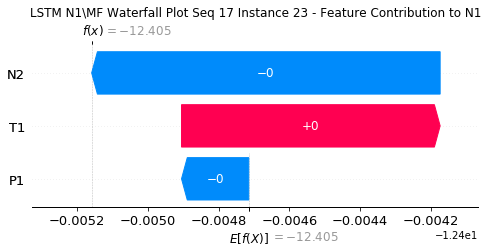

None

Contribution: [-0.00125563  0.00959333 -0.00745147]


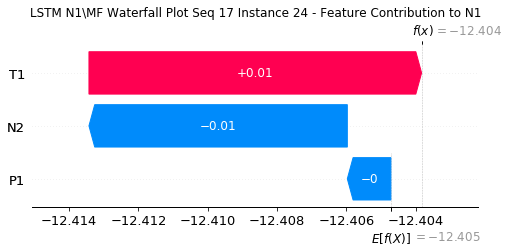

None

Contribution: [-0.05398532  0.05996867 -0.17887399]


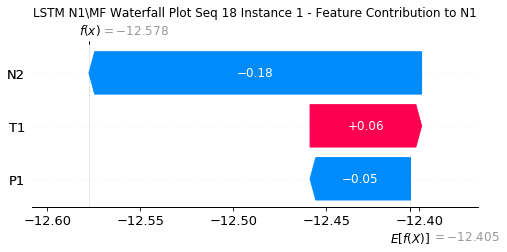

None

Contribution: [0.00171517 0.00186801 0.00549297]


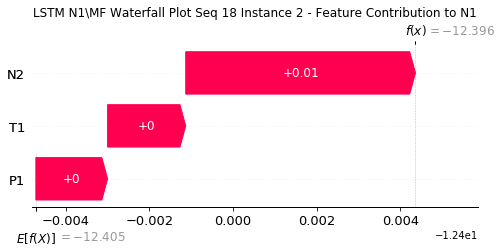

None

Contribution: [-2.13372978e-05  1.60166120e-04 -9.33842005e-05]


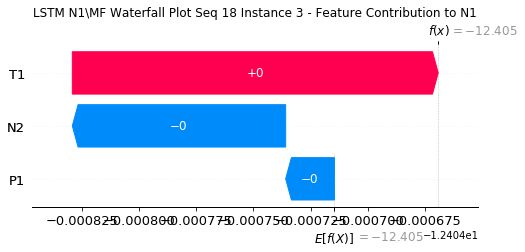

None

Contribution: [-3.59822921e-05 -1.70232851e-04 -1.34256469e-04]


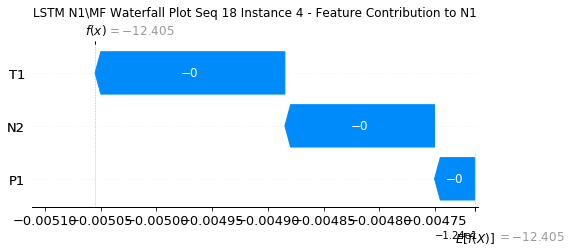

None

Contribution: [-9.06918899e-05 -4.56016226e-04 -2.53875348e-04]


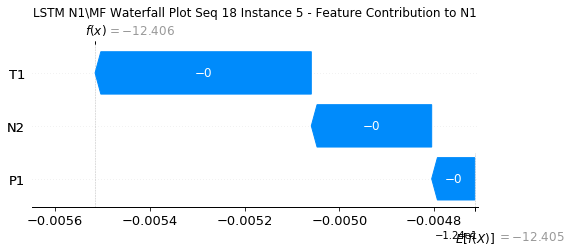

None

Contribution: [-0.00014462 -0.00026196 -0.00046818]


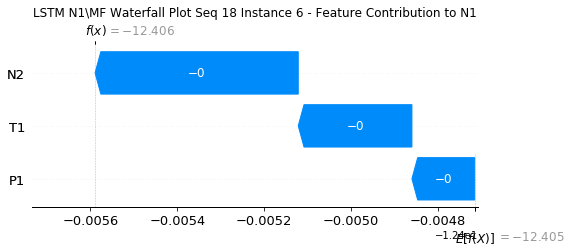

None

Contribution: [-0.000218    0.00026124 -0.00065563]


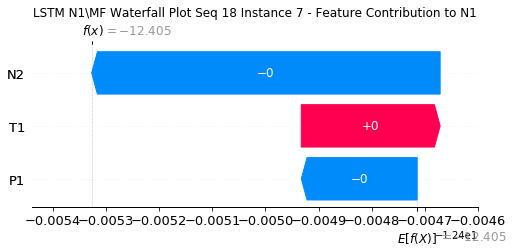

None

Contribution: [-0.00024345  0.0002586  -0.00080809]


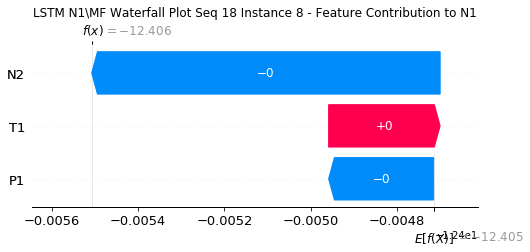

None

Contribution: [-0.00023583  0.00013598 -0.00090199]


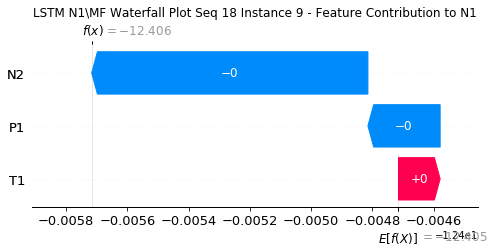

None

Contribution: [-0.00029148  0.00016043 -0.00099328]


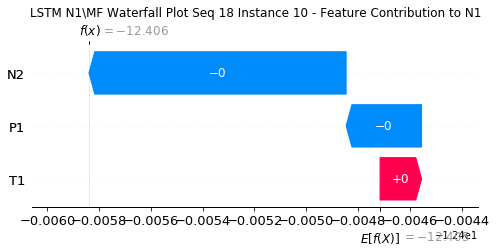

None

Contribution: [-0.00030046  0.00014883 -0.0010009 ]


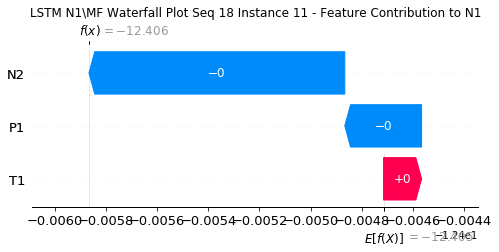

None

Contribution: [-0.00029025  0.00014129 -0.00098605]


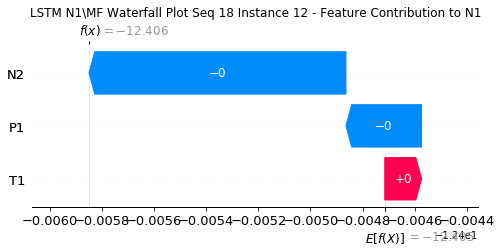

None

Contribution: [-0.00030391  0.00014214 -0.00101539]


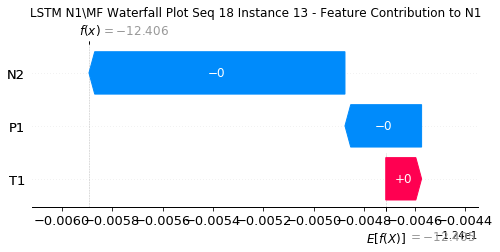

None

Contribution: [-0.00031367  0.00014884 -0.00100485]


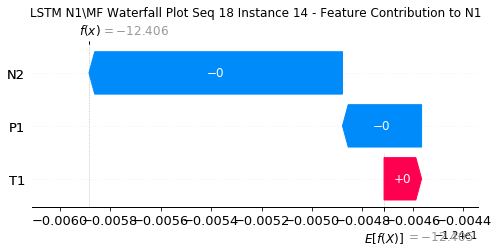

None

Contribution: [-0.00028442  0.00019323 -0.00096649]


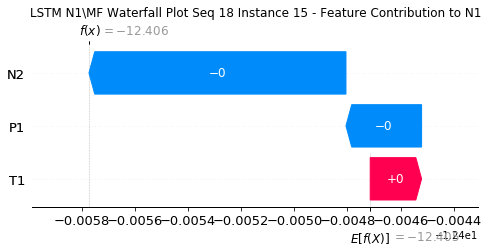

None

Contribution: [-0.00026588  0.00020495 -0.00090721]


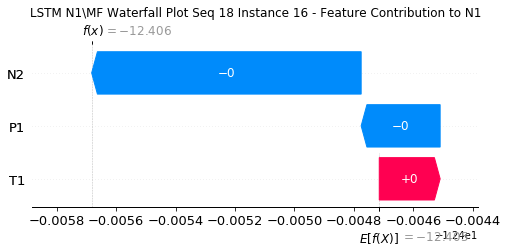

None

Contribution: [-0.00025158  0.00022581 -0.00084782]


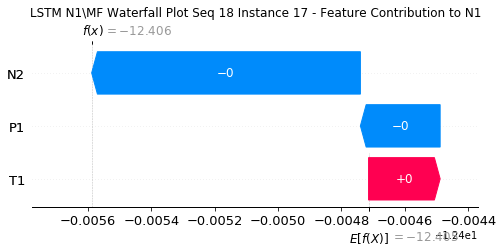

None

Contribution: [-0.00023839  0.00021342 -0.00081858]


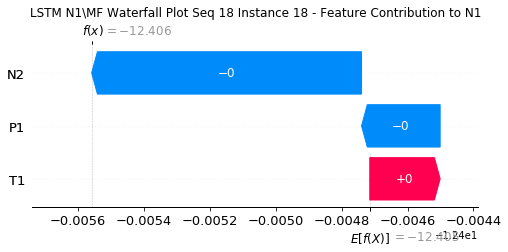

None

Contribution: [-0.00022974  0.00021518 -0.00078989]


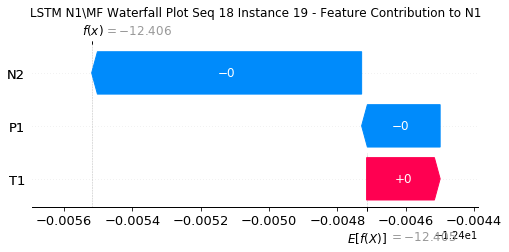

None

Contribution: [-0.00022139  0.00021787 -0.00077588]


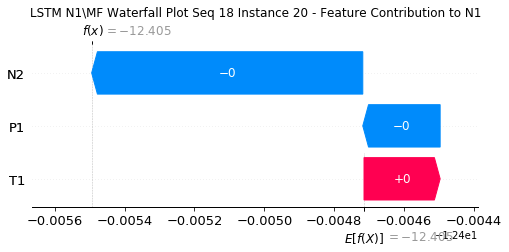

None

Contribution: [-0.00020817  0.00022436 -0.00077948]


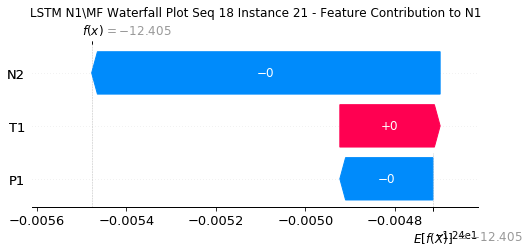

None

Contribution: [-0.00023188  0.00025919 -0.00079705]


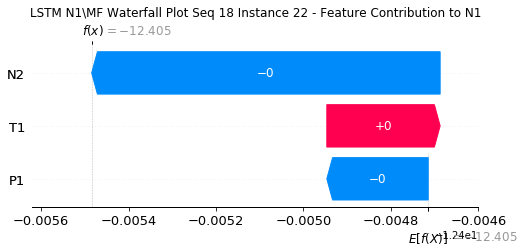

None

Contribution: [-0.00020014  0.00070747 -0.0009476 ]


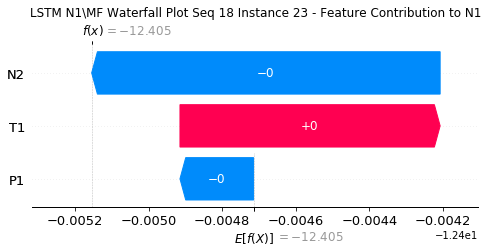

None

Contribution: [-0.00126504  0.00925634 -0.00778339]


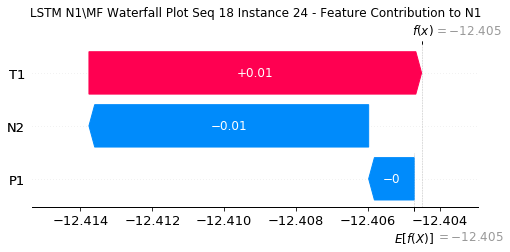

None

Contribution: [-0.05430454  0.07989186 -0.17416166]


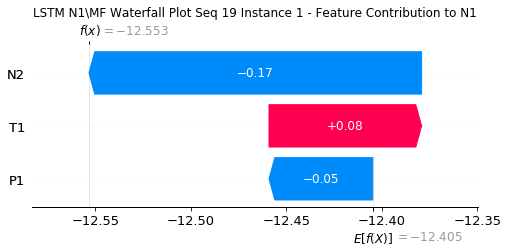

None

Contribution: [0.00168329 0.00220062 0.00542229]


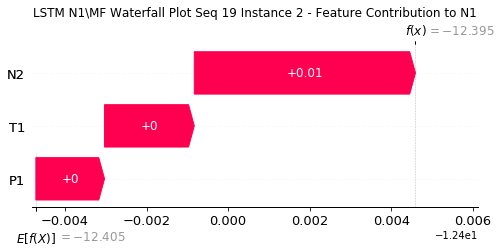

None

Contribution: [-1.29740576e-06  4.09245276e-04 -8.50170113e-05]


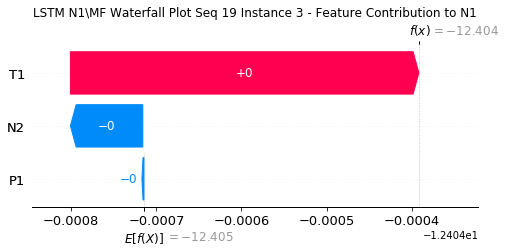

None

Contribution: [-2.74107870e-05  1.30360819e-04 -1.33925734e-04]


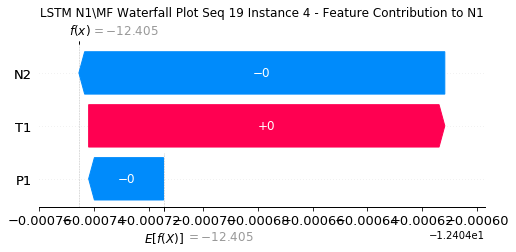

None

Contribution: [ 1.40137427e-05 -7.11702514e-05 -2.81384294e-04]


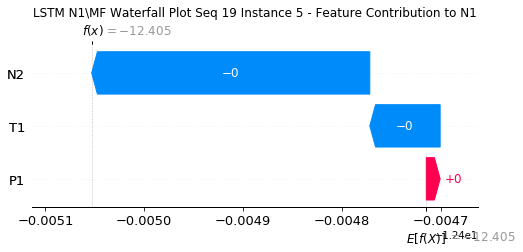

None

Contribution: [-0.00011547  0.00021078 -0.00045715]


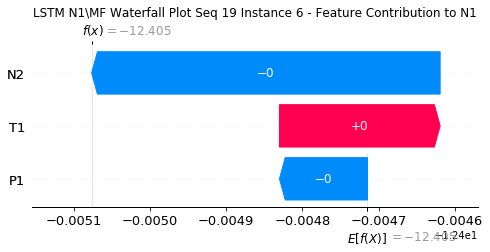

None

Contribution: [-0.00021287  0.000367   -0.00064391]


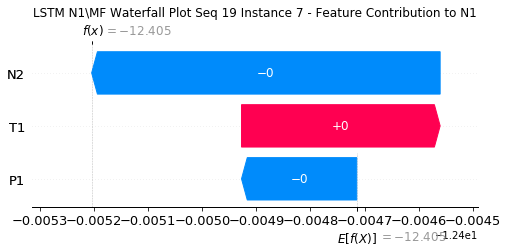

None

Contribution: [-0.0002703   0.00017597 -0.00079397]


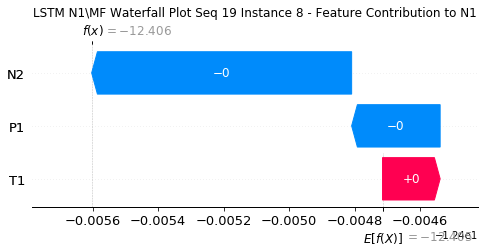

None

Contribution: [-2.61076776e-04  7.71749085e-05 -8.81916770e-04]


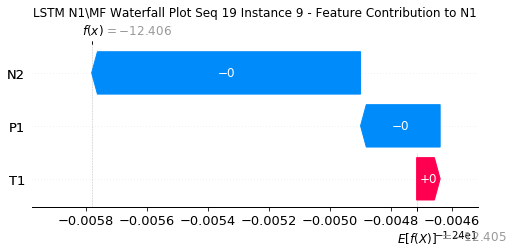

None

Contribution: [-0.00030011  0.00015034 -0.00095735]


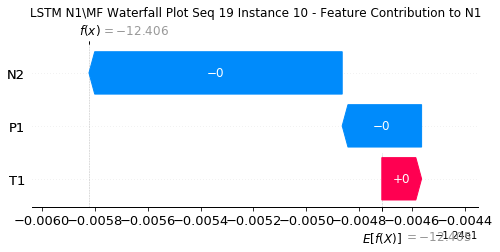

None

Contribution: [-0.00030958  0.00015523 -0.00096721]


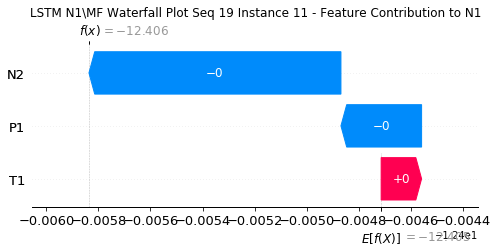

None

Contribution: [-0.00031874  0.00015119 -0.00097912]


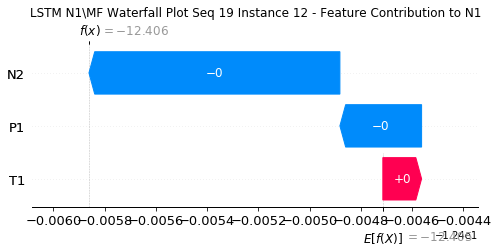

None

Contribution: [-0.00031384  0.0001496  -0.00099394]


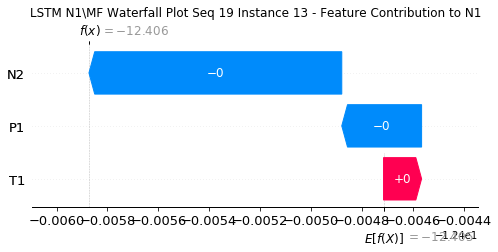

None

Contribution: [-0.00032794  0.00019513 -0.00100128]


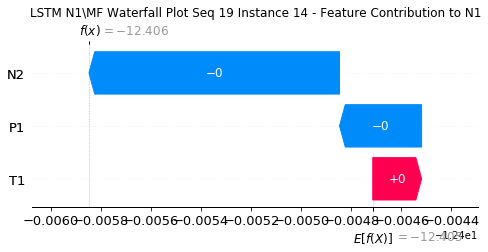

None

Contribution: [-0.00029698  0.00022076 -0.00096765]


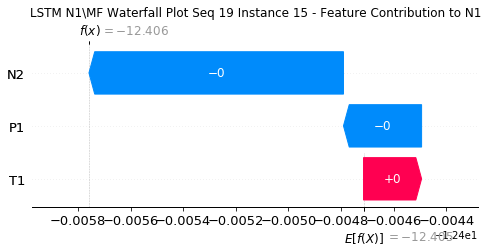

None

Contribution: [-0.00027492  0.00023697 -0.00091087]


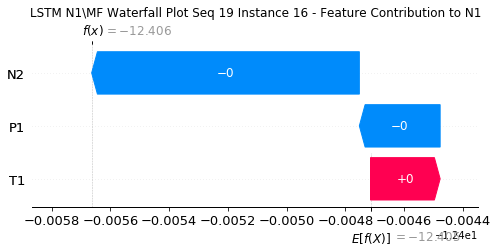

None

Contribution: [-0.00026911  0.00024365 -0.00086866]


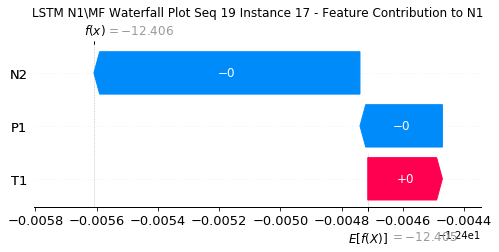

None

Contribution: [-0.00024275  0.00025434 -0.00081886]


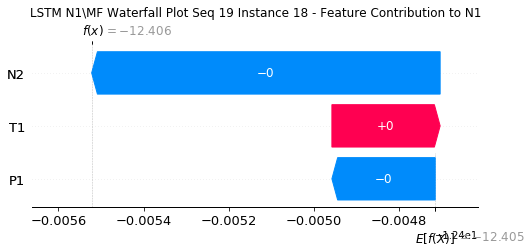

None

Contribution: [-0.00023332  0.00025464 -0.00079021]


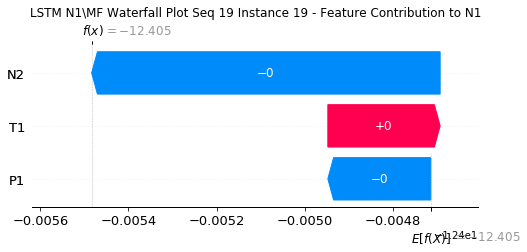

None

Contribution: [-0.00022441  0.00025083 -0.0007741 ]


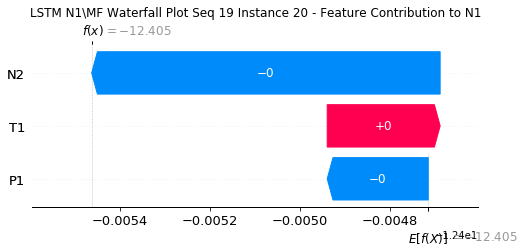

None

Contribution: [-0.00020818  0.00025425 -0.00077747]


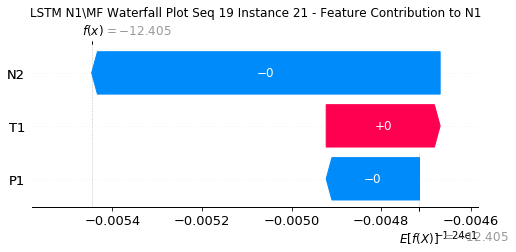

None

Contribution: [-0.00022932  0.00028825 -0.00079202]


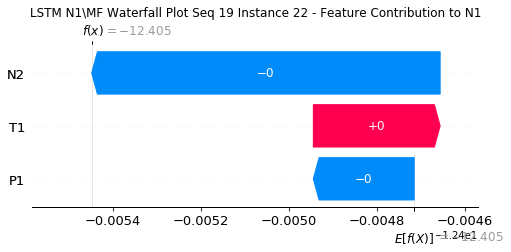

None

Contribution: [-0.00019435  0.00069644 -0.00096722]


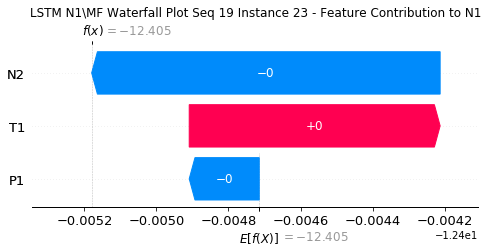

None

Contribution: [-0.00128369  0.00873043 -0.00792016]


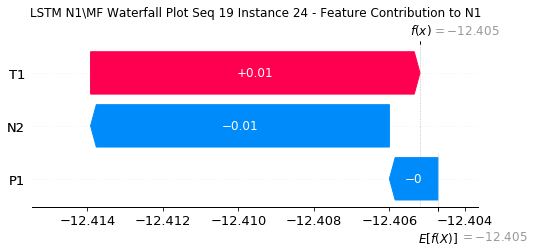

None

Contribution: [-0.05428648  0.08663325 -0.17527216]


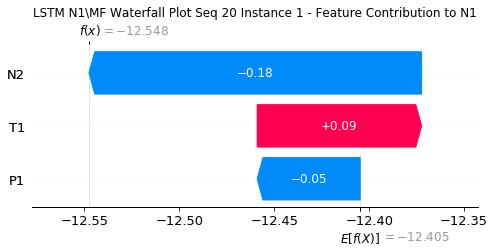

None

Contribution: [0.00171756 0.00231027 0.00539993]


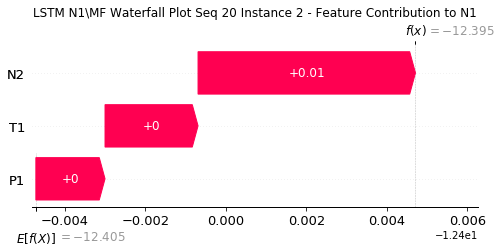

None

Contribution: [-1.54346813e-05  3.55005490e-04 -9.66496430e-05]


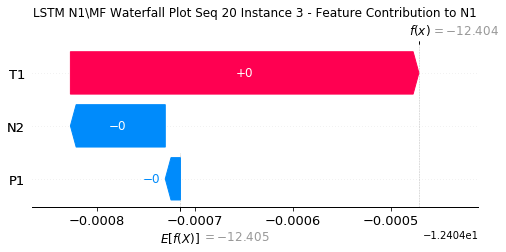

None

Contribution: [-3.41736323e-05  1.32037621e-04 -1.42440730e-04]


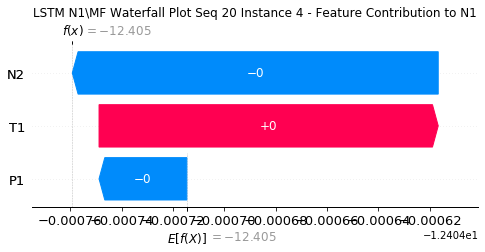

None

Contribution: [-3.12588283e-05 -1.27328559e-05 -2.92796601e-04]


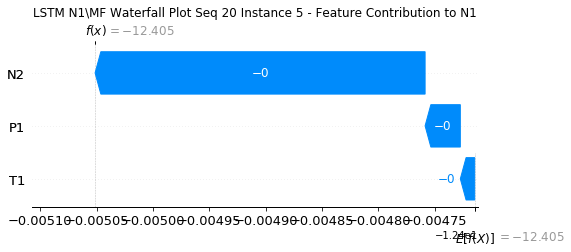

None

Contribution: [-0.00012959  0.0001854  -0.00046953]


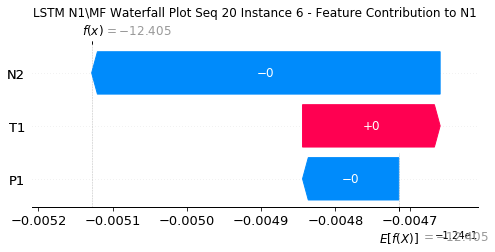

None

Contribution: [-0.00021222  0.00034398 -0.00064178]


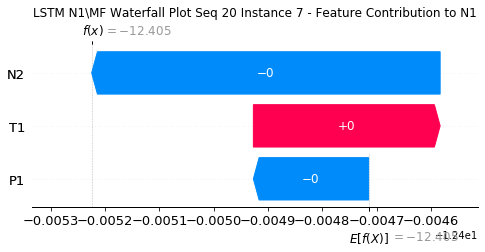

None

Contribution: [-0.00024855  0.00018122 -0.00077252]


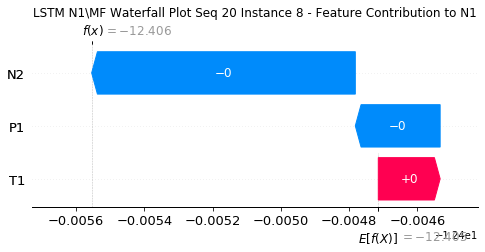

None

Contribution: [-0.0002576   0.00014084 -0.00086772]


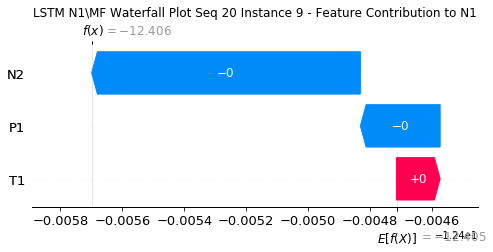

None

Contribution: [-0.00029017  0.00020789 -0.00093172]


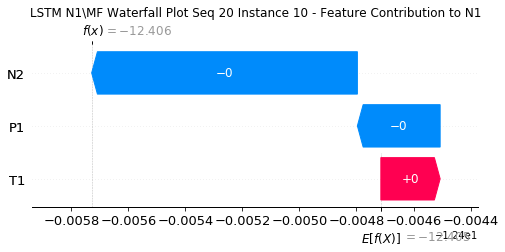

None

Contribution: [-0.00030222  0.00021067 -0.00094879]


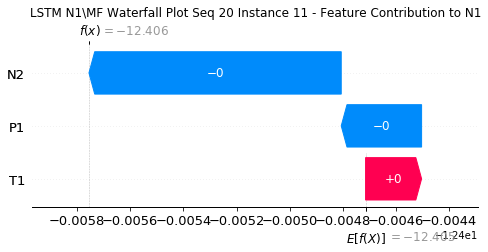

None

Contribution: [-0.00030905  0.00016581 -0.00094561]


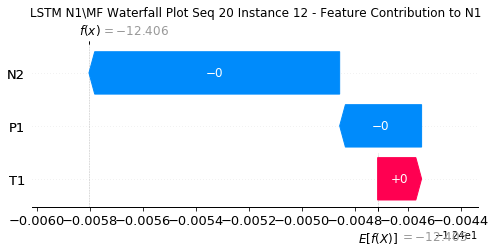

None

Contribution: [-0.00030811  0.00020244 -0.0009754 ]


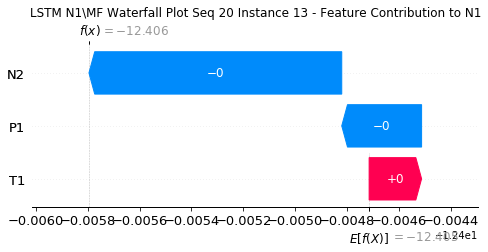

None

Contribution: [-0.00030682  0.00023514 -0.0009784 ]


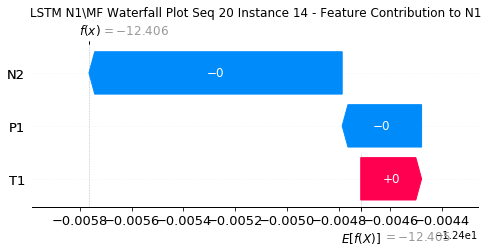

None

Contribution: [-0.00030068  0.00026953 -0.00095939]


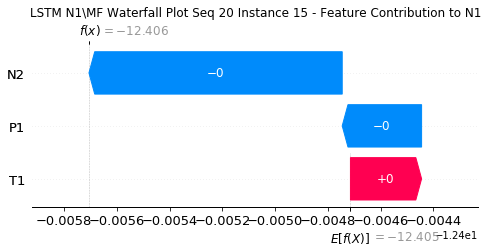

None

Contribution: [-0.00028487  0.00028056 -0.00090681]


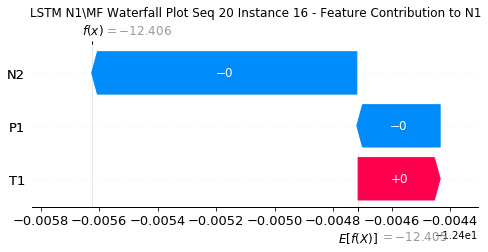

None

Contribution: [-0.00028038  0.00029551 -0.00084733]


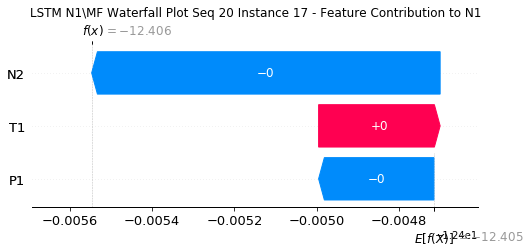

None

Contribution: [-0.00024897  0.00029215 -0.00081238]


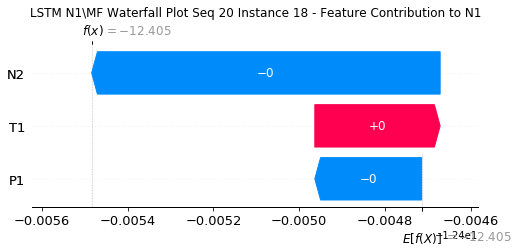

None

Contribution: [-0.00023965  0.00029007 -0.00078398]


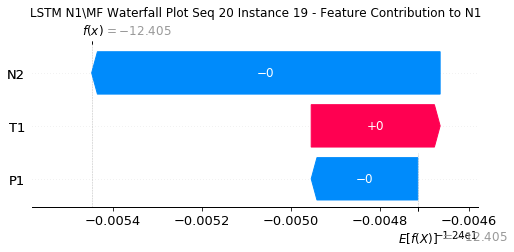

None

Contribution: [-0.00022546  0.00028675 -0.00076469]


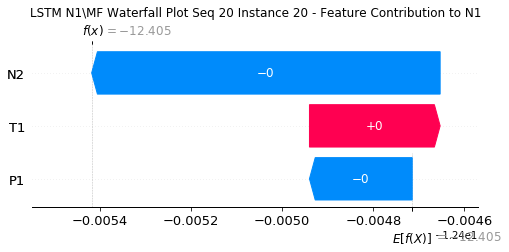

None

Contribution: [-0.00021436  0.00028781 -0.00077051]


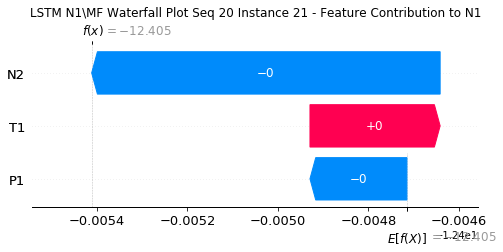

None

Contribution: [-0.00023445  0.00032135 -0.00078178]


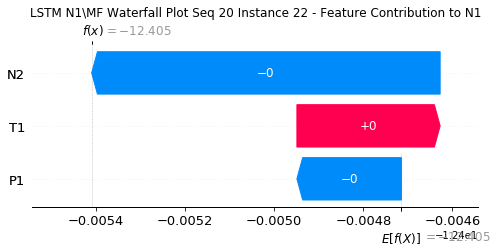

None

Contribution: [-0.00020026  0.00067559 -0.00093807]


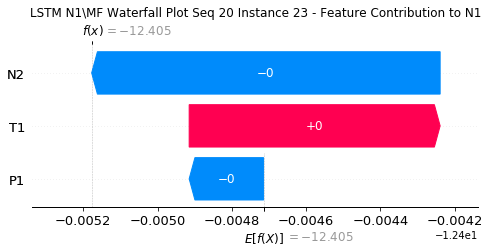

None

Contribution: [-0.00127958  0.00778034 -0.00765394]


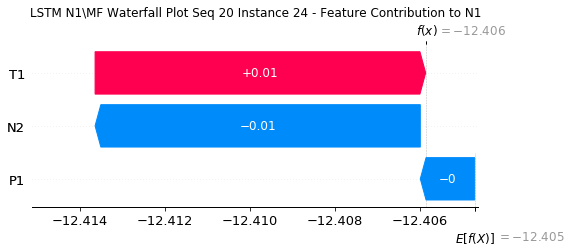

None

Contribution: [-0.05444088  0.08180883 -0.17691844]


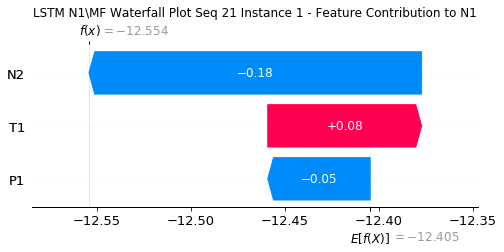

None

Contribution: [0.00167261 0.00222208 0.00543276]


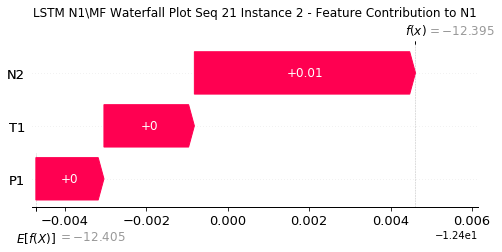

None

Contribution: [-1.82818447e-05  3.50292035e-04 -9.58414397e-05]


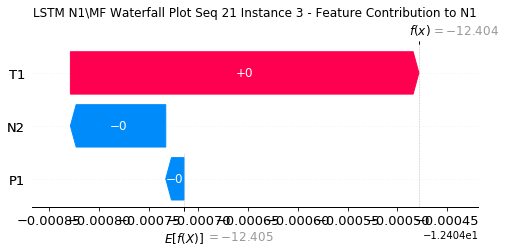

None

Contribution: [-3.71967549e-05  9.36042446e-05 -1.39621865e-04]


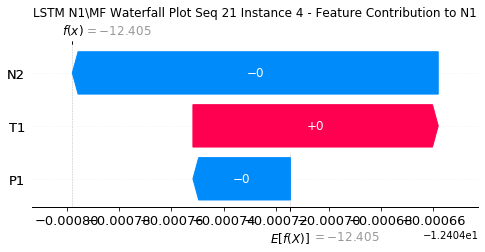

None

Contribution: [ 1.52050750e-05 -3.01533861e-04 -3.15236514e-04]


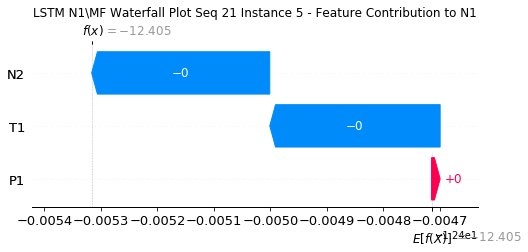

None

Contribution: [-0.00013038  0.00015837 -0.00047234]


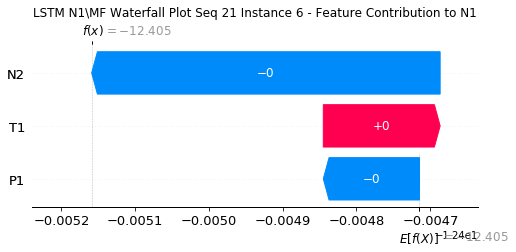

None

Contribution: [-0.00021297  0.00036737 -0.00064697]


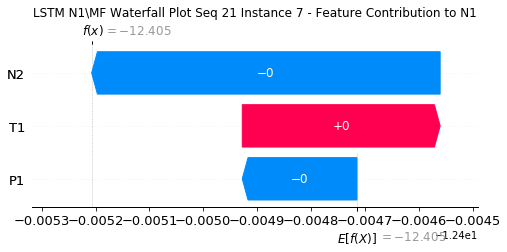

None

Contribution: [-0.0002573   0.00014773 -0.00077983]


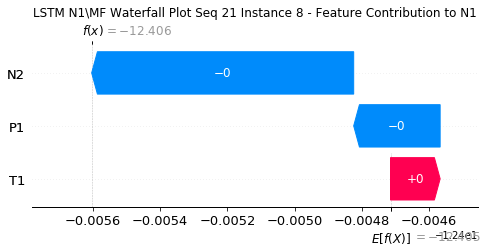

None

Contribution: [-2.60769889e-04  7.97222776e-05 -8.74525004e-04]


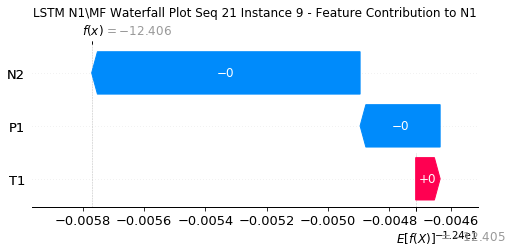

None

Contribution: [-0.00027818  0.00017908 -0.0009504 ]


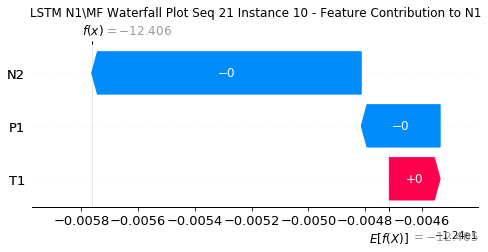

None

Contribution: [-0.00029268  0.00017749 -0.00095941]


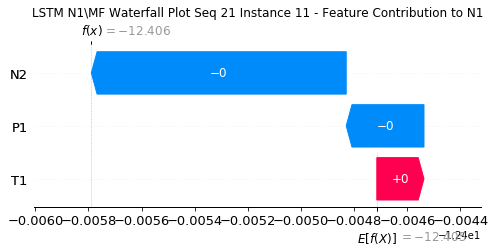

None

Contribution: [-0.00031931  0.00016666 -0.0009767 ]


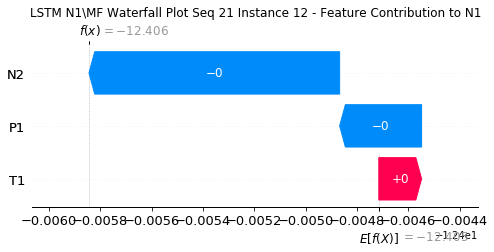

None

Contribution: [-0.00030155  0.00016816 -0.00098645]


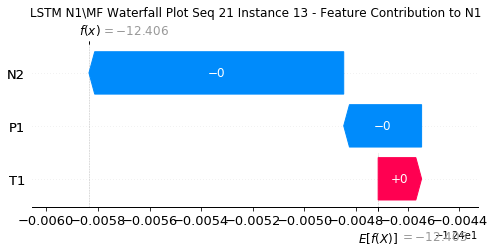

None

Contribution: [-0.00032989  0.000193   -0.00099576]


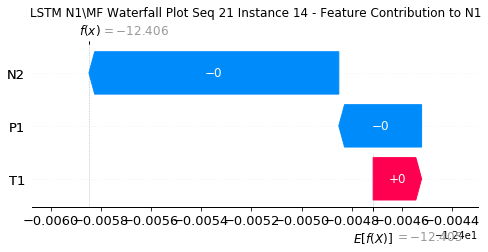

None

Contribution: [-0.0003131   0.00026069 -0.00097213]


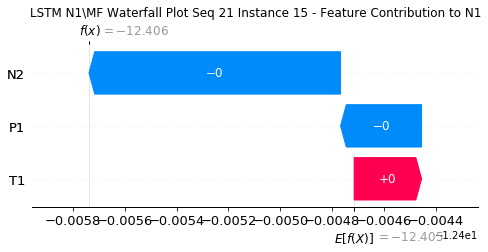

None

Contribution: [-0.00028698  0.00026922 -0.00091658]


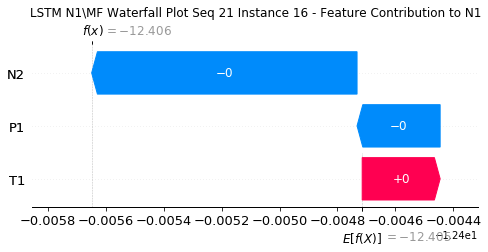

None

Contribution: [-0.00027362  0.00027969 -0.0008607 ]


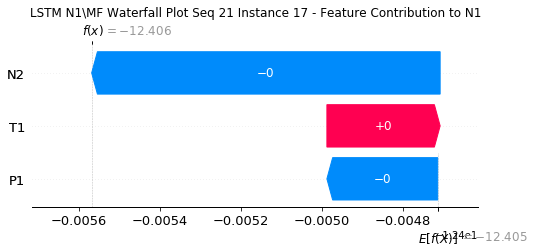

None

Contribution: [-0.00025893  0.00027324 -0.00082613]


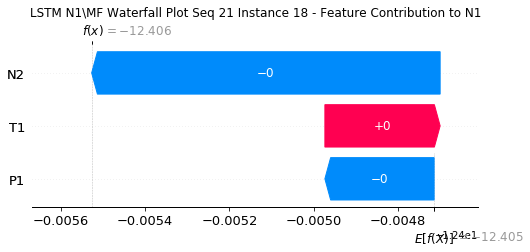

None

Contribution: [-0.00023698  0.00028751 -0.00079021]


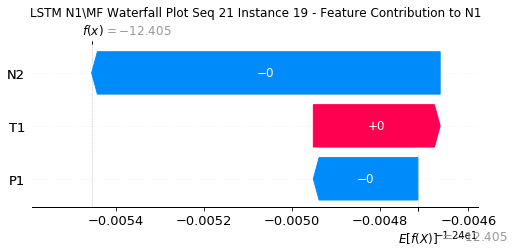

None

Contribution: [-0.00022449  0.00028897 -0.00077646]


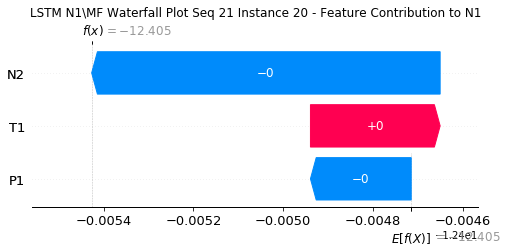

None

Contribution: [-0.00020664  0.00029649 -0.00077605]


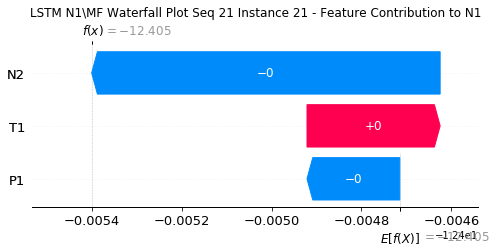

None

Contribution: [-0.00023125  0.00034124 -0.000795  ]


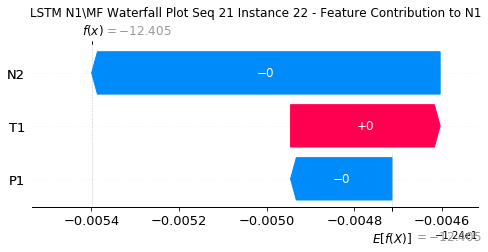

None

Contribution: [-0.00019238  0.00089532 -0.0009613 ]


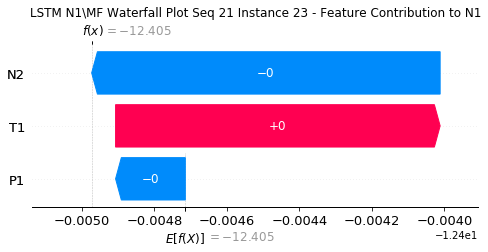

None

Contribution: [-0.00129866  0.01132059 -0.00807737]


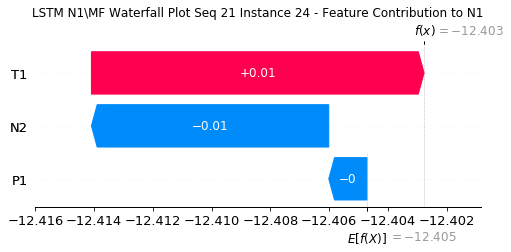

None

Contribution: [-0.04819475  0.02454852 -0.17761   ]


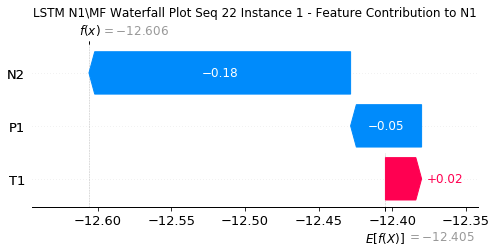

None

Contribution: [0.00167485 0.00142597 0.00552841]


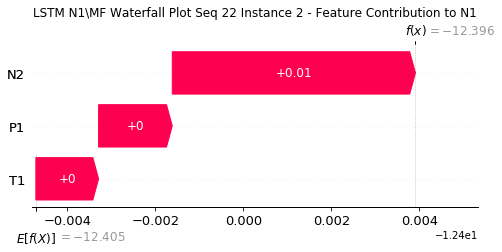

None

Contribution: [ 3.29794526e-05 -1.68665492e-04 -1.26668852e-04]


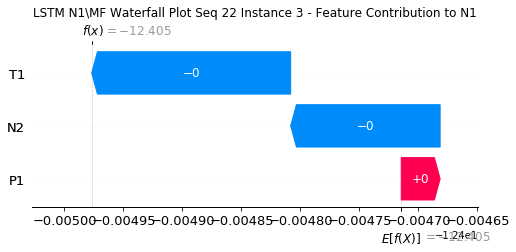

None

Contribution: [-6.66268918e-06 -3.82291603e-04 -1.58393769e-04]


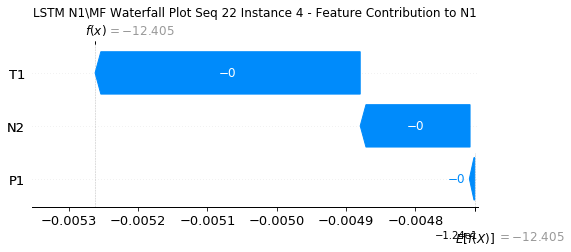

None

Contribution: [ 2.82649567e-06 -9.81384188e-04 -3.47839764e-04]


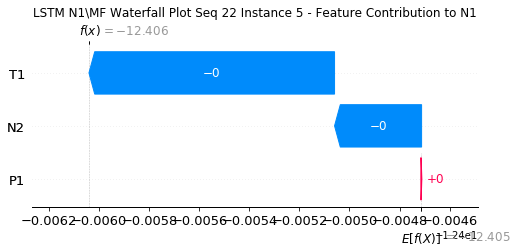

None

Contribution: [-3.29130776e-05 -4.64759644e-04 -4.99359910e-04]


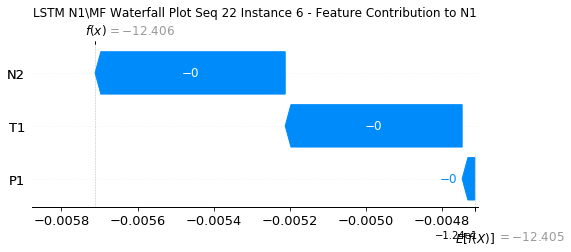

None

Contribution: [-0.00020402  0.00018353 -0.00066285]


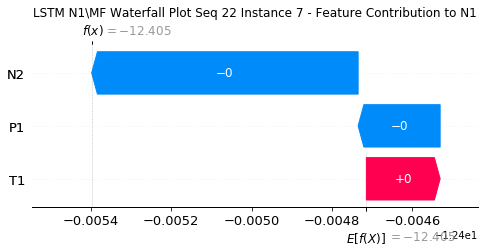

None

Contribution: [-0.00027698  0.00022474 -0.00082372]


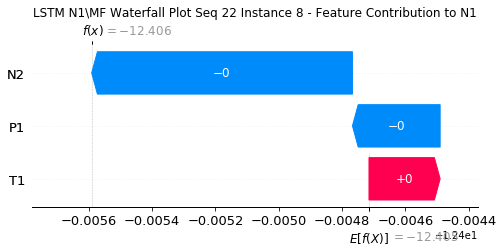

None

Contribution: [-2.94196048e-04  6.61387356e-05 -9.34977736e-04]


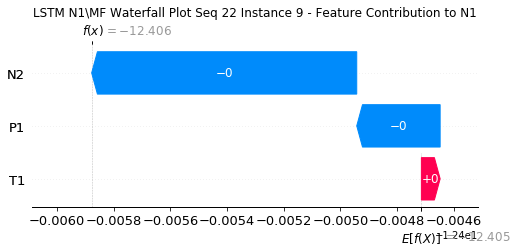

None

Contribution: [-3.04769360e-04  8.76556016e-05 -1.00193129e-03]


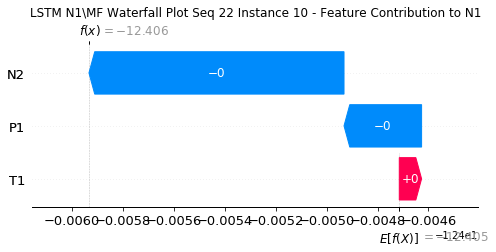

None

Contribution: [-3.12910106e-04  9.53843848e-05 -1.01862852e-03]


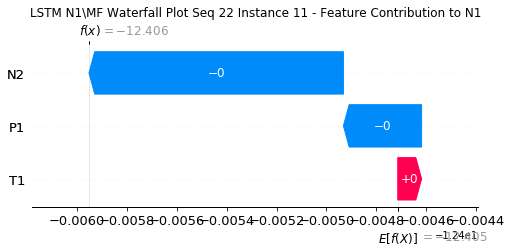

None

Contribution: [-3.11796551e-04  9.39289824e-05 -1.02054788e-03]


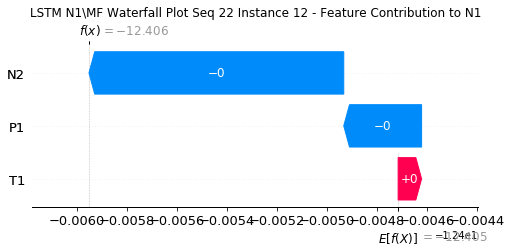

None

Contribution: [-3.37096139e-04  9.92521801e-05 -1.04371807e-03]


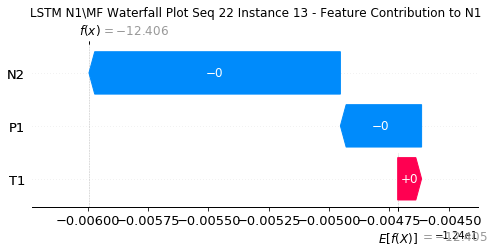

None

Contribution: [-0.00031778  0.00012849 -0.00100156]


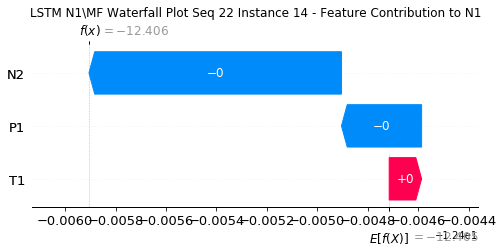

None

Contribution: [-0.0002841   0.00015258 -0.00095302]


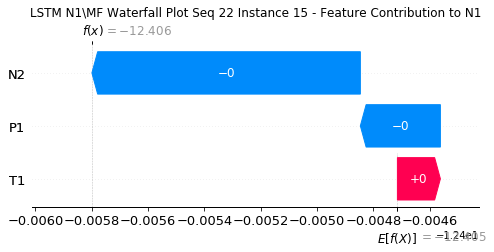

None

Contribution: [-0.00027299  0.00015898 -0.00089992]


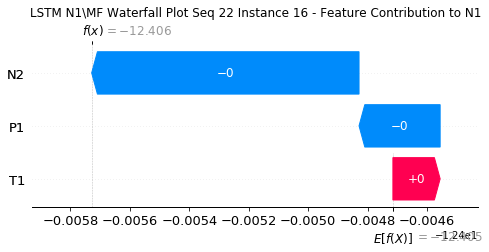

None

Contribution: [-0.0002678   0.00016704 -0.00084435]


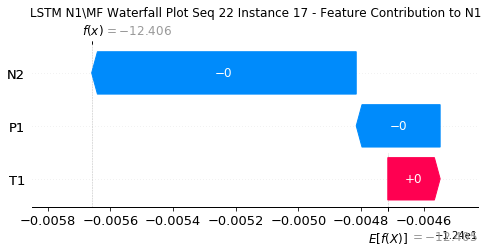

None

Contribution: [-0.00025823  0.00017398 -0.00080974]


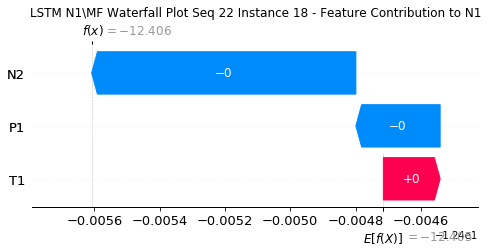

None

Contribution: [-0.00023585  0.00018046 -0.00078357]


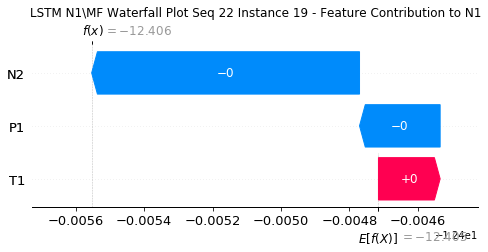

None

Contribution: [-0.00022467  0.00018593 -0.00077038]


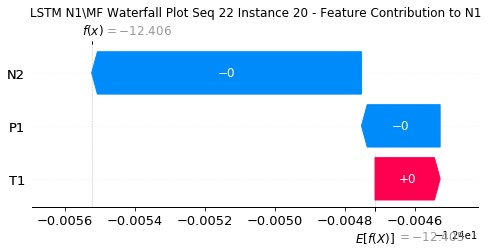

None

Contribution: [-0.00020788  0.00019661 -0.00077184]


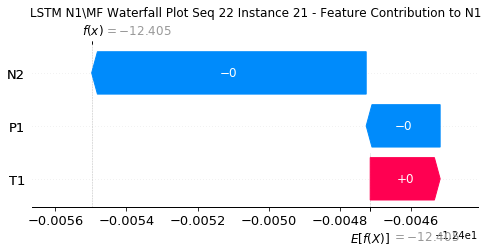

None

Contribution: [-0.00023001  0.00022965 -0.00079195]


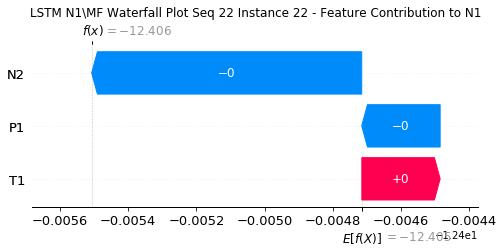

None

Contribution: [-0.00019534  0.00068026 -0.00093611]


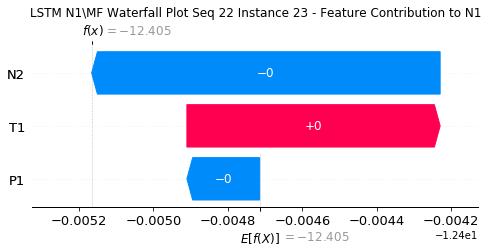

None

Contribution: [-0.00122518  0.01086253 -0.00738437]


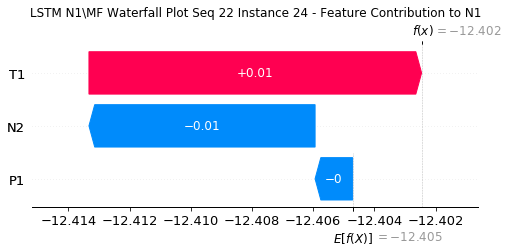

None

Contribution: [-0.05299988  0.0804521  -0.17489123]


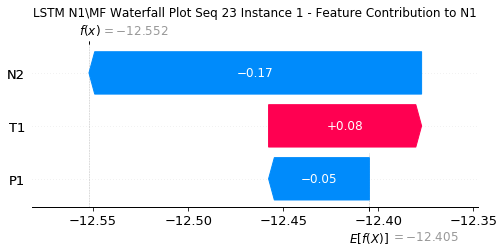

None

Contribution: [0.0016837  0.00218697 0.00541473]


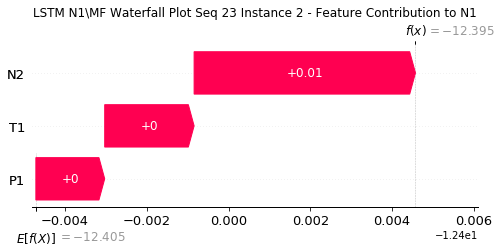

None

Contribution: [ 1.78041309e-05  3.10579806e-04 -8.81632952e-05]


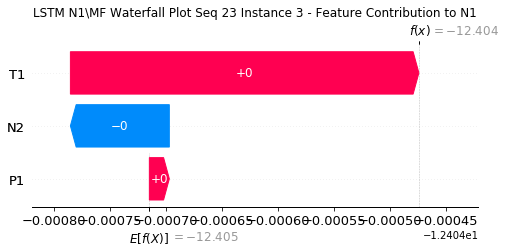

None

Contribution: [-2.64995289e-05  9.20164592e-05 -1.34834859e-04]


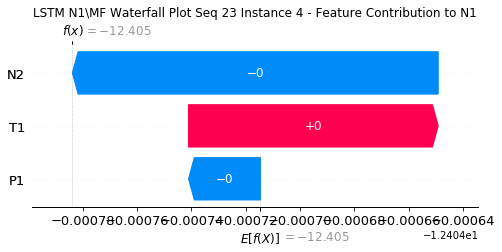

None

Contribution: [-3.60212274e-05 -1.18021138e-04 -2.81775514e-04]


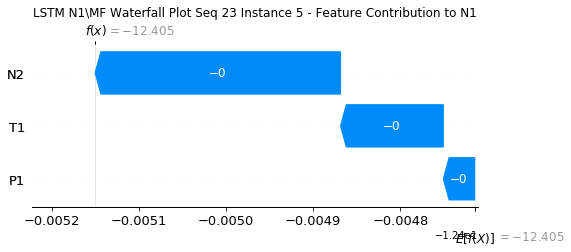

None

Contribution: [-7.04422287e-05  1.65607961e-04 -4.51957847e-04]


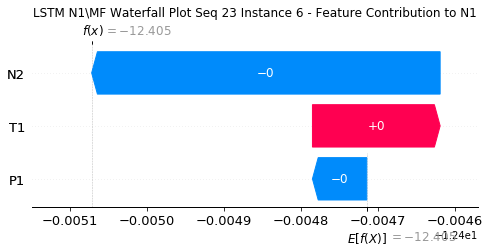

None

Contribution: [-0.00021254  0.00035678 -0.0006438 ]


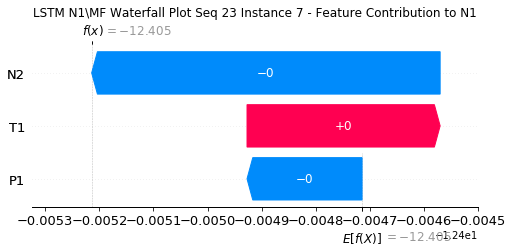

None

Contribution: [-0.00026737  0.00018166 -0.00078535]


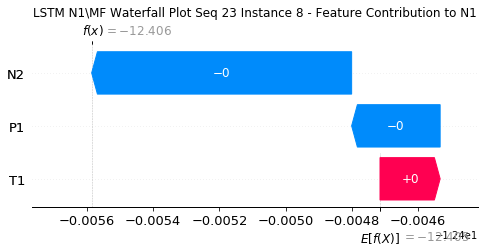

None

Contribution: [-2.71102041e-04  9.51949873e-05 -8.79055302e-04]


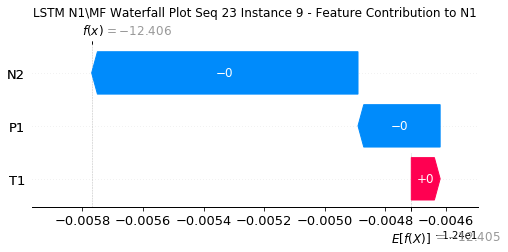

None

Contribution: [-0.00030727  0.0001656  -0.00096325]


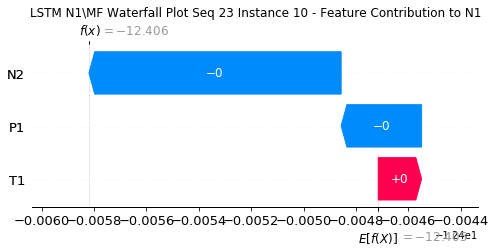

None

Contribution: [-0.00030794  0.00016813 -0.00096631]


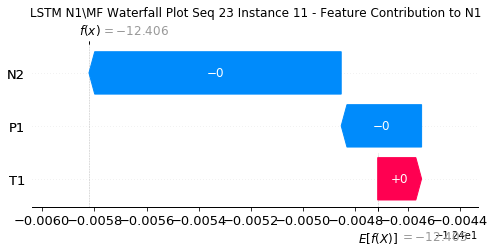

None

Contribution: [-0.00030631  0.00016824 -0.00097223]


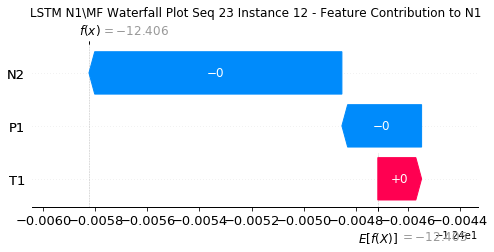

None

Contribution: [-0.00032315  0.00016027 -0.00099458]


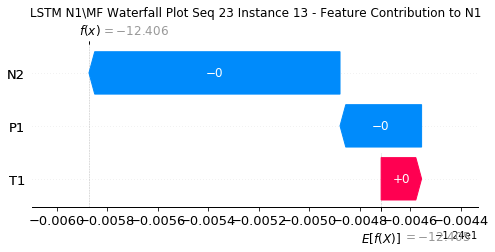

None

Contribution: [-0.00032642  0.0001942  -0.00100048]


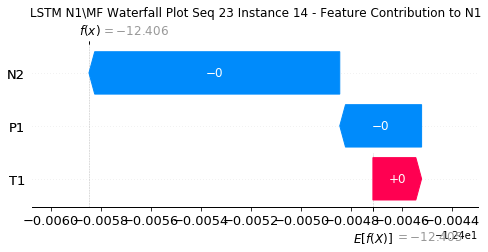

None

Contribution: [-0.00030576  0.00023937 -0.00096011]


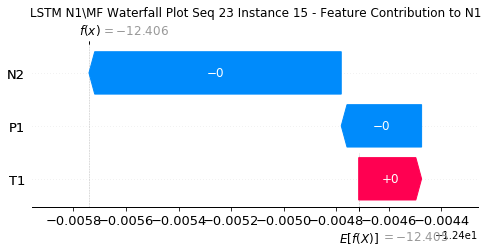

None

Contribution: [-0.00028867  0.00023967 -0.00091954]


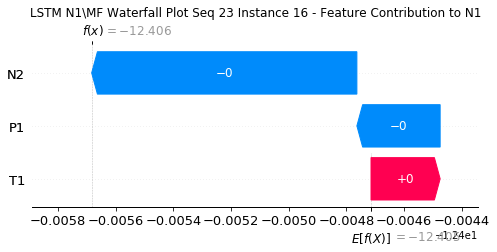

None

Contribution: [-0.00027596  0.00024734 -0.00086244]


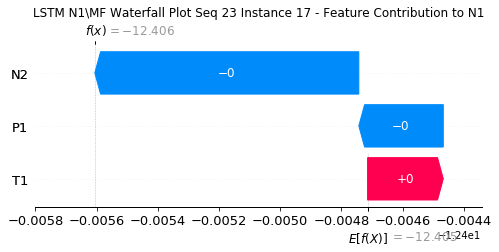

None

Contribution: [-0.00024809  0.00026019 -0.00081826]


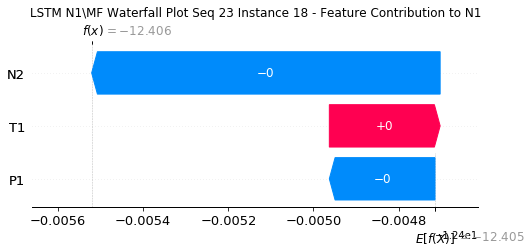

None

Contribution: [-0.00024764  0.0002599  -0.00079446]


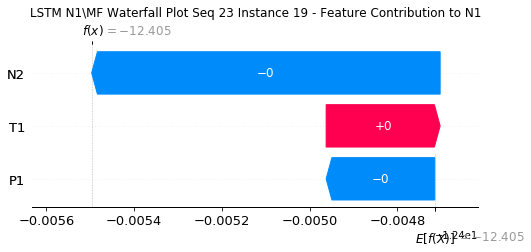

None

Contribution: [-0.00023657  0.00025771 -0.00078005]


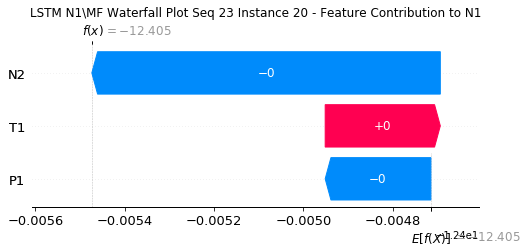

None

Contribution: [-0.000221    0.00026162 -0.00078166]


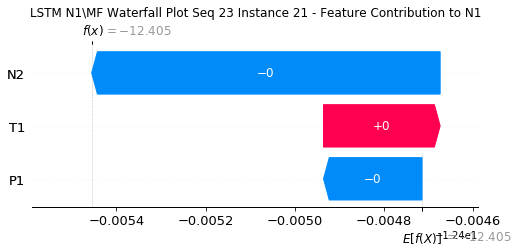

None

Contribution: [-0.00024289  0.00029338 -0.00079963]


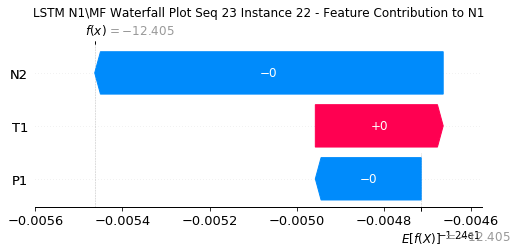

None

Contribution: [-0.00018224  0.00074595 -0.00096813]


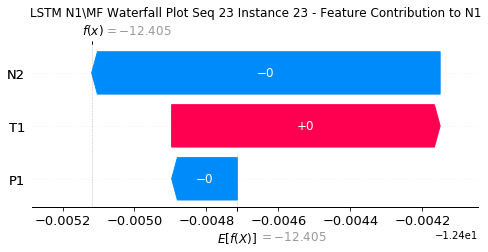

None

Contribution: [-0.00131545  0.00993241 -0.00799548]


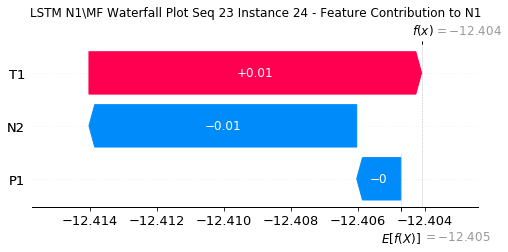

None

Contribution: [-0.05192808  0.07999038 -0.17506656]


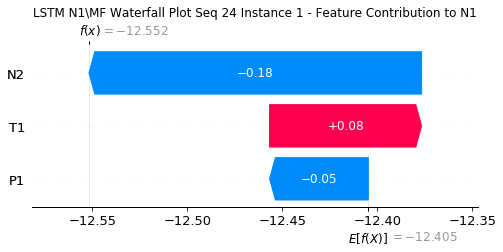

None

Contribution: [0.00166037 0.00218023 0.0054135 ]


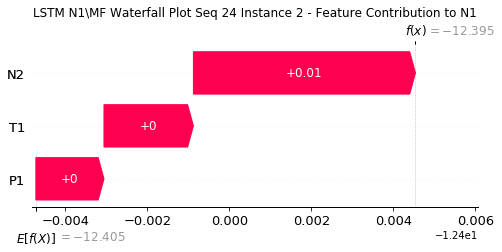

None

Contribution: [ 2.43431850e-06  2.67717776e-04 -9.20165642e-05]


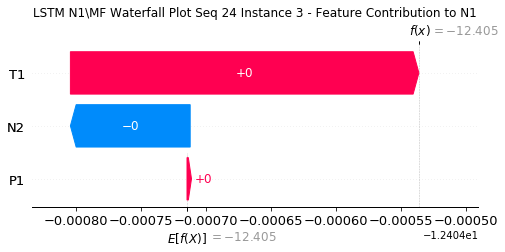

None

Contribution: [-2.08737938e-05  2.30363083e-05 -1.30619862e-04]


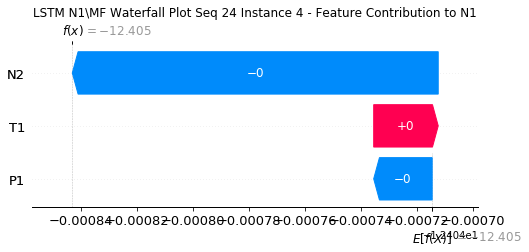

None

Contribution: [-2.19855366e-05 -2.51163655e-04 -2.74819001e-04]


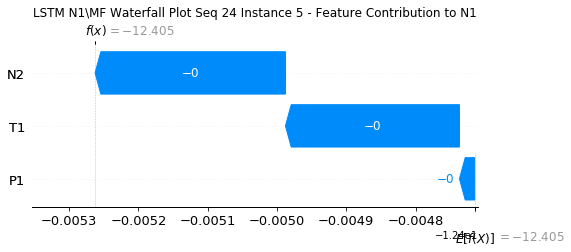

None

Contribution: [-8.83796575e-05  3.36465800e-05 -4.52755211e-04]


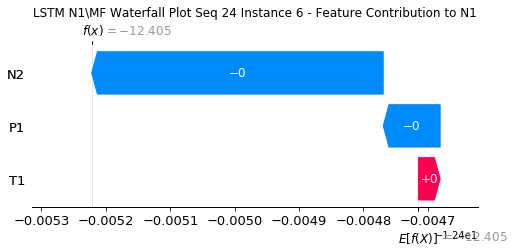

None

Contribution: [-0.00021232  0.00034535 -0.00064366]


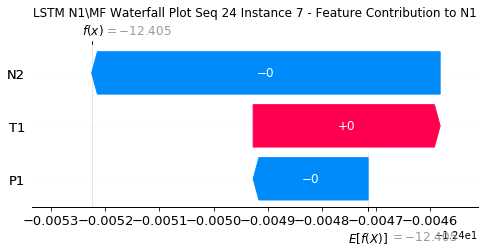

None

Contribution: [-0.0002598   0.00021179 -0.00078593]


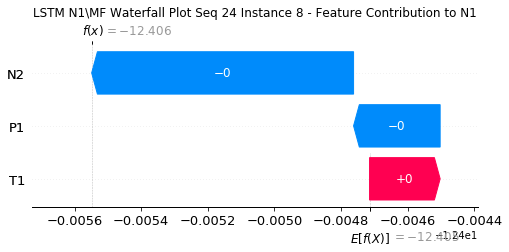

None

Contribution: [-0.00025974  0.00015338 -0.00087733]


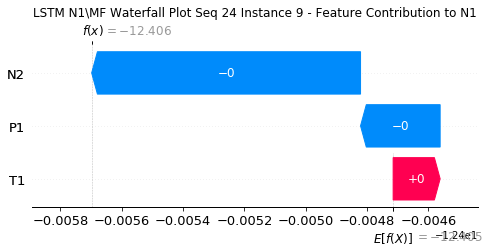

None

Contribution: [-0.00030728  0.00021689 -0.00095778]


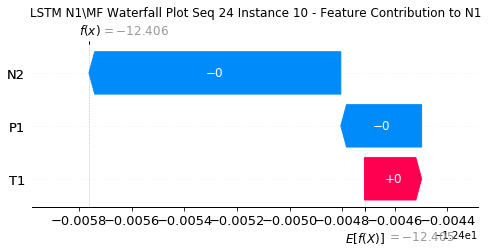

None

Contribution: [-0.00031436  0.00017469 -0.0009688 ]


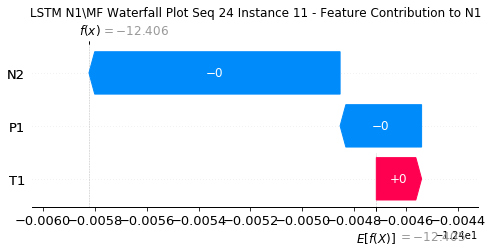

None

Contribution: [-0.0003109   0.00016985 -0.00097487]


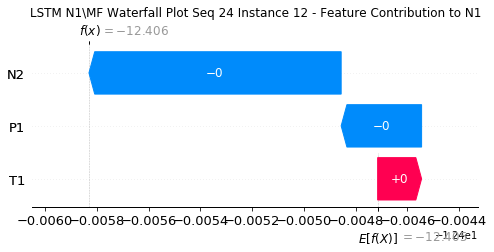

None

Contribution: [-0.0003204   0.00014834 -0.00099386]


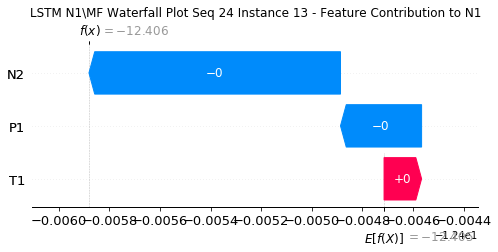

None

Contribution: [-0.00033518  0.00018492 -0.00100448]


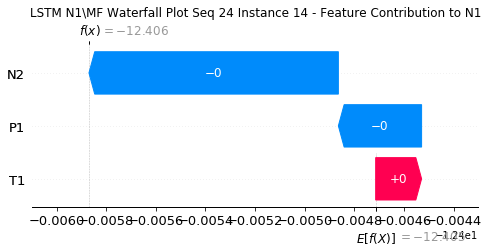

None

Contribution: [-0.00030654  0.0002014  -0.00098713]


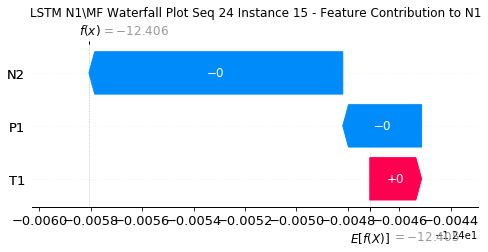

None

Contribution: [-0.00029495  0.00021794 -0.00092343]


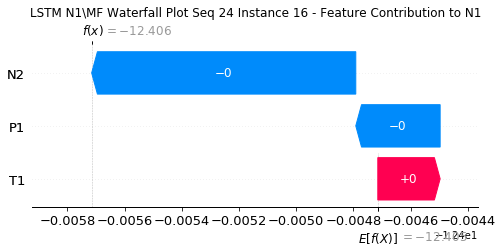

None

Contribution: [-0.00027843  0.00022251 -0.0008628 ]


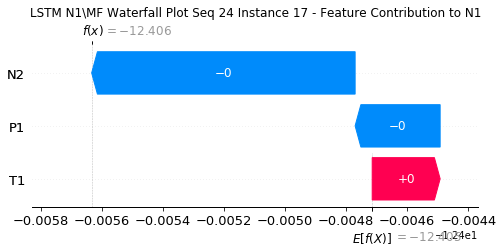

None

Contribution: [-0.00026445  0.00021266 -0.00082112]


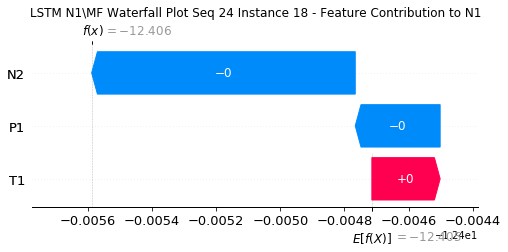

None

Contribution: [-0.00025193  0.00023075 -0.00079632]


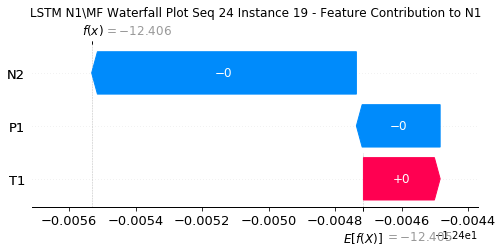

None

Contribution: [-0.00023936  0.00022761 -0.00078019]


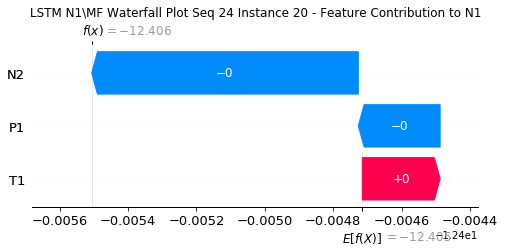

None

Contribution: [-0.00022795  0.00023    -0.00078296]


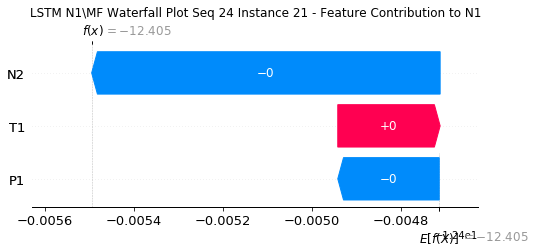

None

Contribution: [-0.00024849  0.00025531 -0.00079881]


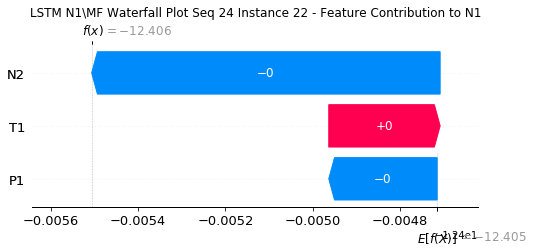

None

Contribution: [-0.00017942  0.00064371 -0.00096893]


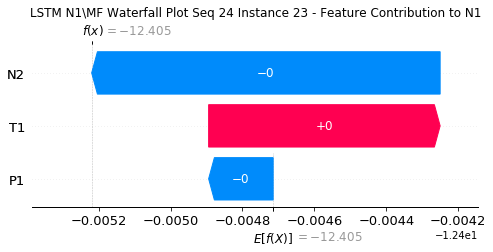

None

Contribution: [-0.0012534   0.00931832 -0.00756609]


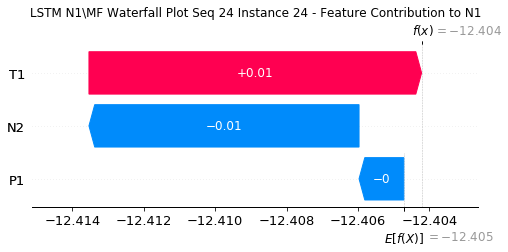

None

Contribution: [-0.05842789  0.07009814 -0.17961557]


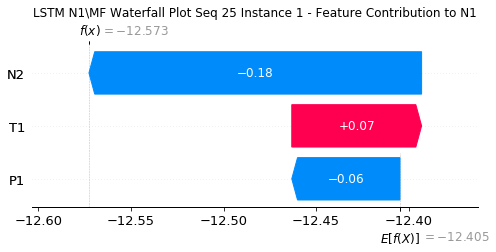

None

Contribution: [0.00168983 0.00199827 0.00548642]


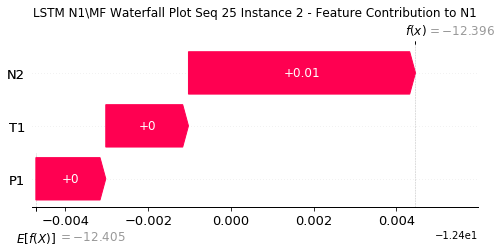

None

Contribution: [ 5.06845074e-06  3.43087843e-04 -7.48516302e-05]


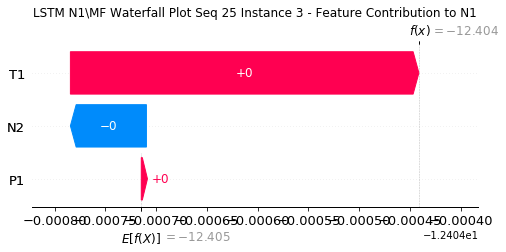

None

Contribution: [ 2.38210044e-06 -4.05186819e-05 -1.11687880e-04]


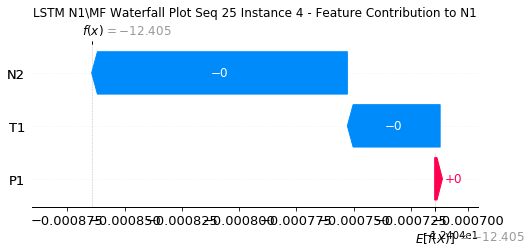

None

Contribution: [ 2.15447390e-05 -3.31214738e-04 -2.45624826e-04]


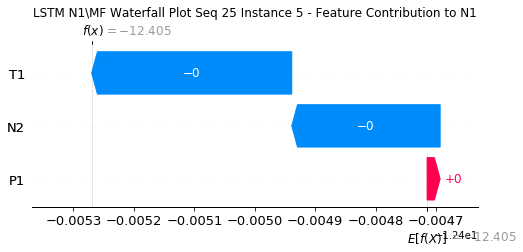

None

Contribution: [-0.00018522 -0.00012889 -0.00046266]


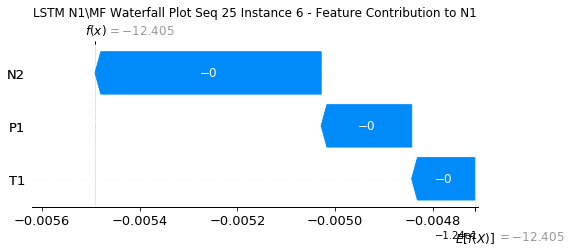

None

Contribution: [-0.00020862  0.00035237 -0.00064823]


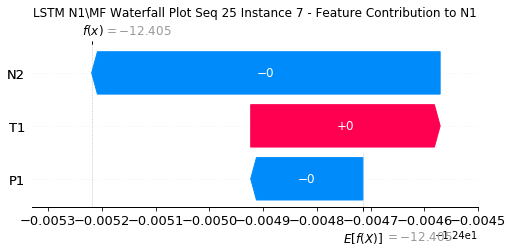

None

Contribution: [-0.00026267  0.00021305 -0.00081232]


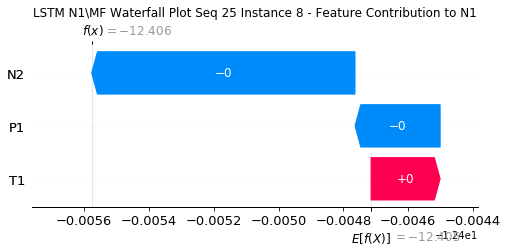

None

Contribution: [-2.69024031e-04  8.87820324e-05 -9.12132326e-04]


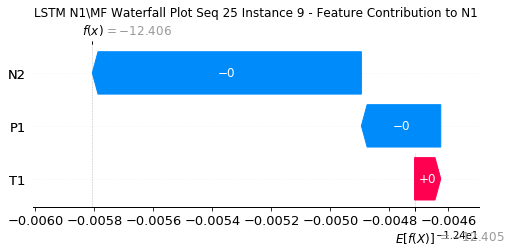

None

Contribution: [-0.00032038  0.00012951 -0.00099944]


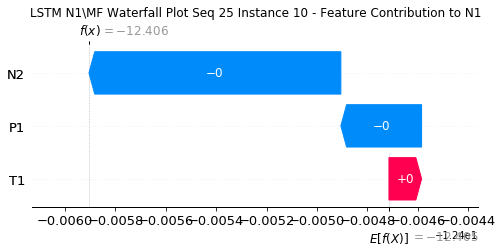

None

Contribution: [-0.00030751  0.00012852 -0.00099817]


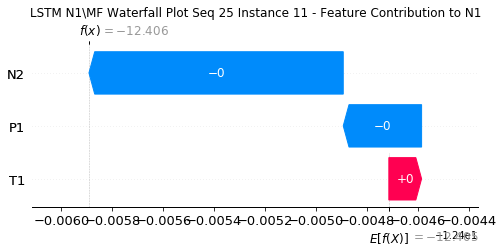

None

Contribution: [-0.00030305  0.00012684 -0.00099967]


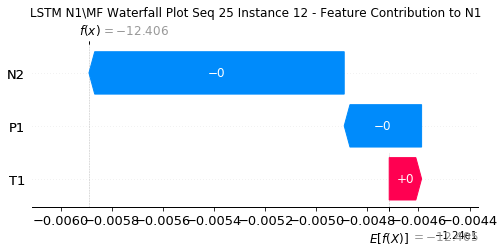

None

Contribution: [-0.00029429  0.00013055 -0.00101178]


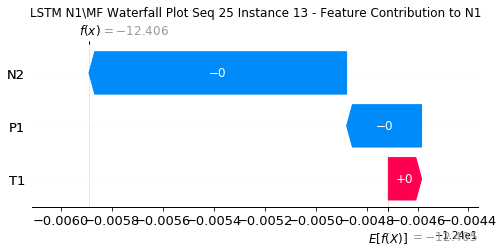

None

Contribution: [-0.00031596  0.00015192 -0.00100457]


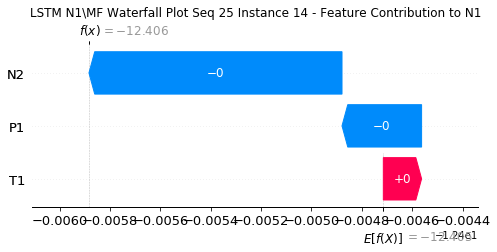

None

Contribution: [-0.00031494  0.00017443 -0.00097355]


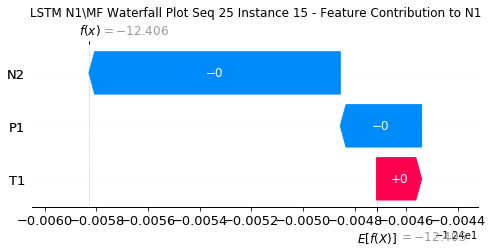

None

Contribution: [-0.00026941  0.00018835 -0.00090849]


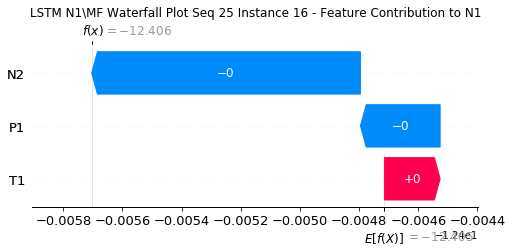

None

Contribution: [-0.00026428  0.00019081 -0.00085346]


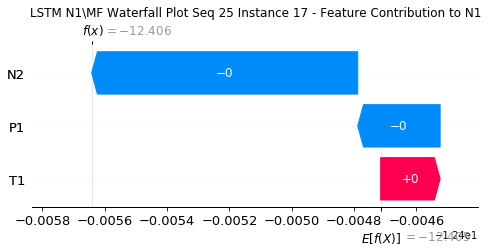

None

Contribution: [-0.00025914  0.00017625 -0.00082535]


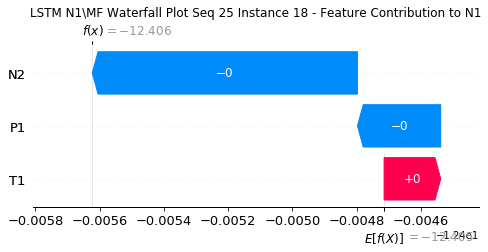

None

Contribution: [-0.00024037  0.00019206 -0.00079398]


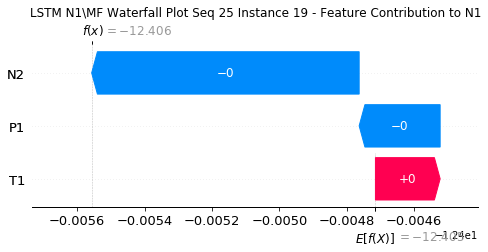

None

Contribution: [-0.00023178  0.00019119 -0.00078039]


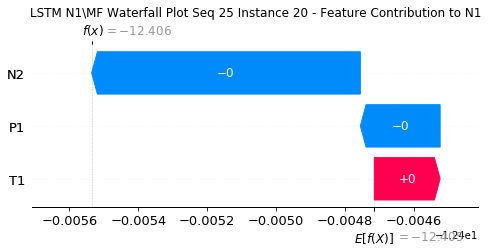

None

Contribution: [-0.00021984  0.00019335 -0.00078368]


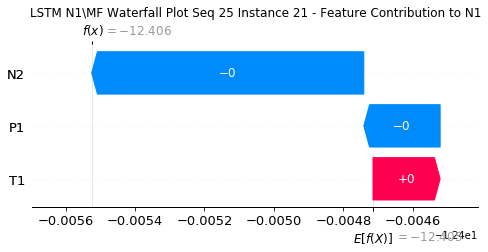

None

Contribution: [-0.00024085  0.00022343 -0.00079941]


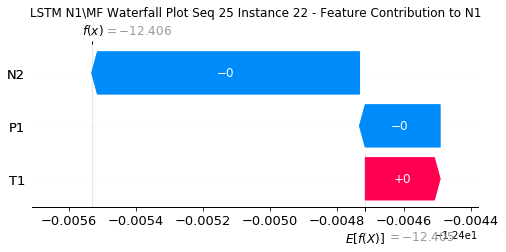

None

Contribution: [-0.00017995  0.00054162 -0.0009696 ]


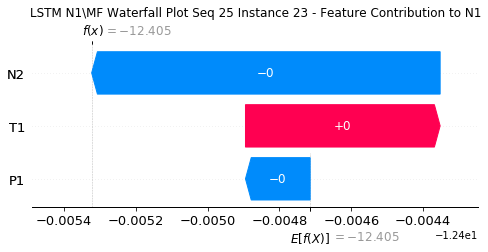

None

Contribution: [-0.00129244  0.00589931 -0.00803336]


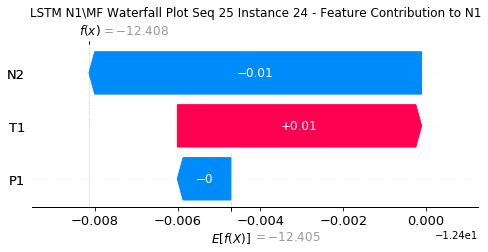

None

Contribution: [-0.05897422  0.09898363 -0.1761218 ]


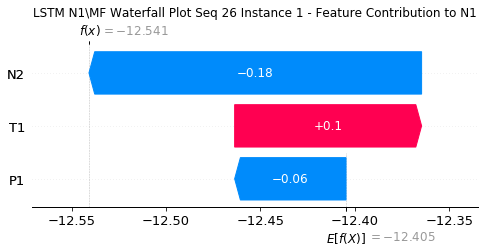

None

Contribution: [0.00167445 0.00276879 0.00532462]


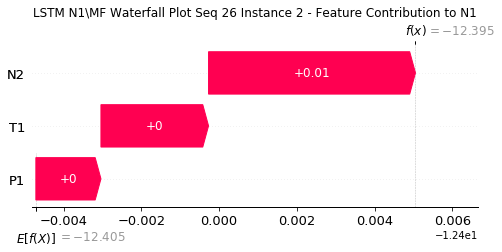

None

Contribution: [-1.08140397e-05  5.02490571e-04 -9.99134770e-05]


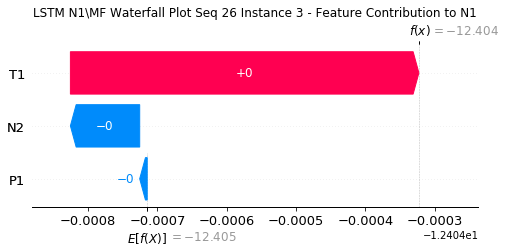

None

Contribution: [-5.35273875e-05  2.91872217e-04 -1.55151081e-04]


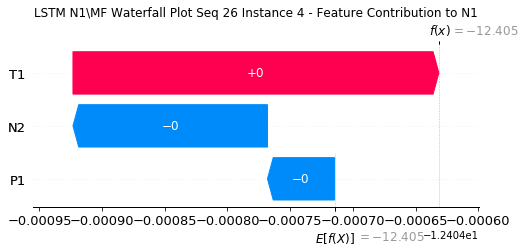

None

Contribution: [-0.00010287  0.00025936 -0.00031015]


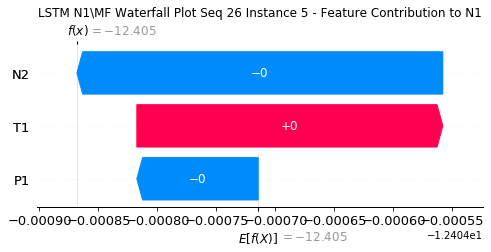

None

Contribution: [-0.00014568  0.00041703 -0.00046866]


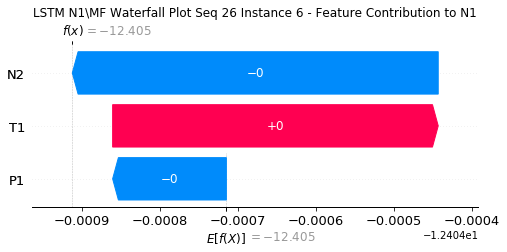

None

Contribution: [-0.00020979  0.00033274 -0.00063289]


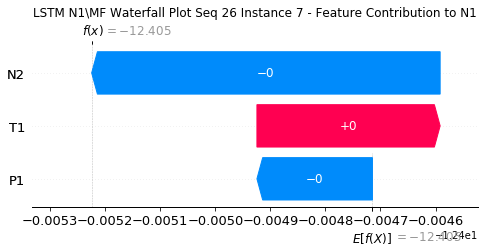

None

Contribution: [-0.00023985  0.00013882 -0.00074057]


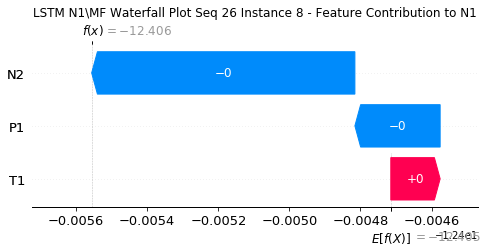

None

Contribution: [-0.00028656  0.00015469 -0.00083321]


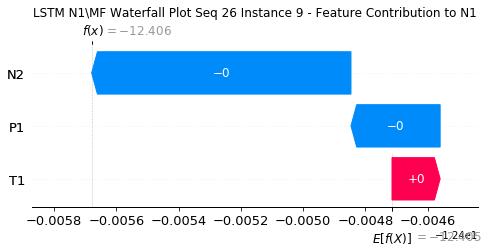

None

Contribution: [-0.00031179  0.000231   -0.0009253 ]


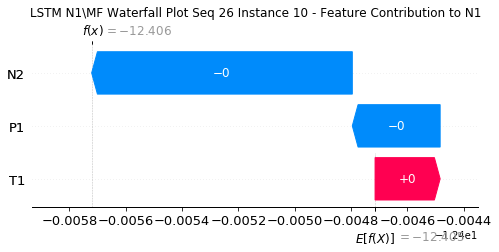

None

Contribution: [-0.00029499  0.00024828 -0.0009412 ]


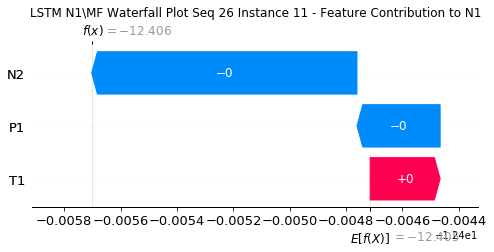

None

Contribution: [-0.00028846  0.00025549 -0.00094522]


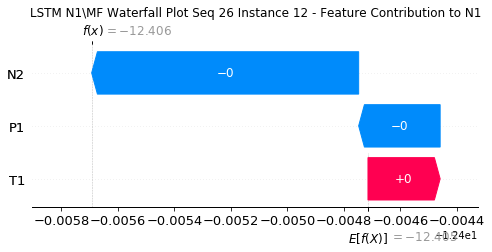

None

Contribution: [-0.00032696  0.00020686 -0.00097921]


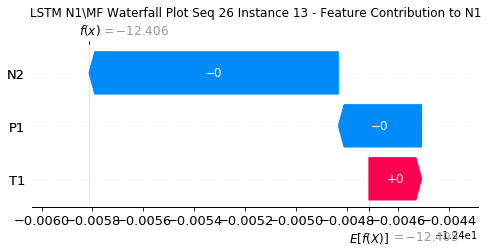

None

Contribution: [-0.00030892  0.00028263 -0.00098586]


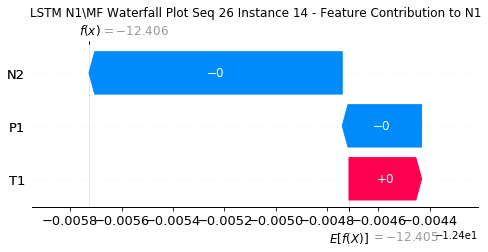

None

Contribution: [-0.00030874  0.00029848 -0.00095981]


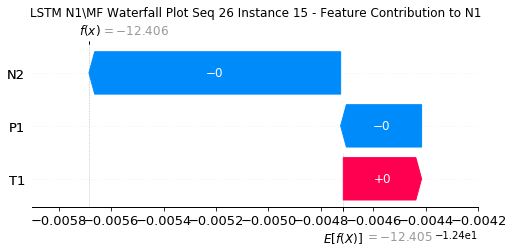

None

Contribution: [-0.00028639  0.00032449 -0.0009119 ]


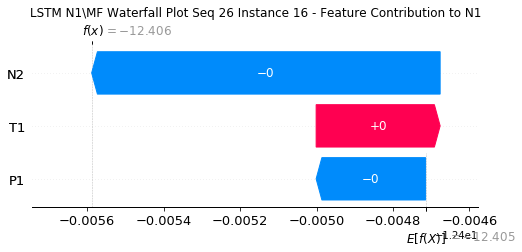

None

Contribution: [-0.00026659  0.00033682 -0.00085732]


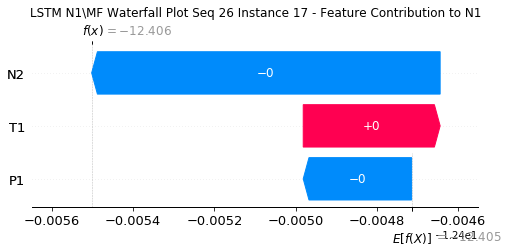

None

Contribution: [-0.00025976  0.00032305 -0.00081482]


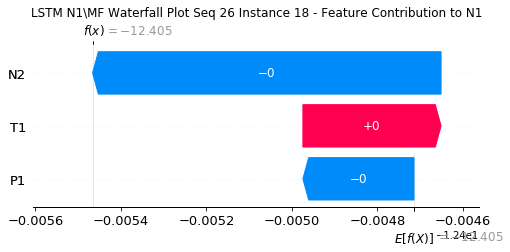

None

Contribution: [-0.00024976  0.00033192 -0.00079213]


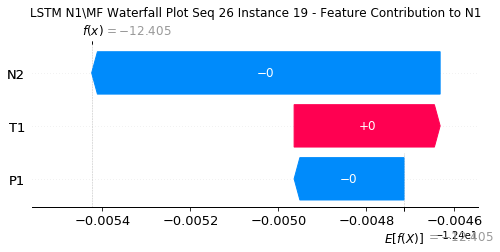

None

Contribution: [-0.00023973  0.00032827 -0.00077837]


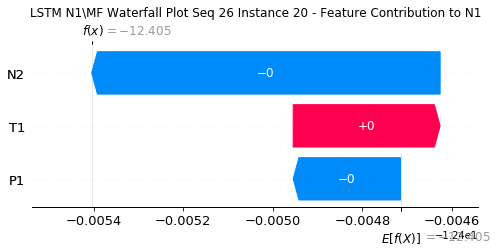

None

Contribution: [-0.00022159  0.00033046 -0.00078226]


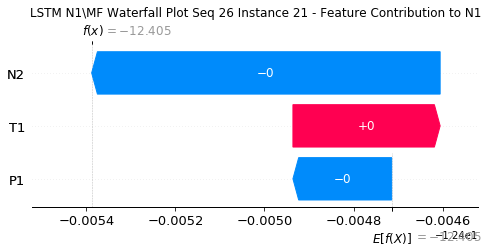

None

Contribution: [-0.00025544  0.00036846 -0.00079879]


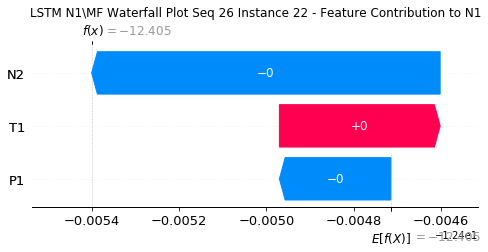

None

Contribution: [-0.00019502  0.00072926 -0.00099849]


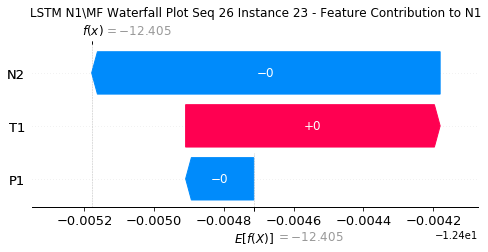

None

Contribution: [-0.00127405  0.007359   -0.00810631]


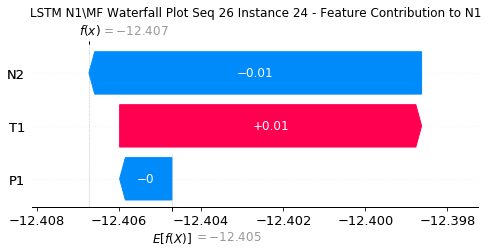

None

Contribution: [-0.0553826   0.06497852 -0.17802099]


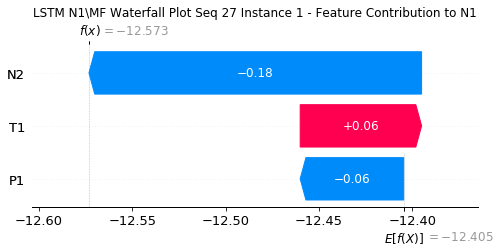

None

Contribution: [0.00170552 0.00197145 0.00548102]


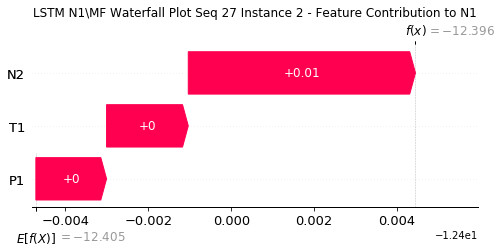

None

Contribution: [-2.88045441e-06  4.12645511e-04 -7.34379854e-05]


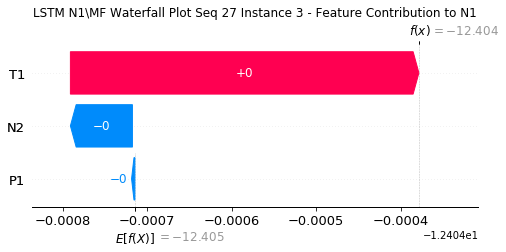

None

Contribution: [-1.27755939e-05 -1.42499882e-06 -1.24072678e-04]


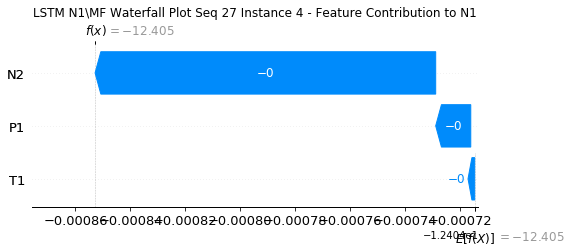

None

Contribution: [-1.06690987e-05 -2.33076427e-04 -2.72120722e-04]


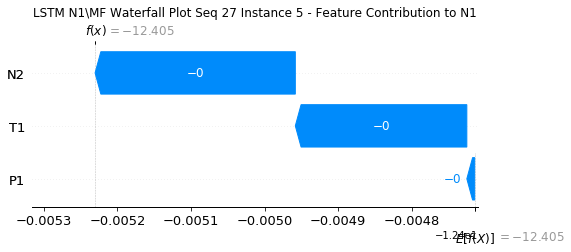

None

Contribution: [-1.12157086e-04  1.86160954e-05 -4.55962703e-04]


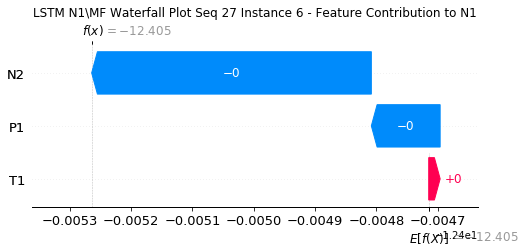

None

Contribution: [-0.00021019  0.00035824 -0.0006509 ]


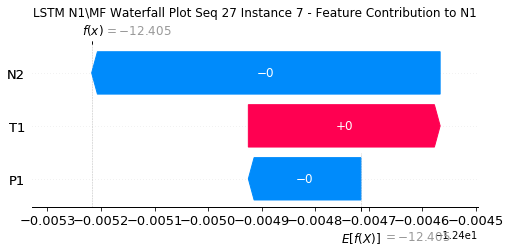

None

Contribution: [-0.00025132  0.0002077  -0.00080617]


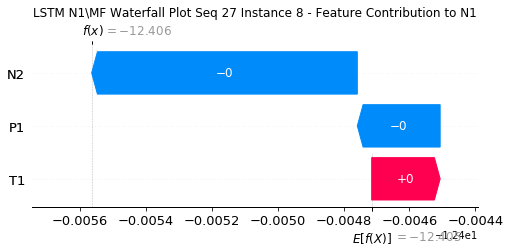

None

Contribution: [-0.00023941  0.00015079 -0.00089356]


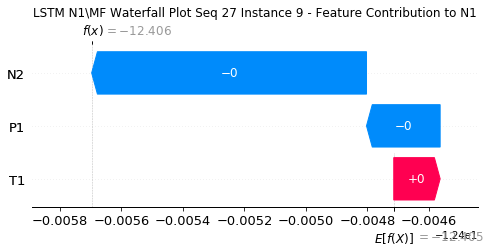

None

Contribution: [-0.00028559  0.00012504 -0.0009876 ]


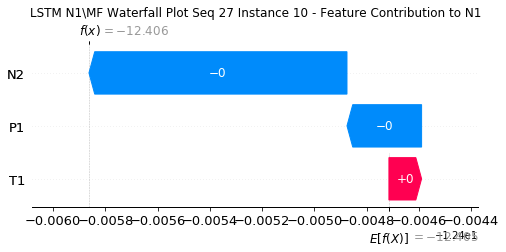

None

Contribution: [-3.14205072e-04  9.29294687e-05 -9.98163535e-04]


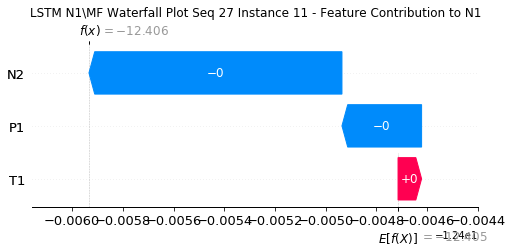

None

Contribution: [-3.09875437e-04  9.42245797e-05 -9.98101887e-04]


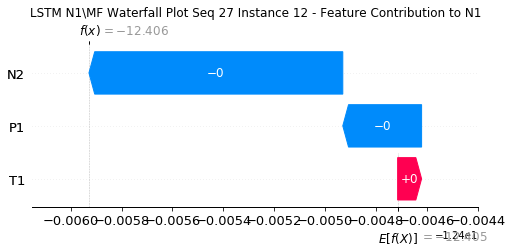

None

Contribution: [-3.06182101e-04  8.46587898e-05 -1.00748685e-03]


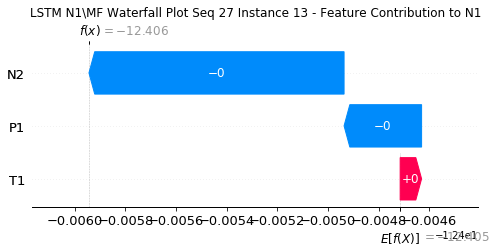

None

Contribution: [-0.00031923  0.000117   -0.00100357]


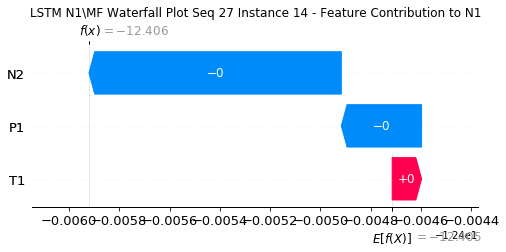

None

Contribution: [-0.00029592  0.0001472  -0.00095961]


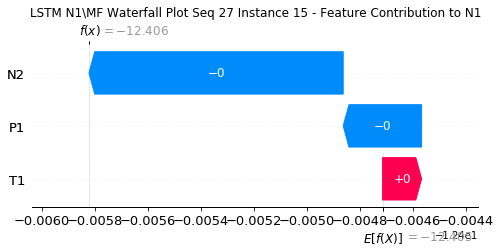

None

Contribution: [-0.00027277  0.00016024 -0.00090804]


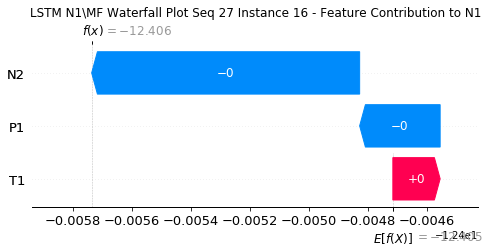

None

Contribution: [-0.00026163  0.00017157 -0.0008492 ]


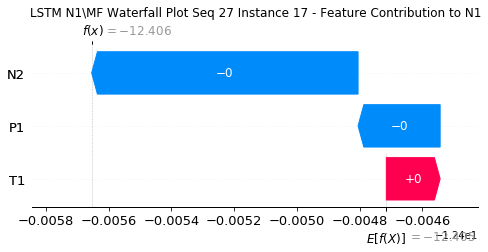

None

Contribution: [-0.00025425  0.00016285 -0.00082505]


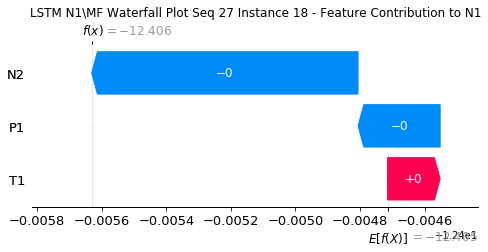

None

Contribution: [-0.00022447  0.00018597 -0.00078373]


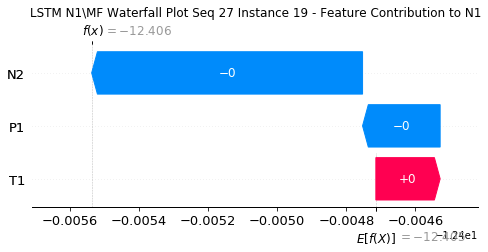

None

Contribution: [-0.00021292  0.00018892 -0.00076893]


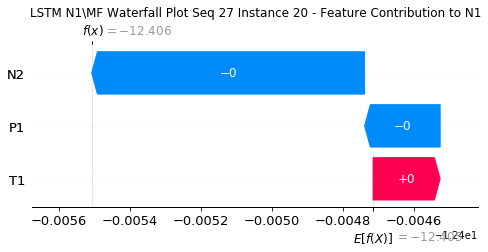

None

Contribution: [-0.00019586  0.00019379 -0.00076986]


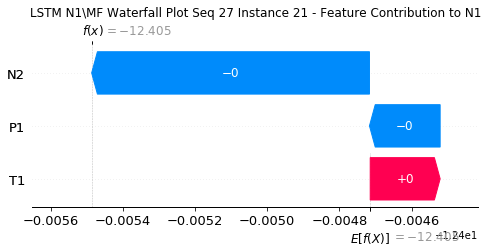

None

Contribution: [-0.00022098  0.00022341 -0.00078665]


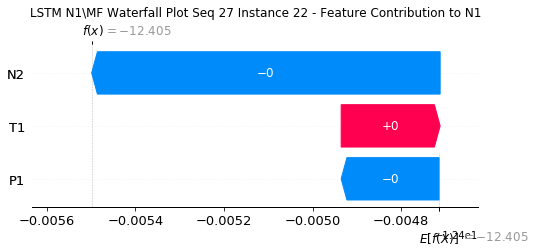

None

Contribution: [-0.00020944  0.00057381 -0.00092503]


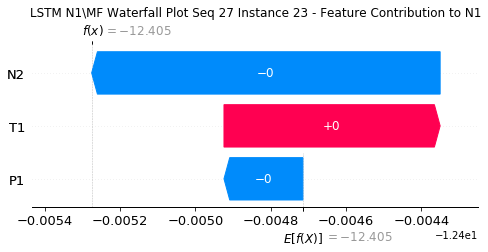

None

Contribution: [-0.00129671  0.00675381 -0.00760446]


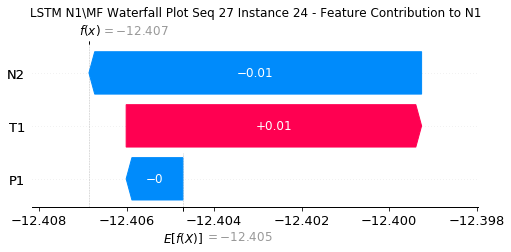

None

Contribution: [-0.06094917  0.09764492 -0.17541053]


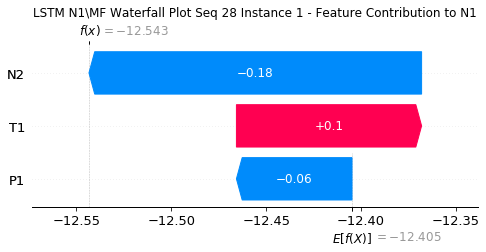

None

Contribution: [0.00165175 0.00273748 0.00530985]


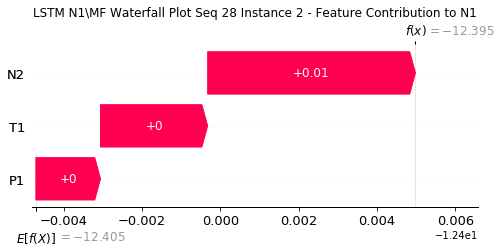

None

Contribution: [-6.86802273e-07  4.87536168e-04 -1.02490428e-04]


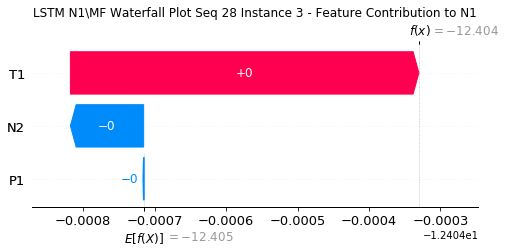

None

Contribution: [-4.17148555e-05  3.51726368e-04 -1.54061872e-04]


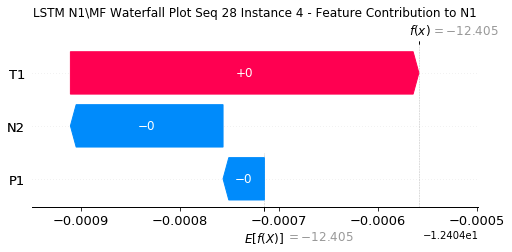

None

Contribution: [-6.66851891e-05  3.95244353e-04 -3.06930598e-04]


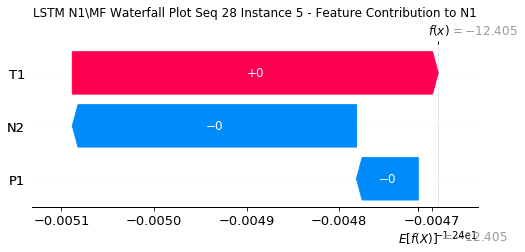

None

Contribution: [-0.00010909  0.00053445 -0.00046278]


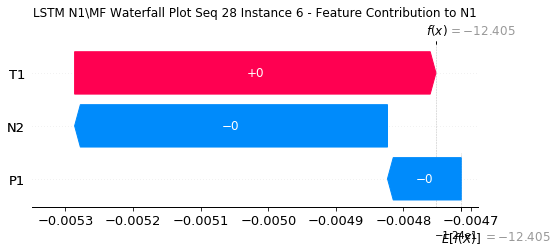

None

Contribution: [-0.00021538  0.00031638 -0.00063188]


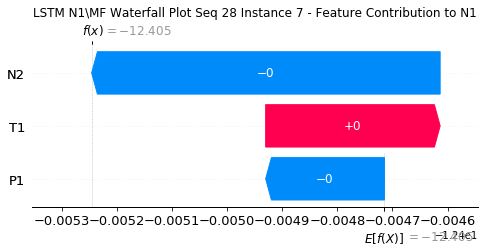

None

Contribution: [-0.00024945  0.00013353 -0.00073142]


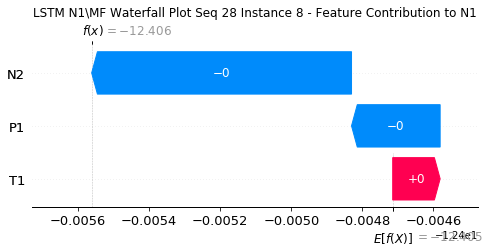

None

Contribution: [-0.00025718  0.0001651  -0.00081649]


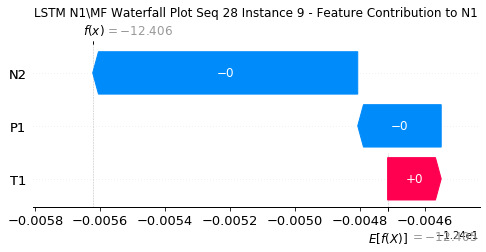

None

Contribution: [-0.00028167  0.00026845 -0.000908  ]


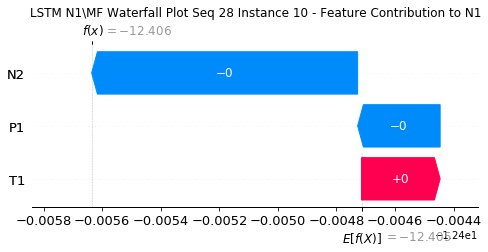

None

Contribution: [-0.0003287   0.00022483 -0.00094609]


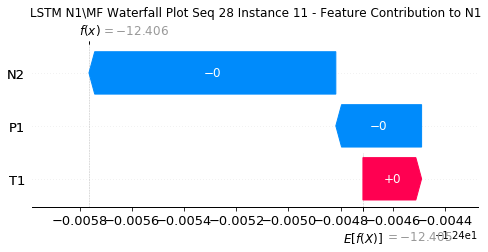

None

Contribution: [-0.00033448  0.00025352 -0.00095129]


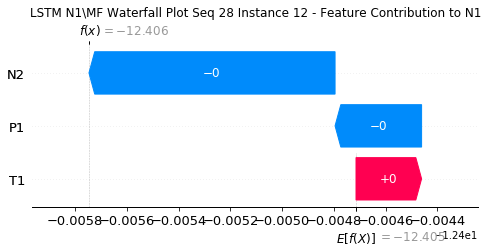

None

Contribution: [-0.00027644  0.00025126 -0.00095638]


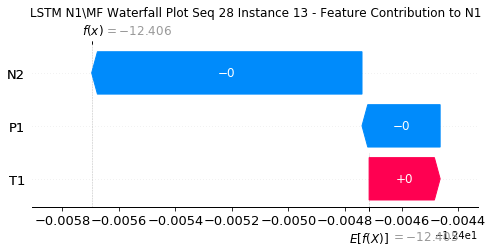

None

Contribution: [-0.00037949  0.00035379 -0.00099523]


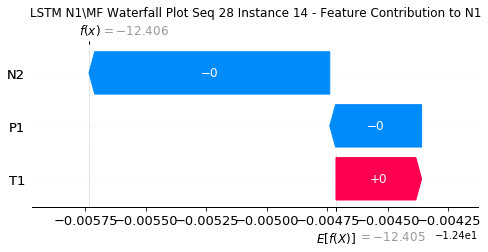

None

Contribution: [-0.00030503  0.00043435 -0.0009527 ]


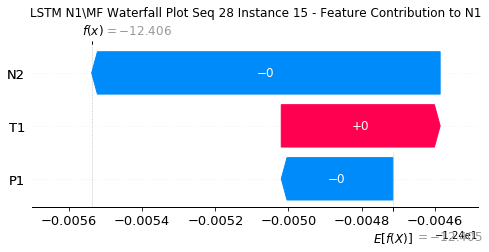

None

Contribution: [-0.00036946  0.0004716  -0.00091947]


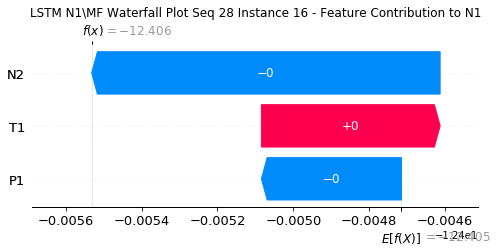

None

Contribution: [-0.00034253  0.00053012 -0.00085883]


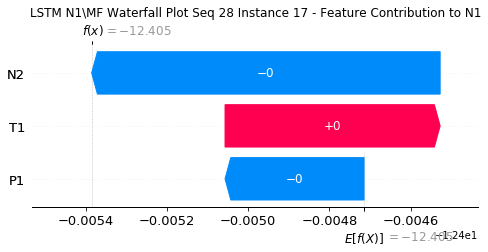

None

Contribution: [-0.00021289  0.00038882 -0.00079988]


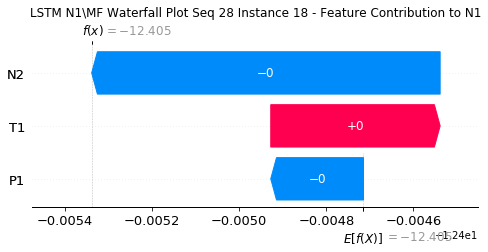

None

Contribution: [-0.00037949  0.00062077 -0.00080243]


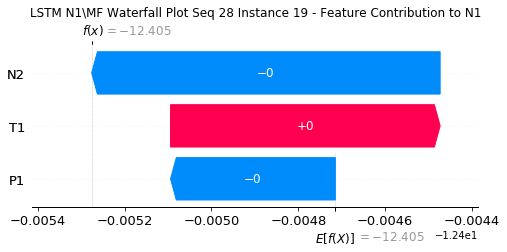

None

Contribution: [-0.00037025  0.00063979 -0.00078888]


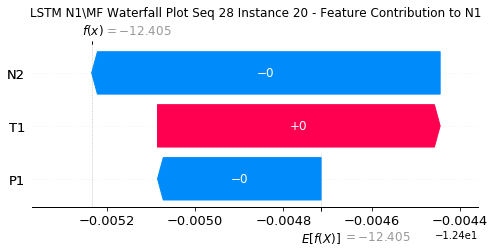

None

Contribution: [-0.00037603  0.00067457 -0.00079973]


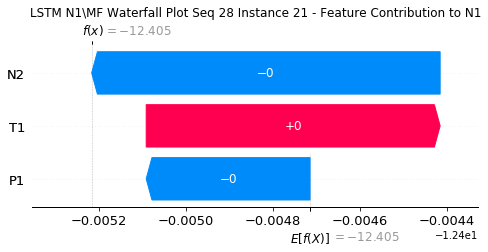

None

Contribution: [-0.00036504  0.00074875 -0.00081141]


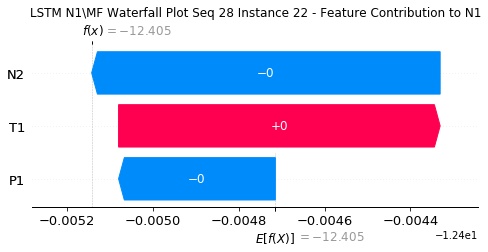

None

Contribution: [-0.00013063  0.00192873 -0.00107428]


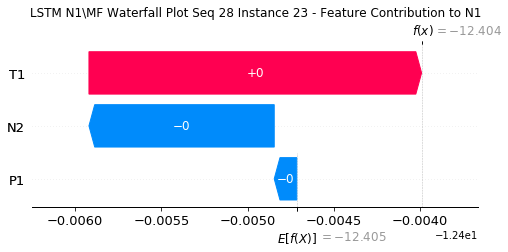

None

Contribution: [-0.00130727  0.02584919 -0.00949764]


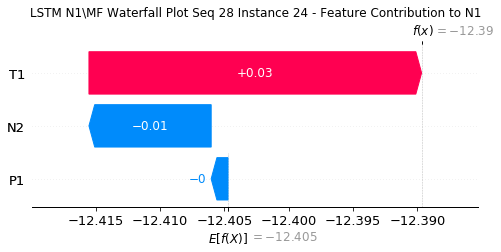

None

Contribution: [ 0.04860404 -0.15758488 -0.16878278]


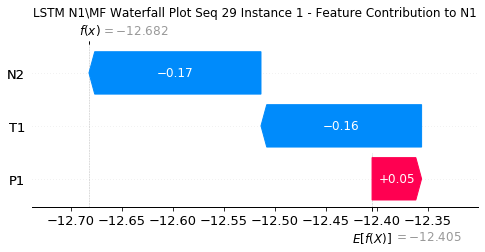

None

Contribution: [ 0.00087578 -0.00032521  0.00548115]


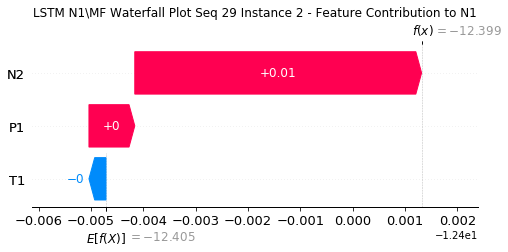

None

Contribution: [ 4.92580604e-04 -1.55107350e-03  2.05016852e-05]


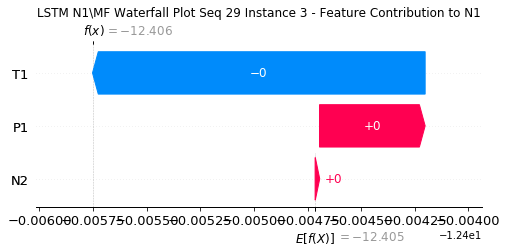

None

Contribution: [ 5.11734840e-04 -2.39729916e-03 -5.31197718e-06]


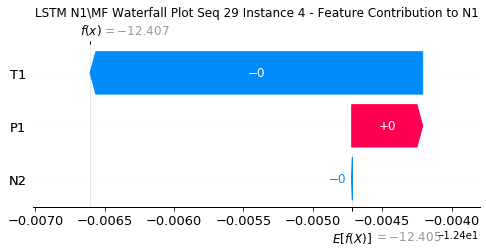

None

Contribution: [ 1.21859972e-03 -4.79860788e-03 -2.99999050e-05]


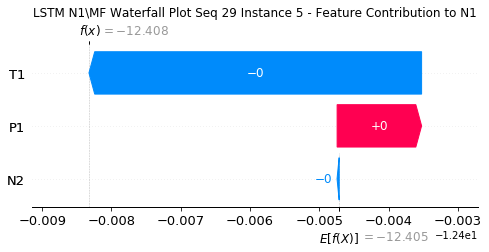

None

Contribution: [ 0.00033987 -0.00395656 -0.00036061]


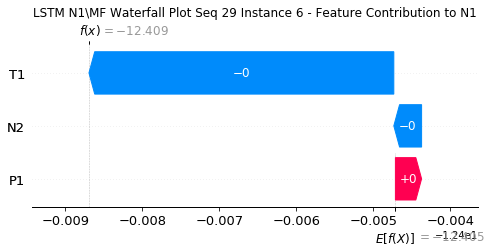

None

Contribution: [ 7.89076778e-06 -1.08975019e-03 -5.97701556e-04]


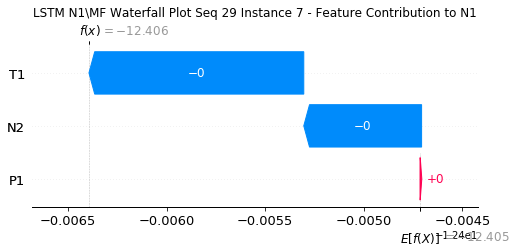

None

Contribution: [-0.00050767  0.00077679 -0.0008764 ]


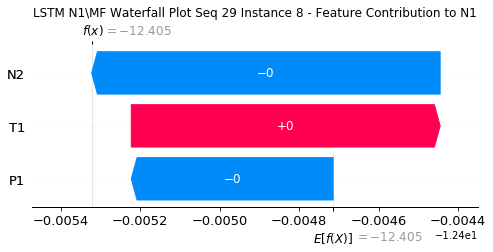

None

Contribution: [-0.00055264  0.00048221 -0.00103804]


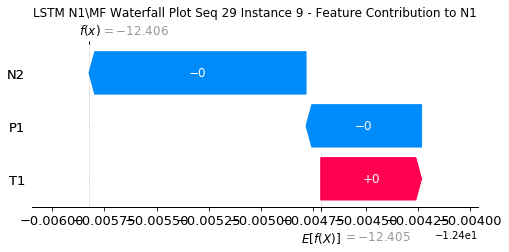

None

Contribution: [-0.0004982   0.00033484 -0.00104239]


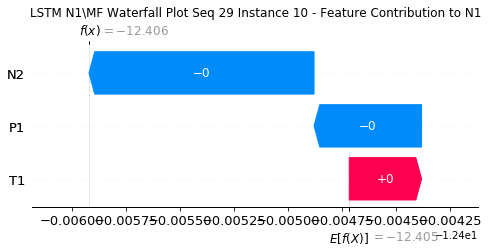

None

Contribution: [-0.00044353  0.00025328 -0.00106241]


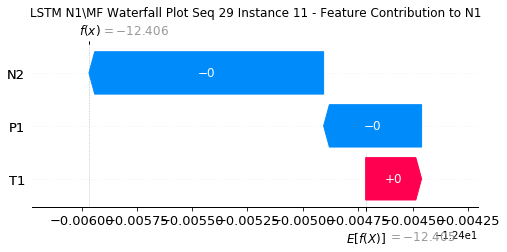

None

Contribution: [-0.00042302  0.0002373  -0.00107102]


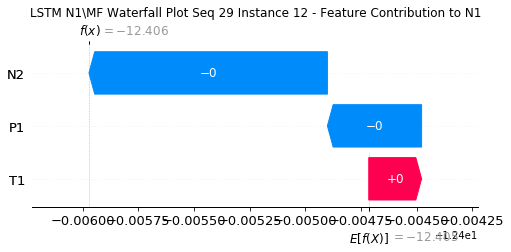

None

Contribution: [-0.00044845  0.00027729 -0.00108222]


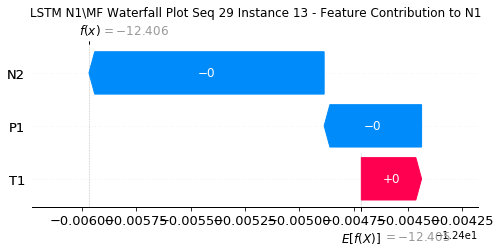

None

Contribution: [-0.00041421  0.00022531 -0.00103203]


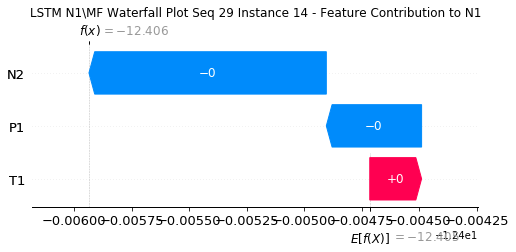

None

Contribution: [-0.00032252  0.00012825 -0.00096266]


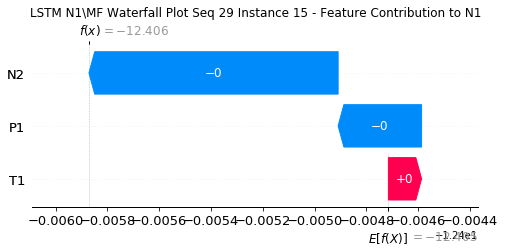

None

Contribution: [-0.00031844  0.00016893 -0.00090734]


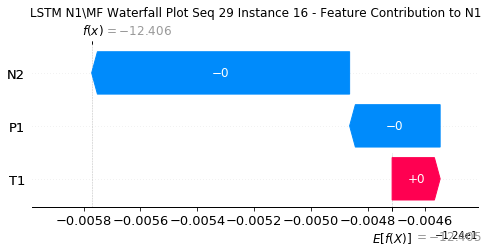

None

Contribution: [-0.00030103  0.00014368 -0.000851  ]


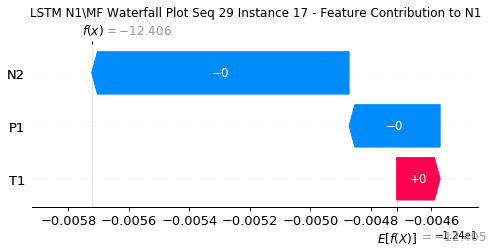

None

Contribution: [-0.00021127  0.00011446 -0.00080427]


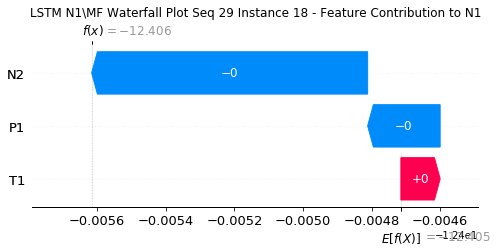

None

Contribution: [-0.00022842  0.00013013 -0.00078646]


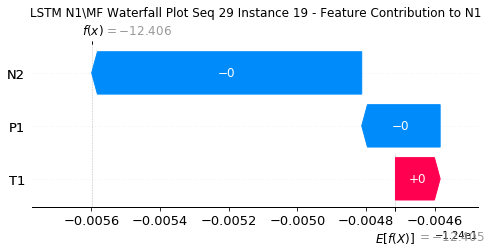

None

Contribution: [-0.00021724  0.00013414 -0.00077303]


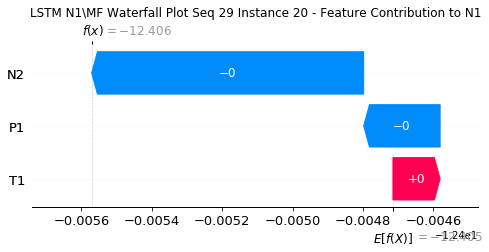

None

Contribution: [-0.00020648  0.00014516 -0.00077613]


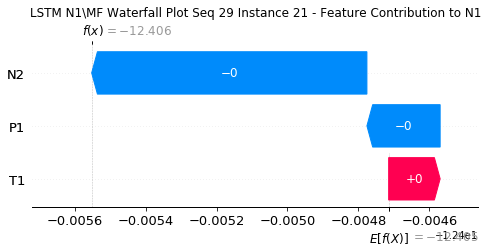

None

Contribution: [-0.00023027  0.00016984 -0.00079603]


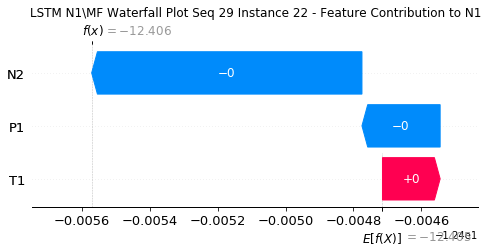

None

Contribution: [-0.00020627  0.00059083 -0.00093148]


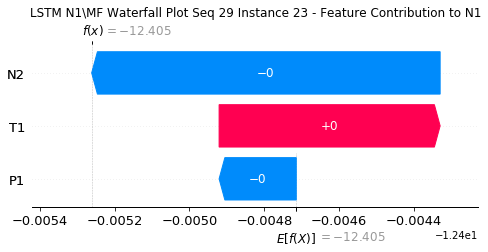

None

Contribution: [-0.00117563  0.01350097 -0.00733986]


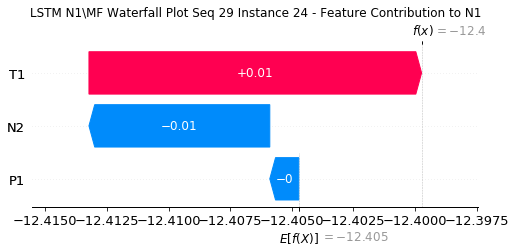

None

Contribution: [-0.05534496  0.08488391 -0.17521328]


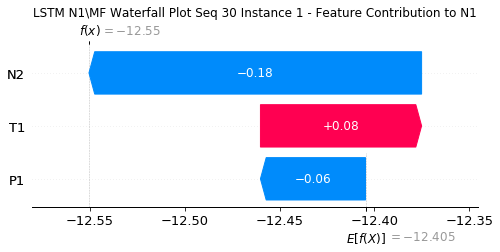

None

Contribution: [0.00167149 0.00223159 0.00541749]


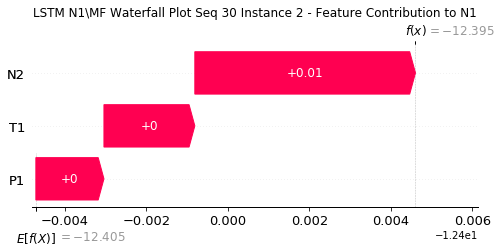

None

Contribution: [ 1.80688765e-05  5.16099037e-04 -8.05699146e-05]


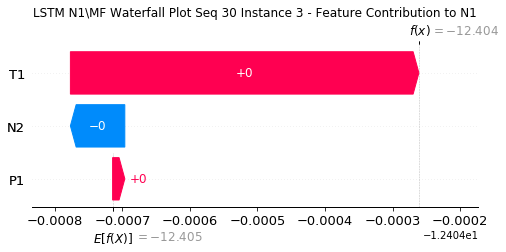

None

Contribution: [-3.86823305e-05  2.11831597e-04 -1.35632994e-04]


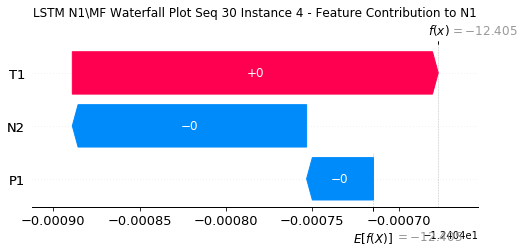

None

Contribution: [-7.69176026e-05  1.15379008e-04 -2.90681372e-04]


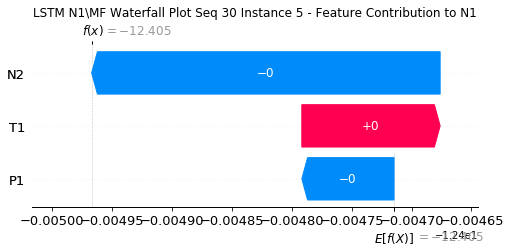

None

Contribution: [-0.000111    0.00023794 -0.00045745]


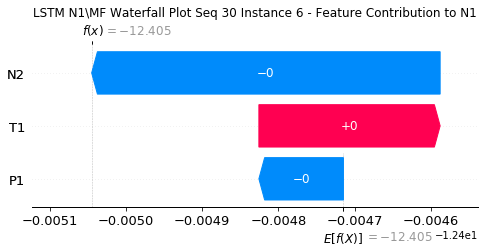

None

Contribution: [-0.00021196  0.00038062 -0.00064406]


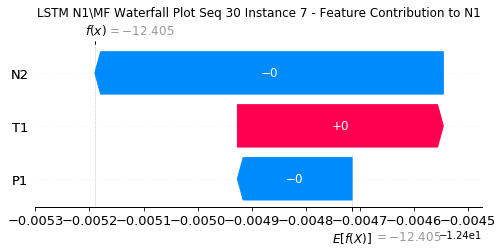

None

Contribution: [-0.00024055  0.00017995 -0.00077674]


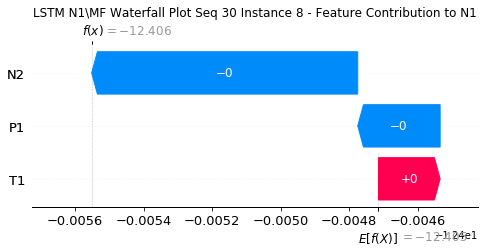

None

Contribution: [-0.00023328  0.00015119 -0.00086836]


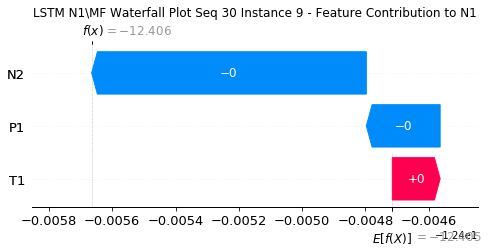

None

Contribution: [-0.00028075  0.00020875 -0.00094425]


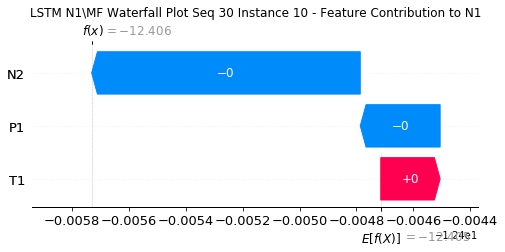

None

Contribution: [-0.00028984  0.00018059 -0.0009581 ]


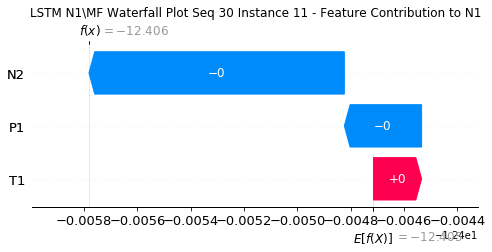

None

Contribution: [-0.00028856  0.00017202 -0.00096654]


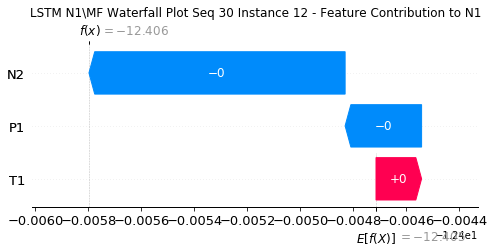

None

Contribution: [-0.00028979  0.00018838 -0.00097913]


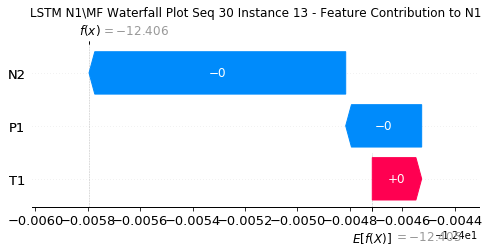

None

Contribution: [-0.00030548  0.00020025 -0.00099506]


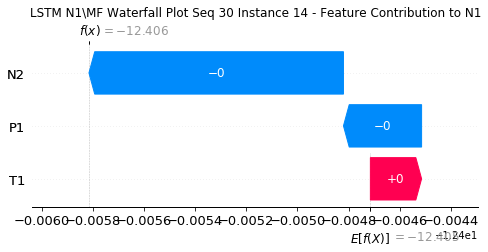

None

Contribution: [-0.00030144  0.00019766 -0.00097223]


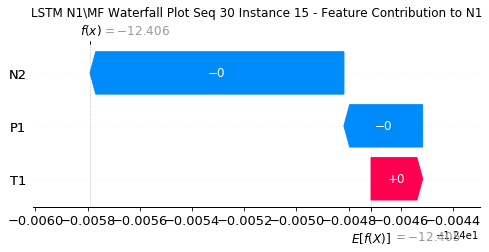

None

Contribution: [-0.00026891  0.00024056 -0.00091652]


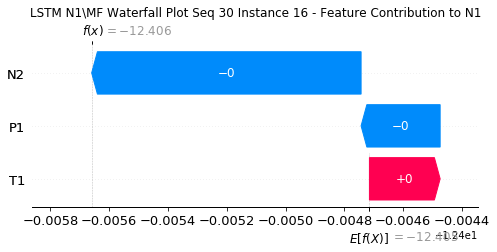

None

Contribution: [-0.00026144  0.00024305 -0.00086241]


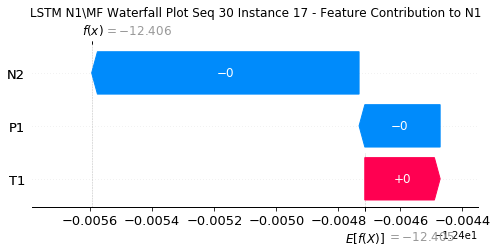

None

Contribution: [-0.00024872  0.00025922 -0.00081756]


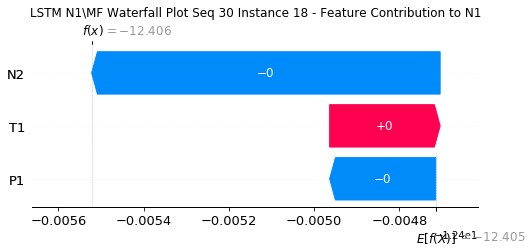

None

Contribution: [-0.00023637  0.00023044 -0.00080116]


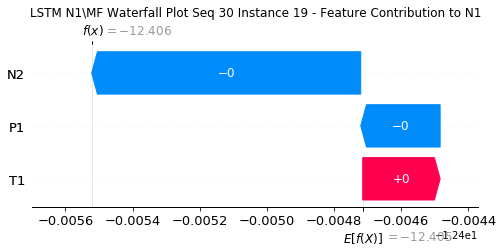

None

Contribution: [-0.00022759  0.00022939 -0.0007872 ]


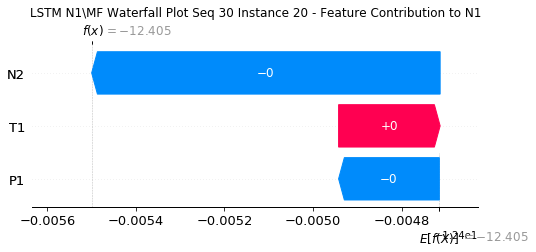

None

Contribution: [-0.00021088  0.00023376 -0.0007906 ]


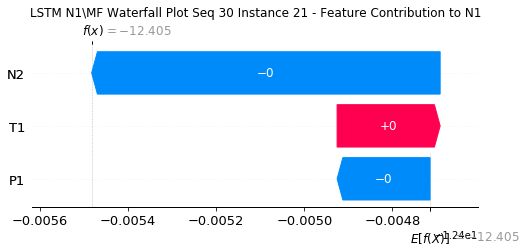

None

Contribution: [-0.00023583  0.00027688 -0.00080475]


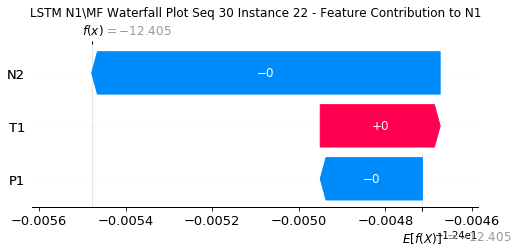

None

Contribution: [-0.00019817  0.000623   -0.00097382]


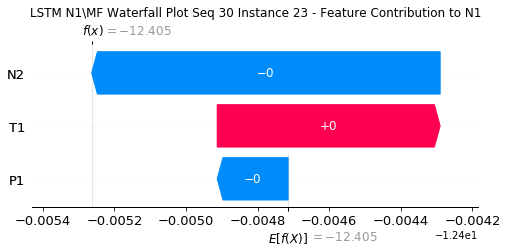

None

Contribution: [-0.00124287  0.00666747 -0.00804569]


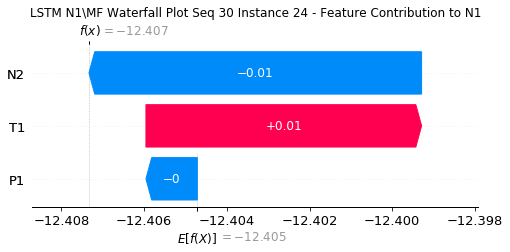

None

Contribution: [-0.05648272  0.09590633 -0.17563129]


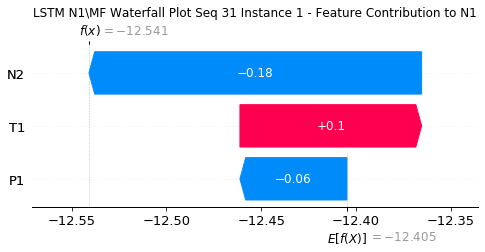

None

Contribution: [0.00169878 0.00256385 0.00535623]


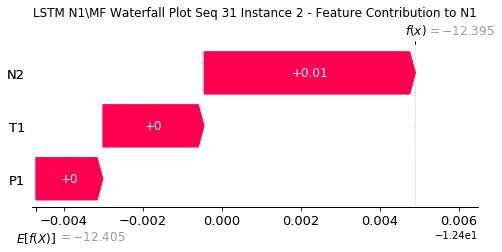

None

Contribution: [-4.87609101e-05  4.62753297e-04 -9.57053535e-05]


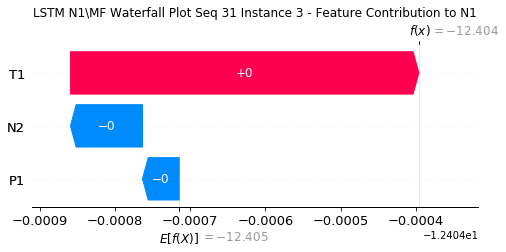

None

Contribution: [-3.14158721e-05  2.65640539e-04 -1.33327170e-04]


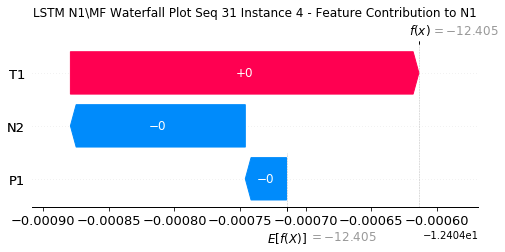

None

Contribution: [-3.74604664e-05  2.20385529e-04 -2.61010208e-04]


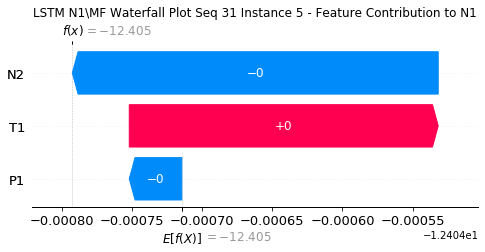

None

Contribution: [-0.00012299  0.00039473 -0.00045887]


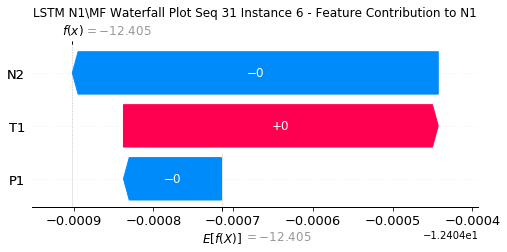

None

Contribution: [-0.00021383  0.00035225 -0.00063777]


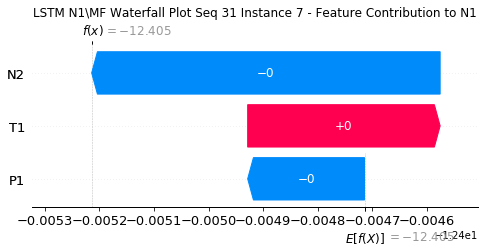

None

Contribution: [-0.00022575  0.00016446 -0.00075106]


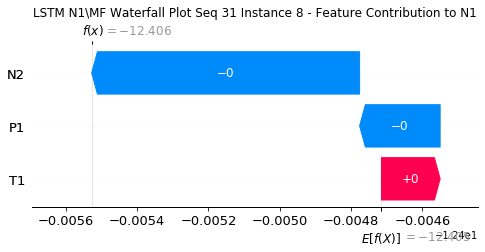

None

Contribution: [-0.0002071   0.00016369 -0.00082429]


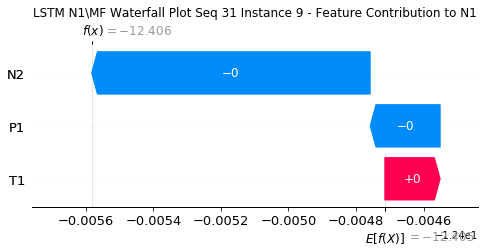

None

Contribution: [-0.00026124  0.00025574 -0.00092047]


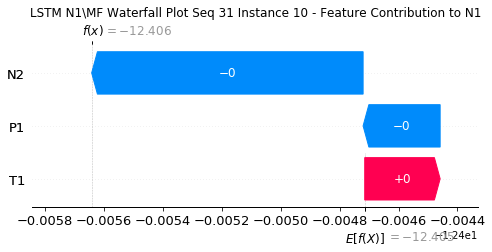

None

Contribution: [-0.00031184  0.00020901 -0.00095858]


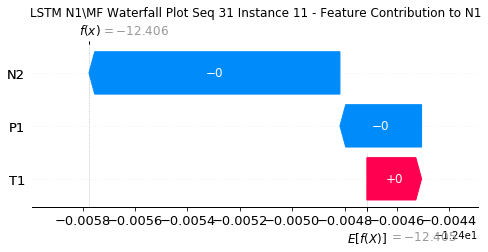

None

Contribution: [-0.00030634  0.00021098 -0.00096213]


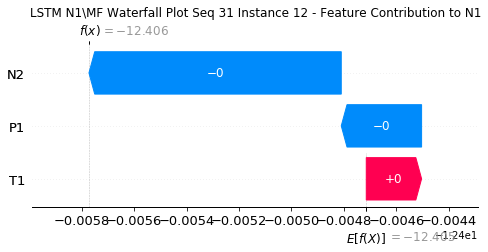

None

Contribution: [-0.00031449  0.00021921 -0.00098357]


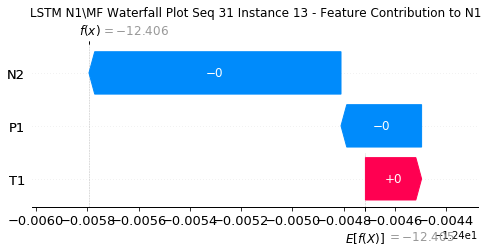

None

Contribution: [-0.00032175  0.00025058 -0.00099934]


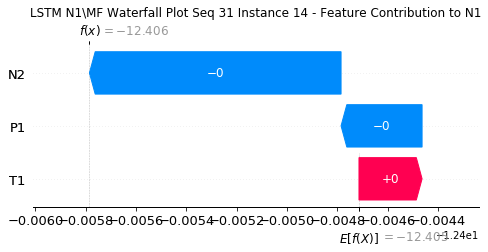

None

Contribution: [-0.00028517  0.00028727 -0.00097634]


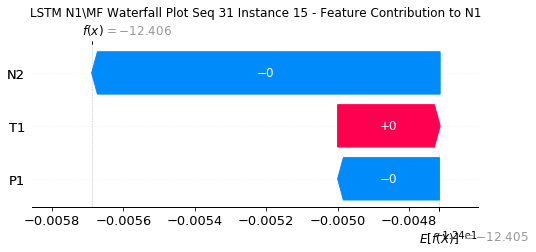

None

Contribution: [-0.0002849   0.00030061 -0.00092029]


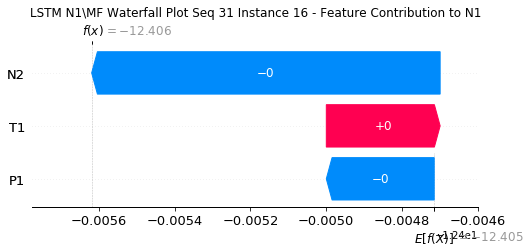

None

Contribution: [-0.00026366  0.00030581 -0.00086183]


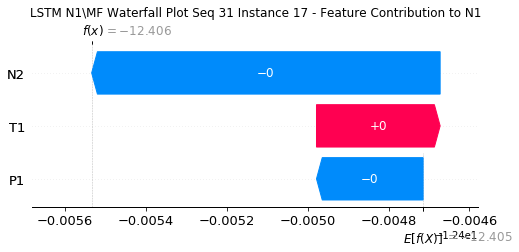

None

Contribution: [-0.00027759  0.00027426 -0.00083687]


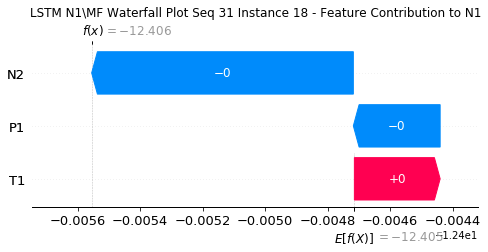

None

Contribution: [-0.00023626  0.00031353 -0.00079501]


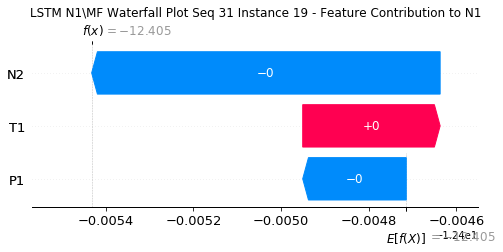

None

Contribution: [-0.00022352  0.00030775 -0.00078091]


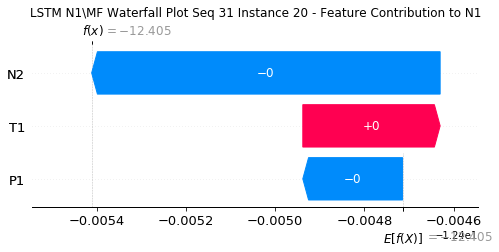

None

Contribution: [-0.00020607  0.00031564 -0.00078578]


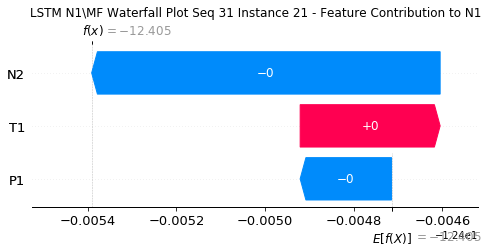

None

Contribution: [-0.00023169  0.00035167 -0.00079895]


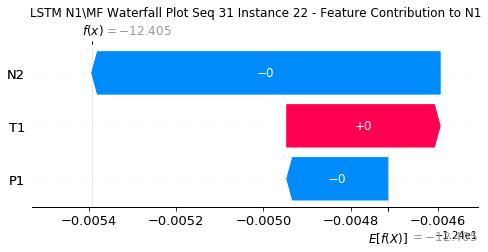

None

Contribution: [-0.00020286  0.00079269 -0.00097283]


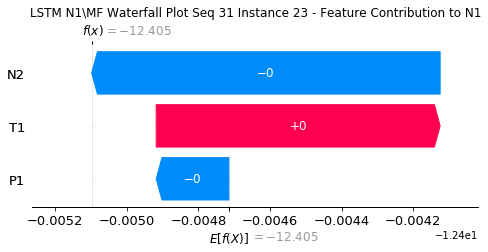

None

Contribution: [-0.00127504  0.00749558 -0.00921103]


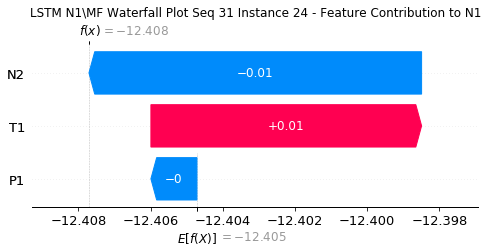

None

Contribution: [-0.06394536  0.10577253 -0.18177838]


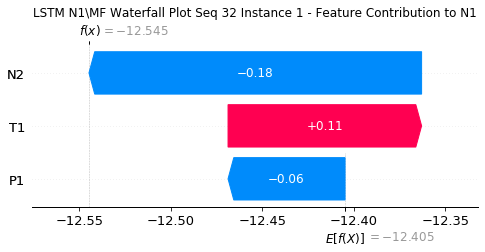

None

Contribution: [0.00163785 0.0030426  0.00525199]


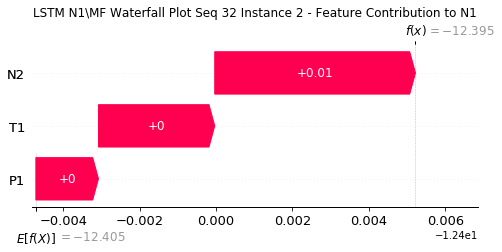

None

Contribution: [-4.17518449e-06  3.71148200e-04 -7.16789619e-05]


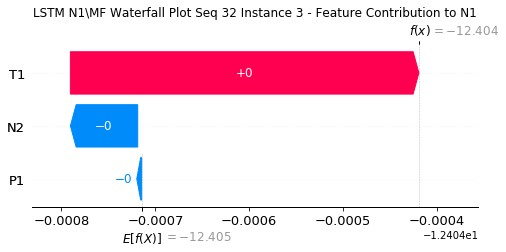

None

Contribution: [-5.34017307e-05  3.03370347e-04 -1.55004257e-04]


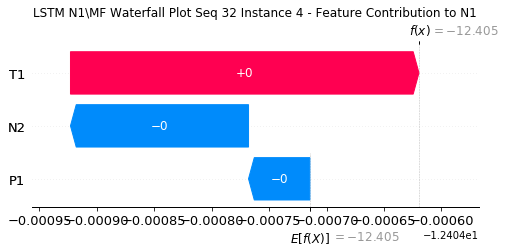

None

Contribution: [-9.96990974e-05  2.46533071e-04 -2.82803189e-04]


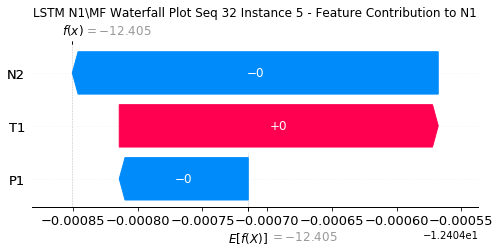

None

Contribution: [-0.00019081  0.00039393 -0.00048723]


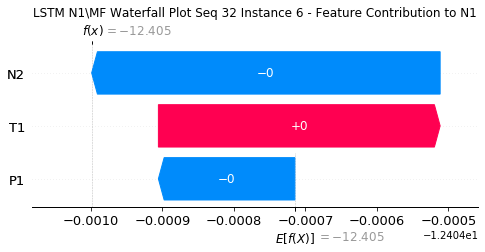

None

Contribution: [-0.00020856  0.00030032 -0.00063142]


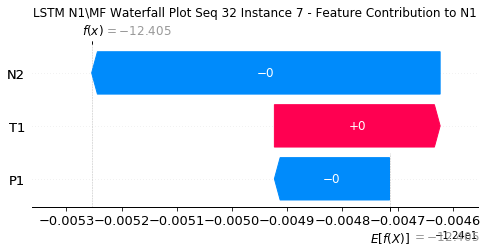

None

Contribution: [-0.00023341  0.00013819 -0.00073987]


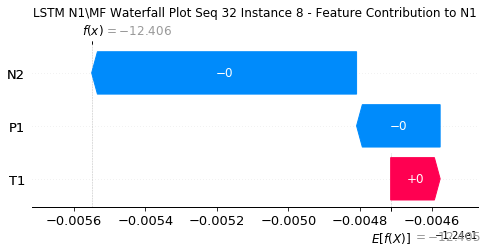

None

Contribution: [-0.00025636  0.00015745 -0.00084284]


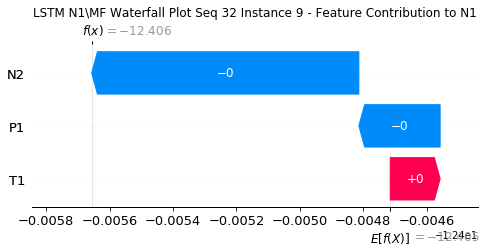

None

Contribution: [-0.00028123  0.00025287 -0.00095177]


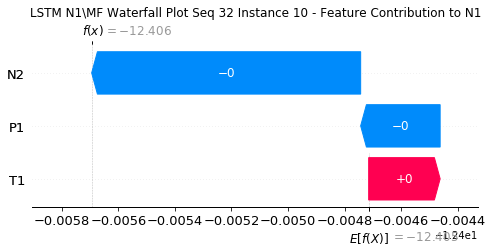

None

Contribution: [-0.00029364  0.00030926 -0.0009614 ]


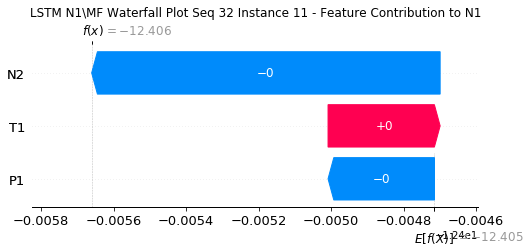

None

Contribution: [-0.00029157  0.00032582 -0.0009663 ]


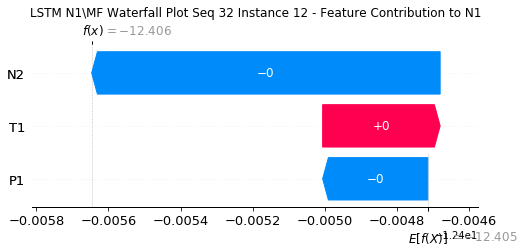

None

Contribution: [-0.00028101  0.00034883 -0.00097958]


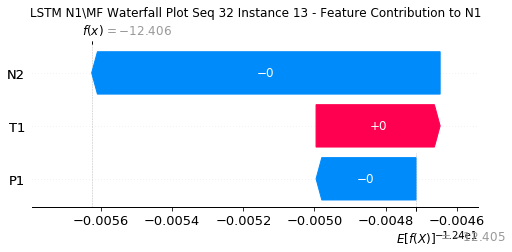

None

Contribution: [-0.00030039  0.00038019 -0.00100963]


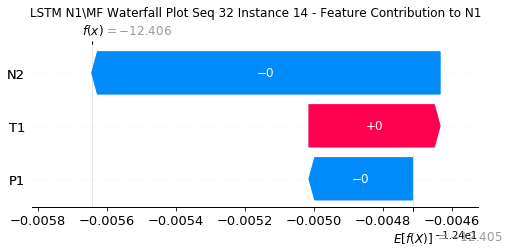

None

Contribution: [-0.00022117  0.00050616 -0.00094435]


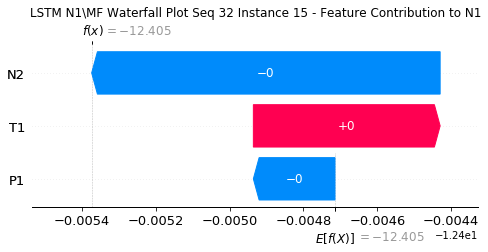

None

Contribution: [-0.00027645  0.00043026 -0.00093157]


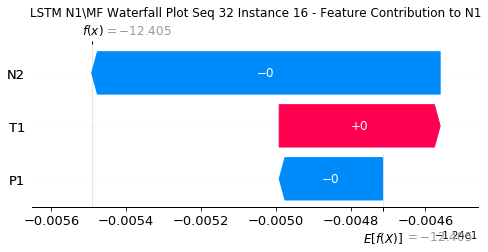

None

Contribution: [-0.00024948  0.00043734 -0.00087865]


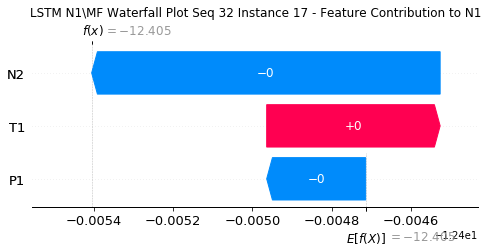

None

Contribution: [-0.00024664  0.00045172 -0.00084976]


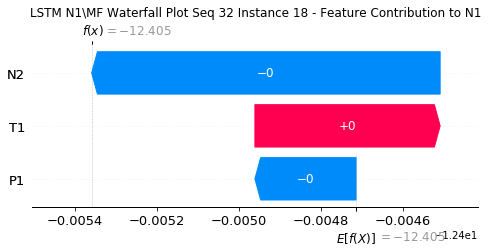

None

Contribution: [-0.00023969  0.00044501 -0.00081838]


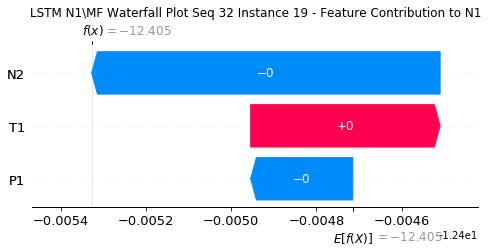

None

Contribution: [-0.00022696  0.00043795 -0.00080702]


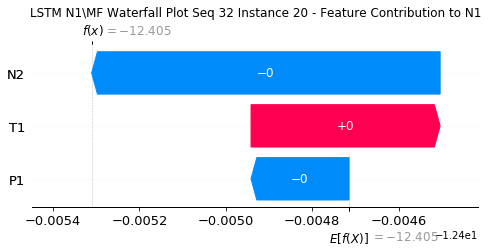

None

Contribution: [-0.0002085   0.00044959 -0.00081693]


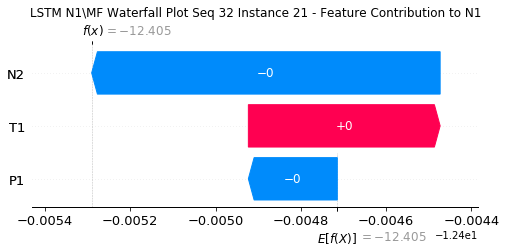

None

Contribution: [-0.00023602  0.0004931  -0.00083369]


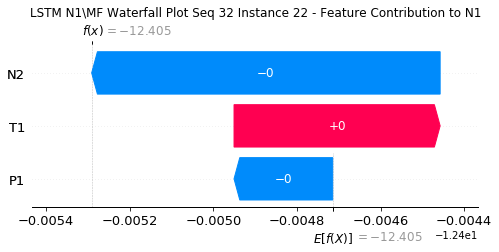

None

Contribution: [-0.00020042  0.0009826  -0.00107851]


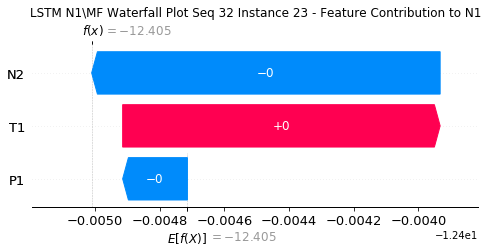

None

Contribution: [-0.0012609   0.00722768 -0.00928642]


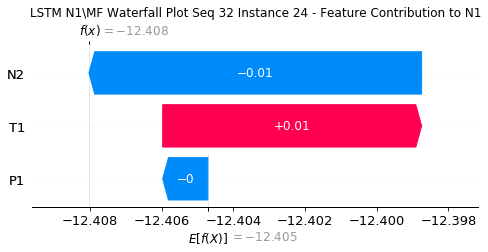

None

Contribution: [-0.05584004  0.09048492 -0.17456668]


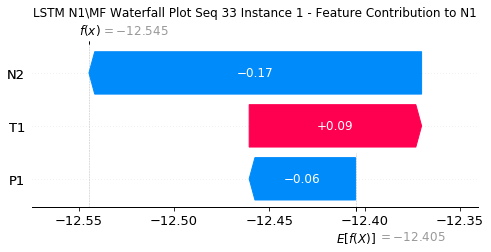

None

Contribution: [0.00168065 0.00243429 0.00537207]


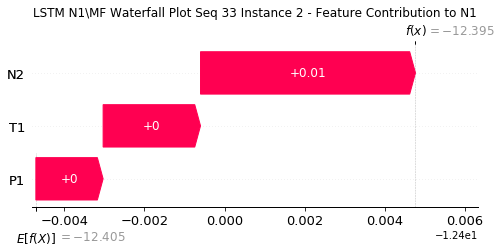

None

Contribution: [-1.93577840e-05  3.64432834e-04 -5.53332088e-05]


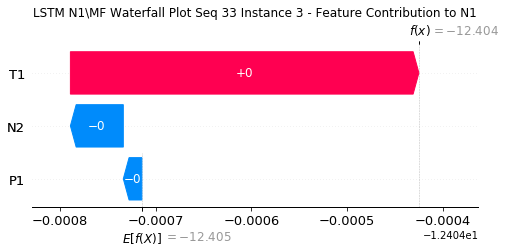

None

Contribution: [-6.17824472e-05  1.53986683e-04 -1.34026812e-04]


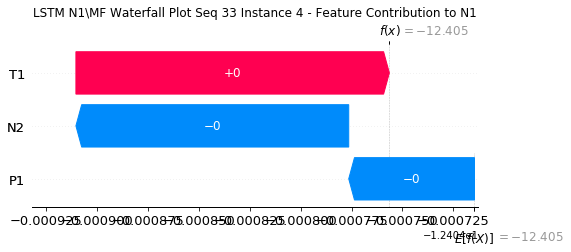

None

Contribution: [-1.55653808e-04 -6.95114208e-05 -2.71989758e-04]


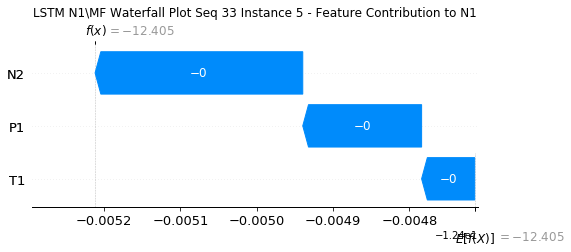

None

Contribution: [-0.00019011  0.00024823 -0.00047873]


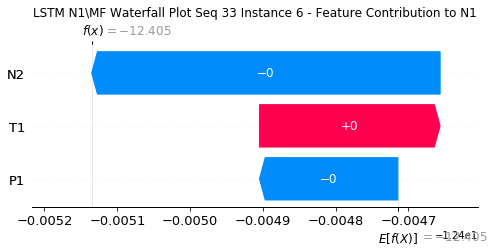

None

Contribution: [-0.00020706  0.00032832 -0.00063849]


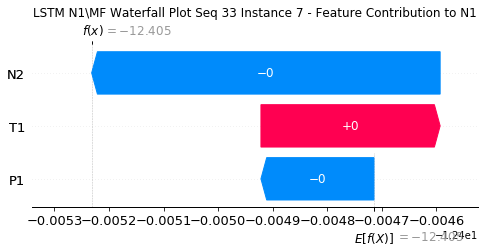

None

Contribution: [-0.00023561  0.00020823 -0.00075966]


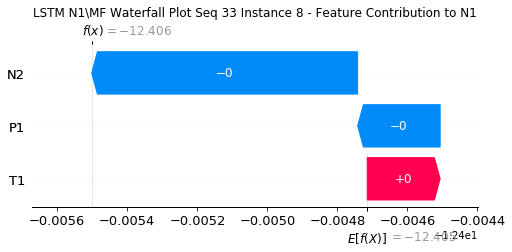

None

Contribution: [-0.00024062  0.00016145 -0.00084302]


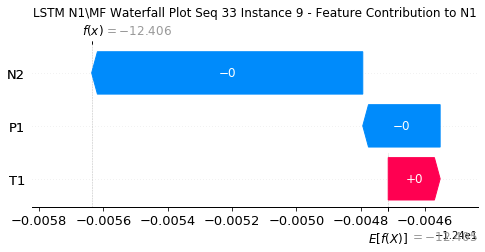

None

Contribution: [-0.0002676   0.00031154 -0.00092068]


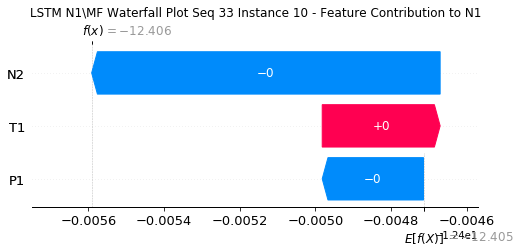

None

Contribution: [-0.00026698  0.00027495 -0.00094642]


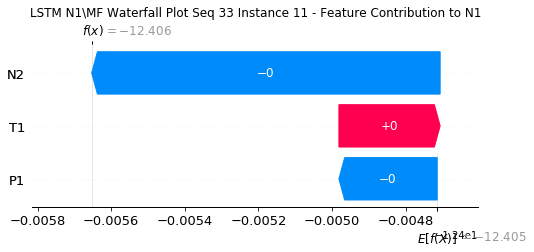

None

Contribution: [-0.00026654  0.0002702  -0.00095186]


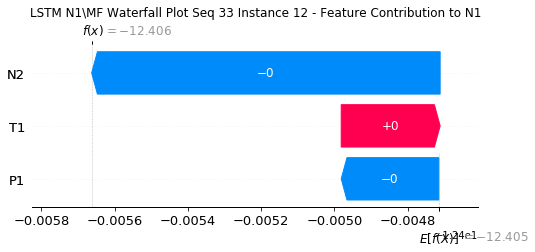

None

Contribution: [-0.0003066   0.00026215 -0.00097515]


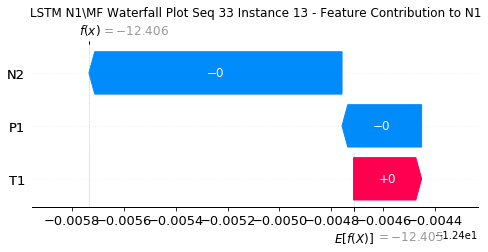

None

Contribution: [-0.00028936  0.00031    -0.00098613]


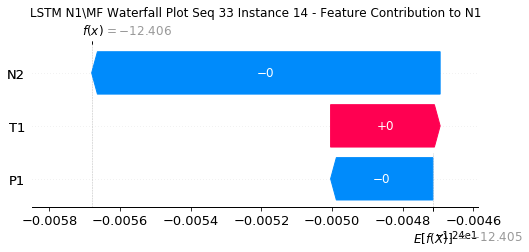

None

Contribution: [-0.00025291  0.00034793 -0.00095082]


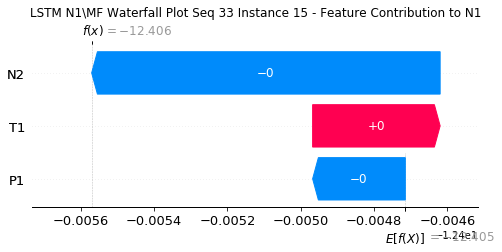

None

Contribution: [-0.000253    0.000354   -0.00091244]


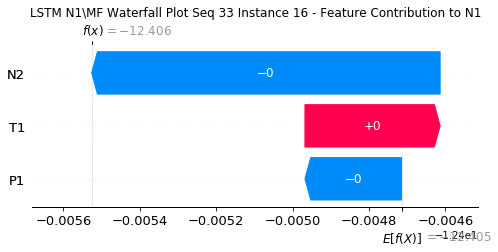

None

Contribution: [-0.00023259  0.00035763 -0.00085417]


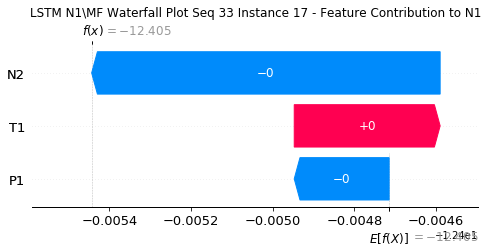

None

Contribution: [-0.00025199  0.00036586 -0.00082731]


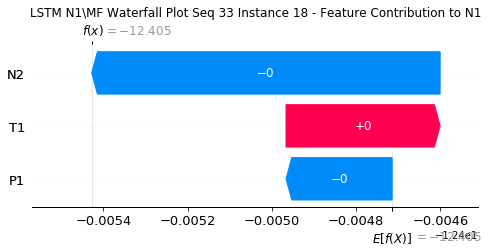

None

Contribution: [-0.00021285  0.00035768 -0.00079096]


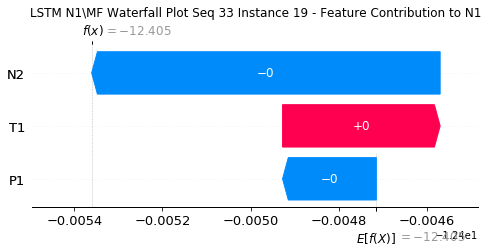

None

Contribution: [-0.00019907  0.00035367 -0.00077533]


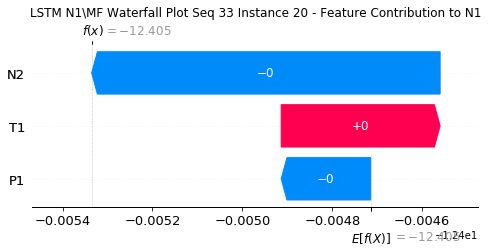

None

Contribution: [-0.0001899   0.00036214 -0.00078007]


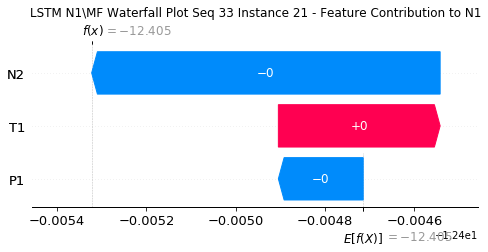

None

Contribution: [-0.00021417  0.00040669 -0.00079057]


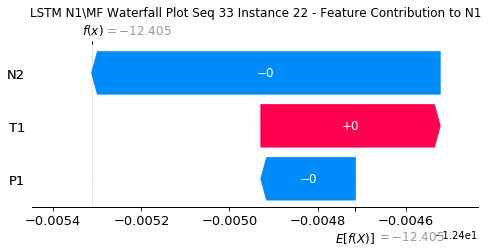

None

Contribution: [-0.00020696  0.00102138 -0.00096351]


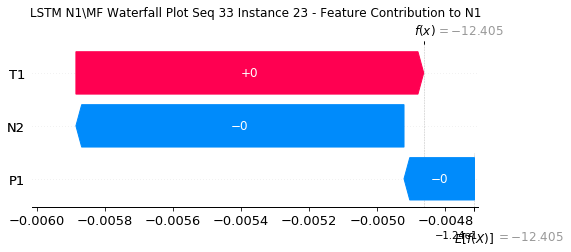

None

Contribution: [-0.00123286  0.01339819 -0.00767029]


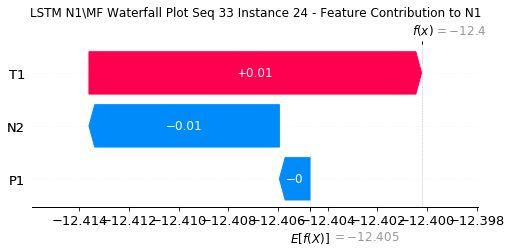

None

Contribution: [-0.08421456 -0.1062075  -0.19236422]


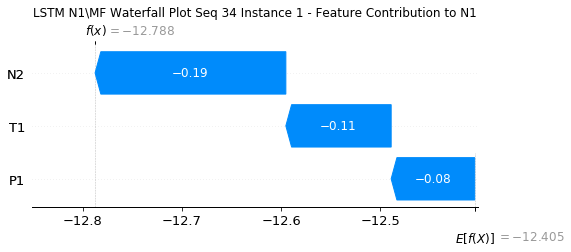

None

Contribution: [0.00174361 0.00017722 0.00574787]


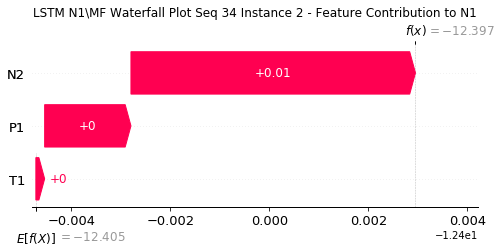

None

Contribution: [-8.78069041e-05 -1.11093349e-03 -1.40289550e-04]


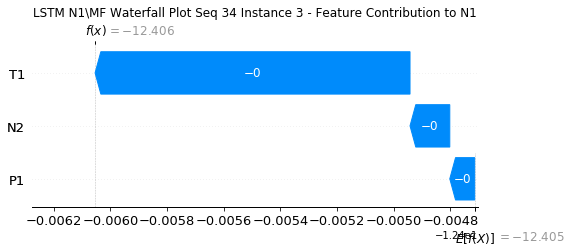

None

Contribution: [-1.16871404e-04 -1.64943826e-03 -4.87196627e-05]


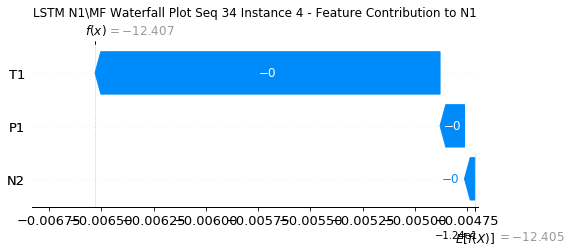

None

Contribution: [-0.00028661 -0.00336886 -0.00014683]


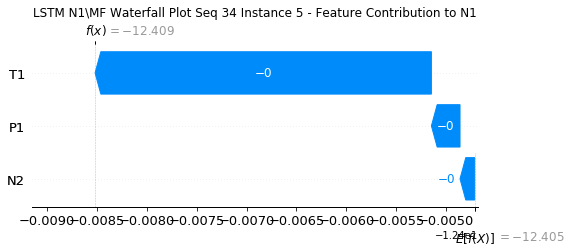

None

Contribution: [-0.00049357 -0.00291162 -0.00033876]


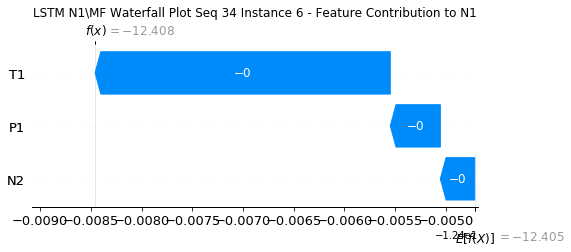

None

Contribution: [-0.00025406 -0.00084348 -0.00058798]


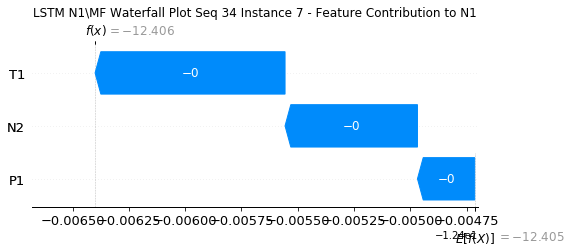

None

Contribution: [-7.10959849e-05  6.75113506e-04 -8.39084353e-04]


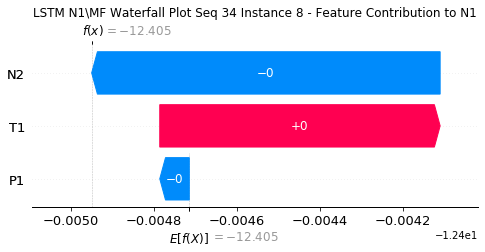

None

Contribution: [-7.93872688e-06  6.27792132e-04 -1.00497649e-03]


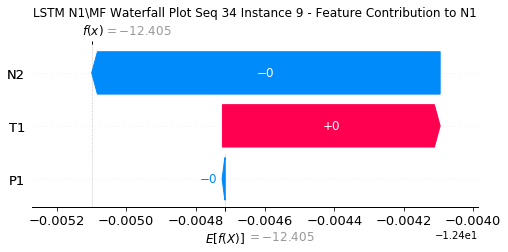

None

Contribution: [-0.00017665  0.00027499 -0.00099424]


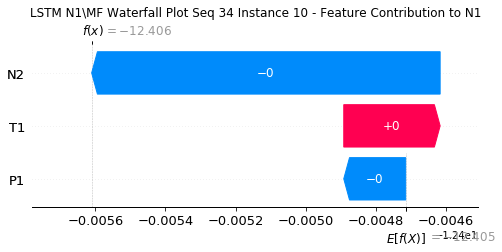

None

Contribution: [-0.0002671   0.00024373 -0.00104472]


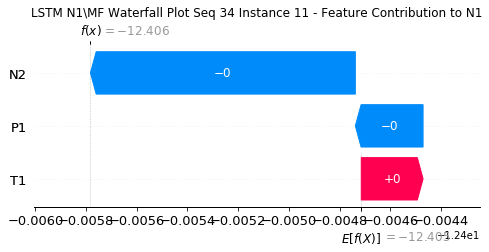

None

Contribution: [-0.00027222  0.00024977 -0.00105362]


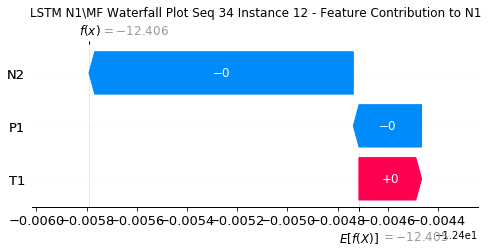

None

Contribution: [-0.00026136  0.00025324 -0.00106933]


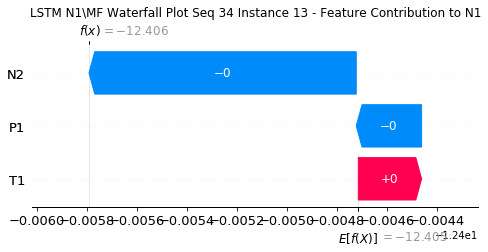

None

Contribution: [-0.00026911  0.00033619 -0.00102094]


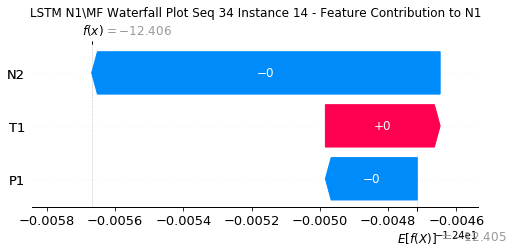

None

Contribution: [-0.00021167  0.00037345 -0.00093217]


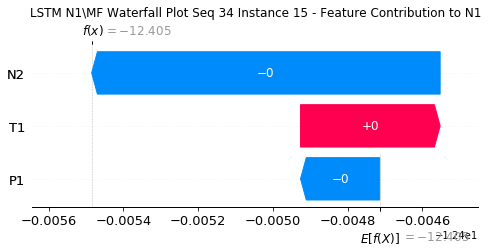

None

Contribution: [-0.00022421  0.00035444 -0.00087758]


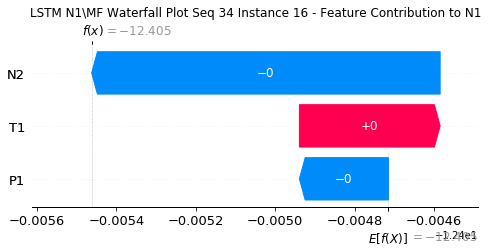

None

Contribution: [-0.00021416  0.0003501  -0.00082032]


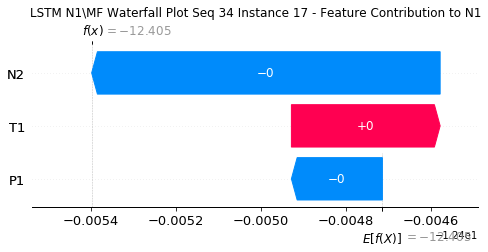

None

Contribution: [-0.00021286  0.00032546 -0.00079372]


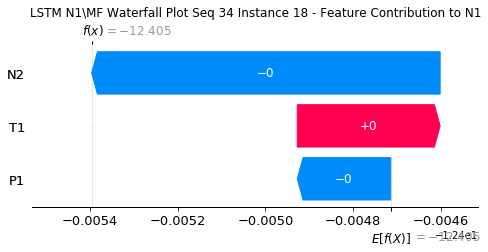

None

Contribution: [-0.0002016   0.00033768 -0.00076315]


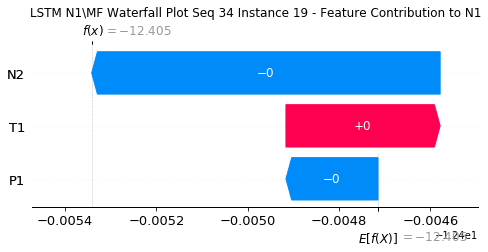

None

Contribution: [-0.00018988  0.0003343  -0.00074932]


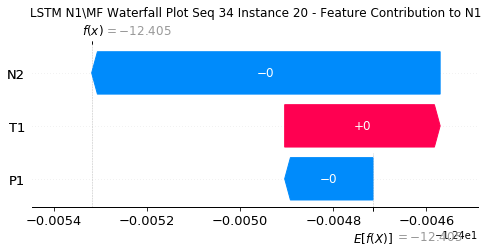

None

Contribution: [-0.00017803  0.00033589 -0.00075311]


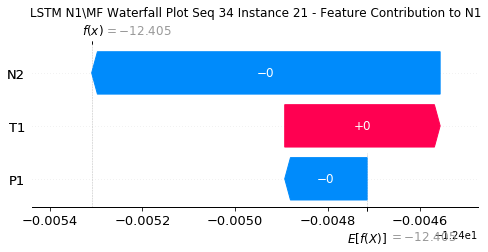

None

Contribution: [-0.00019822  0.00037915 -0.00076607]


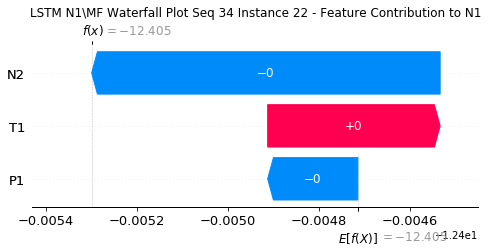

None

Contribution: [-0.00020561  0.00097607 -0.0009242 ]


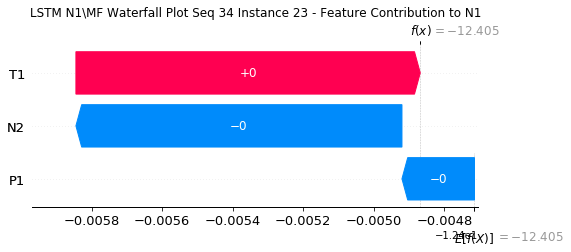

None

Contribution: [-0.00121928  0.01410627 -0.00779278]


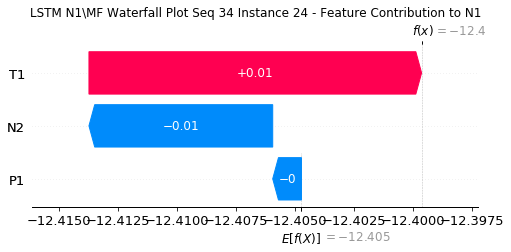

None

In [38]:
#Waterfall Plot for Consistency metric - Exclude MF

instance = xtrain
instance2 = xtest
explainer = shap.DeepExplainer(model3,instance)
    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM N1\MF Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to N1" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [3]:
#Consistency

N1_tot1 = -15.718 + 12.688
N1_tot1

-3.0299999999999994

In [ ]:
#MF contribution instance 1

MF_N1_1 = -0.07584286